# Test for runnin GAN

In [3]:
import numpy as np
import torch
from torch import nn, optim
from torch.autograd.variable import Variable
from torchvision import transforms, datasets

In [4]:
from utils import Logger

---
Start of the code

In [17]:
def mnist_data():
    compose = transforms.Compose(
        [transforms.ToTensor(),
         transforms.Normalize((.5,), (.5,))
        ])
    out_dir = './dataset'
    return datasets.MNIST(root=out_dir, train=True, transform=compose, download=True)
# Load data
data = mnist_data()
# Create loader with data, so that we can iterate over it
data_loader = torch.utils.data.DataLoader(data, batch_size=100, shuffle=True)
# Num batches
num_batches = len(data_loader)

In [18]:
class DiscriminatorNet(torch.nn.Module):
    """
    A three hidden-layer discriminative neural network
    """
    def __init__(self):
        super(DiscriminatorNet, self).__init__()
        n_features = 784
        n_out = 1
        
        self.hidden0 = nn.Sequential( 
            nn.Linear(n_features, 1024),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.hidden1 = nn.Sequential(
            nn.Linear(1024, 512),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.hidden2 = nn.Sequential(
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.out = nn.Sequential(
            torch.nn.Linear(256, n_out),
            torch.nn.Sigmoid()
        )

    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x
discriminator = DiscriminatorNet()

In [19]:
def images_to_vectors(images):
    return images.view(images.size(0), 784)

def vectors_to_images(vectors):
    return vectors.view(vectors.size(0), 1, 28, 28)

In [20]:
class GeneratorNet(torch.nn.Module):
    """
    A three hidden-layer generative neural network
    """
    def __init__(self):
        super(GeneratorNet, self).__init__()
        n_features = 100
        n_out = 784
        
        self.hidden0 = nn.Sequential(
            nn.Linear(n_features, 256),
            nn.LeakyReLU(0.2)
        )
        self.hidden1 = nn.Sequential(            
            nn.Linear(256, 512),
            nn.LeakyReLU(0.2)
        )
        self.hidden2 = nn.Sequential(
            nn.Linear(512, 1024),
            nn.LeakyReLU(0.2)
        )
        
        self.out = nn.Sequential(
            nn.Linear(1024, n_out),
            nn.Tanh()
        )

    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x
generator = GeneratorNet()

In [21]:
def noise(size):
    '''
    Generates a 1-d vector of gaussian sampled random values
    '''
    n = Variable(torch.randn(size, 100))
    return n

In [22]:
d_optimizer = optim.Adam(discriminator.parameters(), lr=0.0002)
g_optimizer = optim.Adam(generator.parameters(), lr=0.0002)

In [23]:
loss = nn.BCELoss()

In [24]:
def ones_target(size):
    '''
    Tensor containing ones, with shape = size
    '''
    data = Variable(torch.ones(size, 1))
    return data

def zeros_target(size):
    '''
    Tensor containing zeros, with shape = size
    '''
    data = Variable(torch.zeros(size, 1))
    return data

In [25]:
def train_discriminator(optimizer, real_data, fake_data):
    N = real_data.size(0)
    # Reset gradients
    optimizer.zero_grad()
    
    # 1.1 Train on Real Data
    prediction_real = discriminator(real_data)
    # Calculate error and backpropagate
    error_real = loss(prediction_real, ones_target(N) )
    error_real.backward()

    # 1.2 Train on Fake Data
    prediction_fake = discriminator(fake_data)
    # Calculate error and backpropagate
    error_fake = loss(prediction_fake, zeros_target(N))
    error_fake.backward()
    
    # 1.3 Update weights with gradients
    optimizer.step()
    
    # Return error and predictions for real and fake inputs
    return error_real + error_fake, prediction_real, prediction_fake

In [29]:
def train_generator(optimizer, fake_data):
    N = fake_data.size(0)
    # Reset gradients
    optimizer.zero_grad()
    # Sample noise and generate fake data
    prediction = discriminator(fake_data)
    # Calculate error and backpropagate
    error = loss(prediction, ones_target(N))
    error.backward()
    # Update weights with gradients
    optimizer.step()
    # Return error
    return error

In [30]:
num_test_samples = 16
test_noise = noise(num_test_samples)

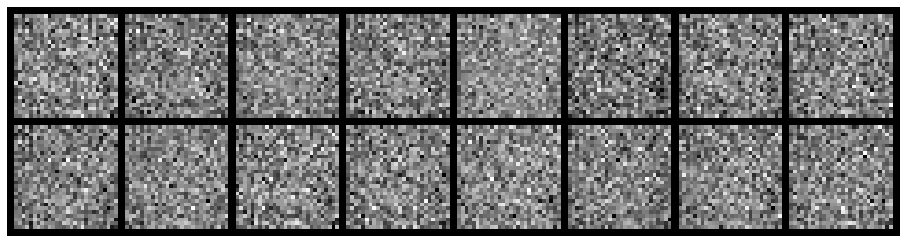

Epoch: [0/200], Batch Num: [0/600]
Discriminator Loss: 1.2583, Generator Loss: 0.7207
D(x): 0.5532, D(G(z)): 0.4861


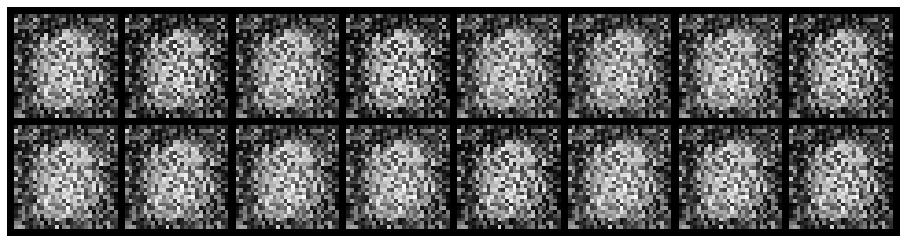

Epoch: [0/200], Batch Num: [100/600]
Discriminator Loss: 0.1646, Generator Loss: 3.4675
D(x): 0.9641, D(G(z)): 0.1165


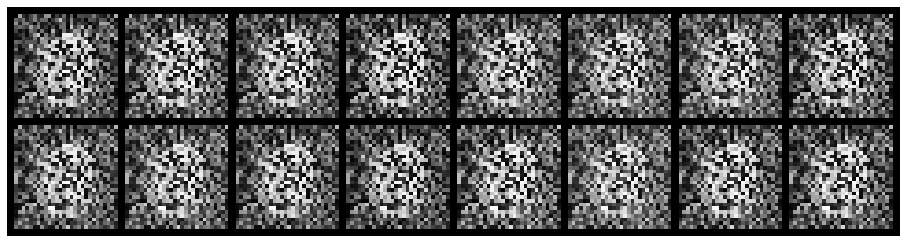

Epoch: [0/200], Batch Num: [200/600]
Discriminator Loss: 1.6016, Generator Loss: 1.8469
D(x): 0.7524, D(G(z)): 0.6400


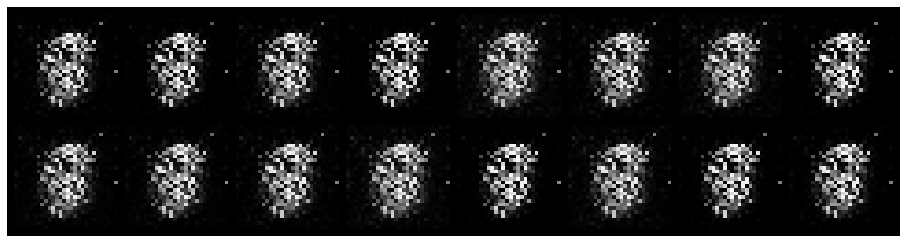

Epoch: [0/200], Batch Num: [300/600]
Discriminator Loss: 1.8780, Generator Loss: 0.6374
D(x): 0.5595, D(G(z)): 0.6720


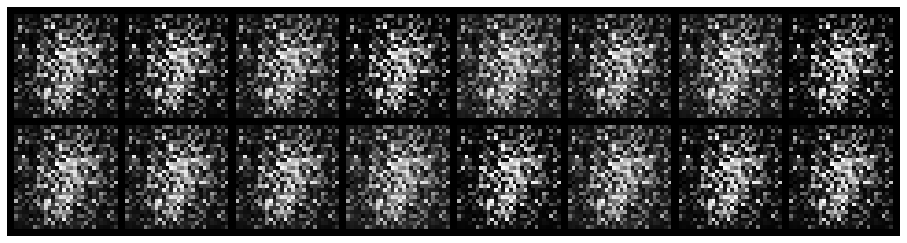

Epoch: [0/200], Batch Num: [400/600]
Discriminator Loss: 0.7980, Generator Loss: 3.4830
D(x): 0.6980, D(G(z)): 0.3198


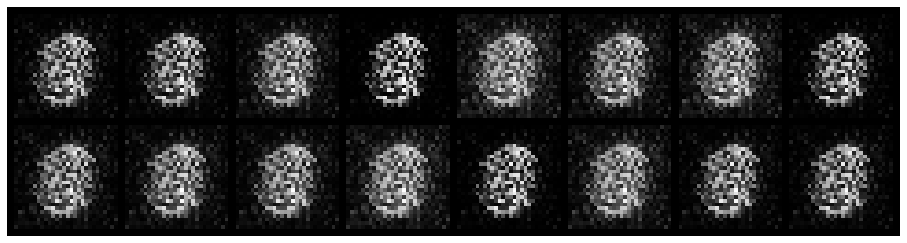

Epoch: [0/200], Batch Num: [500/600]
Discriminator Loss: 0.5622, Generator Loss: 3.0581
D(x): 0.6731, D(G(z)): 0.1352


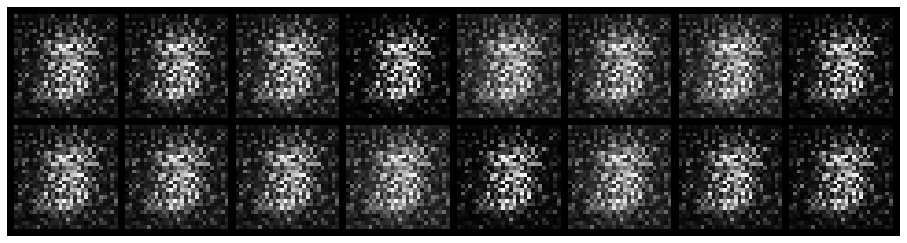

Epoch: [1/200], Batch Num: [0/600]
Discriminator Loss: 0.4458, Generator Loss: 5.8235
D(x): 0.7439, D(G(z)): 0.0696


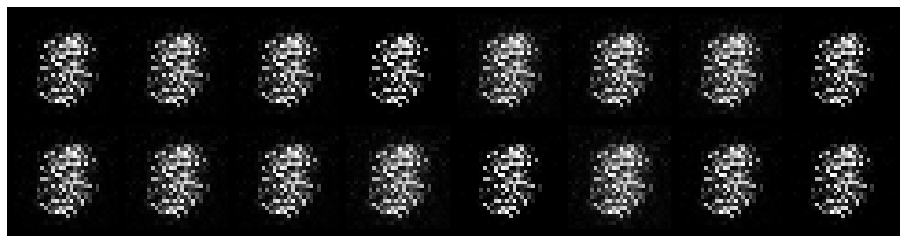

Epoch: [1/200], Batch Num: [100/600]
Discriminator Loss: 0.7869, Generator Loss: 1.8192
D(x): 0.7217, D(G(z)): 0.2852


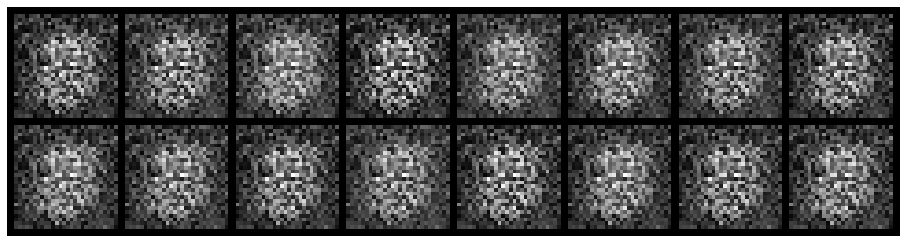

Epoch: [1/200], Batch Num: [200/600]
Discriminator Loss: 0.8073, Generator Loss: 2.7613
D(x): 0.8251, D(G(z)): 0.3740


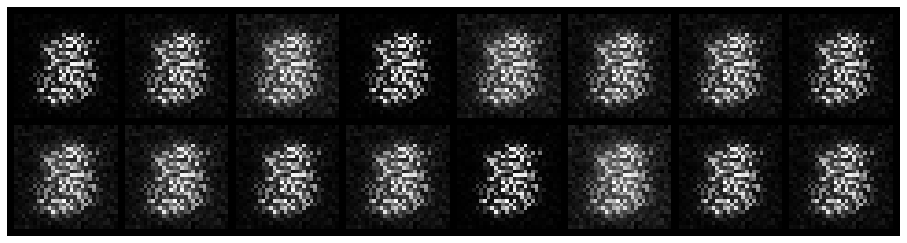

Epoch: [1/200], Batch Num: [300/600]
Discriminator Loss: 0.2803, Generator Loss: 3.4124
D(x): 0.9268, D(G(z)): 0.1553


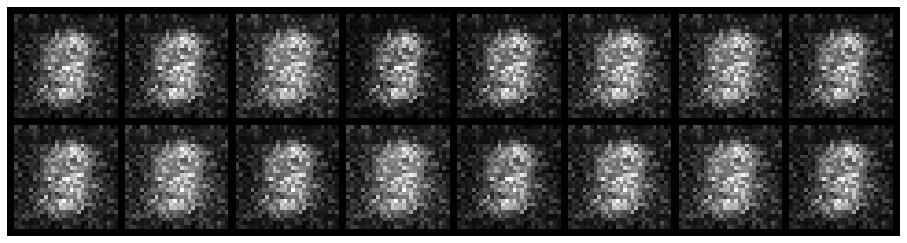

Epoch: [1/200], Batch Num: [400/600]
Discriminator Loss: 0.6896, Generator Loss: 2.3777
D(x): 0.7915, D(G(z)): 0.2771


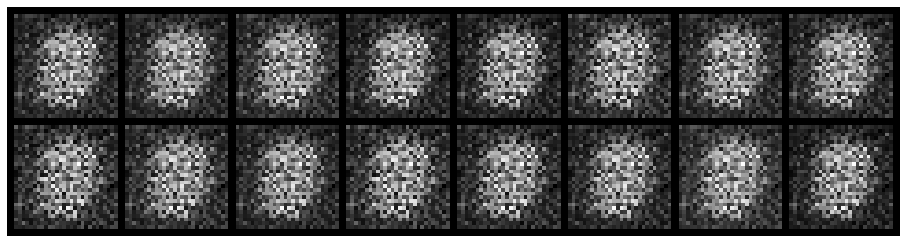

Epoch: [1/200], Batch Num: [500/600]
Discriminator Loss: 0.4593, Generator Loss: 3.7346
D(x): 0.8493, D(G(z)): 0.2219


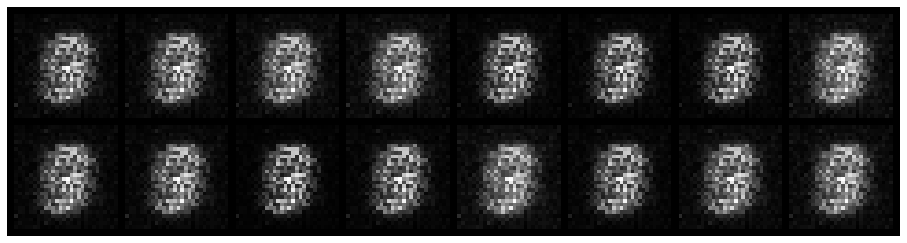

Epoch: [2/200], Batch Num: [0/600]
Discriminator Loss: 0.9162, Generator Loss: 3.0092
D(x): 0.6901, D(G(z)): 0.2513


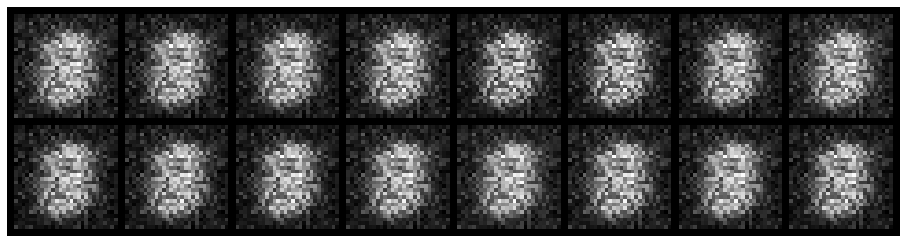

Epoch: [2/200], Batch Num: [100/600]
Discriminator Loss: 0.3818, Generator Loss: 2.5993
D(x): 0.9093, D(G(z)): 0.2100


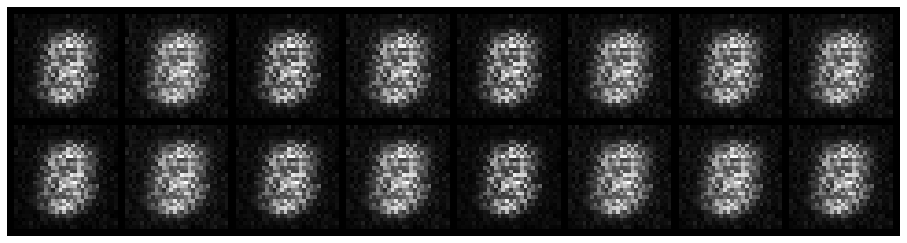

Epoch: [2/200], Batch Num: [200/600]
Discriminator Loss: 1.1961, Generator Loss: 1.8303
D(x): 0.6111, D(G(z)): 0.3805


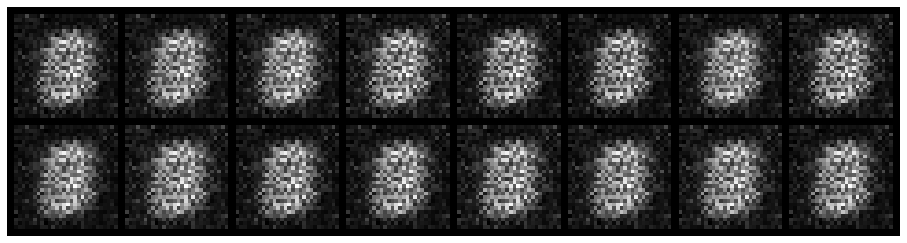

Epoch: [2/200], Batch Num: [300/600]
Discriminator Loss: 0.7765, Generator Loss: 2.3254
D(x): 0.7966, D(G(z)): 0.3544


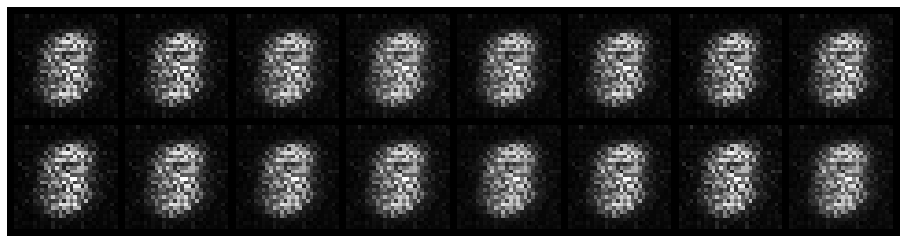

Epoch: [2/200], Batch Num: [400/600]
Discriminator Loss: 0.9546, Generator Loss: 1.2679
D(x): 0.7080, D(G(z)): 0.4215


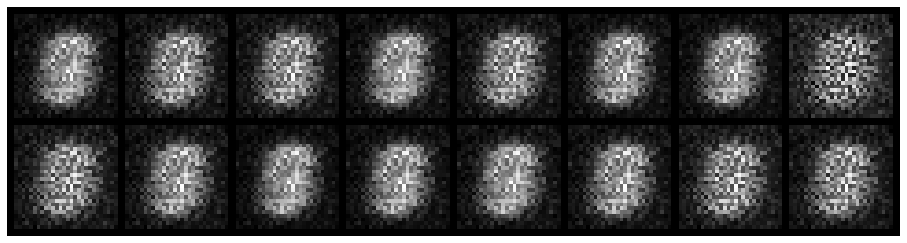

Epoch: [2/200], Batch Num: [500/600]
Discriminator Loss: 0.6540, Generator Loss: 1.9812
D(x): 0.8309, D(G(z)): 0.2805


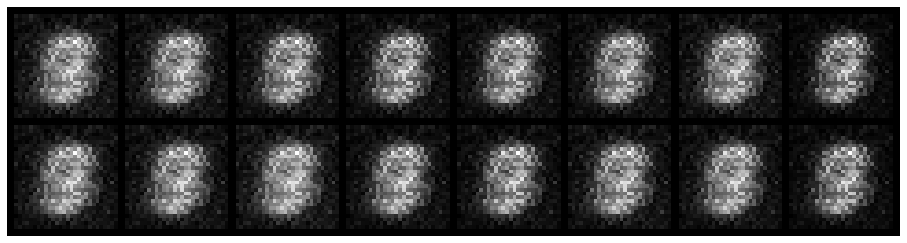

Epoch: [3/200], Batch Num: [0/600]
Discriminator Loss: 0.3824, Generator Loss: 2.0302
D(x): 0.8651, D(G(z)): 0.1836


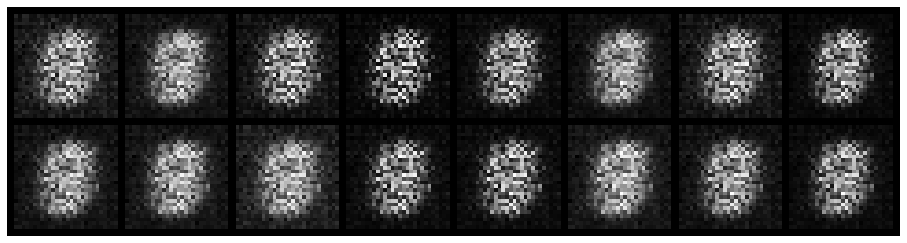

Epoch: [3/200], Batch Num: [100/600]
Discriminator Loss: 0.3570, Generator Loss: 2.6700
D(x): 0.8796, D(G(z)): 0.1548


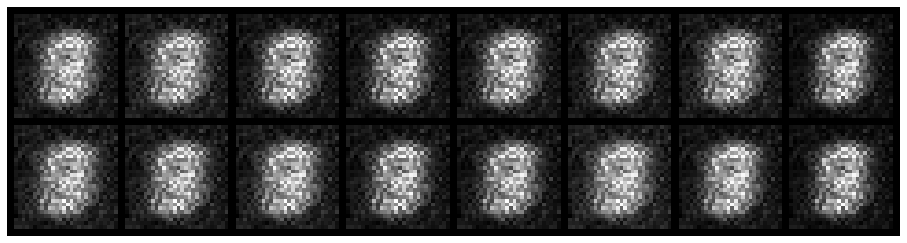

Epoch: [3/200], Batch Num: [200/600]
Discriminator Loss: 0.4751, Generator Loss: 1.9567
D(x): 0.8361, D(G(z)): 0.2081


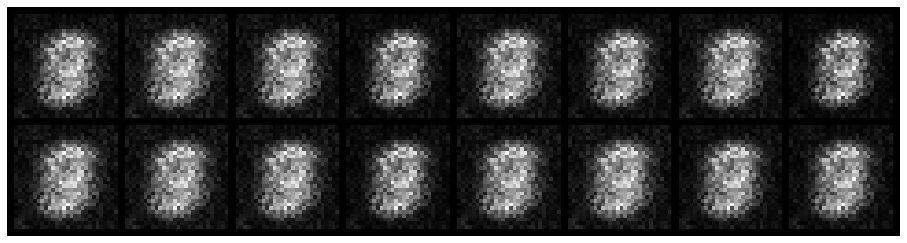

Epoch: [3/200], Batch Num: [300/600]
Discriminator Loss: 0.3410, Generator Loss: 2.9267
D(x): 0.8712, D(G(z)): 0.1340


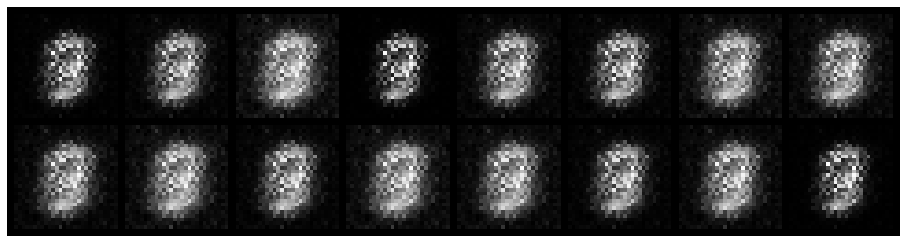

Epoch: [3/200], Batch Num: [400/600]
Discriminator Loss: 0.7667, Generator Loss: 1.9359
D(x): 0.7449, D(G(z)): 0.2430


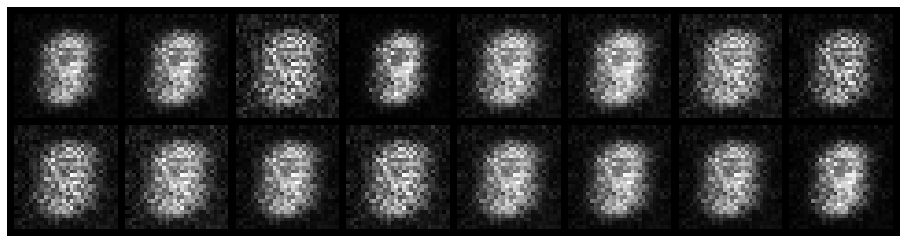

Epoch: [3/200], Batch Num: [500/600]
Discriminator Loss: 1.2769, Generator Loss: 5.0075
D(x): 0.8783, D(G(z)): 0.4426


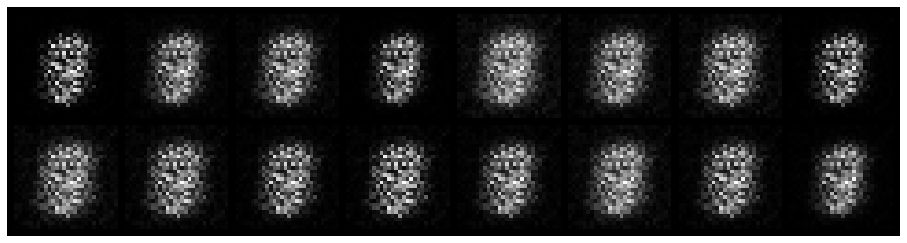

Epoch: [4/200], Batch Num: [0/600]
Discriminator Loss: 0.5400, Generator Loss: 3.1512
D(x): 0.8187, D(G(z)): 0.1992


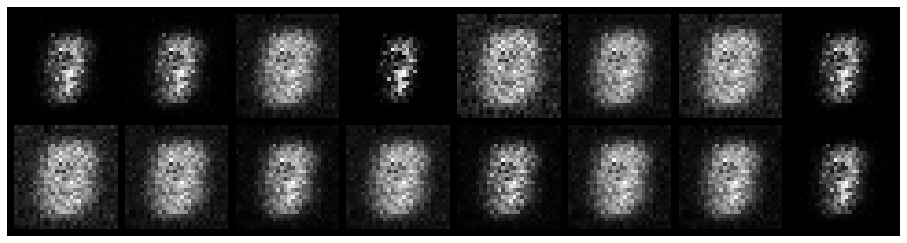

Epoch: [4/200], Batch Num: [100/600]
Discriminator Loss: 0.6305, Generator Loss: 1.7004
D(x): 0.7892, D(G(z)): 0.2468


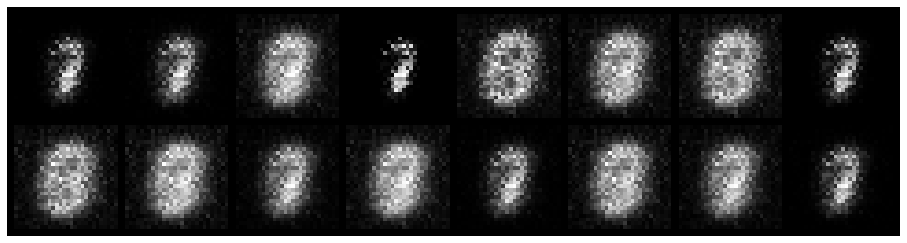

Epoch: [4/200], Batch Num: [200/600]
Discriminator Loss: 0.3231, Generator Loss: 3.5830
D(x): 0.8582, D(G(z)): 0.0825


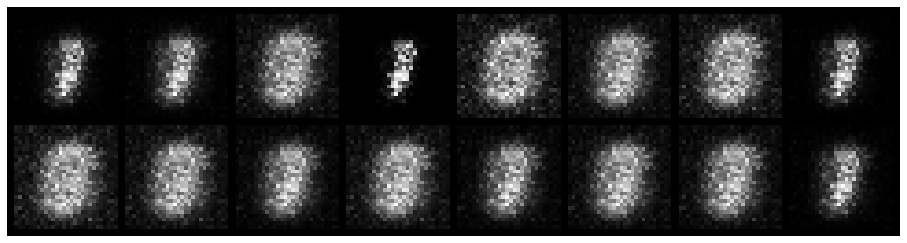

Epoch: [4/200], Batch Num: [300/600]
Discriminator Loss: 0.5087, Generator Loss: 3.7714
D(x): 0.8490, D(G(z)): 0.1058


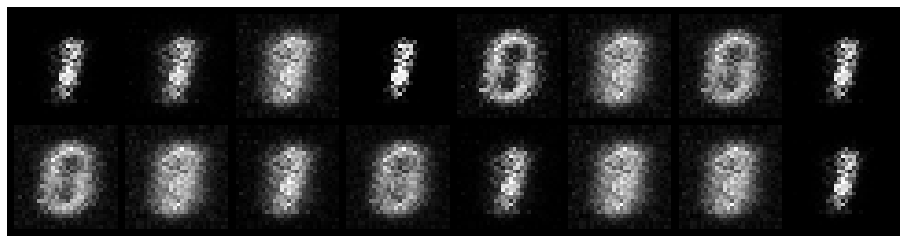

Epoch: [4/200], Batch Num: [400/600]
Discriminator Loss: 0.1933, Generator Loss: 3.4962
D(x): 0.9325, D(G(z)): 0.0698


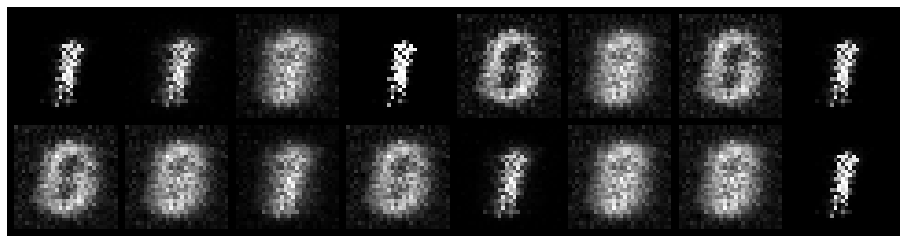

Epoch: [4/200], Batch Num: [500/600]
Discriminator Loss: 0.2401, Generator Loss: 3.6736
D(x): 0.9358, D(G(z)): 0.0696


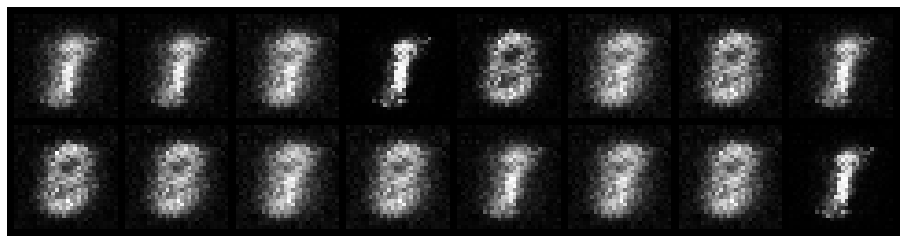

Epoch: [5/200], Batch Num: [0/600]
Discriminator Loss: 0.2470, Generator Loss: 3.2406
D(x): 0.9359, D(G(z)): 0.1088


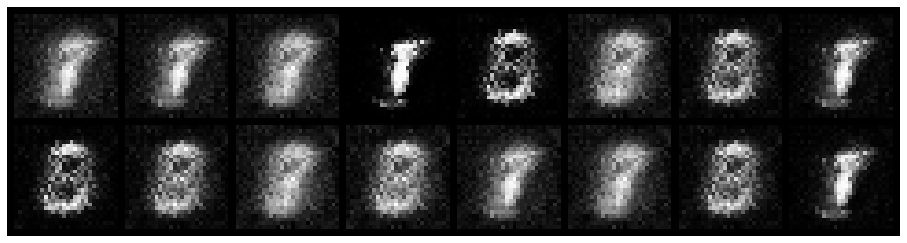

Epoch: [5/200], Batch Num: [100/600]
Discriminator Loss: 0.3073, Generator Loss: 3.3125
D(x): 0.9038, D(G(z)): 0.0856


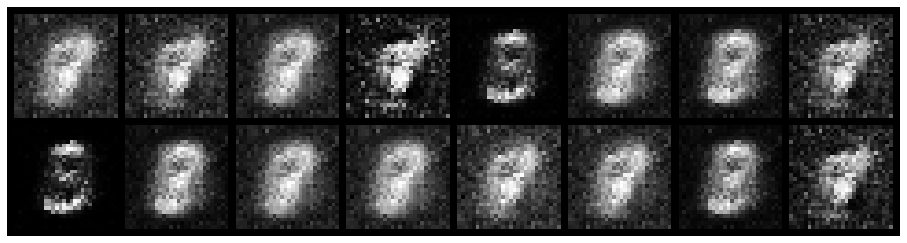

Epoch: [5/200], Batch Num: [200/600]
Discriminator Loss: 0.4093, Generator Loss: 2.7841
D(x): 0.8983, D(G(z)): 0.1022


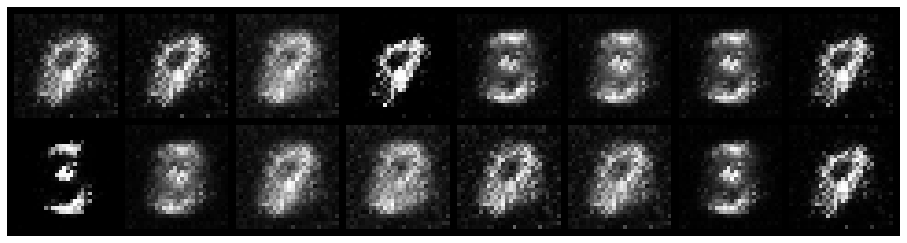

Epoch: [5/200], Batch Num: [300/600]
Discriminator Loss: 0.2245, Generator Loss: 3.8909
D(x): 0.9300, D(G(z)): 0.0593


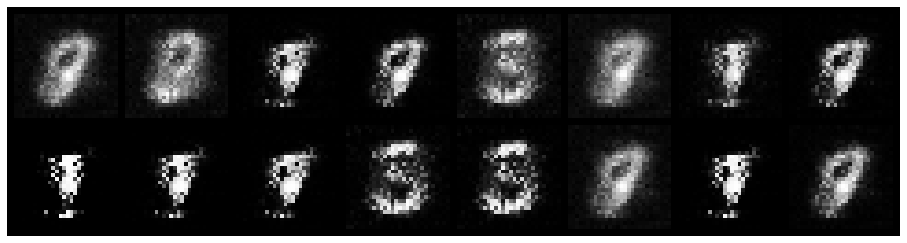

Epoch: [5/200], Batch Num: [400/600]
Discriminator Loss: 0.6477, Generator Loss: 2.0981
D(x): 0.9253, D(G(z)): 0.3159


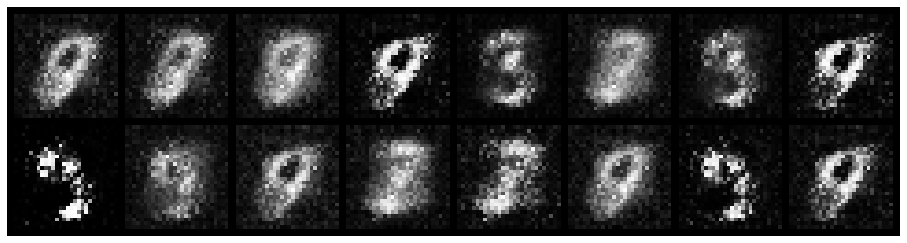

Epoch: [5/200], Batch Num: [500/600]
Discriminator Loss: 0.5169, Generator Loss: 2.4289
D(x): 0.9054, D(G(z)): 0.2094


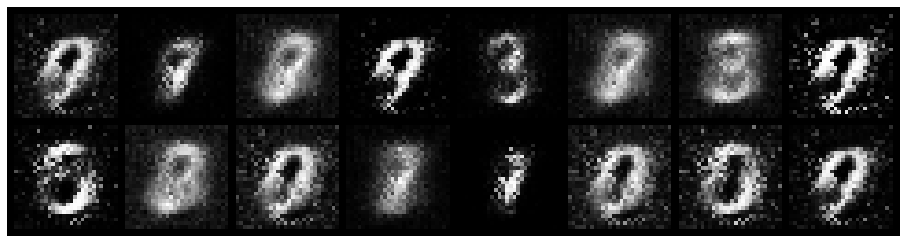

Epoch: [6/200], Batch Num: [0/600]
Discriminator Loss: 0.7331, Generator Loss: 2.1057
D(x): 0.8250, D(G(z)): 0.3207


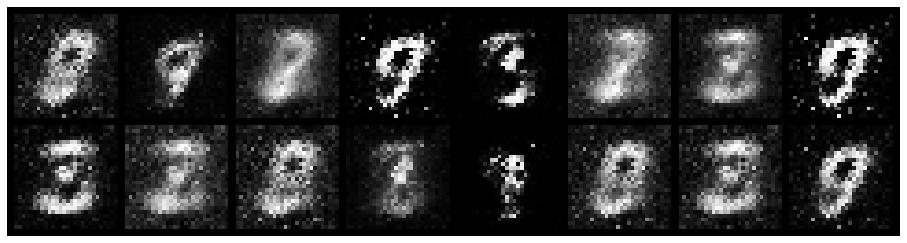

Epoch: [6/200], Batch Num: [100/600]
Discriminator Loss: 0.5776, Generator Loss: 3.4640
D(x): 0.8899, D(G(z)): 0.2031


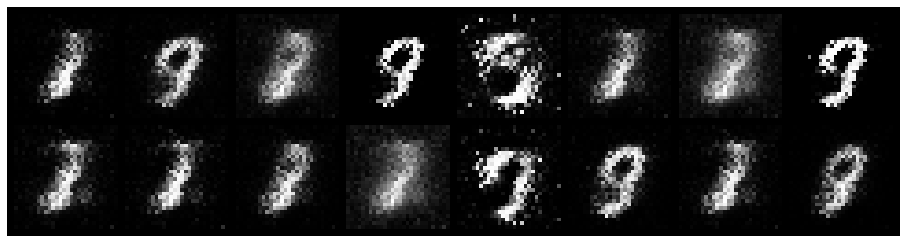

Epoch: [6/200], Batch Num: [200/600]
Discriminator Loss: 0.3986, Generator Loss: 2.7093
D(x): 0.9073, D(G(z)): 0.1419


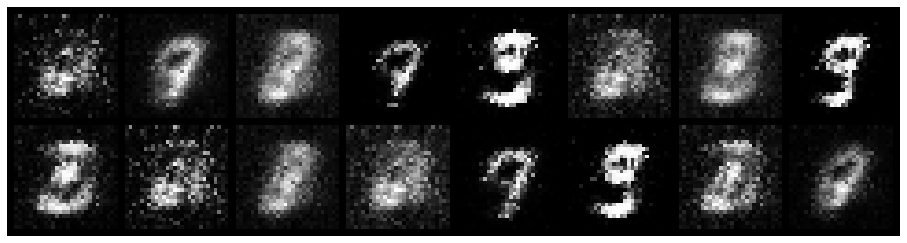

Epoch: [6/200], Batch Num: [300/600]
Discriminator Loss: 0.4495, Generator Loss: 3.6554
D(x): 0.8871, D(G(z)): 0.1388


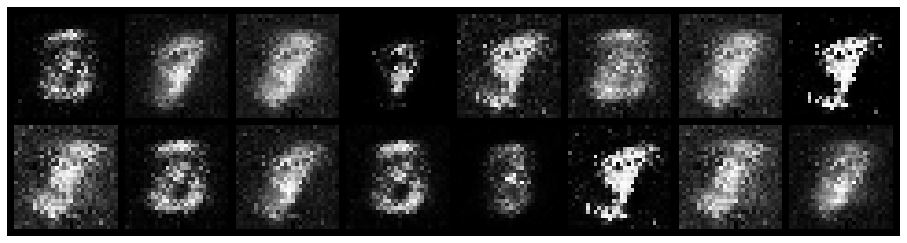

Epoch: [6/200], Batch Num: [400/600]
Discriminator Loss: 0.5734, Generator Loss: 2.5012
D(x): 0.7869, D(G(z)): 0.1106


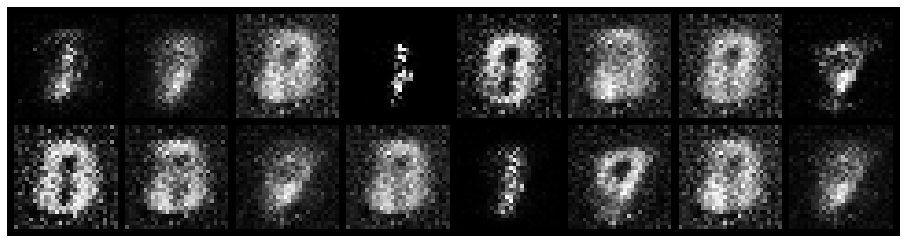

Epoch: [6/200], Batch Num: [500/600]
Discriminator Loss: 0.4621, Generator Loss: 2.9960
D(x): 0.9001, D(G(z)): 0.1721


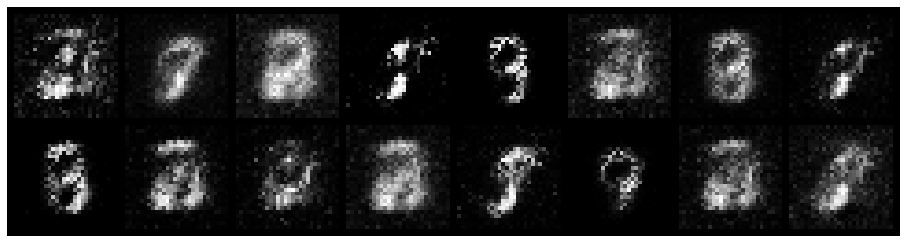

Epoch: [7/200], Batch Num: [0/600]
Discriminator Loss: 0.8101, Generator Loss: 2.5913
D(x): 0.7041, D(G(z)): 0.1372


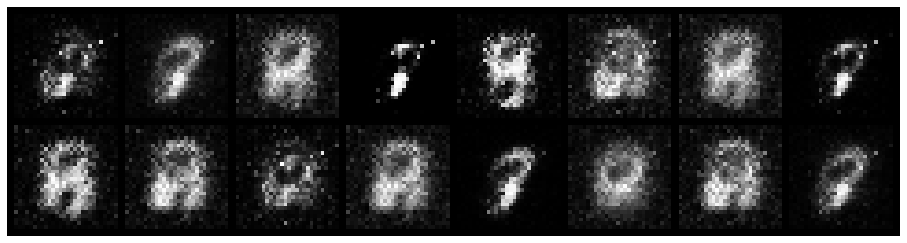

Epoch: [7/200], Batch Num: [100/600]
Discriminator Loss: 0.3426, Generator Loss: 2.9356
D(x): 0.8896, D(G(z)): 0.1219


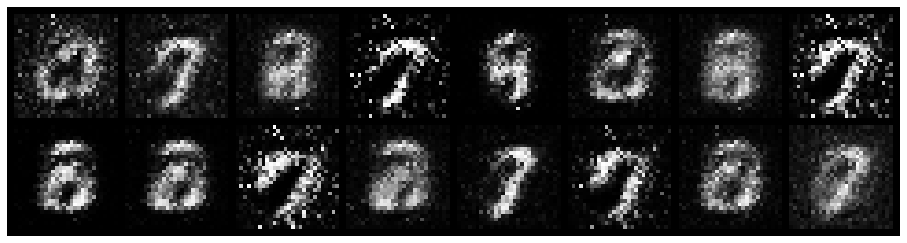

Epoch: [7/200], Batch Num: [200/600]
Discriminator Loss: 0.4847, Generator Loss: 2.7230
D(x): 0.8847, D(G(z)): 0.2187


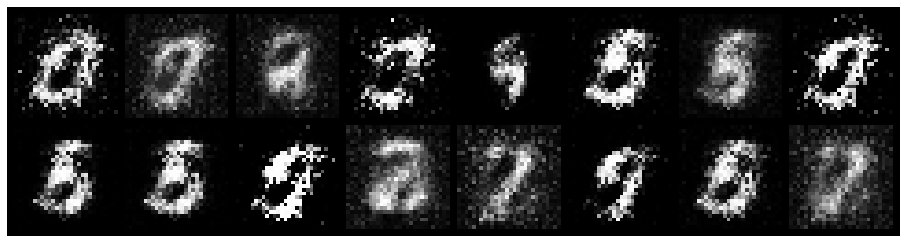

Epoch: [7/200], Batch Num: [300/600]
Discriminator Loss: 0.4653, Generator Loss: 2.8262
D(x): 0.8396, D(G(z)): 0.1408


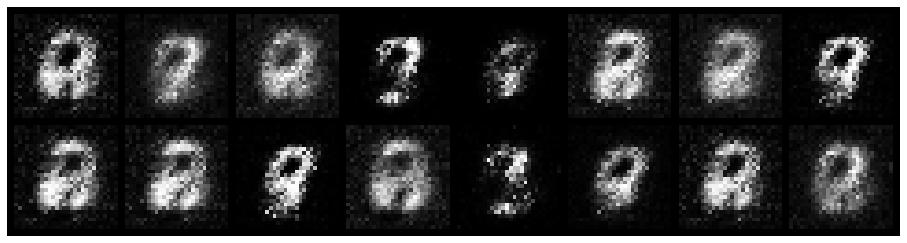

Epoch: [7/200], Batch Num: [400/600]
Discriminator Loss: 0.7281, Generator Loss: 2.5239
D(x): 0.8315, D(G(z)): 0.2519


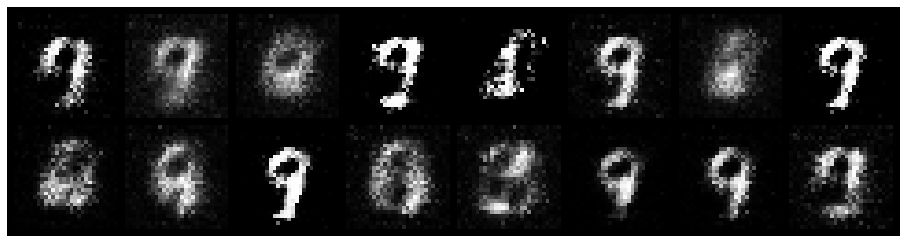

Epoch: [7/200], Batch Num: [500/600]
Discriminator Loss: 0.7233, Generator Loss: 2.6727
D(x): 0.7023, D(G(z)): 0.1580


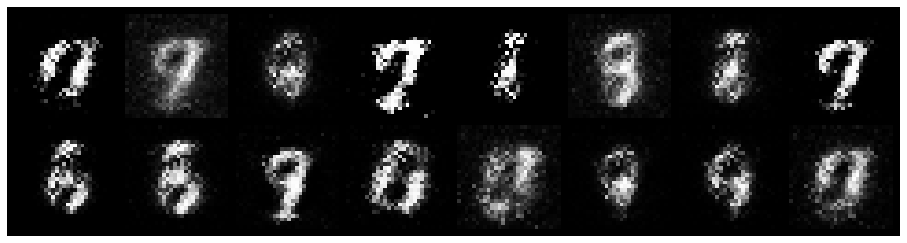

Epoch: [8/200], Batch Num: [0/600]
Discriminator Loss: 0.4264, Generator Loss: 3.4212
D(x): 0.8243, D(G(z)): 0.1208


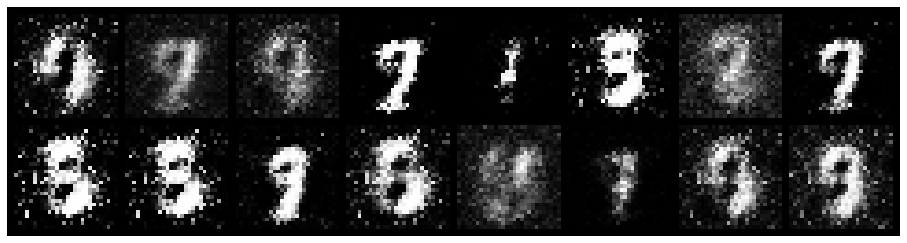

Epoch: [8/200], Batch Num: [100/600]
Discriminator Loss: 0.4853, Generator Loss: 2.0785
D(x): 0.8565, D(G(z)): 0.1654


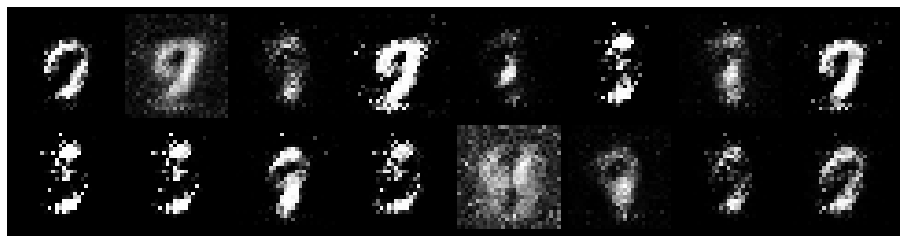

Epoch: [8/200], Batch Num: [200/600]
Discriminator Loss: 0.4779, Generator Loss: 2.8704
D(x): 0.8592, D(G(z)): 0.1246


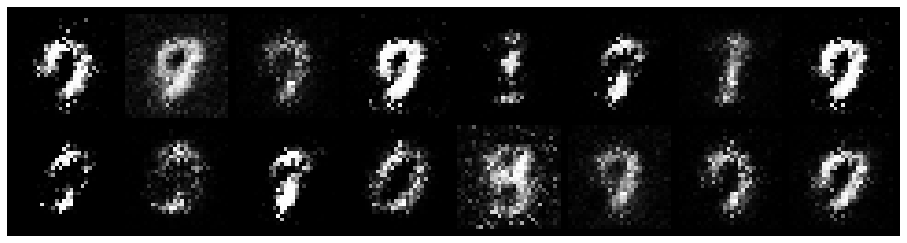

Epoch: [8/200], Batch Num: [300/600]
Discriminator Loss: 0.5356, Generator Loss: 2.7684
D(x): 0.8978, D(G(z)): 0.2525


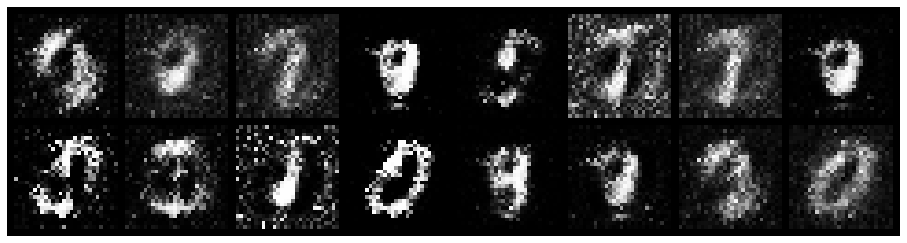

Epoch: [8/200], Batch Num: [400/600]
Discriminator Loss: 0.5896, Generator Loss: 2.7951
D(x): 0.8623, D(G(z)): 0.2290


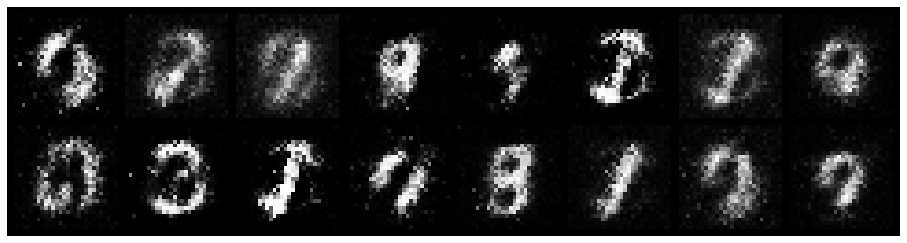

Epoch: [8/200], Batch Num: [500/600]
Discriminator Loss: 0.5291, Generator Loss: 2.5205
D(x): 0.8599, D(G(z)): 0.1877


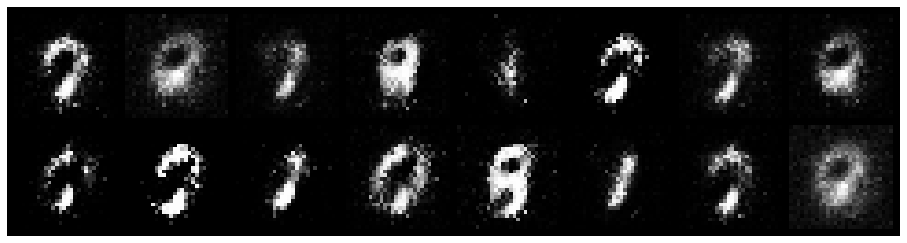

Epoch: [9/200], Batch Num: [0/600]
Discriminator Loss: 0.7847, Generator Loss: 1.9262
D(x): 0.6938, D(G(z)): 0.1611


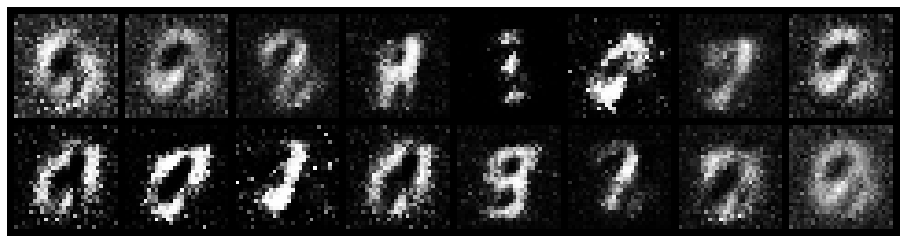

Epoch: [9/200], Batch Num: [100/600]
Discriminator Loss: 0.6870, Generator Loss: 2.1695
D(x): 0.8186, D(G(z)): 0.2307


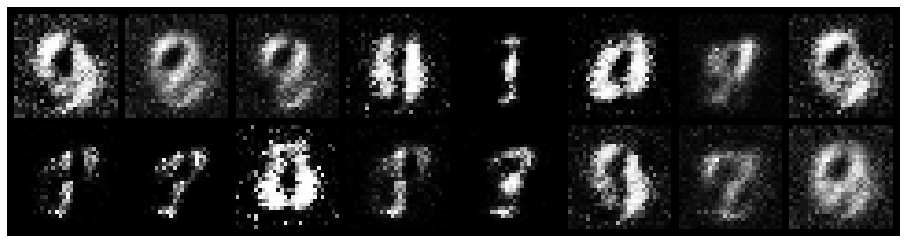

Epoch: [9/200], Batch Num: [200/600]
Discriminator Loss: 0.9964, Generator Loss: 1.7926
D(x): 0.6639, D(G(z)): 0.2052


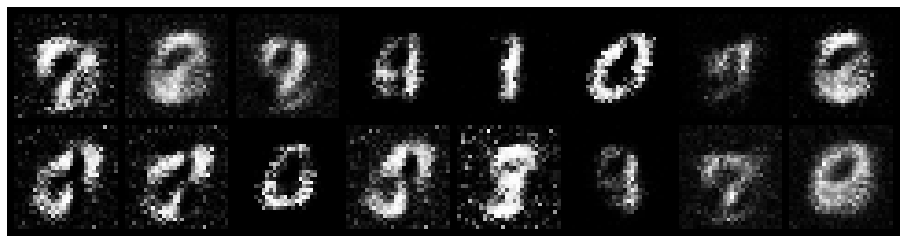

Epoch: [9/200], Batch Num: [300/600]
Discriminator Loss: 0.7160, Generator Loss: 2.2563
D(x): 0.7447, D(G(z)): 0.1567


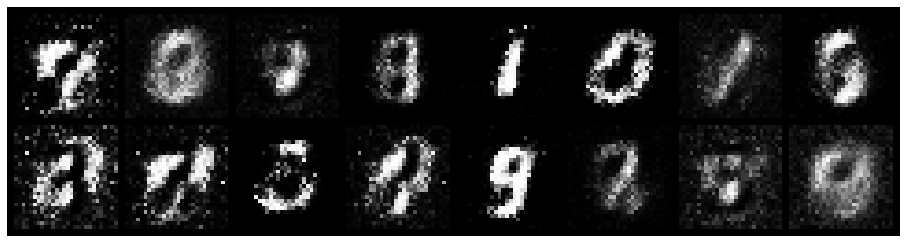

Epoch: [9/200], Batch Num: [400/600]
Discriminator Loss: 0.4219, Generator Loss: 2.1629
D(x): 0.8653, D(G(z)): 0.1438


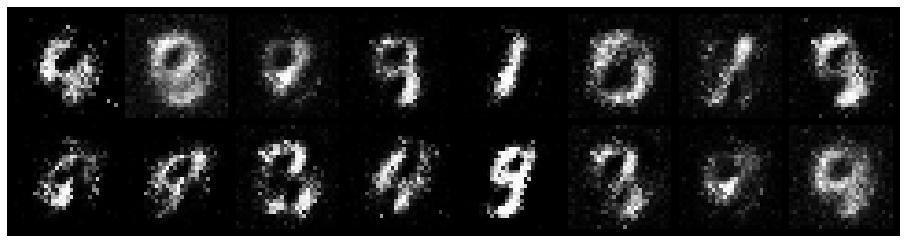

Epoch: [9/200], Batch Num: [500/600]
Discriminator Loss: 0.6147, Generator Loss: 2.7133
D(x): 0.9193, D(G(z)): 0.2905


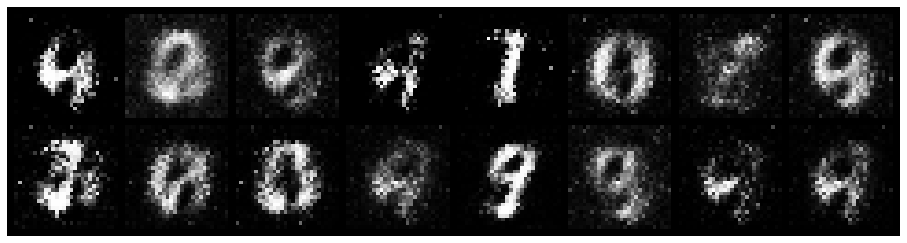

Epoch: [10/200], Batch Num: [0/600]
Discriminator Loss: 0.4574, Generator Loss: 2.0975
D(x): 0.8661, D(G(z)): 0.2048


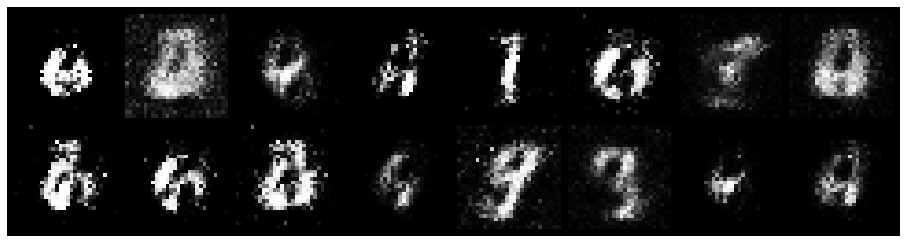

Epoch: [10/200], Batch Num: [100/600]
Discriminator Loss: 0.6941, Generator Loss: 1.4614
D(x): 0.7865, D(G(z)): 0.2722


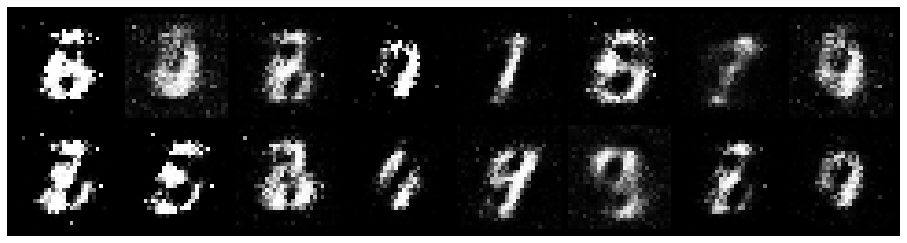

Epoch: [10/200], Batch Num: [200/600]
Discriminator Loss: 0.8443, Generator Loss: 2.2900
D(x): 0.6656, D(G(z)): 0.1916


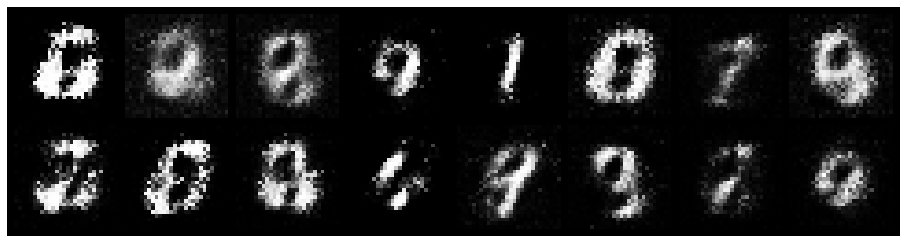

Epoch: [10/200], Batch Num: [300/600]
Discriminator Loss: 0.5260, Generator Loss: 2.2098
D(x): 0.8399, D(G(z)): 0.1716


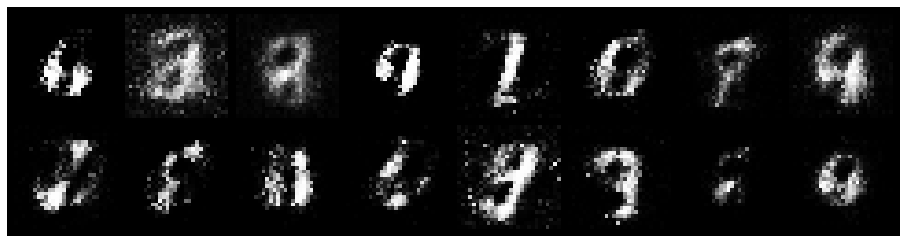

Epoch: [10/200], Batch Num: [400/600]
Discriminator Loss: 0.5446, Generator Loss: 2.2730
D(x): 0.8995, D(G(z)): 0.2919


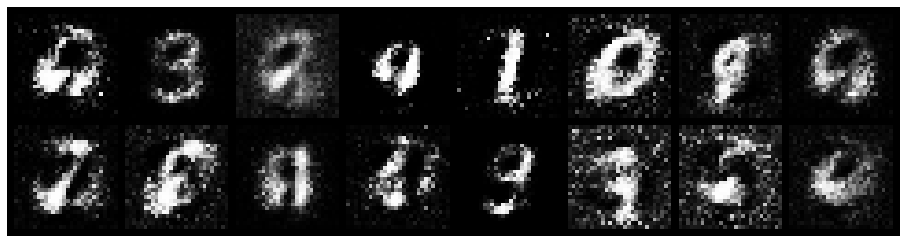

Epoch: [10/200], Batch Num: [500/600]
Discriminator Loss: 1.0821, Generator Loss: 1.4691
D(x): 0.7162, D(G(z)): 0.3934


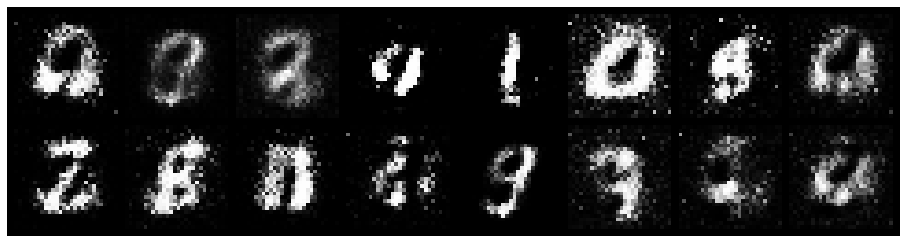

Epoch: [11/200], Batch Num: [0/600]
Discriminator Loss: 0.6318, Generator Loss: 2.9872
D(x): 0.8069, D(G(z)): 0.1746


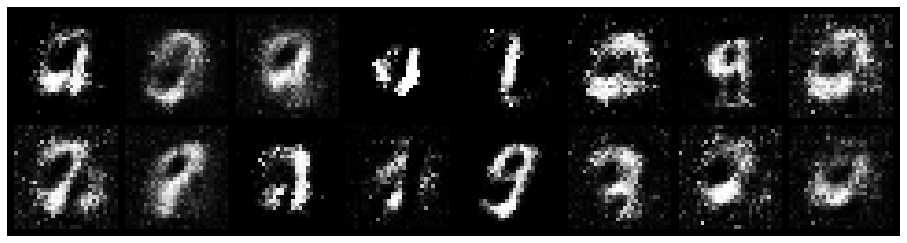

Epoch: [11/200], Batch Num: [100/600]
Discriminator Loss: 0.5495, Generator Loss: 2.2871
D(x): 0.8651, D(G(z)): 0.2152


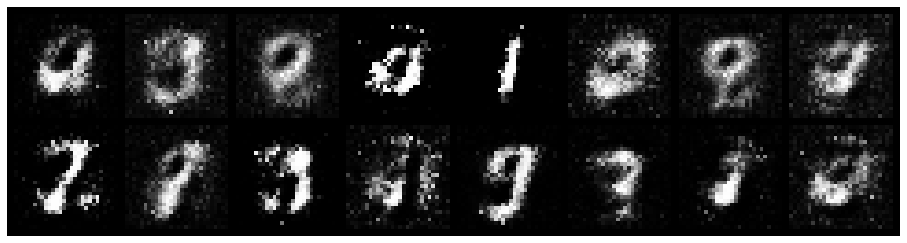

Epoch: [11/200], Batch Num: [200/600]
Discriminator Loss: 0.5202, Generator Loss: 2.2095
D(x): 0.8711, D(G(z)): 0.2150


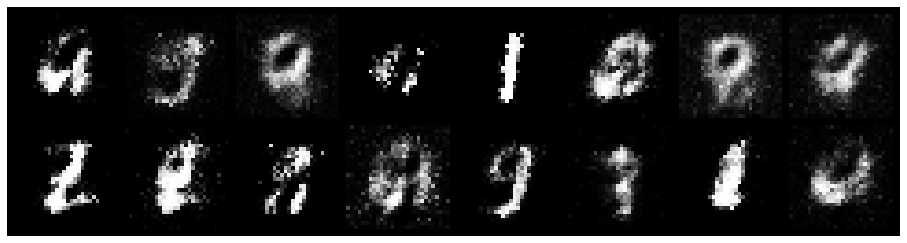

Epoch: [11/200], Batch Num: [300/600]
Discriminator Loss: 0.6871, Generator Loss: 2.2490
D(x): 0.7460, D(G(z)): 0.1561


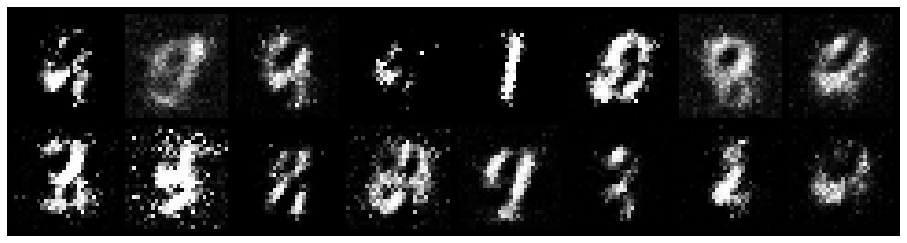

Epoch: [11/200], Batch Num: [400/600]
Discriminator Loss: 0.5743, Generator Loss: 2.8212
D(x): 0.8212, D(G(z)): 0.1769


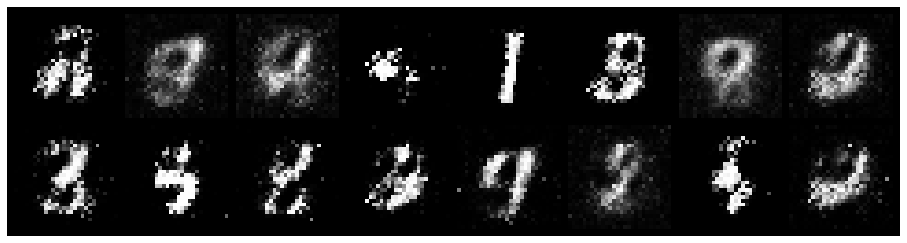

Epoch: [11/200], Batch Num: [500/600]
Discriminator Loss: 0.7281, Generator Loss: 1.9872
D(x): 0.8166, D(G(z)): 0.2960


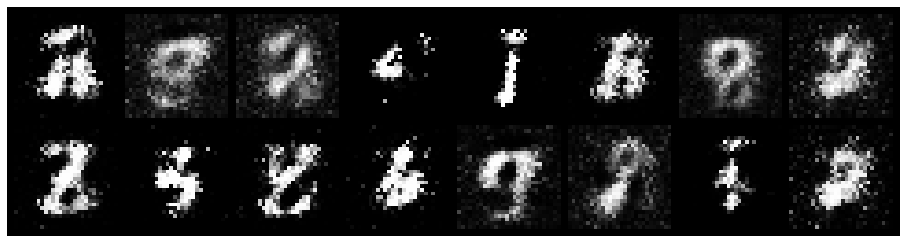

Epoch: [12/200], Batch Num: [0/600]
Discriminator Loss: 0.6163, Generator Loss: 2.0774
D(x): 0.7838, D(G(z)): 0.2311


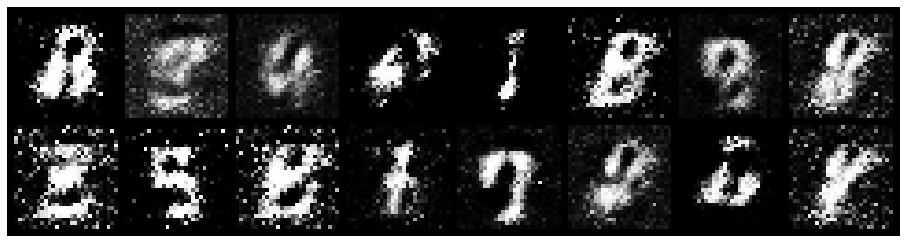

Epoch: [12/200], Batch Num: [100/600]
Discriminator Loss: 0.8754, Generator Loss: 2.1791
D(x): 0.7187, D(G(z)): 0.2543


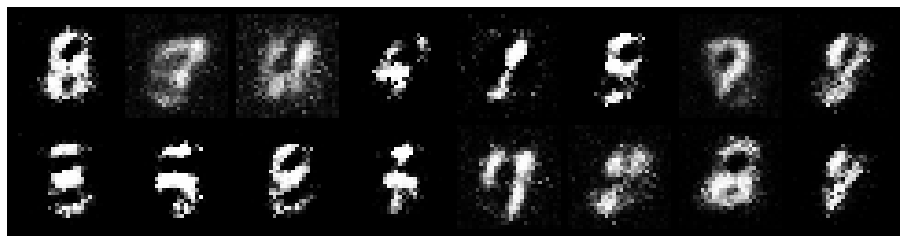

Epoch: [12/200], Batch Num: [200/600]
Discriminator Loss: 0.6972, Generator Loss: 2.0085
D(x): 0.7386, D(G(z)): 0.2011


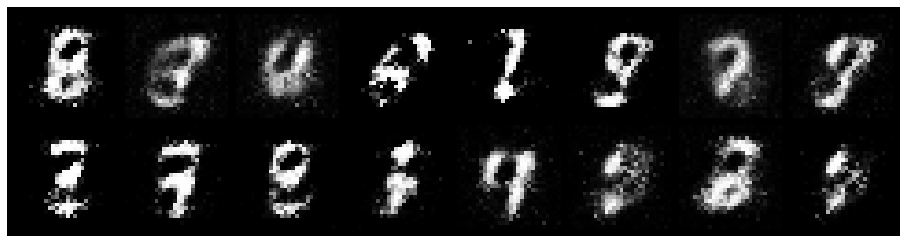

Epoch: [12/200], Batch Num: [300/600]
Discriminator Loss: 0.4667, Generator Loss: 2.6397
D(x): 0.8313, D(G(z)): 0.1518


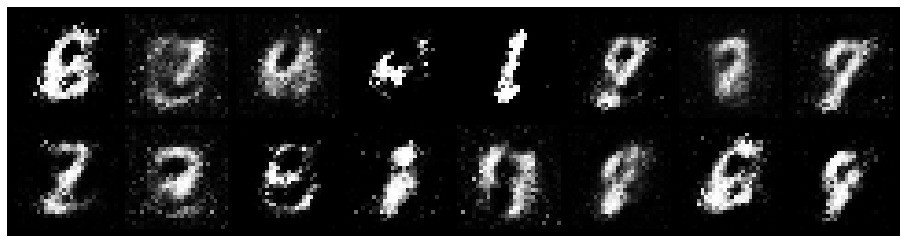

Epoch: [12/200], Batch Num: [400/600]
Discriminator Loss: 0.8514, Generator Loss: 1.7886
D(x): 0.7947, D(G(z)): 0.3064


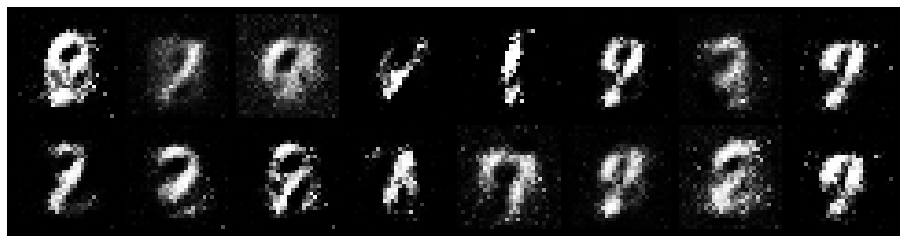

Epoch: [12/200], Batch Num: [500/600]
Discriminator Loss: 0.5325, Generator Loss: 2.3300
D(x): 0.8348, D(G(z)): 0.1858


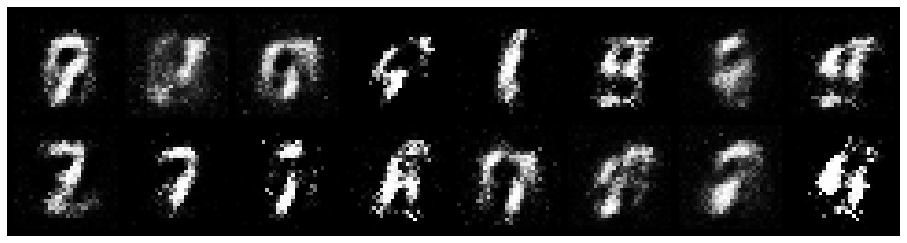

Epoch: [13/200], Batch Num: [0/600]
Discriminator Loss: 0.7888, Generator Loss: 1.7634
D(x): 0.7937, D(G(z)): 0.3207


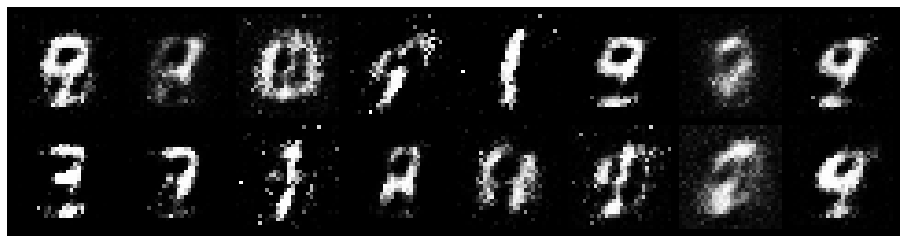

Epoch: [13/200], Batch Num: [100/600]
Discriminator Loss: 0.7968, Generator Loss: 1.6174
D(x): 0.7199, D(G(z)): 0.2715


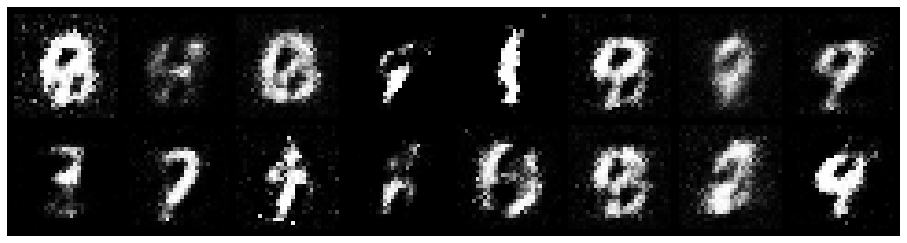

Epoch: [13/200], Batch Num: [200/600]
Discriminator Loss: 0.6206, Generator Loss: 2.7200
D(x): 0.8362, D(G(z)): 0.2212


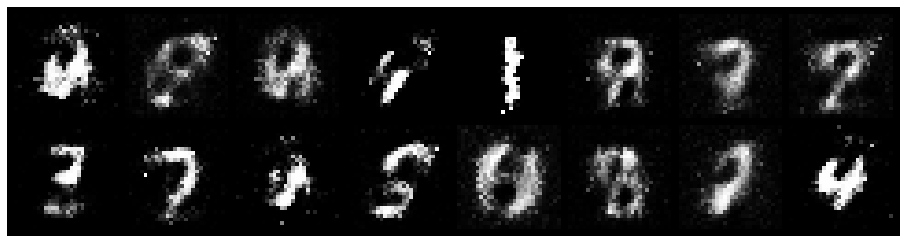

Epoch: [13/200], Batch Num: [300/600]
Discriminator Loss: 0.6879, Generator Loss: 2.0272
D(x): 0.8355, D(G(z)): 0.2842


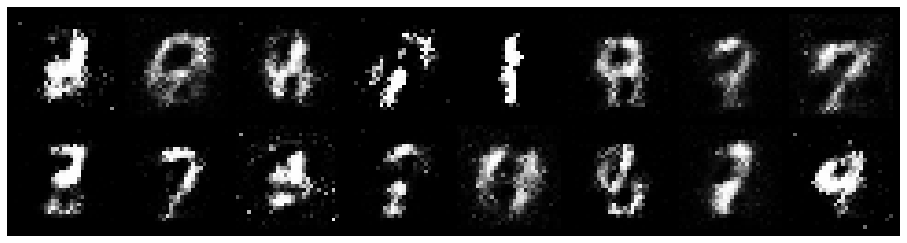

Epoch: [13/200], Batch Num: [400/600]
Discriminator Loss: 0.5524, Generator Loss: 1.7340
D(x): 0.8076, D(G(z)): 0.1619


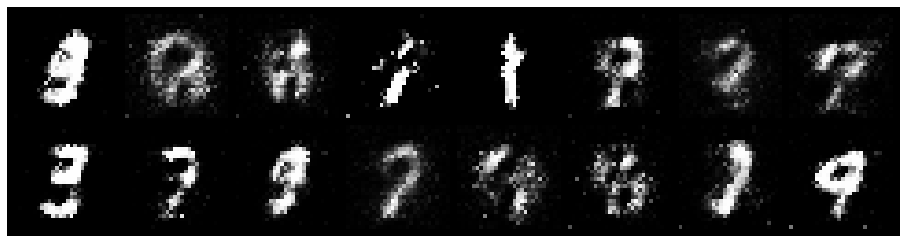

Epoch: [13/200], Batch Num: [500/600]
Discriminator Loss: 0.6357, Generator Loss: 2.2354
D(x): 0.7949, D(G(z)): 0.1856


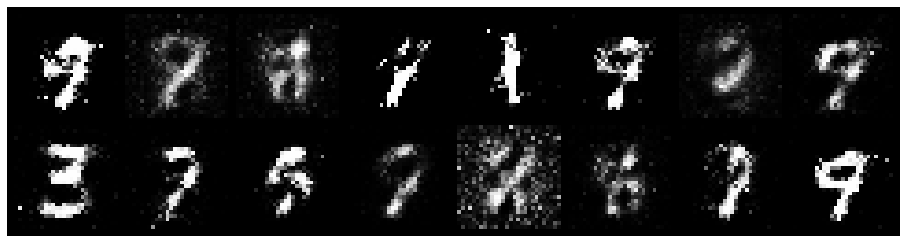

Epoch: [14/200], Batch Num: [0/600]
Discriminator Loss: 0.7590, Generator Loss: 2.0204
D(x): 0.6965, D(G(z)): 0.1809


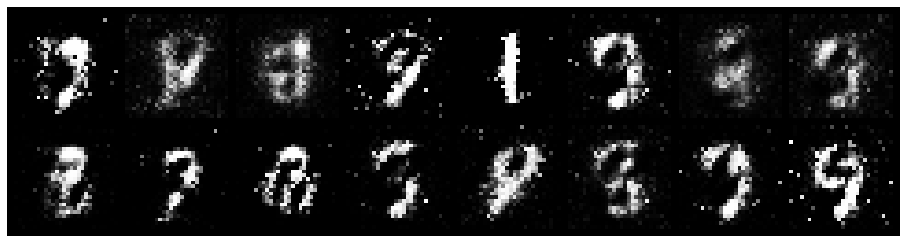

Epoch: [14/200], Batch Num: [100/600]
Discriminator Loss: 0.8542, Generator Loss: 2.2374
D(x): 0.7382, D(G(z)): 0.2855


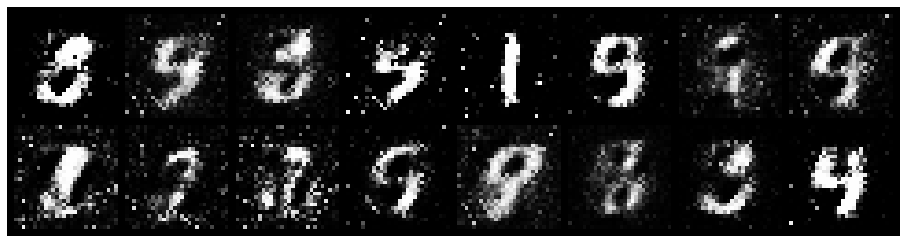

Epoch: [14/200], Batch Num: [200/600]
Discriminator Loss: 0.8385, Generator Loss: 3.1069
D(x): 0.6731, D(G(z)): 0.1604


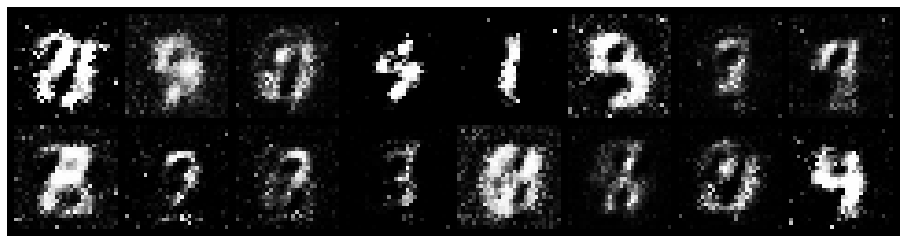

Epoch: [14/200], Batch Num: [300/600]
Discriminator Loss: 1.0455, Generator Loss: 1.8498
D(x): 0.6626, D(G(z)): 0.2647


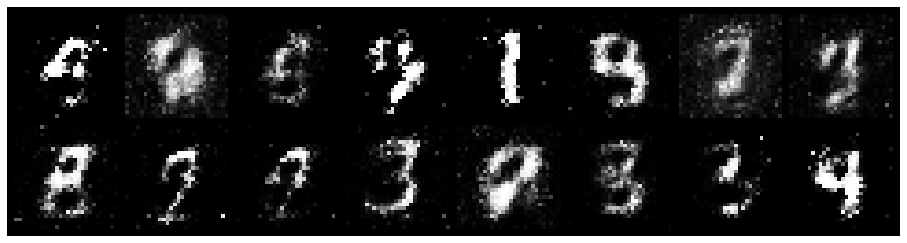

Epoch: [14/200], Batch Num: [400/600]
Discriminator Loss: 0.7255, Generator Loss: 1.9756
D(x): 0.7544, D(G(z)): 0.2228


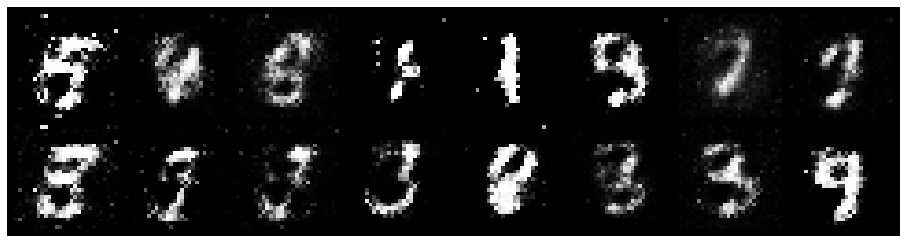

Epoch: [14/200], Batch Num: [500/600]
Discriminator Loss: 0.5163, Generator Loss: 1.7977
D(x): 0.8290, D(G(z)): 0.2110


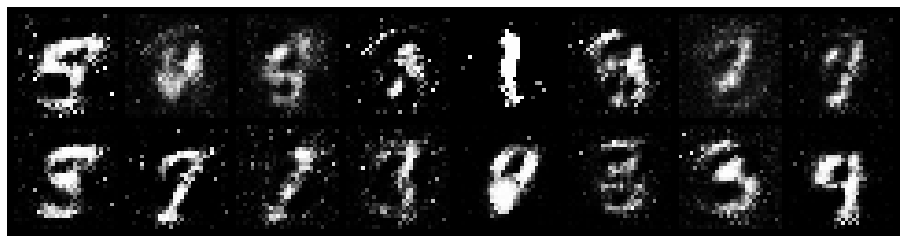

Epoch: [15/200], Batch Num: [0/600]
Discriminator Loss: 0.6160, Generator Loss: 2.1044
D(x): 0.8115, D(G(z)): 0.2421


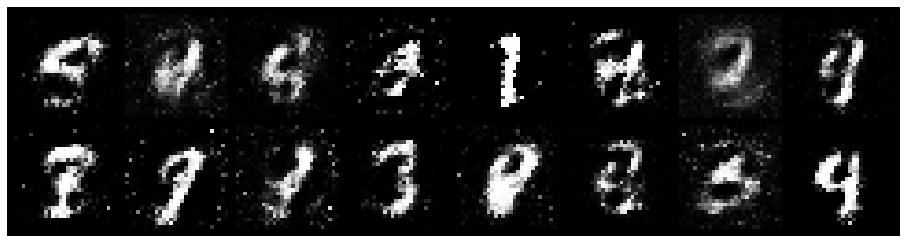

Epoch: [15/200], Batch Num: [100/600]
Discriminator Loss: 0.7074, Generator Loss: 2.1740
D(x): 0.7893, D(G(z)): 0.2551


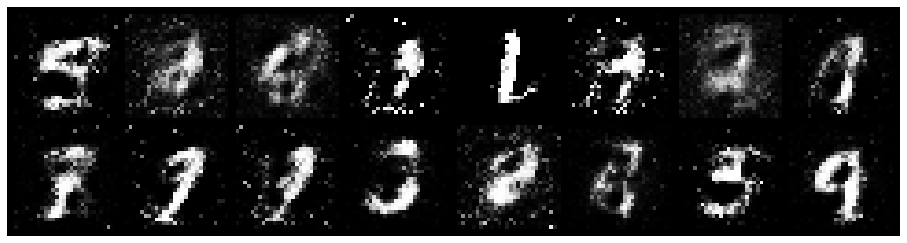

Epoch: [15/200], Batch Num: [200/600]
Discriminator Loss: 0.8693, Generator Loss: 2.0344
D(x): 0.7514, D(G(z)): 0.2936


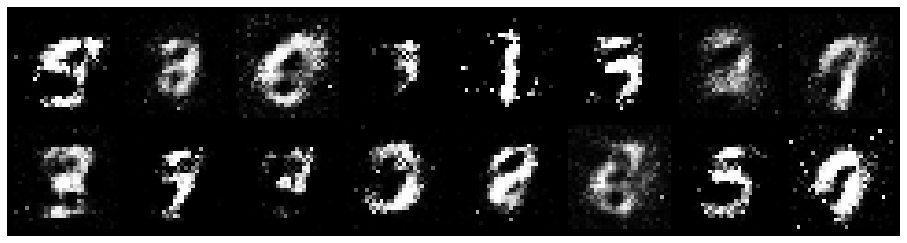

Epoch: [15/200], Batch Num: [300/600]
Discriminator Loss: 0.8228, Generator Loss: 1.4409
D(x): 0.7515, D(G(z)): 0.3182


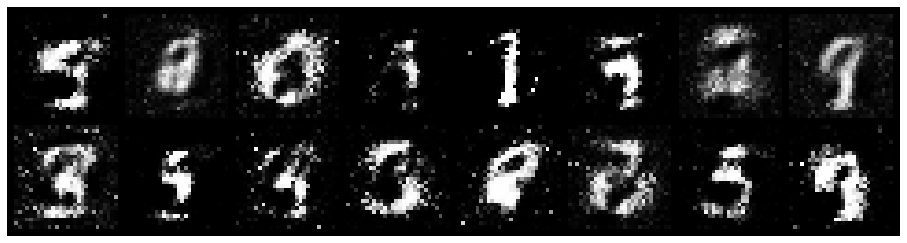

Epoch: [15/200], Batch Num: [400/600]
Discriminator Loss: 0.8632, Generator Loss: 1.6573
D(x): 0.7583, D(G(z)): 0.3182


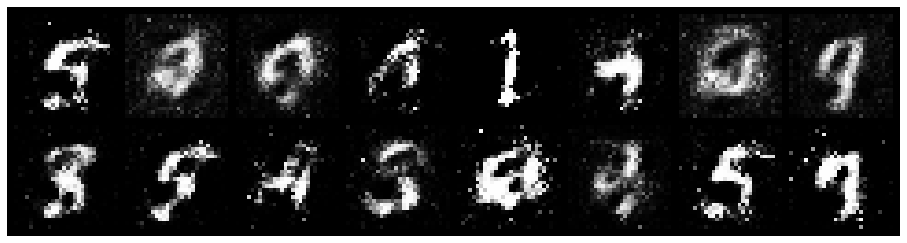

Epoch: [15/200], Batch Num: [500/600]
Discriminator Loss: 0.7825, Generator Loss: 1.9714
D(x): 0.6869, D(G(z)): 0.1774


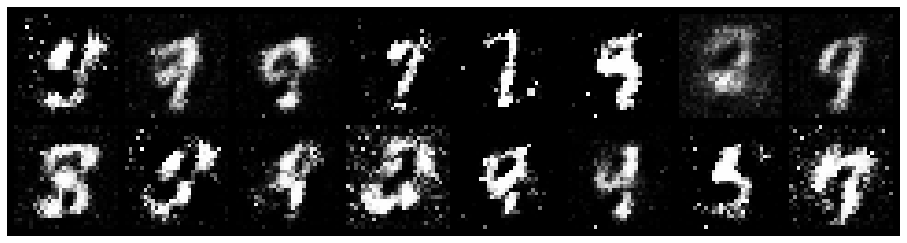

Epoch: [16/200], Batch Num: [0/600]
Discriminator Loss: 0.8275, Generator Loss: 2.0177
D(x): 0.7617, D(G(z)): 0.2918


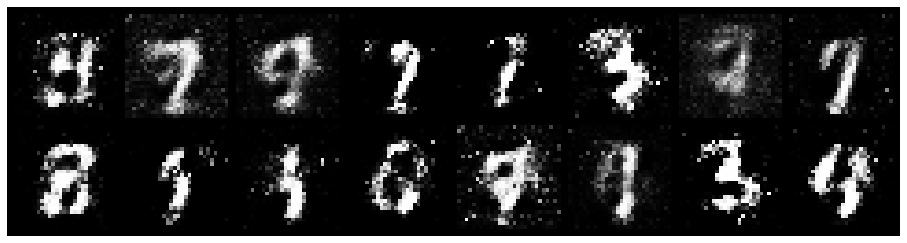

Epoch: [16/200], Batch Num: [100/600]
Discriminator Loss: 0.8690, Generator Loss: 1.9642
D(x): 0.7008, D(G(z)): 0.2048


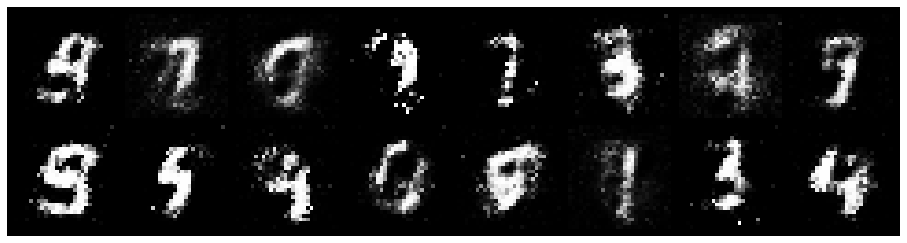

Epoch: [16/200], Batch Num: [200/600]
Discriminator Loss: 0.8039, Generator Loss: 2.3271
D(x): 0.7741, D(G(z)): 0.2377


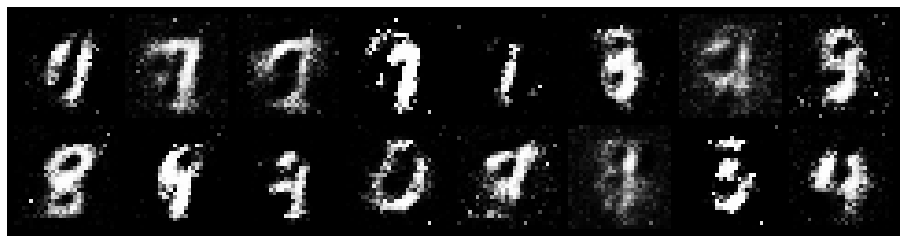

Epoch: [16/200], Batch Num: [300/600]
Discriminator Loss: 0.6179, Generator Loss: 2.1017
D(x): 0.8176, D(G(z)): 0.2125


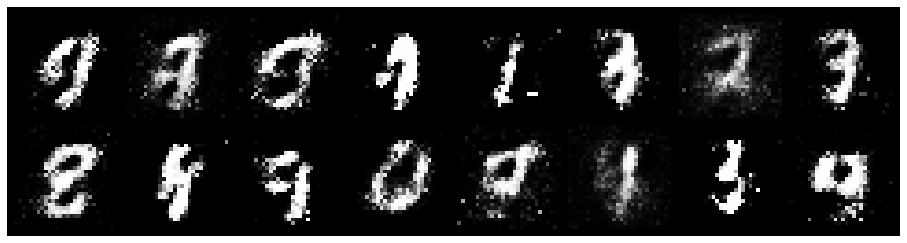

Epoch: [16/200], Batch Num: [400/600]
Discriminator Loss: 0.6035, Generator Loss: 2.0079
D(x): 0.7935, D(G(z)): 0.2061


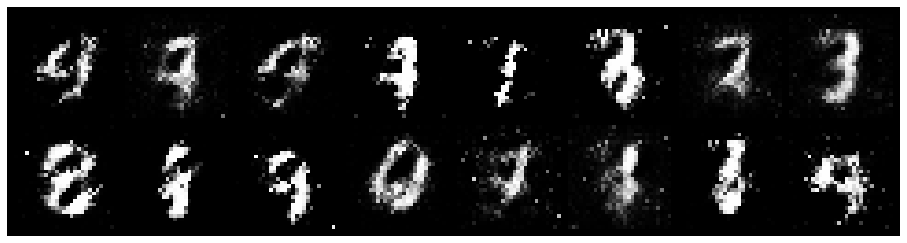

Epoch: [16/200], Batch Num: [500/600]
Discriminator Loss: 0.5770, Generator Loss: 1.7821
D(x): 0.8385, D(G(z)): 0.2409


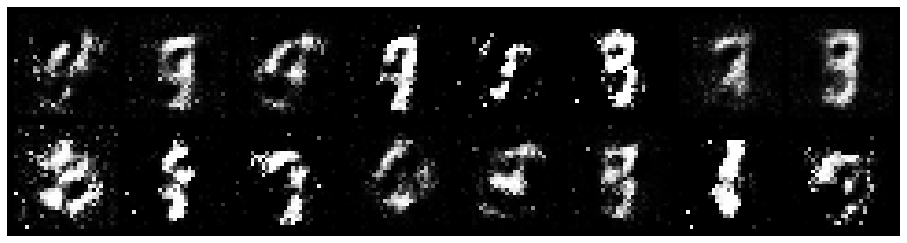

Epoch: [17/200], Batch Num: [0/600]
Discriminator Loss: 0.8065, Generator Loss: 2.5355
D(x): 0.7431, D(G(z)): 0.1904


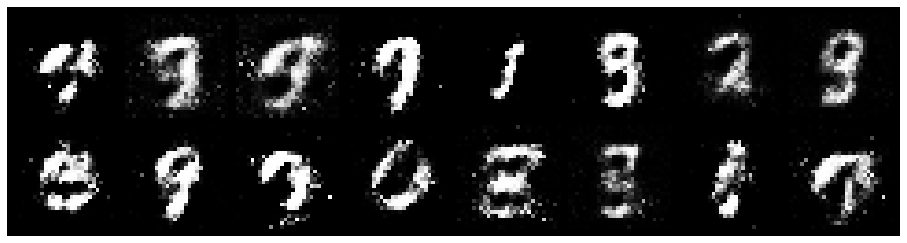

Epoch: [17/200], Batch Num: [100/600]
Discriminator Loss: 0.6642, Generator Loss: 2.1198
D(x): 0.7638, D(G(z)): 0.2108


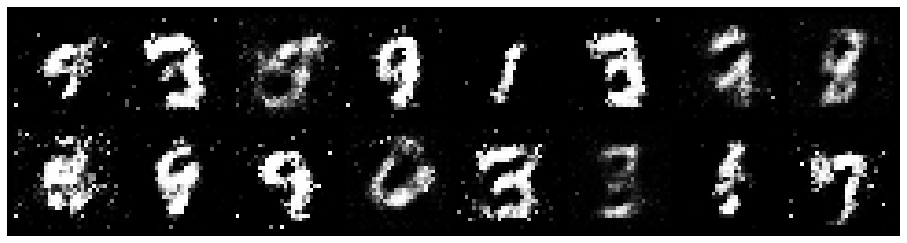

Epoch: [17/200], Batch Num: [200/600]
Discriminator Loss: 0.7603, Generator Loss: 2.4304
D(x): 0.7036, D(G(z)): 0.1969


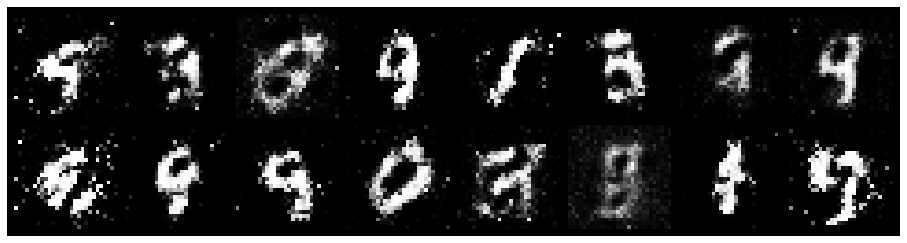

Epoch: [17/200], Batch Num: [300/600]
Discriminator Loss: 1.1098, Generator Loss: 2.1453
D(x): 0.6582, D(G(z)): 0.2732


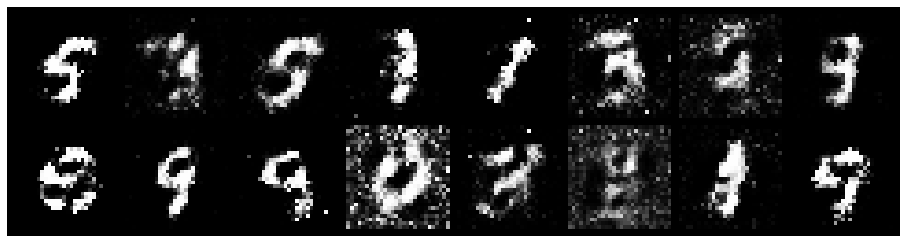

Epoch: [17/200], Batch Num: [400/600]
Discriminator Loss: 0.6560, Generator Loss: 1.9540
D(x): 0.8304, D(G(z)): 0.2515


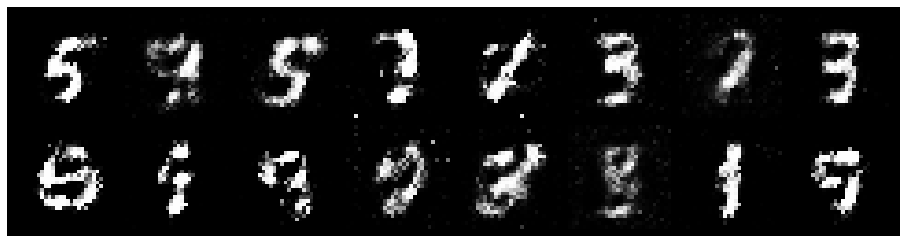

Epoch: [17/200], Batch Num: [500/600]
Discriminator Loss: 0.6998, Generator Loss: 2.6585
D(x): 0.7608, D(G(z)): 0.2132


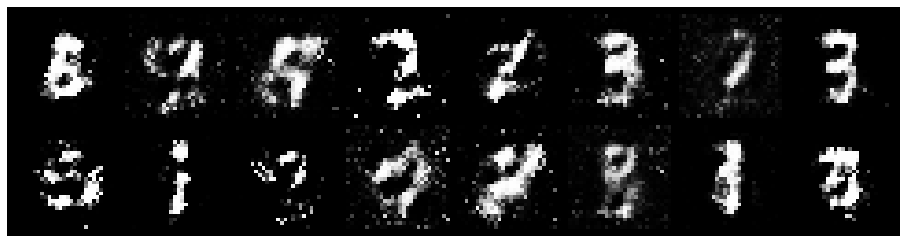

Epoch: [18/200], Batch Num: [0/600]
Discriminator Loss: 0.8196, Generator Loss: 1.7013
D(x): 0.7630, D(G(z)): 0.2812


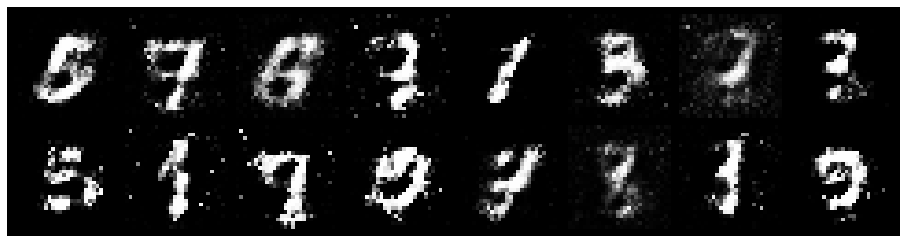

Epoch: [18/200], Batch Num: [100/600]
Discriminator Loss: 0.8043, Generator Loss: 1.8789
D(x): 0.6939, D(G(z)): 0.2289


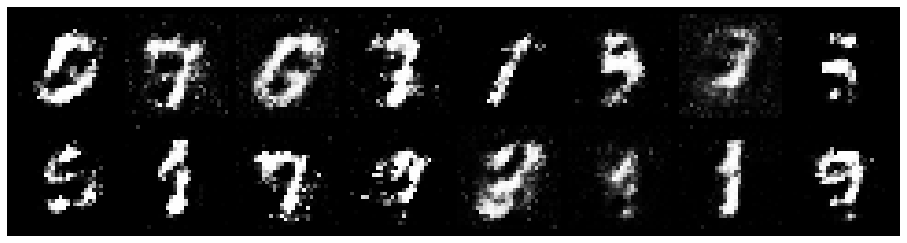

Epoch: [18/200], Batch Num: [200/600]
Discriminator Loss: 0.8875, Generator Loss: 1.9597
D(x): 0.8036, D(G(z)): 0.3375


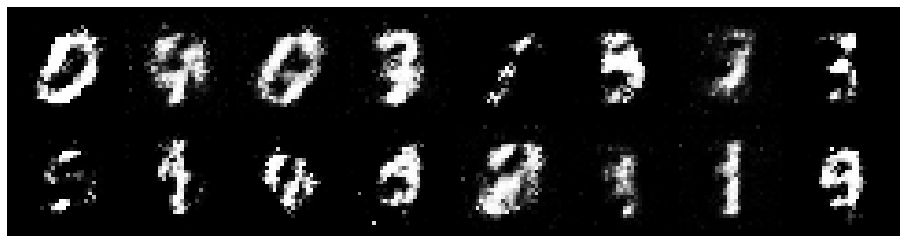

Epoch: [18/200], Batch Num: [300/600]
Discriminator Loss: 0.9730, Generator Loss: 1.4928
D(x): 0.7233, D(G(z)): 0.3544


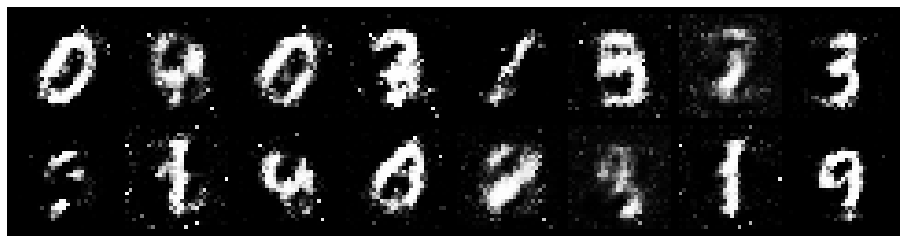

Epoch: [18/200], Batch Num: [400/600]
Discriminator Loss: 0.8876, Generator Loss: 1.7364
D(x): 0.6939, D(G(z)): 0.2053


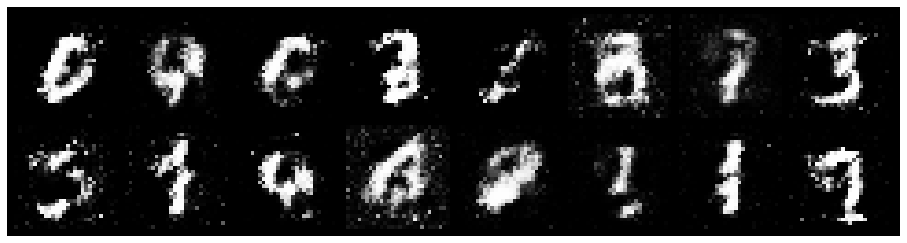

Epoch: [18/200], Batch Num: [500/600]
Discriminator Loss: 0.9931, Generator Loss: 1.5835
D(x): 0.7117, D(G(z)): 0.3121


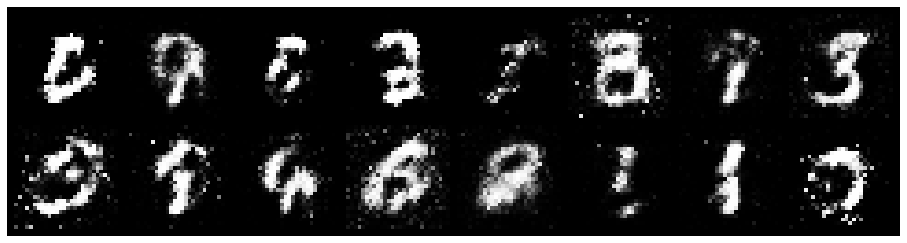

Epoch: [19/200], Batch Num: [0/600]
Discriminator Loss: 0.7557, Generator Loss: 2.4728
D(x): 0.7539, D(G(z)): 0.2641


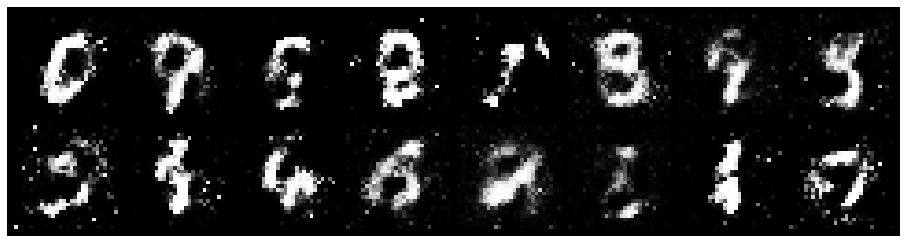

Epoch: [19/200], Batch Num: [100/600]
Discriminator Loss: 0.8860, Generator Loss: 1.7552
D(x): 0.6933, D(G(z)): 0.2973


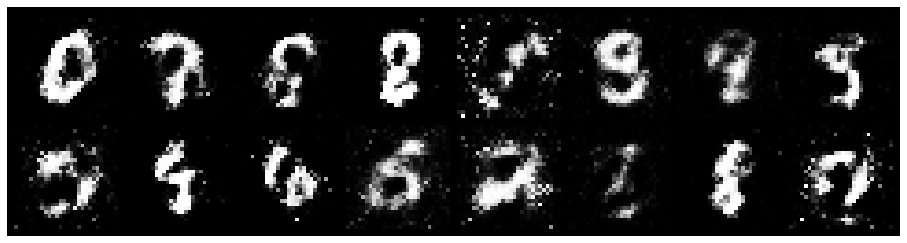

Epoch: [19/200], Batch Num: [200/600]
Discriminator Loss: 0.8052, Generator Loss: 1.9390
D(x): 0.7186, D(G(z)): 0.2858


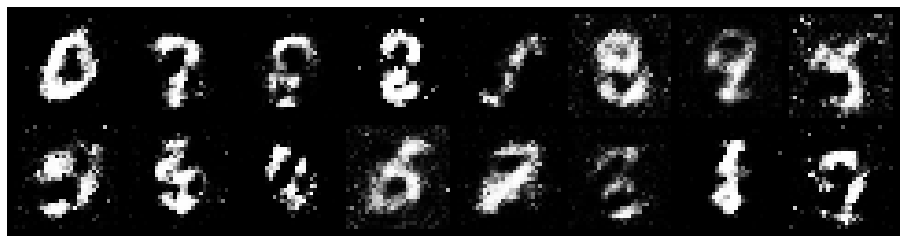

Epoch: [19/200], Batch Num: [300/600]
Discriminator Loss: 0.8297, Generator Loss: 1.2741
D(x): 0.7131, D(G(z)): 0.3022


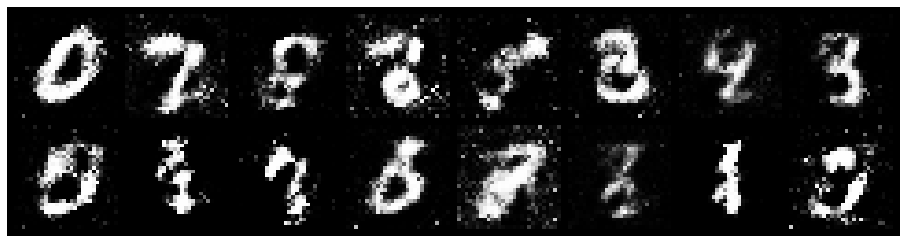

Epoch: [19/200], Batch Num: [400/600]
Discriminator Loss: 0.6930, Generator Loss: 1.8136
D(x): 0.7320, D(G(z)): 0.2069


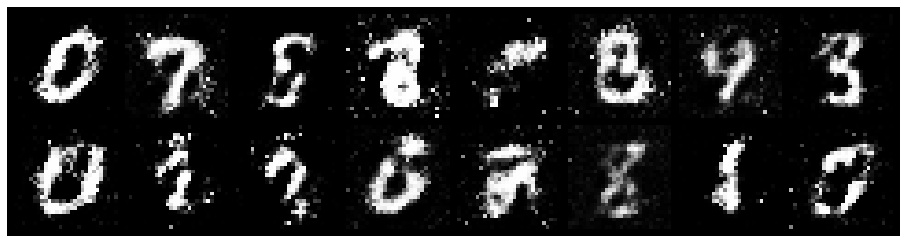

Epoch: [19/200], Batch Num: [500/600]
Discriminator Loss: 0.8388, Generator Loss: 2.1931
D(x): 0.7761, D(G(z)): 0.2920


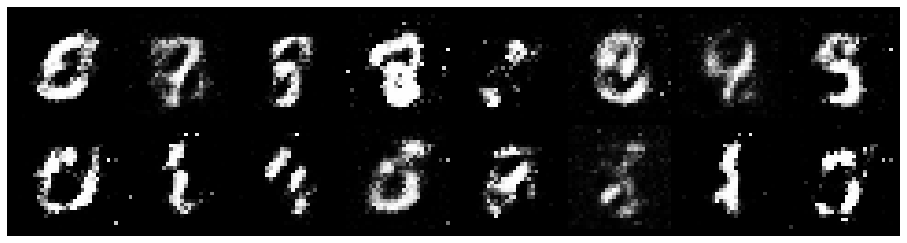

Epoch: [20/200], Batch Num: [0/600]
Discriminator Loss: 0.9586, Generator Loss: 1.1850
D(x): 0.7794, D(G(z)): 0.4283


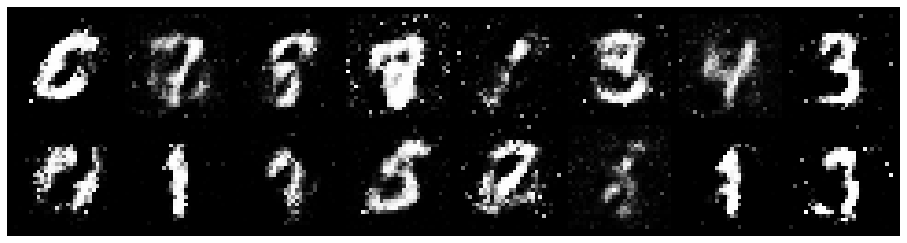

Epoch: [20/200], Batch Num: [100/600]
Discriminator Loss: 1.0193, Generator Loss: 1.5081
D(x): 0.6385, D(G(z)): 0.2839


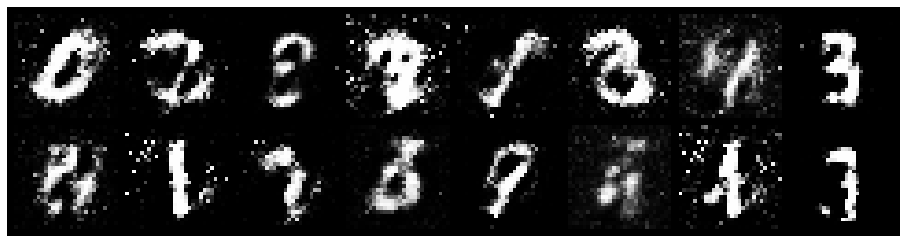

Epoch: [20/200], Batch Num: [200/600]
Discriminator Loss: 1.1328, Generator Loss: 1.1757
D(x): 0.7267, D(G(z)): 0.3888


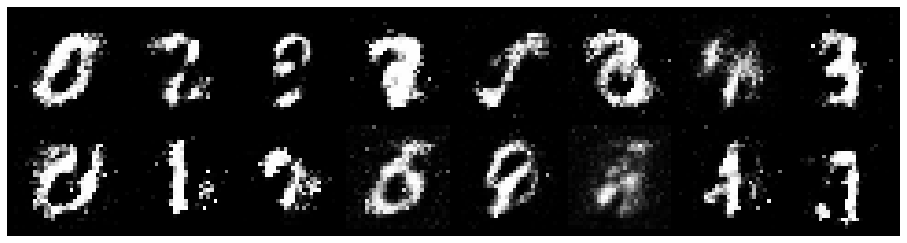

Epoch: [20/200], Batch Num: [300/600]
Discriminator Loss: 1.0096, Generator Loss: 1.5530
D(x): 0.6594, D(G(z)): 0.2927


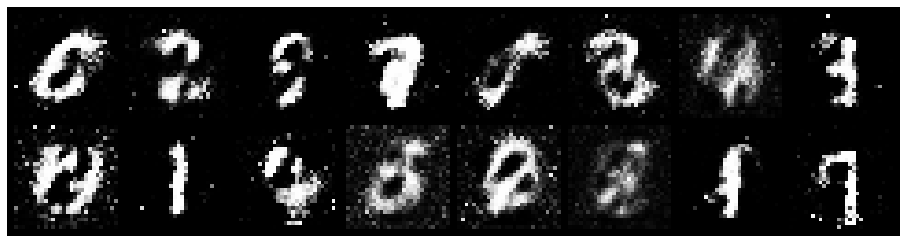

Epoch: [20/200], Batch Num: [400/600]
Discriminator Loss: 0.7528, Generator Loss: 1.7807
D(x): 0.7734, D(G(z)): 0.2720


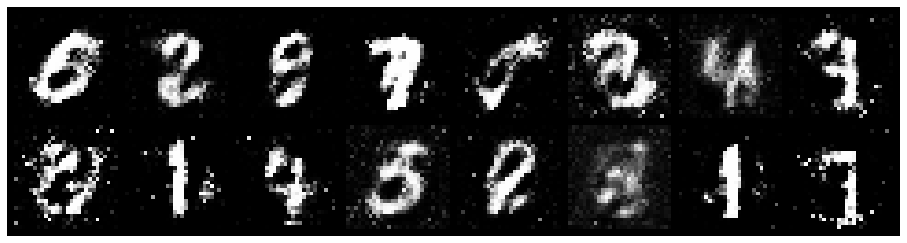

Epoch: [20/200], Batch Num: [500/600]
Discriminator Loss: 0.8261, Generator Loss: 1.8423
D(x): 0.7051, D(G(z)): 0.2527


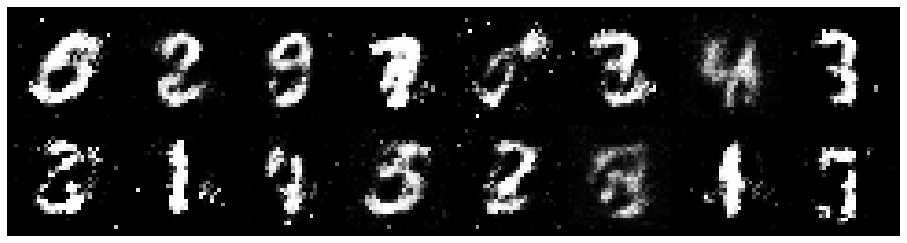

Epoch: [21/200], Batch Num: [0/600]
Discriminator Loss: 0.9452, Generator Loss: 1.3798
D(x): 0.6606, D(G(z)): 0.2927


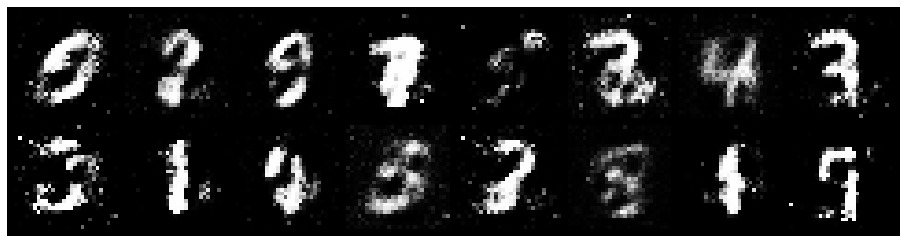

Epoch: [21/200], Batch Num: [100/600]
Discriminator Loss: 0.9330, Generator Loss: 1.5416
D(x): 0.7684, D(G(z)): 0.3583


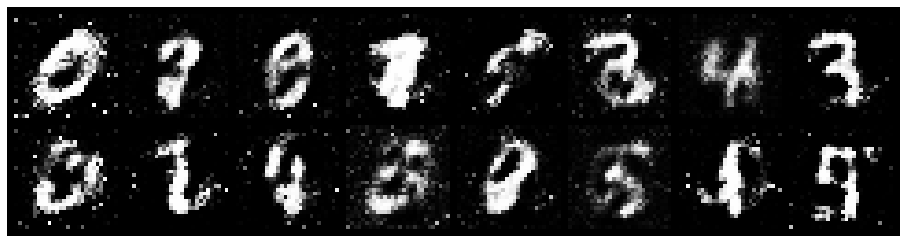

Epoch: [21/200], Batch Num: [200/600]
Discriminator Loss: 0.8621, Generator Loss: 1.6291
D(x): 0.6418, D(G(z)): 0.2226


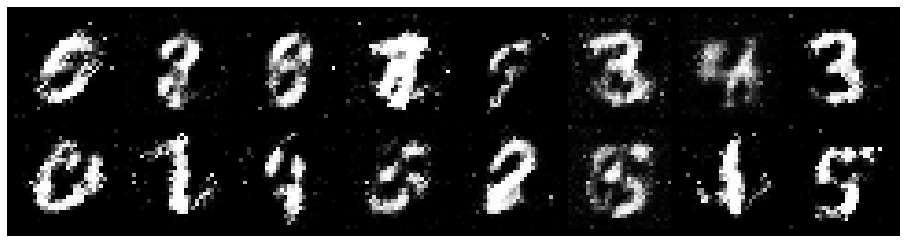

Epoch: [21/200], Batch Num: [300/600]
Discriminator Loss: 0.8733, Generator Loss: 1.4191
D(x): 0.7865, D(G(z)): 0.3445


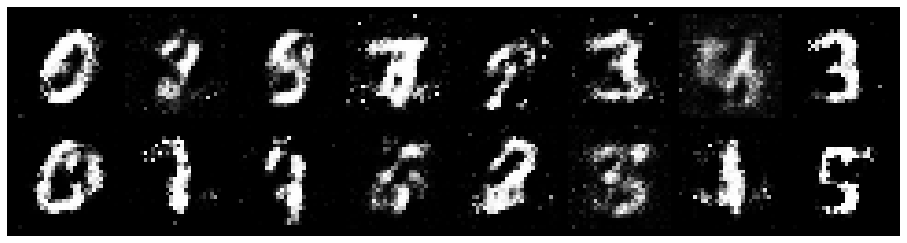

Epoch: [21/200], Batch Num: [400/600]
Discriminator Loss: 0.8689, Generator Loss: 1.7526
D(x): 0.6760, D(G(z)): 0.2417


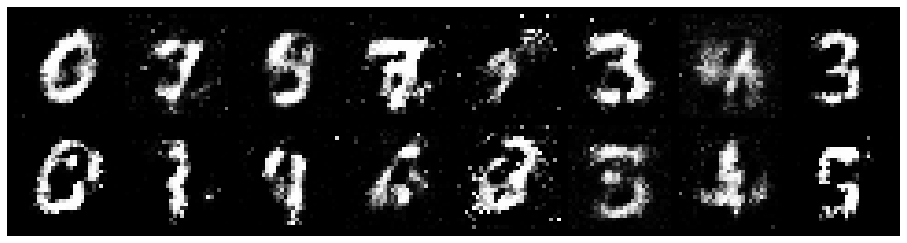

Epoch: [21/200], Batch Num: [500/600]
Discriminator Loss: 0.8389, Generator Loss: 1.3548
D(x): 0.7761, D(G(z)): 0.3531


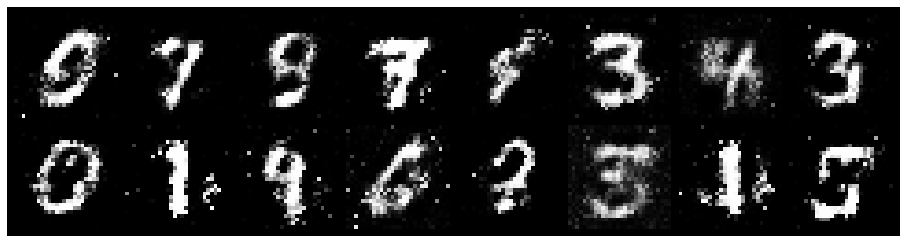

Epoch: [22/200], Batch Num: [0/600]
Discriminator Loss: 0.7309, Generator Loss: 1.4770
D(x): 0.7955, D(G(z)): 0.3023


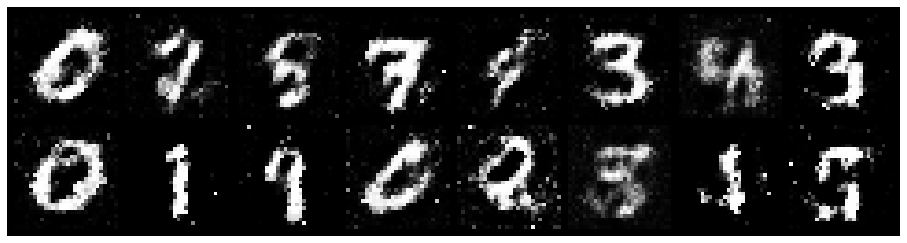

Epoch: [22/200], Batch Num: [100/600]
Discriminator Loss: 0.9787, Generator Loss: 1.5736
D(x): 0.6347, D(G(z)): 0.2537


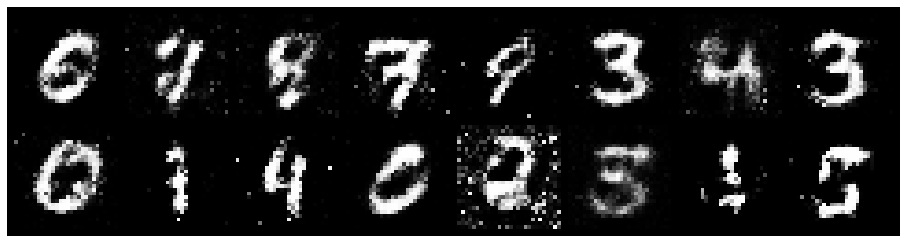

Epoch: [22/200], Batch Num: [200/600]
Discriminator Loss: 0.9392, Generator Loss: 1.3260
D(x): 0.7034, D(G(z)): 0.3547


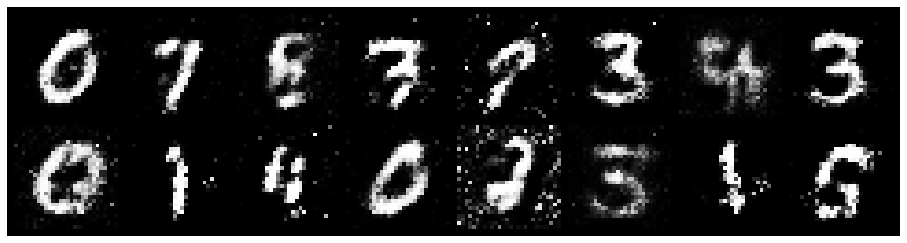

Epoch: [22/200], Batch Num: [300/600]
Discriminator Loss: 1.0175, Generator Loss: 1.6422
D(x): 0.6881, D(G(z)): 0.3358


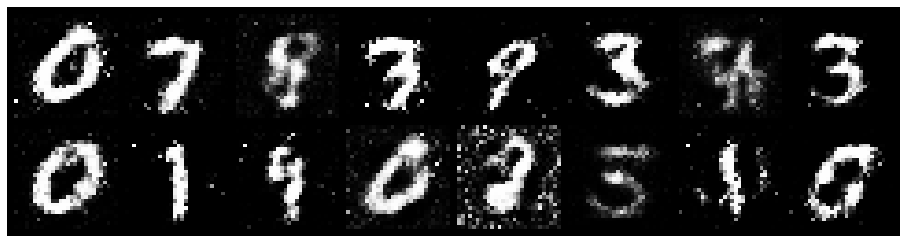

Epoch: [22/200], Batch Num: [400/600]
Discriminator Loss: 0.8167, Generator Loss: 1.6695
D(x): 0.6953, D(G(z)): 0.2275


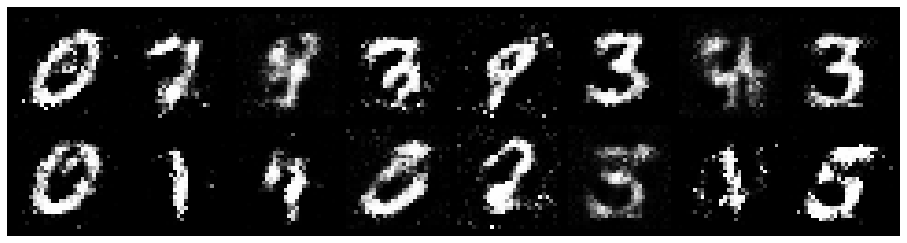

Epoch: [22/200], Batch Num: [500/600]
Discriminator Loss: 0.7494, Generator Loss: 1.6604
D(x): 0.7947, D(G(z)): 0.2957


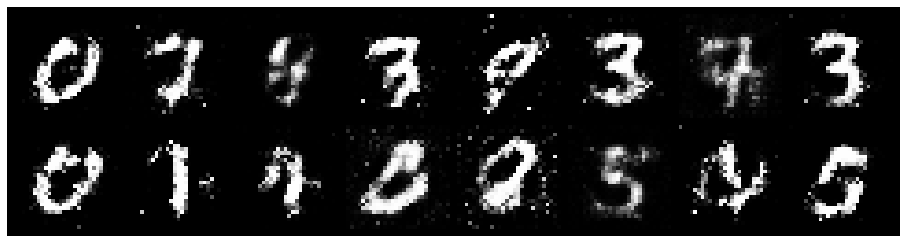

Epoch: [23/200], Batch Num: [0/600]
Discriminator Loss: 1.0847, Generator Loss: 1.6717
D(x): 0.6155, D(G(z)): 0.2762


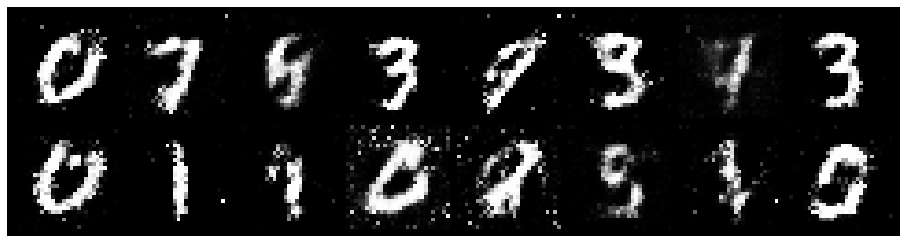

Epoch: [23/200], Batch Num: [100/600]
Discriminator Loss: 0.6380, Generator Loss: 1.8566
D(x): 0.7820, D(G(z)): 0.2295


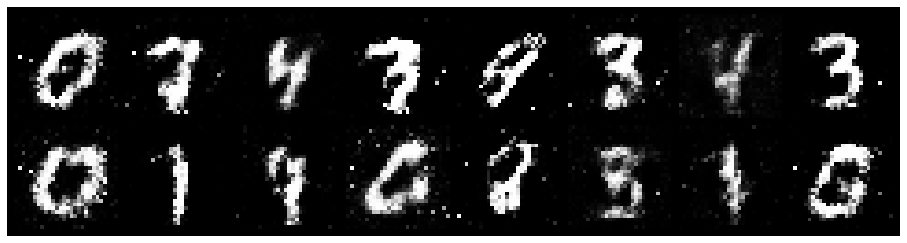

Epoch: [23/200], Batch Num: [200/600]
Discriminator Loss: 0.7129, Generator Loss: 1.5462
D(x): 0.7633, D(G(z)): 0.2642


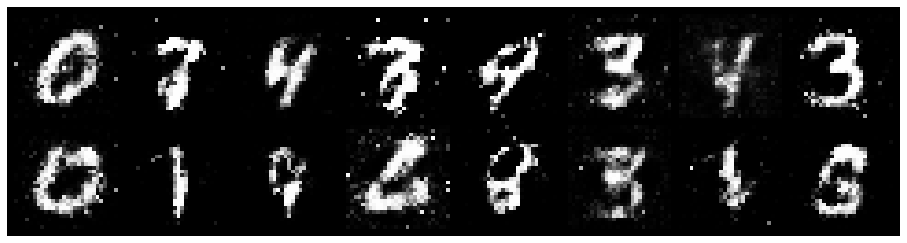

Epoch: [23/200], Batch Num: [300/600]
Discriminator Loss: 0.9166, Generator Loss: 1.5010
D(x): 0.6476, D(G(z)): 0.2942


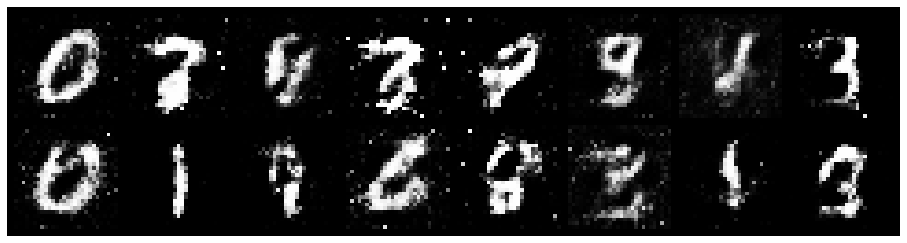

Epoch: [23/200], Batch Num: [400/600]
Discriminator Loss: 0.8836, Generator Loss: 1.3933
D(x): 0.7966, D(G(z)): 0.3715


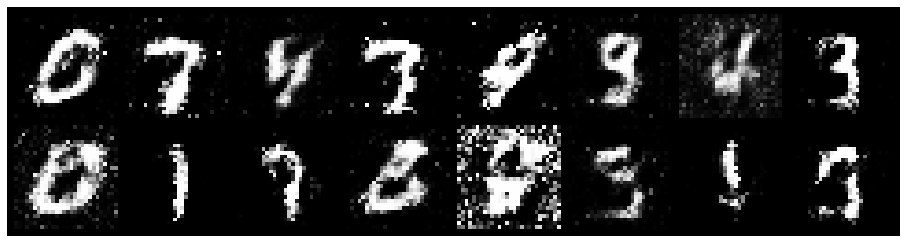

Epoch: [23/200], Batch Num: [500/600]
Discriminator Loss: 1.0047, Generator Loss: 0.9892
D(x): 0.7004, D(G(z)): 0.3896


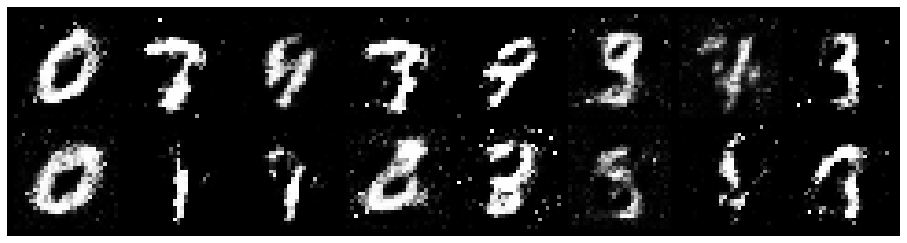

Epoch: [24/200], Batch Num: [0/600]
Discriminator Loss: 0.8777, Generator Loss: 1.3848
D(x): 0.7543, D(G(z)): 0.3129


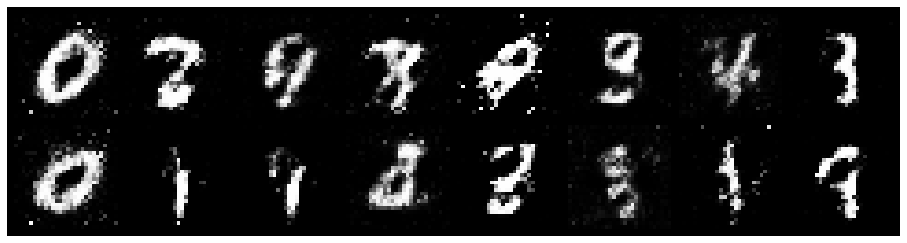

Epoch: [24/200], Batch Num: [100/600]
Discriminator Loss: 0.7013, Generator Loss: 1.3640
D(x): 0.7532, D(G(z)): 0.2799


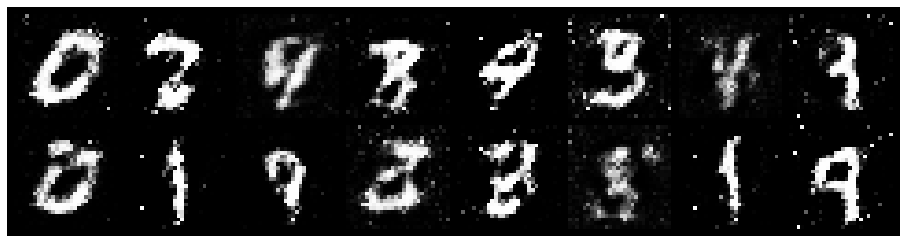

Epoch: [24/200], Batch Num: [200/600]
Discriminator Loss: 0.7439, Generator Loss: 1.4691
D(x): 0.7224, D(G(z)): 0.2532


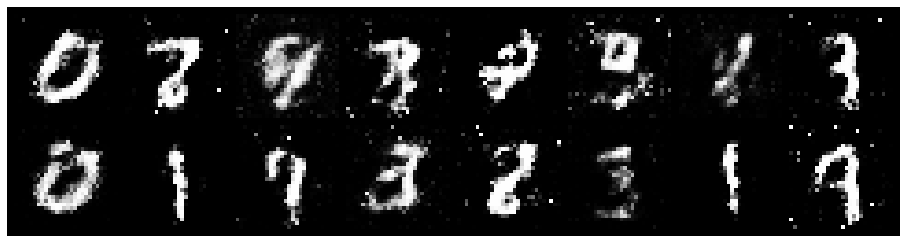

Epoch: [24/200], Batch Num: [300/600]
Discriminator Loss: 0.9136, Generator Loss: 1.5095
D(x): 0.6476, D(G(z)): 0.2520


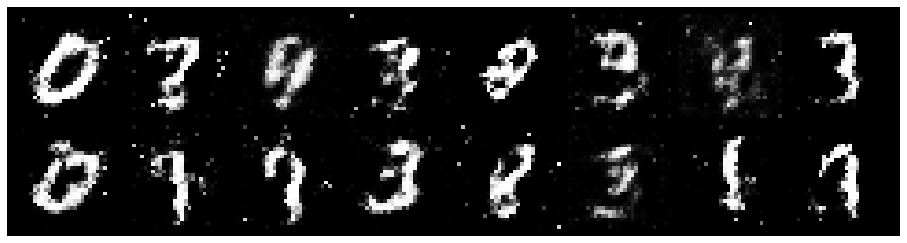

Epoch: [24/200], Batch Num: [400/600]
Discriminator Loss: 0.9176, Generator Loss: 1.9288
D(x): 0.7058, D(G(z)): 0.2882


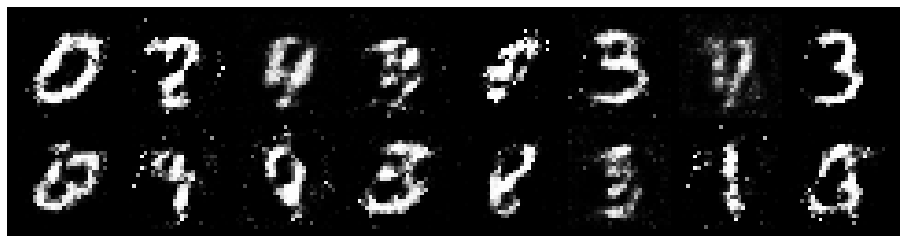

Epoch: [24/200], Batch Num: [500/600]
Discriminator Loss: 0.9822, Generator Loss: 1.6663
D(x): 0.6733, D(G(z)): 0.3478


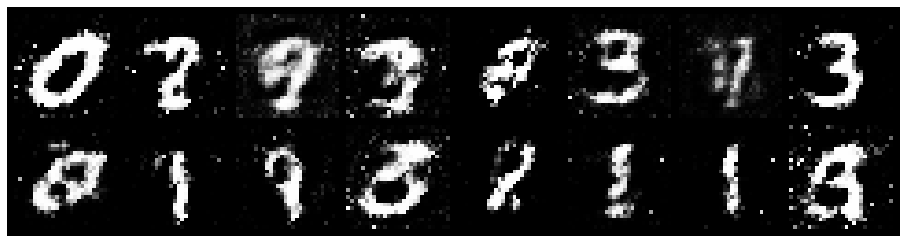

Epoch: [25/200], Batch Num: [0/600]
Discriminator Loss: 0.7026, Generator Loss: 2.2929
D(x): 0.7711, D(G(z)): 0.2449


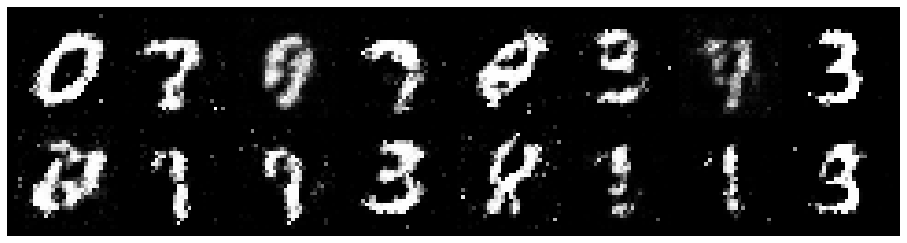

Epoch: [25/200], Batch Num: [100/600]
Discriminator Loss: 0.8810, Generator Loss: 1.3951
D(x): 0.6879, D(G(z)): 0.2519


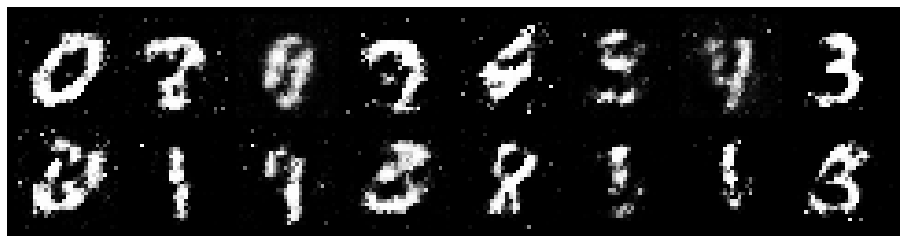

Epoch: [25/200], Batch Num: [200/600]
Discriminator Loss: 1.0149, Generator Loss: 1.7937
D(x): 0.6637, D(G(z)): 0.3252


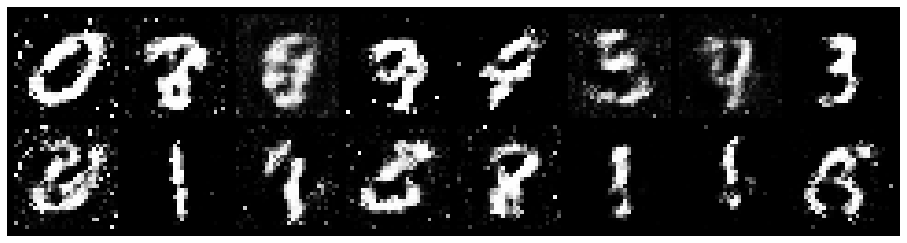

Epoch: [25/200], Batch Num: [300/600]
Discriminator Loss: 1.0274, Generator Loss: 1.5828
D(x): 0.6530, D(G(z)): 0.3146


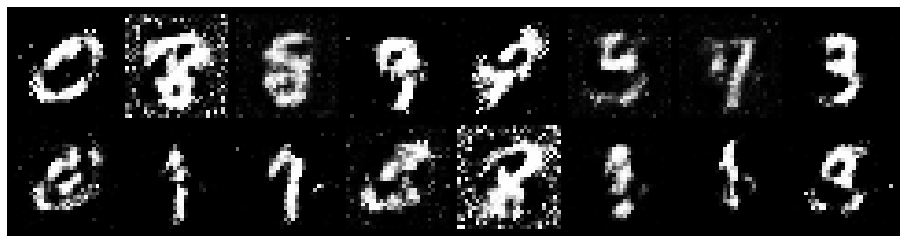

Epoch: [25/200], Batch Num: [400/600]
Discriminator Loss: 1.0252, Generator Loss: 1.3874
D(x): 0.7140, D(G(z)): 0.3688


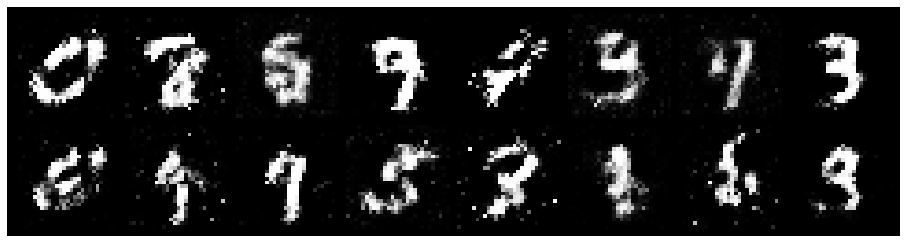

Epoch: [25/200], Batch Num: [500/600]
Discriminator Loss: 1.0098, Generator Loss: 1.3926
D(x): 0.6573, D(G(z)): 0.3166


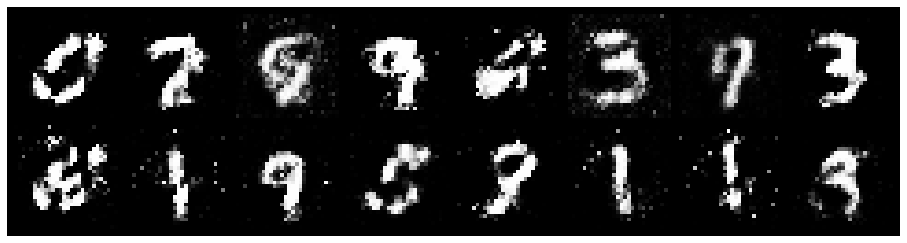

Epoch: [26/200], Batch Num: [0/600]
Discriminator Loss: 1.0289, Generator Loss: 1.5156
D(x): 0.7142, D(G(z)): 0.3309


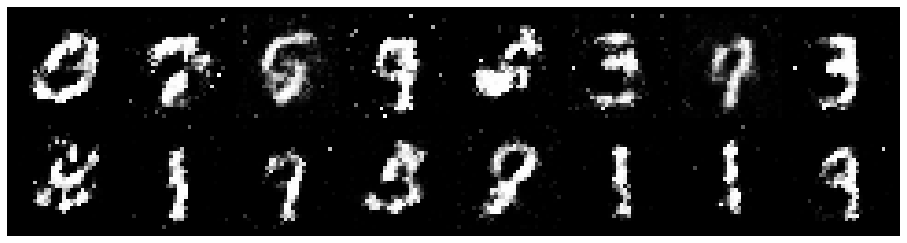

Epoch: [26/200], Batch Num: [100/600]
Discriminator Loss: 0.9701, Generator Loss: 1.4468
D(x): 0.6802, D(G(z)): 0.3158


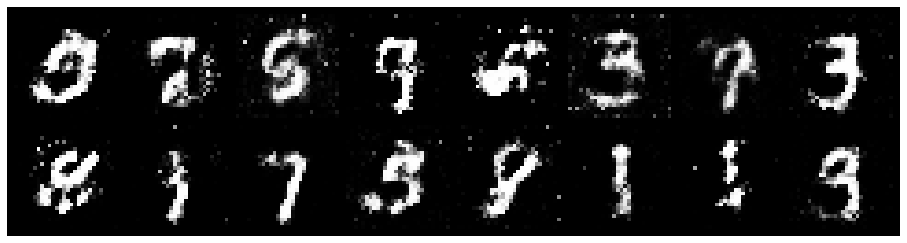

Epoch: [26/200], Batch Num: [200/600]
Discriminator Loss: 1.0414, Generator Loss: 1.6537
D(x): 0.7404, D(G(z)): 0.3893


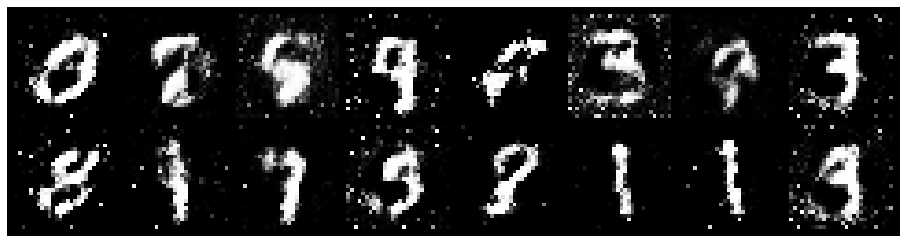

Epoch: [26/200], Batch Num: [300/600]
Discriminator Loss: 0.8196, Generator Loss: 1.5565
D(x): 0.7459, D(G(z)): 0.3052


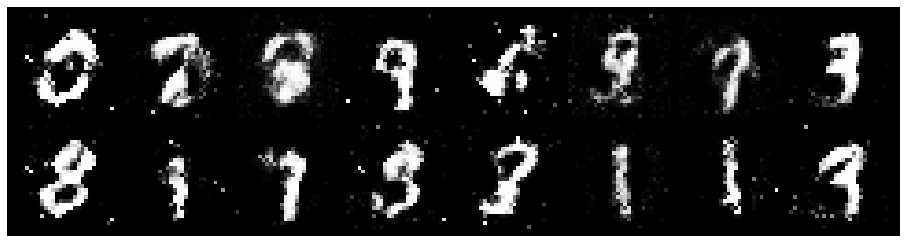

Epoch: [26/200], Batch Num: [400/600]
Discriminator Loss: 0.8284, Generator Loss: 1.4836
D(x): 0.6933, D(G(z)): 0.2724


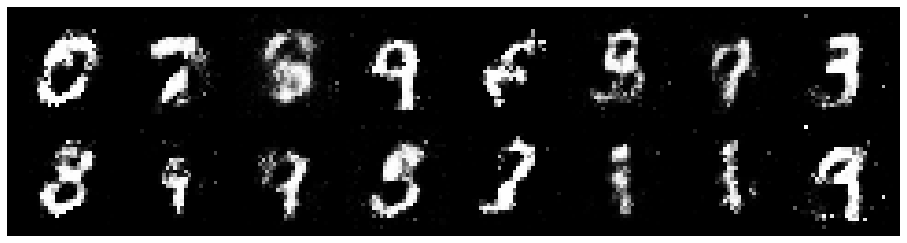

Epoch: [26/200], Batch Num: [500/600]
Discriminator Loss: 1.0376, Generator Loss: 1.1970
D(x): 0.6721, D(G(z)): 0.3621


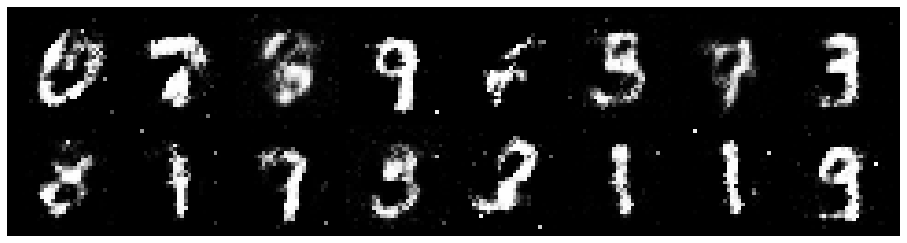

Epoch: [27/200], Batch Num: [0/600]
Discriminator Loss: 0.7256, Generator Loss: 1.7984
D(x): 0.7808, D(G(z)): 0.2780


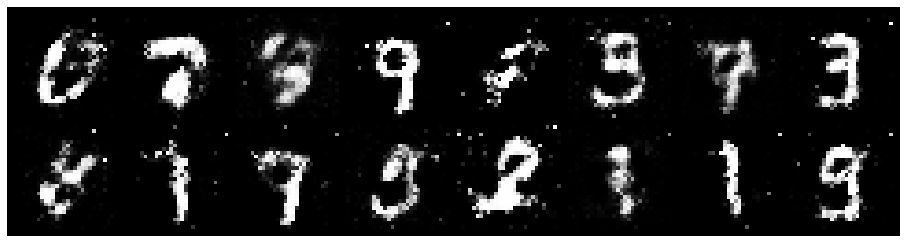

Epoch: [27/200], Batch Num: [100/600]
Discriminator Loss: 0.9363, Generator Loss: 1.5797
D(x): 0.6809, D(G(z)): 0.3125


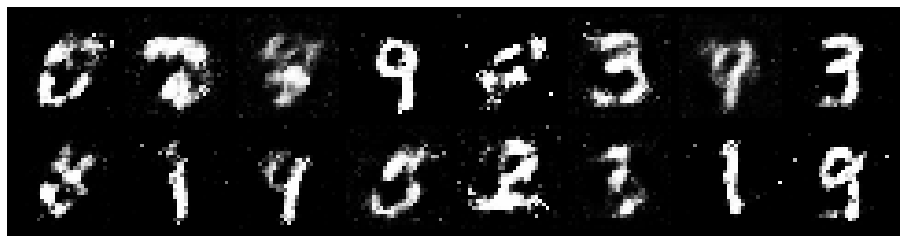

Epoch: [27/200], Batch Num: [200/600]
Discriminator Loss: 0.9767, Generator Loss: 1.3161
D(x): 0.6467, D(G(z)): 0.3188


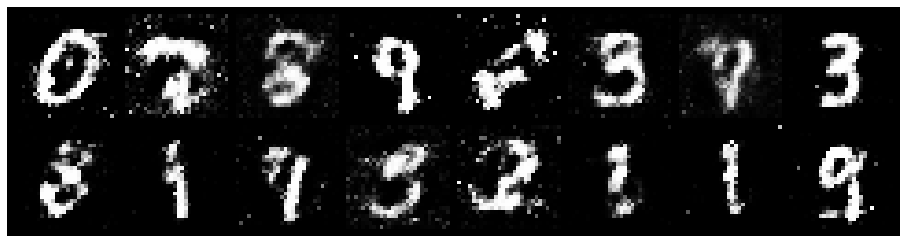

Epoch: [27/200], Batch Num: [300/600]
Discriminator Loss: 0.9848, Generator Loss: 1.1495
D(x): 0.6973, D(G(z)): 0.3640


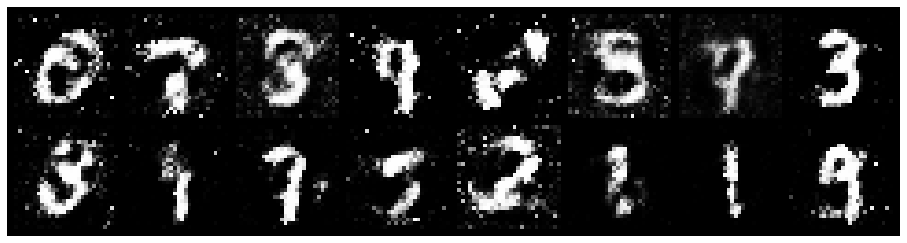

Epoch: [27/200], Batch Num: [400/600]
Discriminator Loss: 0.8846, Generator Loss: 1.4086
D(x): 0.7617, D(G(z)): 0.3491


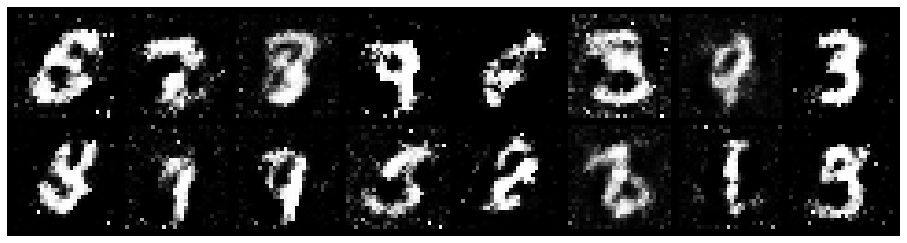

Epoch: [27/200], Batch Num: [500/600]
Discriminator Loss: 1.1883, Generator Loss: 0.9706
D(x): 0.7159, D(G(z)): 0.4790


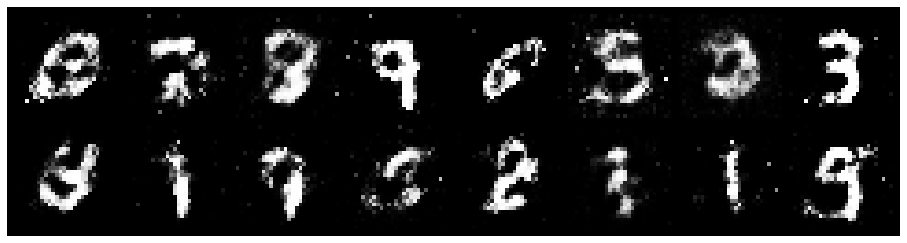

Epoch: [28/200], Batch Num: [0/600]
Discriminator Loss: 1.0244, Generator Loss: 1.2836
D(x): 0.6195, D(G(z)): 0.2924


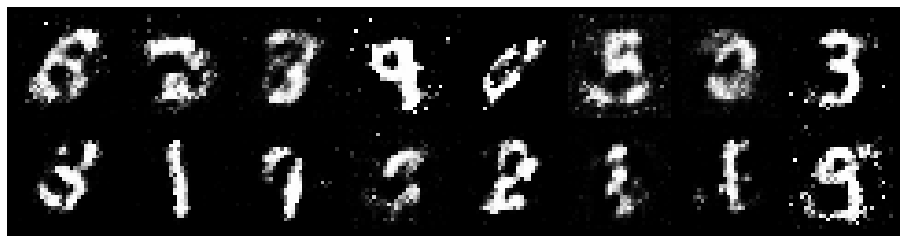

Epoch: [28/200], Batch Num: [100/600]
Discriminator Loss: 0.9304, Generator Loss: 1.3123
D(x): 0.6678, D(G(z)): 0.3336


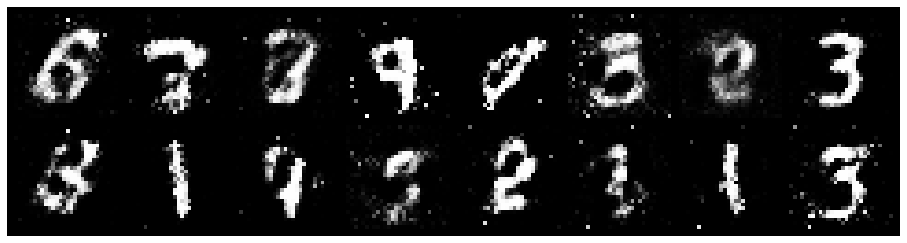

Epoch: [28/200], Batch Num: [200/600]
Discriminator Loss: 0.8558, Generator Loss: 1.2647
D(x): 0.7381, D(G(z)): 0.3396


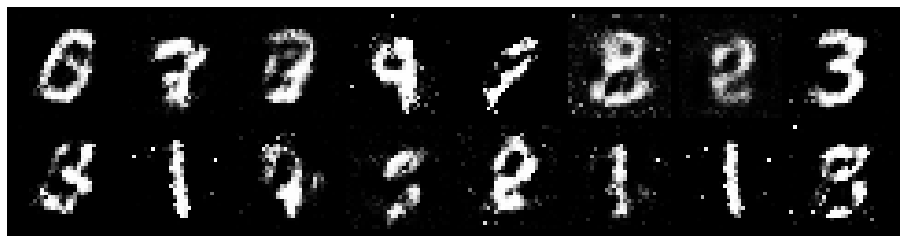

Epoch: [28/200], Batch Num: [300/600]
Discriminator Loss: 0.8602, Generator Loss: 1.3414
D(x): 0.6937, D(G(z)): 0.3094


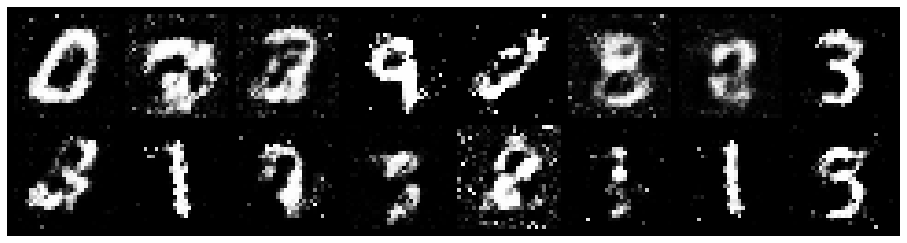

Epoch: [28/200], Batch Num: [400/600]
Discriminator Loss: 0.7911, Generator Loss: 1.3256
D(x): 0.7364, D(G(z)): 0.2968


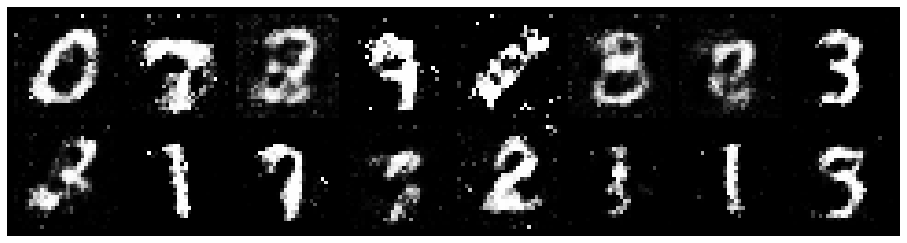

Epoch: [28/200], Batch Num: [500/600]
Discriminator Loss: 0.9544, Generator Loss: 1.2892
D(x): 0.6948, D(G(z)): 0.3239


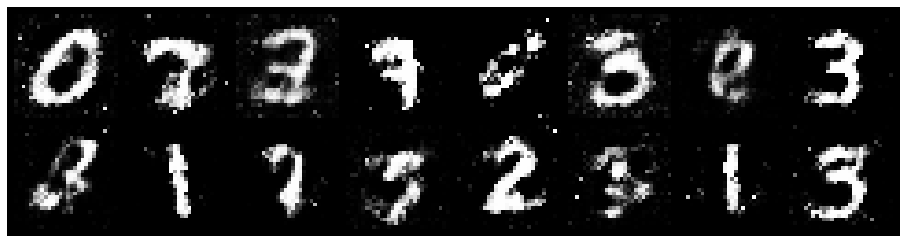

Epoch: [29/200], Batch Num: [0/600]
Discriminator Loss: 1.0883, Generator Loss: 1.9140
D(x): 0.5967, D(G(z)): 0.2677


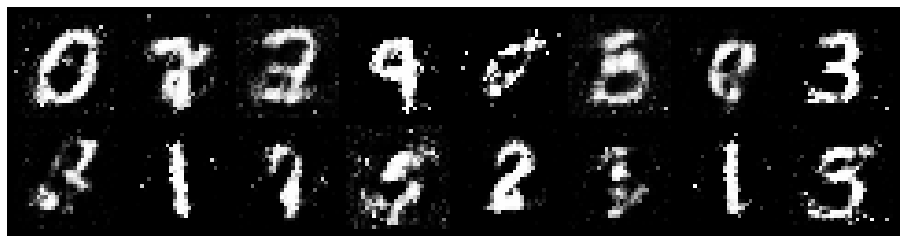

Epoch: [29/200], Batch Num: [100/600]
Discriminator Loss: 1.0789, Generator Loss: 1.5714
D(x): 0.5994, D(G(z)): 0.2860


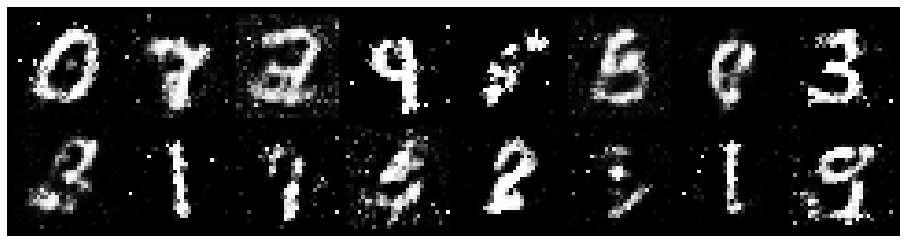

Epoch: [29/200], Batch Num: [200/600]
Discriminator Loss: 1.0002, Generator Loss: 1.3453
D(x): 0.6438, D(G(z)): 0.2997


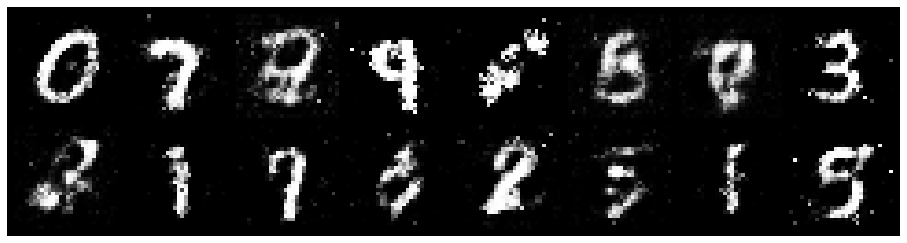

Epoch: [29/200], Batch Num: [300/600]
Discriminator Loss: 1.2563, Generator Loss: 1.2093
D(x): 0.6387, D(G(z)): 0.4041


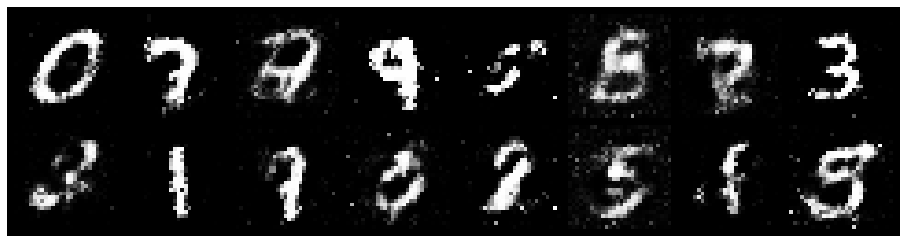

Epoch: [29/200], Batch Num: [400/600]
Discriminator Loss: 1.1224, Generator Loss: 1.2778
D(x): 0.6044, D(G(z)): 0.3421


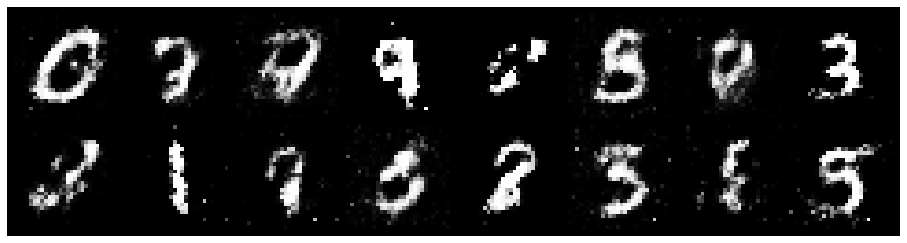

Epoch: [29/200], Batch Num: [500/600]
Discriminator Loss: 0.9007, Generator Loss: 1.6002
D(x): 0.6978, D(G(z)): 0.3167


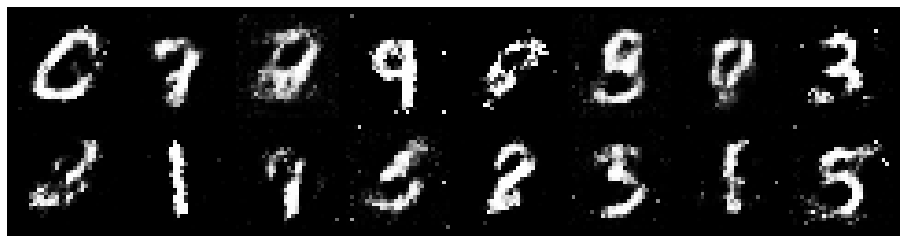

Epoch: [30/200], Batch Num: [0/600]
Discriminator Loss: 1.1221, Generator Loss: 1.6288
D(x): 0.7121, D(G(z)): 0.4151


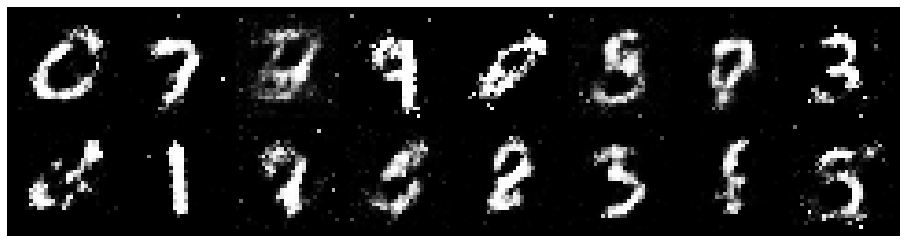

Epoch: [30/200], Batch Num: [100/600]
Discriminator Loss: 0.9689, Generator Loss: 1.4647
D(x): 0.7188, D(G(z)): 0.3718


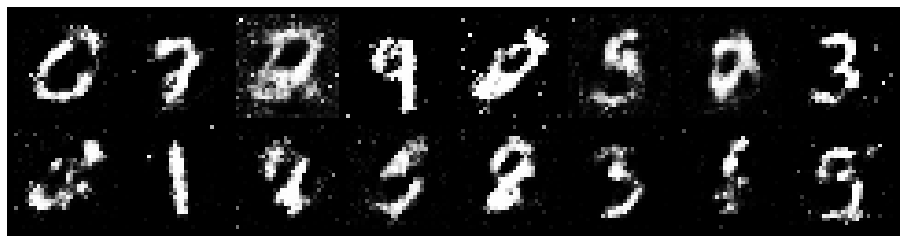

Epoch: [30/200], Batch Num: [200/600]
Discriminator Loss: 0.9142, Generator Loss: 1.2995
D(x): 0.6668, D(G(z)): 0.3155


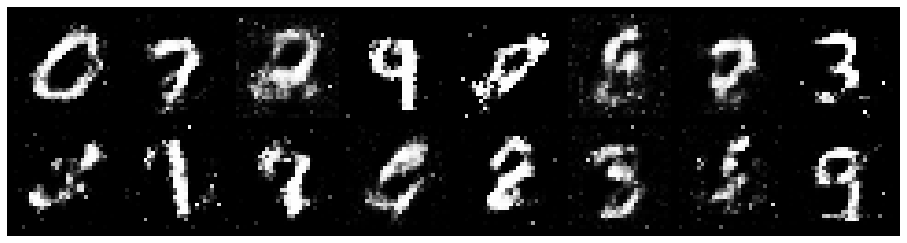

Epoch: [30/200], Batch Num: [300/600]
Discriminator Loss: 1.0200, Generator Loss: 1.2632
D(x): 0.6350, D(G(z)): 0.3321


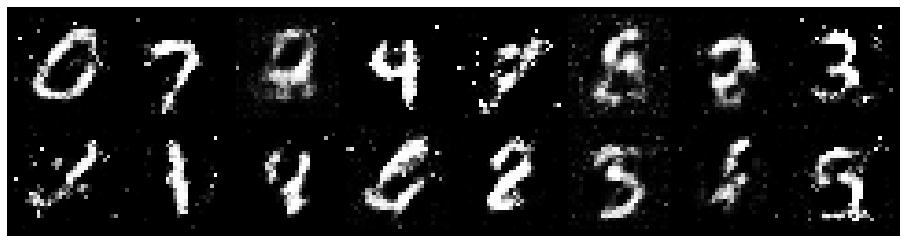

Epoch: [30/200], Batch Num: [400/600]
Discriminator Loss: 0.9370, Generator Loss: 1.3629
D(x): 0.6895, D(G(z)): 0.3172


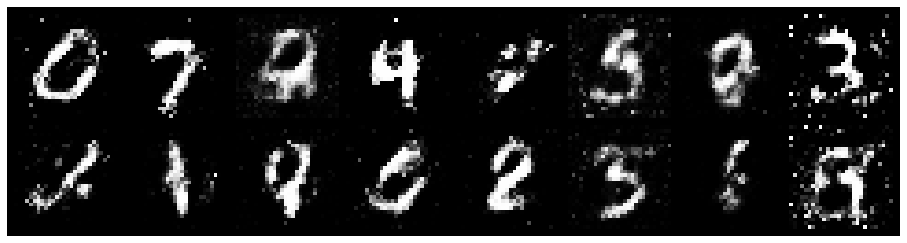

Epoch: [30/200], Batch Num: [500/600]
Discriminator Loss: 1.0195, Generator Loss: 1.5860
D(x): 0.6880, D(G(z)): 0.3313


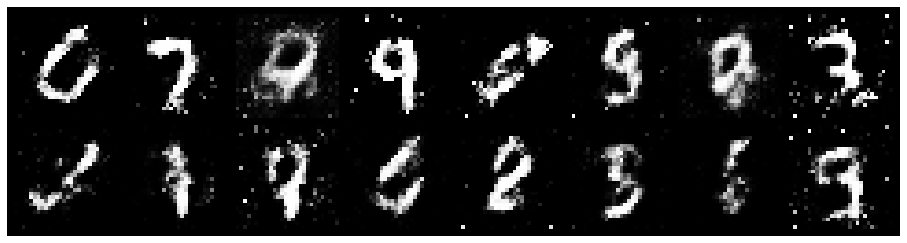

Epoch: [31/200], Batch Num: [0/600]
Discriminator Loss: 1.2344, Generator Loss: 1.2930
D(x): 0.5772, D(G(z)): 0.3526


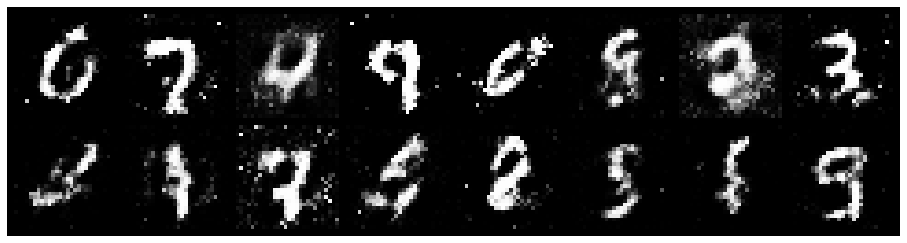

Epoch: [31/200], Batch Num: [100/600]
Discriminator Loss: 1.3078, Generator Loss: 1.3247
D(x): 0.5295, D(G(z)): 0.3208


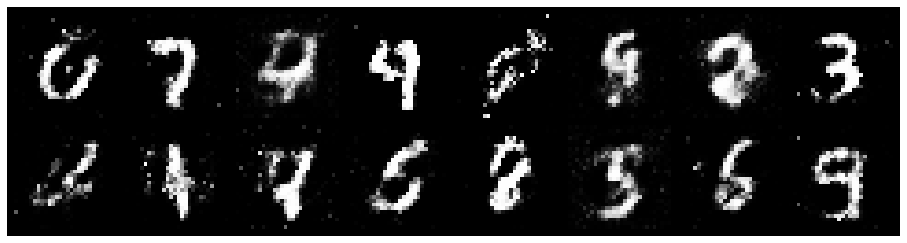

Epoch: [31/200], Batch Num: [200/600]
Discriminator Loss: 0.9663, Generator Loss: 1.2866
D(x): 0.6642, D(G(z)): 0.3315


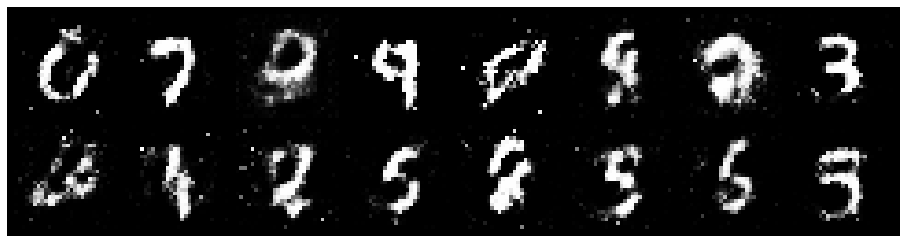

Epoch: [31/200], Batch Num: [300/600]
Discriminator Loss: 0.7680, Generator Loss: 1.6663
D(x): 0.7264, D(G(z)): 0.2751


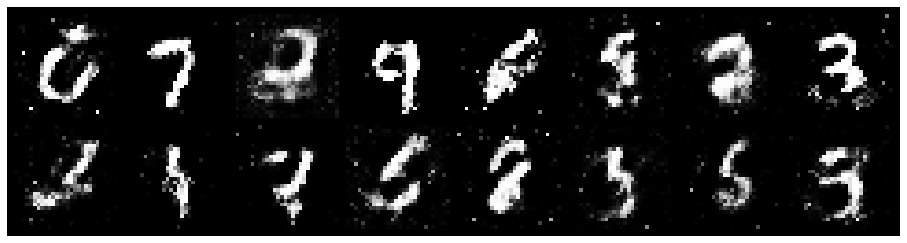

Epoch: [31/200], Batch Num: [400/600]
Discriminator Loss: 1.0806, Generator Loss: 1.3042
D(x): 0.5809, D(G(z)): 0.3293


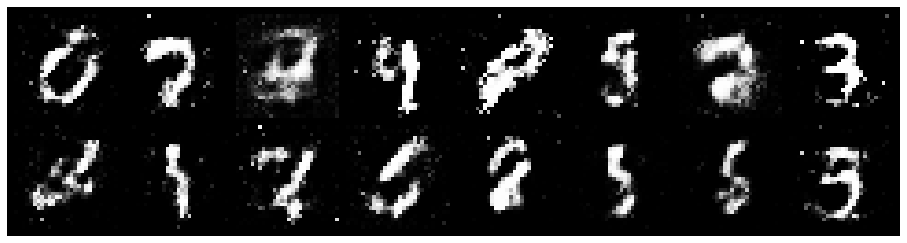

Epoch: [31/200], Batch Num: [500/600]
Discriminator Loss: 1.0673, Generator Loss: 0.9434
D(x): 0.6283, D(G(z)): 0.3629


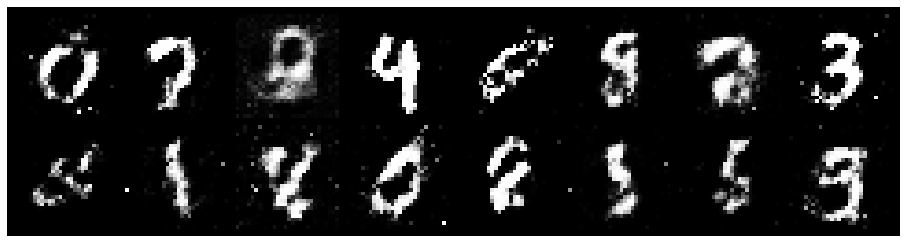

Epoch: [32/200], Batch Num: [0/600]
Discriminator Loss: 1.0300, Generator Loss: 1.3383
D(x): 0.6336, D(G(z)): 0.3061


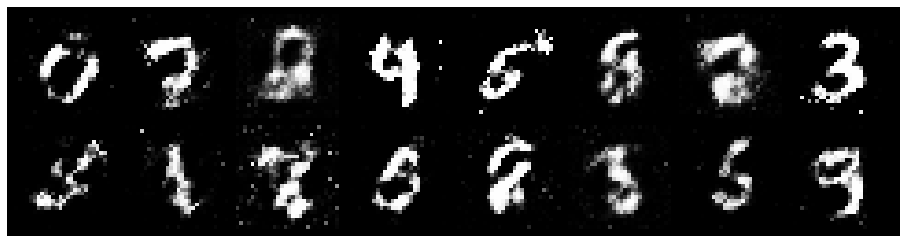

Epoch: [32/200], Batch Num: [100/600]
Discriminator Loss: 0.9300, Generator Loss: 1.1850
D(x): 0.7000, D(G(z)): 0.3508


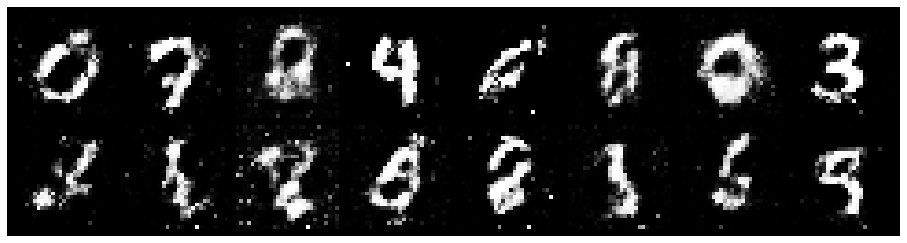

Epoch: [32/200], Batch Num: [200/600]
Discriminator Loss: 0.9261, Generator Loss: 1.5075
D(x): 0.7242, D(G(z)): 0.3405


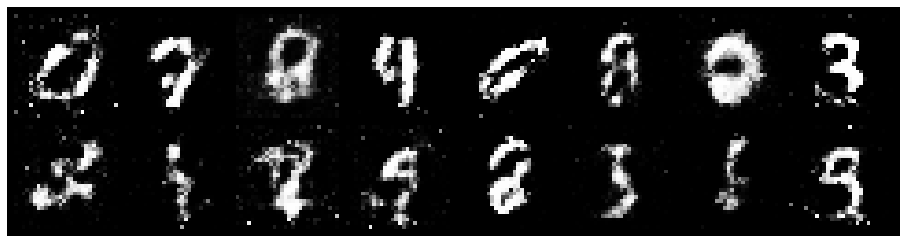

Epoch: [32/200], Batch Num: [300/600]
Discriminator Loss: 1.1530, Generator Loss: 1.3460
D(x): 0.6497, D(G(z)): 0.3820


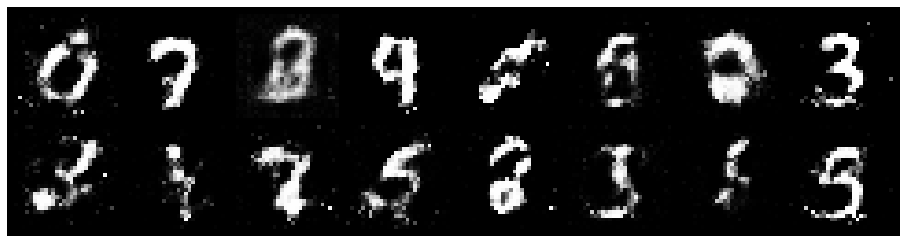

Epoch: [32/200], Batch Num: [400/600]
Discriminator Loss: 0.9735, Generator Loss: 1.7029
D(x): 0.7722, D(G(z)): 0.3808


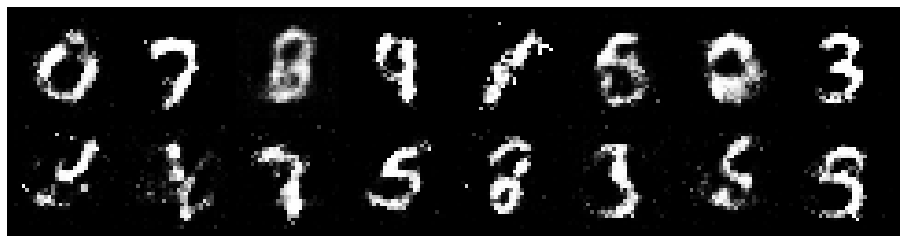

Epoch: [32/200], Batch Num: [500/600]
Discriminator Loss: 1.1341, Generator Loss: 1.3860
D(x): 0.6069, D(G(z)): 0.3429


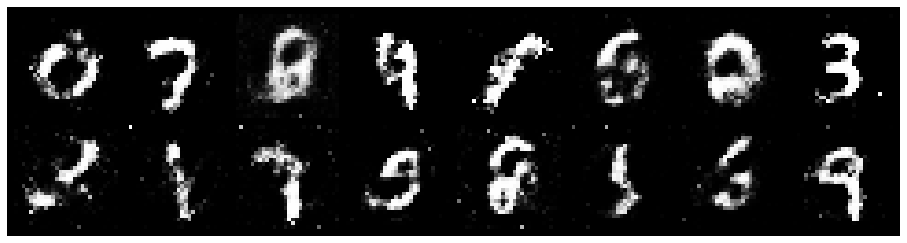

Epoch: [33/200], Batch Num: [0/600]
Discriminator Loss: 1.1510, Generator Loss: 1.1640
D(x): 0.6195, D(G(z)): 0.3725


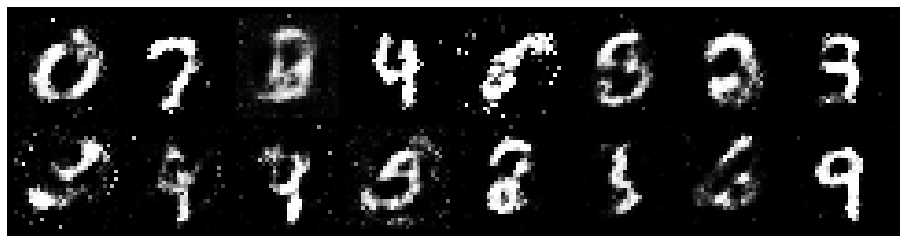

Epoch: [33/200], Batch Num: [100/600]
Discriminator Loss: 1.1155, Generator Loss: 1.4140
D(x): 0.6973, D(G(z)): 0.3581


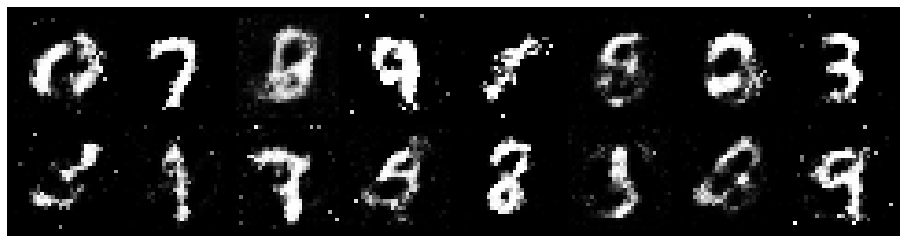

Epoch: [33/200], Batch Num: [200/600]
Discriminator Loss: 0.9709, Generator Loss: 1.3141
D(x): 0.6299, D(G(z)): 0.2965


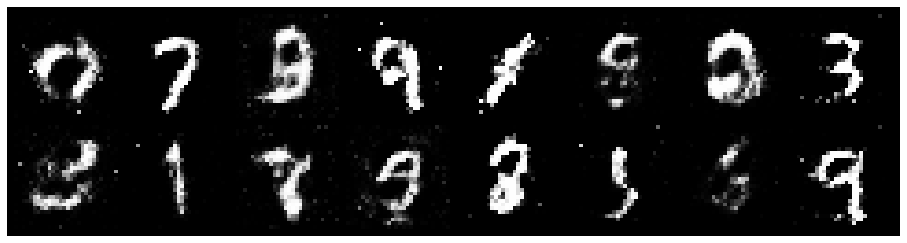

Epoch: [33/200], Batch Num: [300/600]
Discriminator Loss: 1.1413, Generator Loss: 1.3259
D(x): 0.5657, D(G(z)): 0.3260


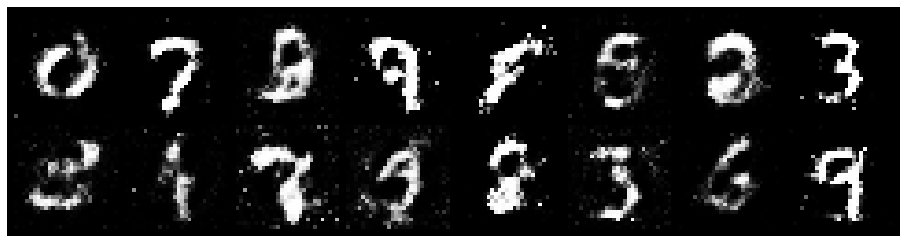

Epoch: [33/200], Batch Num: [400/600]
Discriminator Loss: 0.9569, Generator Loss: 1.1911
D(x): 0.6878, D(G(z)): 0.3500


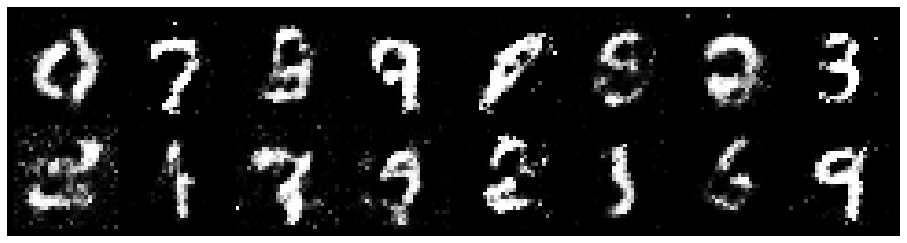

Epoch: [33/200], Batch Num: [500/600]
Discriminator Loss: 1.1537, Generator Loss: 0.9535
D(x): 0.6104, D(G(z)): 0.4010


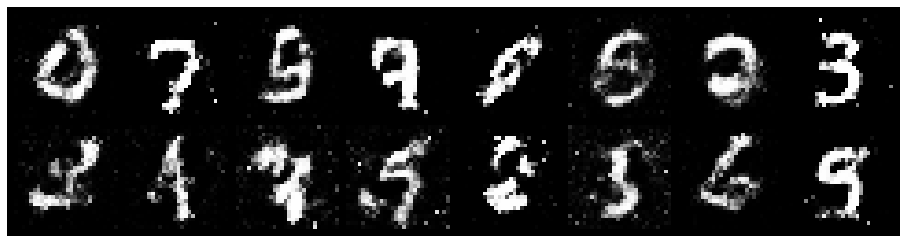

Epoch: [34/200], Batch Num: [0/600]
Discriminator Loss: 1.1600, Generator Loss: 1.1395
D(x): 0.6148, D(G(z)): 0.3828


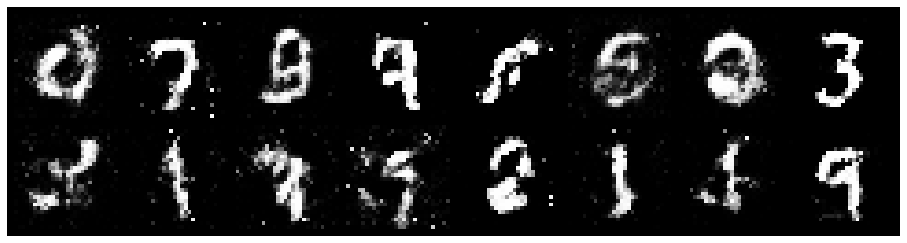

Epoch: [34/200], Batch Num: [100/600]
Discriminator Loss: 0.9820, Generator Loss: 1.1138
D(x): 0.7525, D(G(z)): 0.4034


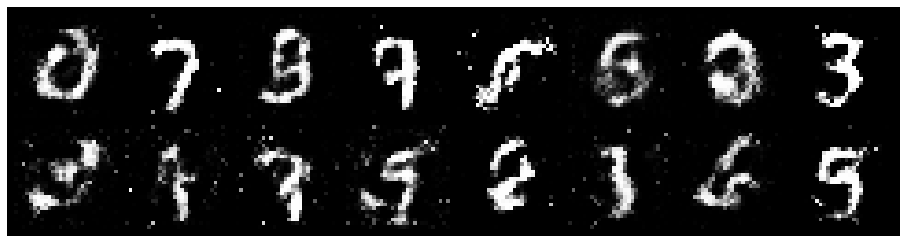

Epoch: [34/200], Batch Num: [200/600]
Discriminator Loss: 0.9675, Generator Loss: 1.9398
D(x): 0.6845, D(G(z)): 0.2919


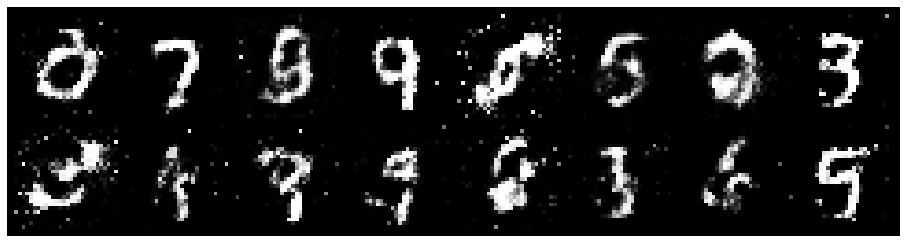

Epoch: [34/200], Batch Num: [300/600]
Discriminator Loss: 1.0167, Generator Loss: 1.2225
D(x): 0.6483, D(G(z)): 0.3200


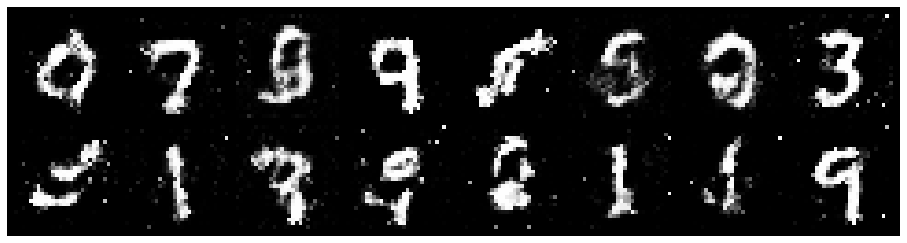

Epoch: [34/200], Batch Num: [400/600]
Discriminator Loss: 1.0116, Generator Loss: 1.0685
D(x): 0.6761, D(G(z)): 0.3830


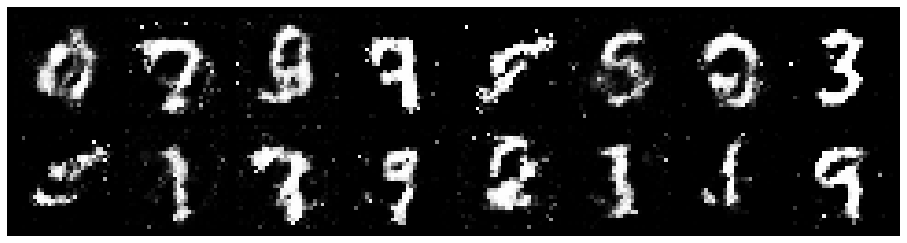

Epoch: [34/200], Batch Num: [500/600]
Discriminator Loss: 0.9685, Generator Loss: 1.2485
D(x): 0.7033, D(G(z)): 0.3767


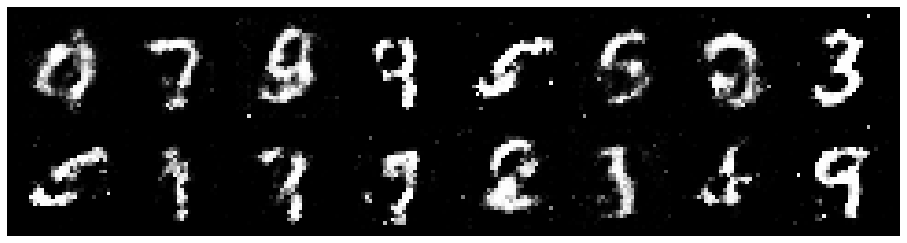

Epoch: [35/200], Batch Num: [0/600]
Discriminator Loss: 1.1078, Generator Loss: 1.2571
D(x): 0.6279, D(G(z)): 0.3426


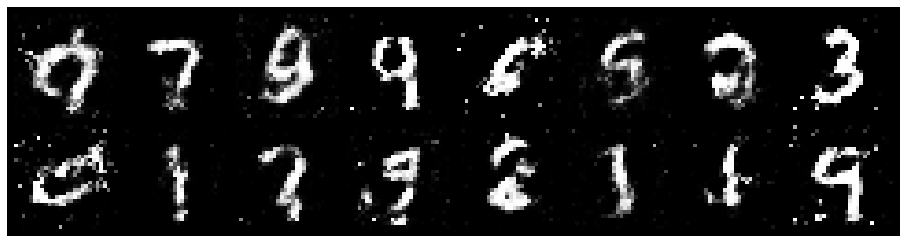

Epoch: [35/200], Batch Num: [100/600]
Discriminator Loss: 1.0672, Generator Loss: 1.2175
D(x): 0.6615, D(G(z)): 0.3666


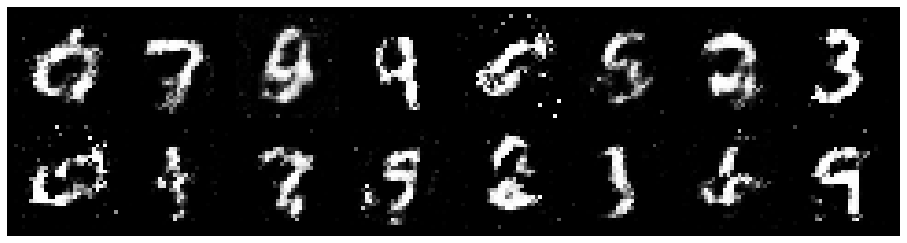

Epoch: [35/200], Batch Num: [200/600]
Discriminator Loss: 1.0067, Generator Loss: 1.3070
D(x): 0.6791, D(G(z)): 0.3660


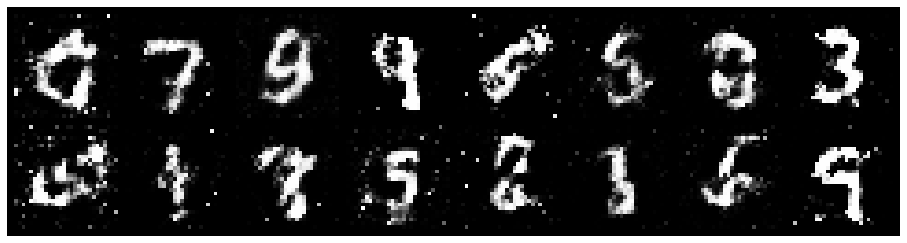

Epoch: [35/200], Batch Num: [300/600]
Discriminator Loss: 1.1081, Generator Loss: 1.3399
D(x): 0.5926, D(G(z)): 0.3597


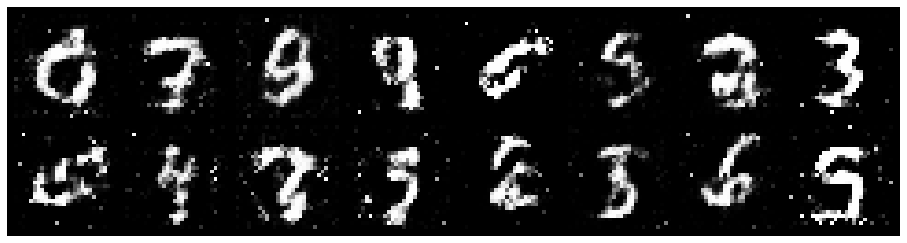

Epoch: [35/200], Batch Num: [400/600]
Discriminator Loss: 0.9384, Generator Loss: 1.6439
D(x): 0.7035, D(G(z)): 0.3435


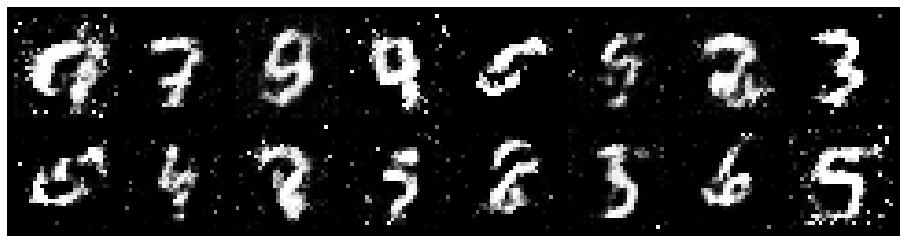

Epoch: [35/200], Batch Num: [500/600]
Discriminator Loss: 1.1833, Generator Loss: 1.5546
D(x): 0.6197, D(G(z)): 0.3711


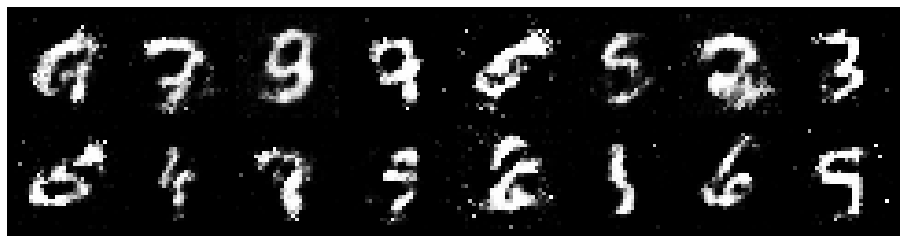

Epoch: [36/200], Batch Num: [0/600]
Discriminator Loss: 1.1889, Generator Loss: 1.2721
D(x): 0.6997, D(G(z)): 0.4258


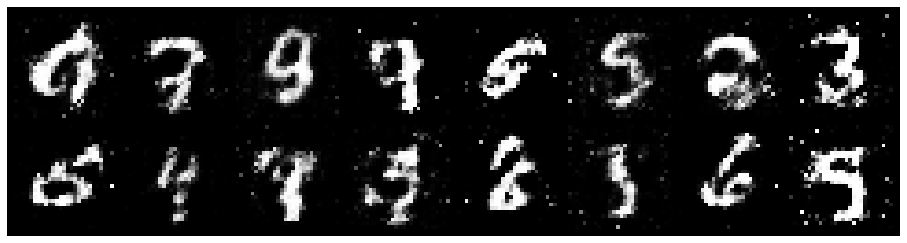

Epoch: [36/200], Batch Num: [100/600]
Discriminator Loss: 1.0109, Generator Loss: 1.3212
D(x): 0.6451, D(G(z)): 0.3246


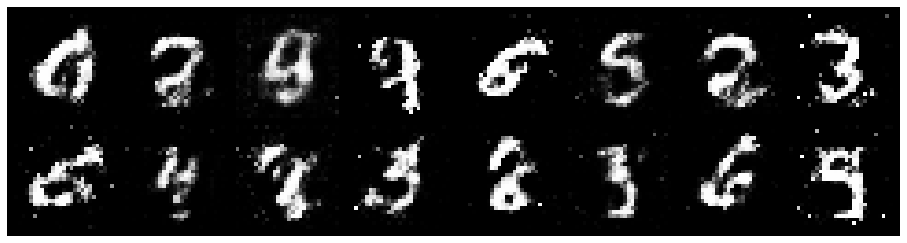

Epoch: [36/200], Batch Num: [200/600]
Discriminator Loss: 1.0752, Generator Loss: 1.0349
D(x): 0.6483, D(G(z)): 0.3413


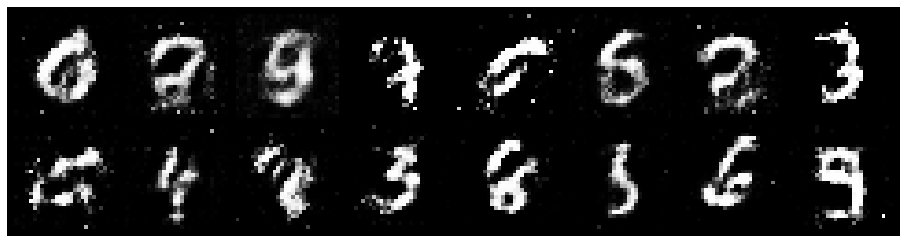

Epoch: [36/200], Batch Num: [300/600]
Discriminator Loss: 1.1742, Generator Loss: 1.0786
D(x): 0.5971, D(G(z)): 0.4049


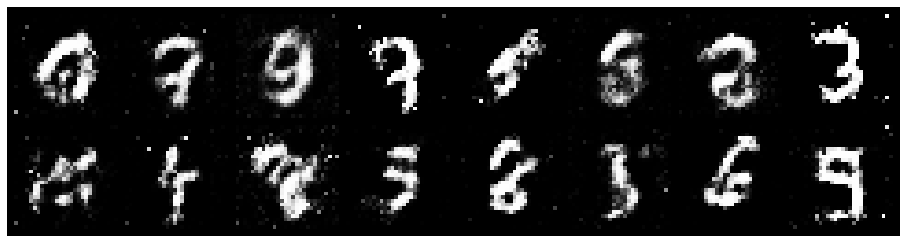

Epoch: [36/200], Batch Num: [400/600]
Discriminator Loss: 1.2620, Generator Loss: 0.8998
D(x): 0.6328, D(G(z)): 0.4673


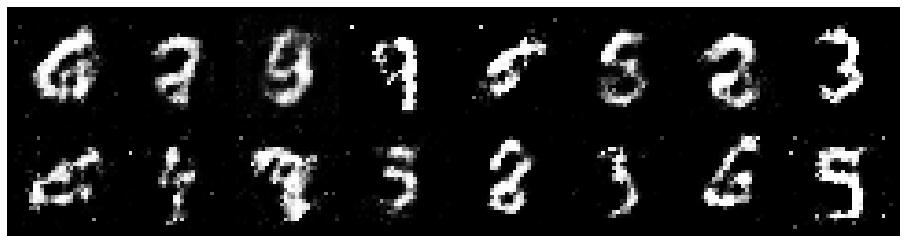

Epoch: [36/200], Batch Num: [500/600]
Discriminator Loss: 1.1176, Generator Loss: 1.2045
D(x): 0.5774, D(G(z)): 0.3390


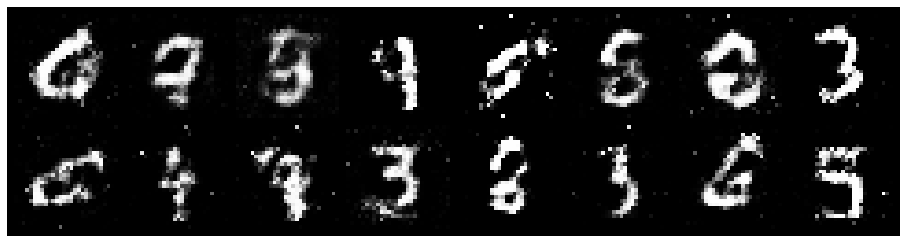

Epoch: [37/200], Batch Num: [0/600]
Discriminator Loss: 1.0758, Generator Loss: 1.3125
D(x): 0.5974, D(G(z)): 0.2922


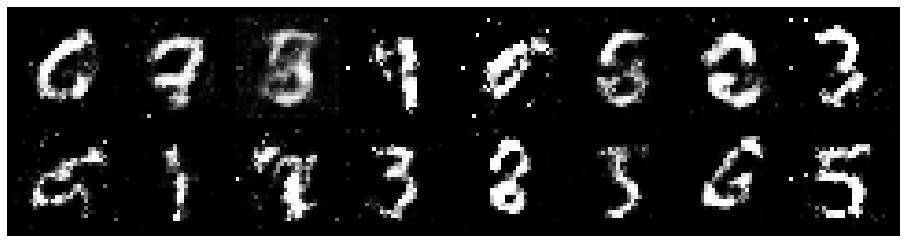

Epoch: [37/200], Batch Num: [100/600]
Discriminator Loss: 1.1188, Generator Loss: 1.0849
D(x): 0.6771, D(G(z)): 0.3868


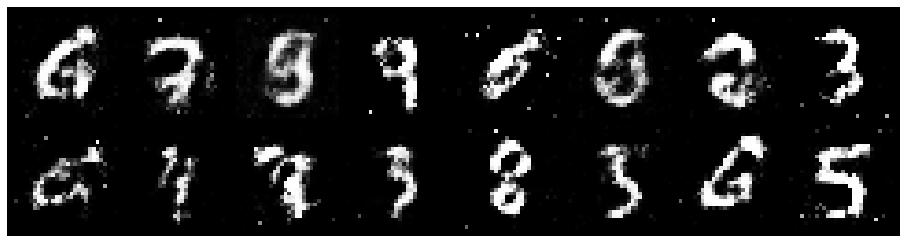

Epoch: [37/200], Batch Num: [200/600]
Discriminator Loss: 1.1786, Generator Loss: 1.3429
D(x): 0.5510, D(G(z)): 0.3219


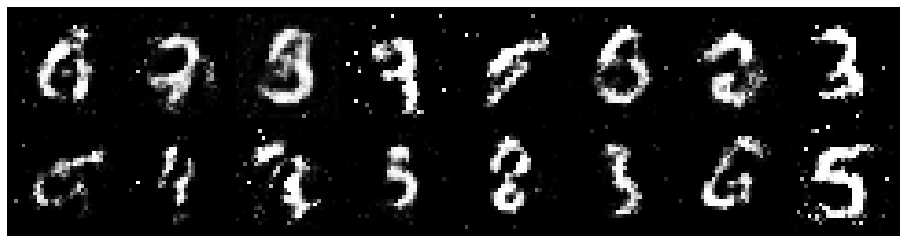

Epoch: [37/200], Batch Num: [300/600]
Discriminator Loss: 1.2487, Generator Loss: 1.1110
D(x): 0.5882, D(G(z)): 0.3874


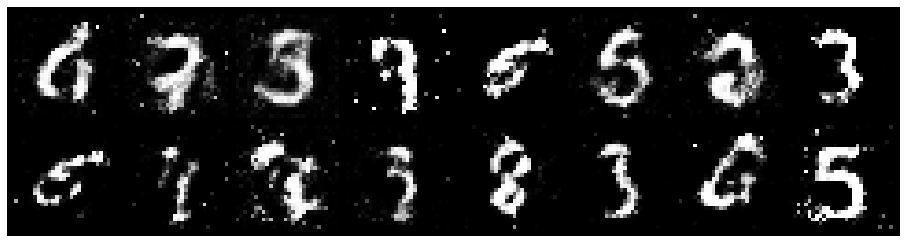

Epoch: [37/200], Batch Num: [400/600]
Discriminator Loss: 1.0849, Generator Loss: 1.2236
D(x): 0.6235, D(G(z)): 0.3389


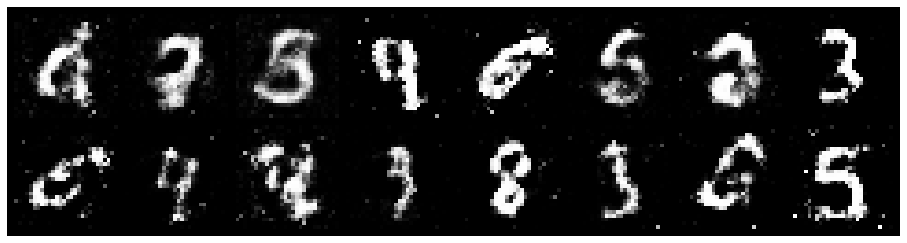

Epoch: [37/200], Batch Num: [500/600]
Discriminator Loss: 1.3036, Generator Loss: 1.2961
D(x): 0.5503, D(G(z)): 0.3519


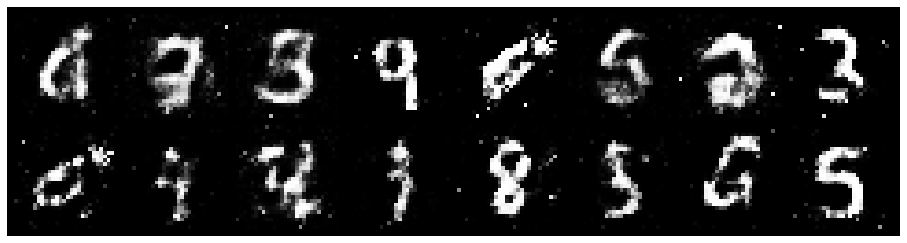

Epoch: [38/200], Batch Num: [0/600]
Discriminator Loss: 1.1114, Generator Loss: 1.1755
D(x): 0.6461, D(G(z)): 0.3729


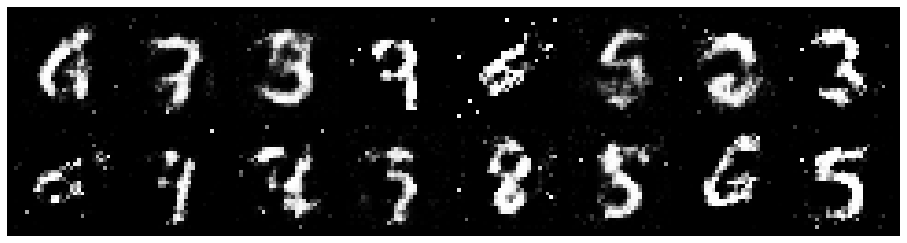

Epoch: [38/200], Batch Num: [100/600]
Discriminator Loss: 0.9441, Generator Loss: 1.3411
D(x): 0.7466, D(G(z)): 0.3882


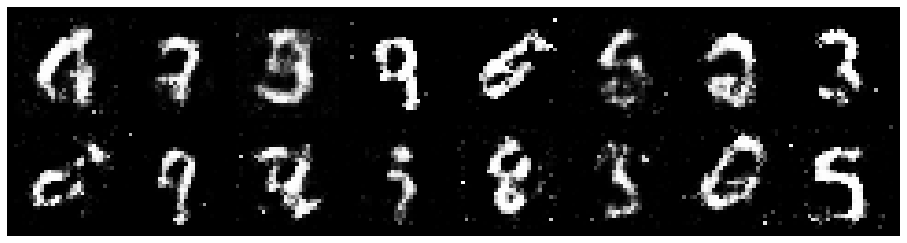

Epoch: [38/200], Batch Num: [200/600]
Discriminator Loss: 1.0782, Generator Loss: 1.3028
D(x): 0.6593, D(G(z)): 0.3366


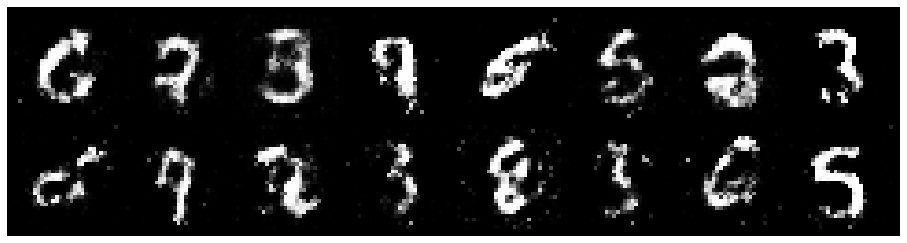

Epoch: [38/200], Batch Num: [300/600]
Discriminator Loss: 1.1560, Generator Loss: 0.9941
D(x): 0.6004, D(G(z)): 0.3995


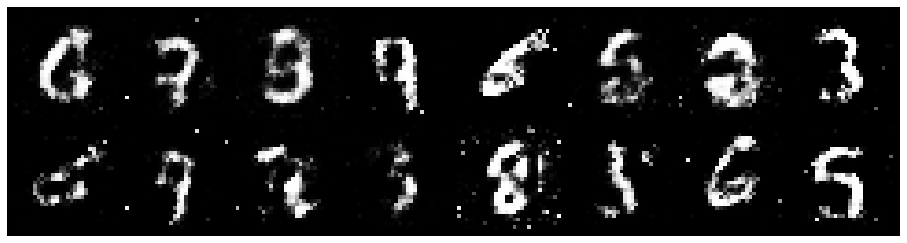

Epoch: [38/200], Batch Num: [400/600]
Discriminator Loss: 1.2020, Generator Loss: 0.9654
D(x): 0.6738, D(G(z)): 0.4759


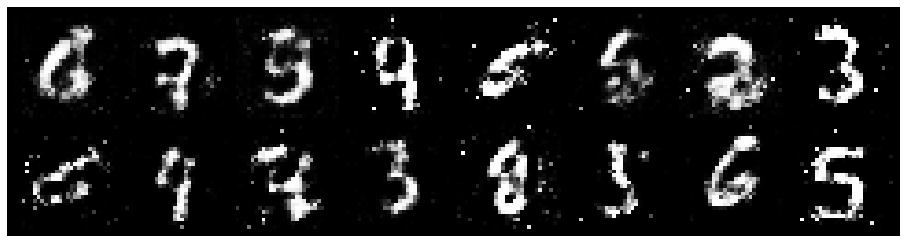

Epoch: [38/200], Batch Num: [500/600]
Discriminator Loss: 1.1086, Generator Loss: 1.2258
D(x): 0.6034, D(G(z)): 0.3601


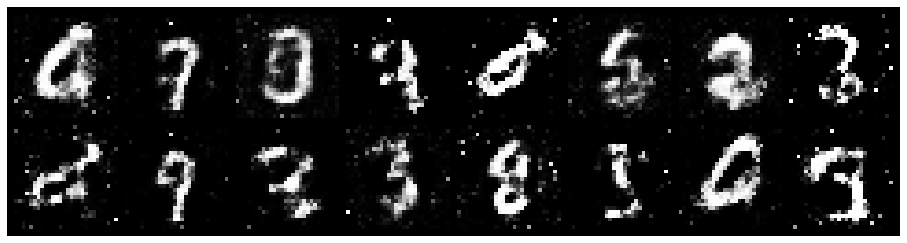

Epoch: [39/200], Batch Num: [0/600]
Discriminator Loss: 0.9950, Generator Loss: 1.3611
D(x): 0.6158, D(G(z)): 0.3018


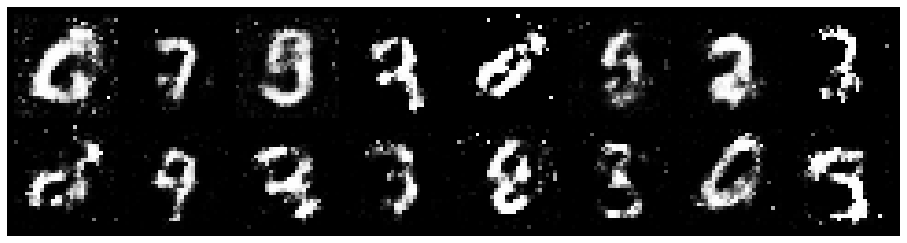

Epoch: [39/200], Batch Num: [100/600]
Discriminator Loss: 1.1639, Generator Loss: 0.8977
D(x): 0.6020, D(G(z)): 0.4298


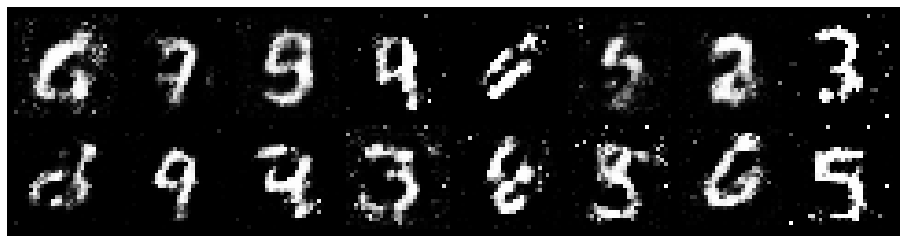

Epoch: [39/200], Batch Num: [200/600]
Discriminator Loss: 1.3235, Generator Loss: 1.1438
D(x): 0.5454, D(G(z)): 0.3936


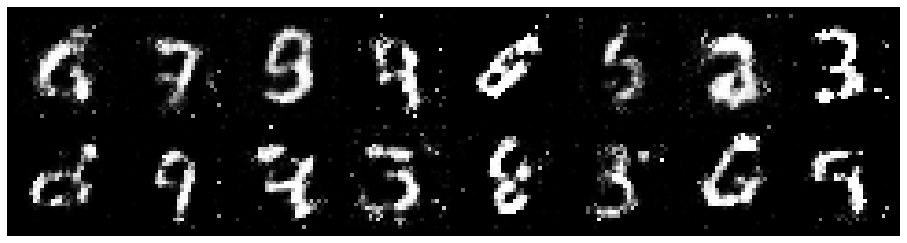

Epoch: [39/200], Batch Num: [300/600]
Discriminator Loss: 1.1461, Generator Loss: 1.3548
D(x): 0.5912, D(G(z)): 0.3505


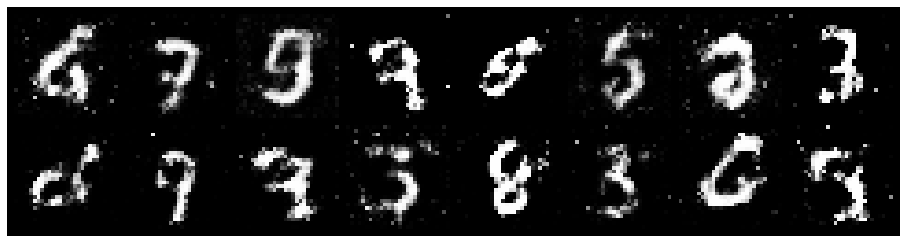

Epoch: [39/200], Batch Num: [400/600]
Discriminator Loss: 1.1920, Generator Loss: 1.0527
D(x): 0.6805, D(G(z)): 0.4672


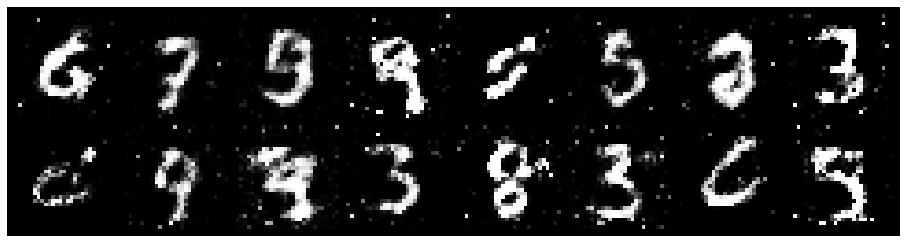

Epoch: [39/200], Batch Num: [500/600]
Discriminator Loss: 1.1614, Generator Loss: 1.2770
D(x): 0.6185, D(G(z)): 0.3556


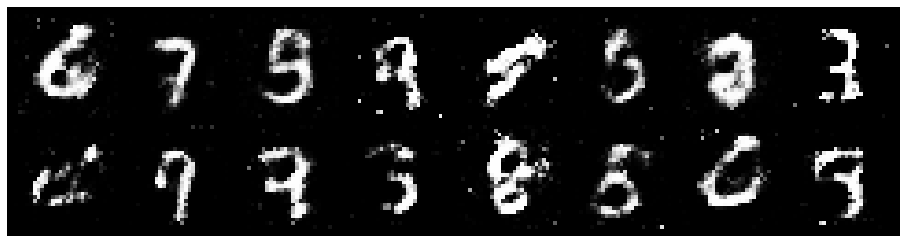

Epoch: [40/200], Batch Num: [0/600]
Discriminator Loss: 1.1418, Generator Loss: 1.2497
D(x): 0.6707, D(G(z)): 0.4121


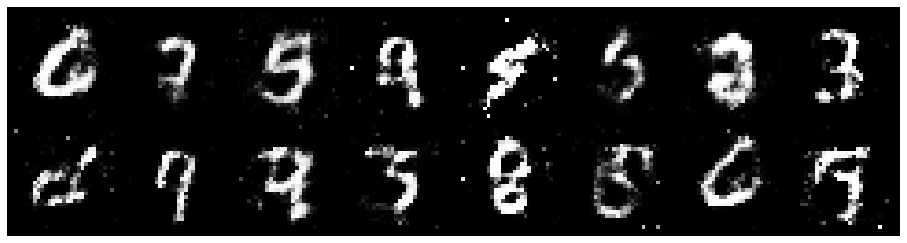

Epoch: [40/200], Batch Num: [100/600]
Discriminator Loss: 1.0446, Generator Loss: 1.6517
D(x): 0.7047, D(G(z)): 0.3969


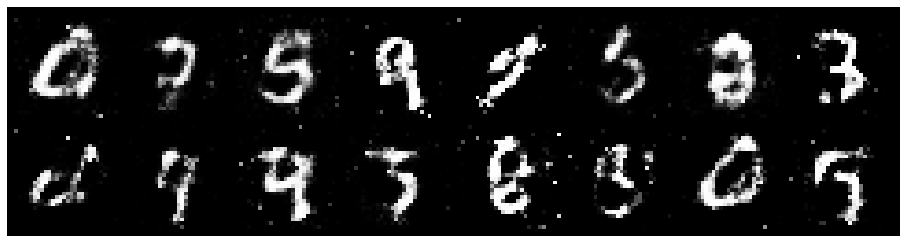

Epoch: [40/200], Batch Num: [200/600]
Discriminator Loss: 1.1660, Generator Loss: 1.3335
D(x): 0.6428, D(G(z)): 0.3763


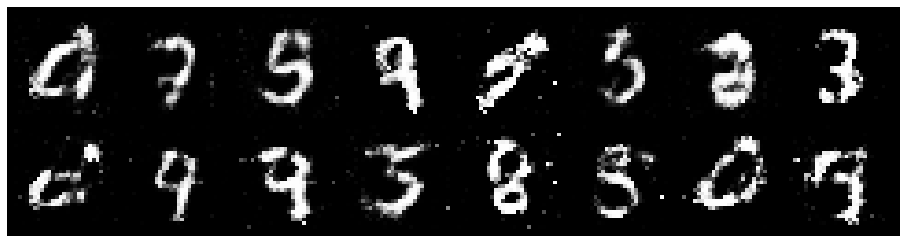

Epoch: [40/200], Batch Num: [300/600]
Discriminator Loss: 1.1546, Generator Loss: 1.2528
D(x): 0.5793, D(G(z)): 0.3282


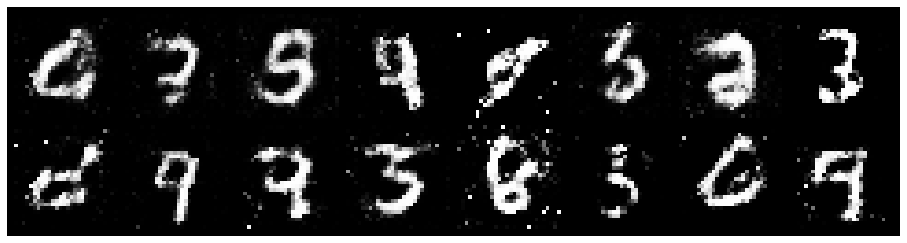

Epoch: [40/200], Batch Num: [400/600]
Discriminator Loss: 1.0736, Generator Loss: 0.9782
D(x): 0.6318, D(G(z)): 0.3956


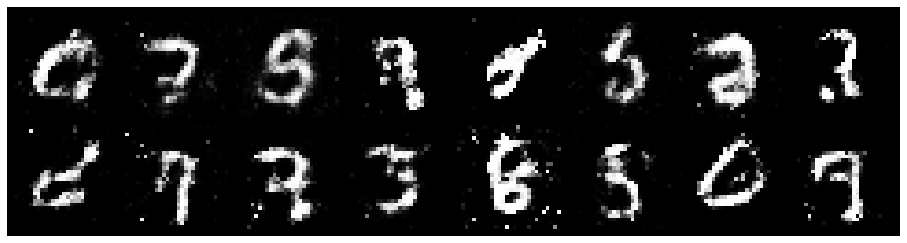

Epoch: [40/200], Batch Num: [500/600]
Discriminator Loss: 1.2383, Generator Loss: 0.9530
D(x): 0.6323, D(G(z)): 0.4610


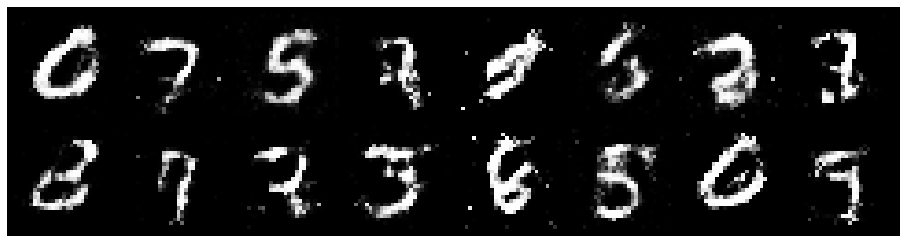

Epoch: [41/200], Batch Num: [0/600]
Discriminator Loss: 1.2905, Generator Loss: 0.9781
D(x): 0.6019, D(G(z)): 0.4697


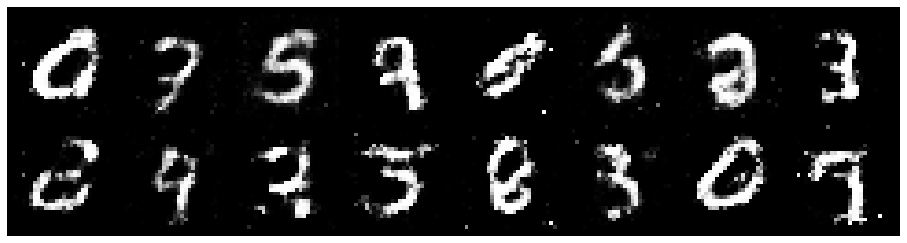

Epoch: [41/200], Batch Num: [100/600]
Discriminator Loss: 1.1626, Generator Loss: 1.4637
D(x): 0.6176, D(G(z)): 0.3663


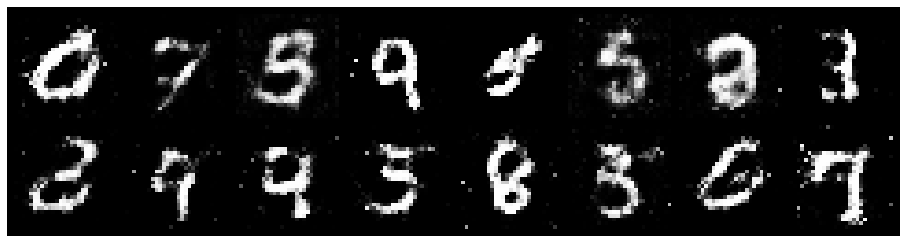

Epoch: [41/200], Batch Num: [200/600]
Discriminator Loss: 1.1023, Generator Loss: 1.2533
D(x): 0.5551, D(G(z)): 0.3367


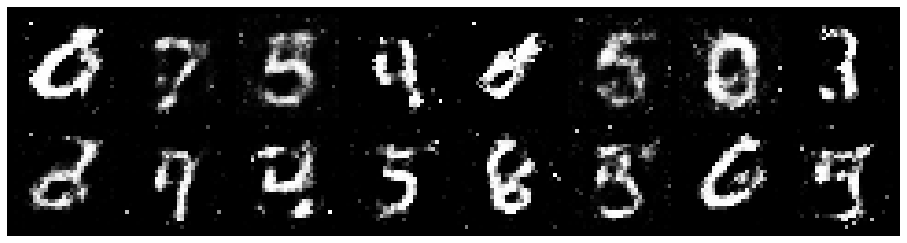

Epoch: [41/200], Batch Num: [300/600]
Discriminator Loss: 0.9604, Generator Loss: 1.0544
D(x): 0.7028, D(G(z)): 0.3759


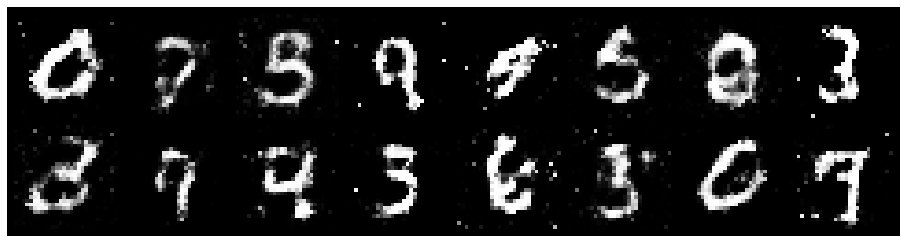

Epoch: [41/200], Batch Num: [400/600]
Discriminator Loss: 1.1604, Generator Loss: 1.0706
D(x): 0.5930, D(G(z)): 0.3784


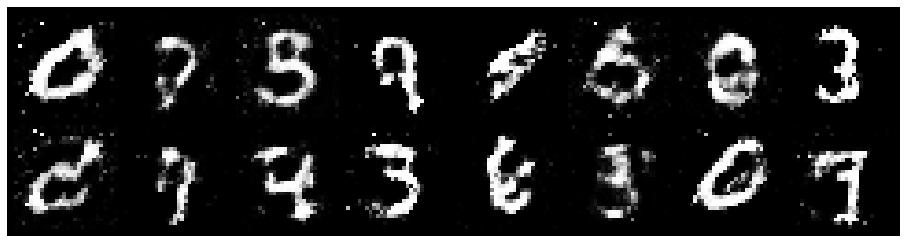

Epoch: [41/200], Batch Num: [500/600]
Discriminator Loss: 1.2083, Generator Loss: 1.0720
D(x): 0.6152, D(G(z)): 0.4104


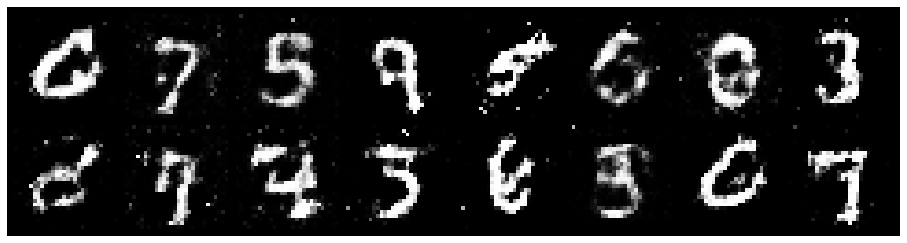

Epoch: [42/200], Batch Num: [0/600]
Discriminator Loss: 1.2731, Generator Loss: 1.1580
D(x): 0.6156, D(G(z)): 0.4328


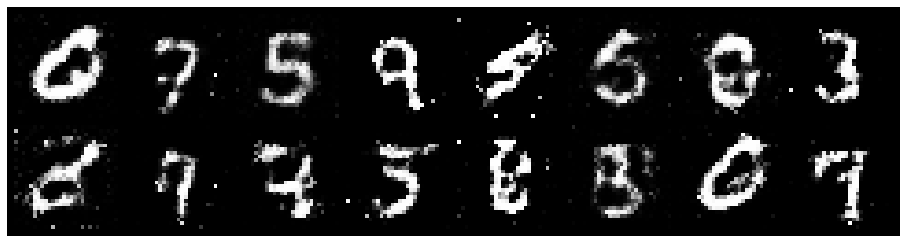

Epoch: [42/200], Batch Num: [100/600]
Discriminator Loss: 1.1797, Generator Loss: 1.0772
D(x): 0.6121, D(G(z)): 0.4042


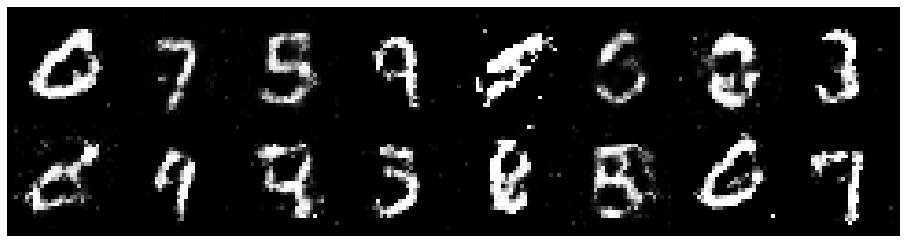

Epoch: [42/200], Batch Num: [200/600]
Discriminator Loss: 1.1279, Generator Loss: 1.3177
D(x): 0.6409, D(G(z)): 0.3669


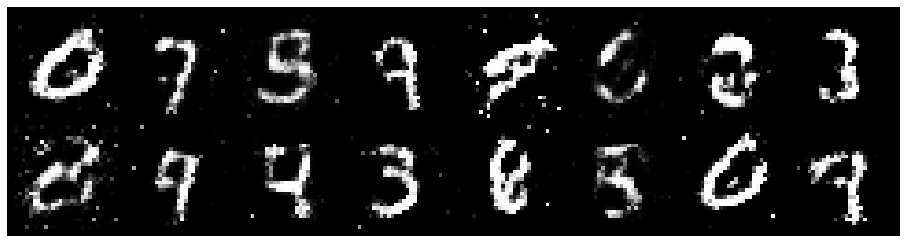

Epoch: [42/200], Batch Num: [300/600]
Discriminator Loss: 1.1609, Generator Loss: 1.0216
D(x): 0.5976, D(G(z)): 0.4073


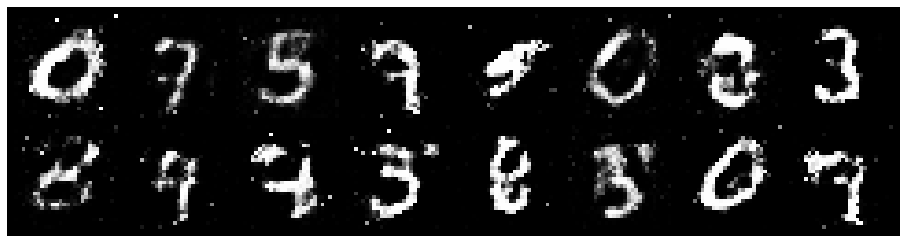

Epoch: [42/200], Batch Num: [400/600]
Discriminator Loss: 1.1133, Generator Loss: 1.2553
D(x): 0.6406, D(G(z)): 0.4177


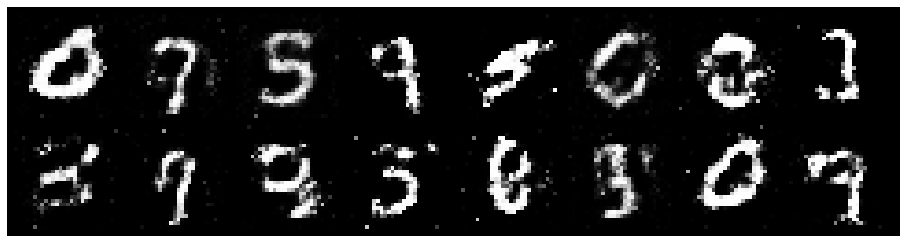

Epoch: [42/200], Batch Num: [500/600]
Discriminator Loss: 1.1639, Generator Loss: 1.0535
D(x): 0.5922, D(G(z)): 0.3920


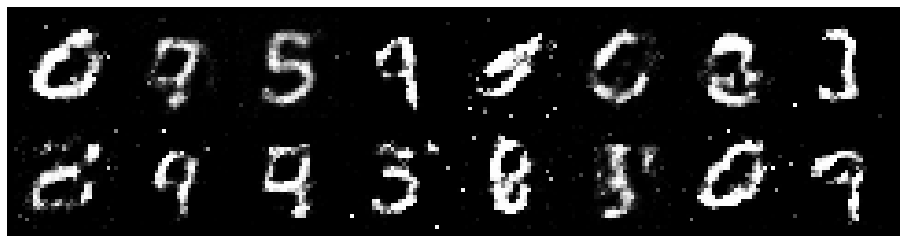

Epoch: [43/200], Batch Num: [0/600]
Discriminator Loss: 1.0856, Generator Loss: 1.5388
D(x): 0.6632, D(G(z)): 0.3479


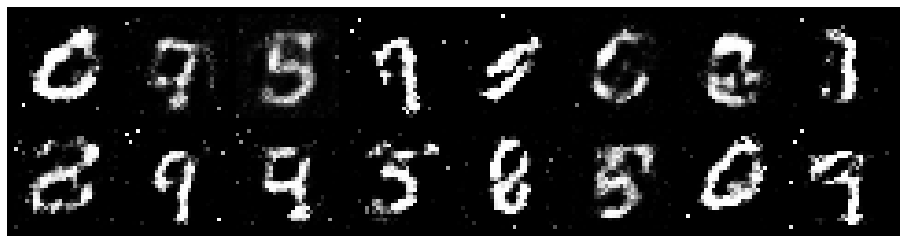

Epoch: [43/200], Batch Num: [100/600]
Discriminator Loss: 1.2132, Generator Loss: 1.2802
D(x): 0.5981, D(G(z)): 0.4069


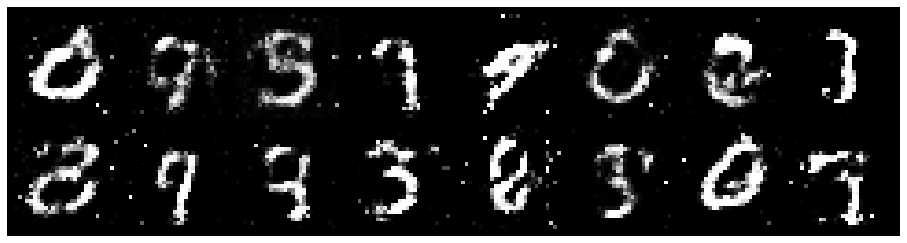

Epoch: [43/200], Batch Num: [200/600]
Discriminator Loss: 1.0477, Generator Loss: 1.2403
D(x): 0.6200, D(G(z)): 0.3651


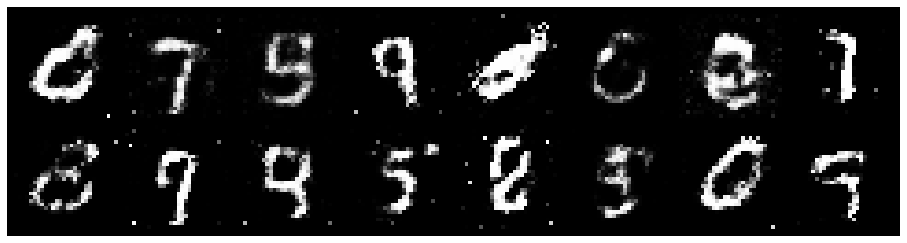

Epoch: [43/200], Batch Num: [300/600]
Discriminator Loss: 1.0112, Generator Loss: 1.2135
D(x): 0.6326, D(G(z)): 0.3380


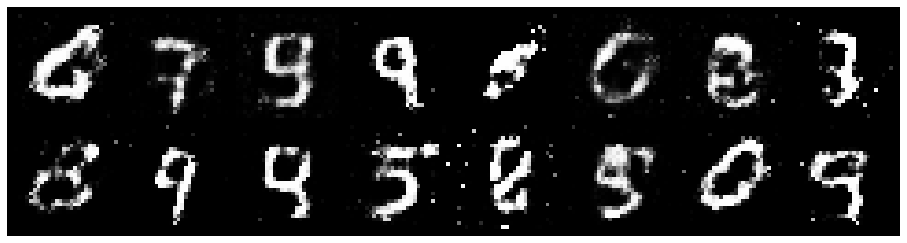

Epoch: [43/200], Batch Num: [400/600]
Discriminator Loss: 1.0034, Generator Loss: 1.1241
D(x): 0.7039, D(G(z)): 0.3741


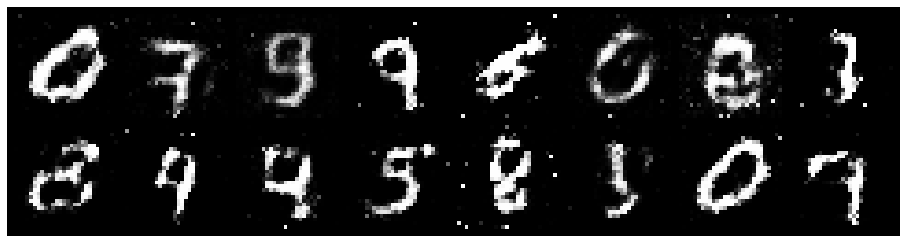

Epoch: [43/200], Batch Num: [500/600]
Discriminator Loss: 1.1274, Generator Loss: 1.0986
D(x): 0.6608, D(G(z)): 0.4259


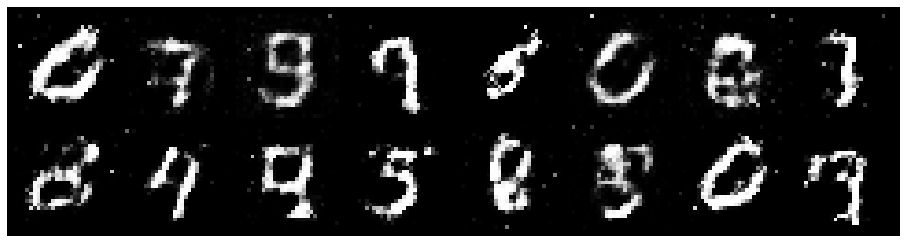

Epoch: [44/200], Batch Num: [0/600]
Discriminator Loss: 1.0708, Generator Loss: 1.0529
D(x): 0.6272, D(G(z)): 0.3808


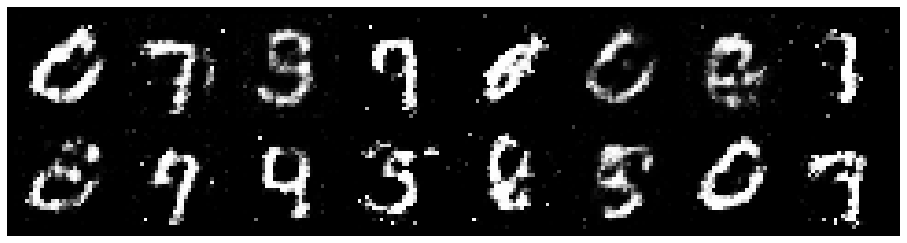

Epoch: [44/200], Batch Num: [100/600]
Discriminator Loss: 1.1137, Generator Loss: 1.1382
D(x): 0.6261, D(G(z)): 0.4036


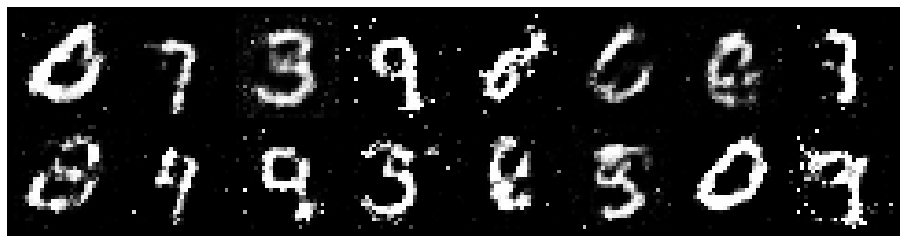

Epoch: [44/200], Batch Num: [200/600]
Discriminator Loss: 1.0823, Generator Loss: 1.1711
D(x): 0.6451, D(G(z)): 0.4132


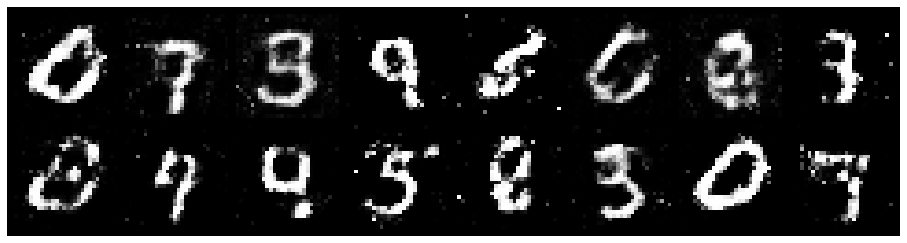

Epoch: [44/200], Batch Num: [300/600]
Discriminator Loss: 1.1226, Generator Loss: 1.0771
D(x): 0.6203, D(G(z)): 0.4022


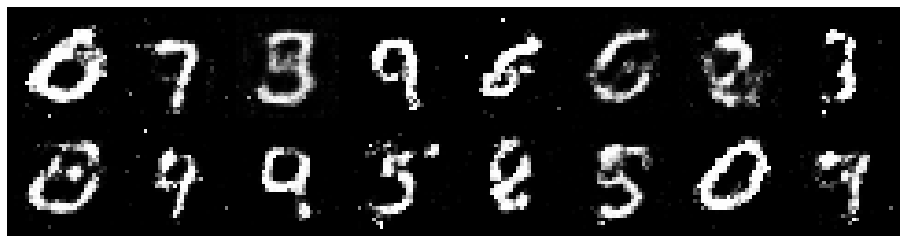

Epoch: [44/200], Batch Num: [400/600]
Discriminator Loss: 1.1978, Generator Loss: 1.2613
D(x): 0.5909, D(G(z)): 0.3892


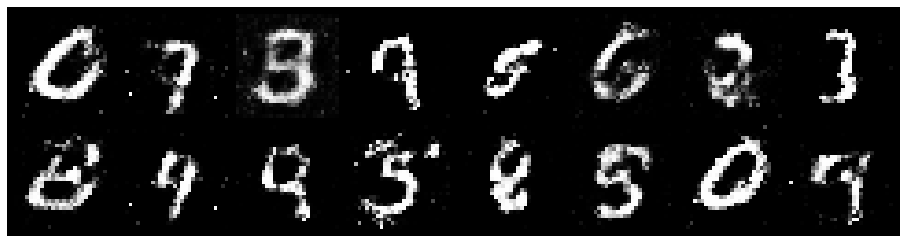

Epoch: [44/200], Batch Num: [500/600]
Discriminator Loss: 1.0164, Generator Loss: 1.1224
D(x): 0.6301, D(G(z)): 0.3722


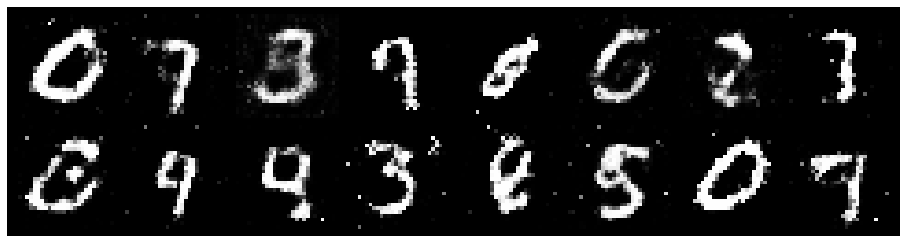

Epoch: [45/200], Batch Num: [0/600]
Discriminator Loss: 1.0889, Generator Loss: 1.0932
D(x): 0.6199, D(G(z)): 0.3722


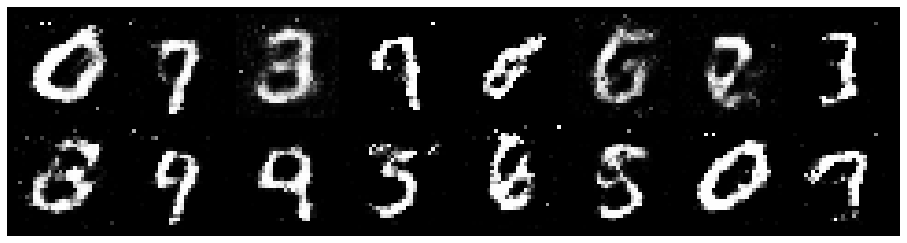

Epoch: [45/200], Batch Num: [100/600]
Discriminator Loss: 1.0270, Generator Loss: 1.1532
D(x): 0.6138, D(G(z)): 0.3395


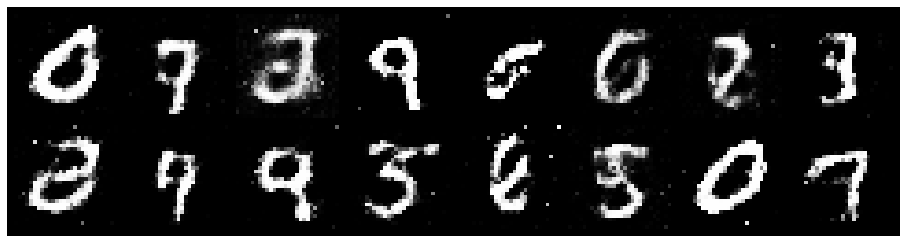

Epoch: [45/200], Batch Num: [200/600]
Discriminator Loss: 1.0297, Generator Loss: 1.2981
D(x): 0.6261, D(G(z)): 0.3382


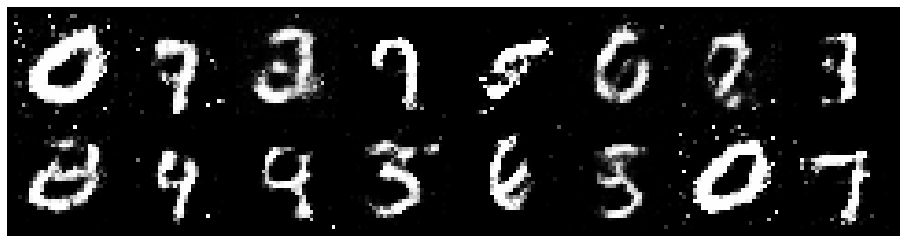

Epoch: [45/200], Batch Num: [300/600]
Discriminator Loss: 1.2647, Generator Loss: 1.1584
D(x): 0.5600, D(G(z)): 0.3747


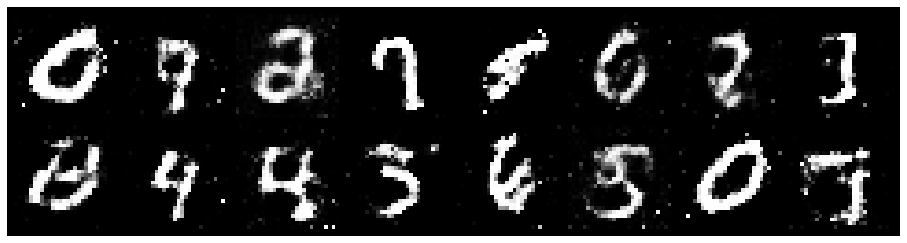

Epoch: [45/200], Batch Num: [400/600]
Discriminator Loss: 1.1626, Generator Loss: 1.1944
D(x): 0.6588, D(G(z)): 0.3229


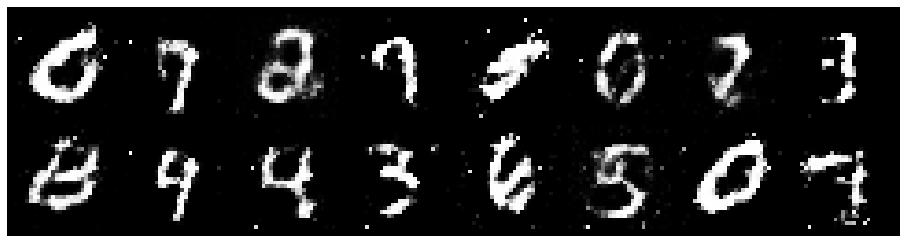

Epoch: [45/200], Batch Num: [500/600]
Discriminator Loss: 1.0221, Generator Loss: 1.2006
D(x): 0.6319, D(G(z)): 0.3433


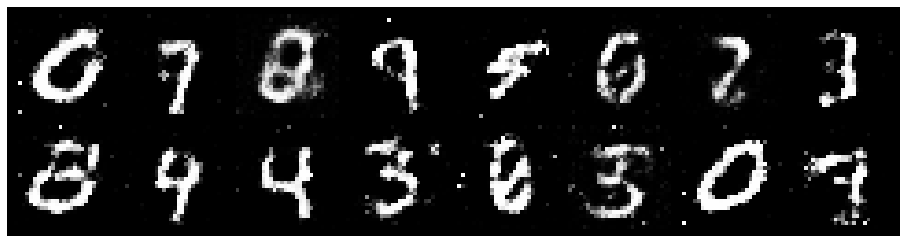

Epoch: [46/200], Batch Num: [0/600]
Discriminator Loss: 1.2095, Generator Loss: 1.1625
D(x): 0.5991, D(G(z)): 0.3983


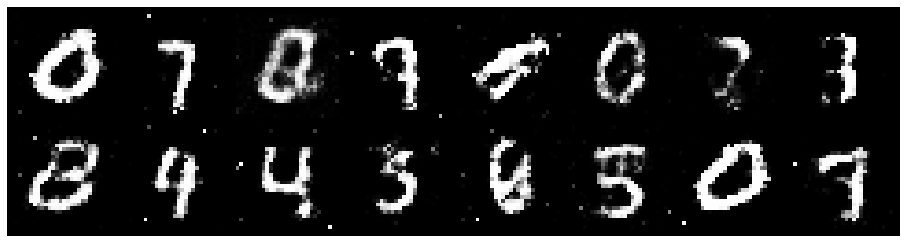

Epoch: [46/200], Batch Num: [100/600]
Discriminator Loss: 1.0131, Generator Loss: 1.2056
D(x): 0.6406, D(G(z)): 0.3558


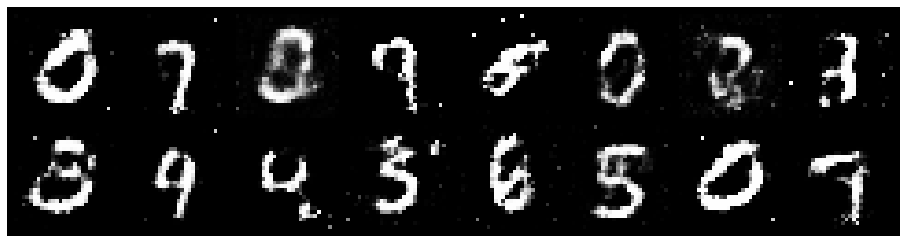

Epoch: [46/200], Batch Num: [200/600]
Discriminator Loss: 1.0857, Generator Loss: 1.0169
D(x): 0.5994, D(G(z)): 0.3741


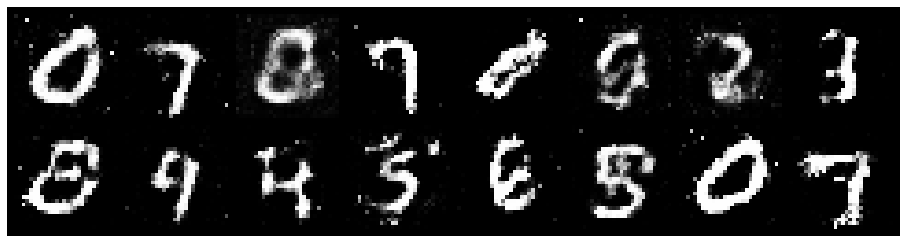

Epoch: [46/200], Batch Num: [300/600]
Discriminator Loss: 1.1567, Generator Loss: 1.3005
D(x): 0.6323, D(G(z)): 0.3721


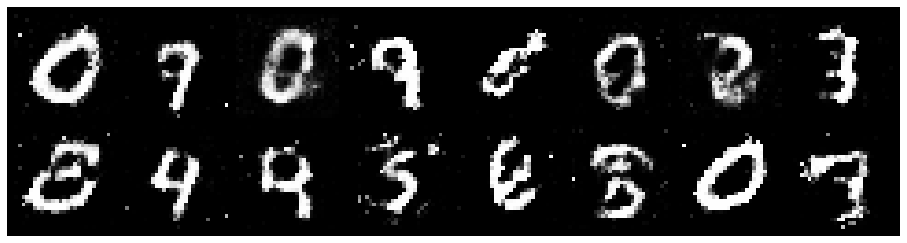

Epoch: [46/200], Batch Num: [400/600]
Discriminator Loss: 1.2065, Generator Loss: 0.7979
D(x): 0.6133, D(G(z)): 0.4350


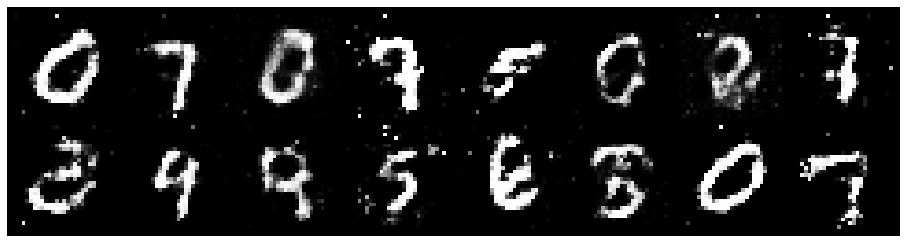

Epoch: [46/200], Batch Num: [500/600]
Discriminator Loss: 1.1835, Generator Loss: 1.2261
D(x): 0.5462, D(G(z)): 0.3387


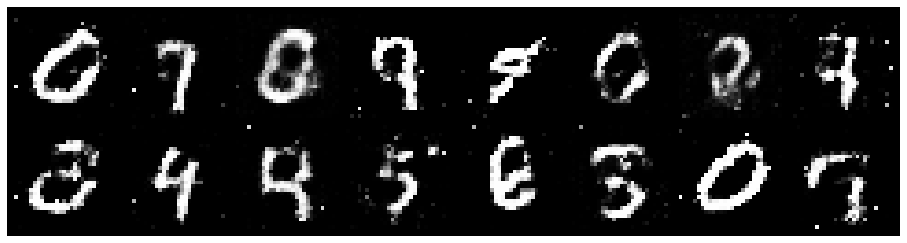

Epoch: [47/200], Batch Num: [0/600]
Discriminator Loss: 1.1701, Generator Loss: 0.9370
D(x): 0.5325, D(G(z)): 0.3564


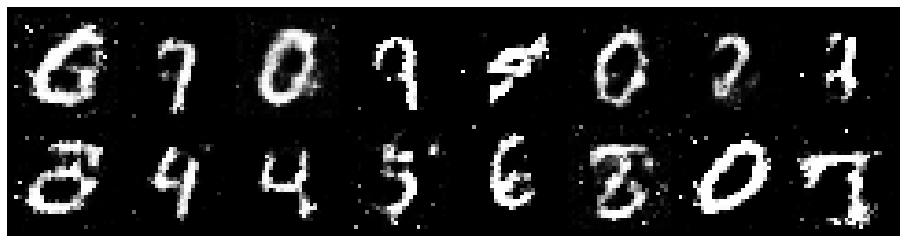

Epoch: [47/200], Batch Num: [100/600]
Discriminator Loss: 1.2436, Generator Loss: 0.9969
D(x): 0.5699, D(G(z)): 0.4113


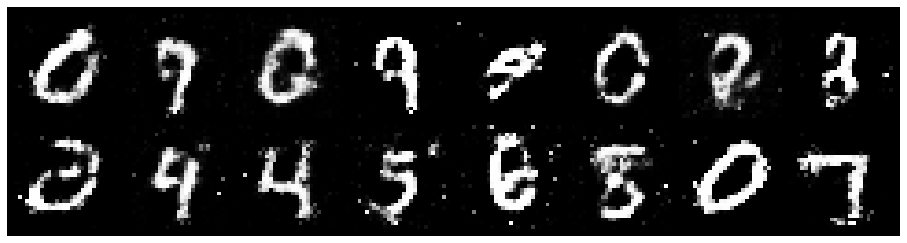

Epoch: [47/200], Batch Num: [200/600]
Discriminator Loss: 1.0376, Generator Loss: 1.2065
D(x): 0.6059, D(G(z)): 0.3372


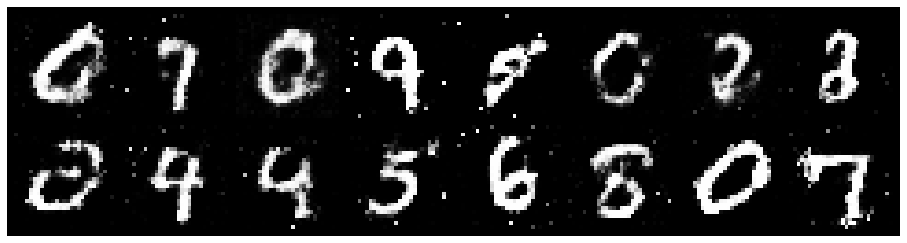

Epoch: [47/200], Batch Num: [300/600]
Discriminator Loss: 1.1857, Generator Loss: 1.2930
D(x): 0.6186, D(G(z)): 0.4097


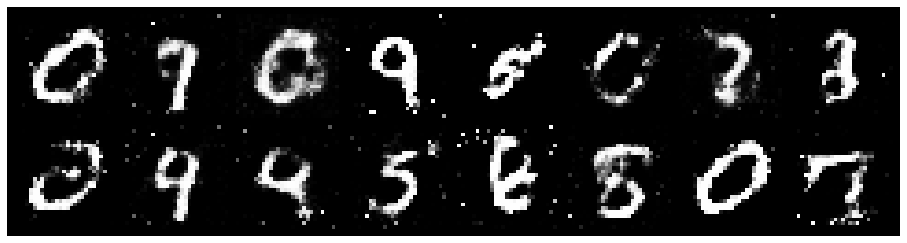

Epoch: [47/200], Batch Num: [400/600]
Discriminator Loss: 1.2268, Generator Loss: 1.1105
D(x): 0.5654, D(G(z)): 0.3811


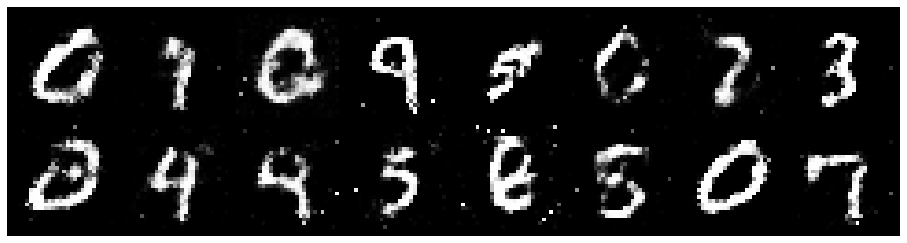

Epoch: [47/200], Batch Num: [500/600]
Discriminator Loss: 1.1414, Generator Loss: 1.3018
D(x): 0.6070, D(G(z)): 0.3527


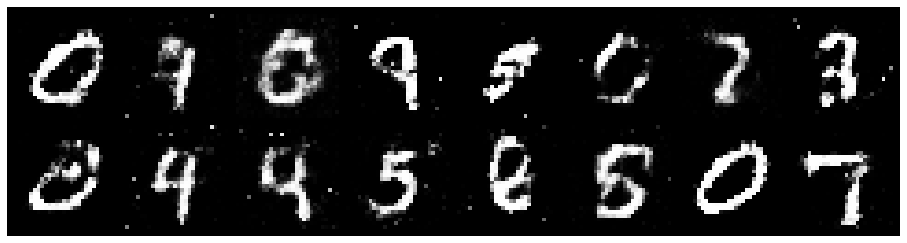

Epoch: [48/200], Batch Num: [0/600]
Discriminator Loss: 1.1371, Generator Loss: 0.9720
D(x): 0.6225, D(G(z)): 0.3880


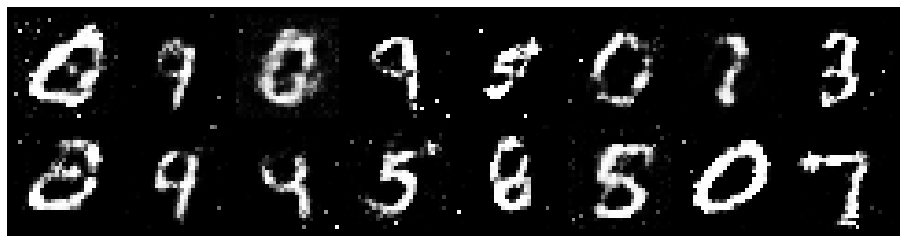

Epoch: [48/200], Batch Num: [100/600]
Discriminator Loss: 1.1148, Generator Loss: 1.3996
D(x): 0.5502, D(G(z)): 0.3111


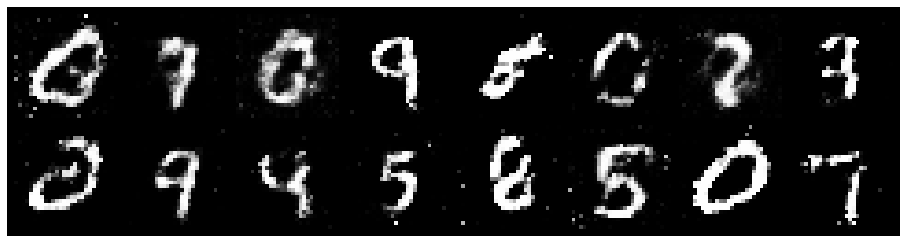

Epoch: [48/200], Batch Num: [200/600]
Discriminator Loss: 1.2413, Generator Loss: 0.9569
D(x): 0.6692, D(G(z)): 0.4900


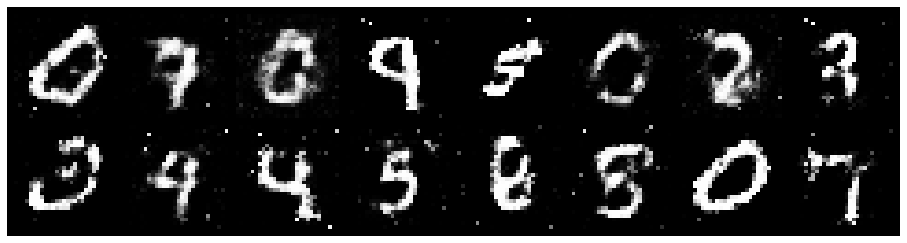

Epoch: [48/200], Batch Num: [300/600]
Discriminator Loss: 1.2804, Generator Loss: 1.0942
D(x): 0.5973, D(G(z)): 0.4310


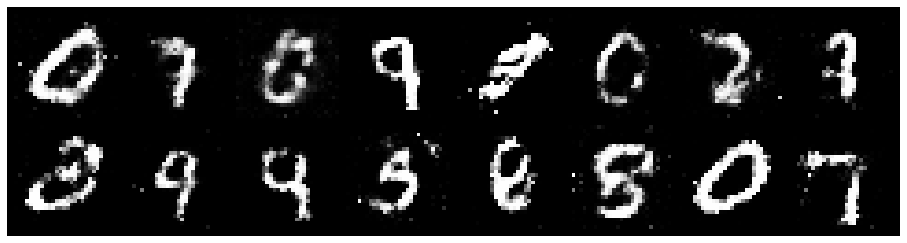

Epoch: [48/200], Batch Num: [400/600]
Discriminator Loss: 1.2153, Generator Loss: 1.2022
D(x): 0.5995, D(G(z)): 0.4084


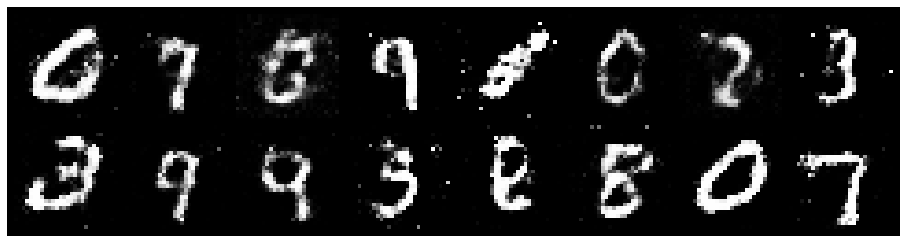

Epoch: [48/200], Batch Num: [500/600]
Discriminator Loss: 1.2500, Generator Loss: 1.1017
D(x): 0.5245, D(G(z)): 0.3601


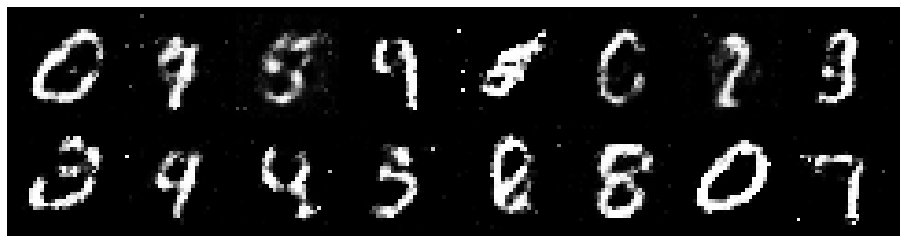

Epoch: [49/200], Batch Num: [0/600]
Discriminator Loss: 1.1476, Generator Loss: 1.0012
D(x): 0.6063, D(G(z)): 0.4081


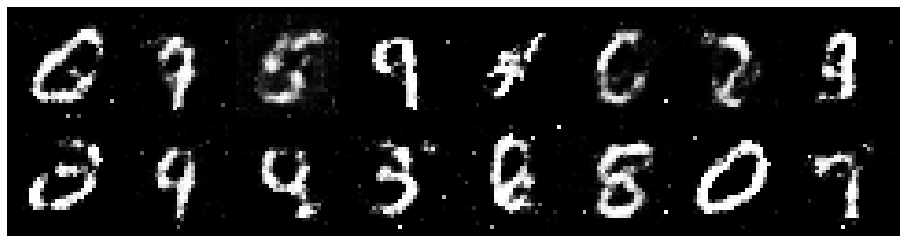

Epoch: [49/200], Batch Num: [100/600]
Discriminator Loss: 1.0991, Generator Loss: 1.0364
D(x): 0.6108, D(G(z)): 0.3881


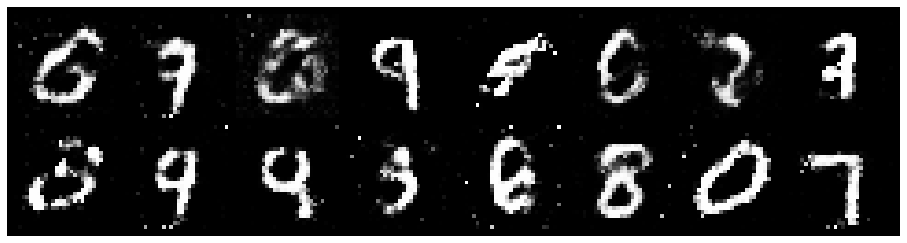

Epoch: [49/200], Batch Num: [200/600]
Discriminator Loss: 1.1899, Generator Loss: 1.0736
D(x): 0.6067, D(G(z)): 0.4056


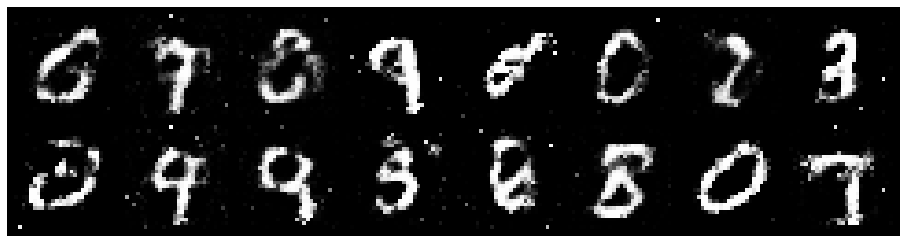

Epoch: [49/200], Batch Num: [300/600]
Discriminator Loss: 1.1166, Generator Loss: 1.1434
D(x): 0.5977, D(G(z)): 0.3814


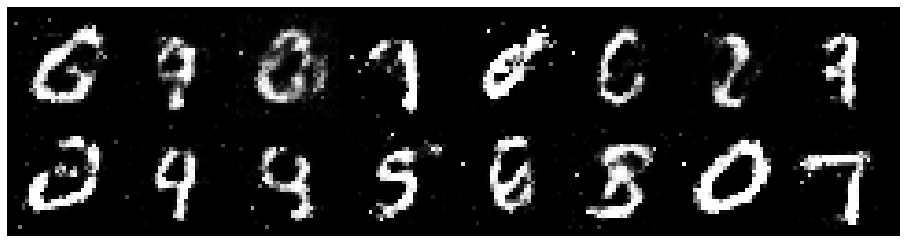

Epoch: [49/200], Batch Num: [400/600]
Discriminator Loss: 1.1408, Generator Loss: 1.3031
D(x): 0.6339, D(G(z)): 0.4077


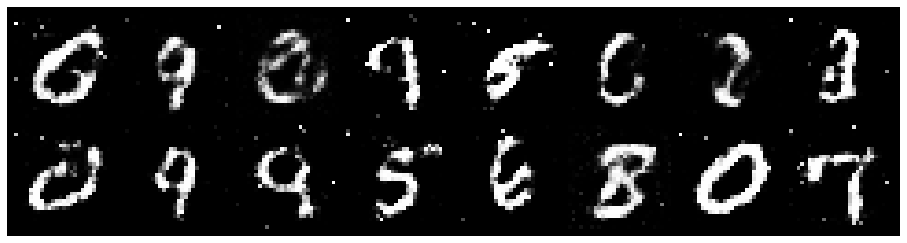

Epoch: [49/200], Batch Num: [500/600]
Discriminator Loss: 1.2694, Generator Loss: 0.9206
D(x): 0.6533, D(G(z)): 0.4915


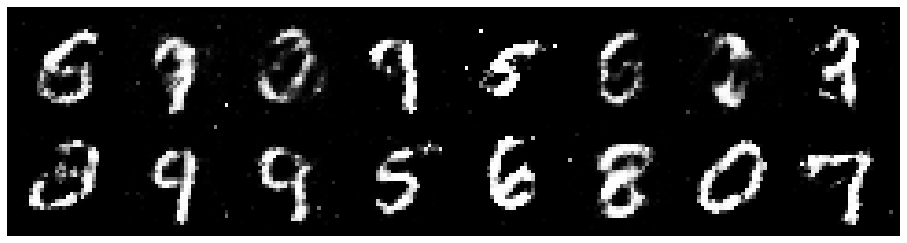

Epoch: [50/200], Batch Num: [0/600]
Discriminator Loss: 0.9971, Generator Loss: 1.0796
D(x): 0.6538, D(G(z)): 0.3775


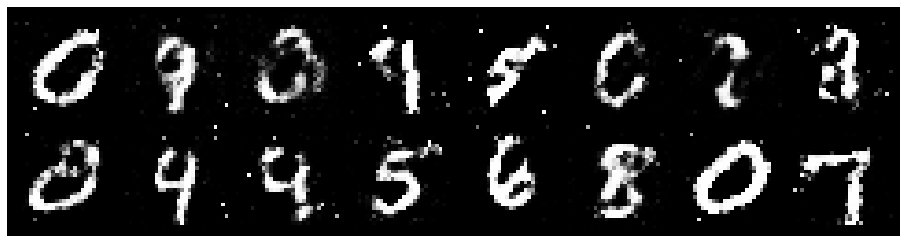

Epoch: [50/200], Batch Num: [100/600]
Discriminator Loss: 1.0301, Generator Loss: 1.1028
D(x): 0.6618, D(G(z)): 0.3739


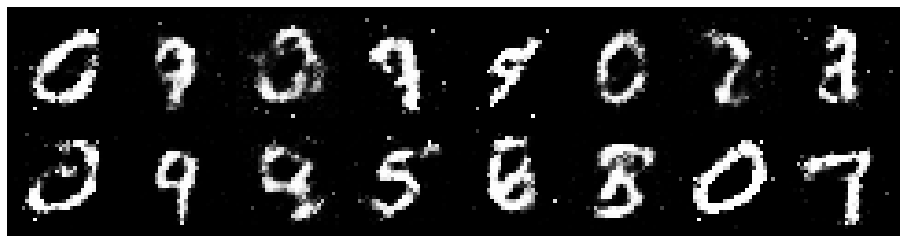

Epoch: [50/200], Batch Num: [200/600]
Discriminator Loss: 1.0271, Generator Loss: 1.1230
D(x): 0.6452, D(G(z)): 0.3860


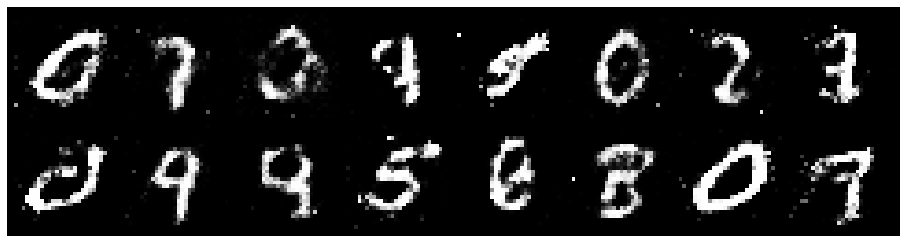

Epoch: [50/200], Batch Num: [300/600]
Discriminator Loss: 1.1343, Generator Loss: 0.9003
D(x): 0.6404, D(G(z)): 0.4400


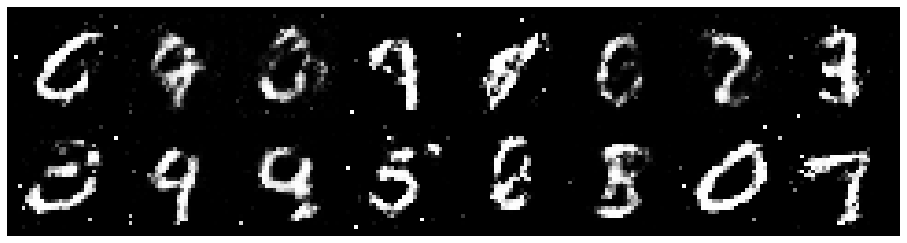

Epoch: [50/200], Batch Num: [400/600]
Discriminator Loss: 1.2310, Generator Loss: 1.0371
D(x): 0.5710, D(G(z)): 0.4111


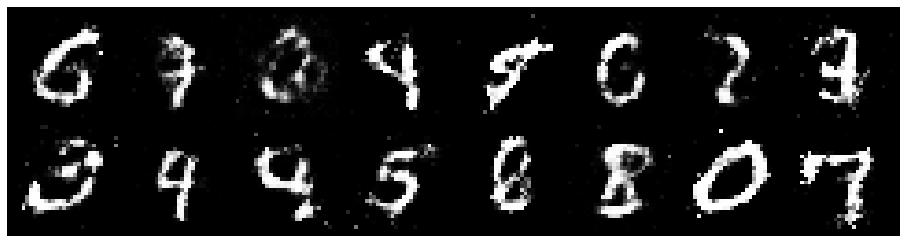

Epoch: [50/200], Batch Num: [500/600]
Discriminator Loss: 1.1357, Generator Loss: 1.0204
D(x): 0.5763, D(G(z)): 0.3752


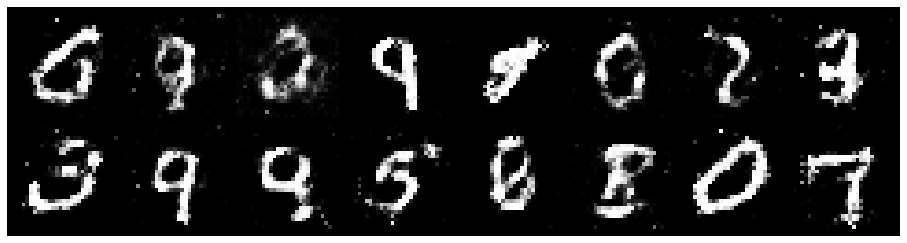

Epoch: [51/200], Batch Num: [0/600]
Discriminator Loss: 0.9426, Generator Loss: 1.3850
D(x): 0.6535, D(G(z)): 0.2975


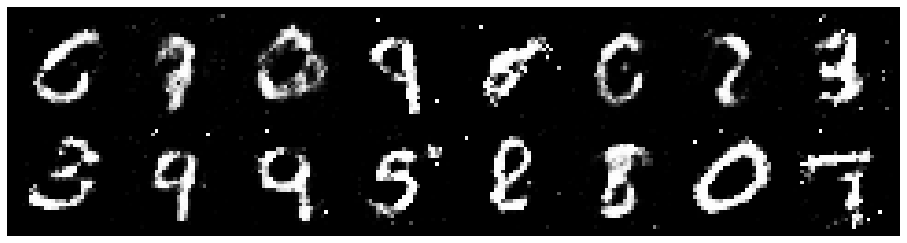

Epoch: [51/200], Batch Num: [100/600]
Discriminator Loss: 1.0317, Generator Loss: 1.1342
D(x): 0.6935, D(G(z)): 0.4124


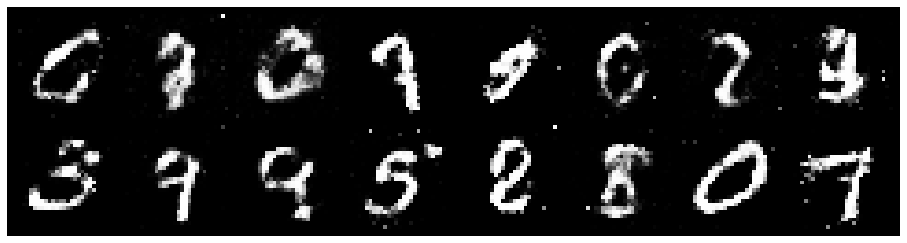

Epoch: [51/200], Batch Num: [200/600]
Discriminator Loss: 1.1427, Generator Loss: 1.1695
D(x): 0.6577, D(G(z)): 0.3974


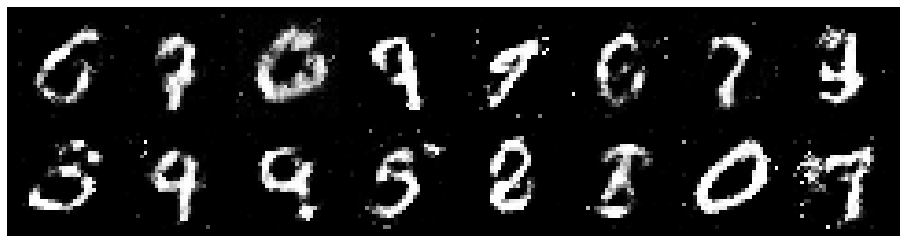

Epoch: [51/200], Batch Num: [300/600]
Discriminator Loss: 1.1581, Generator Loss: 1.1349
D(x): 0.6034, D(G(z)): 0.3820


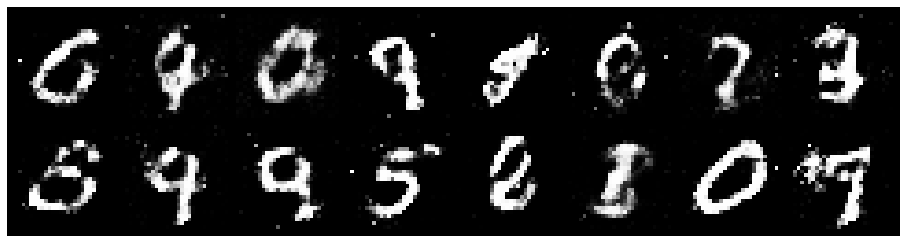

Epoch: [51/200], Batch Num: [400/600]
Discriminator Loss: 1.1998, Generator Loss: 1.1615
D(x): 0.5808, D(G(z)): 0.3531


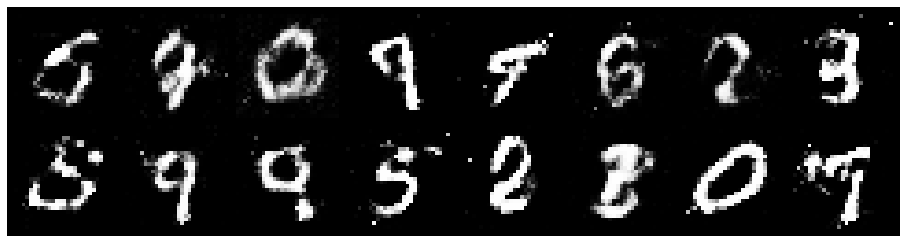

Epoch: [51/200], Batch Num: [500/600]
Discriminator Loss: 1.1772, Generator Loss: 1.1515
D(x): 0.6337, D(G(z)): 0.4017


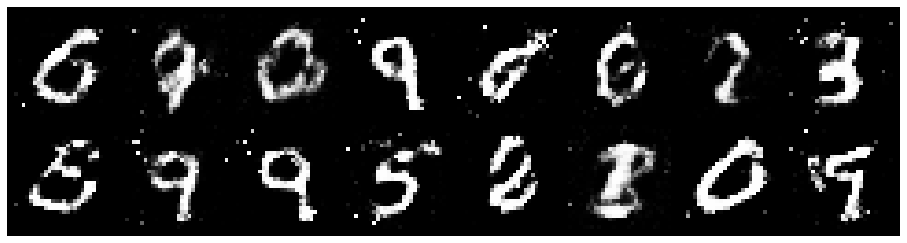

Epoch: [52/200], Batch Num: [0/600]
Discriminator Loss: 1.2269, Generator Loss: 1.0221
D(x): 0.5967, D(G(z)): 0.4226


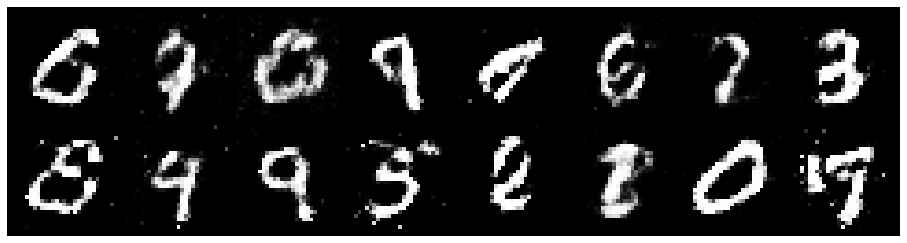

Epoch: [52/200], Batch Num: [100/600]
Discriminator Loss: 1.1245, Generator Loss: 1.0771
D(x): 0.6010, D(G(z)): 0.3802


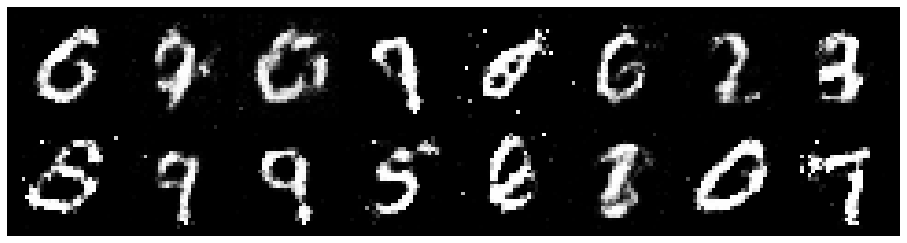

Epoch: [52/200], Batch Num: [200/600]
Discriminator Loss: 1.2261, Generator Loss: 1.2251
D(x): 0.6559, D(G(z)): 0.4690


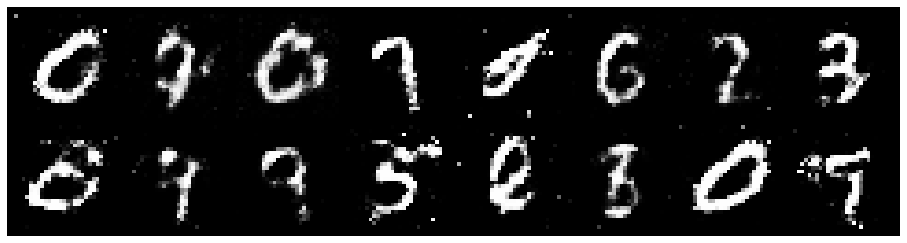

Epoch: [52/200], Batch Num: [300/600]
Discriminator Loss: 1.1878, Generator Loss: 0.9273
D(x): 0.5887, D(G(z)): 0.4198


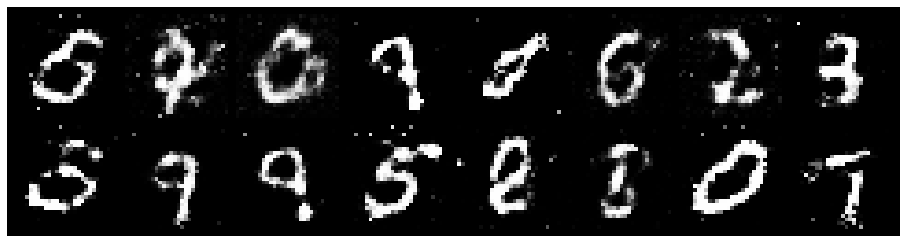

Epoch: [52/200], Batch Num: [400/600]
Discriminator Loss: 1.1479, Generator Loss: 1.1063
D(x): 0.5765, D(G(z)): 0.3819


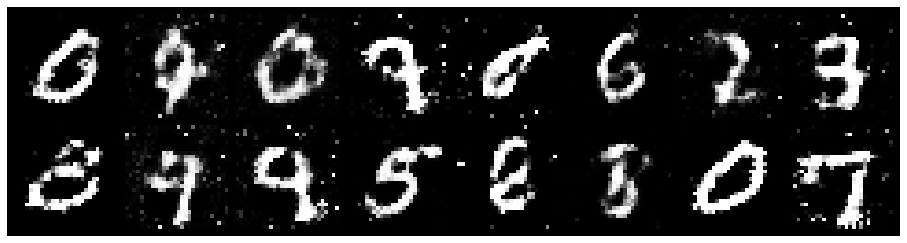

Epoch: [52/200], Batch Num: [500/600]
Discriminator Loss: 1.1552, Generator Loss: 1.0719
D(x): 0.6069, D(G(z)): 0.4032


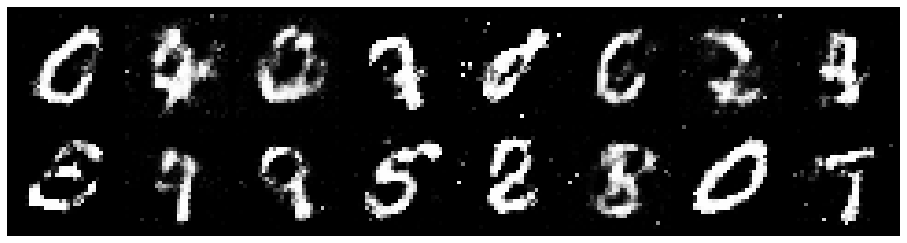

Epoch: [53/200], Batch Num: [0/600]
Discriminator Loss: 1.1739, Generator Loss: 0.9980
D(x): 0.5906, D(G(z)): 0.3896


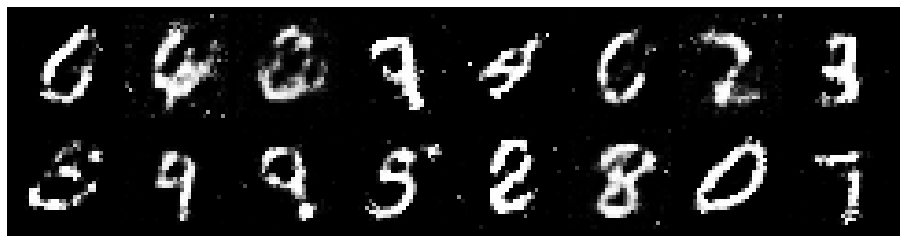

Epoch: [53/200], Batch Num: [100/600]
Discriminator Loss: 1.2399, Generator Loss: 1.1369
D(x): 0.5857, D(G(z)): 0.3758


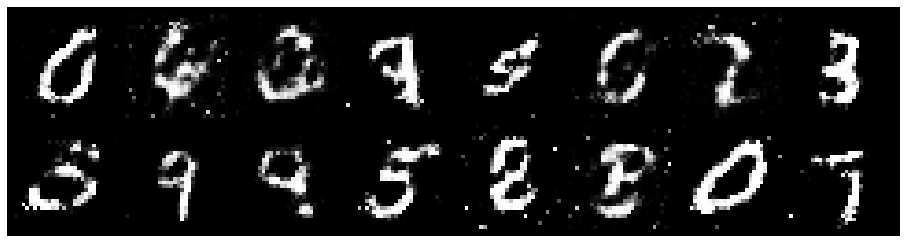

Epoch: [53/200], Batch Num: [200/600]
Discriminator Loss: 1.1868, Generator Loss: 1.0151
D(x): 0.6471, D(G(z)): 0.4365


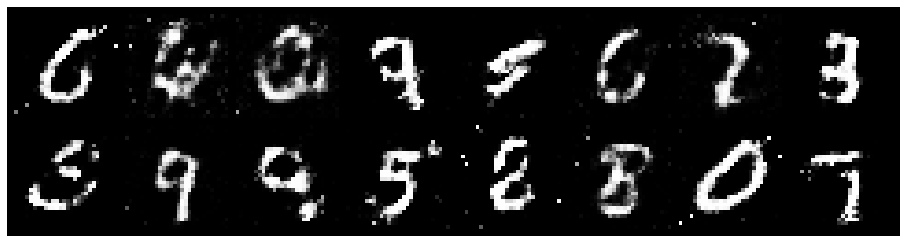

Epoch: [53/200], Batch Num: [300/600]
Discriminator Loss: 1.1361, Generator Loss: 1.0983
D(x): 0.5760, D(G(z)): 0.3394


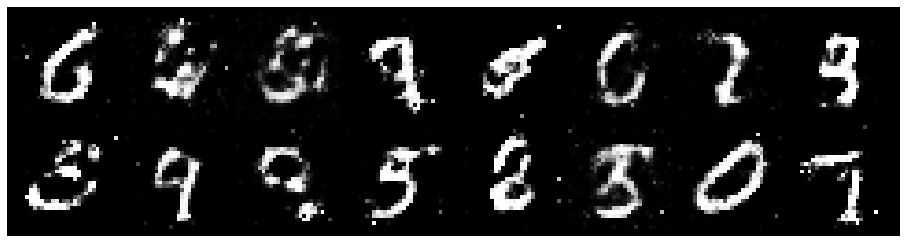

Epoch: [53/200], Batch Num: [400/600]
Discriminator Loss: 1.2038, Generator Loss: 1.0011
D(x): 0.6019, D(G(z)): 0.3926


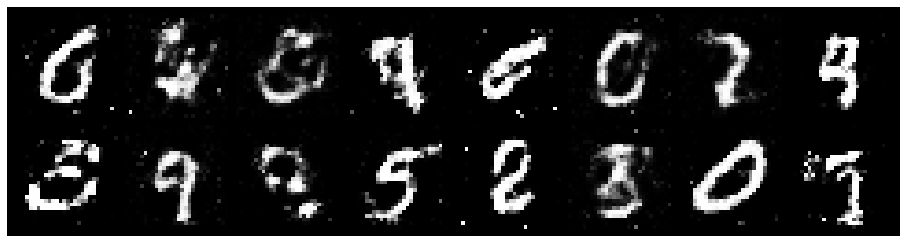

Epoch: [53/200], Batch Num: [500/600]
Discriminator Loss: 1.0230, Generator Loss: 1.1658
D(x): 0.6619, D(G(z)): 0.3394


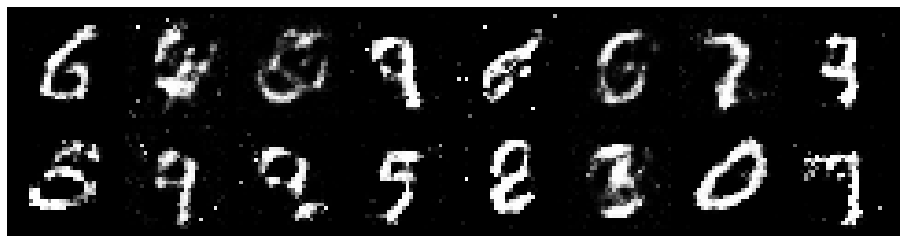

Epoch: [54/200], Batch Num: [0/600]
Discriminator Loss: 1.1644, Generator Loss: 1.1850
D(x): 0.6192, D(G(z)): 0.3700


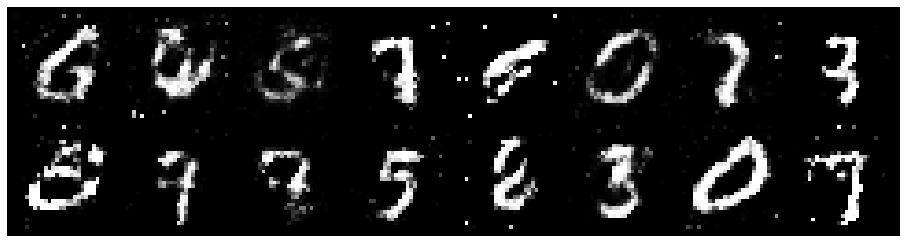

Epoch: [54/200], Batch Num: [100/600]
Discriminator Loss: 1.2304, Generator Loss: 1.0199
D(x): 0.5752, D(G(z)): 0.4413


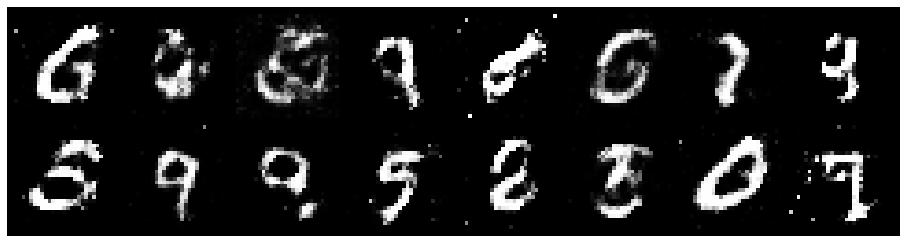

Epoch: [54/200], Batch Num: [200/600]
Discriminator Loss: 1.1902, Generator Loss: 0.9923
D(x): 0.5713, D(G(z)): 0.4044


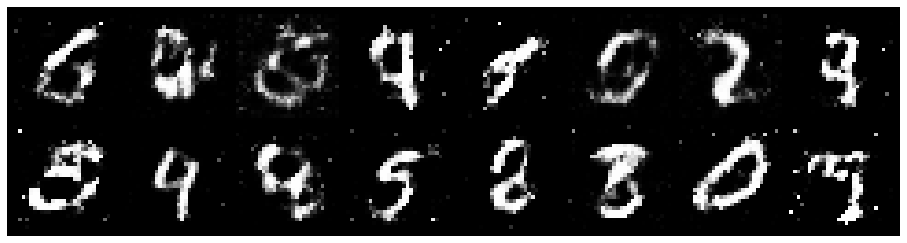

Epoch: [54/200], Batch Num: [300/600]
Discriminator Loss: 1.1890, Generator Loss: 0.8839
D(x): 0.6327, D(G(z)): 0.4398


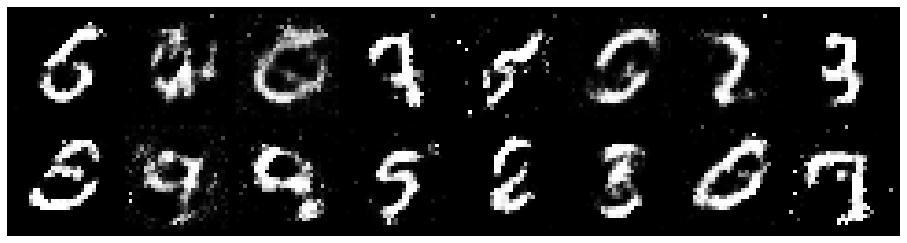

Epoch: [54/200], Batch Num: [400/600]
Discriminator Loss: 1.1452, Generator Loss: 1.0129
D(x): 0.6010, D(G(z)): 0.3939


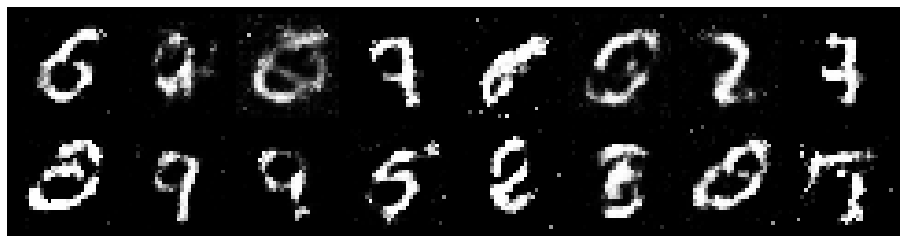

Epoch: [54/200], Batch Num: [500/600]
Discriminator Loss: 1.2119, Generator Loss: 0.9903
D(x): 0.5817, D(G(z)): 0.4140


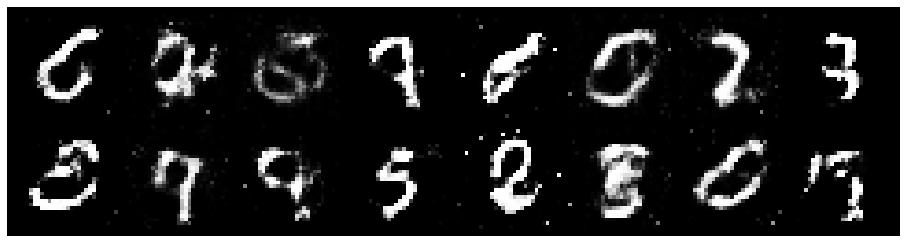

Epoch: [55/200], Batch Num: [0/600]
Discriminator Loss: 1.1086, Generator Loss: 1.2485
D(x): 0.5927, D(G(z)): 0.3289


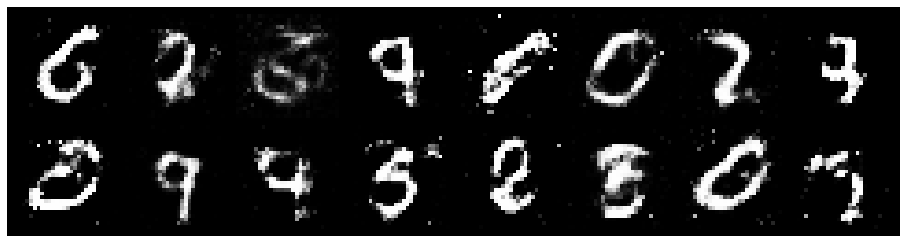

Epoch: [55/200], Batch Num: [100/600]
Discriminator Loss: 1.0657, Generator Loss: 1.3414
D(x): 0.6243, D(G(z)): 0.3628


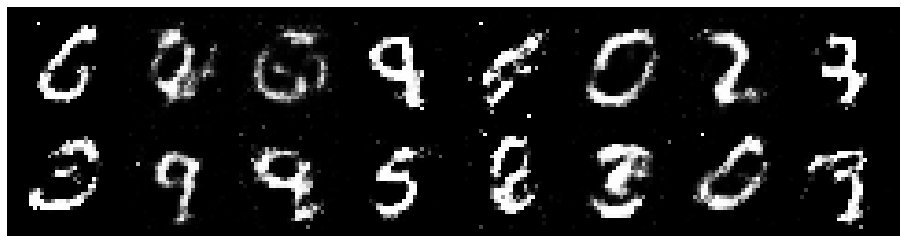

Epoch: [55/200], Batch Num: [200/600]
Discriminator Loss: 1.1771, Generator Loss: 1.0459
D(x): 0.5486, D(G(z)): 0.3712


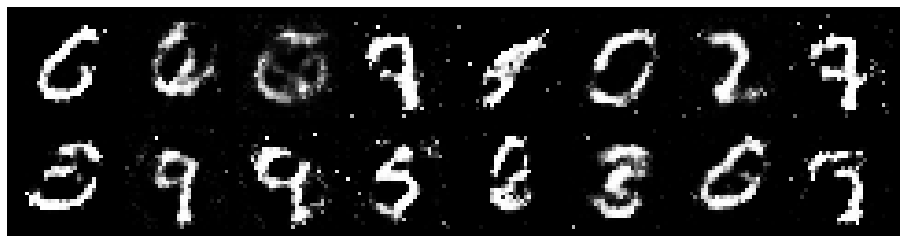

Epoch: [55/200], Batch Num: [300/600]
Discriminator Loss: 1.2475, Generator Loss: 0.8321
D(x): 0.5941, D(G(z)): 0.4635


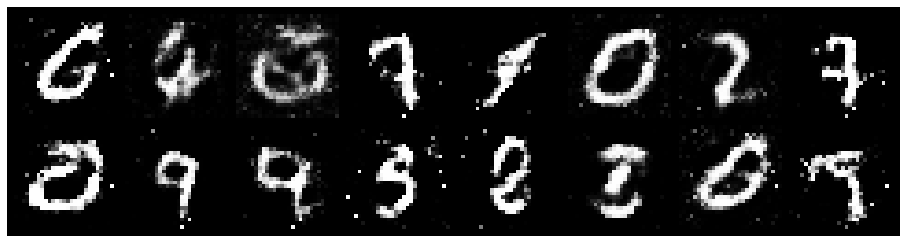

Epoch: [55/200], Batch Num: [400/600]
Discriminator Loss: 1.1701, Generator Loss: 1.0784
D(x): 0.5941, D(G(z)): 0.4118


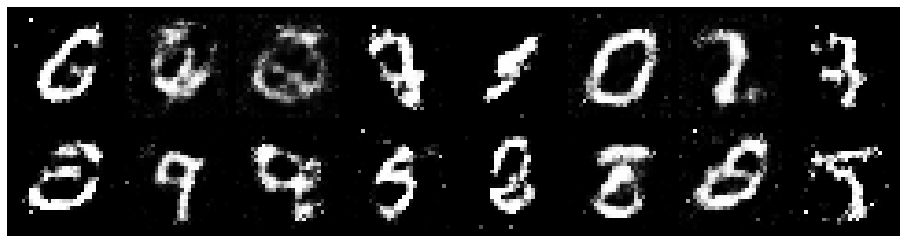

Epoch: [55/200], Batch Num: [500/600]
Discriminator Loss: 1.0374, Generator Loss: 1.1306
D(x): 0.6391, D(G(z)): 0.3449


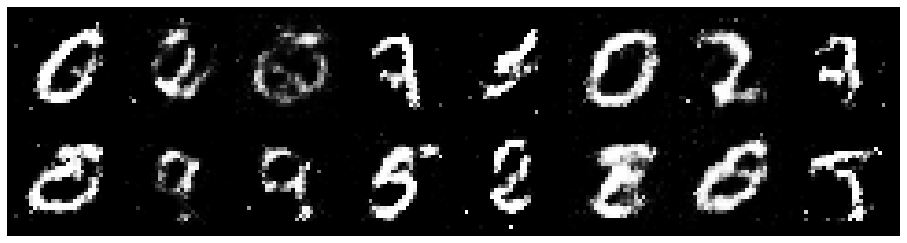

Epoch: [56/200], Batch Num: [0/600]
Discriminator Loss: 0.9508, Generator Loss: 1.1375
D(x): 0.6585, D(G(z)): 0.3498


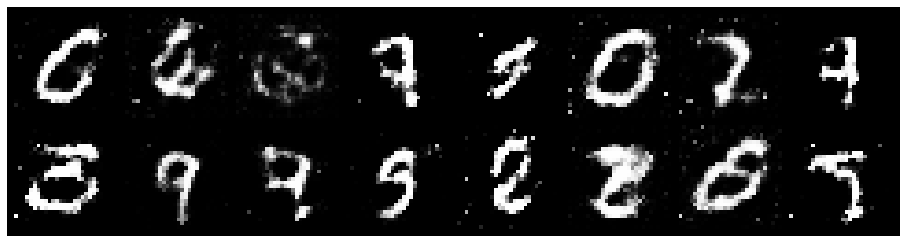

Epoch: [56/200], Batch Num: [100/600]
Discriminator Loss: 1.1399, Generator Loss: 1.0888
D(x): 0.5650, D(G(z)): 0.3724


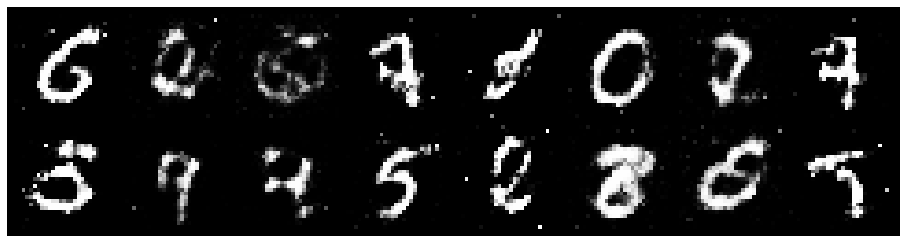

Epoch: [56/200], Batch Num: [200/600]
Discriminator Loss: 1.1942, Generator Loss: 0.9555
D(x): 0.5865, D(G(z)): 0.4252


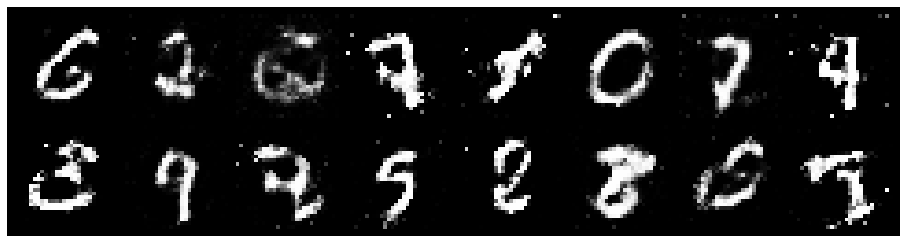

Epoch: [56/200], Batch Num: [300/600]
Discriminator Loss: 1.1669, Generator Loss: 0.8434
D(x): 0.6125, D(G(z)): 0.4313


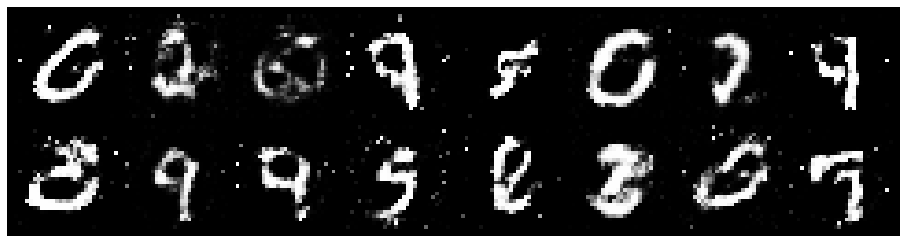

Epoch: [56/200], Batch Num: [400/600]
Discriminator Loss: 1.2152, Generator Loss: 1.0189
D(x): 0.5633, D(G(z)): 0.3922


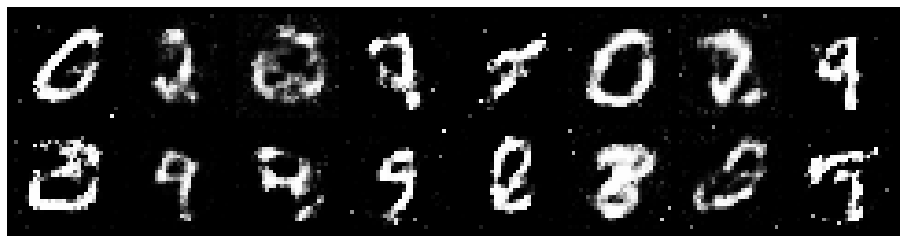

Epoch: [56/200], Batch Num: [500/600]
Discriminator Loss: 1.1517, Generator Loss: 0.9349
D(x): 0.6164, D(G(z)): 0.4210


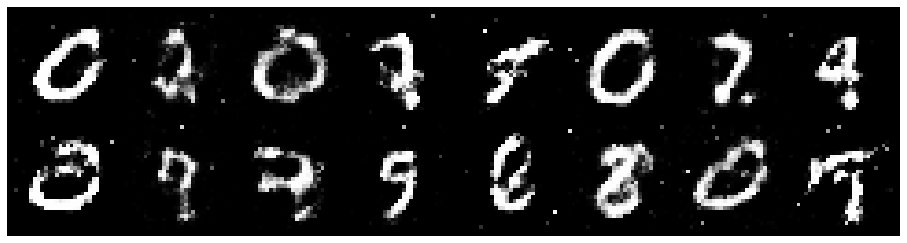

Epoch: [57/200], Batch Num: [0/600]
Discriminator Loss: 1.0441, Generator Loss: 1.0950
D(x): 0.6204, D(G(z)): 0.3705


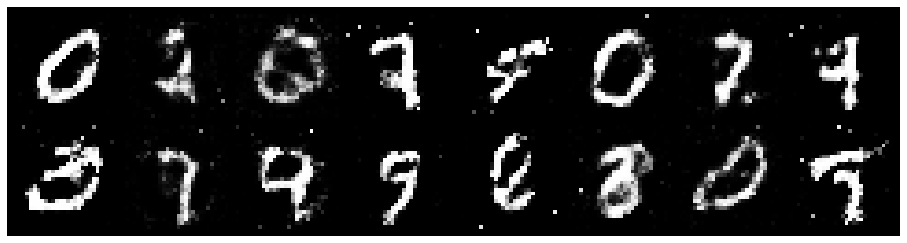

Epoch: [57/200], Batch Num: [100/600]
Discriminator Loss: 1.1027, Generator Loss: 1.0721
D(x): 0.6098, D(G(z)): 0.3973


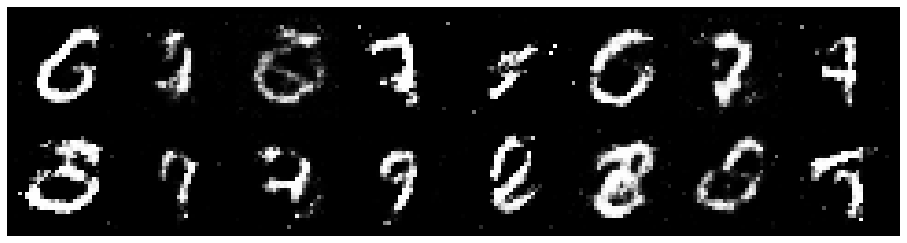

Epoch: [57/200], Batch Num: [200/600]
Discriminator Loss: 1.3371, Generator Loss: 0.8521
D(x): 0.5341, D(G(z)): 0.4523


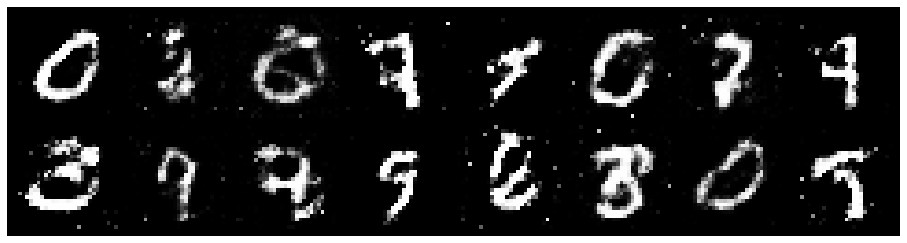

Epoch: [57/200], Batch Num: [300/600]
Discriminator Loss: 1.2433, Generator Loss: 1.1664
D(x): 0.6069, D(G(z)): 0.4319


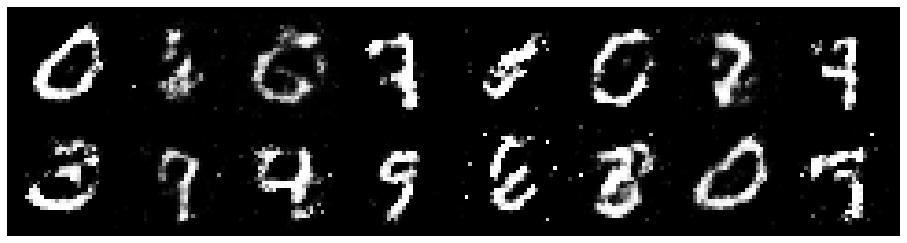

Epoch: [57/200], Batch Num: [400/600]
Discriminator Loss: 1.1525, Generator Loss: 1.1860
D(x): 0.5767, D(G(z)): 0.3777


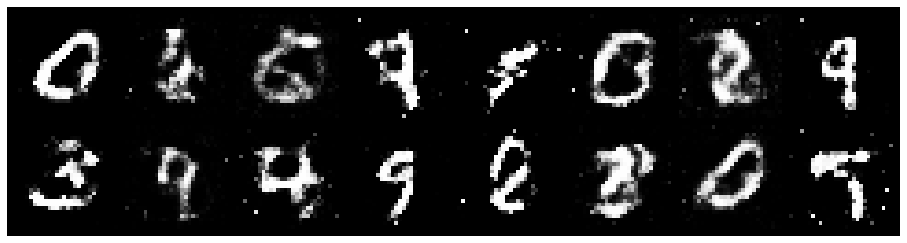

Epoch: [57/200], Batch Num: [500/600]
Discriminator Loss: 1.0888, Generator Loss: 1.2375
D(x): 0.6411, D(G(z)): 0.3876


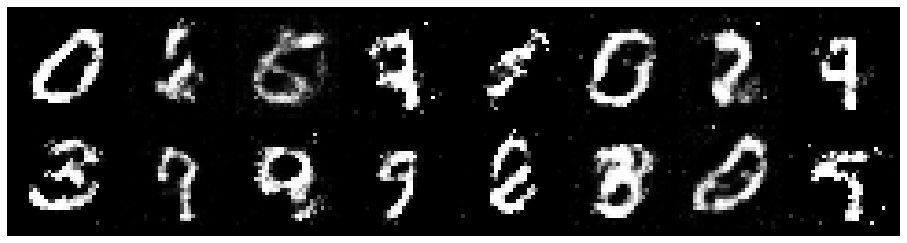

Epoch: [58/200], Batch Num: [0/600]
Discriminator Loss: 1.0770, Generator Loss: 1.1506
D(x): 0.5979, D(G(z)): 0.3665


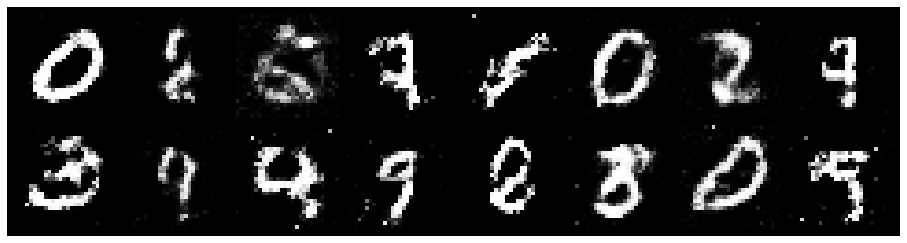

Epoch: [58/200], Batch Num: [100/600]
Discriminator Loss: 1.0649, Generator Loss: 0.9810
D(x): 0.5953, D(G(z)): 0.3662


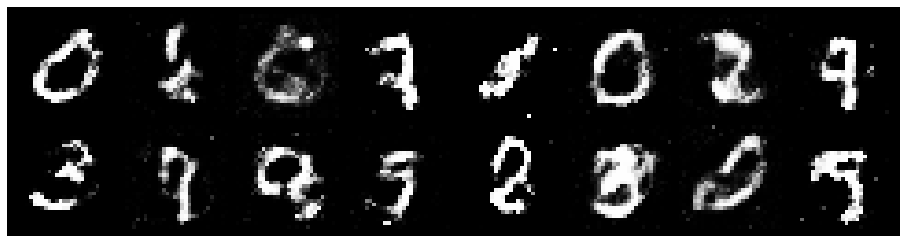

Epoch: [58/200], Batch Num: [200/600]
Discriminator Loss: 1.1229, Generator Loss: 1.0077
D(x): 0.6089, D(G(z)): 0.4000


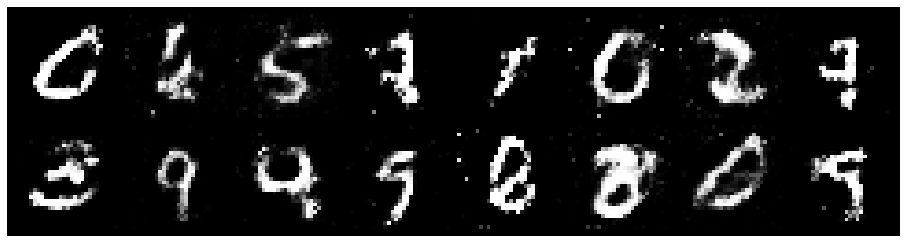

Epoch: [58/200], Batch Num: [300/600]
Discriminator Loss: 1.1920, Generator Loss: 1.0817
D(x): 0.5883, D(G(z)): 0.4154


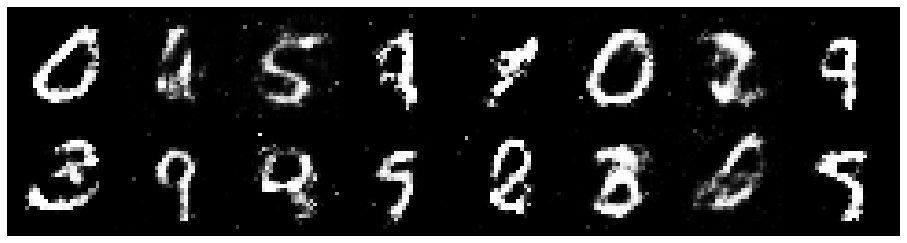

Epoch: [58/200], Batch Num: [400/600]
Discriminator Loss: 1.1793, Generator Loss: 1.0608
D(x): 0.6549, D(G(z)): 0.4455


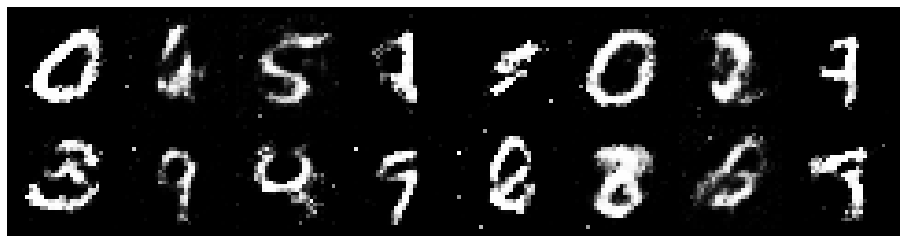

Epoch: [58/200], Batch Num: [500/600]
Discriminator Loss: 1.1811, Generator Loss: 1.1531
D(x): 0.5848, D(G(z)): 0.3951


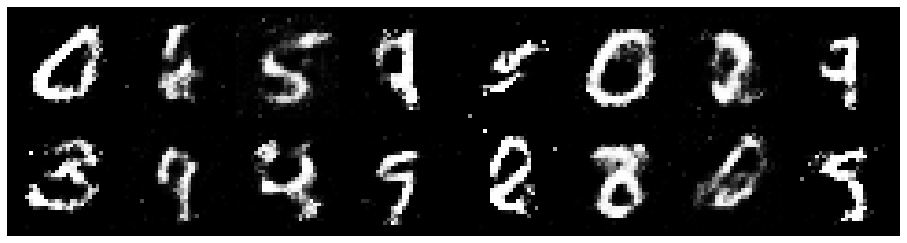

Epoch: [59/200], Batch Num: [0/600]
Discriminator Loss: 1.2670, Generator Loss: 0.9714
D(x): 0.5718, D(G(z)): 0.4503


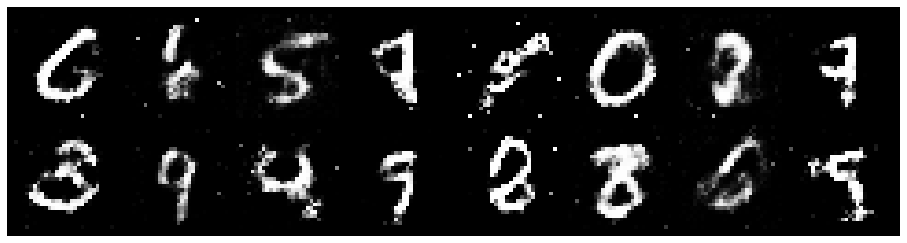

Epoch: [59/200], Batch Num: [100/600]
Discriminator Loss: 1.2954, Generator Loss: 0.9363
D(x): 0.5702, D(G(z)): 0.4563


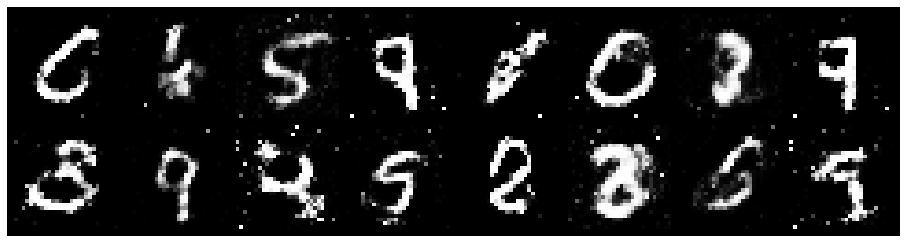

Epoch: [59/200], Batch Num: [200/600]
Discriminator Loss: 1.1643, Generator Loss: 1.0442
D(x): 0.5853, D(G(z)): 0.4107


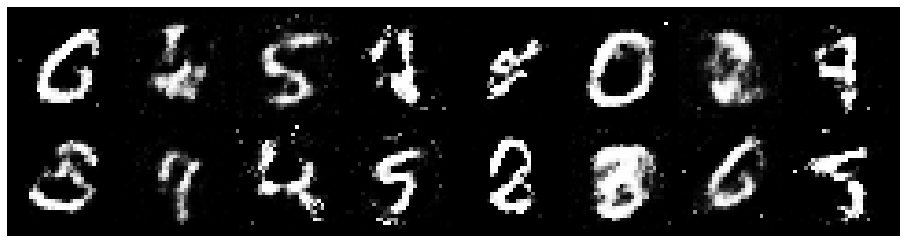

Epoch: [59/200], Batch Num: [300/600]
Discriminator Loss: 1.2787, Generator Loss: 1.0386
D(x): 0.5896, D(G(z)): 0.4431


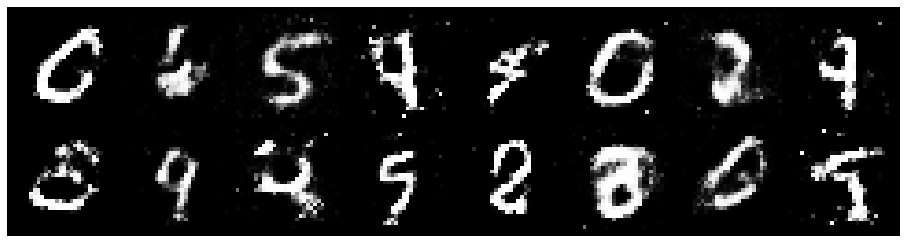

Epoch: [59/200], Batch Num: [400/600]
Discriminator Loss: 1.2937, Generator Loss: 0.9679
D(x): 0.5801, D(G(z)): 0.4358


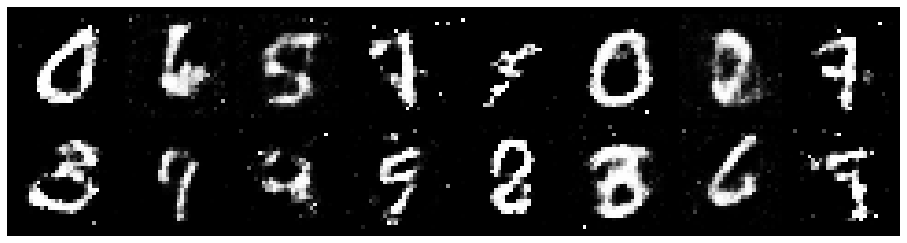

Epoch: [59/200], Batch Num: [500/600]
Discriminator Loss: 1.1512, Generator Loss: 1.1246
D(x): 0.5974, D(G(z)): 0.3747


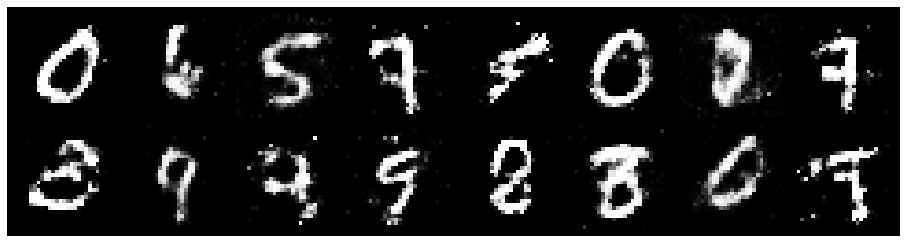

Epoch: [60/200], Batch Num: [0/600]
Discriminator Loss: 1.1169, Generator Loss: 1.0435
D(x): 0.6235, D(G(z)): 0.4150


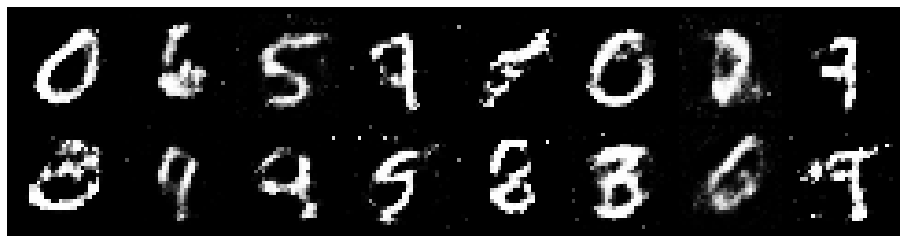

Epoch: [60/200], Batch Num: [100/600]
Discriminator Loss: 1.1068, Generator Loss: 1.0784
D(x): 0.6508, D(G(z)): 0.4045


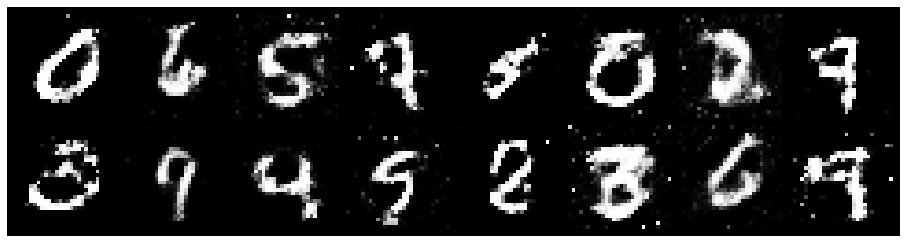

Epoch: [60/200], Batch Num: [200/600]
Discriminator Loss: 1.0799, Generator Loss: 1.1397
D(x): 0.6613, D(G(z)): 0.3934


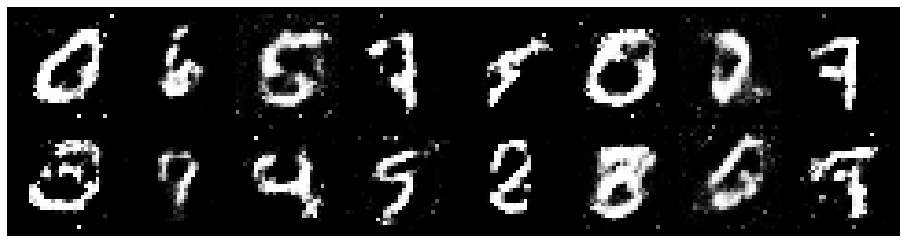

Epoch: [60/200], Batch Num: [300/600]
Discriminator Loss: 1.1791, Generator Loss: 1.0593
D(x): 0.5797, D(G(z)): 0.4029


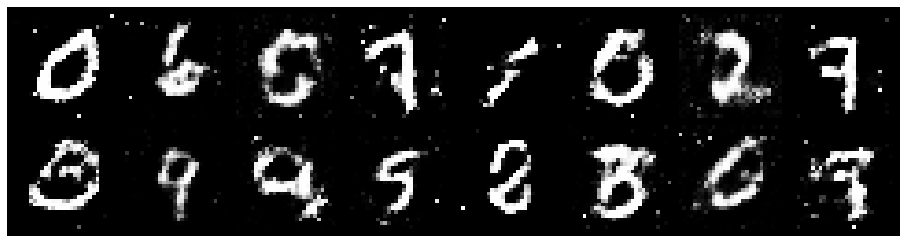

Epoch: [60/200], Batch Num: [400/600]
Discriminator Loss: 1.1318, Generator Loss: 1.1966
D(x): 0.5713, D(G(z)): 0.3246


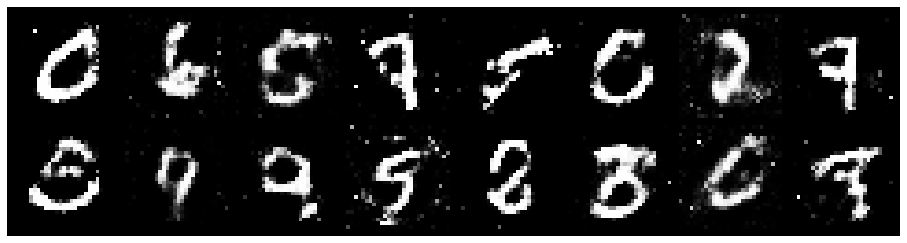

Epoch: [60/200], Batch Num: [500/600]
Discriminator Loss: 1.0798, Generator Loss: 1.2796
D(x): 0.5968, D(G(z)): 0.3662


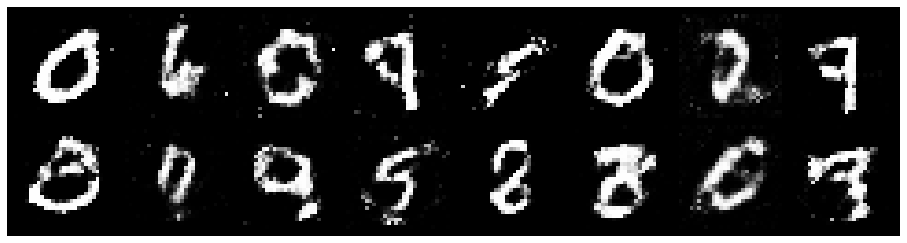

Epoch: [61/200], Batch Num: [0/600]
Discriminator Loss: 1.0726, Generator Loss: 1.1123
D(x): 0.6794, D(G(z)): 0.4191


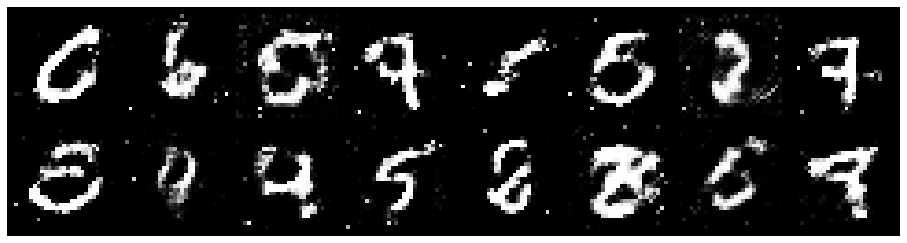

Epoch: [61/200], Batch Num: [100/600]
Discriminator Loss: 1.1616, Generator Loss: 0.9395
D(x): 0.5396, D(G(z)): 0.3795


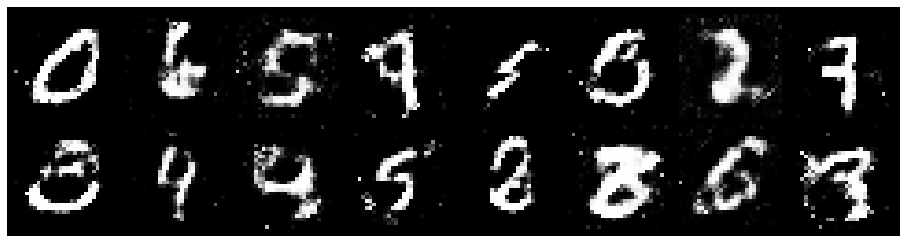

Epoch: [61/200], Batch Num: [200/600]
Discriminator Loss: 1.1980, Generator Loss: 0.8777
D(x): 0.6008, D(G(z)): 0.4410


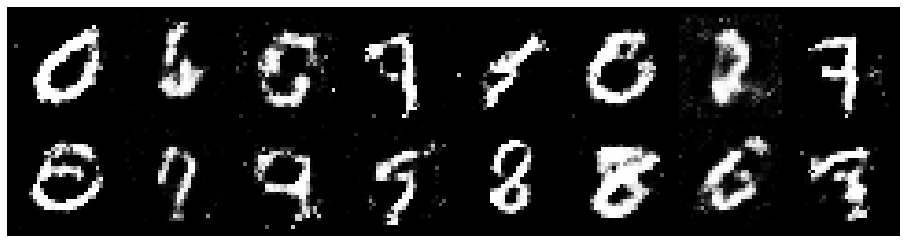

Epoch: [61/200], Batch Num: [300/600]
Discriminator Loss: 1.2127, Generator Loss: 1.0271
D(x): 0.6280, D(G(z)): 0.4331


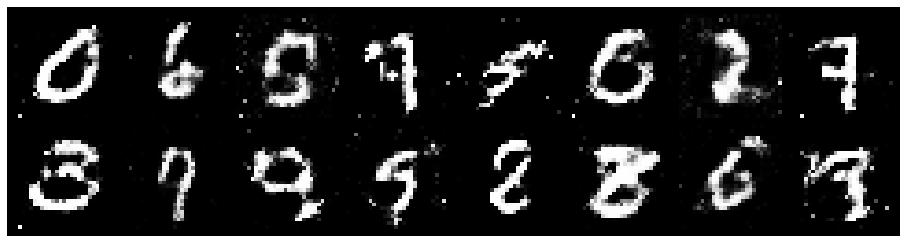

Epoch: [61/200], Batch Num: [400/600]
Discriminator Loss: 1.1114, Generator Loss: 1.0730
D(x): 0.5867, D(G(z)): 0.3825


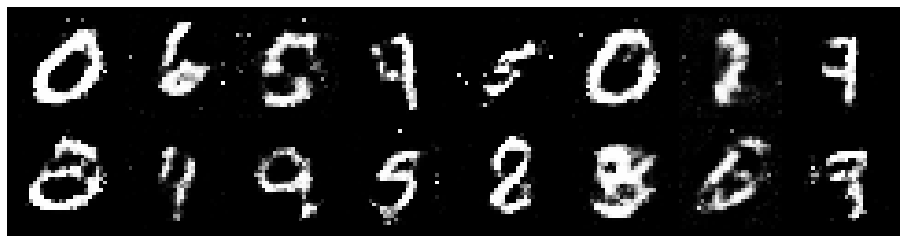

Epoch: [61/200], Batch Num: [500/600]
Discriminator Loss: 1.2416, Generator Loss: 1.0328
D(x): 0.5725, D(G(z)): 0.4241


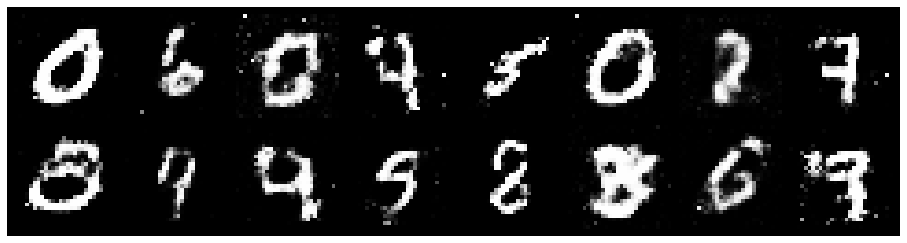

Epoch: [62/200], Batch Num: [0/600]
Discriminator Loss: 1.1404, Generator Loss: 0.9860
D(x): 0.5855, D(G(z)): 0.3797


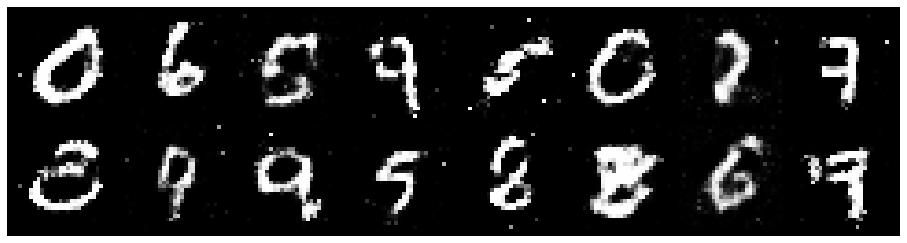

Epoch: [62/200], Batch Num: [100/600]
Discriminator Loss: 1.1015, Generator Loss: 1.1501
D(x): 0.5944, D(G(z)): 0.3819


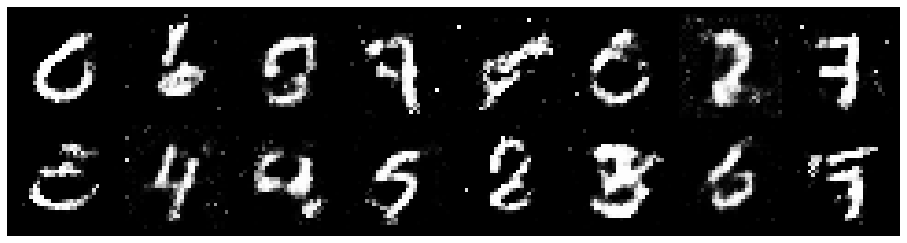

Epoch: [62/200], Batch Num: [200/600]
Discriminator Loss: 1.2139, Generator Loss: 1.1239
D(x): 0.6136, D(G(z)): 0.4372


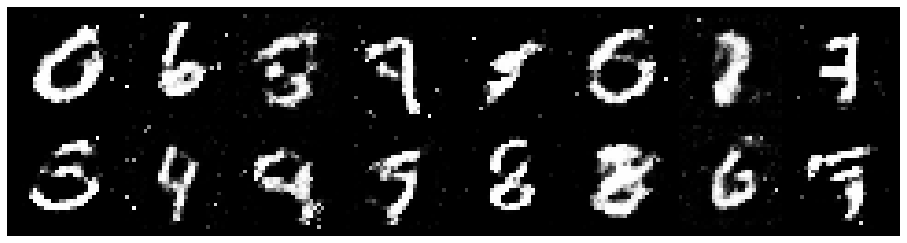

Epoch: [62/200], Batch Num: [300/600]
Discriminator Loss: 1.2314, Generator Loss: 0.9659
D(x): 0.5665, D(G(z)): 0.4209


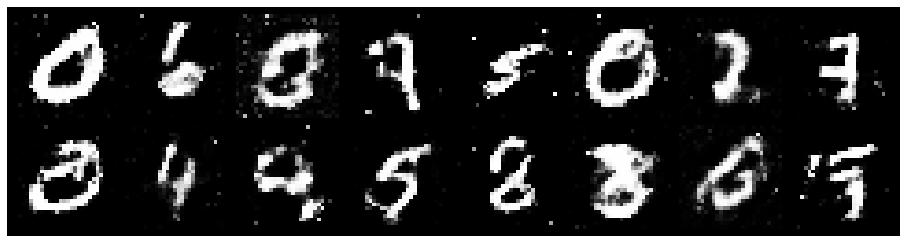

Epoch: [62/200], Batch Num: [400/600]
Discriminator Loss: 1.3090, Generator Loss: 0.8228
D(x): 0.5410, D(G(z)): 0.4248


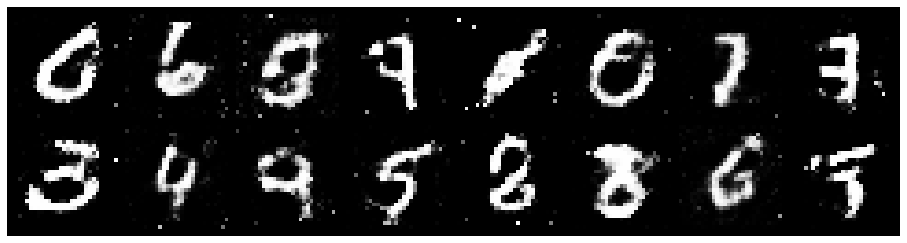

Epoch: [62/200], Batch Num: [500/600]
Discriminator Loss: 1.2445, Generator Loss: 0.9412
D(x): 0.5964, D(G(z)): 0.4427


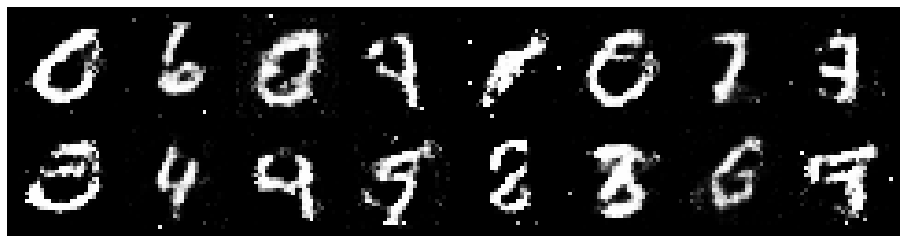

Epoch: [63/200], Batch Num: [0/600]
Discriminator Loss: 1.4043, Generator Loss: 0.8694
D(x): 0.6452, D(G(z)): 0.5355


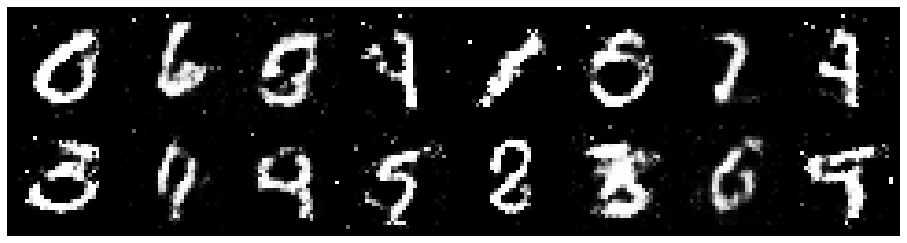

Epoch: [63/200], Batch Num: [100/600]
Discriminator Loss: 1.3433, Generator Loss: 0.9636
D(x): 0.5405, D(G(z)): 0.4404


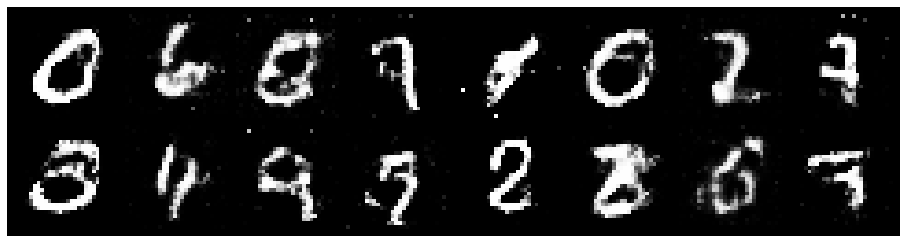

Epoch: [63/200], Batch Num: [200/600]
Discriminator Loss: 1.1633, Generator Loss: 0.9190
D(x): 0.5930, D(G(z)): 0.4137


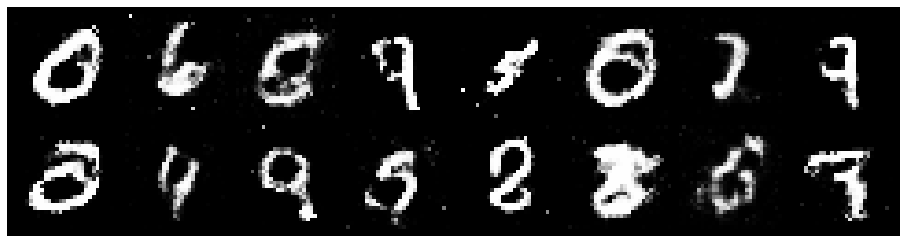

Epoch: [63/200], Batch Num: [300/600]
Discriminator Loss: 1.3532, Generator Loss: 0.9880
D(x): 0.4864, D(G(z)): 0.4024


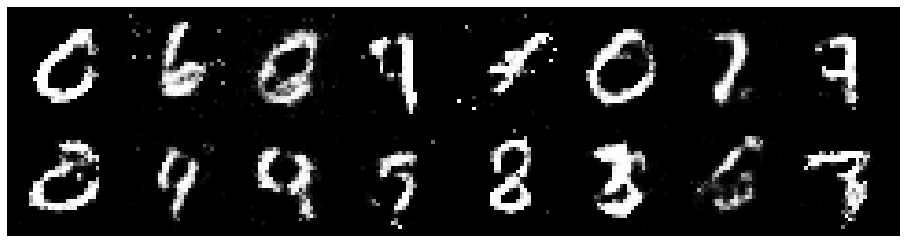

Epoch: [63/200], Batch Num: [400/600]
Discriminator Loss: 1.2291, Generator Loss: 1.0564
D(x): 0.5662, D(G(z)): 0.4092


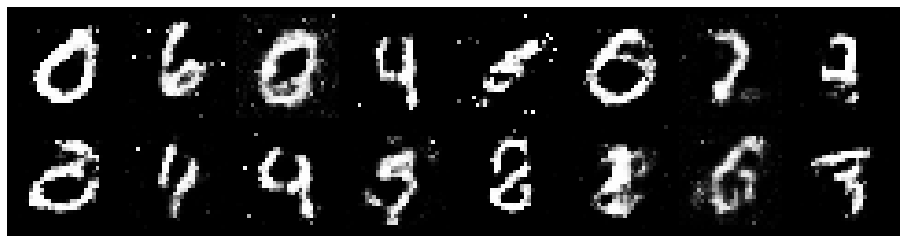

Epoch: [63/200], Batch Num: [500/600]
Discriminator Loss: 1.1747, Generator Loss: 1.0186
D(x): 0.5622, D(G(z)): 0.3868


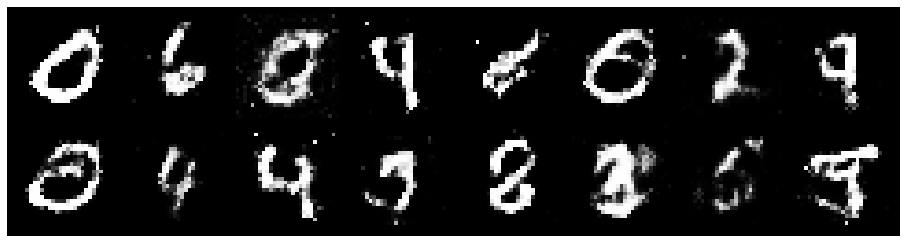

Epoch: [64/200], Batch Num: [0/600]
Discriminator Loss: 1.2330, Generator Loss: 0.9165
D(x): 0.5521, D(G(z)): 0.4173


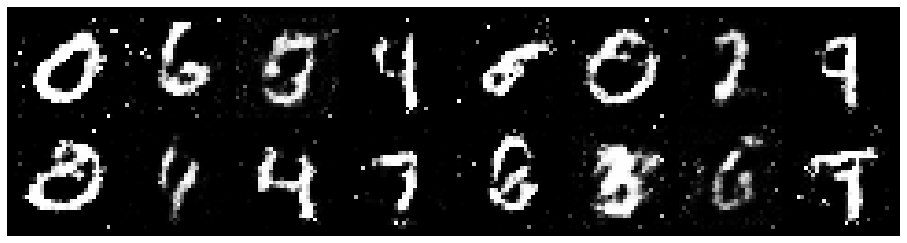

Epoch: [64/200], Batch Num: [100/600]
Discriminator Loss: 1.2873, Generator Loss: 1.0896
D(x): 0.5784, D(G(z)): 0.4262


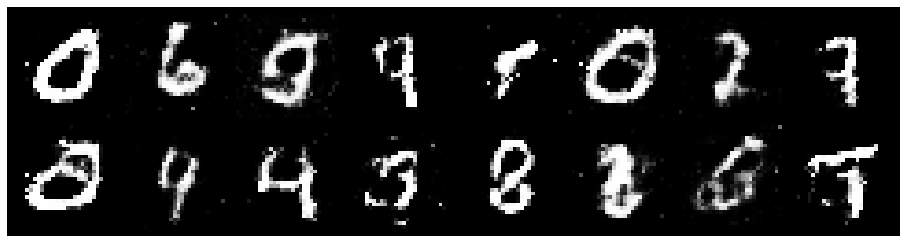

Epoch: [64/200], Batch Num: [200/600]
Discriminator Loss: 1.3518, Generator Loss: 0.9121
D(x): 0.5893, D(G(z)): 0.4693


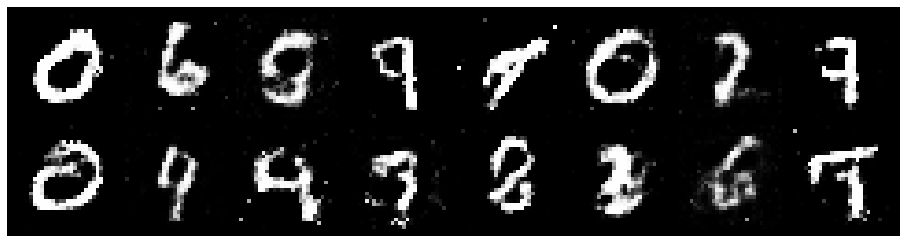

Epoch: [64/200], Batch Num: [300/600]
Discriminator Loss: 1.2161, Generator Loss: 1.2813
D(x): 0.5452, D(G(z)): 0.3360


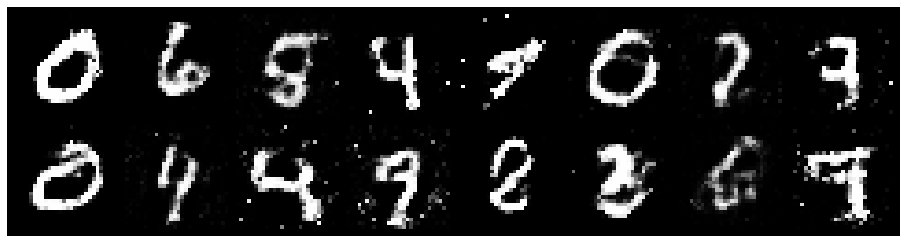

Epoch: [64/200], Batch Num: [400/600]
Discriminator Loss: 1.1715, Generator Loss: 0.9989
D(x): 0.5700, D(G(z)): 0.3811


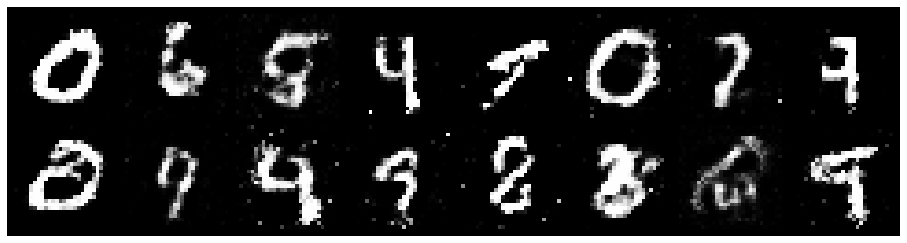

Epoch: [64/200], Batch Num: [500/600]
Discriminator Loss: 1.1216, Generator Loss: 1.0098
D(x): 0.5808, D(G(z)): 0.3782


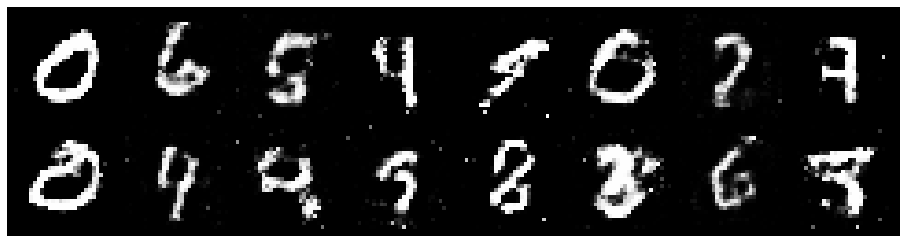

Epoch: [65/200], Batch Num: [0/600]
Discriminator Loss: 1.2904, Generator Loss: 1.0595
D(x): 0.5134, D(G(z)): 0.3584


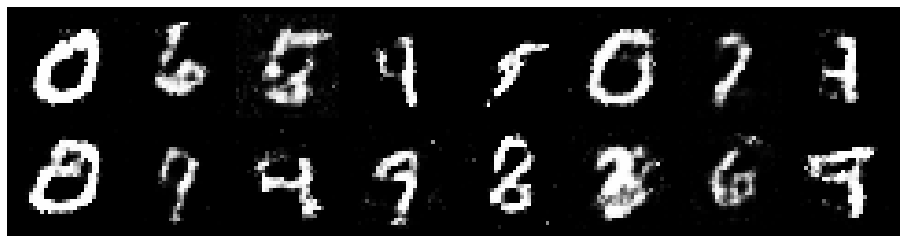

Epoch: [65/200], Batch Num: [100/600]
Discriminator Loss: 1.2386, Generator Loss: 0.9834
D(x): 0.5550, D(G(z)): 0.4346


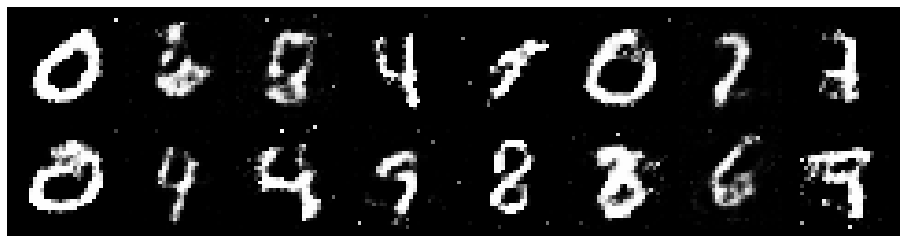

Epoch: [65/200], Batch Num: [200/600]
Discriminator Loss: 1.2691, Generator Loss: 0.8879
D(x): 0.5239, D(G(z)): 0.4289


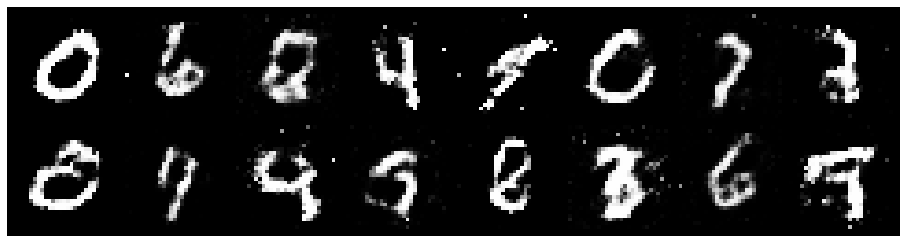

Epoch: [65/200], Batch Num: [300/600]
Discriminator Loss: 1.1557, Generator Loss: 1.0288
D(x): 0.6302, D(G(z)): 0.4192


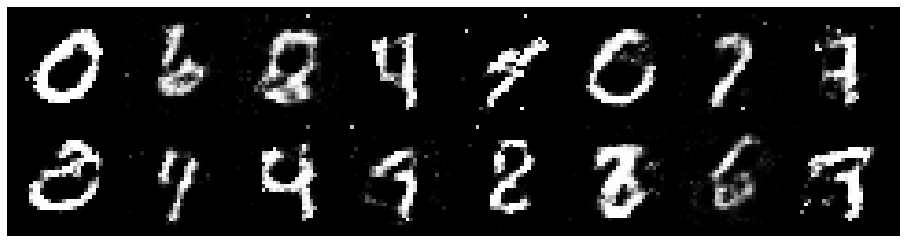

Epoch: [65/200], Batch Num: [400/600]
Discriminator Loss: 1.1610, Generator Loss: 1.2213
D(x): 0.5979, D(G(z)): 0.4043


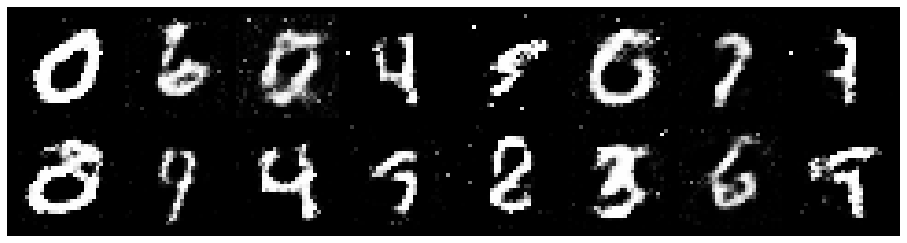

Epoch: [65/200], Batch Num: [500/600]
Discriminator Loss: 1.2872, Generator Loss: 0.8911
D(x): 0.5567, D(G(z)): 0.4508


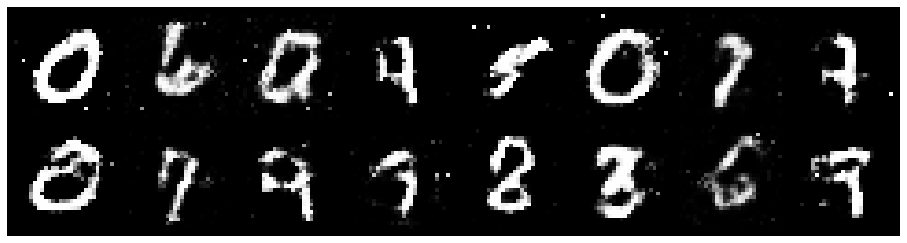

Epoch: [66/200], Batch Num: [0/600]
Discriminator Loss: 1.2902, Generator Loss: 0.9227
D(x): 0.5549, D(G(z)): 0.4327


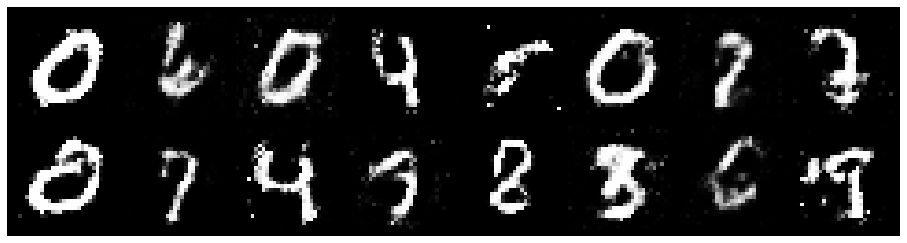

Epoch: [66/200], Batch Num: [100/600]
Discriminator Loss: 1.2748, Generator Loss: 0.8547
D(x): 0.5737, D(G(z)): 0.4577


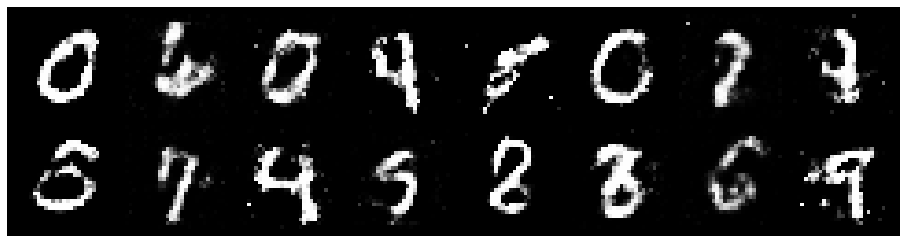

Epoch: [66/200], Batch Num: [200/600]
Discriminator Loss: 1.1354, Generator Loss: 1.0082
D(x): 0.6010, D(G(z)): 0.4011


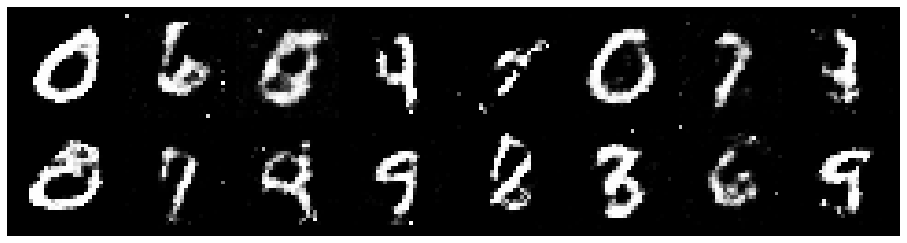

Epoch: [66/200], Batch Num: [300/600]
Discriminator Loss: 1.1867, Generator Loss: 0.8919
D(x): 0.6082, D(G(z)): 0.4446


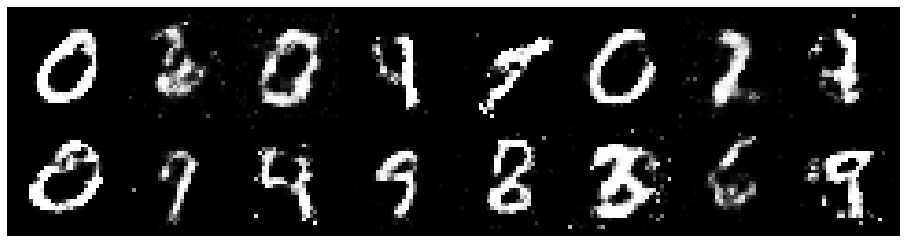

Epoch: [66/200], Batch Num: [400/600]
Discriminator Loss: 1.3867, Generator Loss: 0.9371
D(x): 0.4698, D(G(z)): 0.4072


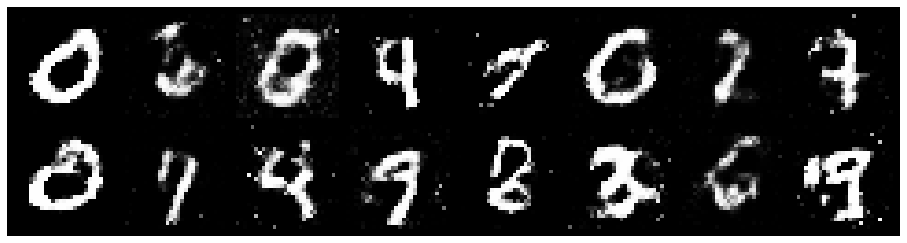

Epoch: [66/200], Batch Num: [500/600]
Discriminator Loss: 1.2139, Generator Loss: 1.1868
D(x): 0.6366, D(G(z)): 0.4485


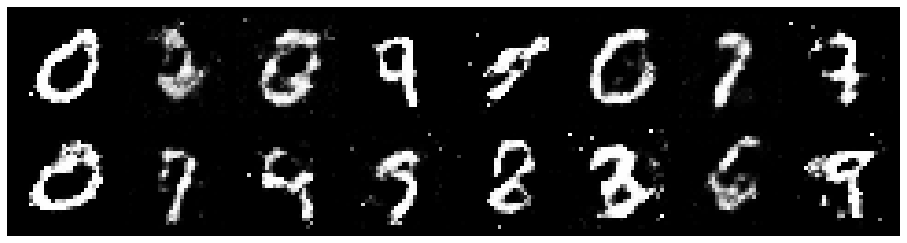

Epoch: [67/200], Batch Num: [0/600]
Discriminator Loss: 1.1550, Generator Loss: 0.9249
D(x): 0.6431, D(G(z)): 0.4260


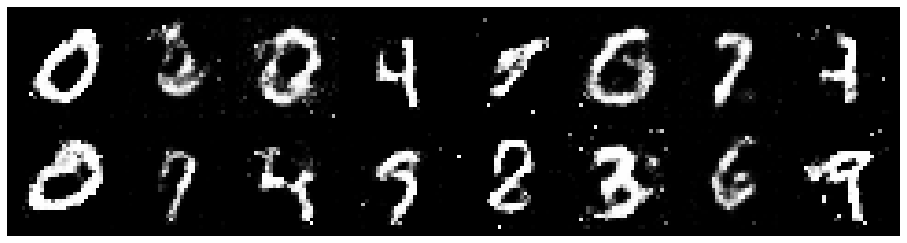

Epoch: [67/200], Batch Num: [100/600]
Discriminator Loss: 1.1963, Generator Loss: 1.1363
D(x): 0.5878, D(G(z)): 0.3978


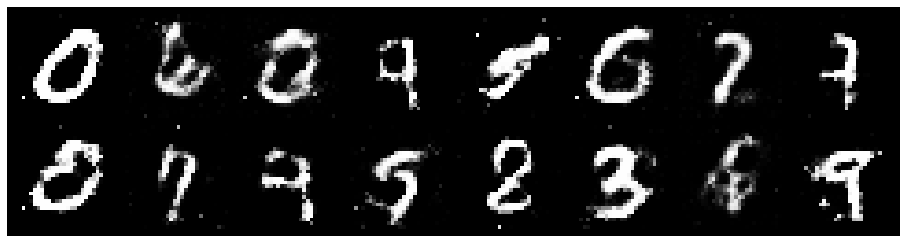

Epoch: [67/200], Batch Num: [200/600]
Discriminator Loss: 1.2790, Generator Loss: 0.8356
D(x): 0.6297, D(G(z)): 0.4894


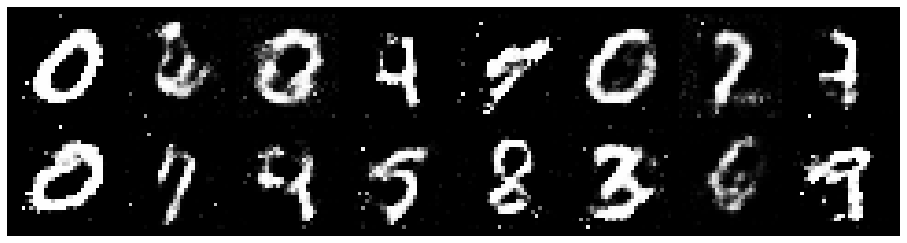

Epoch: [67/200], Batch Num: [300/600]
Discriminator Loss: 1.2151, Generator Loss: 0.9222
D(x): 0.5803, D(G(z)): 0.4117


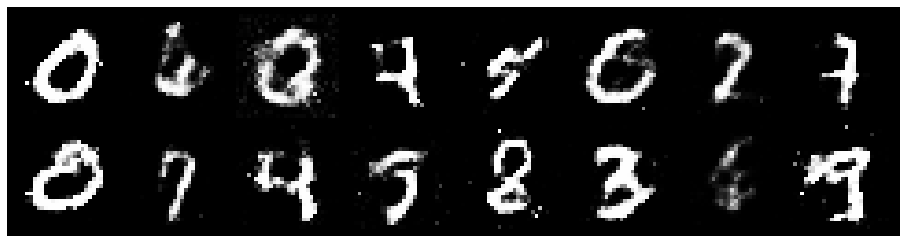

Epoch: [67/200], Batch Num: [400/600]
Discriminator Loss: 1.2433, Generator Loss: 1.0676
D(x): 0.5814, D(G(z)): 0.3887


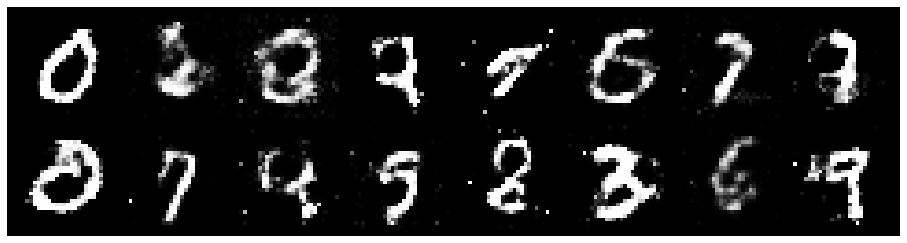

Epoch: [67/200], Batch Num: [500/600]
Discriminator Loss: 1.2804, Generator Loss: 0.8352
D(x): 0.6569, D(G(z)): 0.4871


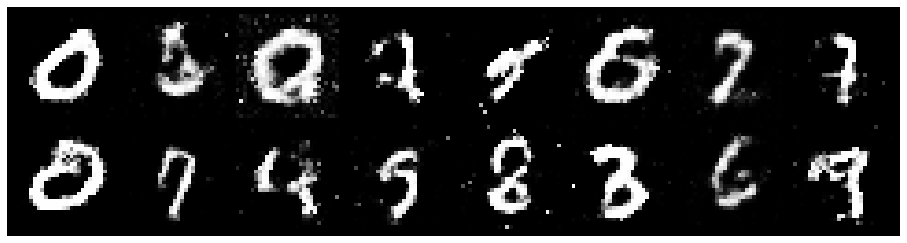

Epoch: [68/200], Batch Num: [0/600]
Discriminator Loss: 1.2436, Generator Loss: 1.0579
D(x): 0.5643, D(G(z)): 0.4032


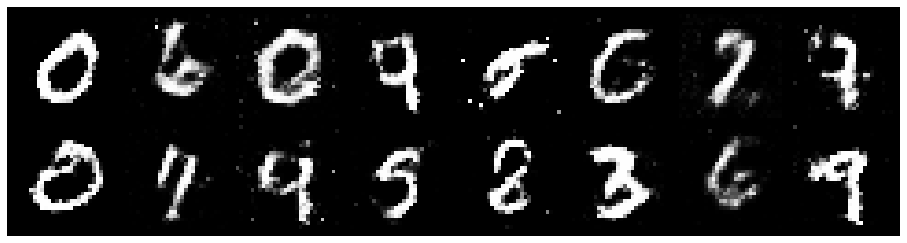

Epoch: [68/200], Batch Num: [100/600]
Discriminator Loss: 1.1837, Generator Loss: 0.8548
D(x): 0.6062, D(G(z)): 0.4384


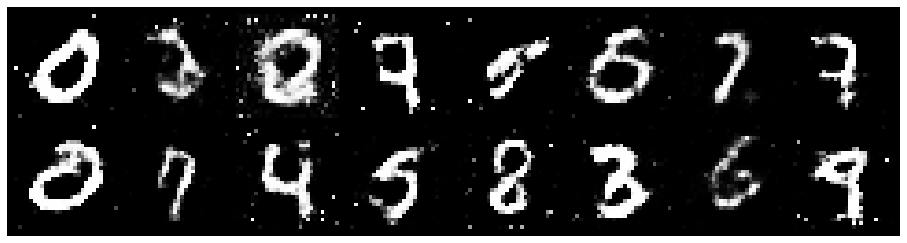

Epoch: [68/200], Batch Num: [200/600]
Discriminator Loss: 1.3337, Generator Loss: 0.9870
D(x): 0.5265, D(G(z)): 0.4220


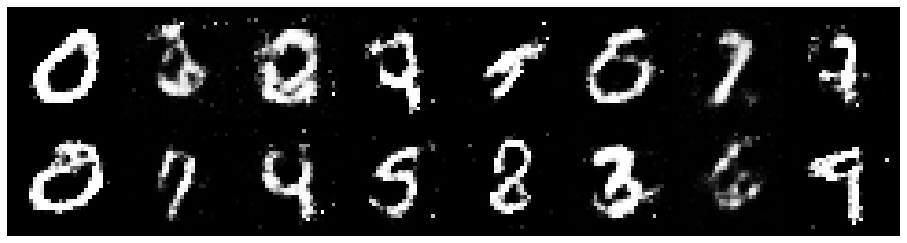

Epoch: [68/200], Batch Num: [300/600]
Discriminator Loss: 1.2198, Generator Loss: 0.9931
D(x): 0.5656, D(G(z)): 0.3961


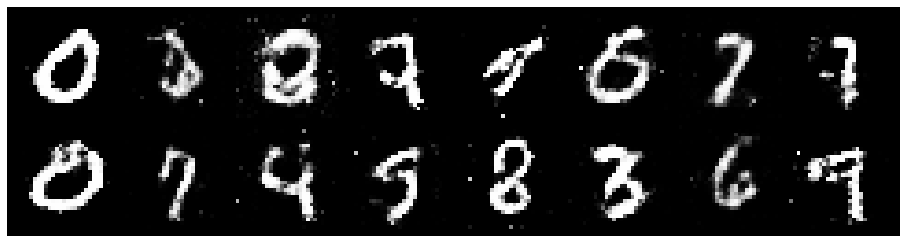

Epoch: [68/200], Batch Num: [400/600]
Discriminator Loss: 1.2590, Generator Loss: 1.0251
D(x): 0.5503, D(G(z)): 0.4037


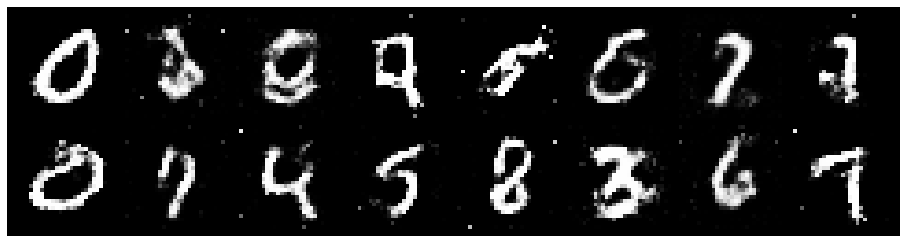

Epoch: [68/200], Batch Num: [500/600]
Discriminator Loss: 1.3262, Generator Loss: 0.9928
D(x): 0.5666, D(G(z)): 0.4613


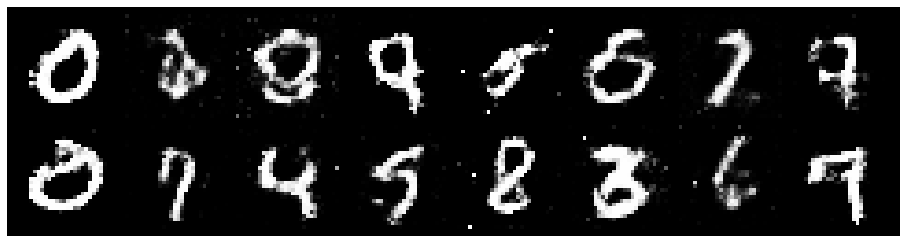

Epoch: [69/200], Batch Num: [0/600]
Discriminator Loss: 1.3597, Generator Loss: 0.8658
D(x): 0.5309, D(G(z)): 0.4476


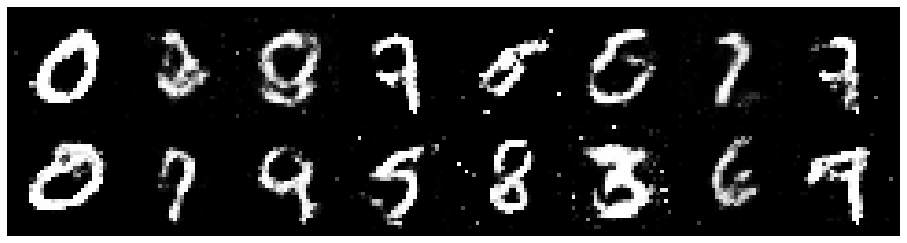

Epoch: [69/200], Batch Num: [100/600]
Discriminator Loss: 1.2258, Generator Loss: 1.1508
D(x): 0.5512, D(G(z)): 0.4051


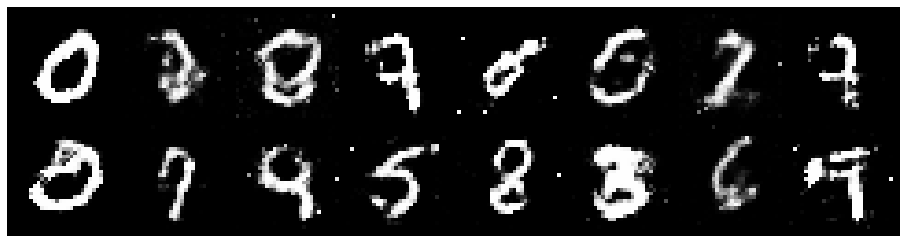

Epoch: [69/200], Batch Num: [200/600]
Discriminator Loss: 1.2970, Generator Loss: 1.0621
D(x): 0.5714, D(G(z)): 0.4340


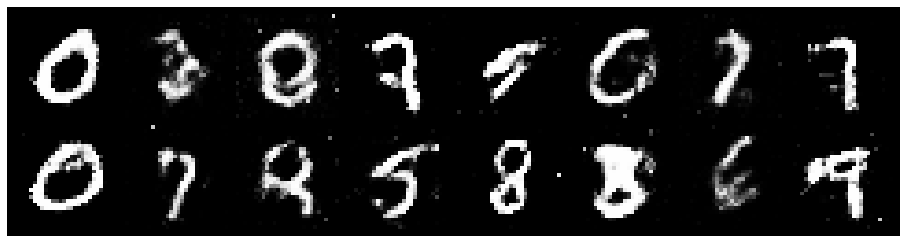

Epoch: [69/200], Batch Num: [300/600]
Discriminator Loss: 1.3217, Generator Loss: 1.0658
D(x): 0.5685, D(G(z)): 0.4556


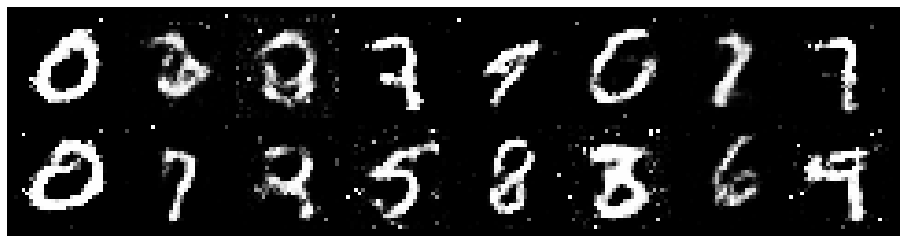

Epoch: [69/200], Batch Num: [400/600]
Discriminator Loss: 1.3289, Generator Loss: 0.9247
D(x): 0.5156, D(G(z)): 0.4348


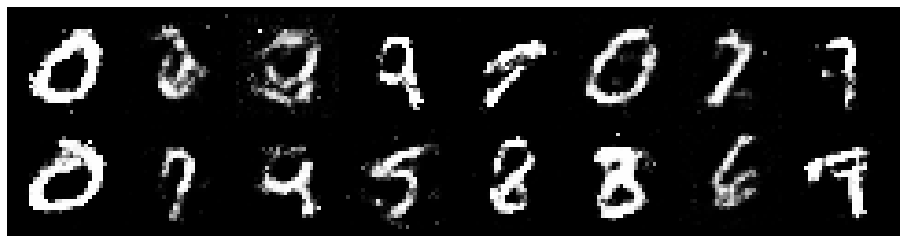

Epoch: [69/200], Batch Num: [500/600]
Discriminator Loss: 1.2879, Generator Loss: 0.9271
D(x): 0.5383, D(G(z)): 0.4289


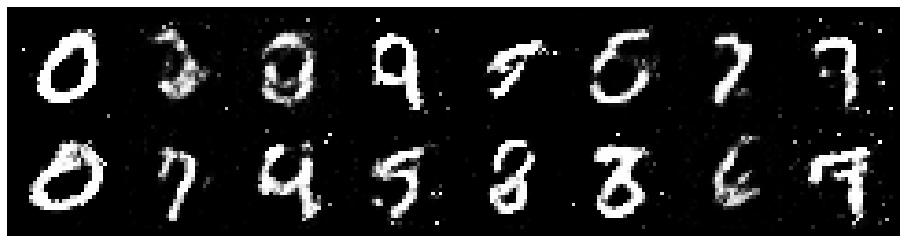

Epoch: [70/200], Batch Num: [0/600]
Discriminator Loss: 1.0159, Generator Loss: 1.2649
D(x): 0.6303, D(G(z)): 0.3234


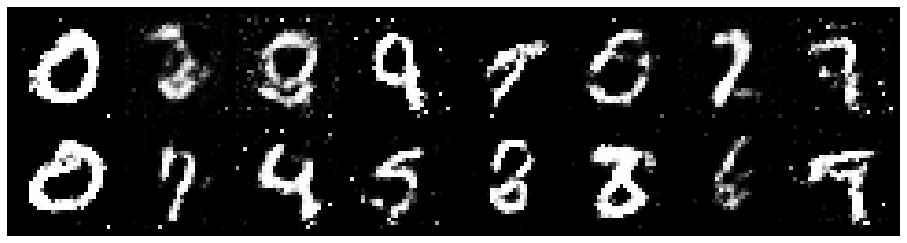

Epoch: [70/200], Batch Num: [100/600]
Discriminator Loss: 1.0435, Generator Loss: 1.0483
D(x): 0.6380, D(G(z)): 0.3943


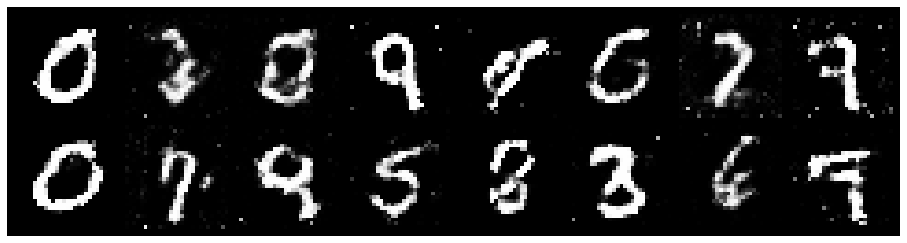

Epoch: [70/200], Batch Num: [200/600]
Discriminator Loss: 1.1784, Generator Loss: 1.0231
D(x): 0.5703, D(G(z)): 0.3912


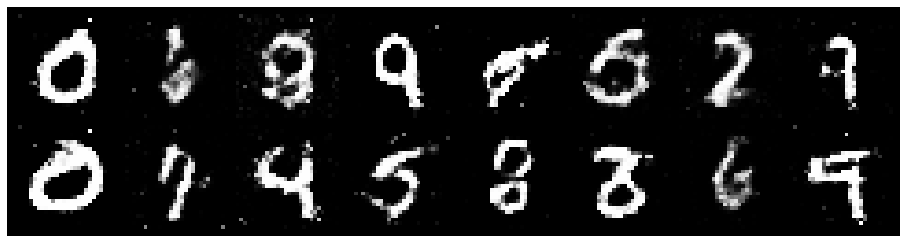

Epoch: [70/200], Batch Num: [300/600]
Discriminator Loss: 1.1822, Generator Loss: 1.0613
D(x): 0.6066, D(G(z)): 0.4137


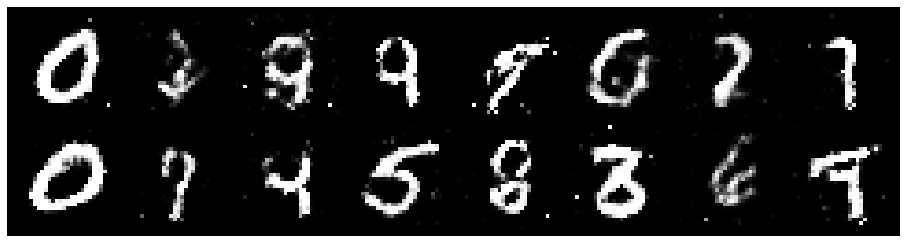

Epoch: [70/200], Batch Num: [400/600]
Discriminator Loss: 1.1700, Generator Loss: 1.0910
D(x): 0.5787, D(G(z)): 0.3984


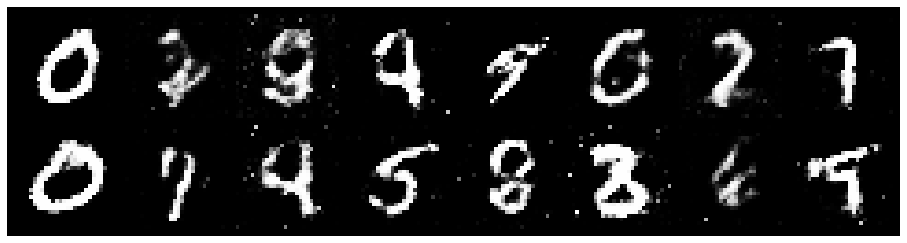

Epoch: [70/200], Batch Num: [500/600]
Discriminator Loss: 1.4379, Generator Loss: 1.0276
D(x): 0.4817, D(G(z)): 0.4395


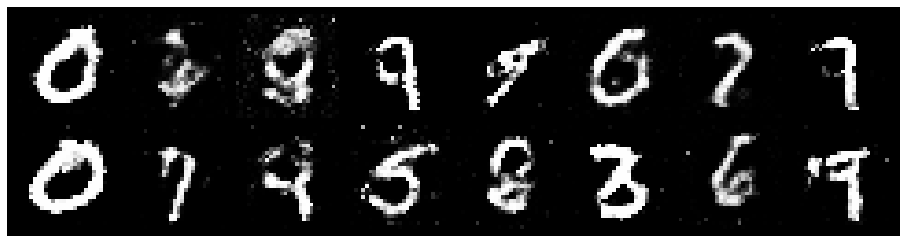

Epoch: [71/200], Batch Num: [0/600]
Discriminator Loss: 1.3013, Generator Loss: 0.8715
D(x): 0.5251, D(G(z)): 0.4122


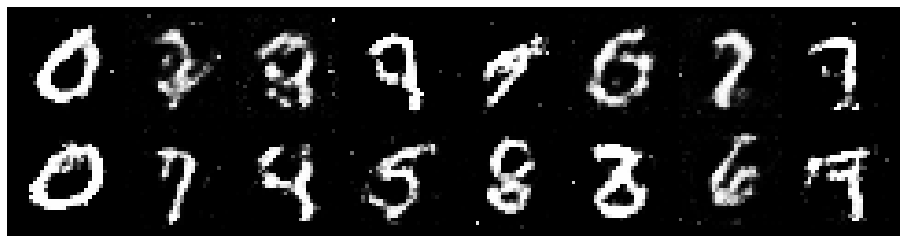

Epoch: [71/200], Batch Num: [100/600]
Discriminator Loss: 1.2301, Generator Loss: 0.9554
D(x): 0.5709, D(G(z)): 0.4359


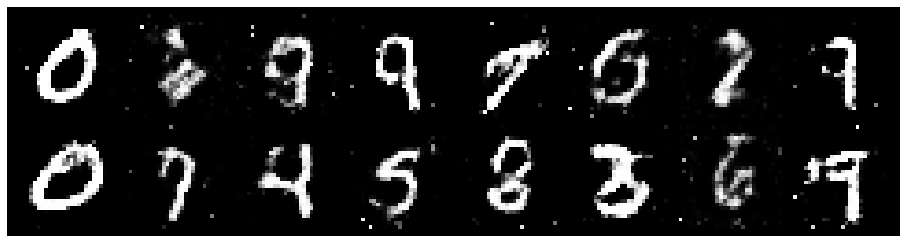

Epoch: [71/200], Batch Num: [200/600]
Discriminator Loss: 1.0706, Generator Loss: 1.0752
D(x): 0.6157, D(G(z)): 0.3906


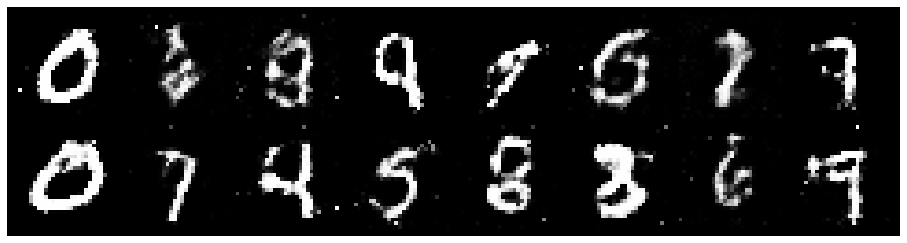

Epoch: [71/200], Batch Num: [300/600]
Discriminator Loss: 1.2102, Generator Loss: 1.0850
D(x): 0.5606, D(G(z)): 0.4075


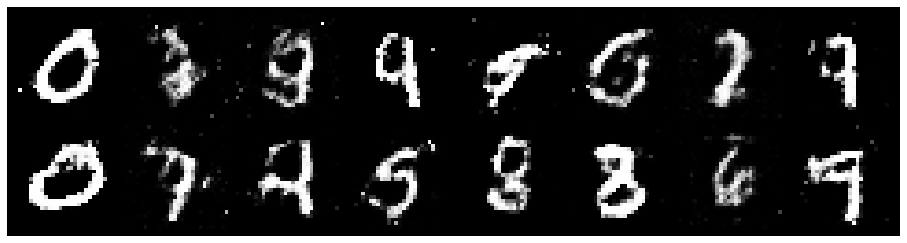

Epoch: [71/200], Batch Num: [400/600]
Discriminator Loss: 1.0928, Generator Loss: 1.0800
D(x): 0.6035, D(G(z)): 0.3886


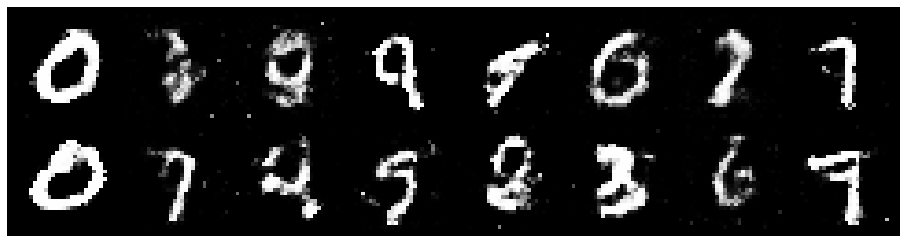

Epoch: [71/200], Batch Num: [500/600]
Discriminator Loss: 1.1798, Generator Loss: 0.9958
D(x): 0.6009, D(G(z)): 0.4338


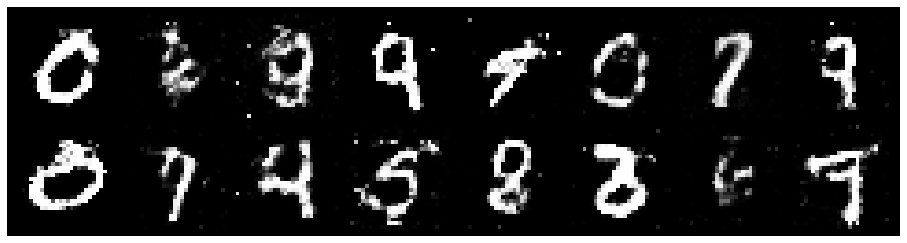

Epoch: [72/200], Batch Num: [0/600]
Discriminator Loss: 1.3102, Generator Loss: 0.8783
D(x): 0.5231, D(G(z)): 0.4466


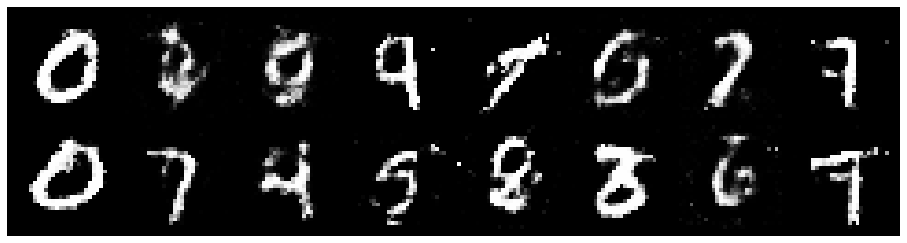

Epoch: [72/200], Batch Num: [100/600]
Discriminator Loss: 1.1361, Generator Loss: 0.9774
D(x): 0.6210, D(G(z)): 0.4068


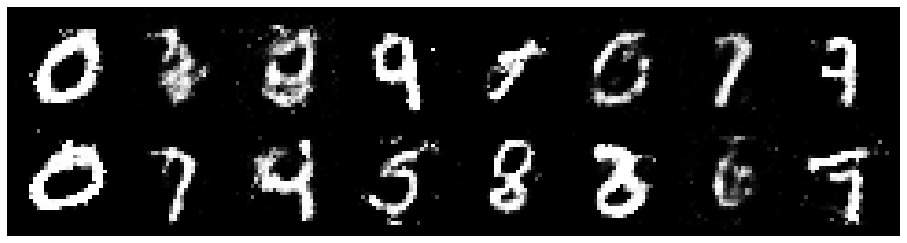

Epoch: [72/200], Batch Num: [200/600]
Discriminator Loss: 1.1000, Generator Loss: 1.0706
D(x): 0.6277, D(G(z)): 0.3998


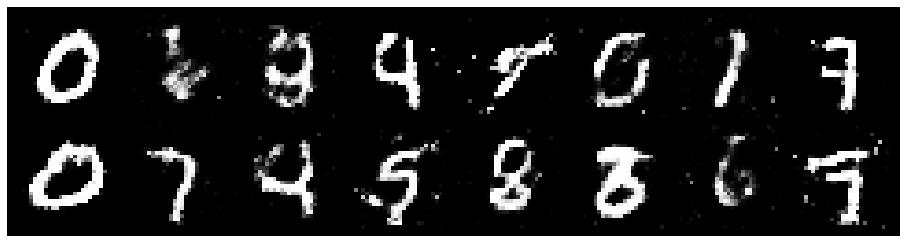

Epoch: [72/200], Batch Num: [300/600]
Discriminator Loss: 1.2164, Generator Loss: 0.8629
D(x): 0.5532, D(G(z)): 0.4218


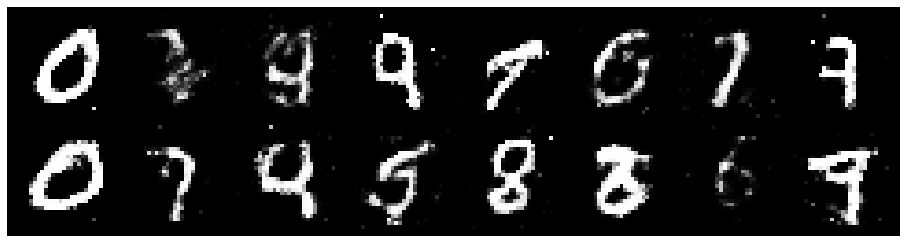

Epoch: [72/200], Batch Num: [400/600]
Discriminator Loss: 1.3118, Generator Loss: 0.9608
D(x): 0.5126, D(G(z)): 0.4062


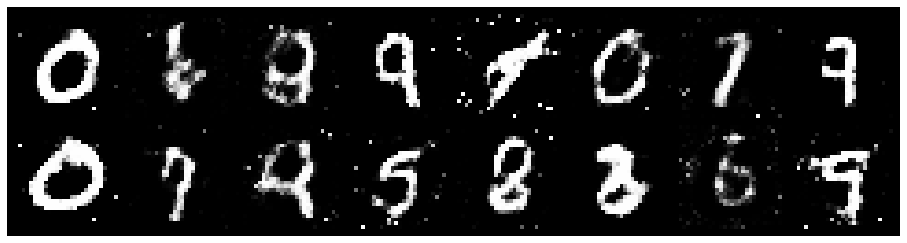

Epoch: [72/200], Batch Num: [500/600]
Discriminator Loss: 1.3868, Generator Loss: 0.9572
D(x): 0.5976, D(G(z)): 0.5004


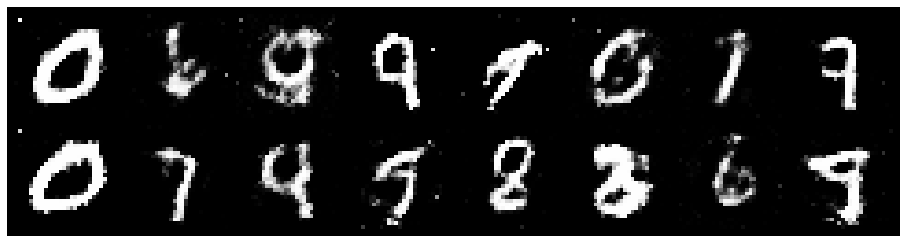

Epoch: [73/200], Batch Num: [0/600]
Discriminator Loss: 1.1449, Generator Loss: 0.9617
D(x): 0.6149, D(G(z)): 0.4003


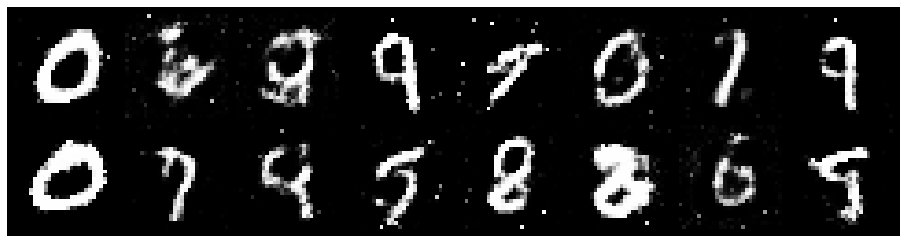

Epoch: [73/200], Batch Num: [100/600]
Discriminator Loss: 1.2588, Generator Loss: 1.0362
D(x): 0.5504, D(G(z)): 0.4071


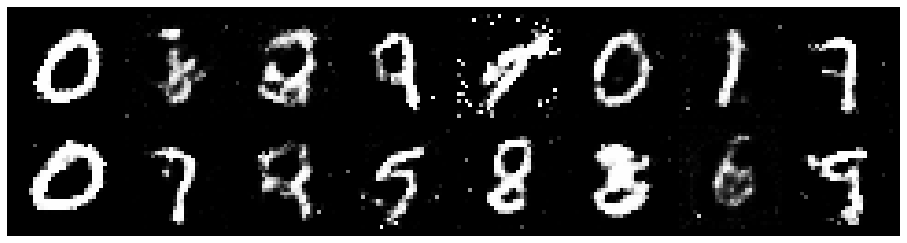

Epoch: [73/200], Batch Num: [200/600]
Discriminator Loss: 1.1967, Generator Loss: 1.1181
D(x): 0.5753, D(G(z)): 0.3966


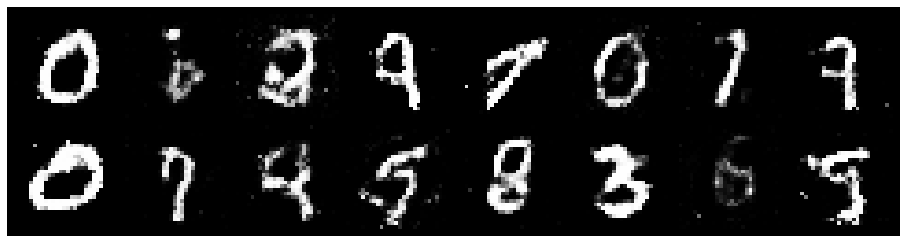

Epoch: [73/200], Batch Num: [300/600]
Discriminator Loss: 1.1369, Generator Loss: 1.1151
D(x): 0.5922, D(G(z)): 0.3894


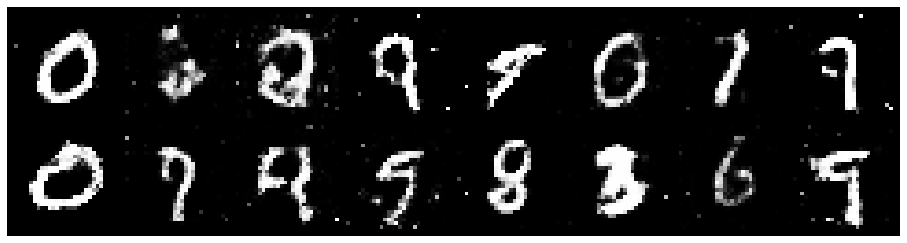

Epoch: [73/200], Batch Num: [400/600]
Discriminator Loss: 1.0712, Generator Loss: 0.9894
D(x): 0.6242, D(G(z)): 0.3931


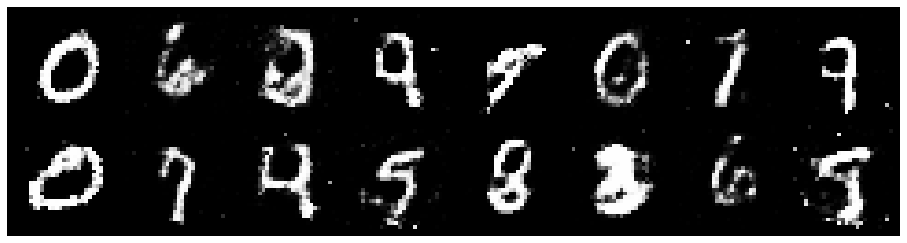

Epoch: [73/200], Batch Num: [500/600]
Discriminator Loss: 1.2722, Generator Loss: 0.6910
D(x): 0.5973, D(G(z)): 0.4783


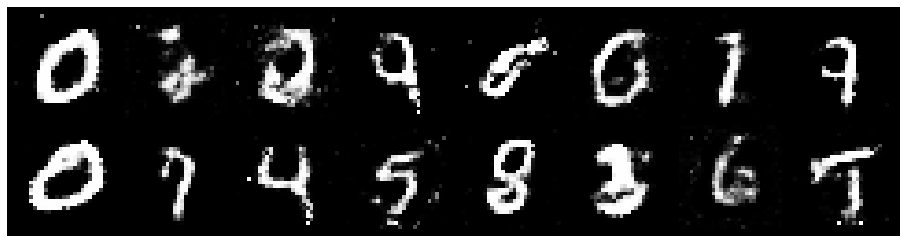

Epoch: [74/200], Batch Num: [0/600]
Discriminator Loss: 1.2363, Generator Loss: 0.8982
D(x): 0.6163, D(G(z)): 0.4591


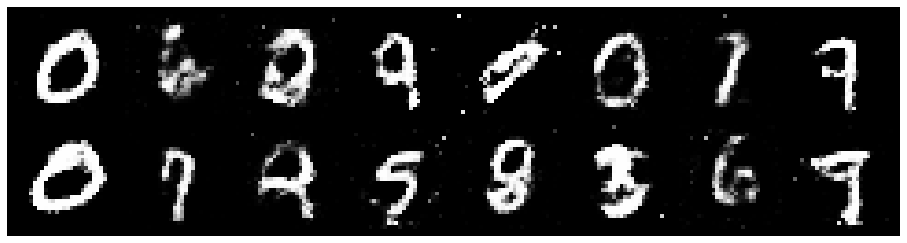

Epoch: [74/200], Batch Num: [100/600]
Discriminator Loss: 1.2682, Generator Loss: 0.9360
D(x): 0.5846, D(G(z)): 0.4595


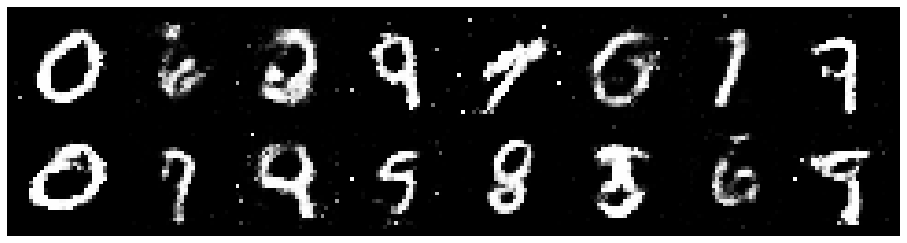

Epoch: [74/200], Batch Num: [200/600]
Discriminator Loss: 1.3142, Generator Loss: 0.9063
D(x): 0.5848, D(G(z)): 0.4867


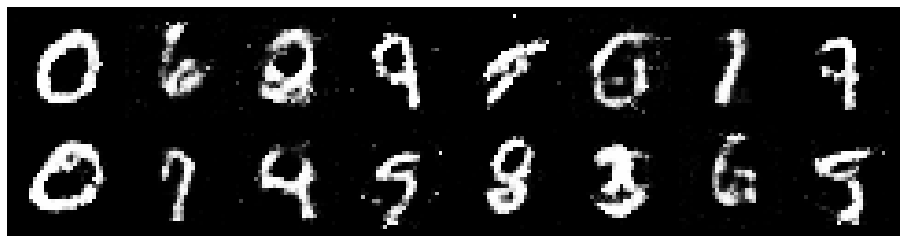

Epoch: [74/200], Batch Num: [300/600]
Discriminator Loss: 1.3119, Generator Loss: 0.9502
D(x): 0.5570, D(G(z)): 0.4423


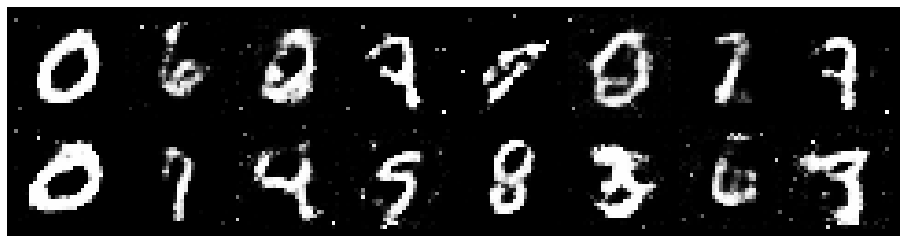

Epoch: [74/200], Batch Num: [400/600]
Discriminator Loss: 1.2209, Generator Loss: 0.9053
D(x): 0.5445, D(G(z)): 0.4050


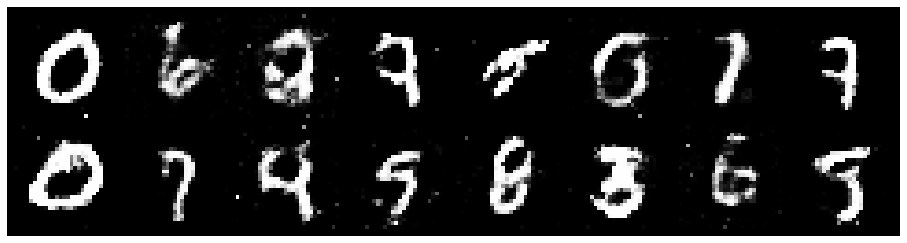

Epoch: [74/200], Batch Num: [500/600]
Discriminator Loss: 1.3117, Generator Loss: 1.2004
D(x): 0.6082, D(G(z)): 0.4558


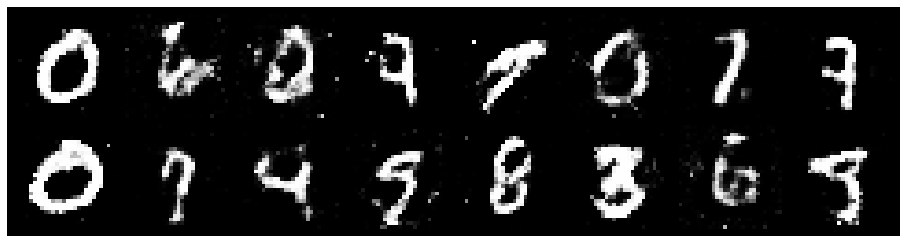

Epoch: [75/200], Batch Num: [0/600]
Discriminator Loss: 1.3225, Generator Loss: 1.0934
D(x): 0.5571, D(G(z)): 0.4183


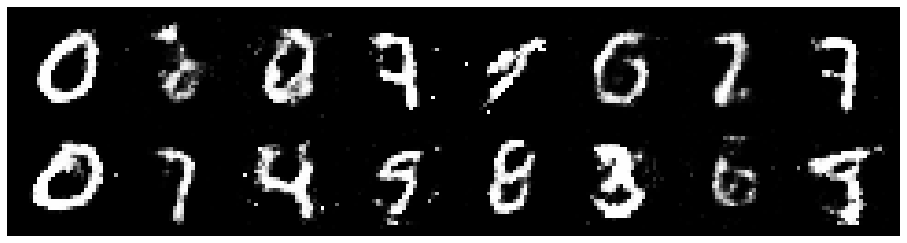

Epoch: [75/200], Batch Num: [100/600]
Discriminator Loss: 1.2363, Generator Loss: 1.0822
D(x): 0.5632, D(G(z)): 0.3906


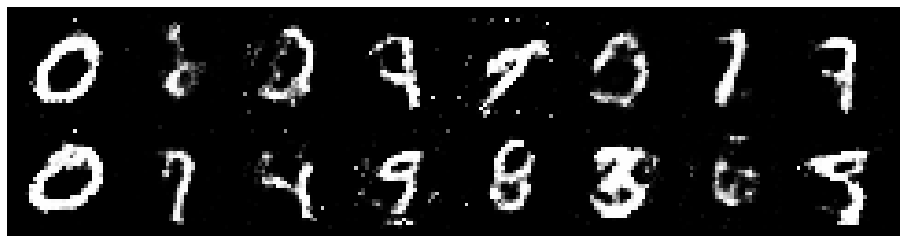

Epoch: [75/200], Batch Num: [200/600]
Discriminator Loss: 1.1592, Generator Loss: 1.0756
D(x): 0.5854, D(G(z)): 0.3928


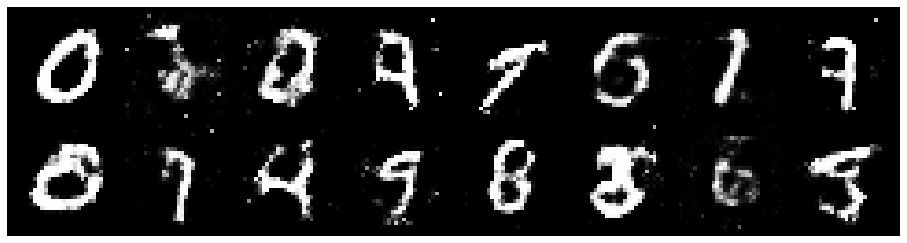

Epoch: [75/200], Batch Num: [300/600]
Discriminator Loss: 1.1346, Generator Loss: 1.1525
D(x): 0.6347, D(G(z)): 0.4169


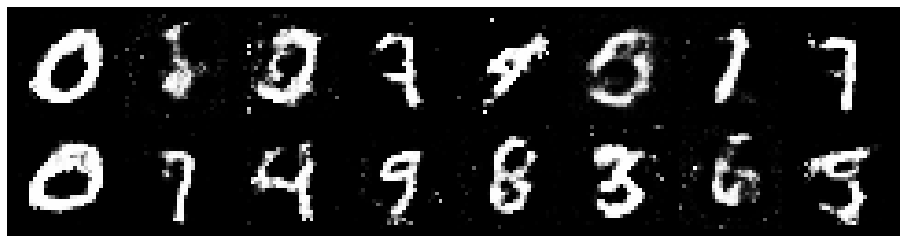

Epoch: [75/200], Batch Num: [400/600]
Discriminator Loss: 1.1130, Generator Loss: 0.9021
D(x): 0.6048, D(G(z)): 0.3978


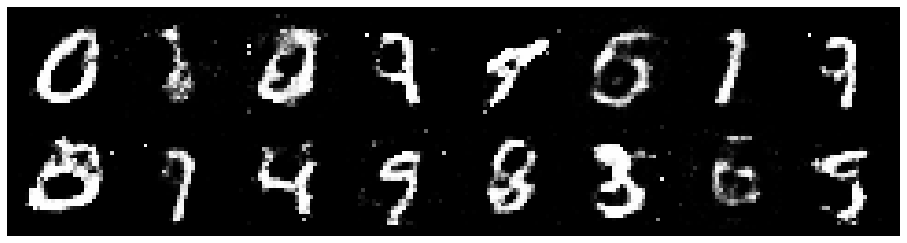

Epoch: [75/200], Batch Num: [500/600]
Discriminator Loss: 1.1145, Generator Loss: 0.8436
D(x): 0.6129, D(G(z)): 0.4301


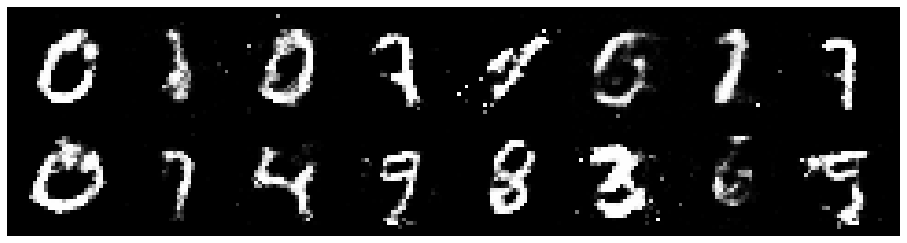

Epoch: [76/200], Batch Num: [0/600]
Discriminator Loss: 1.2339, Generator Loss: 0.9828
D(x): 0.5414, D(G(z)): 0.4080


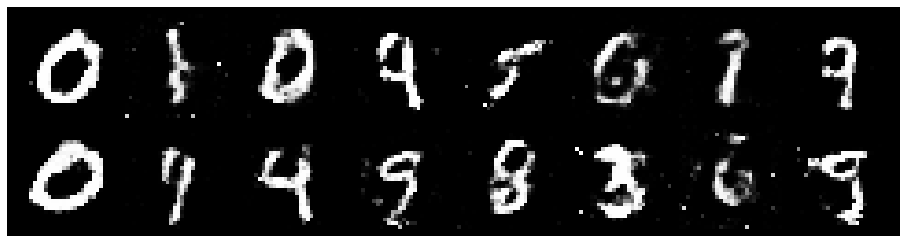

Epoch: [76/200], Batch Num: [100/600]
Discriminator Loss: 1.2298, Generator Loss: 0.9230
D(x): 0.5931, D(G(z)): 0.4553


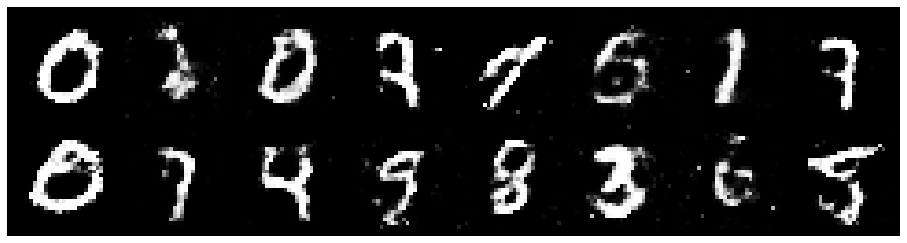

Epoch: [76/200], Batch Num: [200/600]
Discriminator Loss: 1.2363, Generator Loss: 0.9861
D(x): 0.5802, D(G(z)): 0.4116


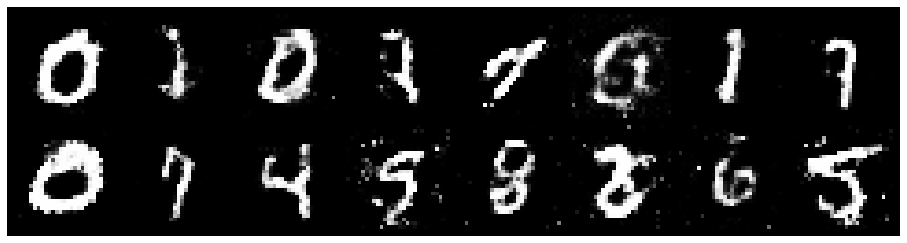

Epoch: [76/200], Batch Num: [300/600]
Discriminator Loss: 1.1813, Generator Loss: 0.9675
D(x): 0.5823, D(G(z)): 0.3988


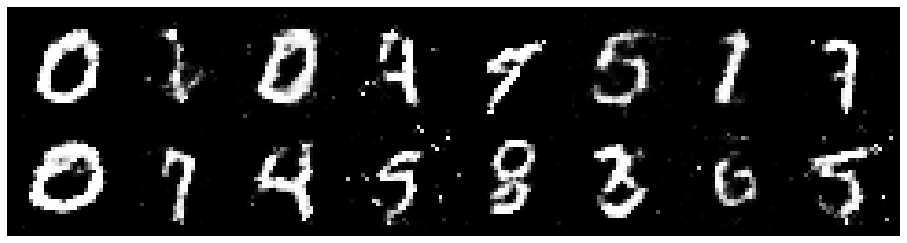

Epoch: [76/200], Batch Num: [400/600]
Discriminator Loss: 1.3100, Generator Loss: 0.9382
D(x): 0.5964, D(G(z)): 0.4642


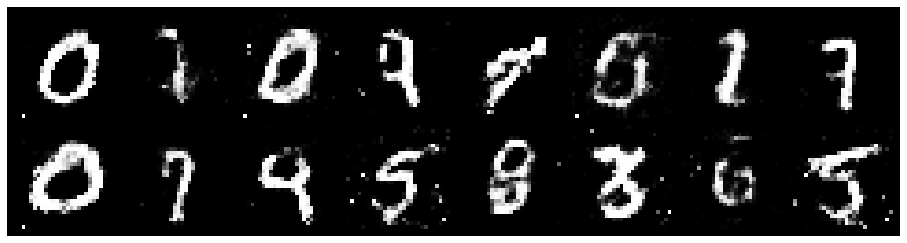

Epoch: [76/200], Batch Num: [500/600]
Discriminator Loss: 1.2133, Generator Loss: 1.0292
D(x): 0.5598, D(G(z)): 0.3825


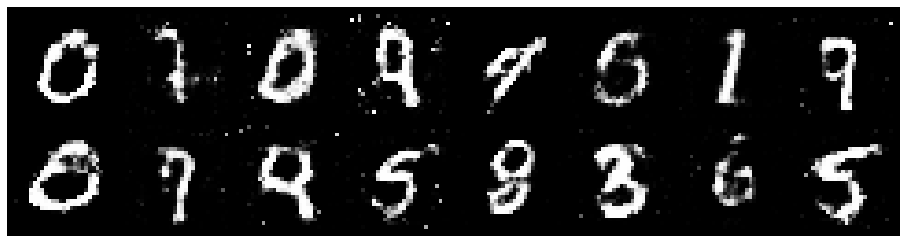

Epoch: [77/200], Batch Num: [0/600]
Discriminator Loss: 1.3633, Generator Loss: 0.9695
D(x): 0.5367, D(G(z)): 0.4535


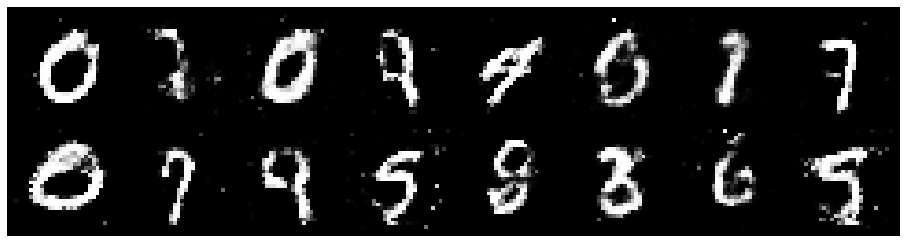

Epoch: [77/200], Batch Num: [100/600]
Discriminator Loss: 1.2394, Generator Loss: 1.0680
D(x): 0.6660, D(G(z)): 0.4704


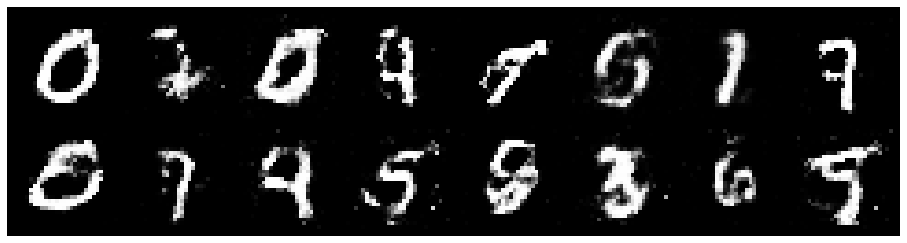

Epoch: [77/200], Batch Num: [200/600]
Discriminator Loss: 1.2853, Generator Loss: 0.9479
D(x): 0.5924, D(G(z)): 0.4666


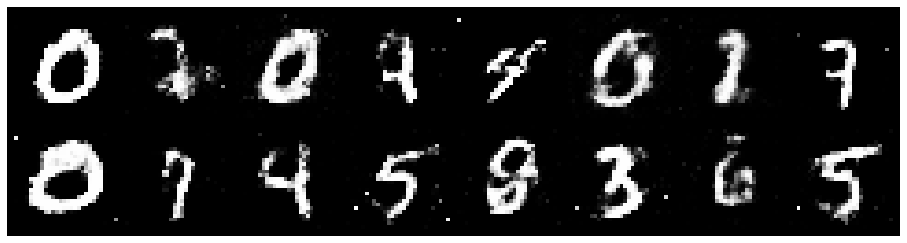

Epoch: [77/200], Batch Num: [300/600]
Discriminator Loss: 1.2524, Generator Loss: 0.9449
D(x): 0.5873, D(G(z)): 0.4413


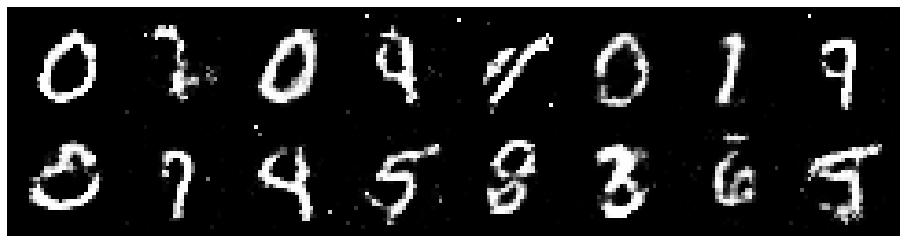

Epoch: [77/200], Batch Num: [400/600]
Discriminator Loss: 1.1599, Generator Loss: 1.0375
D(x): 0.5609, D(G(z)): 0.3604


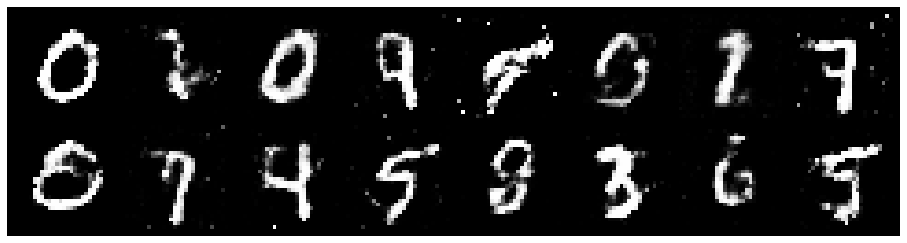

Epoch: [77/200], Batch Num: [500/600]
Discriminator Loss: 1.3163, Generator Loss: 0.9921
D(x): 0.5414, D(G(z)): 0.4072


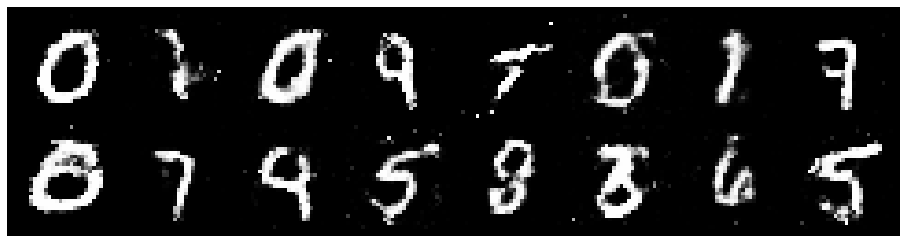

Epoch: [78/200], Batch Num: [0/600]
Discriminator Loss: 1.1613, Generator Loss: 0.9328
D(x): 0.5990, D(G(z)): 0.4141


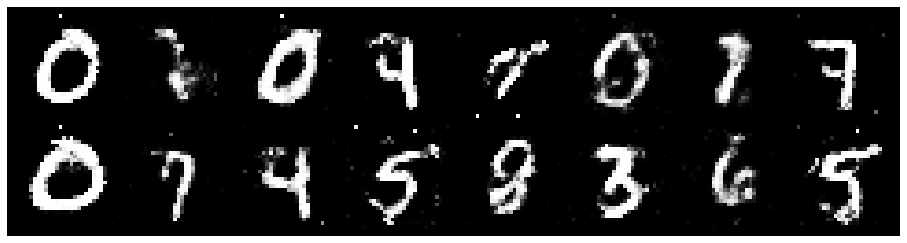

Epoch: [78/200], Batch Num: [100/600]
Discriminator Loss: 1.1863, Generator Loss: 0.8010
D(x): 0.6236, D(G(z)): 0.4480


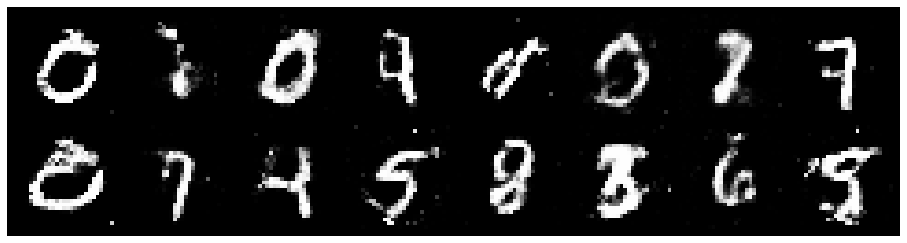

Epoch: [78/200], Batch Num: [200/600]
Discriminator Loss: 1.3037, Generator Loss: 1.0694
D(x): 0.5364, D(G(z)): 0.4165


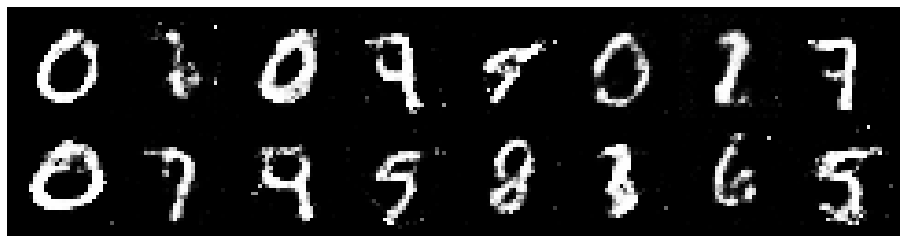

Epoch: [78/200], Batch Num: [300/600]
Discriminator Loss: 1.2445, Generator Loss: 0.8972
D(x): 0.5549, D(G(z)): 0.4328


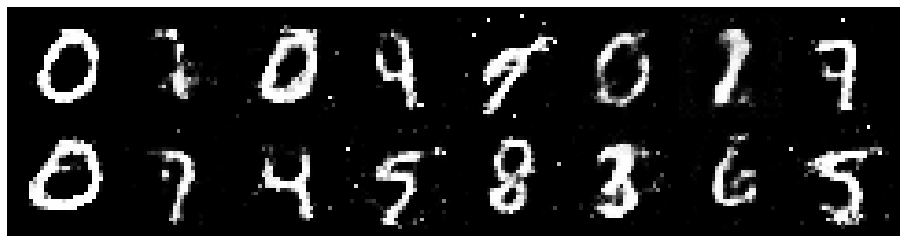

Epoch: [78/200], Batch Num: [400/600]
Discriminator Loss: 1.2251, Generator Loss: 0.9913
D(x): 0.5617, D(G(z)): 0.4224


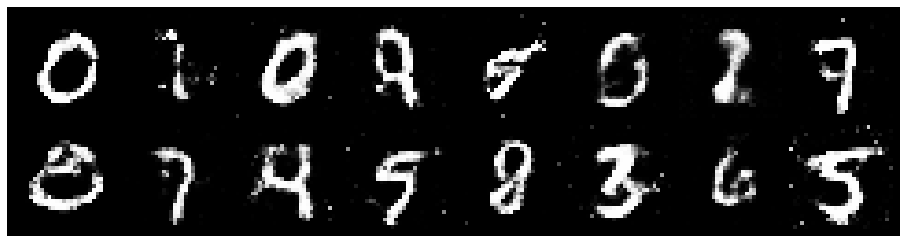

Epoch: [78/200], Batch Num: [500/600]
Discriminator Loss: 1.3395, Generator Loss: 0.9323
D(x): 0.5440, D(G(z)): 0.4433


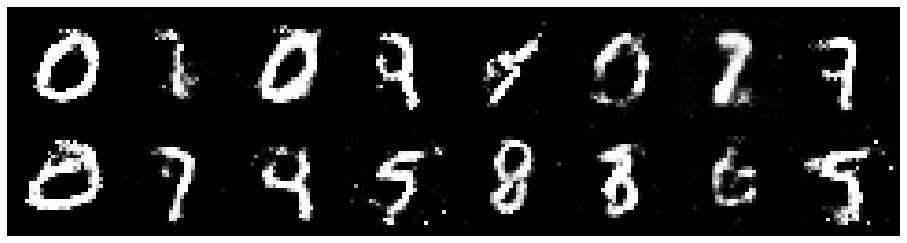

Epoch: [79/200], Batch Num: [0/600]
Discriminator Loss: 1.2229, Generator Loss: 0.8708
D(x): 0.5830, D(G(z)): 0.4309


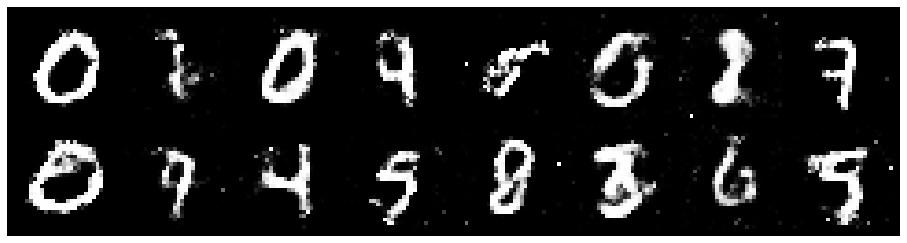

Epoch: [79/200], Batch Num: [100/600]
Discriminator Loss: 1.3918, Generator Loss: 1.1152
D(x): 0.5313, D(G(z)): 0.4435


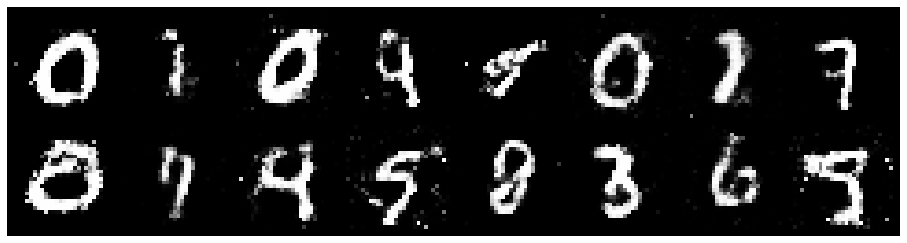

Epoch: [79/200], Batch Num: [200/600]
Discriminator Loss: 1.1496, Generator Loss: 1.1873
D(x): 0.5574, D(G(z)): 0.3621


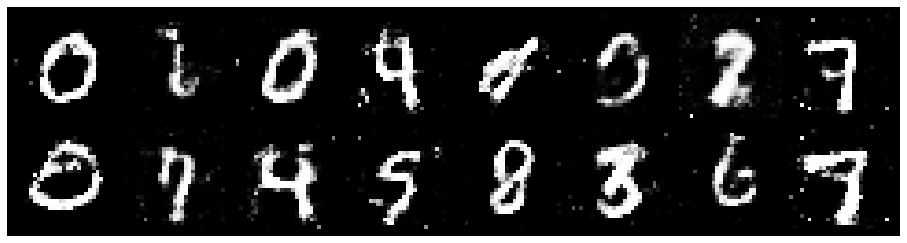

Epoch: [79/200], Batch Num: [300/600]
Discriminator Loss: 1.2888, Generator Loss: 0.8218
D(x): 0.5813, D(G(z)): 0.4601


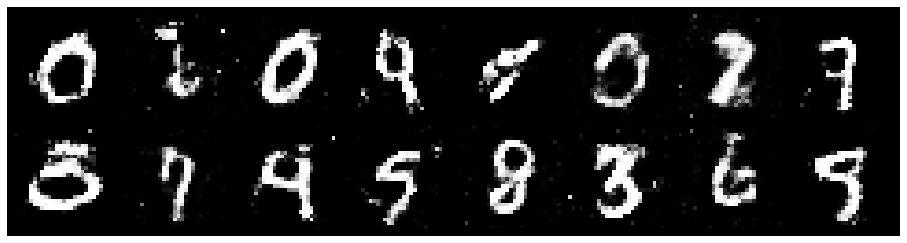

Epoch: [79/200], Batch Num: [400/600]
Discriminator Loss: 1.3883, Generator Loss: 0.9515
D(x): 0.5972, D(G(z)): 0.4814


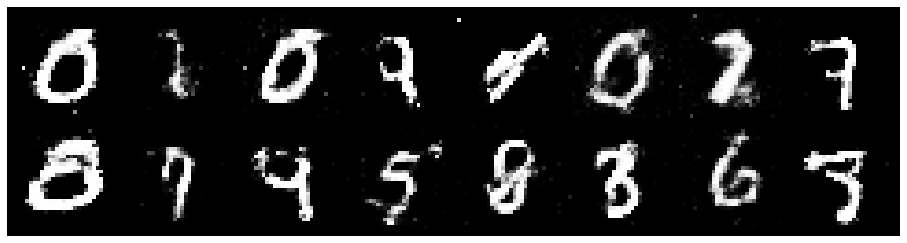

Epoch: [79/200], Batch Num: [500/600]
Discriminator Loss: 1.2027, Generator Loss: 0.9411
D(x): 0.5922, D(G(z)): 0.4392


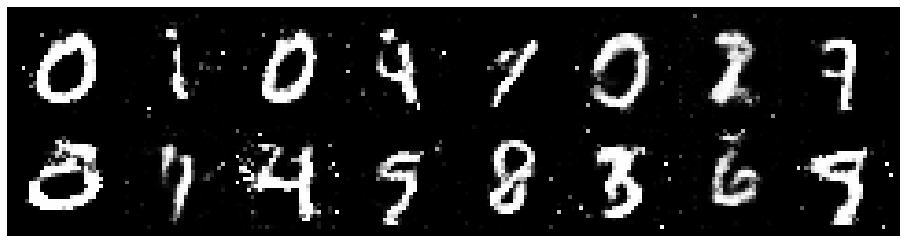

Epoch: [80/200], Batch Num: [0/600]
Discriminator Loss: 1.2094, Generator Loss: 1.0056
D(x): 0.6005, D(G(z)): 0.4403


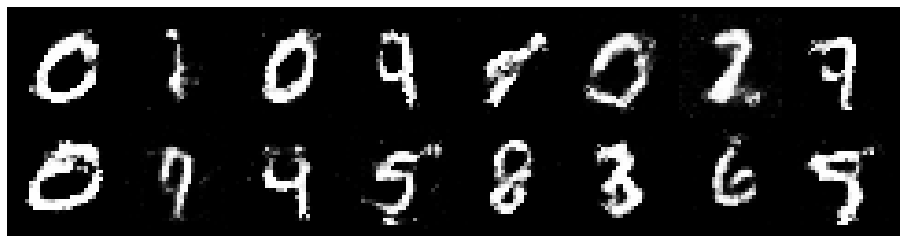

Epoch: [80/200], Batch Num: [100/600]
Discriminator Loss: 1.2104, Generator Loss: 0.9056
D(x): 0.5716, D(G(z)): 0.4311


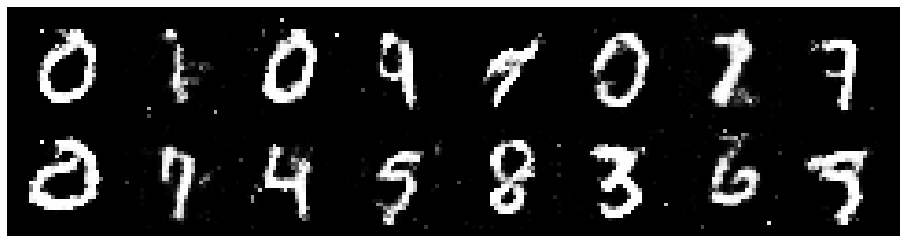

Epoch: [80/200], Batch Num: [200/600]
Discriminator Loss: 1.2660, Generator Loss: 0.8166
D(x): 0.5673, D(G(z)): 0.4708


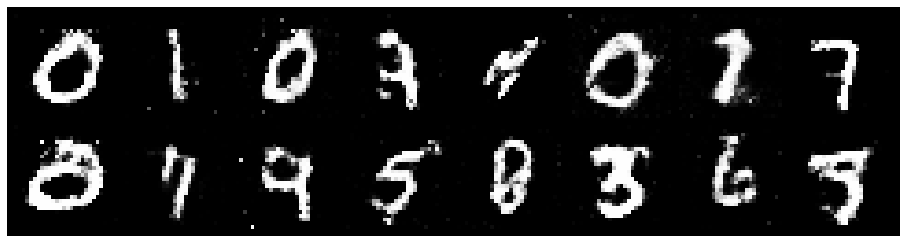

Epoch: [80/200], Batch Num: [300/600]
Discriminator Loss: 1.3246, Generator Loss: 0.8895
D(x): 0.5117, D(G(z)): 0.4302


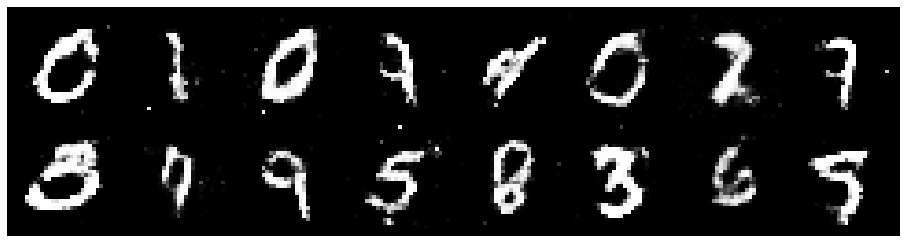

Epoch: [80/200], Batch Num: [400/600]
Discriminator Loss: 1.3357, Generator Loss: 0.9930
D(x): 0.5746, D(G(z)): 0.4745


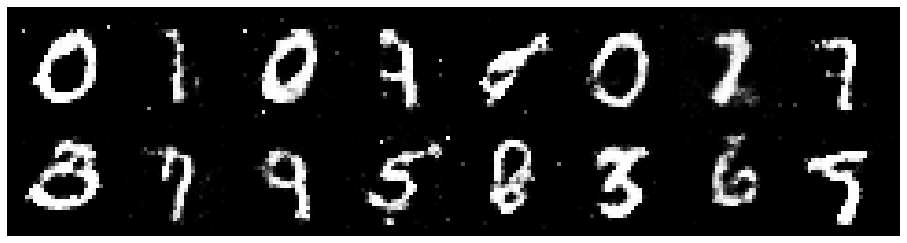

Epoch: [80/200], Batch Num: [500/600]
Discriminator Loss: 1.2808, Generator Loss: 0.9029
D(x): 0.5748, D(G(z)): 0.4550


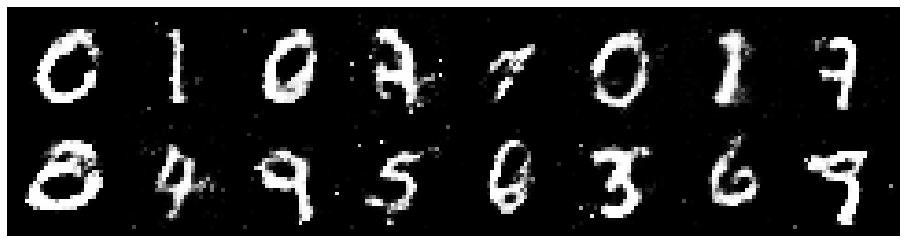

Epoch: [81/200], Batch Num: [0/600]
Discriminator Loss: 1.2441, Generator Loss: 0.9335
D(x): 0.5537, D(G(z)): 0.4222


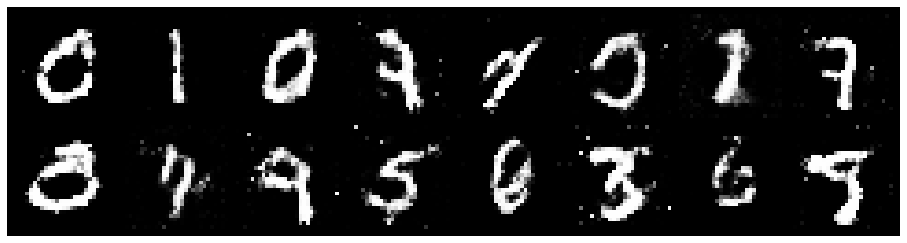

Epoch: [81/200], Batch Num: [100/600]
Discriminator Loss: 1.2334, Generator Loss: 0.8451
D(x): 0.5600, D(G(z)): 0.4438


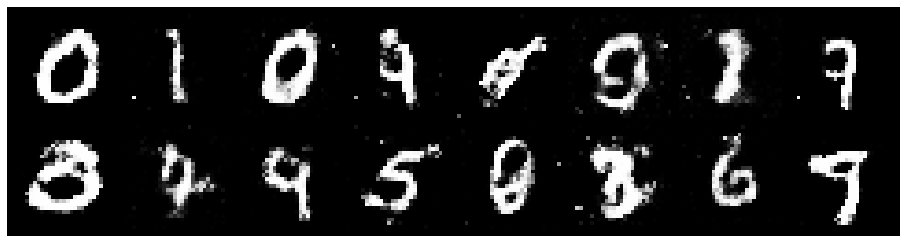

Epoch: [81/200], Batch Num: [200/600]
Discriminator Loss: 1.3792, Generator Loss: 0.9091
D(x): 0.4811, D(G(z)): 0.4131


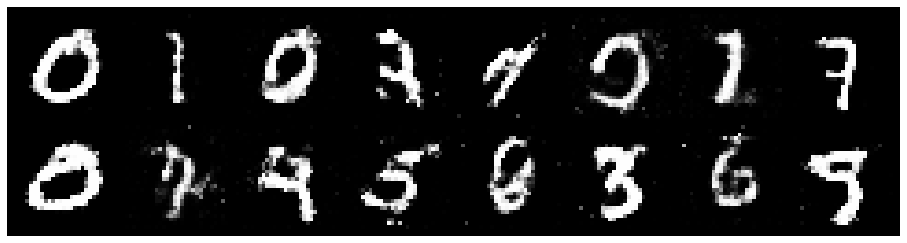

Epoch: [81/200], Batch Num: [300/600]
Discriminator Loss: 1.2854, Generator Loss: 0.9177
D(x): 0.5367, D(G(z)): 0.4314


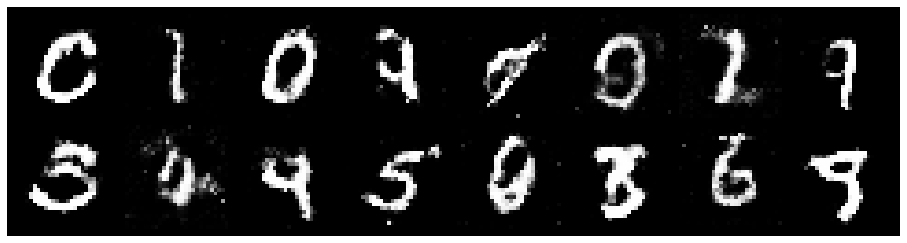

Epoch: [81/200], Batch Num: [400/600]
Discriminator Loss: 1.1687, Generator Loss: 0.9850
D(x): 0.5729, D(G(z)): 0.4042


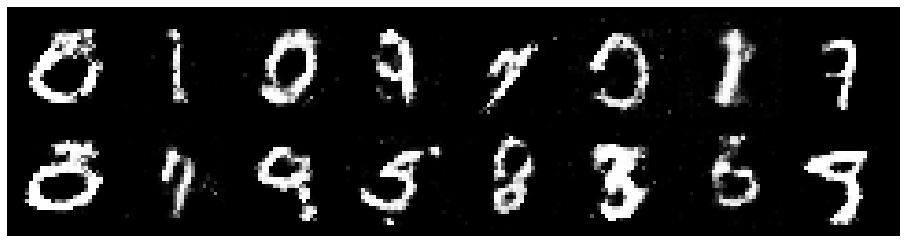

Epoch: [81/200], Batch Num: [500/600]
Discriminator Loss: 1.2800, Generator Loss: 0.7992
D(x): 0.5357, D(G(z)): 0.4513


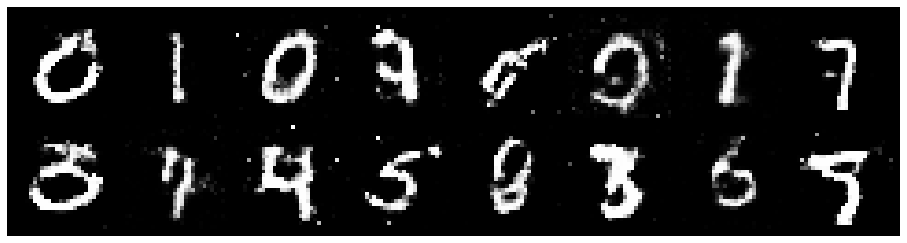

Epoch: [82/200], Batch Num: [0/600]
Discriminator Loss: 1.2407, Generator Loss: 0.8680
D(x): 0.6155, D(G(z)): 0.4591


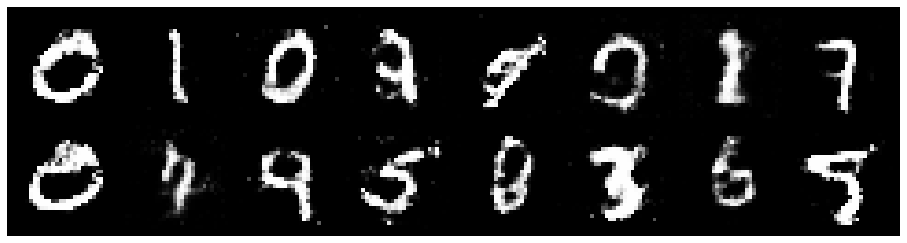

Epoch: [82/200], Batch Num: [100/600]
Discriminator Loss: 1.2824, Generator Loss: 1.0024
D(x): 0.5104, D(G(z)): 0.3963


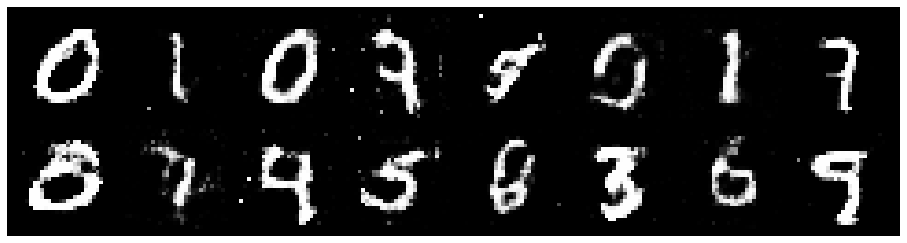

Epoch: [82/200], Batch Num: [200/600]
Discriminator Loss: 1.1504, Generator Loss: 1.0020
D(x): 0.5961, D(G(z)): 0.3887


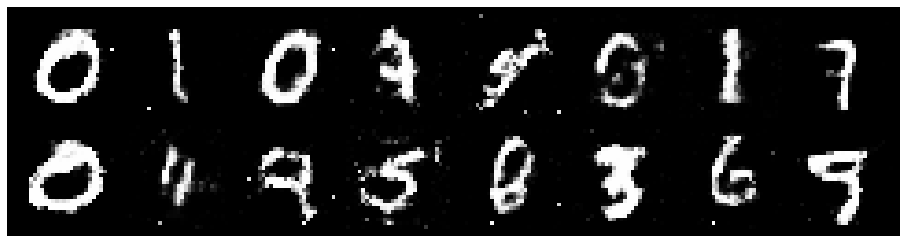

Epoch: [82/200], Batch Num: [300/600]
Discriminator Loss: 1.1800, Generator Loss: 1.0002
D(x): 0.5497, D(G(z)): 0.3862


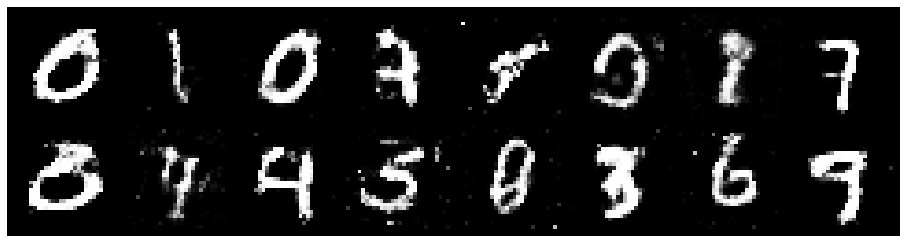

Epoch: [82/200], Batch Num: [400/600]
Discriminator Loss: 1.3469, Generator Loss: 0.9111
D(x): 0.5007, D(G(z)): 0.4345


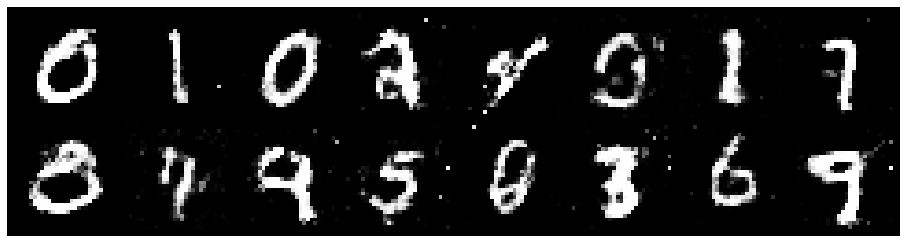

Epoch: [82/200], Batch Num: [500/600]
Discriminator Loss: 1.3729, Generator Loss: 0.9173
D(x): 0.5985, D(G(z)): 0.4869


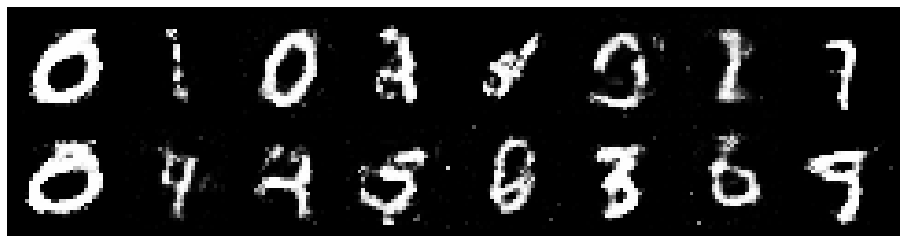

Epoch: [83/200], Batch Num: [0/600]
Discriminator Loss: 1.2358, Generator Loss: 1.1080
D(x): 0.5542, D(G(z)): 0.4018


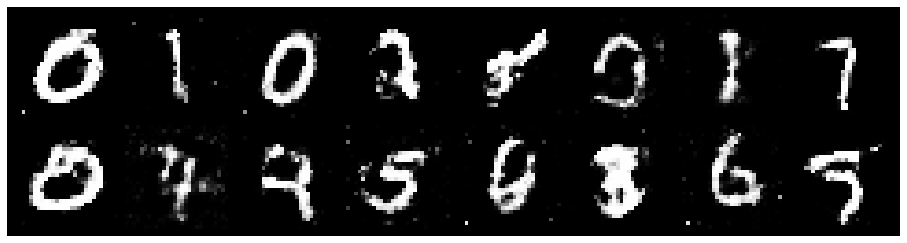

Epoch: [83/200], Batch Num: [100/600]
Discriminator Loss: 1.2232, Generator Loss: 0.8592
D(x): 0.5871, D(G(z)): 0.4516


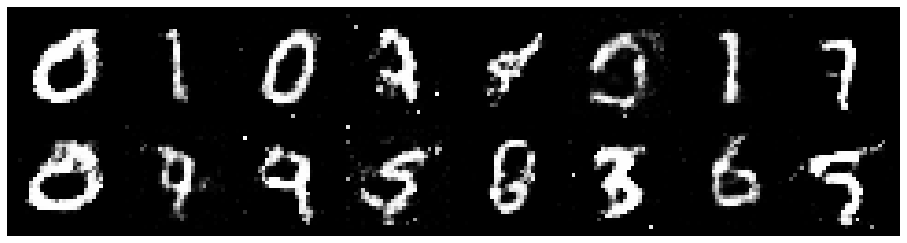

Epoch: [83/200], Batch Num: [200/600]
Discriminator Loss: 1.3284, Generator Loss: 0.8161
D(x): 0.5799, D(G(z)): 0.4685


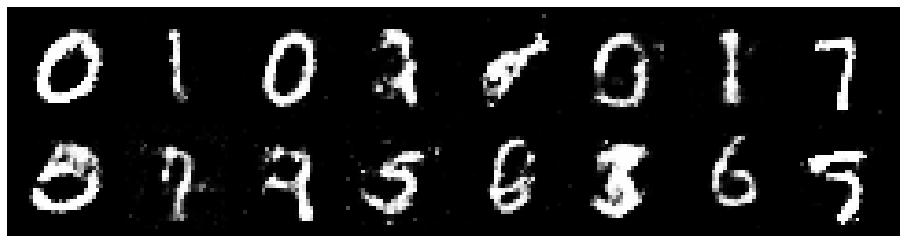

Epoch: [83/200], Batch Num: [300/600]
Discriminator Loss: 1.2387, Generator Loss: 0.7864
D(x): 0.5840, D(G(z)): 0.4490


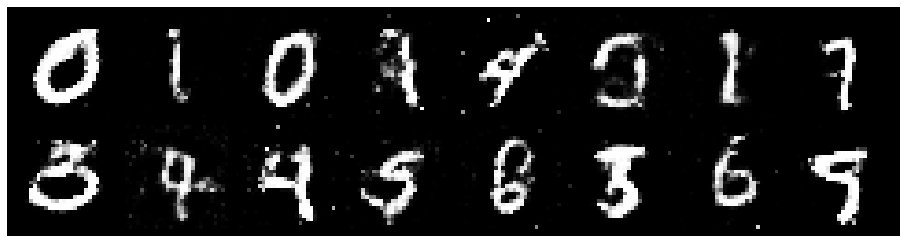

Epoch: [83/200], Batch Num: [400/600]
Discriminator Loss: 1.2297, Generator Loss: 0.9754
D(x): 0.5591, D(G(z)): 0.4202


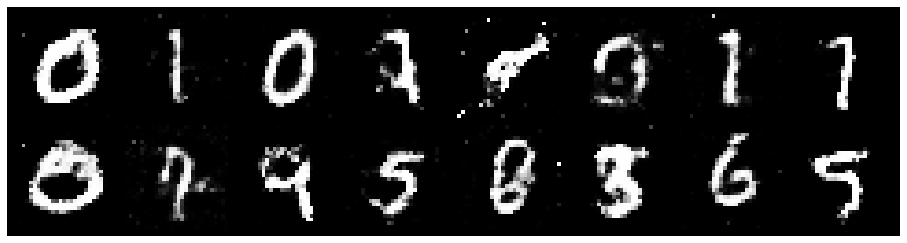

Epoch: [83/200], Batch Num: [500/600]
Discriminator Loss: 1.1352, Generator Loss: 1.0221
D(x): 0.5872, D(G(z)): 0.4060


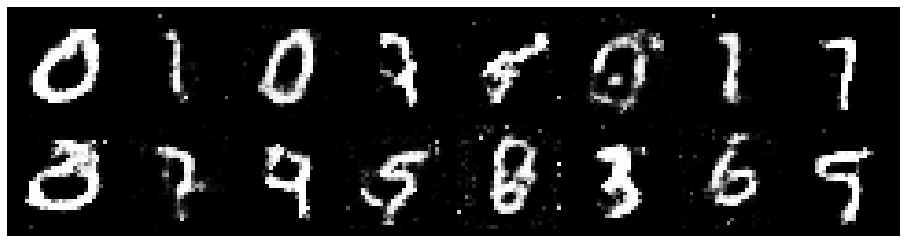

Epoch: [84/200], Batch Num: [0/600]
Discriminator Loss: 1.2221, Generator Loss: 0.9101
D(x): 0.5506, D(G(z)): 0.4244


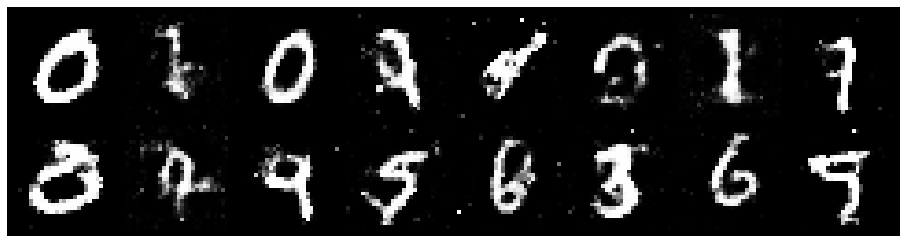

Epoch: [84/200], Batch Num: [100/600]
Discriminator Loss: 1.2264, Generator Loss: 0.9818
D(x): 0.5934, D(G(z)): 0.4230


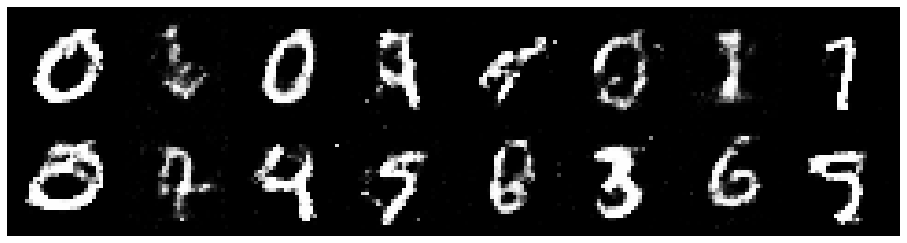

Epoch: [84/200], Batch Num: [200/600]
Discriminator Loss: 1.2511, Generator Loss: 0.8335
D(x): 0.5367, D(G(z)): 0.4271


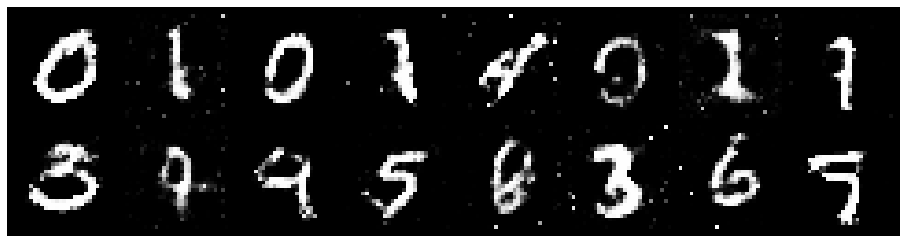

Epoch: [84/200], Batch Num: [300/600]
Discriminator Loss: 1.1286, Generator Loss: 0.9689
D(x): 0.6023, D(G(z)): 0.4092


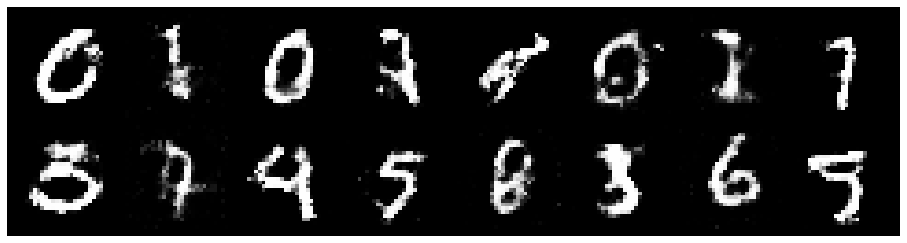

Epoch: [84/200], Batch Num: [400/600]
Discriminator Loss: 1.3537, Generator Loss: 0.9895
D(x): 0.4973, D(G(z)): 0.4232


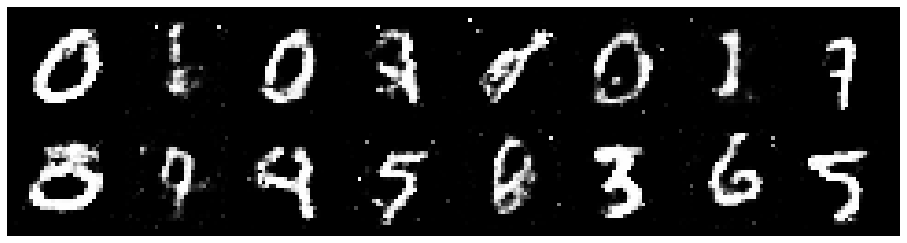

Epoch: [84/200], Batch Num: [500/600]
Discriminator Loss: 1.2883, Generator Loss: 0.9444
D(x): 0.6115, D(G(z)): 0.4571


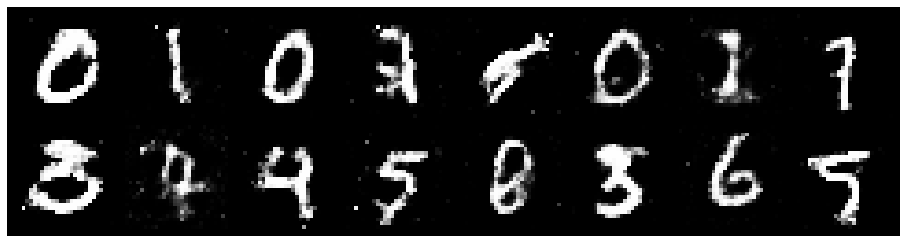

Epoch: [85/200], Batch Num: [0/600]
Discriminator Loss: 1.2460, Generator Loss: 1.1393
D(x): 0.5290, D(G(z)): 0.3871


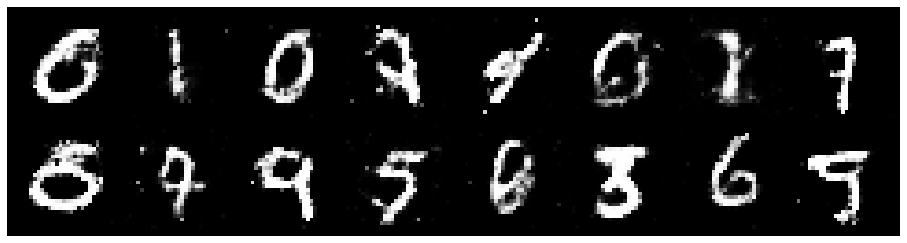

Epoch: [85/200], Batch Num: [100/600]
Discriminator Loss: 1.1224, Generator Loss: 1.0122
D(x): 0.6122, D(G(z)): 0.4109


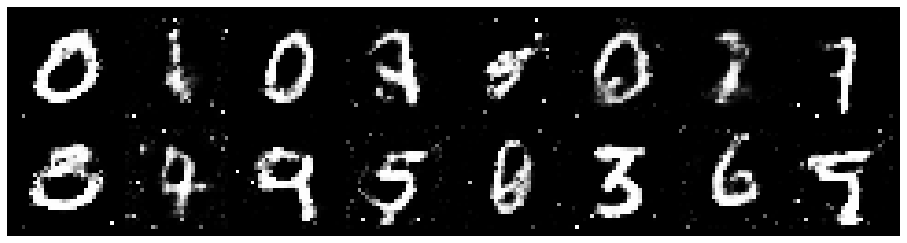

Epoch: [85/200], Batch Num: [200/600]
Discriminator Loss: 1.1940, Generator Loss: 0.9401
D(x): 0.5485, D(G(z)): 0.3922


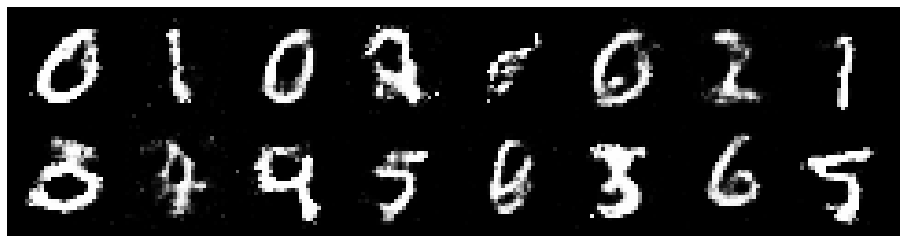

Epoch: [85/200], Batch Num: [300/600]
Discriminator Loss: 1.2276, Generator Loss: 0.8793
D(x): 0.5540, D(G(z)): 0.4236


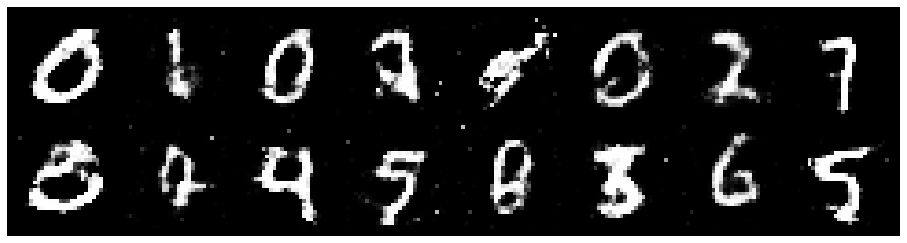

Epoch: [85/200], Batch Num: [400/600]
Discriminator Loss: 1.2553, Generator Loss: 0.8981
D(x): 0.5750, D(G(z)): 0.4300


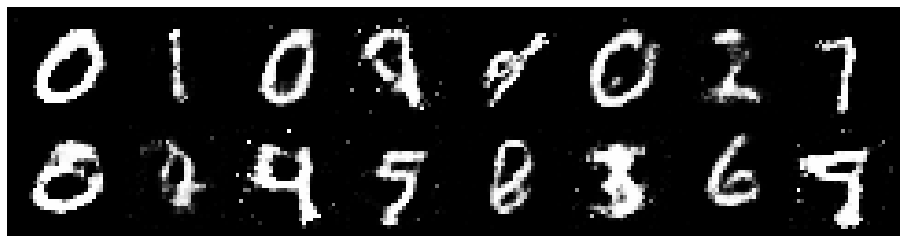

Epoch: [85/200], Batch Num: [500/600]
Discriminator Loss: 1.2762, Generator Loss: 0.7905
D(x): 0.5994, D(G(z)): 0.4888


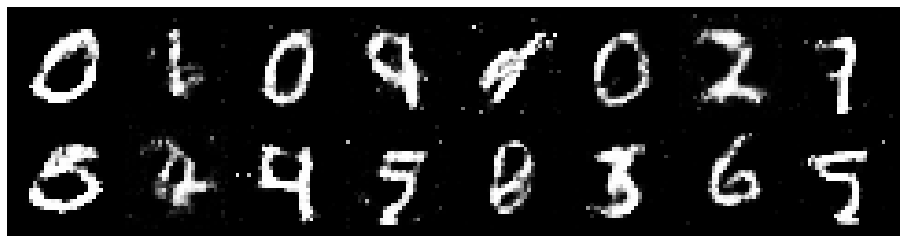

Epoch: [86/200], Batch Num: [0/600]
Discriminator Loss: 1.2490, Generator Loss: 0.8194
D(x): 0.6201, D(G(z)): 0.4784


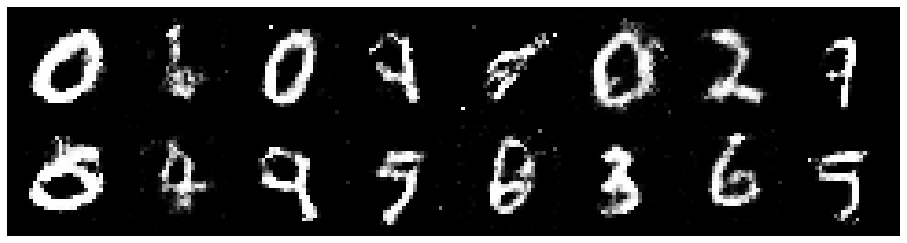

Epoch: [86/200], Batch Num: [100/600]
Discriminator Loss: 1.1651, Generator Loss: 1.0465
D(x): 0.5979, D(G(z)): 0.4303


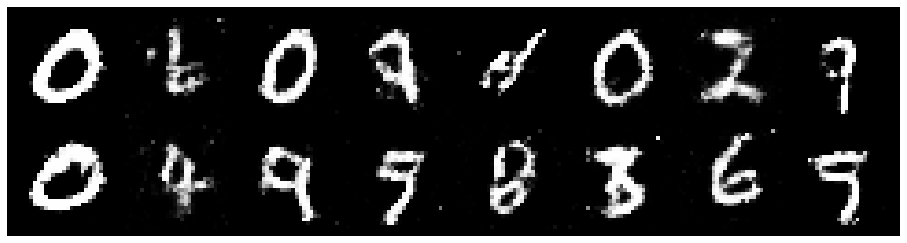

Epoch: [86/200], Batch Num: [200/600]
Discriminator Loss: 1.2469, Generator Loss: 0.9458
D(x): 0.5751, D(G(z)): 0.4517


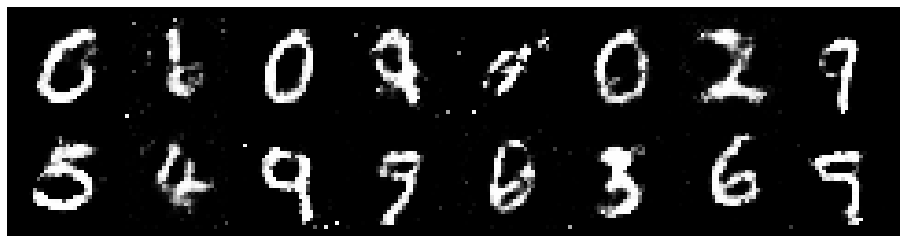

Epoch: [86/200], Batch Num: [300/600]
Discriminator Loss: 1.2715, Generator Loss: 0.8569
D(x): 0.5526, D(G(z)): 0.4437


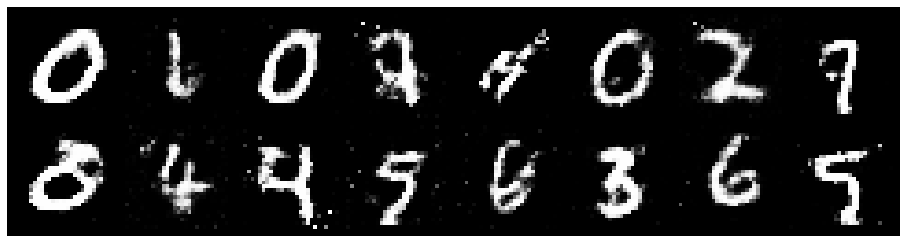

Epoch: [86/200], Batch Num: [400/600]
Discriminator Loss: 1.2820, Generator Loss: 1.0641
D(x): 0.5640, D(G(z)): 0.4304


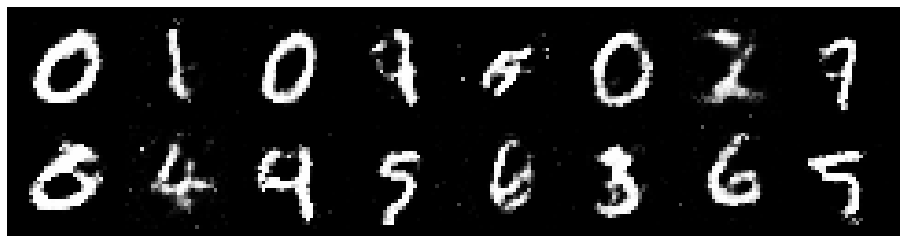

Epoch: [86/200], Batch Num: [500/600]
Discriminator Loss: 1.1699, Generator Loss: 0.9653
D(x): 0.5952, D(G(z)): 0.4128


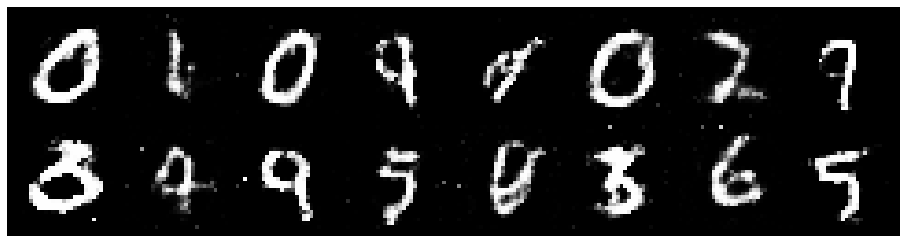

Epoch: [87/200], Batch Num: [0/600]
Discriminator Loss: 1.2149, Generator Loss: 0.8778
D(x): 0.5478, D(G(z)): 0.4259


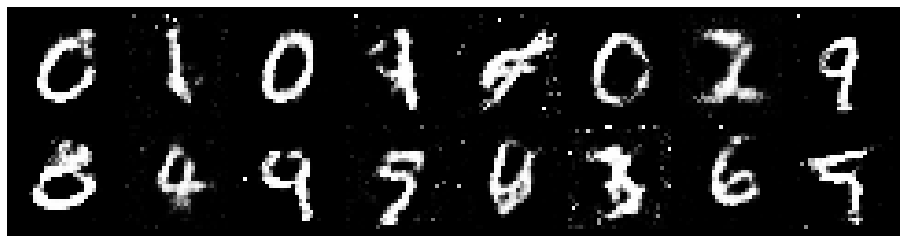

Epoch: [87/200], Batch Num: [100/600]
Discriminator Loss: 1.2051, Generator Loss: 0.8547
D(x): 0.6045, D(G(z)): 0.4535


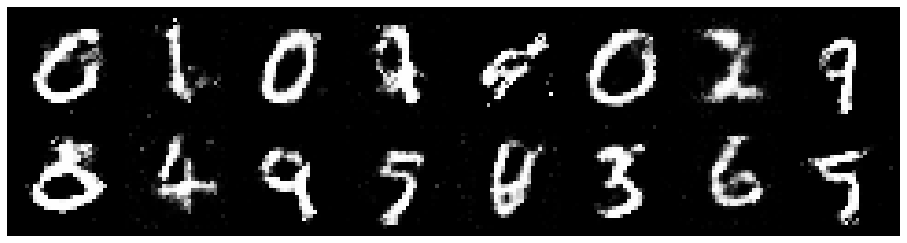

Epoch: [87/200], Batch Num: [200/600]
Discriminator Loss: 1.2233, Generator Loss: 0.9897
D(x): 0.5608, D(G(z)): 0.4236


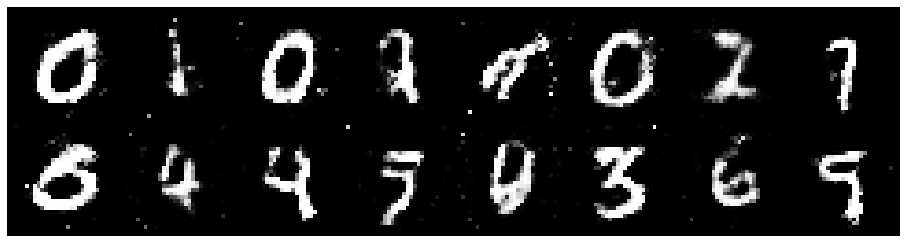

Epoch: [87/200], Batch Num: [300/600]
Discriminator Loss: 1.1786, Generator Loss: 0.9335
D(x): 0.5947, D(G(z)): 0.4322


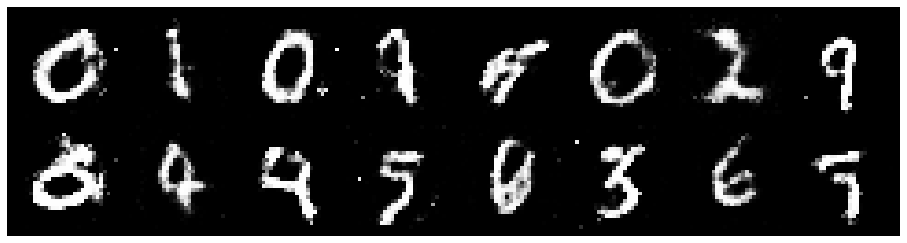

Epoch: [87/200], Batch Num: [400/600]
Discriminator Loss: 1.1206, Generator Loss: 0.9306
D(x): 0.5811, D(G(z)): 0.3990


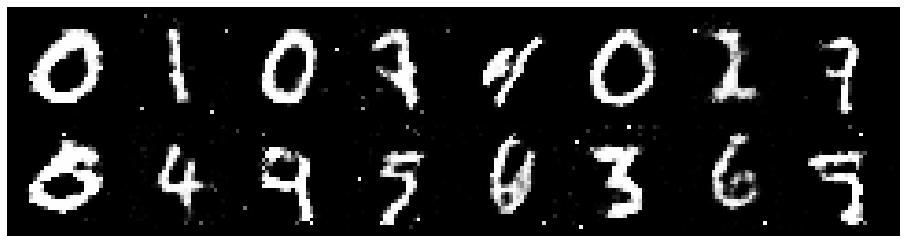

Epoch: [87/200], Batch Num: [500/600]
Discriminator Loss: 1.1444, Generator Loss: 0.8565
D(x): 0.5972, D(G(z)): 0.4312


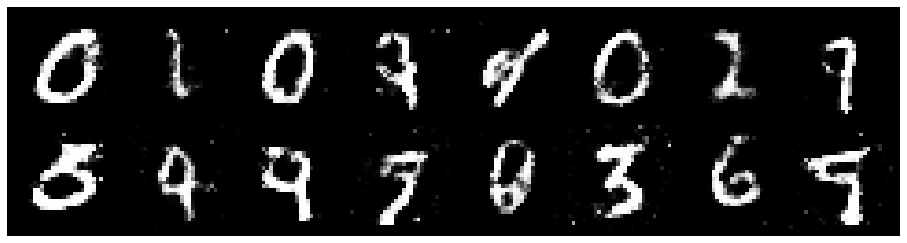

Epoch: [88/200], Batch Num: [0/600]
Discriminator Loss: 1.1794, Generator Loss: 0.9846
D(x): 0.6258, D(G(z)): 0.4340


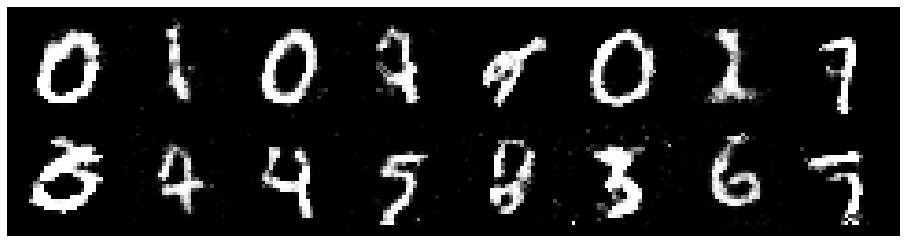

Epoch: [88/200], Batch Num: [100/600]
Discriminator Loss: 1.2462, Generator Loss: 0.8732
D(x): 0.5741, D(G(z)): 0.4543


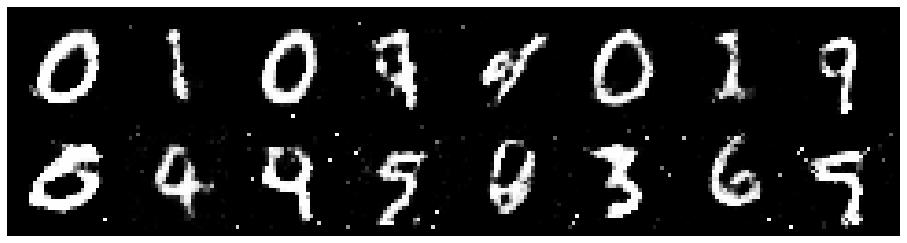

Epoch: [88/200], Batch Num: [200/600]
Discriminator Loss: 1.1637, Generator Loss: 1.1394
D(x): 0.5512, D(G(z)): 0.3510


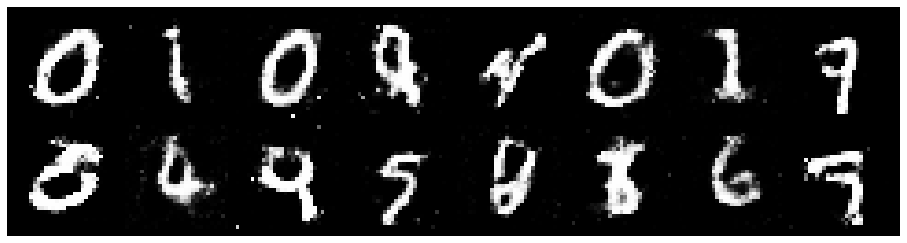

Epoch: [88/200], Batch Num: [300/600]
Discriminator Loss: 1.1241, Generator Loss: 1.0978
D(x): 0.5606, D(G(z)): 0.3578


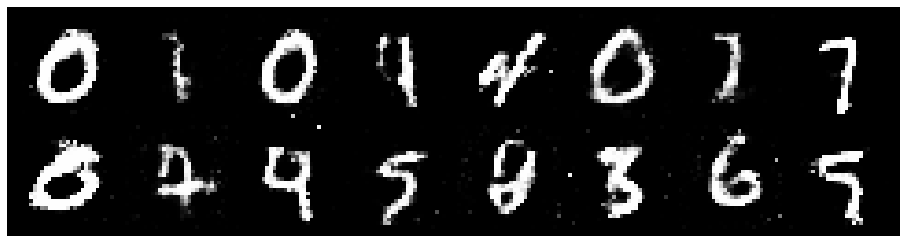

Epoch: [88/200], Batch Num: [400/600]
Discriminator Loss: 1.1178, Generator Loss: 1.1590
D(x): 0.6297, D(G(z)): 0.3944


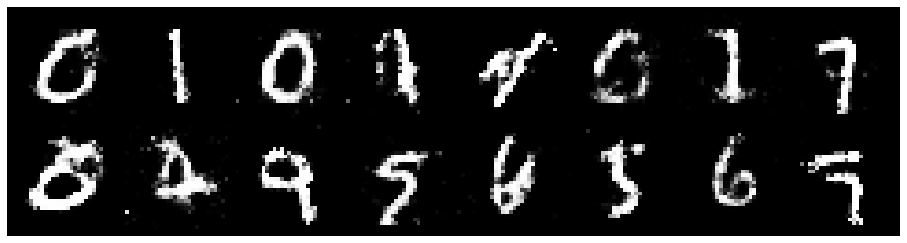

Epoch: [88/200], Batch Num: [500/600]
Discriminator Loss: 1.1029, Generator Loss: 0.9908
D(x): 0.5954, D(G(z)): 0.4106


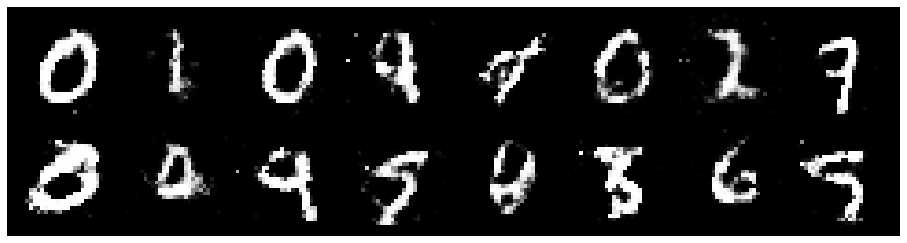

Epoch: [89/200], Batch Num: [0/600]
Discriminator Loss: 1.2911, Generator Loss: 0.7741
D(x): 0.5731, D(G(z)): 0.4823


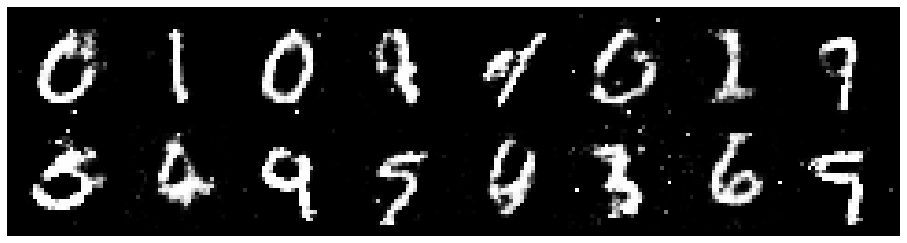

Epoch: [89/200], Batch Num: [100/600]
Discriminator Loss: 1.3284, Generator Loss: 0.8879
D(x): 0.5969, D(G(z)): 0.4970


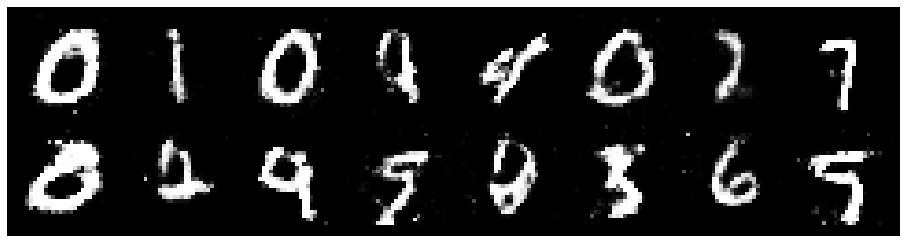

Epoch: [89/200], Batch Num: [200/600]
Discriminator Loss: 1.2223, Generator Loss: 1.1629
D(x): 0.5284, D(G(z)): 0.3434


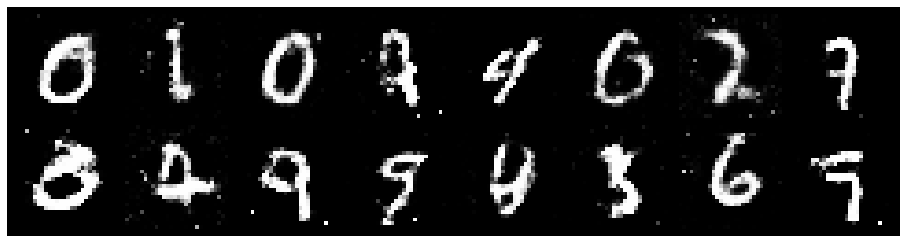

Epoch: [89/200], Batch Num: [300/600]
Discriminator Loss: 1.1591, Generator Loss: 0.9579
D(x): 0.5846, D(G(z)): 0.4127


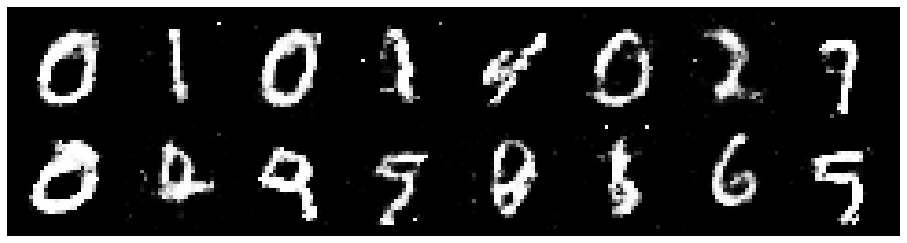

Epoch: [89/200], Batch Num: [400/600]
Discriminator Loss: 1.1818, Generator Loss: 1.0068
D(x): 0.5949, D(G(z)): 0.4219


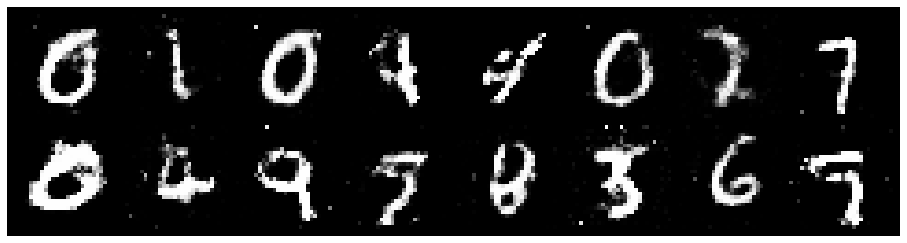

Epoch: [89/200], Batch Num: [500/600]
Discriminator Loss: 1.1392, Generator Loss: 1.0178
D(x): 0.6209, D(G(z)): 0.4126


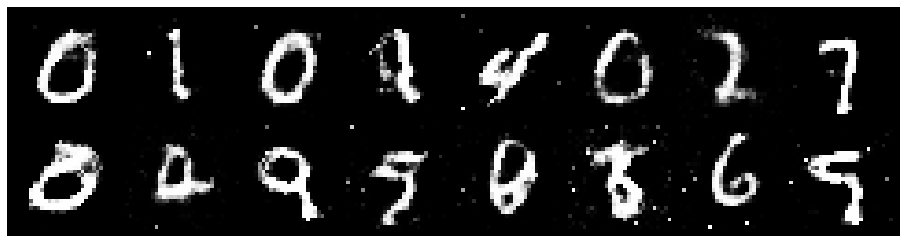

Epoch: [90/200], Batch Num: [0/600]
Discriminator Loss: 1.1816, Generator Loss: 1.1474
D(x): 0.6118, D(G(z)): 0.4102


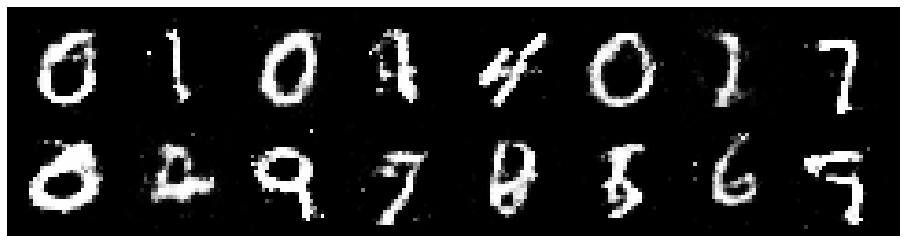

Epoch: [90/200], Batch Num: [100/600]
Discriminator Loss: 1.1339, Generator Loss: 0.9287
D(x): 0.6346, D(G(z)): 0.4260


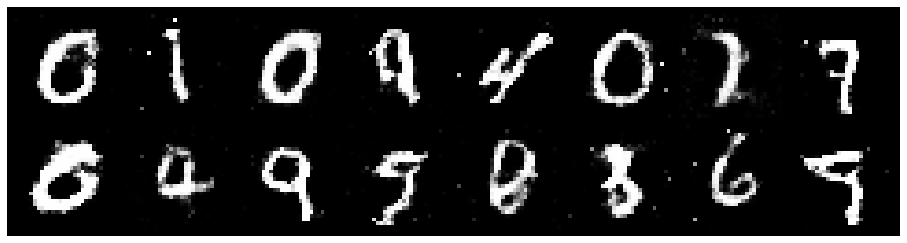

Epoch: [90/200], Batch Num: [200/600]
Discriminator Loss: 1.2000, Generator Loss: 0.9841
D(x): 0.5608, D(G(z)): 0.4103


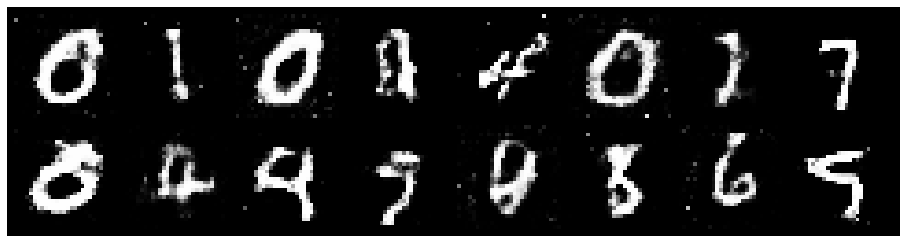

Epoch: [90/200], Batch Num: [300/600]
Discriminator Loss: 1.2312, Generator Loss: 0.9466
D(x): 0.5580, D(G(z)): 0.4234


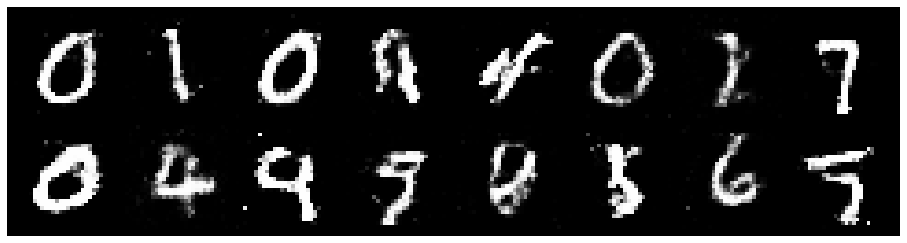

Epoch: [90/200], Batch Num: [400/600]
Discriminator Loss: 1.2666, Generator Loss: 0.9743
D(x): 0.5448, D(G(z)): 0.4167


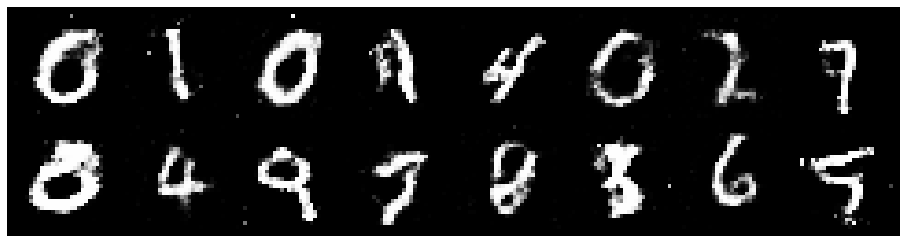

Epoch: [90/200], Batch Num: [500/600]
Discriminator Loss: 1.3107, Generator Loss: 0.7868
D(x): 0.5920, D(G(z)): 0.4894


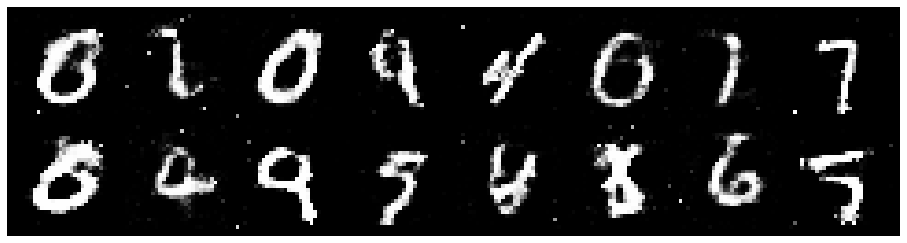

Epoch: [91/200], Batch Num: [0/600]
Discriminator Loss: 1.1781, Generator Loss: 1.0518
D(x): 0.6141, D(G(z)): 0.4222


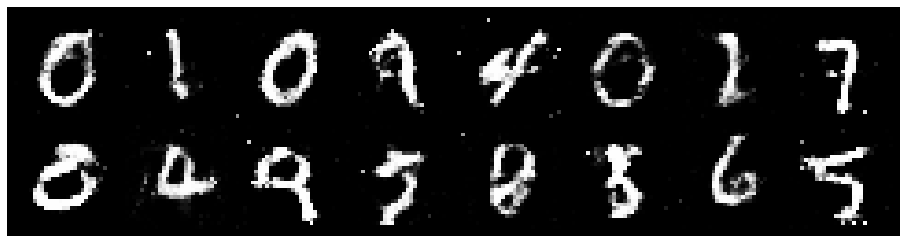

Epoch: [91/200], Batch Num: [100/600]
Discriminator Loss: 1.1340, Generator Loss: 0.8712
D(x): 0.5948, D(G(z)): 0.4157


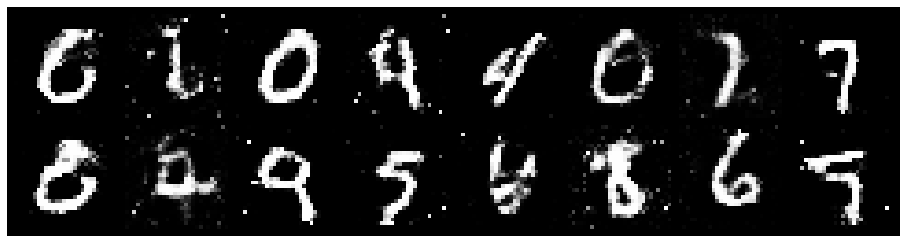

Epoch: [91/200], Batch Num: [200/600]
Discriminator Loss: 1.2460, Generator Loss: 0.9191
D(x): 0.5498, D(G(z)): 0.4284


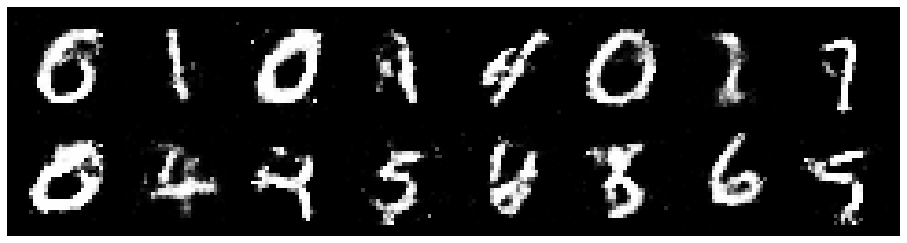

Epoch: [91/200], Batch Num: [300/600]
Discriminator Loss: 1.2737, Generator Loss: 0.9138
D(x): 0.5888, D(G(z)): 0.4734


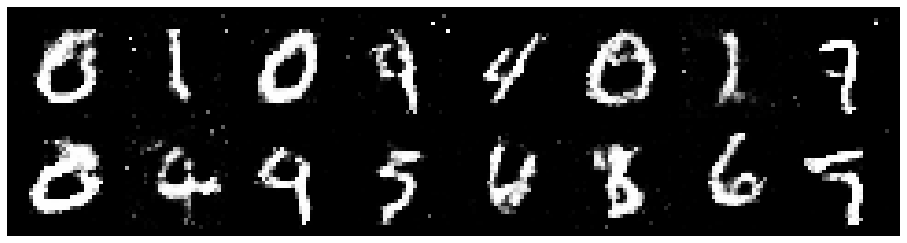

Epoch: [91/200], Batch Num: [400/600]
Discriminator Loss: 1.2967, Generator Loss: 0.9686
D(x): 0.5456, D(G(z)): 0.4106


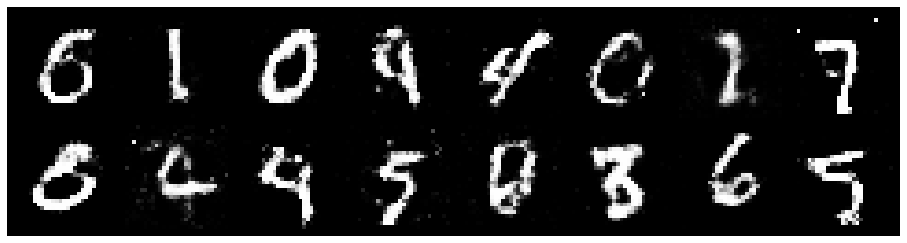

Epoch: [91/200], Batch Num: [500/600]
Discriminator Loss: 1.1208, Generator Loss: 1.0099
D(x): 0.5546, D(G(z)): 0.3578


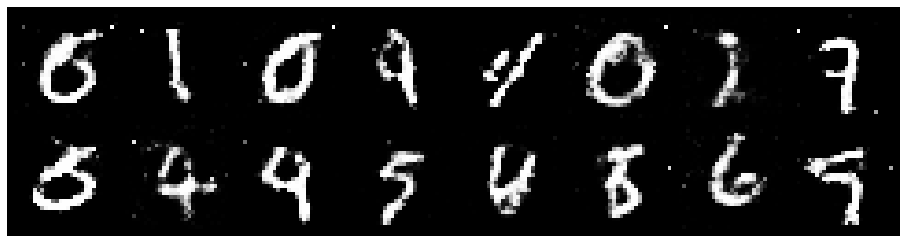

Epoch: [92/200], Batch Num: [0/600]
Discriminator Loss: 1.1584, Generator Loss: 0.9700
D(x): 0.5590, D(G(z)): 0.3775


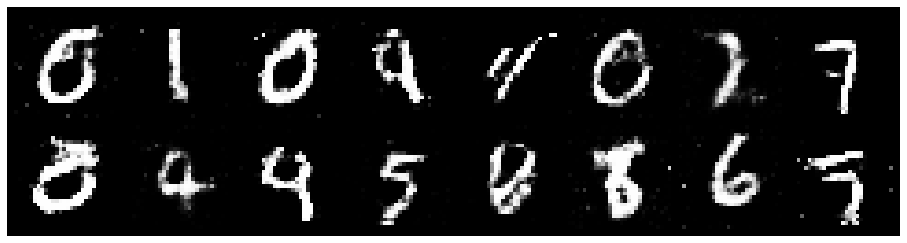

Epoch: [92/200], Batch Num: [100/600]
Discriminator Loss: 1.2341, Generator Loss: 1.0222
D(x): 0.5506, D(G(z)): 0.3858


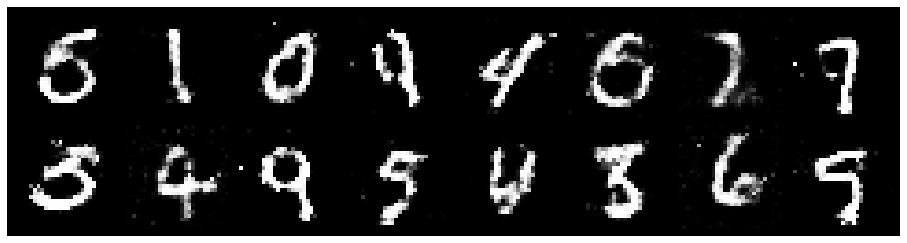

Epoch: [92/200], Batch Num: [200/600]
Discriminator Loss: 1.1652, Generator Loss: 1.0707
D(x): 0.5438, D(G(z)): 0.3527


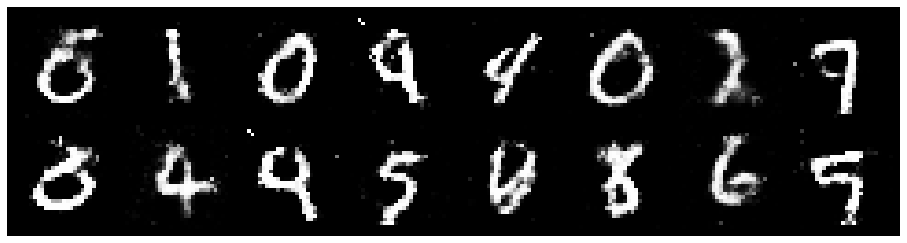

Epoch: [92/200], Batch Num: [300/600]
Discriminator Loss: 1.2476, Generator Loss: 0.8819
D(x): 0.5522, D(G(z)): 0.4388


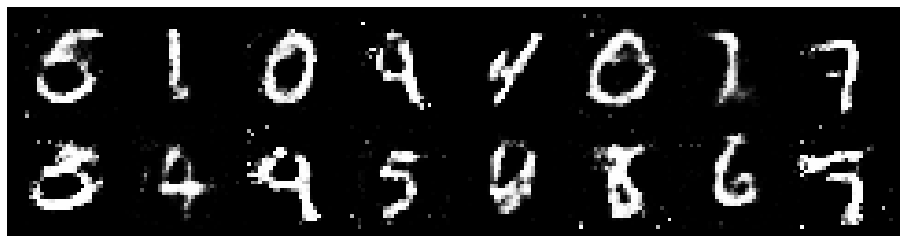

Epoch: [92/200], Batch Num: [400/600]
Discriminator Loss: 1.3109, Generator Loss: 0.8951
D(x): 0.4990, D(G(z)): 0.4293


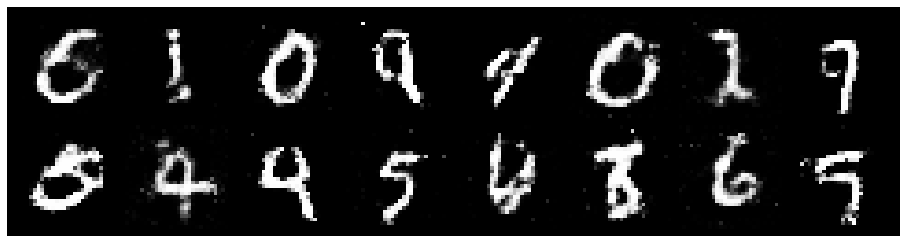

Epoch: [92/200], Batch Num: [500/600]
Discriminator Loss: 1.2104, Generator Loss: 1.0050
D(x): 0.6196, D(G(z)): 0.4357


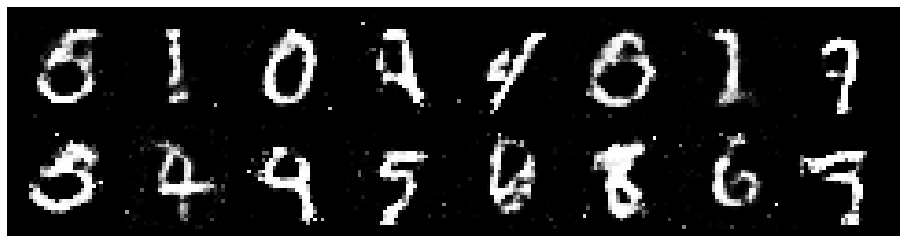

Epoch: [93/200], Batch Num: [0/600]
Discriminator Loss: 1.1382, Generator Loss: 0.8877
D(x): 0.5954, D(G(z)): 0.4135


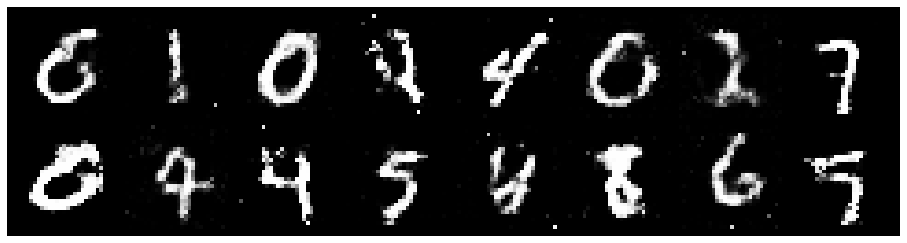

Epoch: [93/200], Batch Num: [100/600]
Discriminator Loss: 1.2738, Generator Loss: 0.9482
D(x): 0.5129, D(G(z)): 0.4077


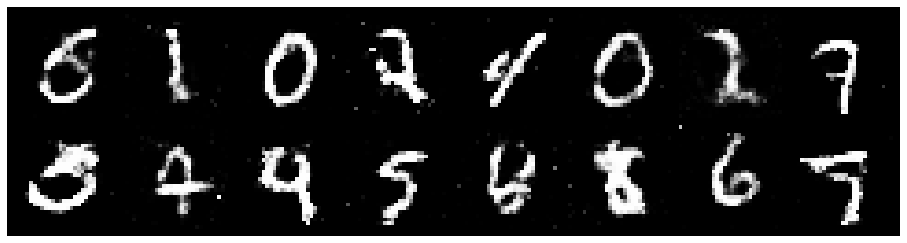

Epoch: [93/200], Batch Num: [200/600]
Discriminator Loss: 1.2363, Generator Loss: 0.9827
D(x): 0.5671, D(G(z)): 0.4220


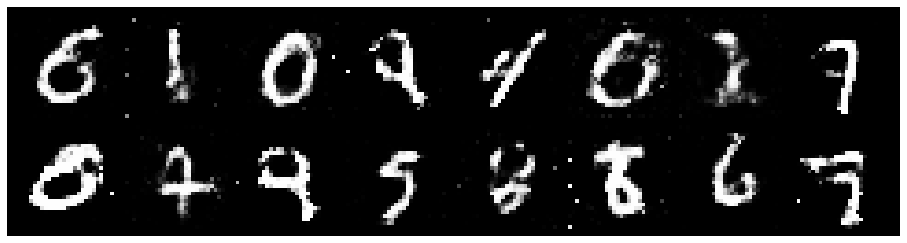

Epoch: [93/200], Batch Num: [300/600]
Discriminator Loss: 1.1636, Generator Loss: 1.1173
D(x): 0.5876, D(G(z)): 0.4005


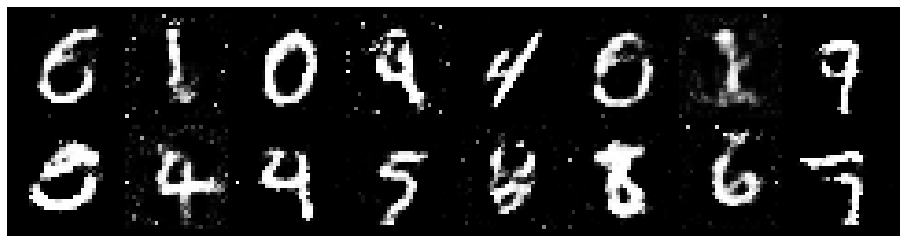

Epoch: [93/200], Batch Num: [400/600]
Discriminator Loss: 1.2067, Generator Loss: 1.0184
D(x): 0.6067, D(G(z)): 0.4449


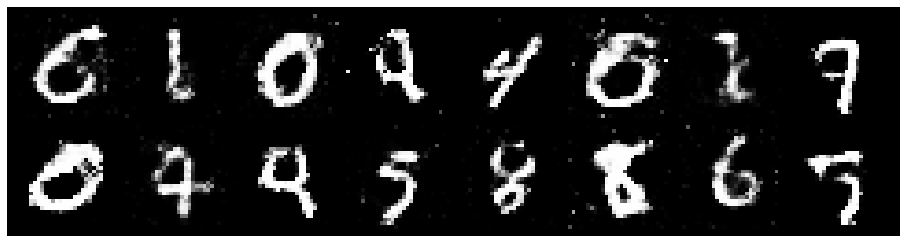

Epoch: [93/200], Batch Num: [500/600]
Discriminator Loss: 1.2186, Generator Loss: 0.9952
D(x): 0.5844, D(G(z)): 0.4354


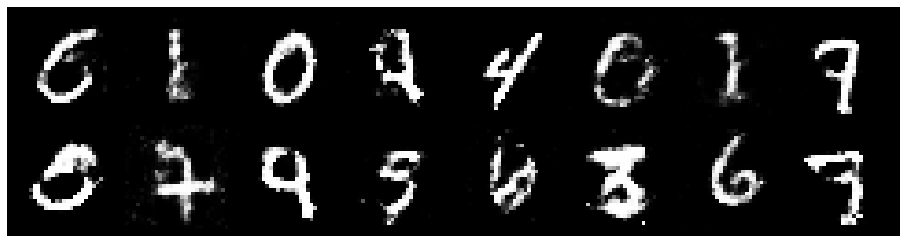

Epoch: [94/200], Batch Num: [0/600]
Discriminator Loss: 1.2094, Generator Loss: 0.8598
D(x): 0.5892, D(G(z)): 0.4612


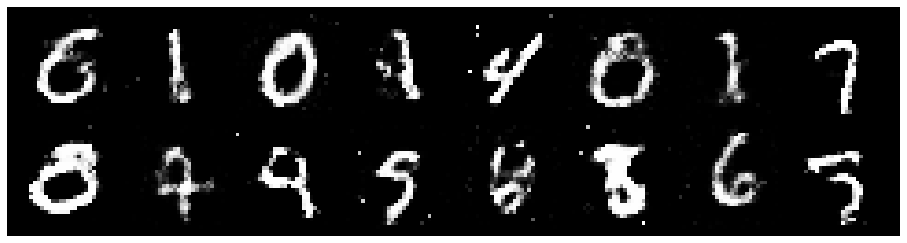

Epoch: [94/200], Batch Num: [100/600]
Discriminator Loss: 1.2757, Generator Loss: 0.8086
D(x): 0.5594, D(G(z)): 0.4617


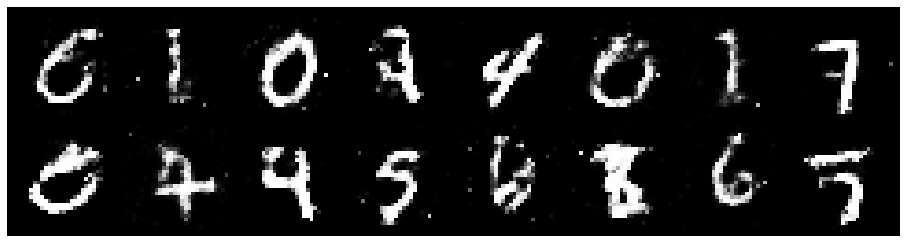

Epoch: [94/200], Batch Num: [200/600]
Discriminator Loss: 1.2385, Generator Loss: 1.0243
D(x): 0.5701, D(G(z)): 0.4240


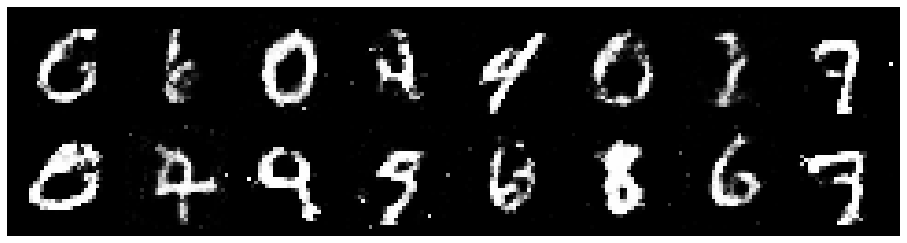

Epoch: [94/200], Batch Num: [300/600]
Discriminator Loss: 1.2470, Generator Loss: 0.8845
D(x): 0.5766, D(G(z)): 0.4654


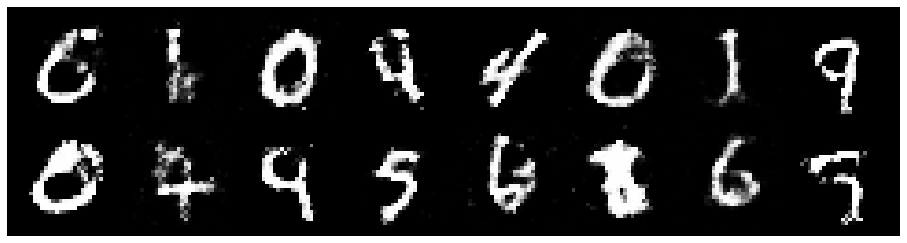

Epoch: [94/200], Batch Num: [400/600]
Discriminator Loss: 1.1911, Generator Loss: 0.8688
D(x): 0.5638, D(G(z)): 0.4236


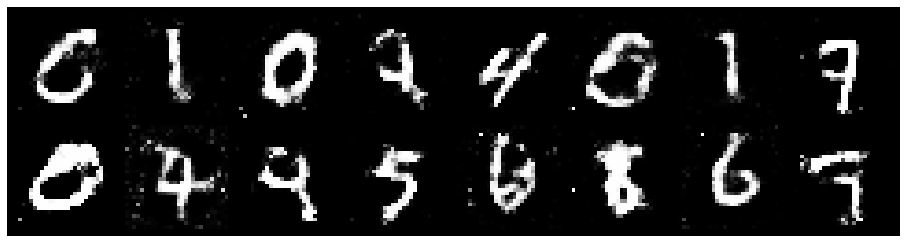

Epoch: [94/200], Batch Num: [500/600]
Discriminator Loss: 1.2546, Generator Loss: 1.0283
D(x): 0.5170, D(G(z)): 0.3893


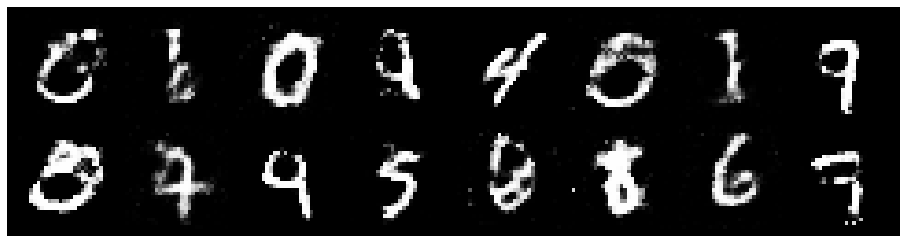

Epoch: [95/200], Batch Num: [0/600]
Discriminator Loss: 1.3240, Generator Loss: 1.0103
D(x): 0.5741, D(G(z)): 0.4349


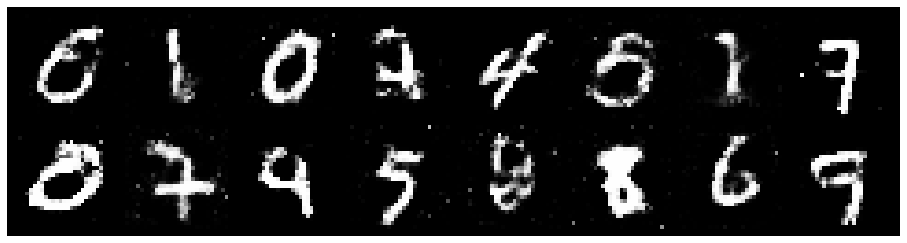

Epoch: [95/200], Batch Num: [100/600]
Discriminator Loss: 1.2527, Generator Loss: 0.9628
D(x): 0.5746, D(G(z)): 0.4373


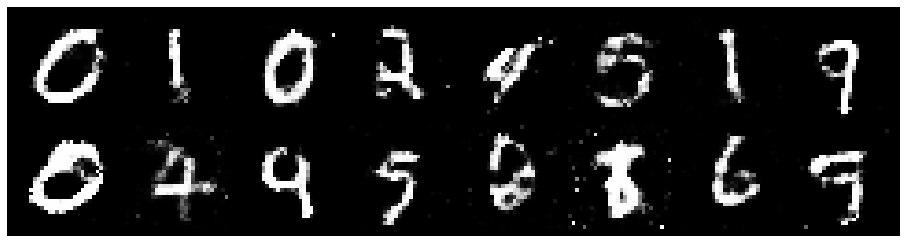

Epoch: [95/200], Batch Num: [200/600]
Discriminator Loss: 1.2338, Generator Loss: 0.8599
D(x): 0.5700, D(G(z)): 0.4301


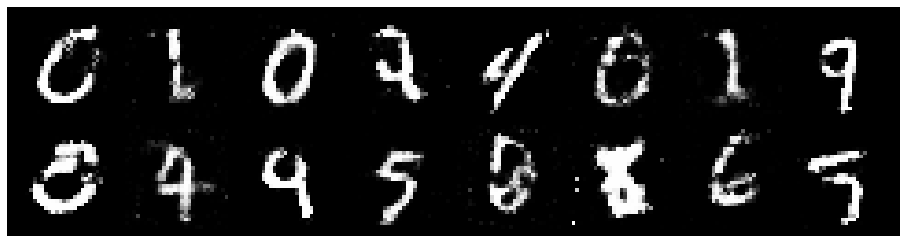

Epoch: [95/200], Batch Num: [300/600]
Discriminator Loss: 1.4001, Generator Loss: 0.7886
D(x): 0.5651, D(G(z)): 0.5243


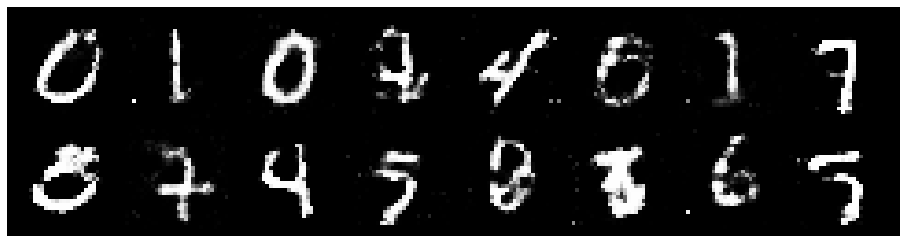

Epoch: [95/200], Batch Num: [400/600]
Discriminator Loss: 1.3481, Generator Loss: 0.7888
D(x): 0.5859, D(G(z)): 0.5057


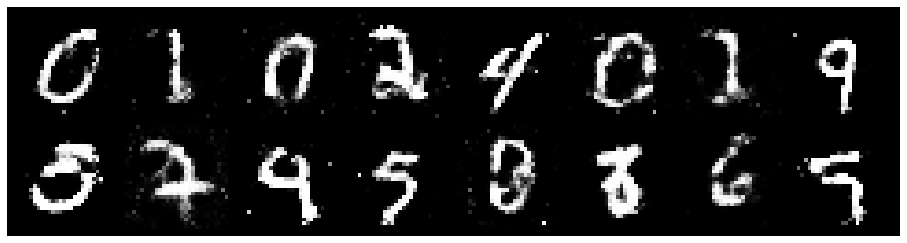

Epoch: [95/200], Batch Num: [500/600]
Discriminator Loss: 1.2290, Generator Loss: 0.8745
D(x): 0.5630, D(G(z)): 0.4423


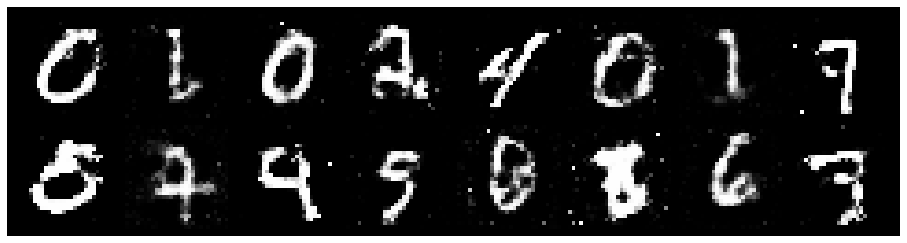

Epoch: [96/200], Batch Num: [0/600]
Discriminator Loss: 1.2110, Generator Loss: 0.9681
D(x): 0.5911, D(G(z)): 0.4340


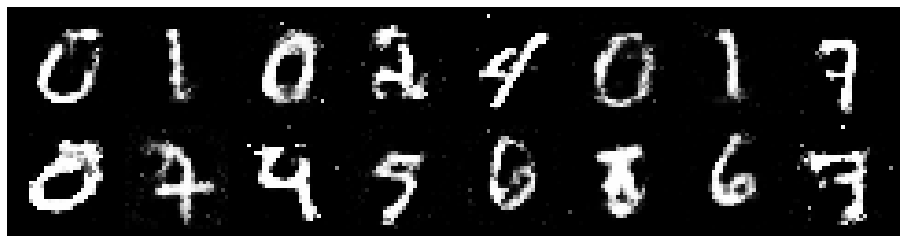

Epoch: [96/200], Batch Num: [100/600]
Discriminator Loss: 1.2277, Generator Loss: 0.8596
D(x): 0.5659, D(G(z)): 0.4286


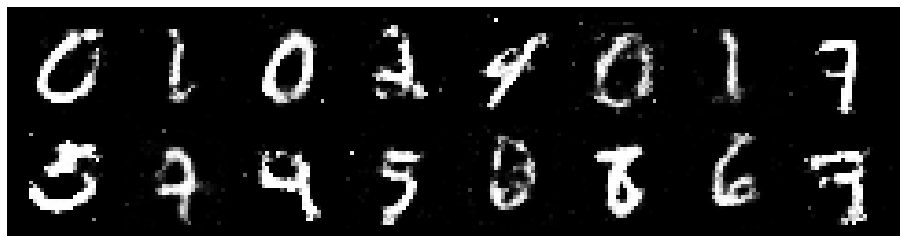

Epoch: [96/200], Batch Num: [200/600]
Discriminator Loss: 1.2228, Generator Loss: 0.9335
D(x): 0.5405, D(G(z)): 0.4087


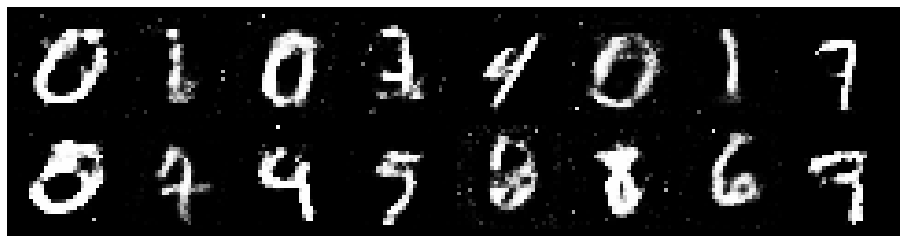

Epoch: [96/200], Batch Num: [300/600]
Discriminator Loss: 1.2486, Generator Loss: 0.8439
D(x): 0.5587, D(G(z)): 0.4323


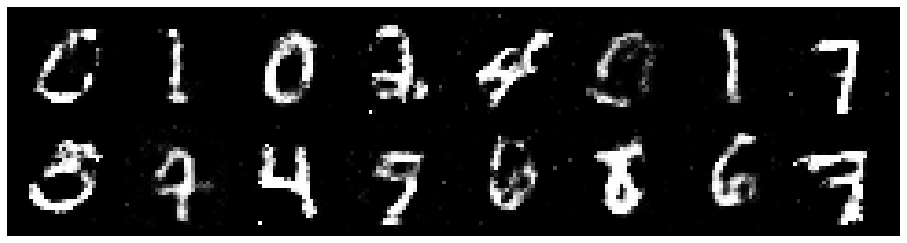

Epoch: [96/200], Batch Num: [400/600]
Discriminator Loss: 1.1649, Generator Loss: 0.8706
D(x): 0.6097, D(G(z)): 0.4179


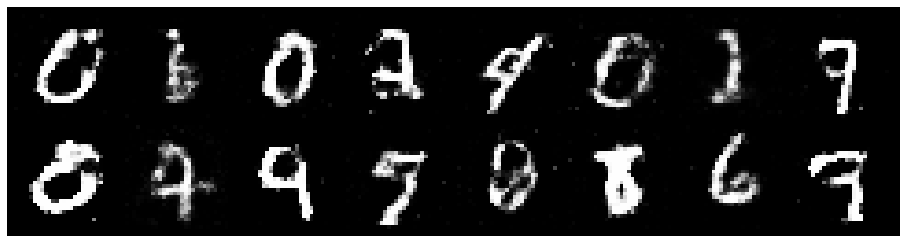

Epoch: [96/200], Batch Num: [500/600]
Discriminator Loss: 1.1332, Generator Loss: 0.9989
D(x): 0.5657, D(G(z)): 0.3698


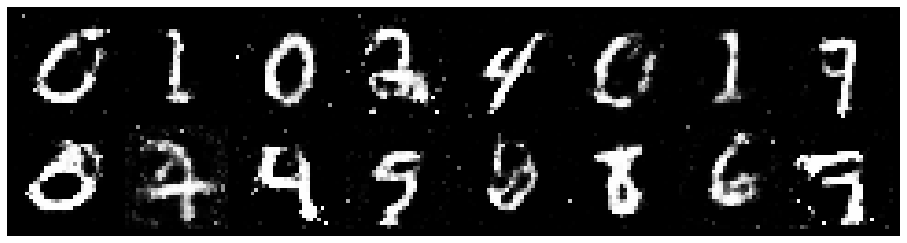

Epoch: [97/200], Batch Num: [0/600]
Discriminator Loss: 1.2242, Generator Loss: 0.7991
D(x): 0.5954, D(G(z)): 0.4608


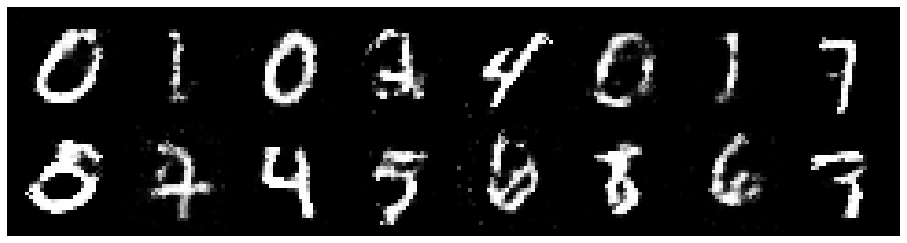

Epoch: [97/200], Batch Num: [100/600]
Discriminator Loss: 1.1185, Generator Loss: 1.0030
D(x): 0.5861, D(G(z)): 0.4009


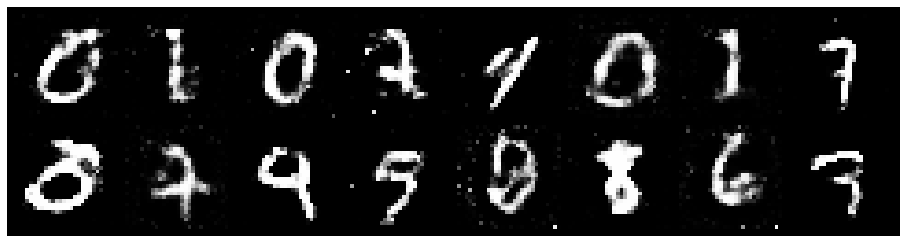

Epoch: [97/200], Batch Num: [200/600]
Discriminator Loss: 1.2915, Generator Loss: 0.9234
D(x): 0.5346, D(G(z)): 0.4405


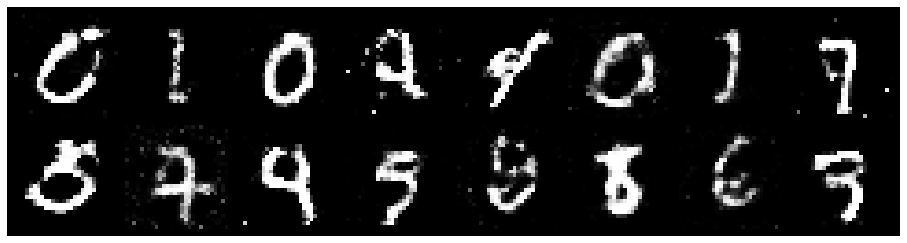

Epoch: [97/200], Batch Num: [300/600]
Discriminator Loss: 1.1221, Generator Loss: 1.1994
D(x): 0.5682, D(G(z)): 0.3599


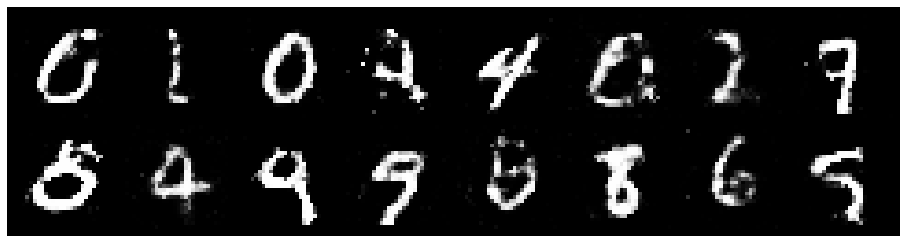

Epoch: [97/200], Batch Num: [400/600]
Discriminator Loss: 1.1517, Generator Loss: 0.9887
D(x): 0.5814, D(G(z)): 0.4044


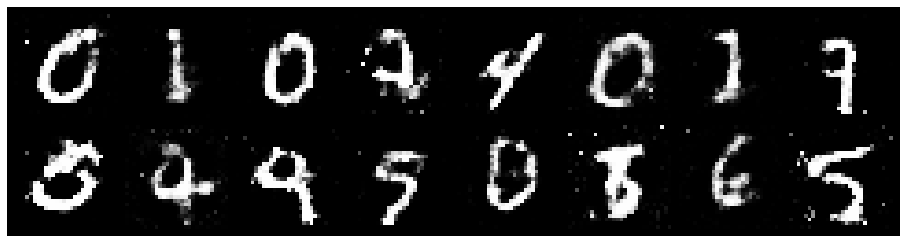

Epoch: [97/200], Batch Num: [500/600]
Discriminator Loss: 1.1547, Generator Loss: 0.9285
D(x): 0.5965, D(G(z)): 0.4281


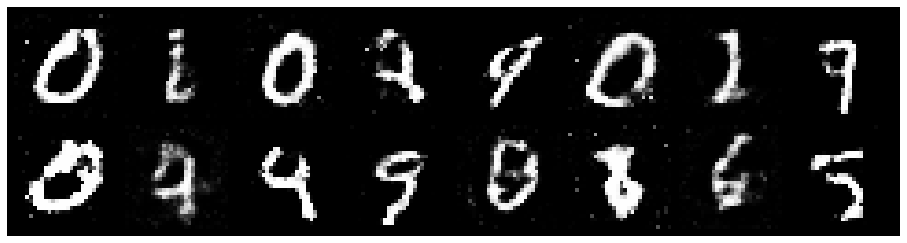

Epoch: [98/200], Batch Num: [0/600]
Discriminator Loss: 1.2867, Generator Loss: 0.7888
D(x): 0.5522, D(G(z)): 0.4681


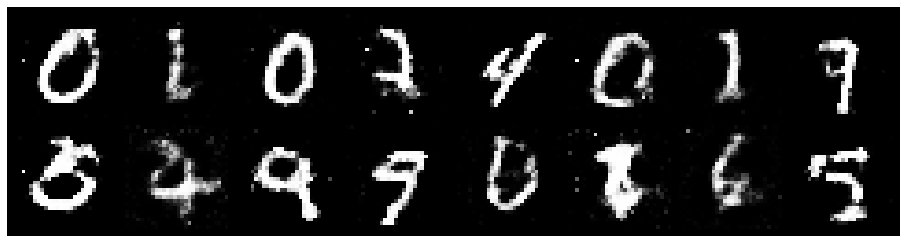

Epoch: [98/200], Batch Num: [100/600]
Discriminator Loss: 1.3117, Generator Loss: 0.8253
D(x): 0.5727, D(G(z)): 0.4637


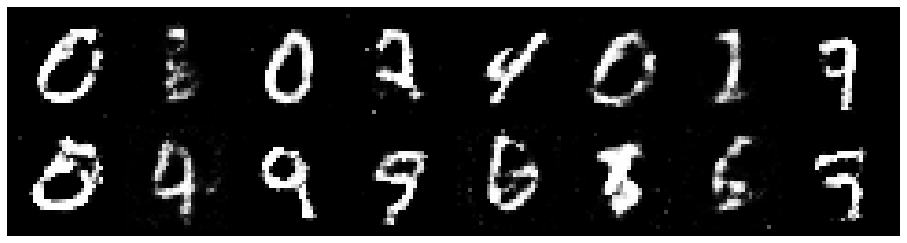

Epoch: [98/200], Batch Num: [200/600]
Discriminator Loss: 1.2135, Generator Loss: 0.9286
D(x): 0.5854, D(G(z)): 0.4428


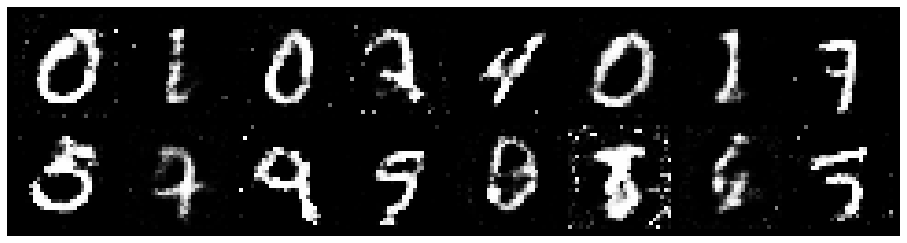

Epoch: [98/200], Batch Num: [300/600]
Discriminator Loss: 1.3237, Generator Loss: 0.8391
D(x): 0.5103, D(G(z)): 0.4133


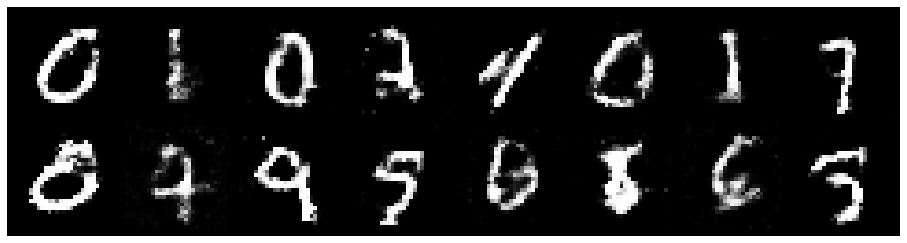

Epoch: [98/200], Batch Num: [400/600]
Discriminator Loss: 1.2116, Generator Loss: 0.8700
D(x): 0.5733, D(G(z)): 0.4314


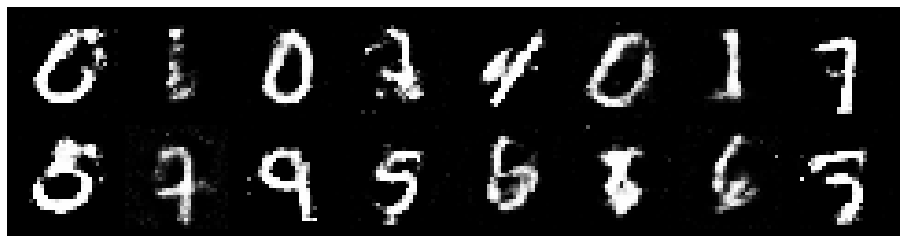

Epoch: [98/200], Batch Num: [500/600]
Discriminator Loss: 1.3725, Generator Loss: 0.8092
D(x): 0.4895, D(G(z)): 0.4324


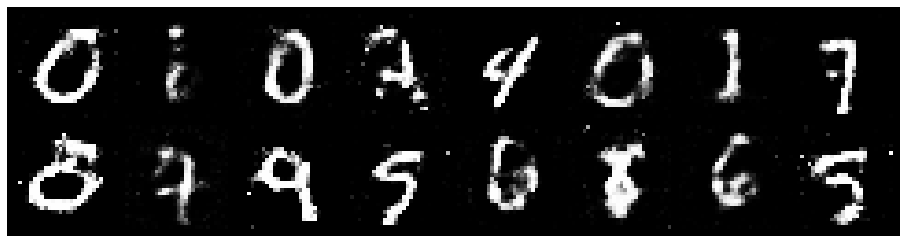

Epoch: [99/200], Batch Num: [0/600]
Discriminator Loss: 1.2786, Generator Loss: 1.0266
D(x): 0.5426, D(G(z)): 0.4166


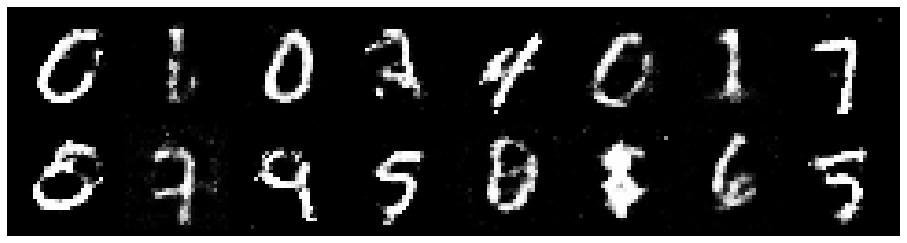

Epoch: [99/200], Batch Num: [100/600]
Discriminator Loss: 1.2288, Generator Loss: 0.9004
D(x): 0.5946, D(G(z)): 0.4605


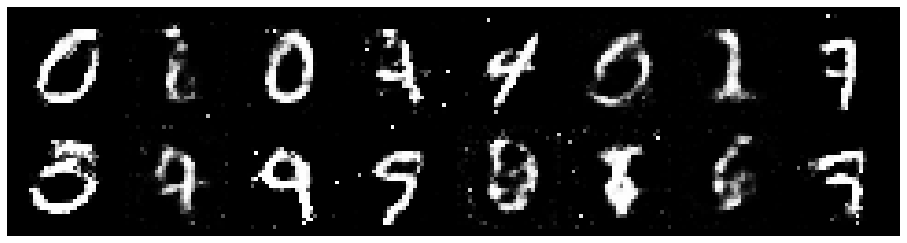

Epoch: [99/200], Batch Num: [200/600]
Discriminator Loss: 1.1245, Generator Loss: 0.9080
D(x): 0.6165, D(G(z)): 0.4229


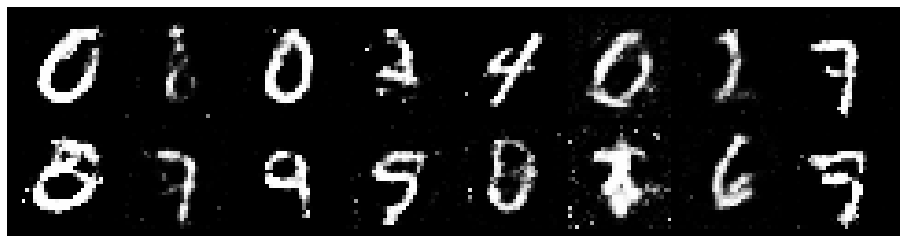

Epoch: [99/200], Batch Num: [300/600]
Discriminator Loss: 1.3259, Generator Loss: 0.8660
D(x): 0.5538, D(G(z)): 0.4635


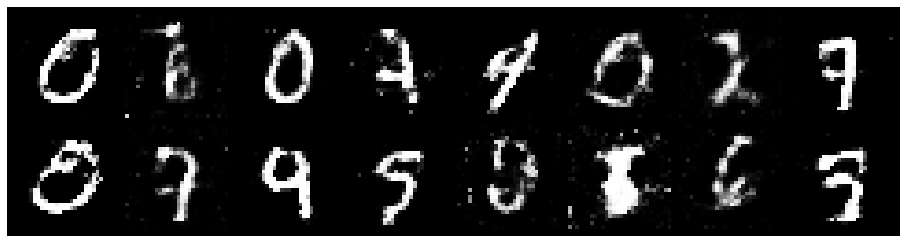

Epoch: [99/200], Batch Num: [400/600]
Discriminator Loss: 1.1096, Generator Loss: 0.9454
D(x): 0.6050, D(G(z)): 0.4032


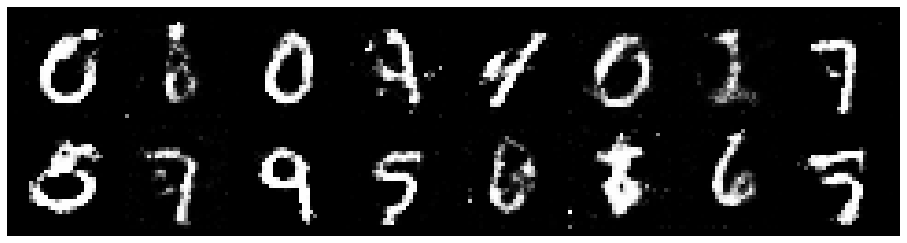

Epoch: [99/200], Batch Num: [500/600]
Discriminator Loss: 1.2590, Generator Loss: 0.8799
D(x): 0.5492, D(G(z)): 0.4309


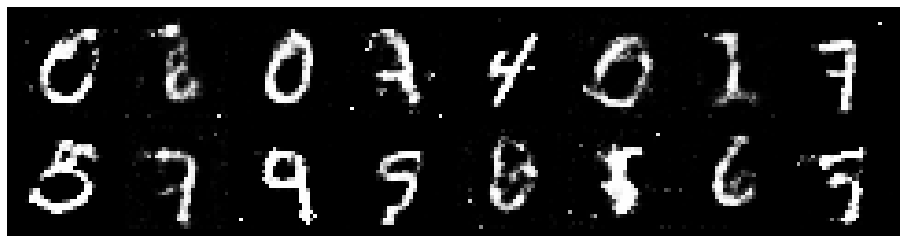

Epoch: [100/200], Batch Num: [0/600]
Discriminator Loss: 1.2287, Generator Loss: 0.8640
D(x): 0.5681, D(G(z)): 0.4370


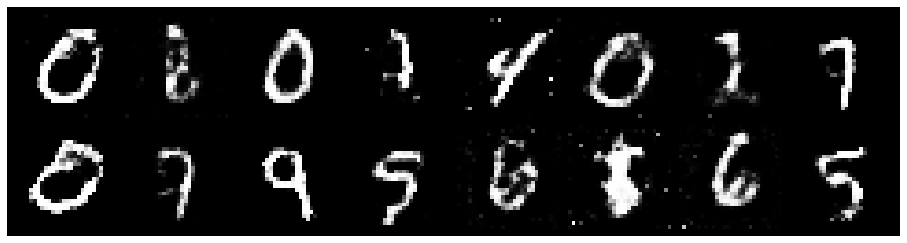

Epoch: [100/200], Batch Num: [100/600]
Discriminator Loss: 1.2462, Generator Loss: 0.8493
D(x): 0.5785, D(G(z)): 0.4444


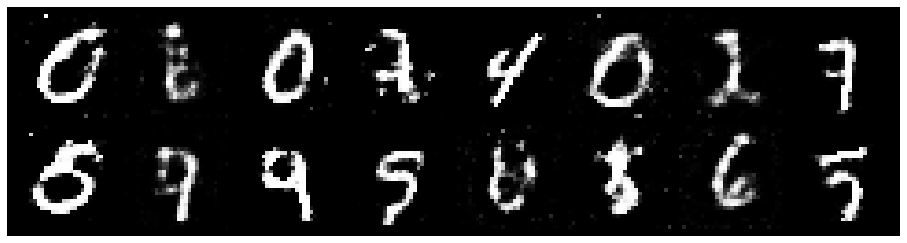

Epoch: [100/200], Batch Num: [200/600]
Discriminator Loss: 1.3035, Generator Loss: 0.9009
D(x): 0.5645, D(G(z)): 0.4453


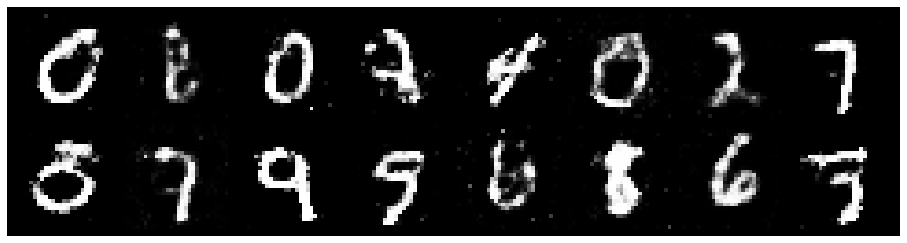

Epoch: [100/200], Batch Num: [300/600]
Discriminator Loss: 1.2031, Generator Loss: 0.8967
D(x): 0.5493, D(G(z)): 0.4146


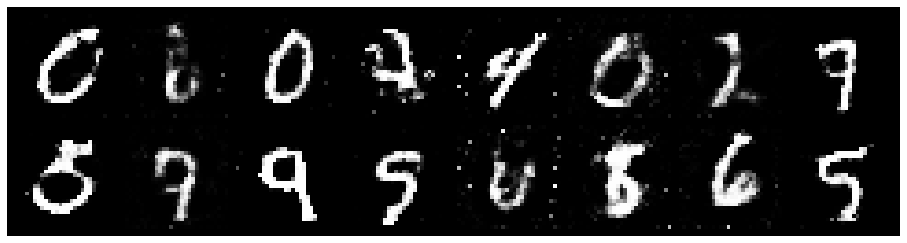

Epoch: [100/200], Batch Num: [400/600]
Discriminator Loss: 1.2765, Generator Loss: 0.9517
D(x): 0.5445, D(G(z)): 0.4439


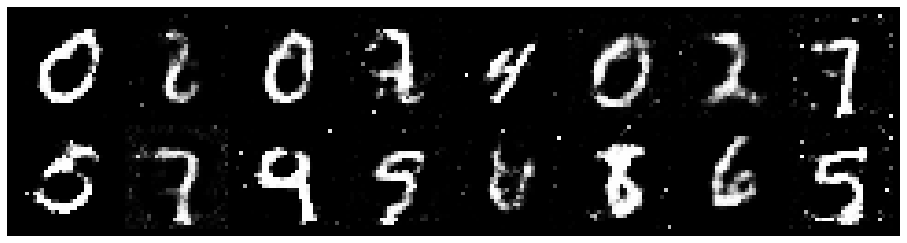

Epoch: [100/200], Batch Num: [500/600]
Discriminator Loss: 1.2432, Generator Loss: 0.8864
D(x): 0.5402, D(G(z)): 0.4296


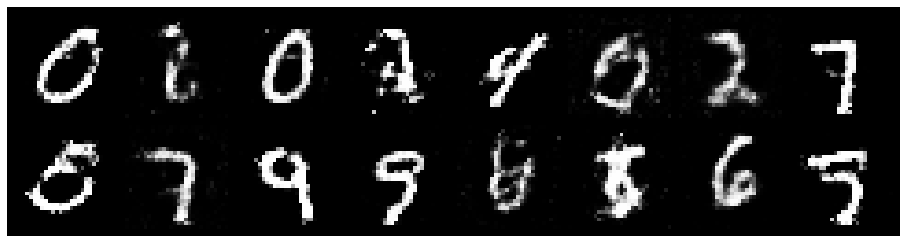

Epoch: [101/200], Batch Num: [0/600]
Discriminator Loss: 1.2922, Generator Loss: 0.8787
D(x): 0.5399, D(G(z)): 0.4533


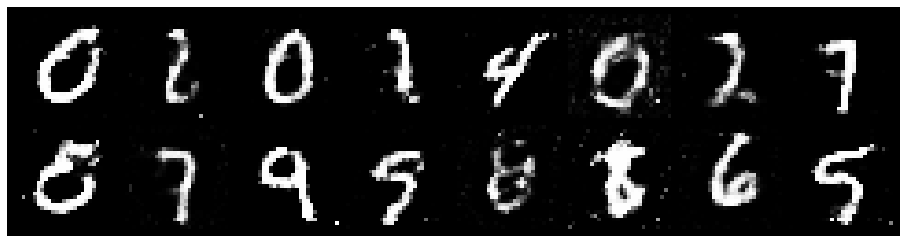

Epoch: [101/200], Batch Num: [100/600]
Discriminator Loss: 1.3388, Generator Loss: 0.8583
D(x): 0.5870, D(G(z)): 0.4856


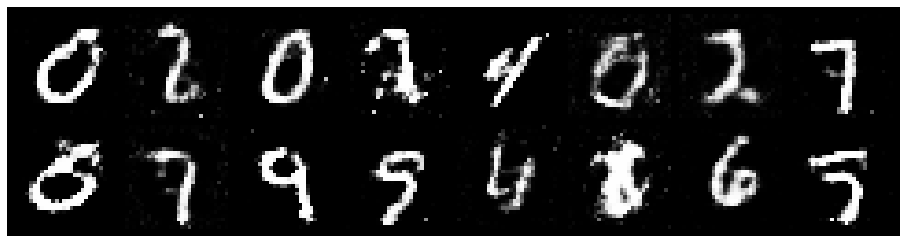

Epoch: [101/200], Batch Num: [200/600]
Discriminator Loss: 1.4097, Generator Loss: 0.9044
D(x): 0.5870, D(G(z)): 0.4865


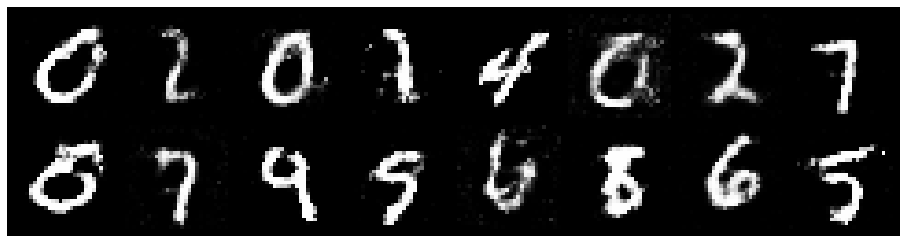

Epoch: [101/200], Batch Num: [300/600]
Discriminator Loss: 1.2691, Generator Loss: 1.0473
D(x): 0.5439, D(G(z)): 0.4257


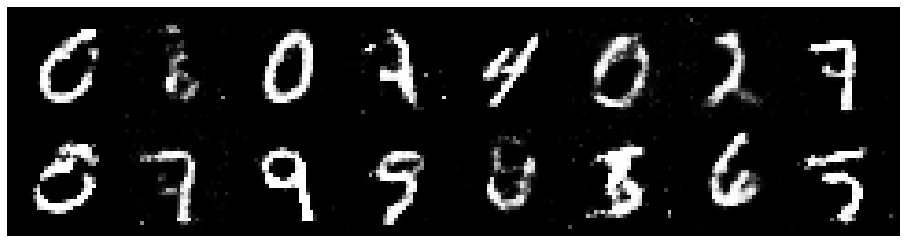

Epoch: [101/200], Batch Num: [400/600]
Discriminator Loss: 1.2814, Generator Loss: 0.8253
D(x): 0.5624, D(G(z)): 0.4707


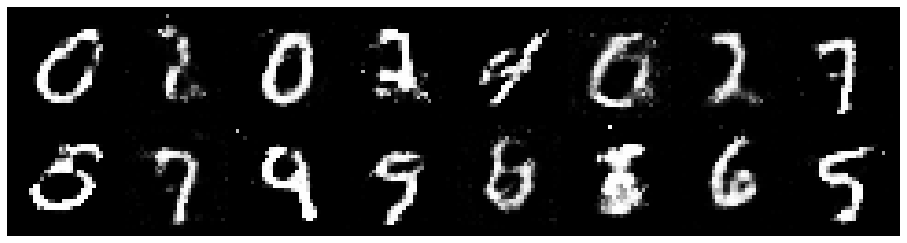

Epoch: [101/200], Batch Num: [500/600]
Discriminator Loss: 1.3098, Generator Loss: 0.8758
D(x): 0.5169, D(G(z)): 0.4350


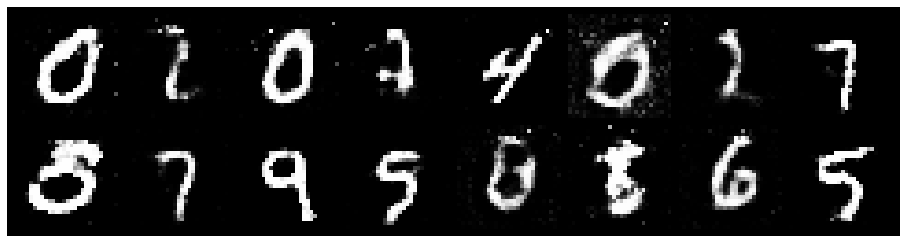

Epoch: [102/200], Batch Num: [0/600]
Discriminator Loss: 1.3905, Generator Loss: 0.8635
D(x): 0.5345, D(G(z)): 0.4707


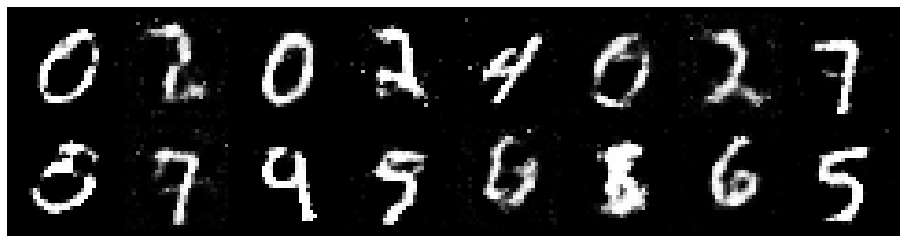

Epoch: [102/200], Batch Num: [100/600]
Discriminator Loss: 1.3034, Generator Loss: 0.8935
D(x): 0.5656, D(G(z)): 0.4670


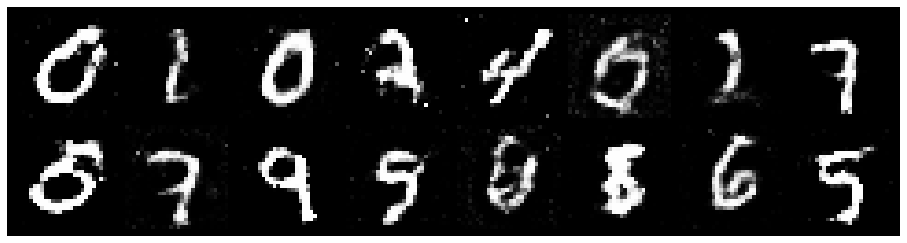

Epoch: [102/200], Batch Num: [200/600]
Discriminator Loss: 1.2319, Generator Loss: 0.9333
D(x): 0.5868, D(G(z)): 0.4322


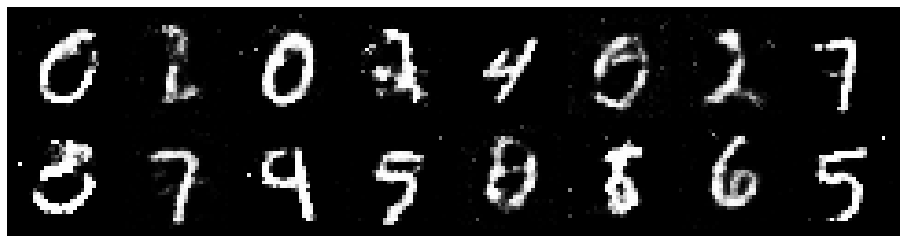

Epoch: [102/200], Batch Num: [300/600]
Discriminator Loss: 1.2042, Generator Loss: 0.9769
D(x): 0.5749, D(G(z)): 0.4060


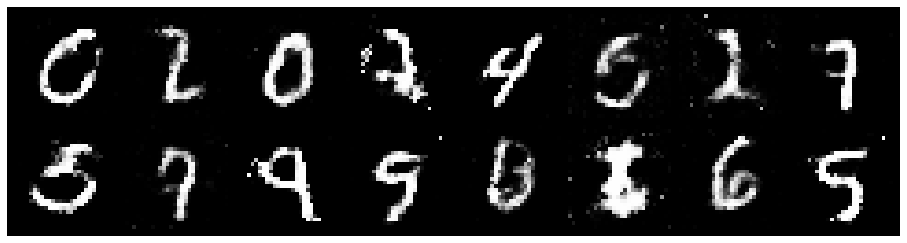

Epoch: [102/200], Batch Num: [400/600]
Discriminator Loss: 1.2170, Generator Loss: 1.0041
D(x): 0.5396, D(G(z)): 0.3995


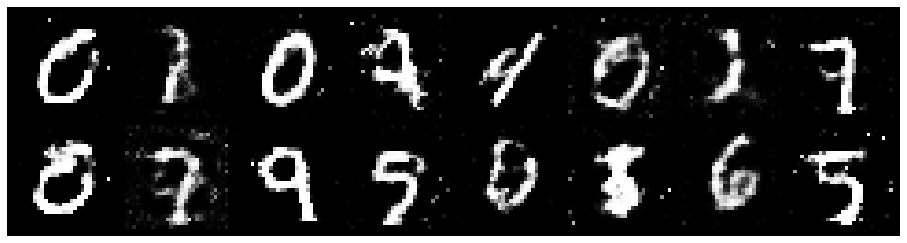

Epoch: [102/200], Batch Num: [500/600]
Discriminator Loss: 1.2247, Generator Loss: 0.9476
D(x): 0.5349, D(G(z)): 0.4119


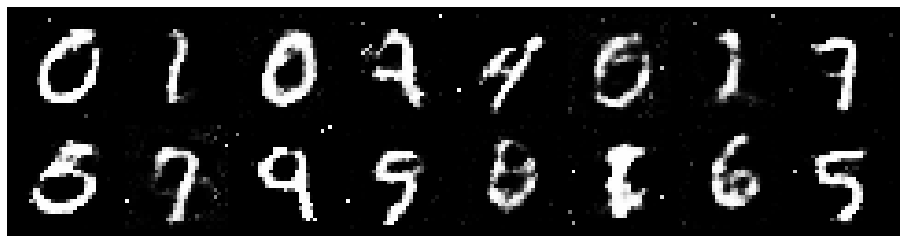

Epoch: [103/200], Batch Num: [0/600]
Discriminator Loss: 1.2322, Generator Loss: 1.0580
D(x): 0.5846, D(G(z)): 0.4210


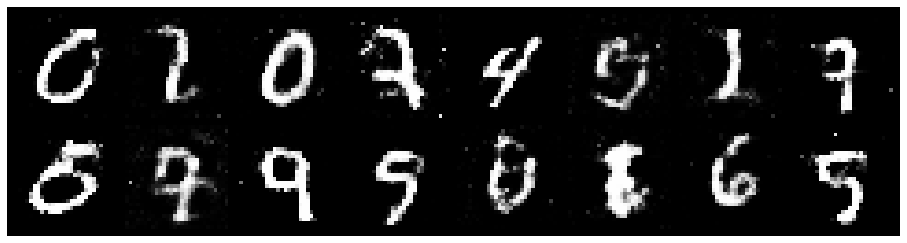

Epoch: [103/200], Batch Num: [100/600]
Discriminator Loss: 1.2266, Generator Loss: 0.9818
D(x): 0.5705, D(G(z)): 0.4050


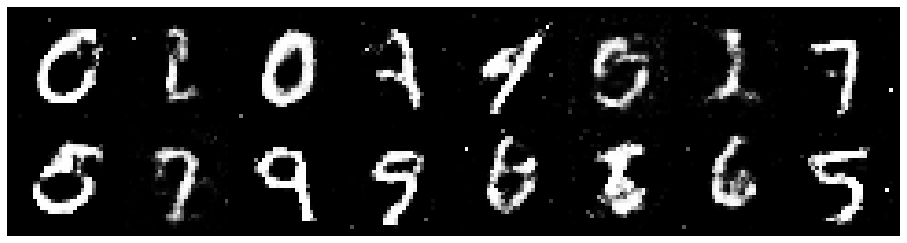

Epoch: [103/200], Batch Num: [200/600]
Discriminator Loss: 1.2140, Generator Loss: 0.9930
D(x): 0.5698, D(G(z)): 0.3992


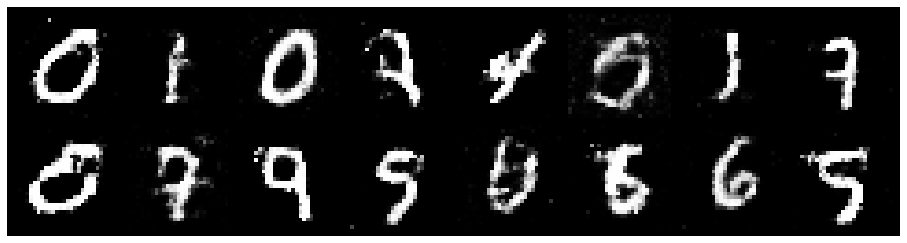

Epoch: [103/200], Batch Num: [300/600]
Discriminator Loss: 1.0925, Generator Loss: 1.1436
D(x): 0.6111, D(G(z)): 0.3693


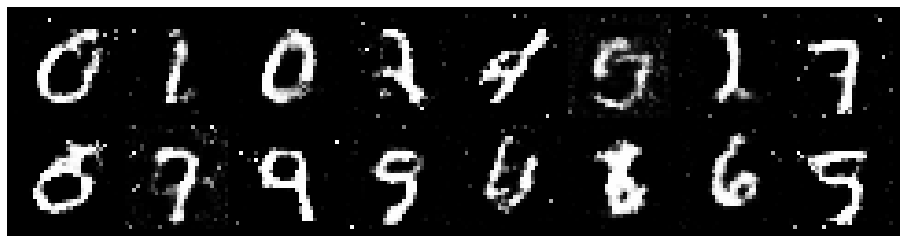

Epoch: [103/200], Batch Num: [400/600]
Discriminator Loss: 1.3462, Generator Loss: 0.9383
D(x): 0.5330, D(G(z)): 0.4454


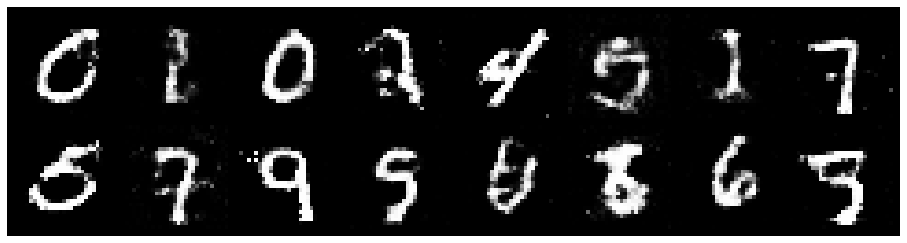

Epoch: [103/200], Batch Num: [500/600]
Discriminator Loss: 1.1938, Generator Loss: 0.8638
D(x): 0.5988, D(G(z)): 0.4438


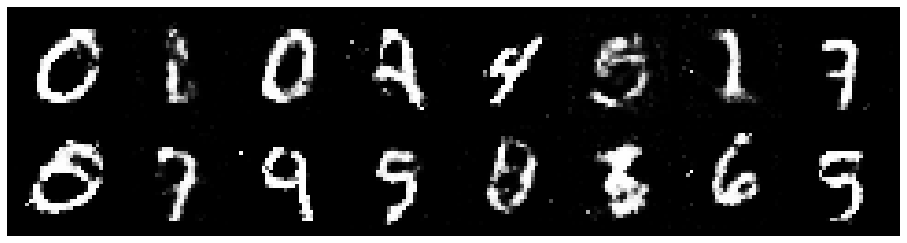

Epoch: [104/200], Batch Num: [0/600]
Discriminator Loss: 1.1559, Generator Loss: 0.8948
D(x): 0.6039, D(G(z)): 0.4484


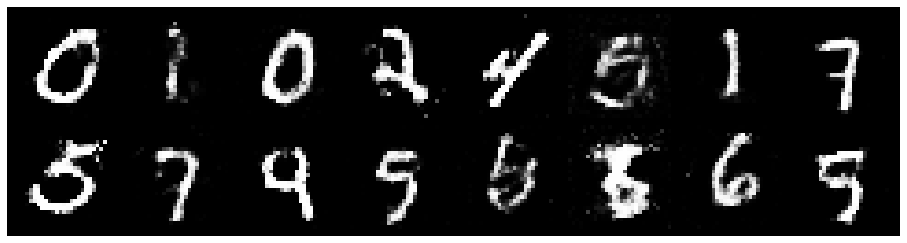

Epoch: [104/200], Batch Num: [100/600]
Discriminator Loss: 1.2047, Generator Loss: 1.1161
D(x): 0.5493, D(G(z)): 0.3777


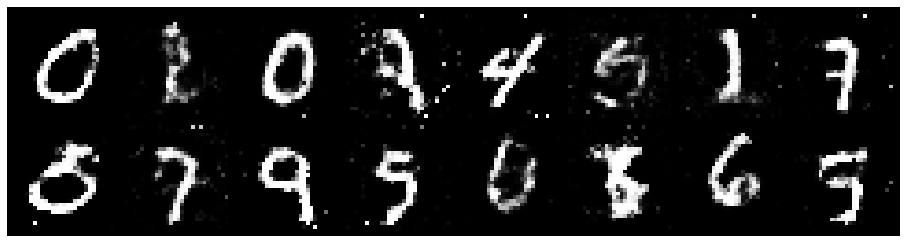

Epoch: [104/200], Batch Num: [200/600]
Discriminator Loss: 1.1930, Generator Loss: 0.9627
D(x): 0.5778, D(G(z)): 0.4231


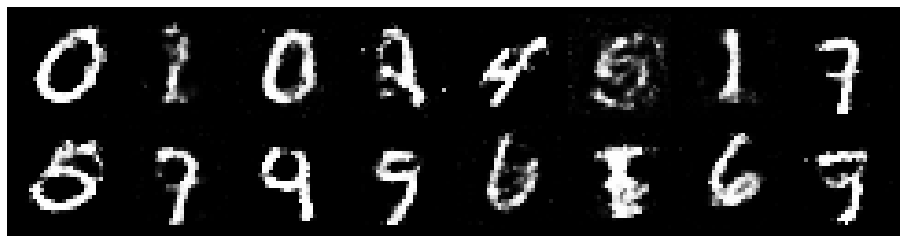

Epoch: [104/200], Batch Num: [300/600]
Discriminator Loss: 1.1029, Generator Loss: 1.2490
D(x): 0.6270, D(G(z)): 0.4116


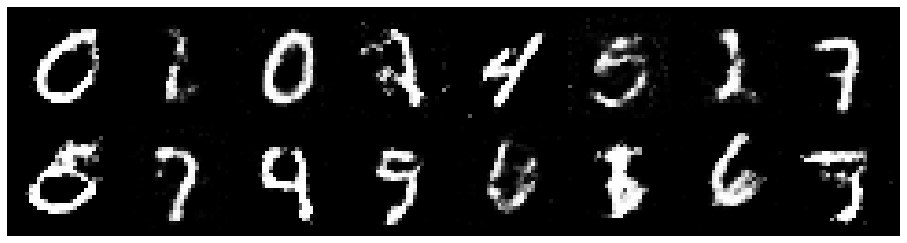

Epoch: [104/200], Batch Num: [400/600]
Discriminator Loss: 1.2292, Generator Loss: 0.9648
D(x): 0.5677, D(G(z)): 0.4351


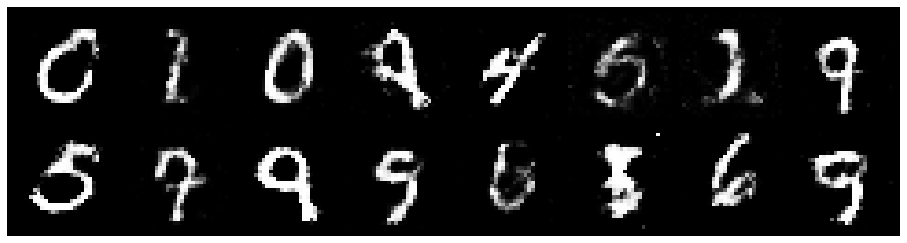

Epoch: [104/200], Batch Num: [500/600]
Discriminator Loss: 1.2708, Generator Loss: 0.9546
D(x): 0.5421, D(G(z)): 0.4297


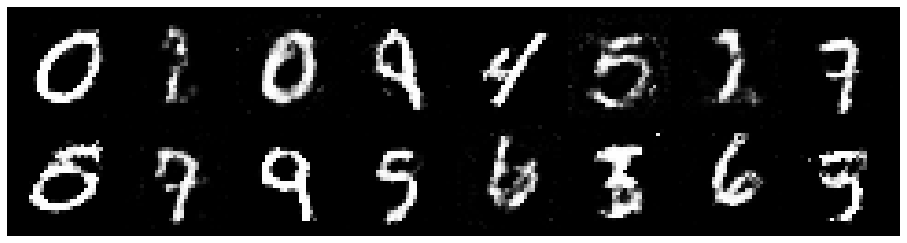

Epoch: [105/200], Batch Num: [0/600]
Discriminator Loss: 1.1938, Generator Loss: 0.9025
D(x): 0.5468, D(G(z)): 0.3966


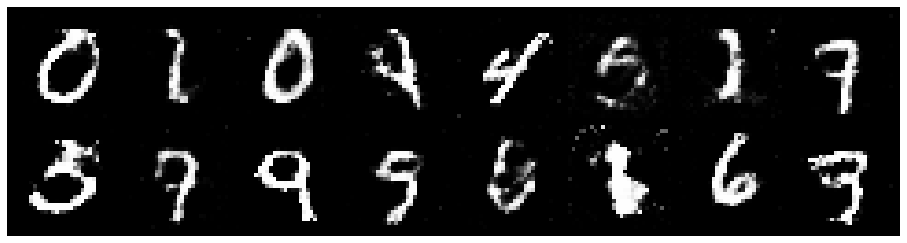

Epoch: [105/200], Batch Num: [100/600]
Discriminator Loss: 1.2844, Generator Loss: 0.9007
D(x): 0.5102, D(G(z)): 0.4170


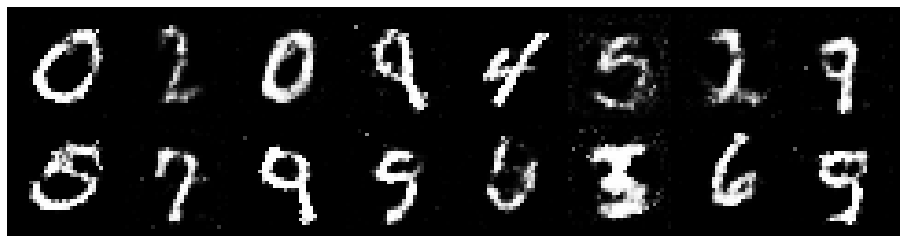

Epoch: [105/200], Batch Num: [200/600]
Discriminator Loss: 1.3964, Generator Loss: 0.9582
D(x): 0.5179, D(G(z)): 0.4482


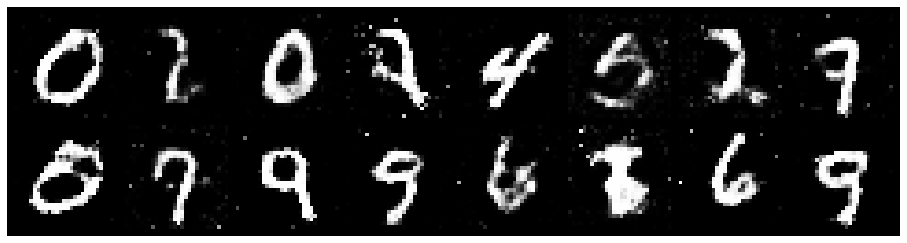

Epoch: [105/200], Batch Num: [300/600]
Discriminator Loss: 1.1240, Generator Loss: 0.8726
D(x): 0.6473, D(G(z)): 0.4260


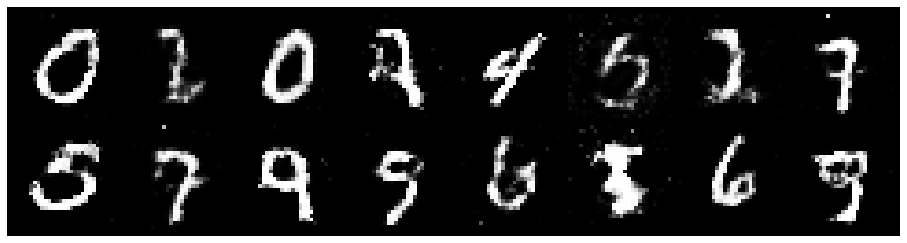

Epoch: [105/200], Batch Num: [400/600]
Discriminator Loss: 1.3001, Generator Loss: 0.9259
D(x): 0.5680, D(G(z)): 0.4532


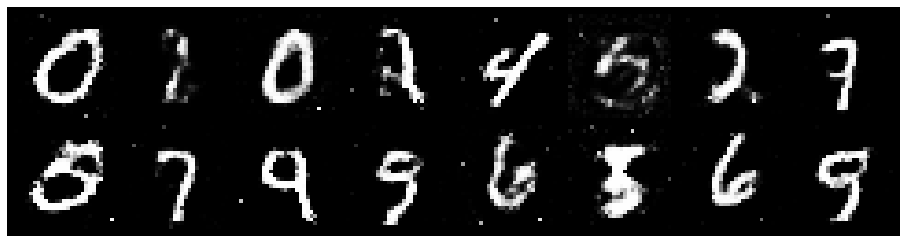

Epoch: [105/200], Batch Num: [500/600]
Discriminator Loss: 1.2921, Generator Loss: 1.0714
D(x): 0.5554, D(G(z)): 0.4364


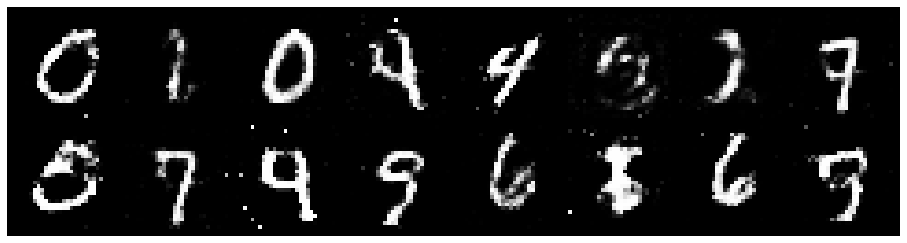

Epoch: [106/200], Batch Num: [0/600]
Discriminator Loss: 1.3027, Generator Loss: 0.9392
D(x): 0.5147, D(G(z)): 0.4399


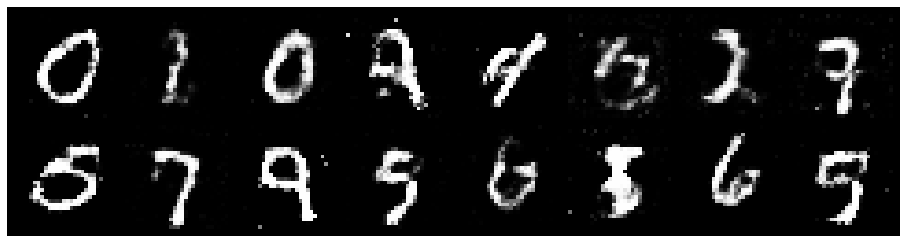

Epoch: [106/200], Batch Num: [100/600]
Discriminator Loss: 1.2595, Generator Loss: 0.9798
D(x): 0.5303, D(G(z)): 0.3864


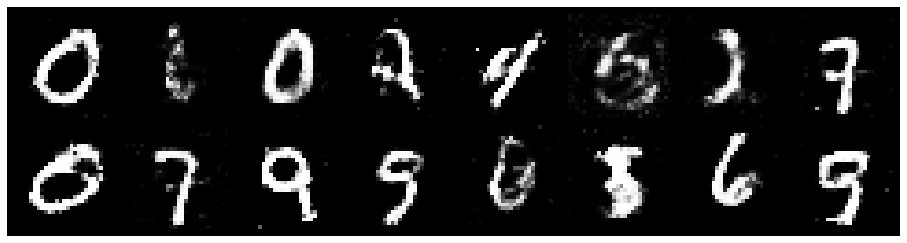

Epoch: [106/200], Batch Num: [200/600]
Discriminator Loss: 1.3637, Generator Loss: 0.8420
D(x): 0.5191, D(G(z)): 0.4609


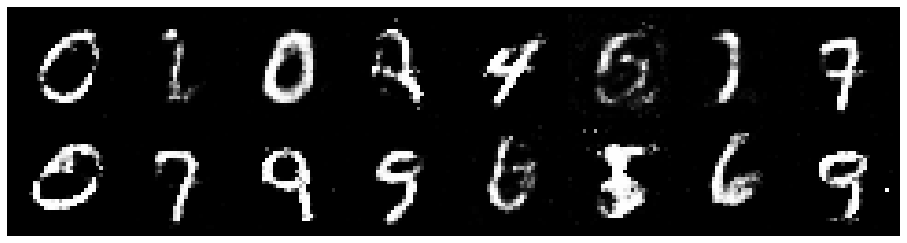

Epoch: [106/200], Batch Num: [300/600]
Discriminator Loss: 1.2572, Generator Loss: 0.9716
D(x): 0.5830, D(G(z)): 0.4390


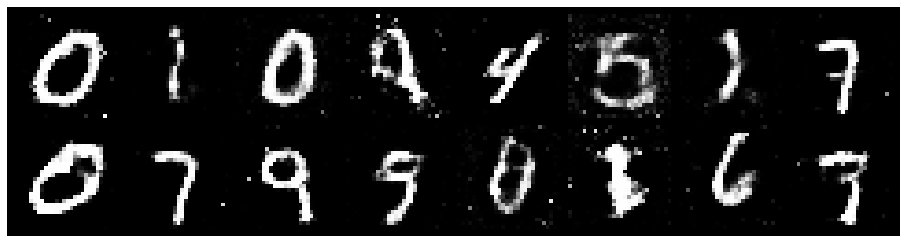

Epoch: [106/200], Batch Num: [400/600]
Discriminator Loss: 1.3423, Generator Loss: 0.8715
D(x): 0.5314, D(G(z)): 0.4349


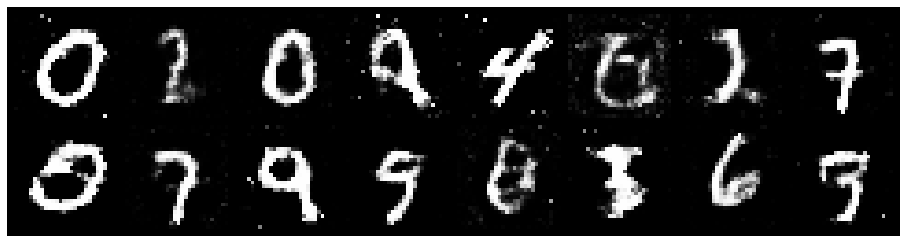

Epoch: [106/200], Batch Num: [500/600]
Discriminator Loss: 1.2509, Generator Loss: 0.9689
D(x): 0.5879, D(G(z)): 0.4391


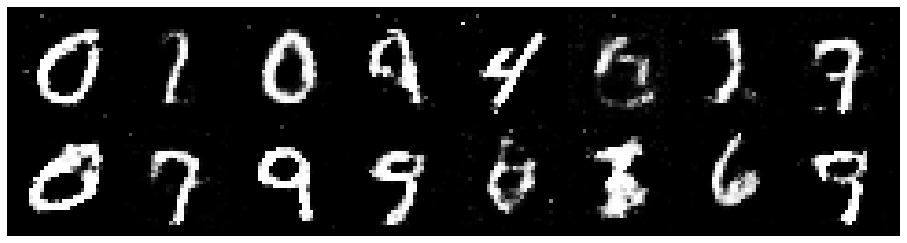

Epoch: [107/200], Batch Num: [0/600]
Discriminator Loss: 1.2994, Generator Loss: 0.9766
D(x): 0.5264, D(G(z)): 0.4202


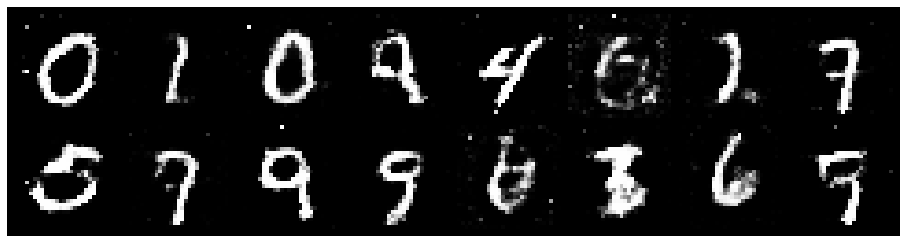

Epoch: [107/200], Batch Num: [100/600]
Discriminator Loss: 1.1593, Generator Loss: 1.0915
D(x): 0.5738, D(G(z)): 0.3965


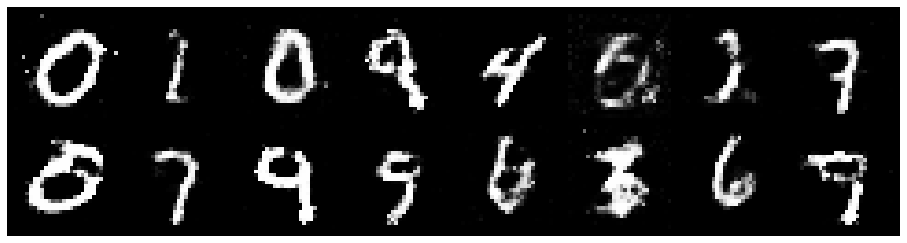

Epoch: [107/200], Batch Num: [200/600]
Discriminator Loss: 1.1679, Generator Loss: 0.9864
D(x): 0.5495, D(G(z)): 0.3868


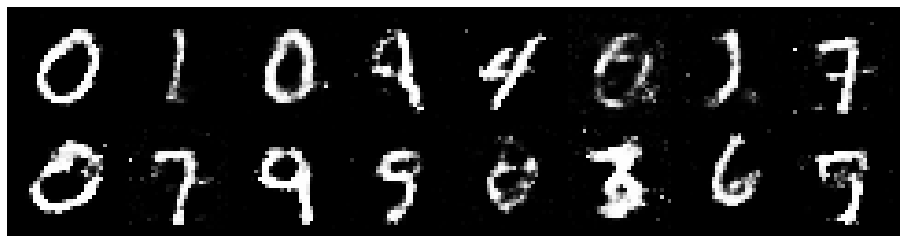

Epoch: [107/200], Batch Num: [300/600]
Discriminator Loss: 1.2539, Generator Loss: 0.9003
D(x): 0.5532, D(G(z)): 0.4409


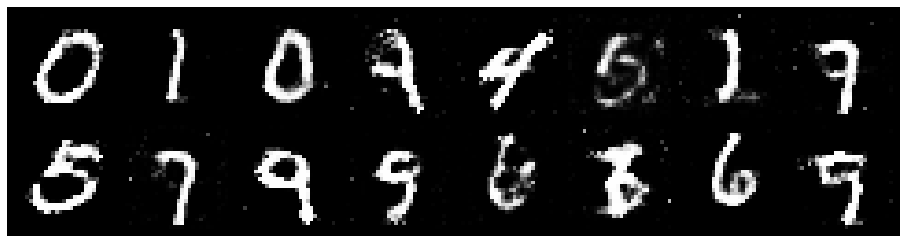

Epoch: [107/200], Batch Num: [400/600]
Discriminator Loss: 1.2479, Generator Loss: 1.0093
D(x): 0.5442, D(G(z)): 0.3767


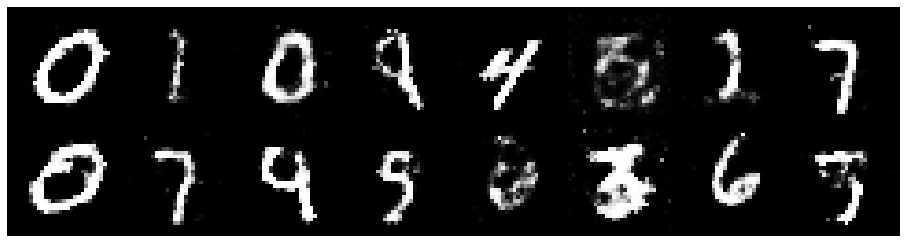

Epoch: [107/200], Batch Num: [500/600]
Discriminator Loss: 1.1481, Generator Loss: 0.8744
D(x): 0.5937, D(G(z)): 0.4112


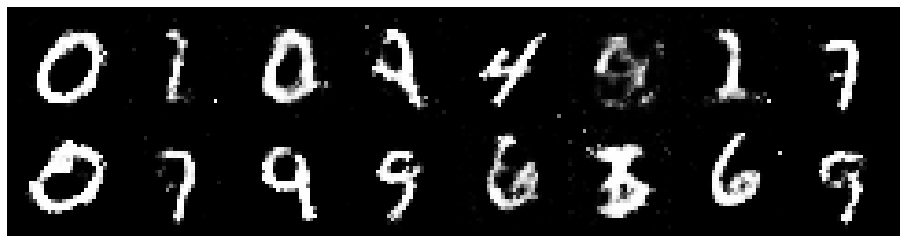

Epoch: [108/200], Batch Num: [0/600]
Discriminator Loss: 1.1755, Generator Loss: 0.9568
D(x): 0.5595, D(G(z)): 0.4021


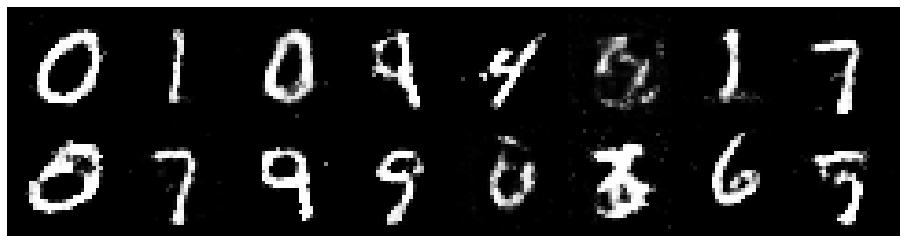

Epoch: [108/200], Batch Num: [100/600]
Discriminator Loss: 1.2829, Generator Loss: 0.8139
D(x): 0.5459, D(G(z)): 0.4461


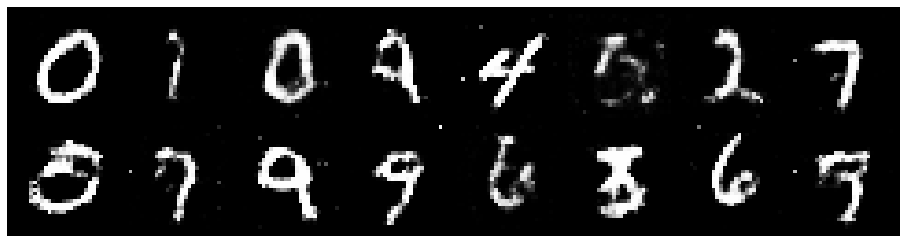

Epoch: [108/200], Batch Num: [200/600]
Discriminator Loss: 1.1887, Generator Loss: 0.9394
D(x): 0.5773, D(G(z)): 0.4226


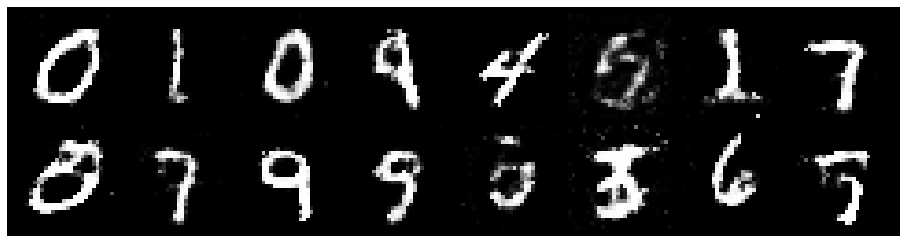

Epoch: [108/200], Batch Num: [300/600]
Discriminator Loss: 1.2335, Generator Loss: 0.8636
D(x): 0.5868, D(G(z)): 0.4512


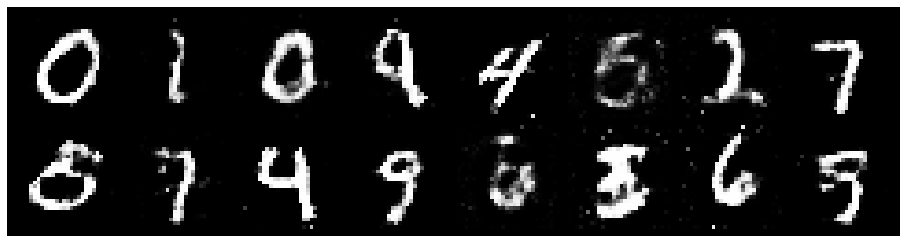

Epoch: [108/200], Batch Num: [400/600]
Discriminator Loss: 1.2594, Generator Loss: 0.9861
D(x): 0.5422, D(G(z)): 0.4123


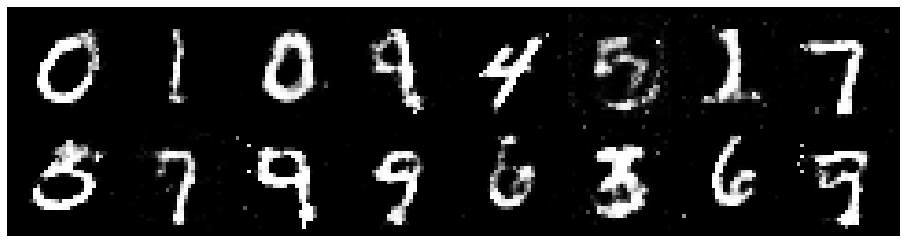

Epoch: [108/200], Batch Num: [500/600]
Discriminator Loss: 1.3267, Generator Loss: 0.8599
D(x): 0.5623, D(G(z)): 0.4635


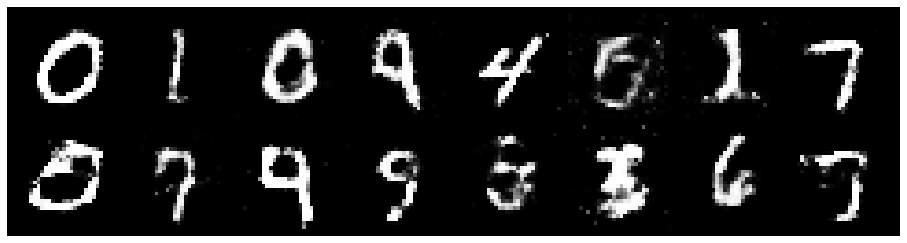

Epoch: [109/200], Batch Num: [0/600]
Discriminator Loss: 1.2105, Generator Loss: 0.9125
D(x): 0.6022, D(G(z)): 0.4294


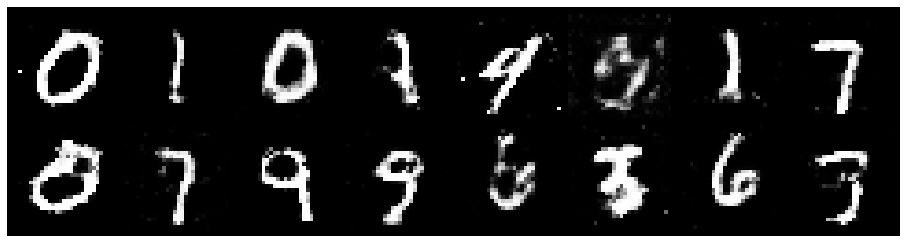

Epoch: [109/200], Batch Num: [100/600]
Discriminator Loss: 1.2222, Generator Loss: 0.9390
D(x): 0.5879, D(G(z)): 0.4383


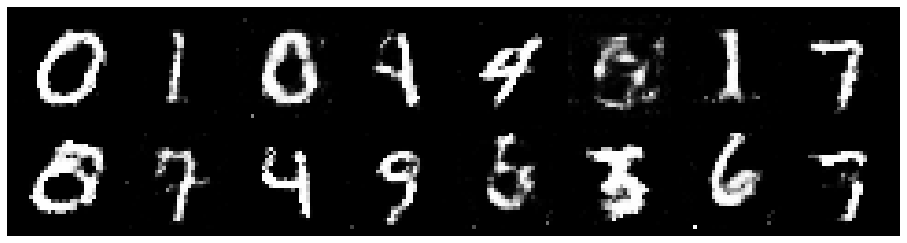

Epoch: [109/200], Batch Num: [200/600]
Discriminator Loss: 1.2419, Generator Loss: 0.8500
D(x): 0.5623, D(G(z)): 0.4400


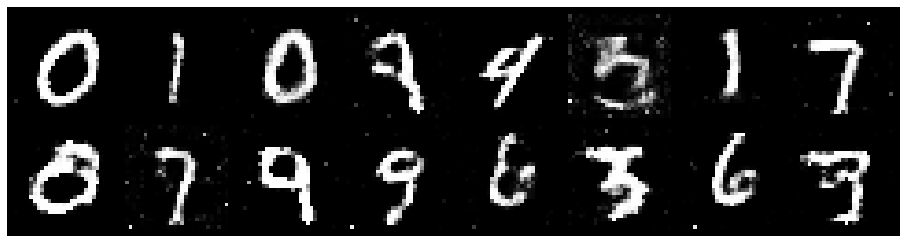

Epoch: [109/200], Batch Num: [300/600]
Discriminator Loss: 1.2544, Generator Loss: 0.7984
D(x): 0.5611, D(G(z)): 0.4400


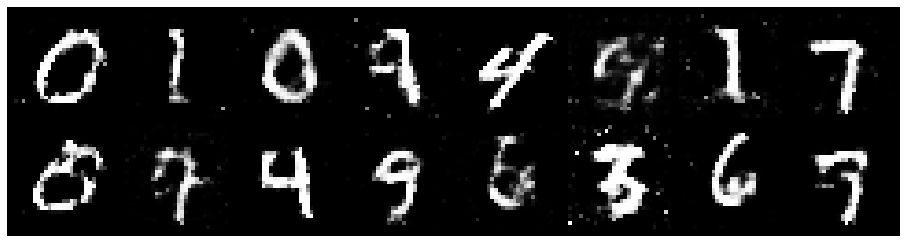

Epoch: [109/200], Batch Num: [400/600]
Discriminator Loss: 1.1676, Generator Loss: 0.9849
D(x): 0.5863, D(G(z)): 0.4115


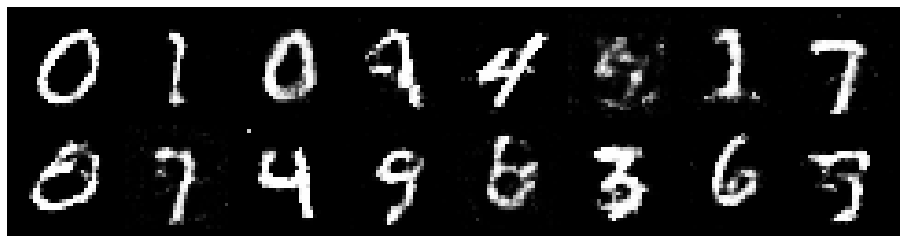

Epoch: [109/200], Batch Num: [500/600]
Discriminator Loss: 1.2785, Generator Loss: 0.9797
D(x): 0.5301, D(G(z)): 0.4259


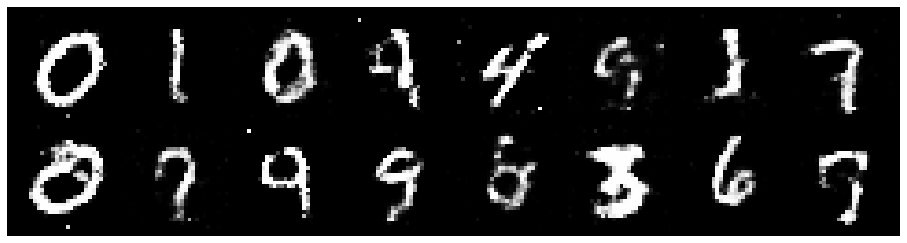

Epoch: [110/200], Batch Num: [0/600]
Discriminator Loss: 1.2346, Generator Loss: 0.9861
D(x): 0.5577, D(G(z)): 0.4256


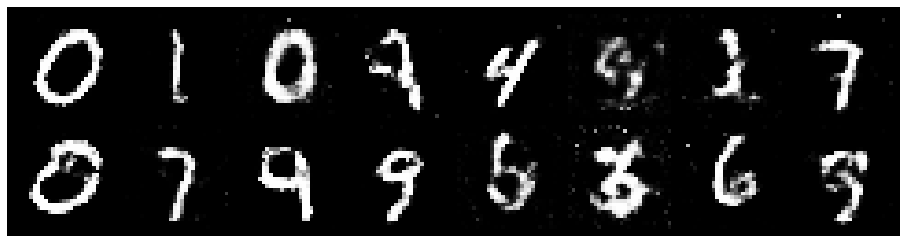

Epoch: [110/200], Batch Num: [100/600]
Discriminator Loss: 1.2014, Generator Loss: 1.0085
D(x): 0.5890, D(G(z)): 0.4244


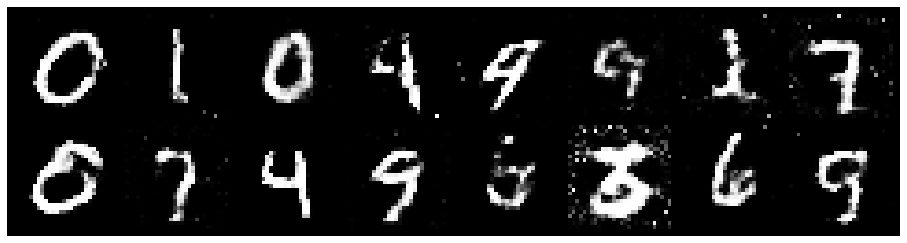

Epoch: [110/200], Batch Num: [200/600]
Discriminator Loss: 1.2417, Generator Loss: 1.0345
D(x): 0.5656, D(G(z)): 0.4471


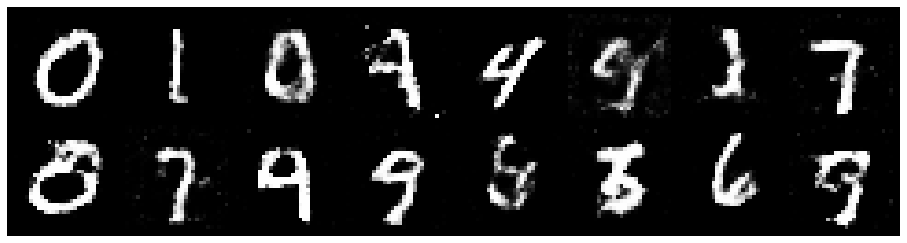

Epoch: [110/200], Batch Num: [300/600]
Discriminator Loss: 1.3344, Generator Loss: 0.9901
D(x): 0.5398, D(G(z)): 0.4180


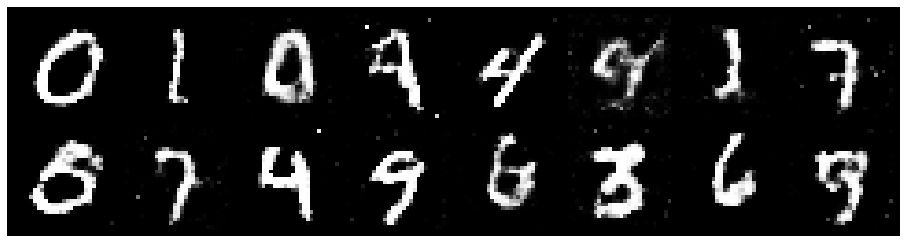

Epoch: [110/200], Batch Num: [400/600]
Discriminator Loss: 1.1839, Generator Loss: 0.9489
D(x): 0.5560, D(G(z)): 0.3936


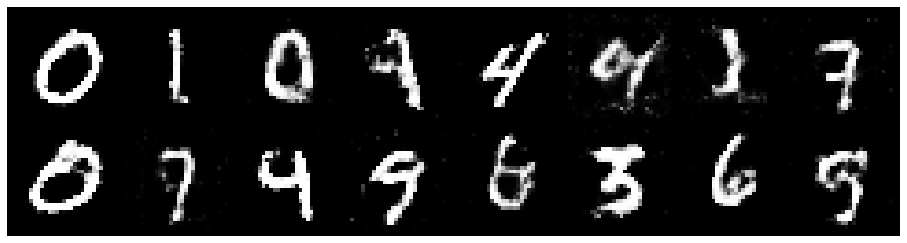

Epoch: [110/200], Batch Num: [500/600]
Discriminator Loss: 1.1787, Generator Loss: 0.8607
D(x): 0.6484, D(G(z)): 0.4674


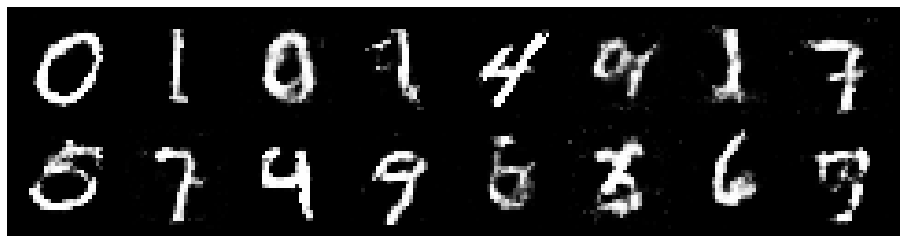

Epoch: [111/200], Batch Num: [0/600]
Discriminator Loss: 1.2628, Generator Loss: 0.8610
D(x): 0.5532, D(G(z)): 0.4430


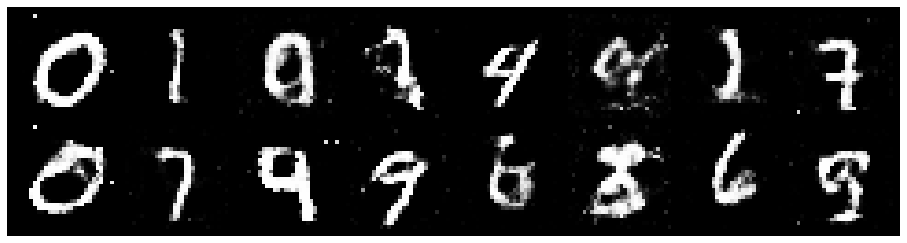

Epoch: [111/200], Batch Num: [100/600]
Discriminator Loss: 1.1171, Generator Loss: 0.9369
D(x): 0.5909, D(G(z)): 0.3947


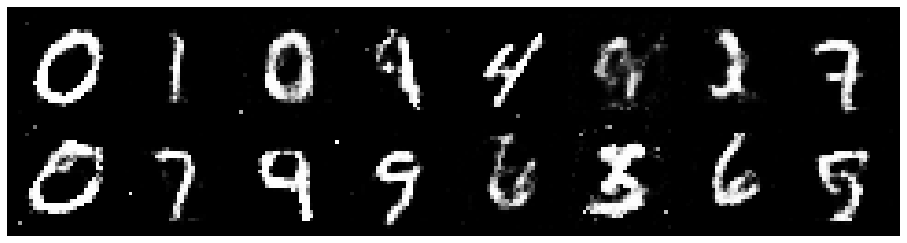

Epoch: [111/200], Batch Num: [200/600]
Discriminator Loss: 1.2343, Generator Loss: 0.9795
D(x): 0.5713, D(G(z)): 0.4304


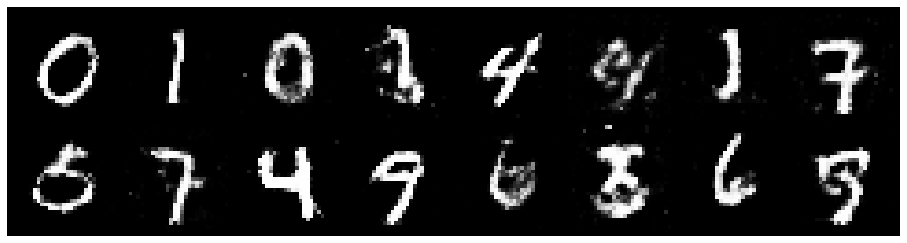

Epoch: [111/200], Batch Num: [300/600]
Discriminator Loss: 1.2376, Generator Loss: 0.9027
D(x): 0.5547, D(G(z)): 0.4295


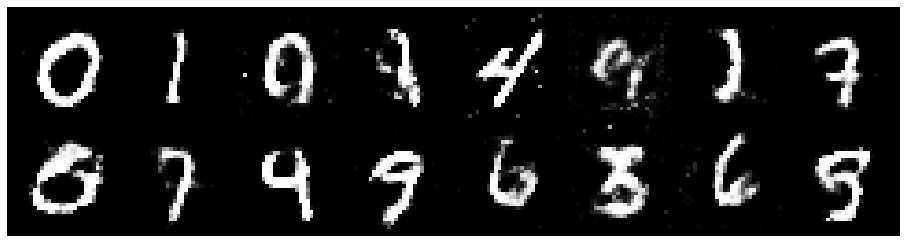

Epoch: [111/200], Batch Num: [400/600]
Discriminator Loss: 1.2579, Generator Loss: 0.9352
D(x): 0.5823, D(G(z)): 0.4248


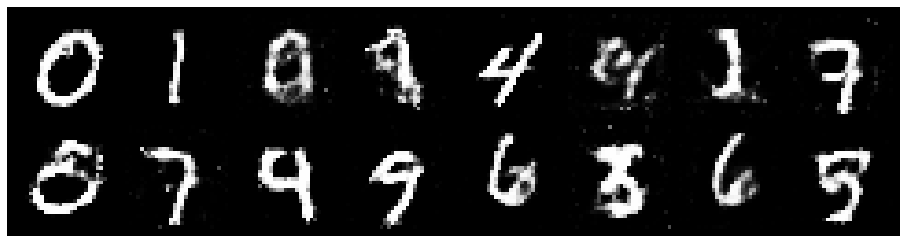

Epoch: [111/200], Batch Num: [500/600]
Discriminator Loss: 1.2331, Generator Loss: 1.0232
D(x): 0.5883, D(G(z)): 0.4511


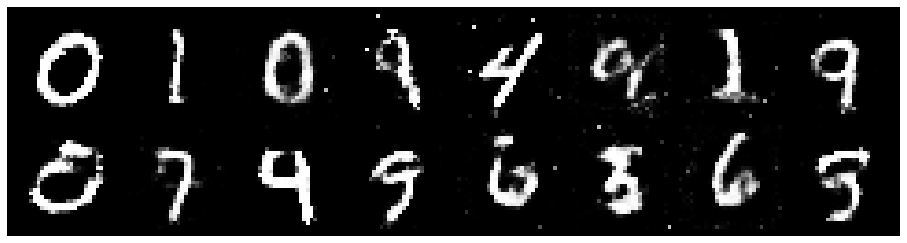

Epoch: [112/200], Batch Num: [0/600]
Discriminator Loss: 1.2167, Generator Loss: 0.8621
D(x): 0.5746, D(G(z)): 0.4318


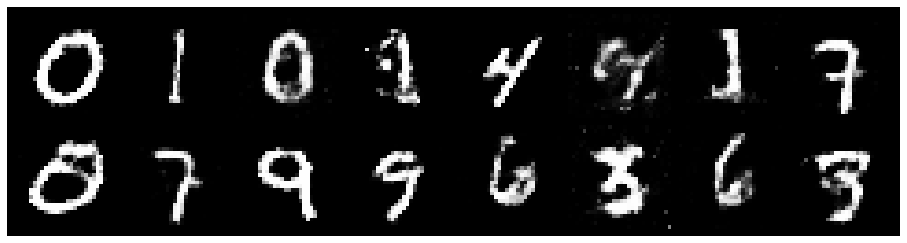

Epoch: [112/200], Batch Num: [100/600]
Discriminator Loss: 1.3944, Generator Loss: 0.8724
D(x): 0.5288, D(G(z)): 0.4671


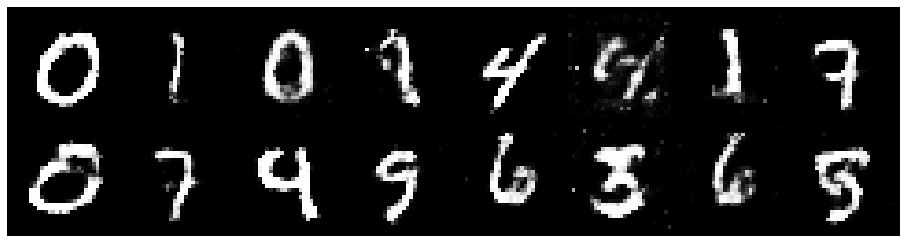

Epoch: [112/200], Batch Num: [200/600]
Discriminator Loss: 1.1348, Generator Loss: 1.0879
D(x): 0.5893, D(G(z)): 0.3931


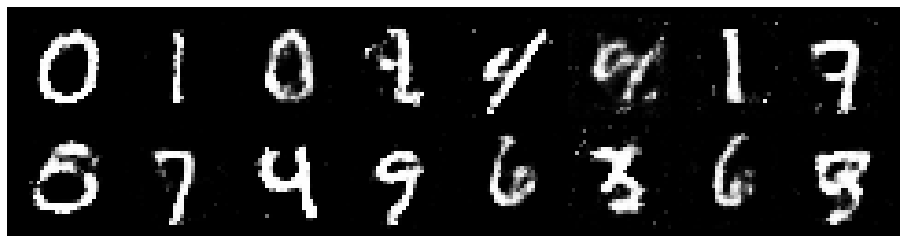

Epoch: [112/200], Batch Num: [300/600]
Discriminator Loss: 1.3014, Generator Loss: 0.8798
D(x): 0.5165, D(G(z)): 0.4451


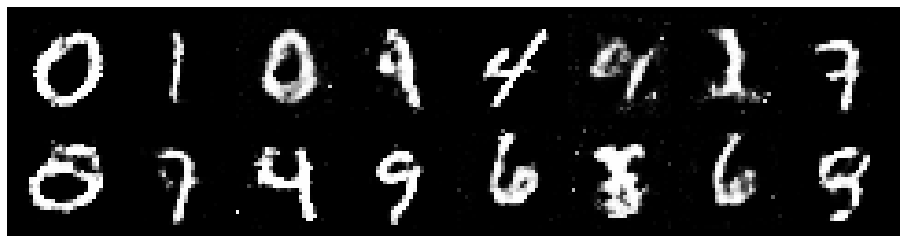

Epoch: [112/200], Batch Num: [400/600]
Discriminator Loss: 1.2759, Generator Loss: 0.8826
D(x): 0.5467, D(G(z)): 0.4486


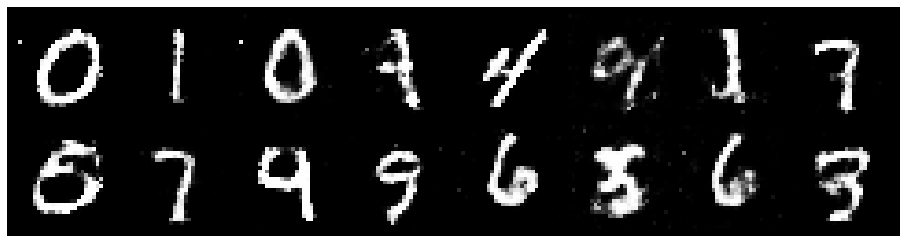

Epoch: [112/200], Batch Num: [500/600]
Discriminator Loss: 1.2555, Generator Loss: 0.9466
D(x): 0.5340, D(G(z)): 0.4243


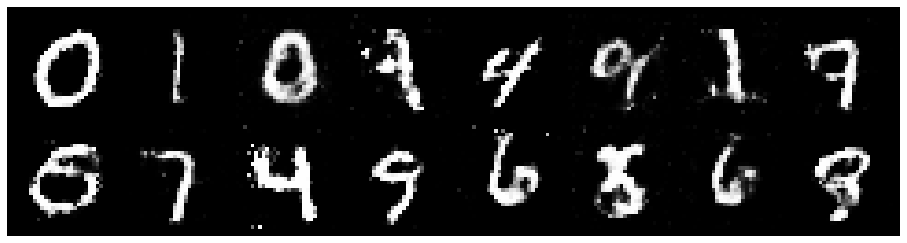

Epoch: [113/200], Batch Num: [0/600]
Discriminator Loss: 1.2172, Generator Loss: 0.9094
D(x): 0.5774, D(G(z)): 0.4339


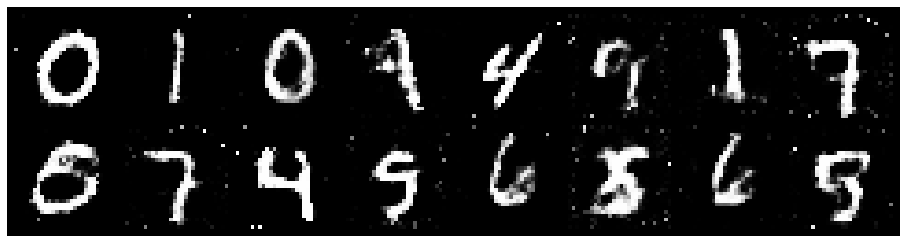

Epoch: [113/200], Batch Num: [100/600]
Discriminator Loss: 1.3261, Generator Loss: 0.8785
D(x): 0.5685, D(G(z)): 0.4880


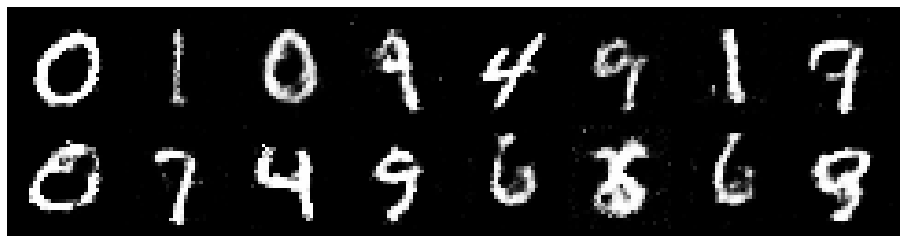

Epoch: [113/200], Batch Num: [200/600]
Discriminator Loss: 1.3227, Generator Loss: 0.7761
D(x): 0.5679, D(G(z)): 0.4698


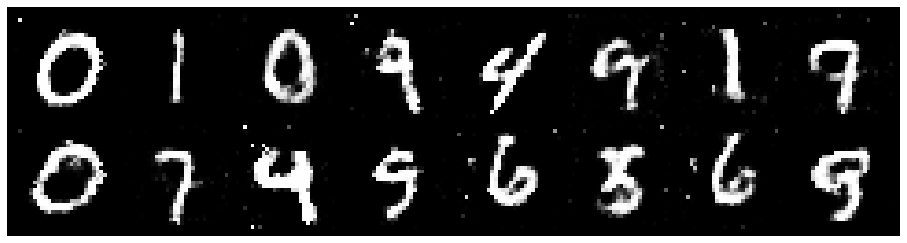

Epoch: [113/200], Batch Num: [300/600]
Discriminator Loss: 1.3303, Generator Loss: 0.9236
D(x): 0.5319, D(G(z)): 0.4412


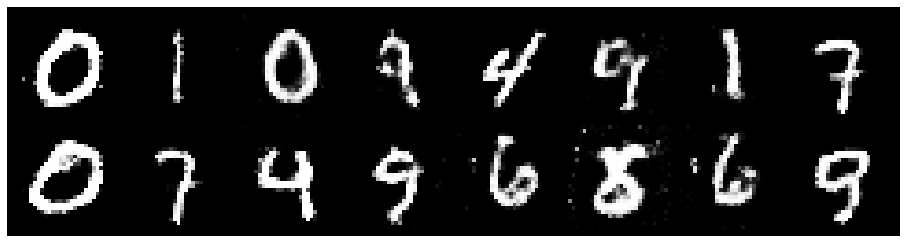

Epoch: [113/200], Batch Num: [400/600]
Discriminator Loss: 1.3215, Generator Loss: 0.8275
D(x): 0.5511, D(G(z)): 0.4651


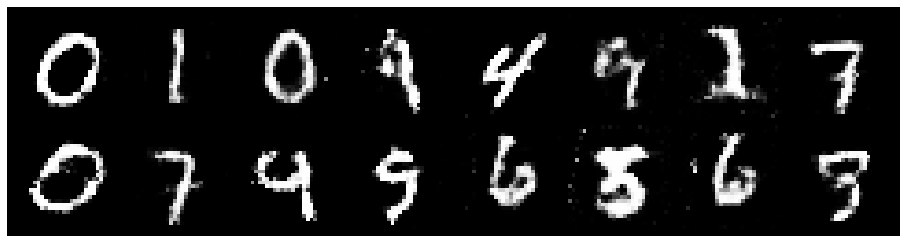

Epoch: [113/200], Batch Num: [500/600]
Discriminator Loss: 1.4174, Generator Loss: 0.7046
D(x): 0.5097, D(G(z)): 0.4827


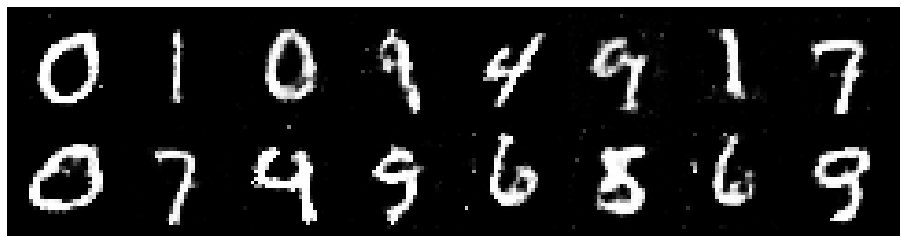

Epoch: [114/200], Batch Num: [0/600]
Discriminator Loss: 1.2750, Generator Loss: 0.9979
D(x): 0.5897, D(G(z)): 0.4638


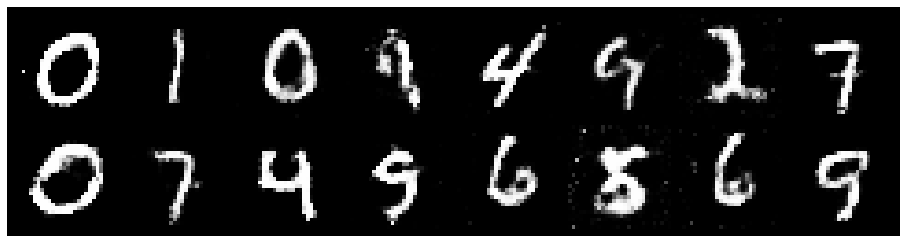

Epoch: [114/200], Batch Num: [100/600]
Discriminator Loss: 1.2003, Generator Loss: 0.9915
D(x): 0.6154, D(G(z)): 0.4463


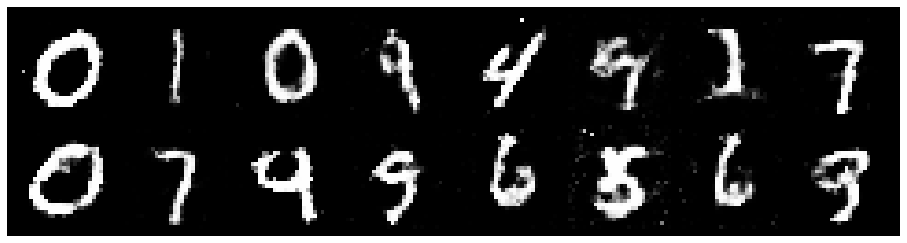

Epoch: [114/200], Batch Num: [200/600]
Discriminator Loss: 1.3403, Generator Loss: 1.0965
D(x): 0.5419, D(G(z)): 0.4342


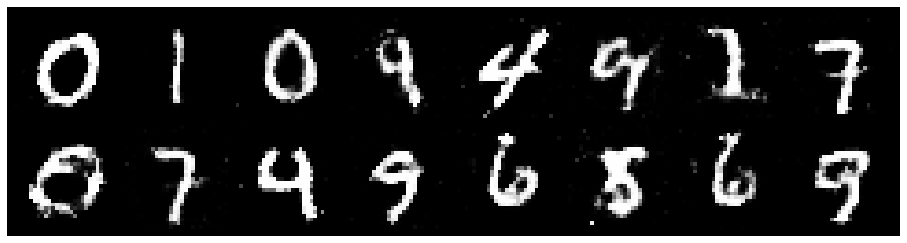

Epoch: [114/200], Batch Num: [300/600]
Discriminator Loss: 1.2495, Generator Loss: 0.8894
D(x): 0.5689, D(G(z)): 0.4518


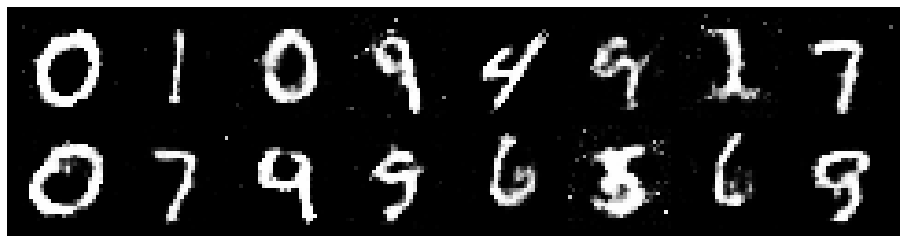

Epoch: [114/200], Batch Num: [400/600]
Discriminator Loss: 1.2641, Generator Loss: 0.8345
D(x): 0.5644, D(G(z)): 0.4516


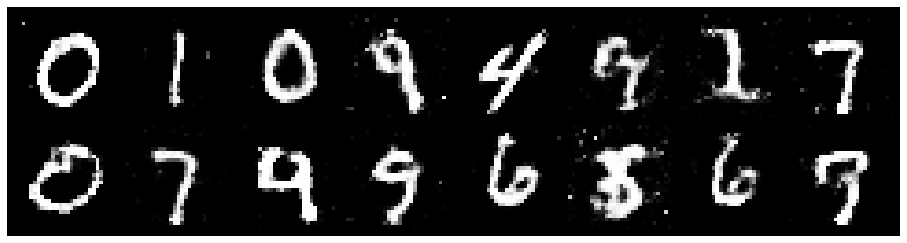

Epoch: [114/200], Batch Num: [500/600]
Discriminator Loss: 1.3384, Generator Loss: 0.7528
D(x): 0.5443, D(G(z)): 0.4908


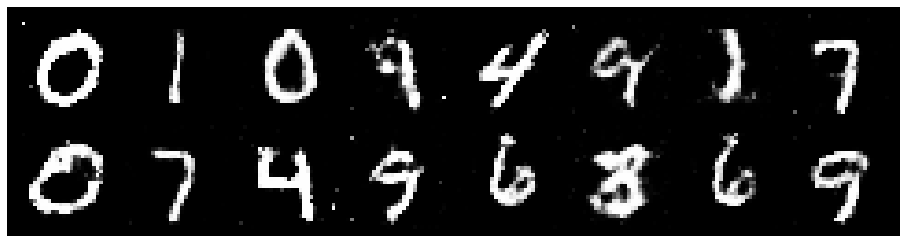

Epoch: [115/200], Batch Num: [0/600]
Discriminator Loss: 1.3665, Generator Loss: 0.7843
D(x): 0.5587, D(G(z)): 0.4844


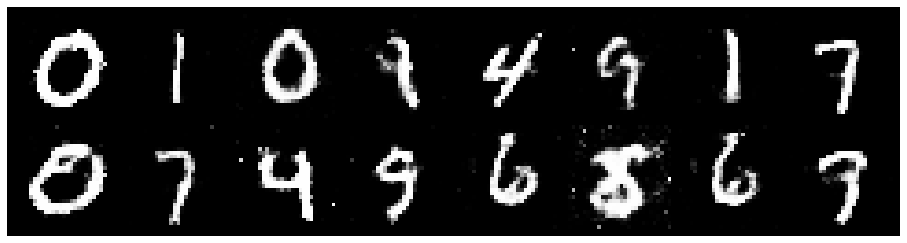

Epoch: [115/200], Batch Num: [100/600]
Discriminator Loss: 1.2990, Generator Loss: 0.8423
D(x): 0.5656, D(G(z)): 0.4699


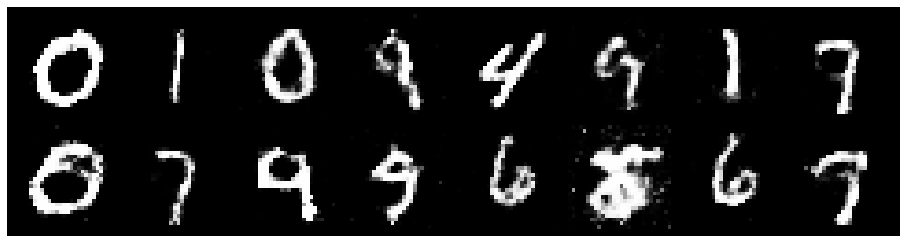

Epoch: [115/200], Batch Num: [200/600]
Discriminator Loss: 1.2960, Generator Loss: 0.8714
D(x): 0.6018, D(G(z)): 0.4843


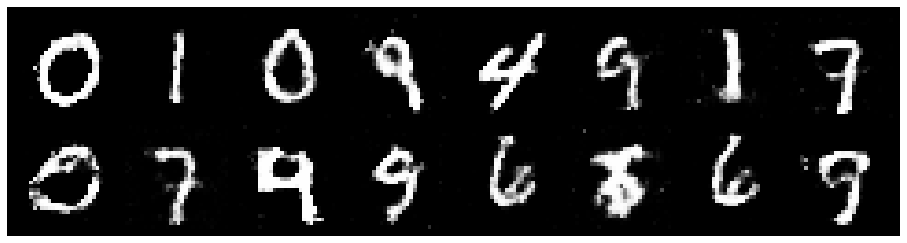

Epoch: [115/200], Batch Num: [300/600]
Discriminator Loss: 1.2007, Generator Loss: 0.9780
D(x): 0.5369, D(G(z)): 0.3770


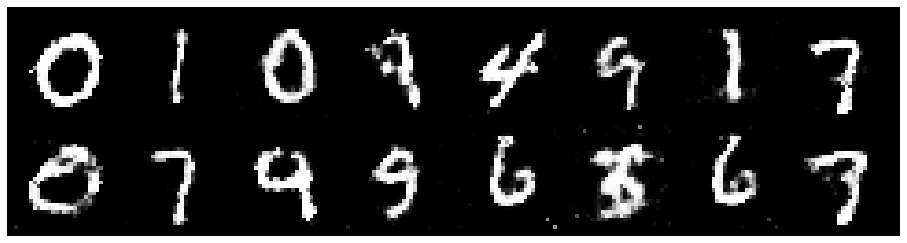

Epoch: [115/200], Batch Num: [400/600]
Discriminator Loss: 1.1728, Generator Loss: 0.9033
D(x): 0.5884, D(G(z)): 0.4209


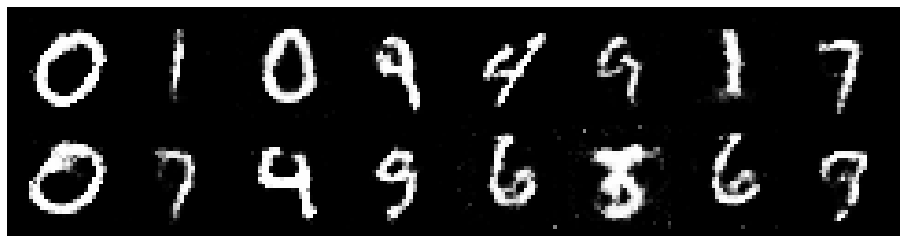

Epoch: [115/200], Batch Num: [500/600]
Discriminator Loss: 1.0837, Generator Loss: 1.0314
D(x): 0.6035, D(G(z)): 0.3892


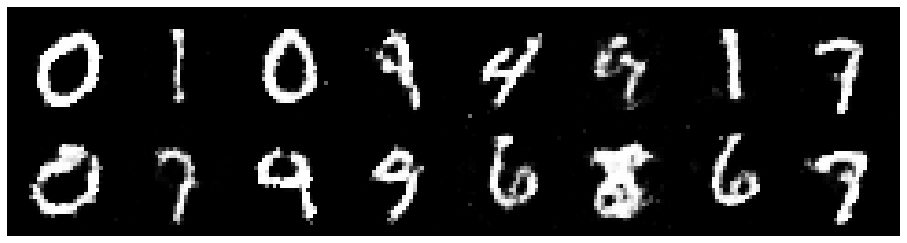

Epoch: [116/200], Batch Num: [0/600]
Discriminator Loss: 1.2830, Generator Loss: 0.8974
D(x): 0.5529, D(G(z)): 0.4498


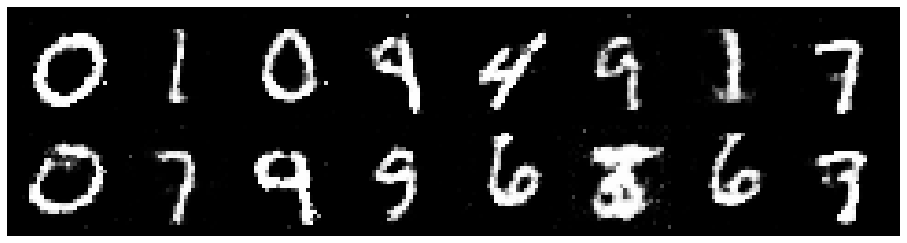

Epoch: [116/200], Batch Num: [100/600]
Discriminator Loss: 1.3182, Generator Loss: 0.8819
D(x): 0.5216, D(G(z)): 0.4281


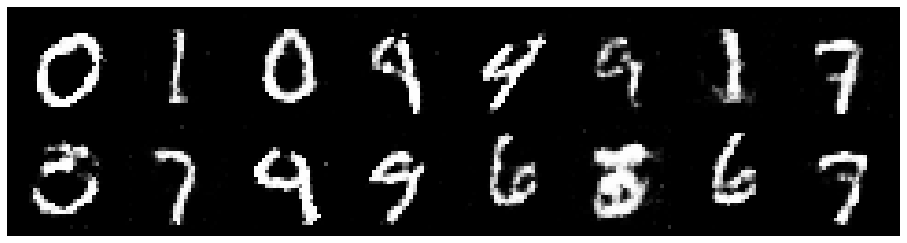

Epoch: [116/200], Batch Num: [200/600]
Discriminator Loss: 1.3274, Generator Loss: 0.7651
D(x): 0.5062, D(G(z)): 0.4365


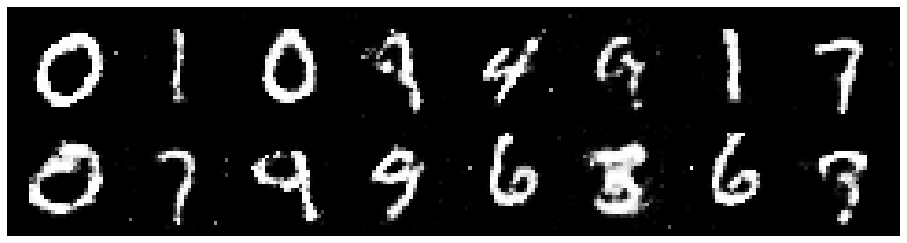

Epoch: [116/200], Batch Num: [300/600]
Discriminator Loss: 1.3995, Generator Loss: 0.8434
D(x): 0.5103, D(G(z)): 0.4526


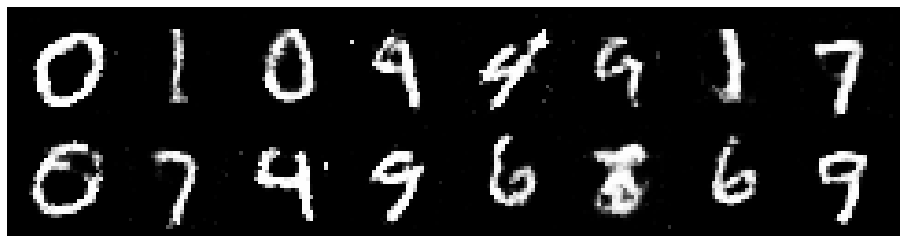

Epoch: [116/200], Batch Num: [400/600]
Discriminator Loss: 1.3484, Generator Loss: 0.9508
D(x): 0.5814, D(G(z)): 0.4706


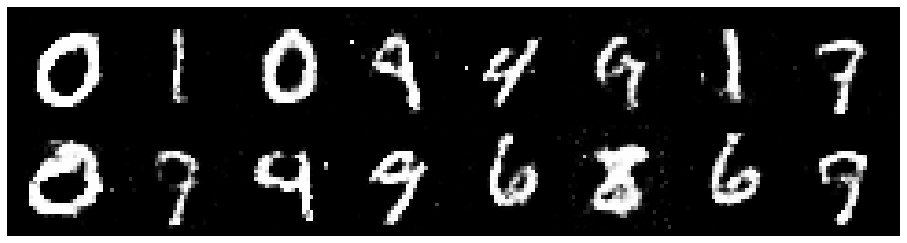

Epoch: [116/200], Batch Num: [500/600]
Discriminator Loss: 1.2079, Generator Loss: 0.9181
D(x): 0.5403, D(G(z)): 0.3982


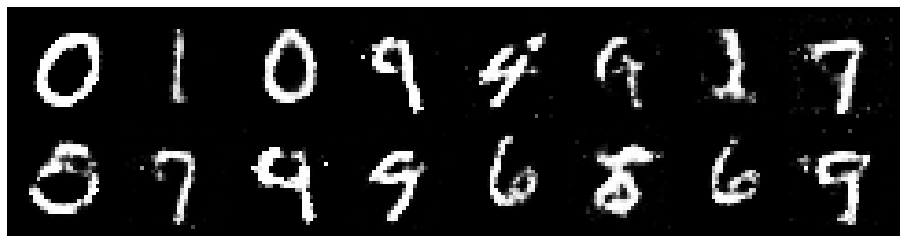

Epoch: [117/200], Batch Num: [0/600]
Discriminator Loss: 1.3171, Generator Loss: 0.9163
D(x): 0.5161, D(G(z)): 0.4299


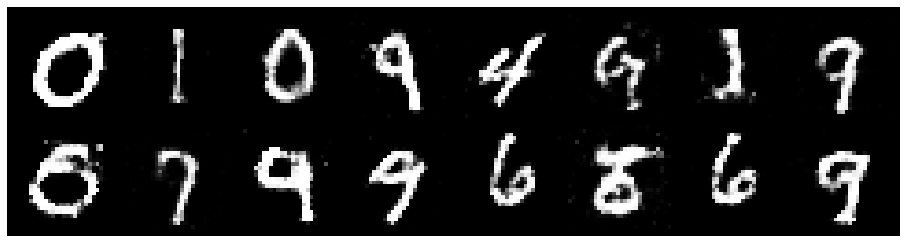

Epoch: [117/200], Batch Num: [100/600]
Discriminator Loss: 1.3683, Generator Loss: 0.8661
D(x): 0.5567, D(G(z)): 0.4658


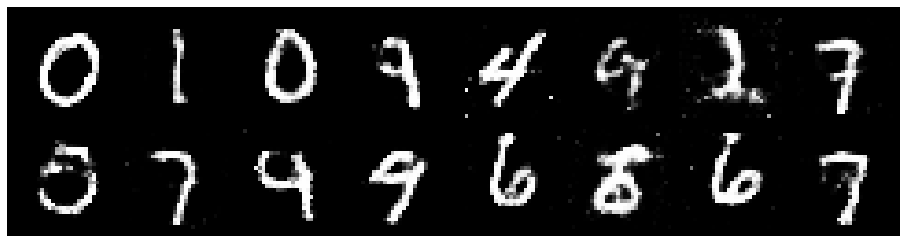

Epoch: [117/200], Batch Num: [200/600]
Discriminator Loss: 1.2313, Generator Loss: 0.9249
D(x): 0.5571, D(G(z)): 0.4159


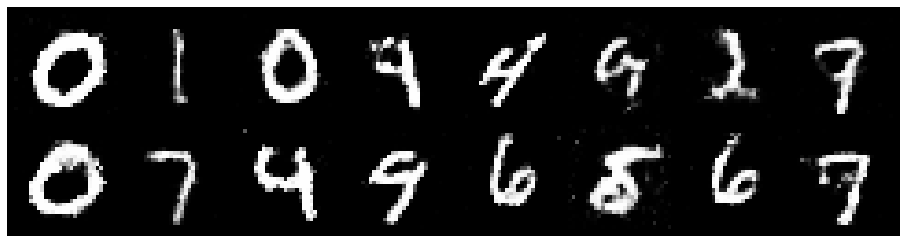

Epoch: [117/200], Batch Num: [300/600]
Discriminator Loss: 1.2253, Generator Loss: 1.0057
D(x): 0.5809, D(G(z)): 0.4441


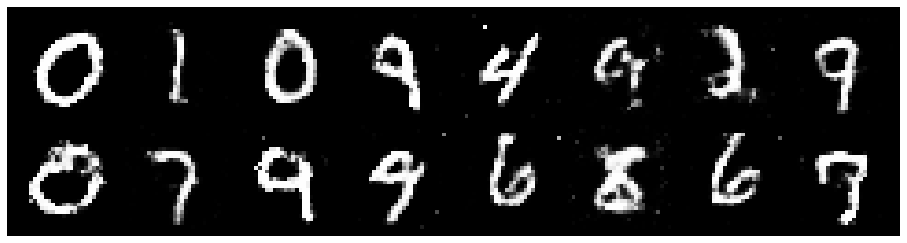

Epoch: [117/200], Batch Num: [400/600]
Discriminator Loss: 1.1485, Generator Loss: 1.1464
D(x): 0.5690, D(G(z)): 0.3728


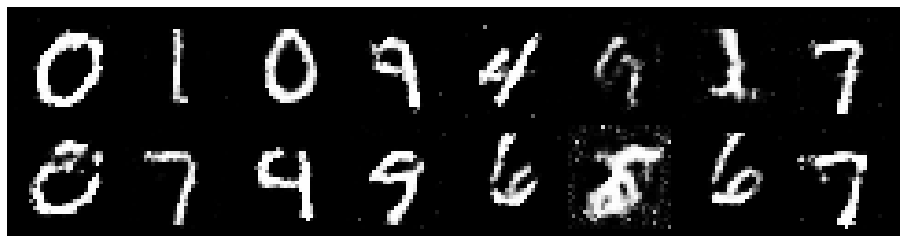

Epoch: [117/200], Batch Num: [500/600]
Discriminator Loss: 1.3913, Generator Loss: 0.7866
D(x): 0.5508, D(G(z)): 0.4647


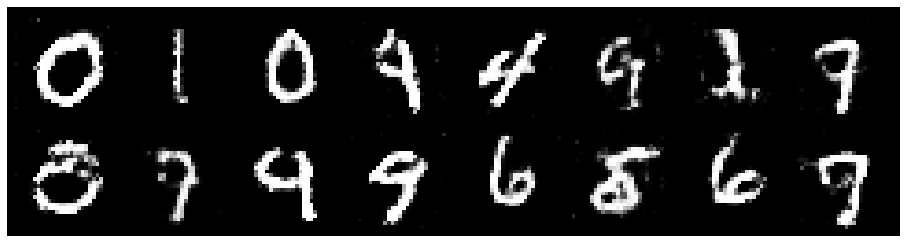

Epoch: [118/200], Batch Num: [0/600]
Discriminator Loss: 1.3882, Generator Loss: 1.0251
D(x): 0.5841, D(G(z)): 0.4705


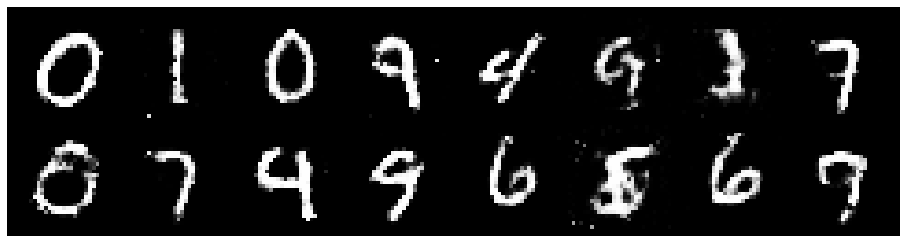

Epoch: [118/200], Batch Num: [100/600]
Discriminator Loss: 1.0846, Generator Loss: 1.0707
D(x): 0.6170, D(G(z)): 0.3895


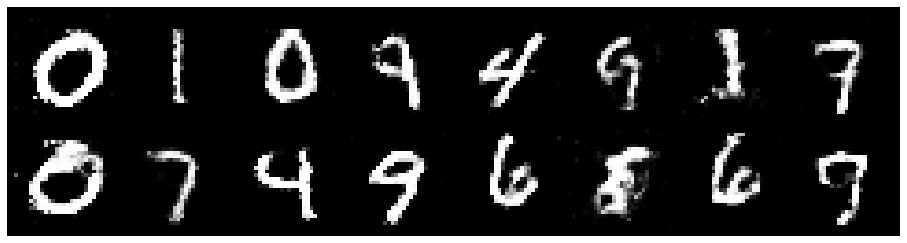

Epoch: [118/200], Batch Num: [200/600]
Discriminator Loss: 1.2787, Generator Loss: 0.8961
D(x): 0.5682, D(G(z)): 0.4589


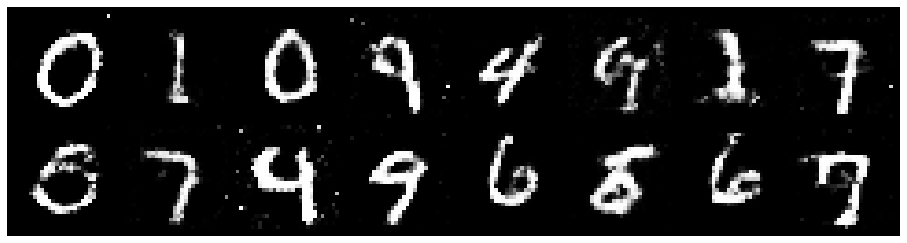

Epoch: [118/200], Batch Num: [300/600]
Discriminator Loss: 1.2236, Generator Loss: 1.1349
D(x): 0.5463, D(G(z)): 0.3858


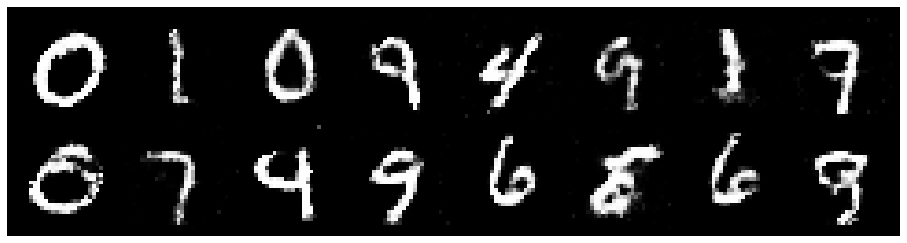

Epoch: [118/200], Batch Num: [400/600]
Discriminator Loss: 1.3043, Generator Loss: 0.8768
D(x): 0.5348, D(G(z)): 0.4449


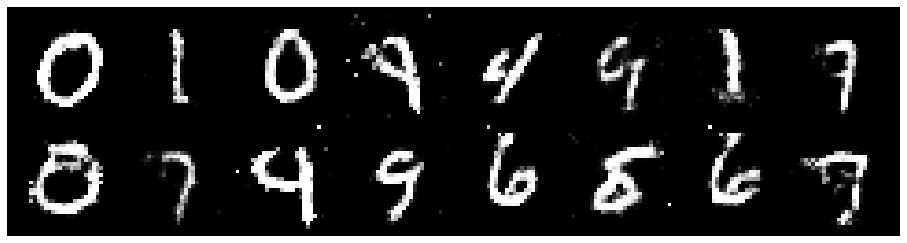

Epoch: [118/200], Batch Num: [500/600]
Discriminator Loss: 1.2223, Generator Loss: 0.9694
D(x): 0.5302, D(G(z)): 0.3941


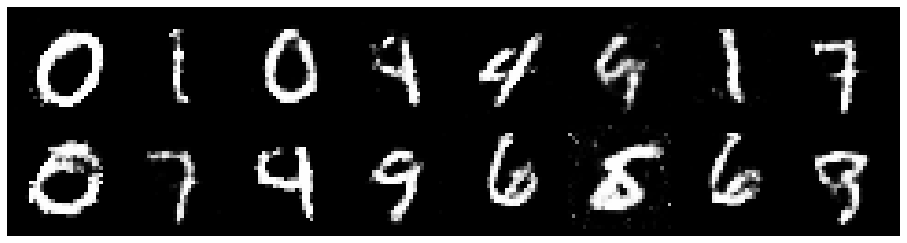

Epoch: [119/200], Batch Num: [0/600]
Discriminator Loss: 1.1938, Generator Loss: 0.9256
D(x): 0.5606, D(G(z)): 0.4034


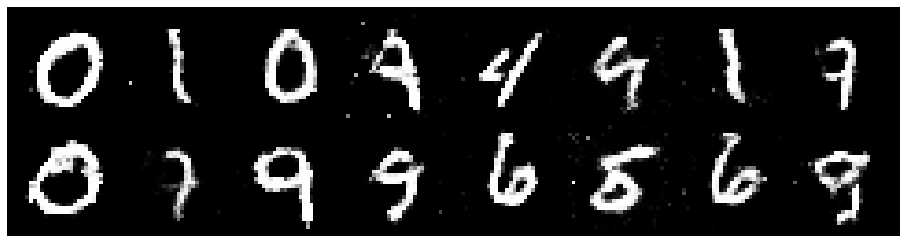

Epoch: [119/200], Batch Num: [100/600]
Discriminator Loss: 1.3268, Generator Loss: 0.8060
D(x): 0.5336, D(G(z)): 0.4637


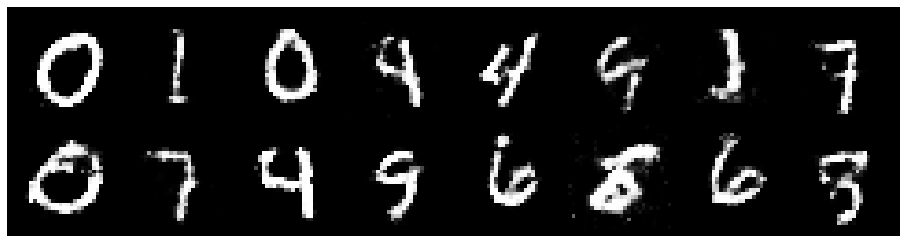

Epoch: [119/200], Batch Num: [200/600]
Discriminator Loss: 1.2260, Generator Loss: 0.9380
D(x): 0.5617, D(G(z)): 0.4392


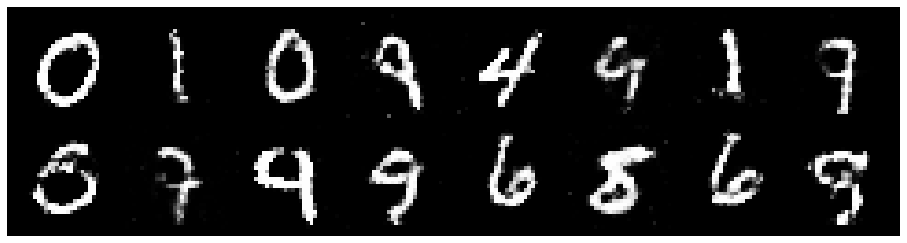

Epoch: [119/200], Batch Num: [300/600]
Discriminator Loss: 1.2102, Generator Loss: 0.8929
D(x): 0.5758, D(G(z)): 0.4453


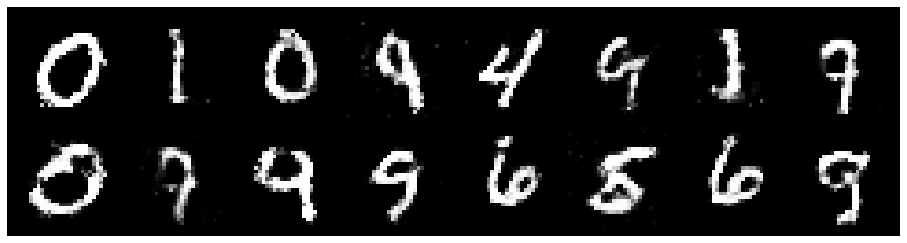

Epoch: [119/200], Batch Num: [400/600]
Discriminator Loss: 1.2462, Generator Loss: 0.8085
D(x): 0.5937, D(G(z)): 0.4703


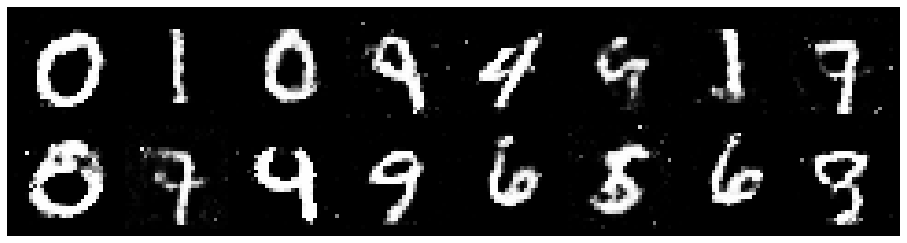

Epoch: [119/200], Batch Num: [500/600]
Discriminator Loss: 1.3078, Generator Loss: 0.8464
D(x): 0.5230, D(G(z)): 0.4458


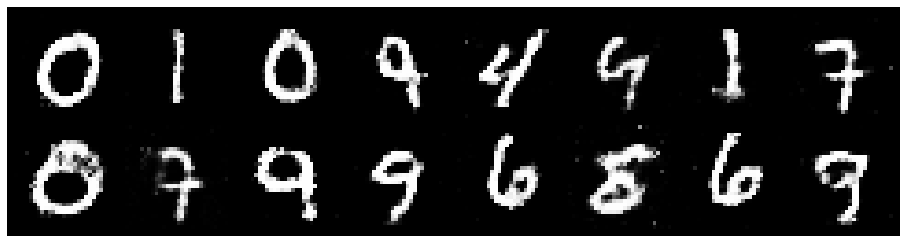

Epoch: [120/200], Batch Num: [0/600]
Discriminator Loss: 1.2247, Generator Loss: 0.8417
D(x): 0.5832, D(G(z)): 0.4333


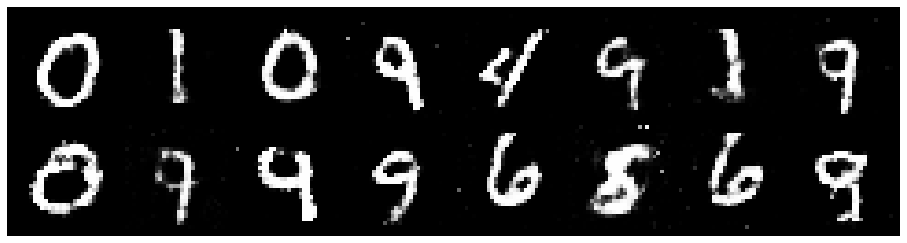

Epoch: [120/200], Batch Num: [100/600]
Discriminator Loss: 1.3146, Generator Loss: 0.8881
D(x): 0.5309, D(G(z)): 0.4435


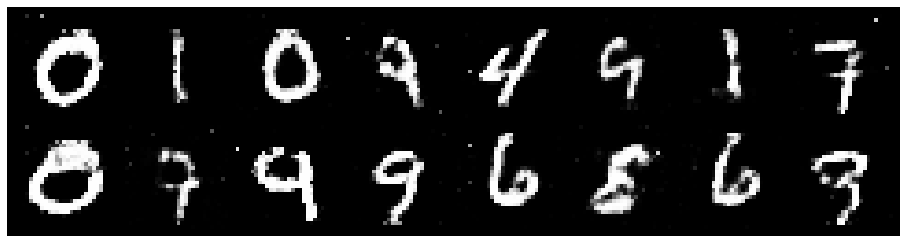

Epoch: [120/200], Batch Num: [200/600]
Discriminator Loss: 1.2458, Generator Loss: 0.9337
D(x): 0.5776, D(G(z)): 0.4407


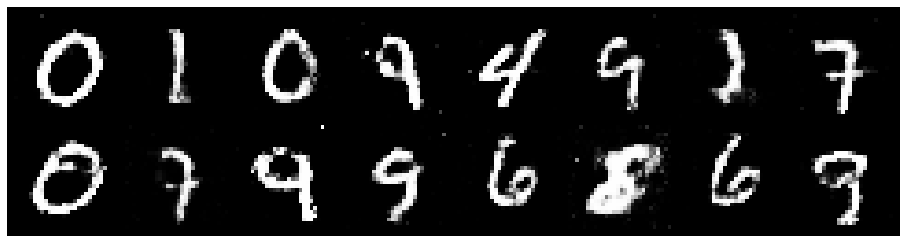

Epoch: [120/200], Batch Num: [300/600]
Discriminator Loss: 1.4001, Generator Loss: 0.8752
D(x): 0.5287, D(G(z)): 0.4516


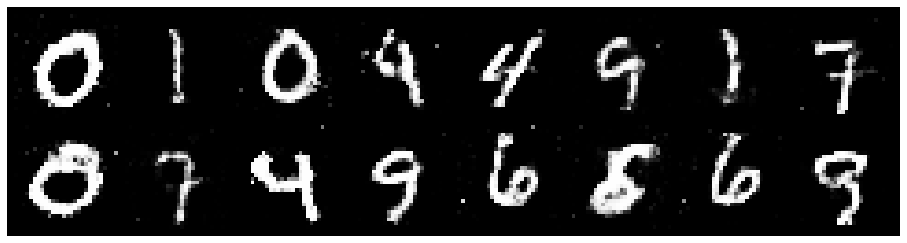

Epoch: [120/200], Batch Num: [400/600]
Discriminator Loss: 1.2808, Generator Loss: 0.9060
D(x): 0.6058, D(G(z)): 0.4444


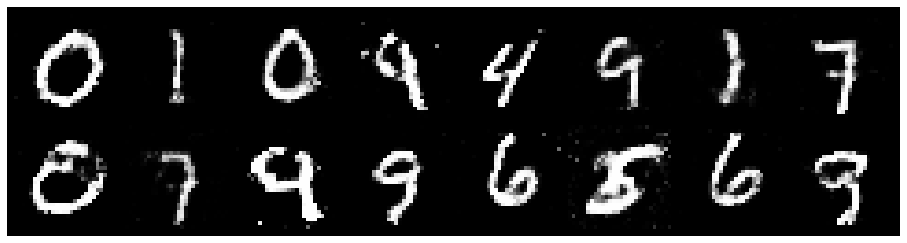

Epoch: [120/200], Batch Num: [500/600]
Discriminator Loss: 1.1598, Generator Loss: 1.0381
D(x): 0.5989, D(G(z)): 0.4167


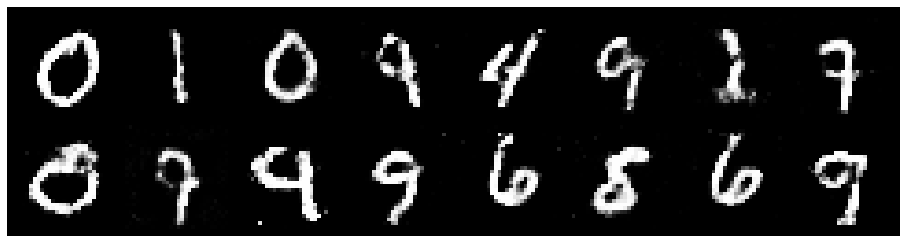

Epoch: [121/200], Batch Num: [0/600]
Discriminator Loss: 1.2583, Generator Loss: 1.0270
D(x): 0.5540, D(G(z)): 0.4296


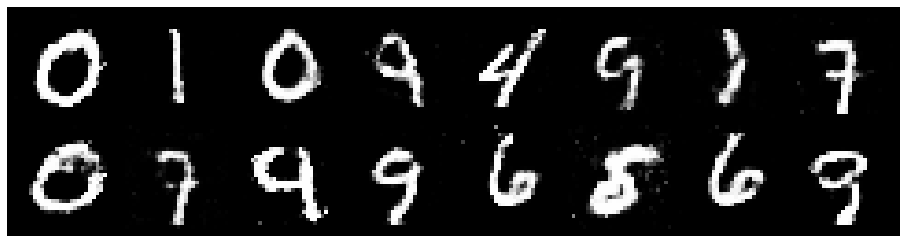

Epoch: [121/200], Batch Num: [100/600]
Discriminator Loss: 1.2468, Generator Loss: 1.0200
D(x): 0.6163, D(G(z)): 0.4629


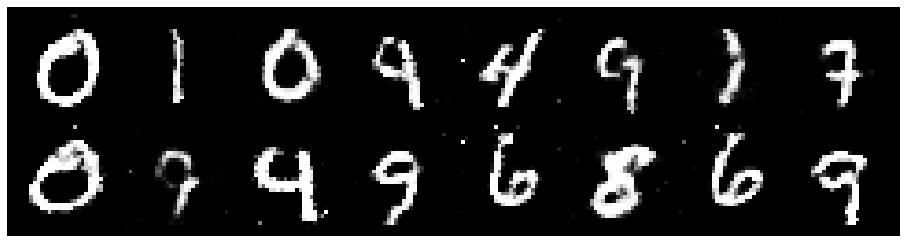

Epoch: [121/200], Batch Num: [200/600]
Discriminator Loss: 1.3813, Generator Loss: 0.9161
D(x): 0.5801, D(G(z)): 0.4828


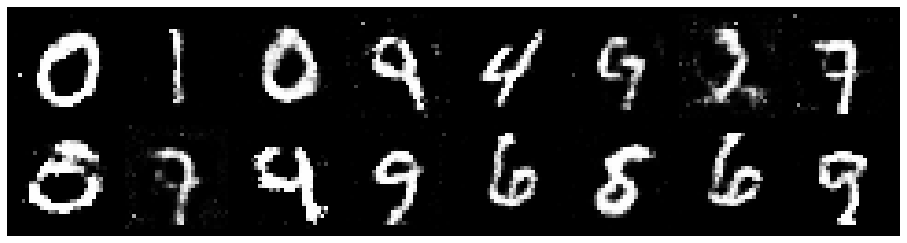

Epoch: [121/200], Batch Num: [300/600]
Discriminator Loss: 1.2885, Generator Loss: 0.8351
D(x): 0.5262, D(G(z)): 0.4341


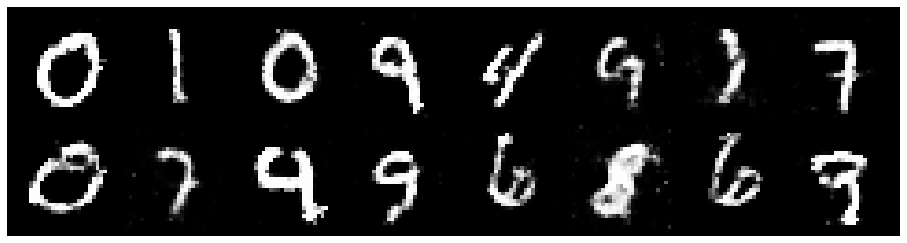

Epoch: [121/200], Batch Num: [400/600]
Discriminator Loss: 1.2655, Generator Loss: 0.8111
D(x): 0.5684, D(G(z)): 0.4464


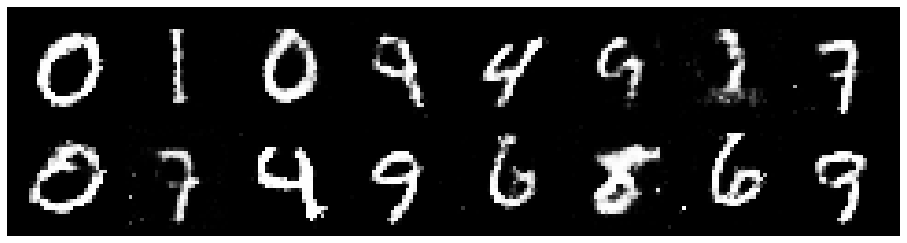

Epoch: [121/200], Batch Num: [500/600]
Discriminator Loss: 1.3302, Generator Loss: 0.8325
D(x): 0.5205, D(G(z)): 0.4468


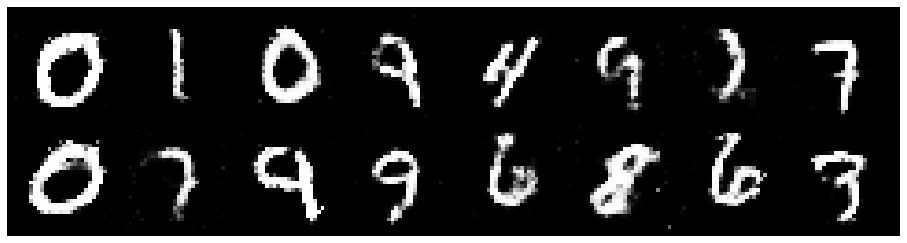

Epoch: [122/200], Batch Num: [0/600]
Discriminator Loss: 1.3735, Generator Loss: 0.8986
D(x): 0.5170, D(G(z)): 0.4536


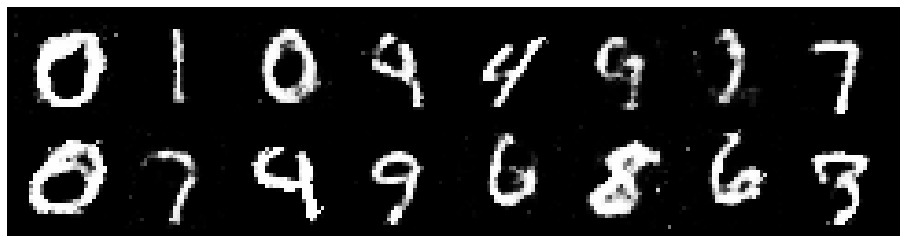

Epoch: [122/200], Batch Num: [100/600]
Discriminator Loss: 1.3249, Generator Loss: 0.9011
D(x): 0.5094, D(G(z)): 0.4388


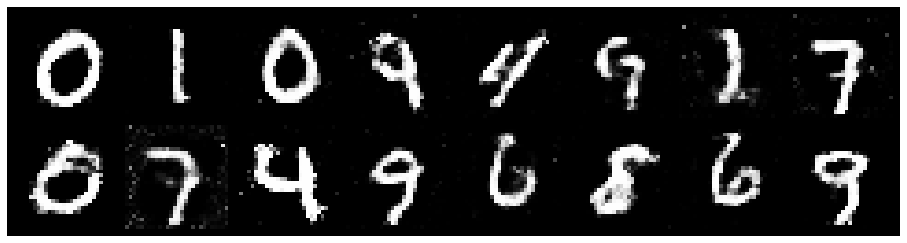

Epoch: [122/200], Batch Num: [200/600]
Discriminator Loss: 1.2292, Generator Loss: 0.9029
D(x): 0.5559, D(G(z)): 0.4146


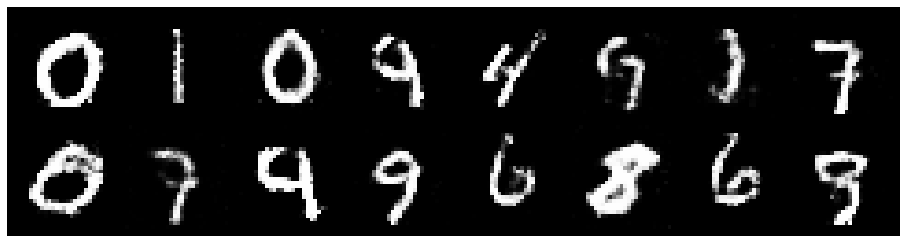

Epoch: [122/200], Batch Num: [300/600]
Discriminator Loss: 1.2621, Generator Loss: 0.9087
D(x): 0.5573, D(G(z)): 0.4498


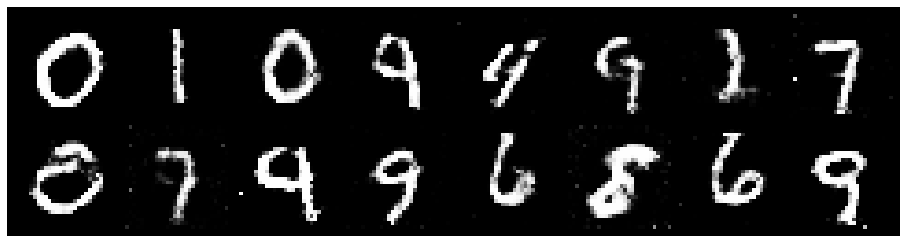

Epoch: [122/200], Batch Num: [400/600]
Discriminator Loss: 1.2379, Generator Loss: 1.0130
D(x): 0.5646, D(G(z)): 0.3978


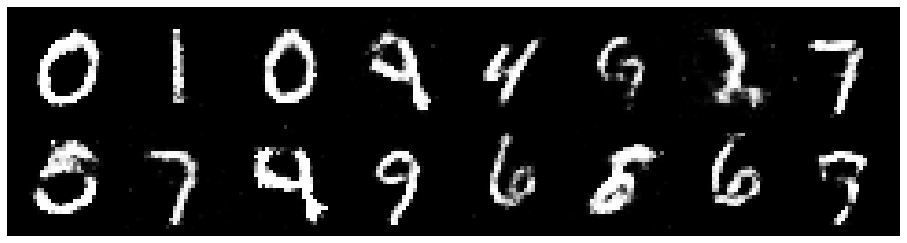

Epoch: [122/200], Batch Num: [500/600]
Discriminator Loss: 1.2297, Generator Loss: 0.9279
D(x): 0.5585, D(G(z)): 0.4442


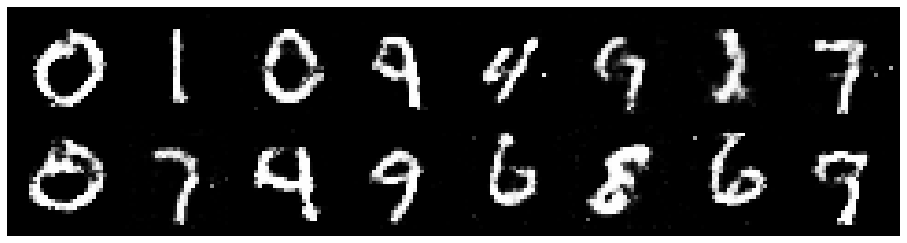

Epoch: [123/200], Batch Num: [0/600]
Discriminator Loss: 1.1833, Generator Loss: 0.8615
D(x): 0.5723, D(G(z)): 0.4361


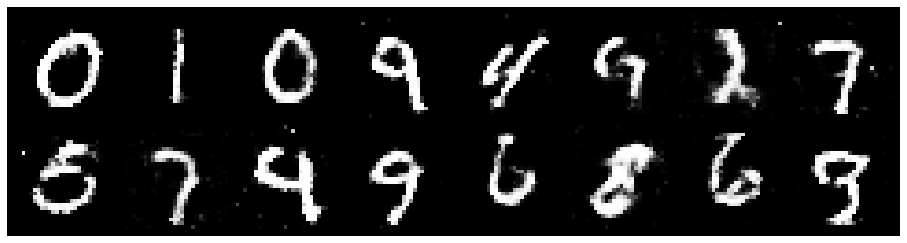

Epoch: [123/200], Batch Num: [100/600]
Discriminator Loss: 1.1744, Generator Loss: 0.9327
D(x): 0.6000, D(G(z)): 0.4296


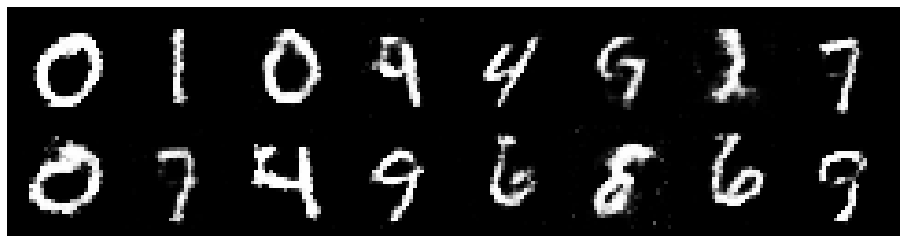

Epoch: [123/200], Batch Num: [200/600]
Discriminator Loss: 1.2452, Generator Loss: 0.8629
D(x): 0.5320, D(G(z)): 0.4243


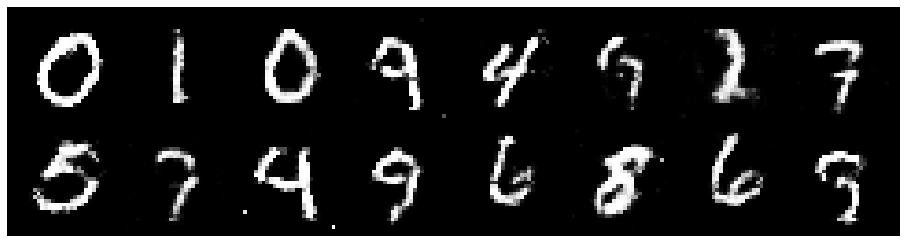

Epoch: [123/200], Batch Num: [300/600]
Discriminator Loss: 1.3342, Generator Loss: 0.9097
D(x): 0.5110, D(G(z)): 0.4416


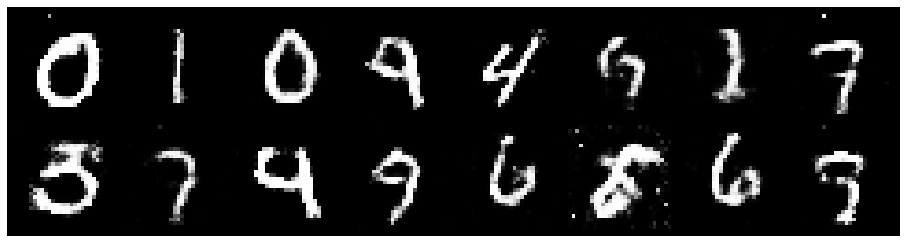

Epoch: [123/200], Batch Num: [400/600]
Discriminator Loss: 1.2363, Generator Loss: 0.9315
D(x): 0.5563, D(G(z)): 0.4255


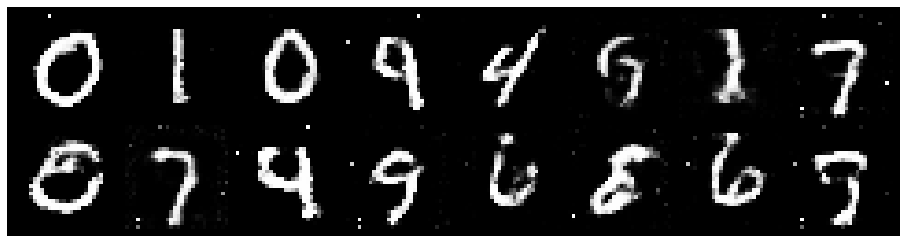

Epoch: [123/200], Batch Num: [500/600]
Discriminator Loss: 1.2024, Generator Loss: 0.8936
D(x): 0.6131, D(G(z)): 0.4525


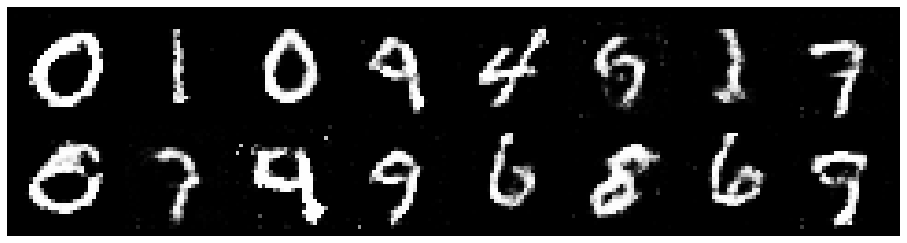

Epoch: [124/200], Batch Num: [0/600]
Discriminator Loss: 1.2955, Generator Loss: 0.9117
D(x): 0.5511, D(G(z)): 0.4440


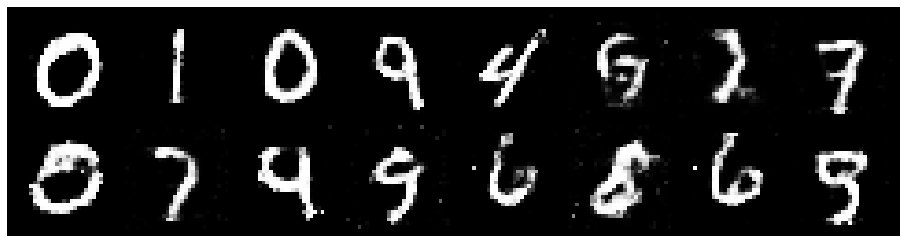

Epoch: [124/200], Batch Num: [100/600]
Discriminator Loss: 1.2044, Generator Loss: 0.9330
D(x): 0.5700, D(G(z)): 0.4042


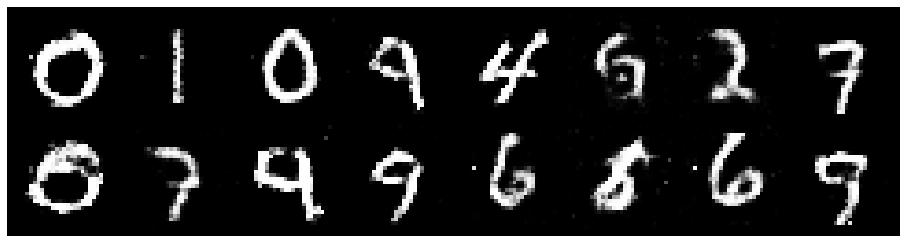

Epoch: [124/200], Batch Num: [200/600]
Discriminator Loss: 1.0722, Generator Loss: 1.0852
D(x): 0.5871, D(G(z)): 0.3812


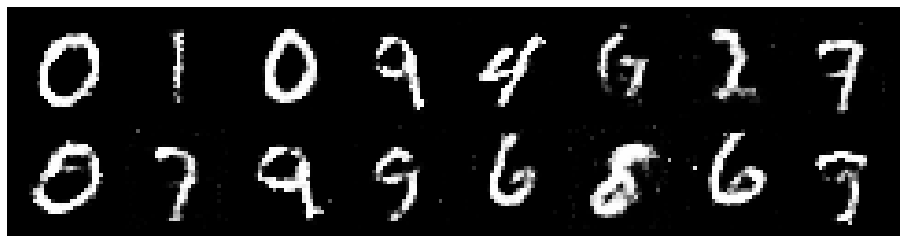

Epoch: [124/200], Batch Num: [300/600]
Discriminator Loss: 1.1979, Generator Loss: 0.9369
D(x): 0.5492, D(G(z)): 0.4063


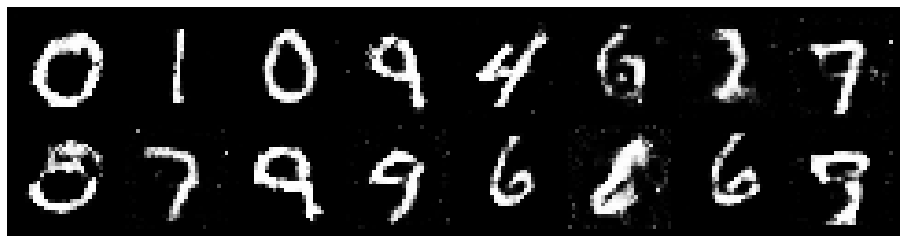

Epoch: [124/200], Batch Num: [400/600]
Discriminator Loss: 1.2566, Generator Loss: 0.9095
D(x): 0.5343, D(G(z)): 0.4261


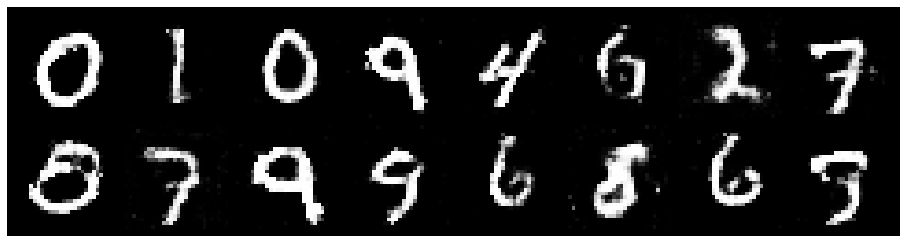

Epoch: [124/200], Batch Num: [500/600]
Discriminator Loss: 1.2260, Generator Loss: 0.9369
D(x): 0.5755, D(G(z)): 0.4132


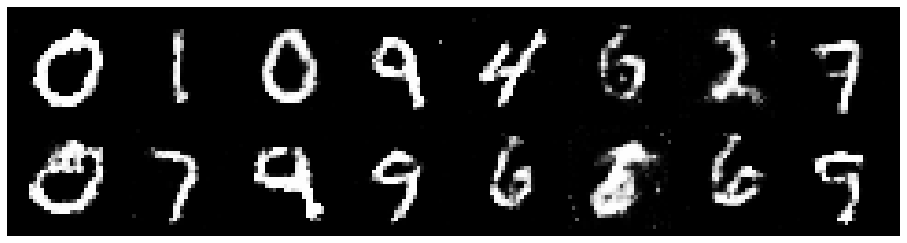

Epoch: [125/200], Batch Num: [0/600]
Discriminator Loss: 1.1862, Generator Loss: 0.9785
D(x): 0.5891, D(G(z)): 0.4319


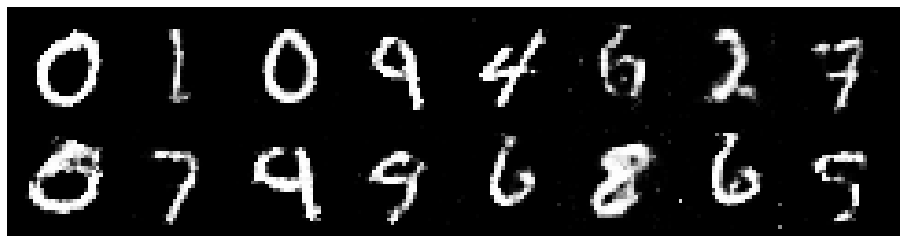

Epoch: [125/200], Batch Num: [100/600]
Discriminator Loss: 1.1929, Generator Loss: 0.9752
D(x): 0.5496, D(G(z)): 0.3918


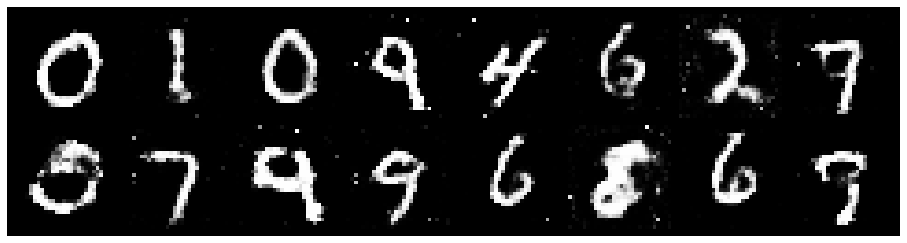

Epoch: [125/200], Batch Num: [200/600]
Discriminator Loss: 1.2586, Generator Loss: 0.9355
D(x): 0.5340, D(G(z)): 0.4212


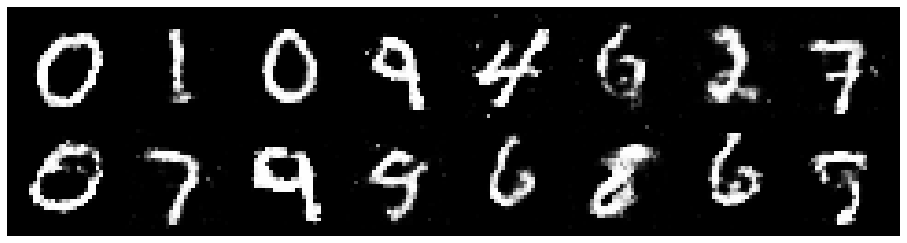

Epoch: [125/200], Batch Num: [300/600]
Discriminator Loss: 1.2707, Generator Loss: 0.8119
D(x): 0.5490, D(G(z)): 0.4505


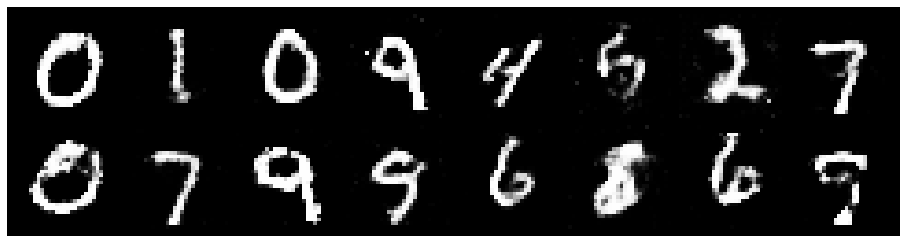

Epoch: [125/200], Batch Num: [400/600]
Discriminator Loss: 1.2947, Generator Loss: 0.8137
D(x): 0.5386, D(G(z)): 0.4600


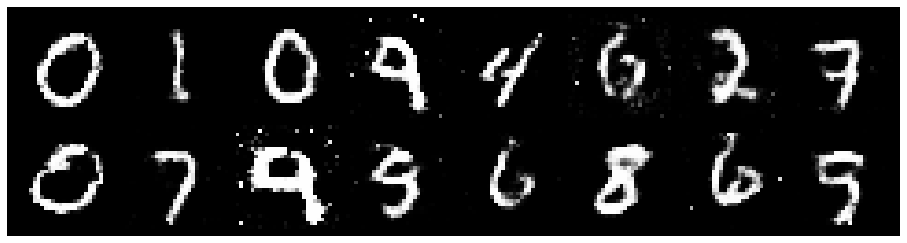

Epoch: [125/200], Batch Num: [500/600]
Discriminator Loss: 1.2014, Generator Loss: 0.9105
D(x): 0.5723, D(G(z)): 0.4030


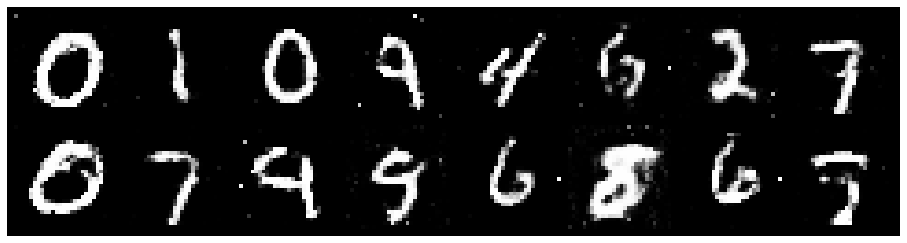

Epoch: [126/200], Batch Num: [0/600]
Discriminator Loss: 1.2757, Generator Loss: 0.8812
D(x): 0.5763, D(G(z)): 0.4761


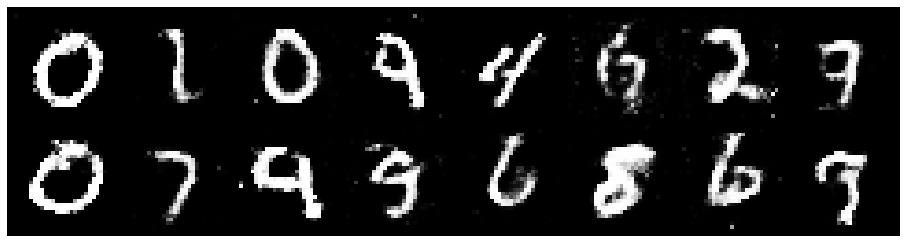

Epoch: [126/200], Batch Num: [100/600]
Discriminator Loss: 1.2399, Generator Loss: 0.9925
D(x): 0.5485, D(G(z)): 0.4154


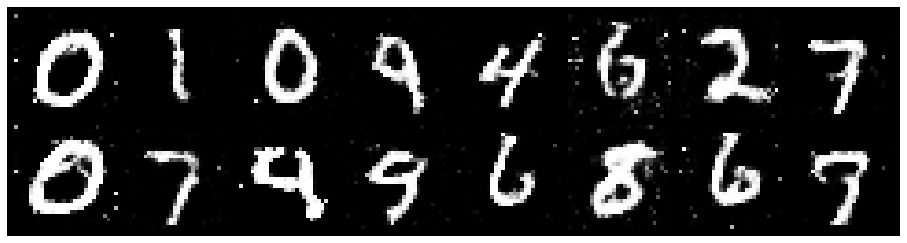

Epoch: [126/200], Batch Num: [200/600]
Discriminator Loss: 1.2960, Generator Loss: 0.7603
D(x): 0.5870, D(G(z)): 0.4893


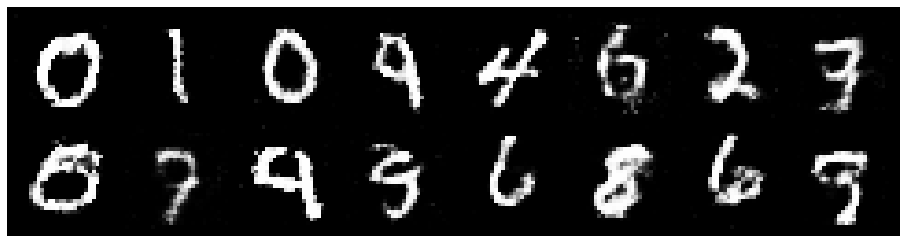

Epoch: [126/200], Batch Num: [300/600]
Discriminator Loss: 1.2158, Generator Loss: 0.9229
D(x): 0.5634, D(G(z)): 0.4231


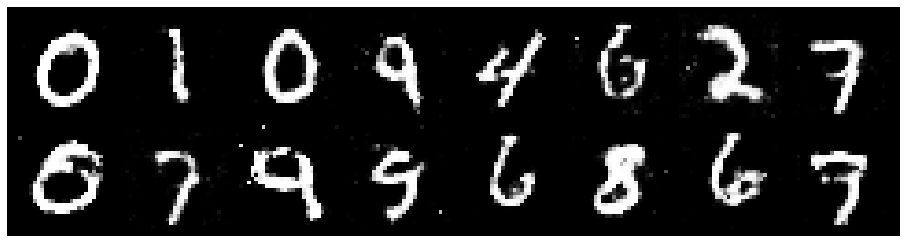

Epoch: [126/200], Batch Num: [400/600]
Discriminator Loss: 1.2457, Generator Loss: 0.9160
D(x): 0.5794, D(G(z)): 0.4548


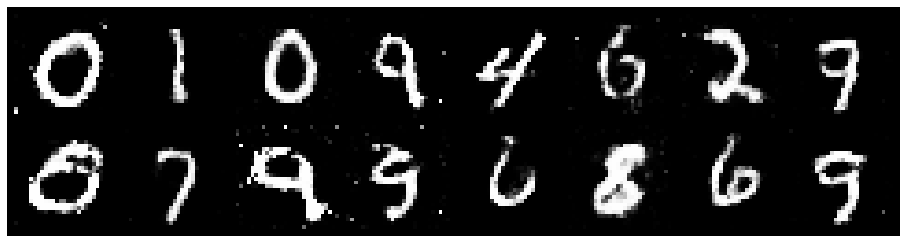

Epoch: [126/200], Batch Num: [500/600]
Discriminator Loss: 1.0933, Generator Loss: 1.1565
D(x): 0.5905, D(G(z)): 0.3739


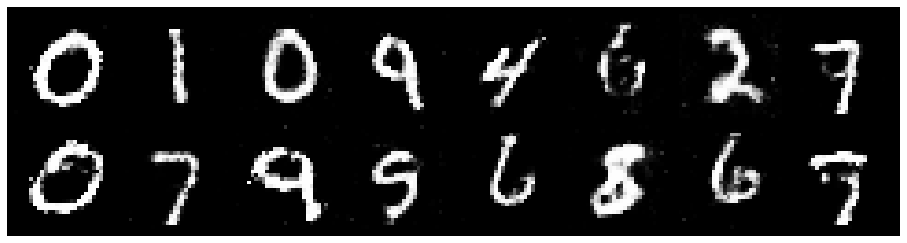

Epoch: [127/200], Batch Num: [0/600]
Discriminator Loss: 1.1288, Generator Loss: 1.0404
D(x): 0.5520, D(G(z)): 0.3721


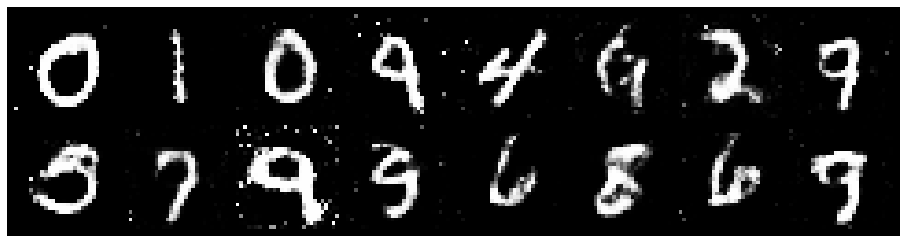

Epoch: [127/200], Batch Num: [100/600]
Discriminator Loss: 1.1593, Generator Loss: 0.9140
D(x): 0.5958, D(G(z)): 0.4277


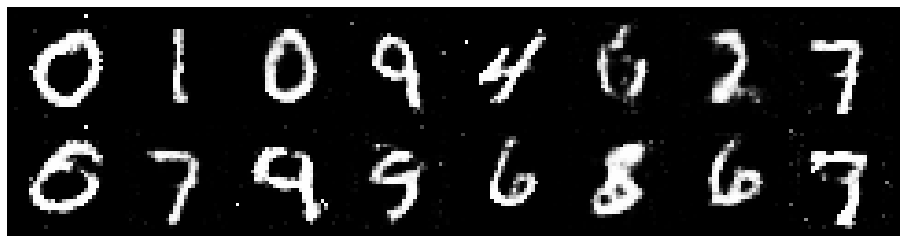

Epoch: [127/200], Batch Num: [200/600]
Discriminator Loss: 1.3035, Generator Loss: 0.8232
D(x): 0.5521, D(G(z)): 0.4649


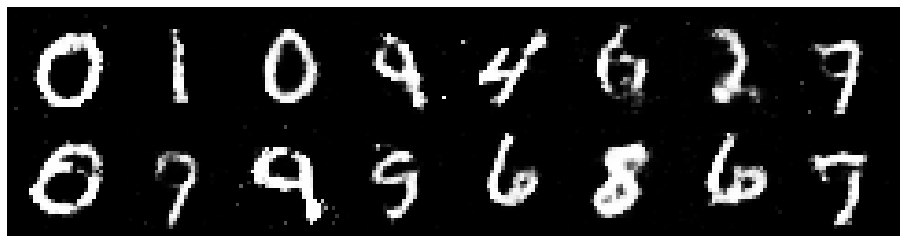

Epoch: [127/200], Batch Num: [300/600]
Discriminator Loss: 1.3028, Generator Loss: 0.8445
D(x): 0.5383, D(G(z)): 0.4549


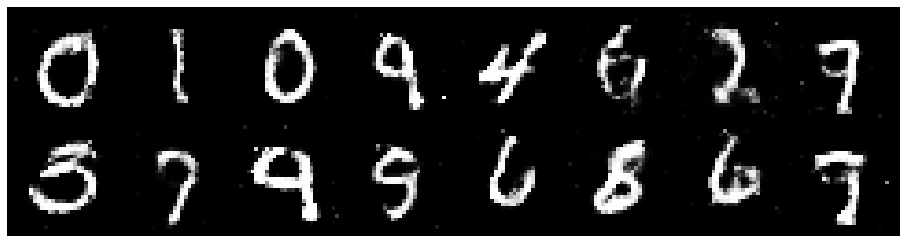

Epoch: [127/200], Batch Num: [400/600]
Discriminator Loss: 1.2088, Generator Loss: 0.7883
D(x): 0.5969, D(G(z)): 0.4547


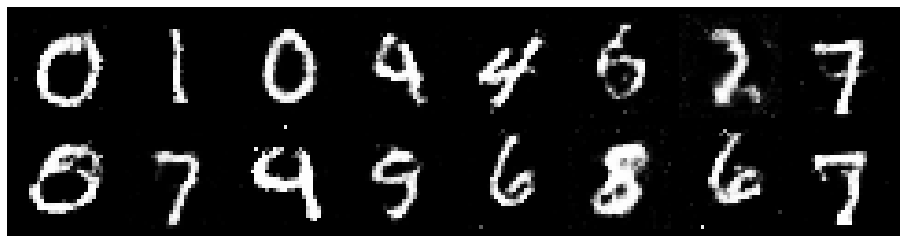

Epoch: [127/200], Batch Num: [500/600]
Discriminator Loss: 1.2452, Generator Loss: 0.8668
D(x): 0.5211, D(G(z)): 0.4009


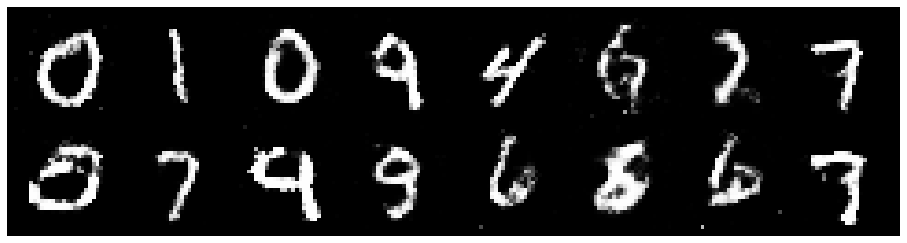

Epoch: [128/200], Batch Num: [0/600]
Discriminator Loss: 1.2200, Generator Loss: 0.8683
D(x): 0.5403, D(G(z)): 0.4207


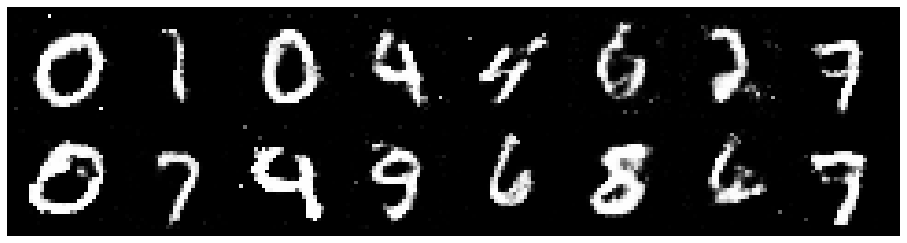

Epoch: [128/200], Batch Num: [100/600]
Discriminator Loss: 1.2548, Generator Loss: 0.8239
D(x): 0.5525, D(G(z)): 0.4304


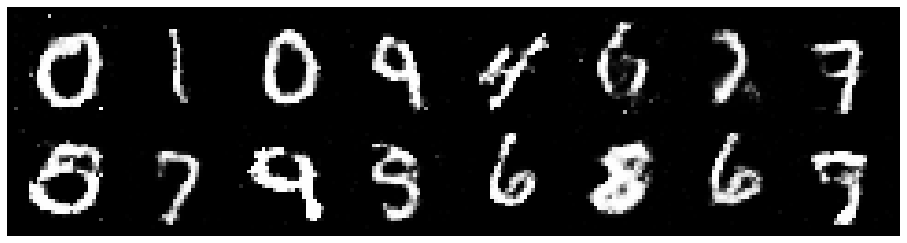

Epoch: [128/200], Batch Num: [200/600]
Discriminator Loss: 1.2132, Generator Loss: 0.9641
D(x): 0.5628, D(G(z)): 0.4207


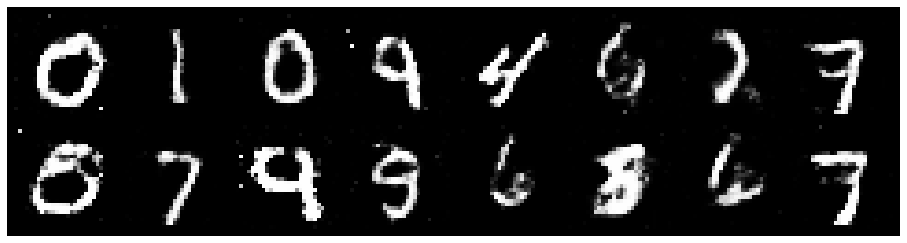

Epoch: [128/200], Batch Num: [300/600]
Discriminator Loss: 1.2698, Generator Loss: 0.7858
D(x): 0.5695, D(G(z)): 0.4658


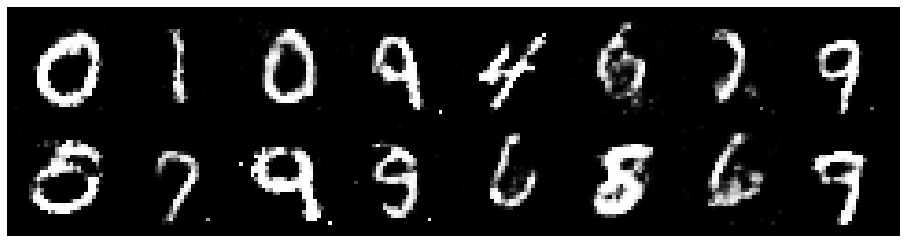

Epoch: [128/200], Batch Num: [400/600]
Discriminator Loss: 1.1306, Generator Loss: 0.9561
D(x): 0.5918, D(G(z)): 0.3971


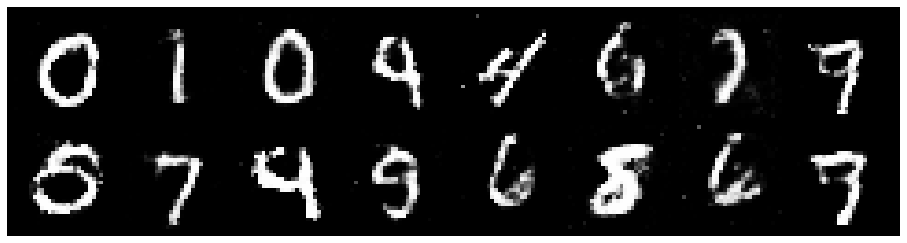

Epoch: [128/200], Batch Num: [500/600]
Discriminator Loss: 1.2413, Generator Loss: 0.9869
D(x): 0.5659, D(G(z)): 0.4226


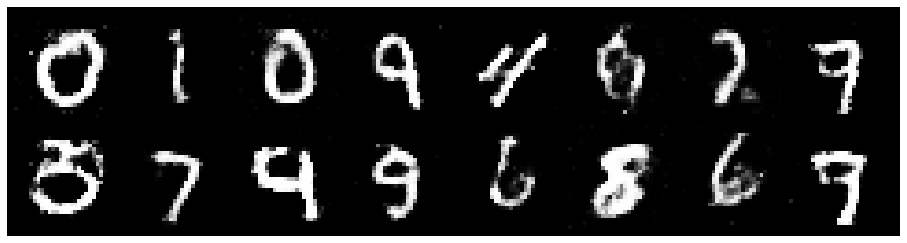

Epoch: [129/200], Batch Num: [0/600]
Discriminator Loss: 1.2334, Generator Loss: 1.0935
D(x): 0.5674, D(G(z)): 0.4253


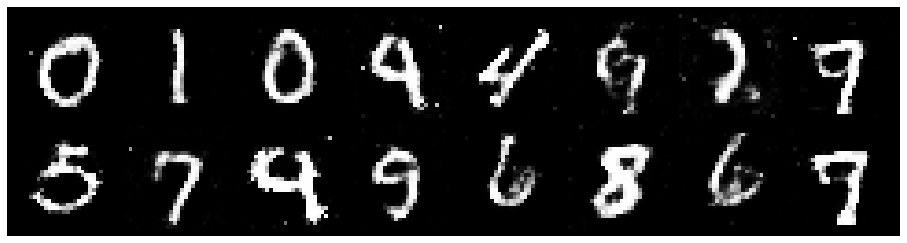

Epoch: [129/200], Batch Num: [100/600]
Discriminator Loss: 1.2695, Generator Loss: 0.9203
D(x): 0.5546, D(G(z)): 0.4430


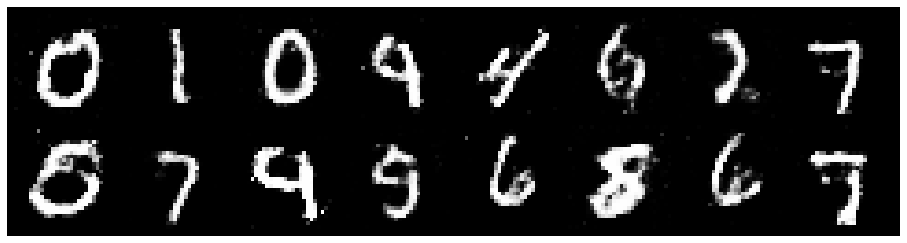

Epoch: [129/200], Batch Num: [200/600]
Discriminator Loss: 1.3146, Generator Loss: 0.8634
D(x): 0.5248, D(G(z)): 0.4581


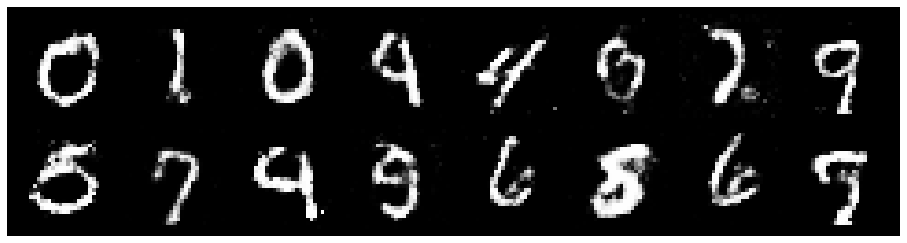

Epoch: [129/200], Batch Num: [300/600]
Discriminator Loss: 1.2528, Generator Loss: 0.8686
D(x): 0.5495, D(G(z)): 0.4451


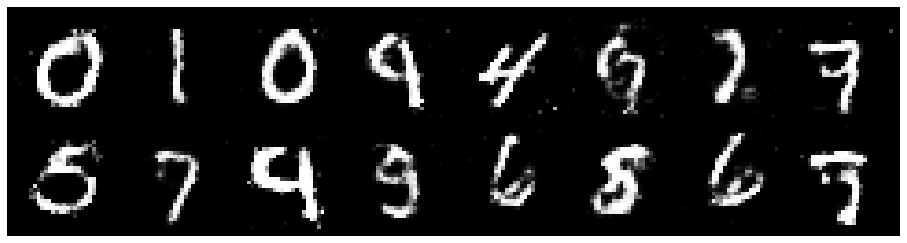

Epoch: [129/200], Batch Num: [400/600]
Discriminator Loss: 1.2825, Generator Loss: 0.8208
D(x): 0.5850, D(G(z)): 0.4796


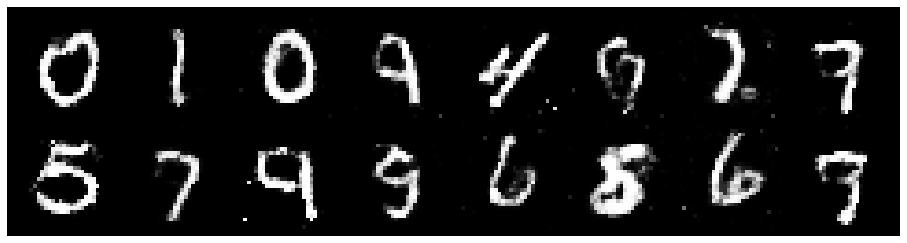

Epoch: [129/200], Batch Num: [500/600]
Discriminator Loss: 1.3238, Generator Loss: 0.9179
D(x): 0.5216, D(G(z)): 0.4271


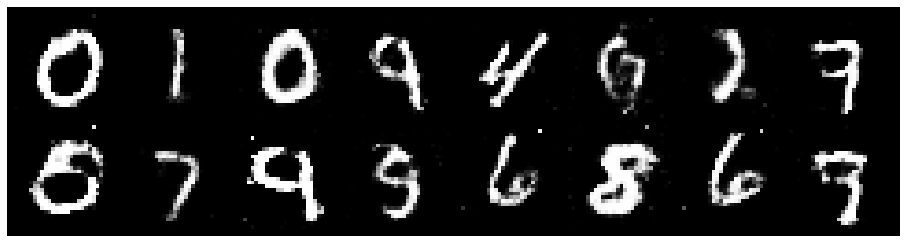

Epoch: [130/200], Batch Num: [0/600]
Discriminator Loss: 1.3284, Generator Loss: 0.9208
D(x): 0.5826, D(G(z)): 0.4833


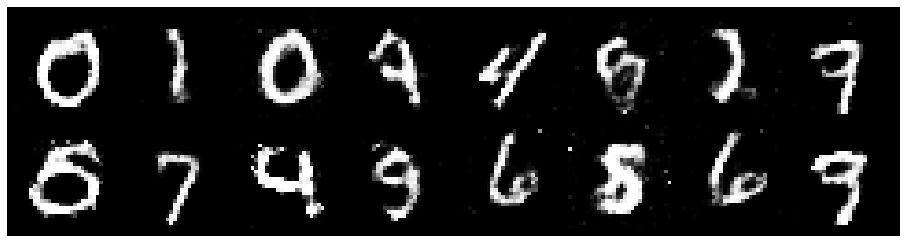

Epoch: [130/200], Batch Num: [100/600]
Discriminator Loss: 1.3123, Generator Loss: 0.8073
D(x): 0.5730, D(G(z)): 0.4426


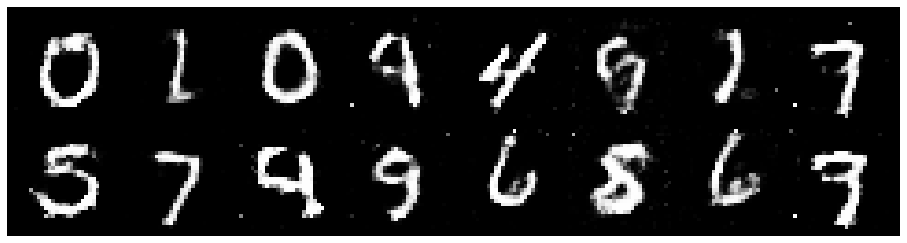

Epoch: [130/200], Batch Num: [200/600]
Discriminator Loss: 1.2458, Generator Loss: 0.8941
D(x): 0.5532, D(G(z)): 0.4140


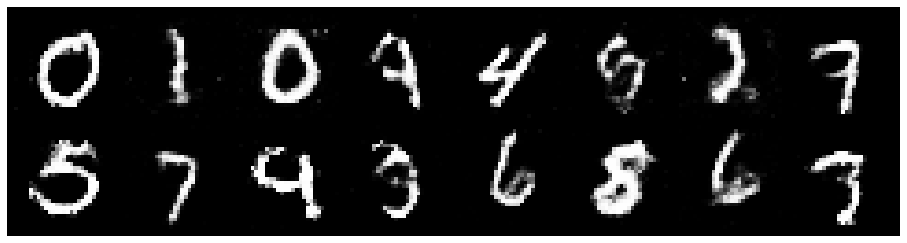

Epoch: [130/200], Batch Num: [300/600]
Discriminator Loss: 1.2355, Generator Loss: 0.9373
D(x): 0.5755, D(G(z)): 0.4266


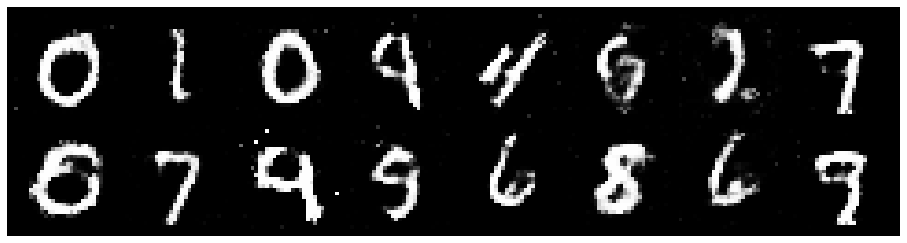

Epoch: [130/200], Batch Num: [400/600]
Discriminator Loss: 1.0763, Generator Loss: 1.0223
D(x): 0.6191, D(G(z)): 0.3832


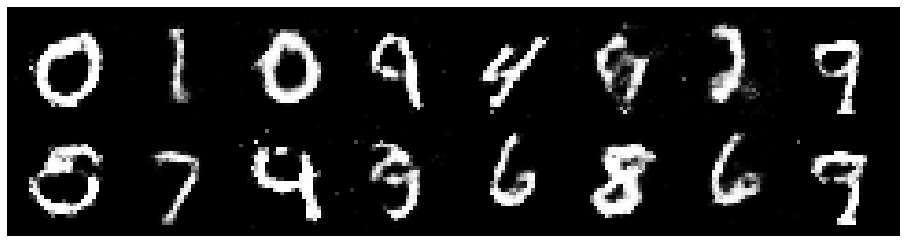

Epoch: [130/200], Batch Num: [500/600]
Discriminator Loss: 1.1323, Generator Loss: 1.0763
D(x): 0.5664, D(G(z)): 0.3722


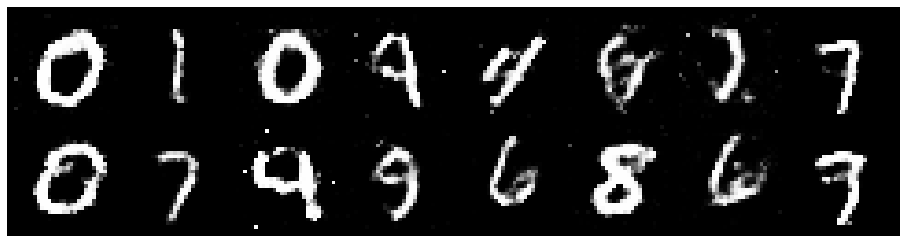

Epoch: [131/200], Batch Num: [0/600]
Discriminator Loss: 1.3532, Generator Loss: 0.9499
D(x): 0.5287, D(G(z)): 0.4361


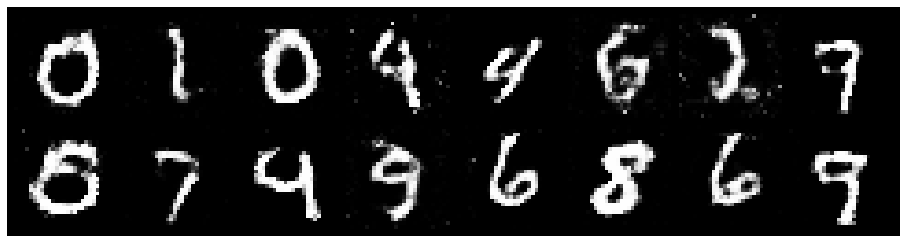

Epoch: [131/200], Batch Num: [100/600]
Discriminator Loss: 1.2719, Generator Loss: 0.8239
D(x): 0.5537, D(G(z)): 0.4572


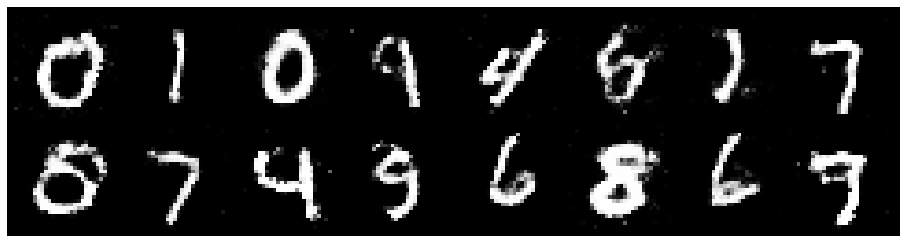

Epoch: [131/200], Batch Num: [200/600]
Discriminator Loss: 1.2147, Generator Loss: 0.7661
D(x): 0.5968, D(G(z)): 0.4593


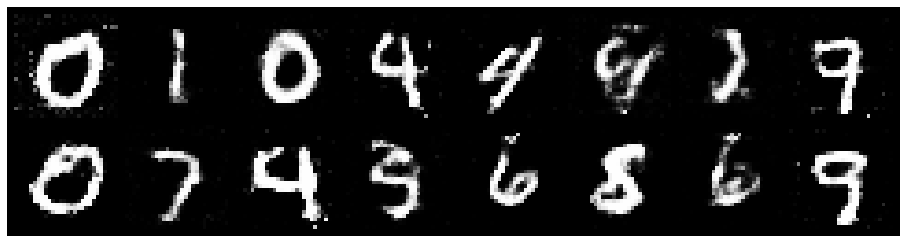

Epoch: [131/200], Batch Num: [300/600]
Discriminator Loss: 1.3340, Generator Loss: 0.8655
D(x): 0.5589, D(G(z)): 0.4569


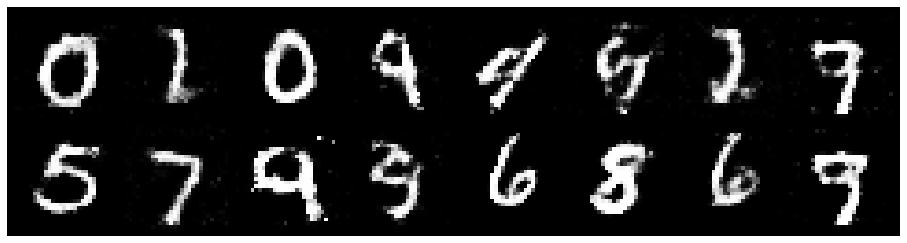

Epoch: [131/200], Batch Num: [400/600]
Discriminator Loss: 1.3177, Generator Loss: 0.7687
D(x): 0.5351, D(G(z)): 0.4614


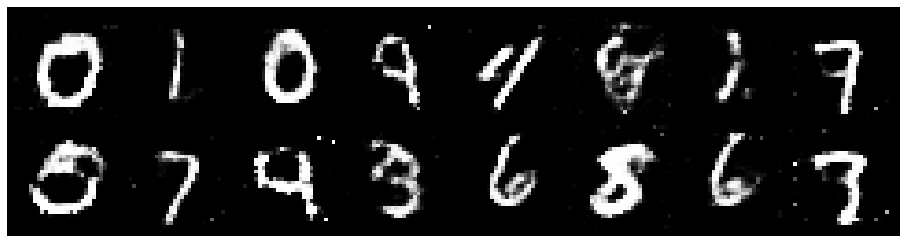

Epoch: [131/200], Batch Num: [500/600]
Discriminator Loss: 1.4044, Generator Loss: 0.8622
D(x): 0.5351, D(G(z)): 0.4742


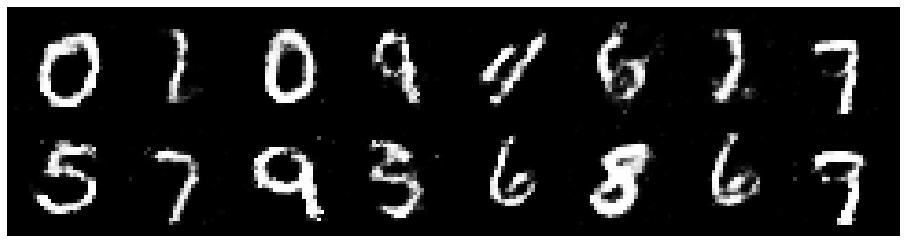

Epoch: [132/200], Batch Num: [0/600]
Discriminator Loss: 1.3652, Generator Loss: 0.8693
D(x): 0.5576, D(G(z)): 0.4827


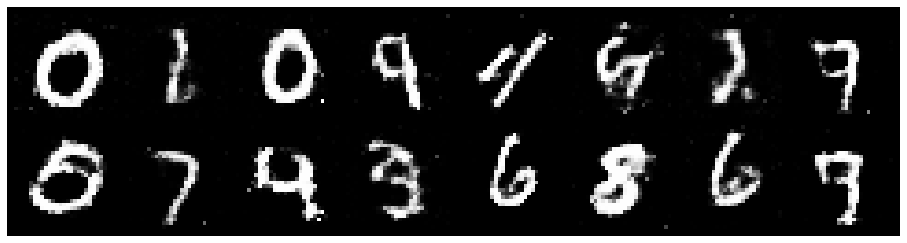

Epoch: [132/200], Batch Num: [100/600]
Discriminator Loss: 1.2666, Generator Loss: 0.9902
D(x): 0.5477, D(G(z)): 0.4409


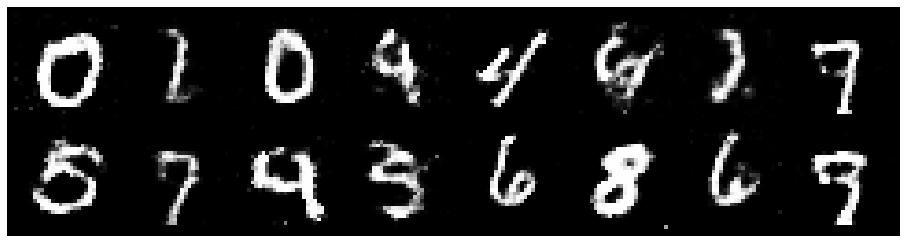

Epoch: [132/200], Batch Num: [200/600]
Discriminator Loss: 1.2265, Generator Loss: 0.9554
D(x): 0.5601, D(G(z)): 0.4285


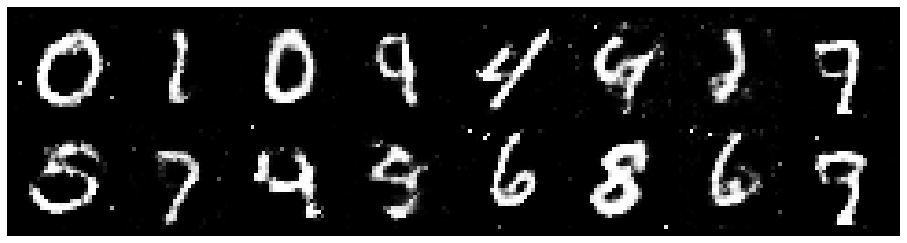

Epoch: [132/200], Batch Num: [300/600]
Discriminator Loss: 1.3123, Generator Loss: 0.8406
D(x): 0.5515, D(G(z)): 0.4711


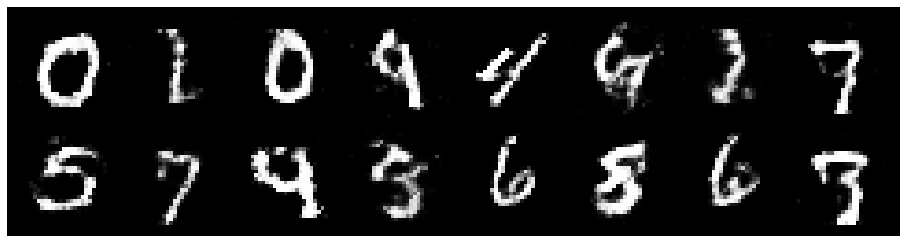

Epoch: [132/200], Batch Num: [400/600]
Discriminator Loss: 1.2352, Generator Loss: 0.8809
D(x): 0.5385, D(G(z)): 0.4162


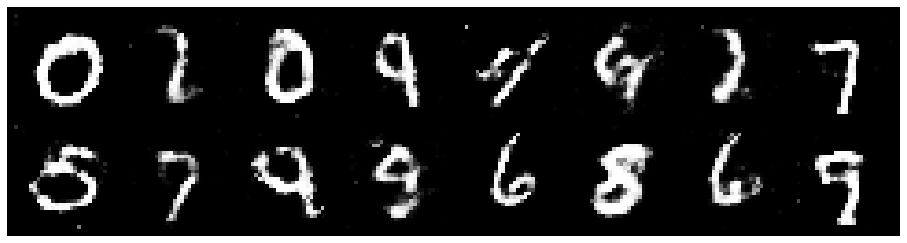

Epoch: [132/200], Batch Num: [500/600]
Discriminator Loss: 1.2849, Generator Loss: 0.8581
D(x): 0.5648, D(G(z)): 0.4719


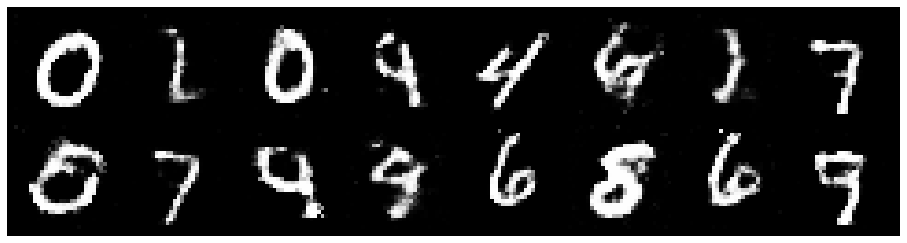

Epoch: [133/200], Batch Num: [0/600]
Discriminator Loss: 1.2387, Generator Loss: 0.8560
D(x): 0.5685, D(G(z)): 0.4505


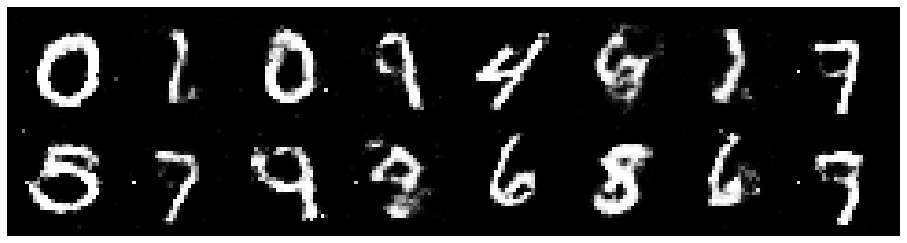

Epoch: [133/200], Batch Num: [100/600]
Discriminator Loss: 1.2665, Generator Loss: 0.9271
D(x): 0.5667, D(G(z)): 0.4517


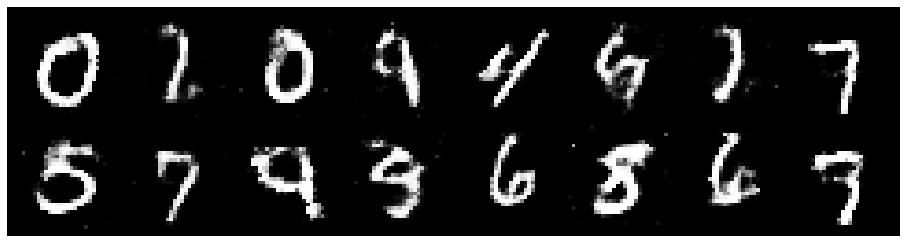

Epoch: [133/200], Batch Num: [200/600]
Discriminator Loss: 1.3171, Generator Loss: 0.8083
D(x): 0.5345, D(G(z)): 0.4559


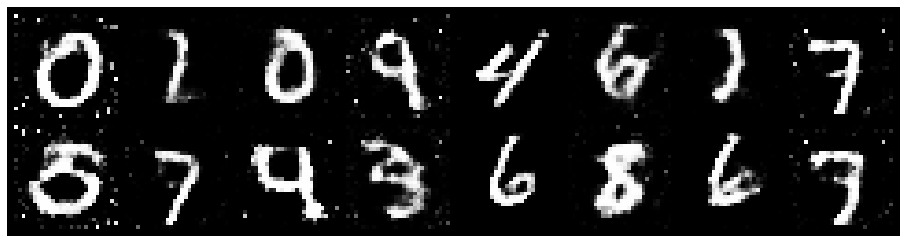

Epoch: [133/200], Batch Num: [300/600]
Discriminator Loss: 1.3494, Generator Loss: 0.8738
D(x): 0.5600, D(G(z)): 0.4765


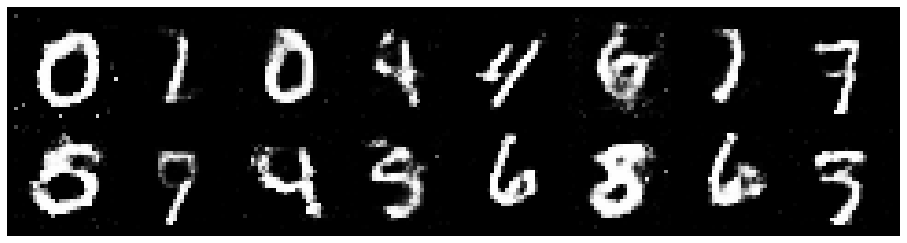

Epoch: [133/200], Batch Num: [400/600]
Discriminator Loss: 1.3296, Generator Loss: 0.7862
D(x): 0.5371, D(G(z)): 0.4797


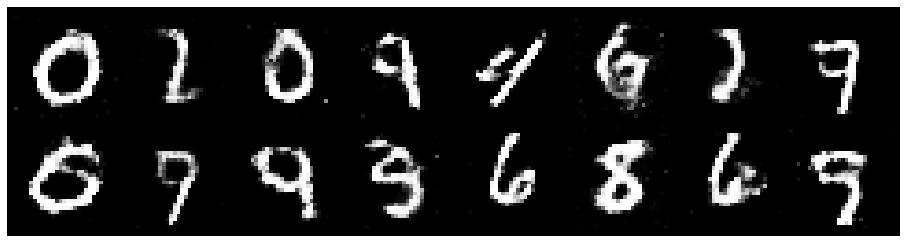

Epoch: [133/200], Batch Num: [500/600]
Discriminator Loss: 1.3269, Generator Loss: 0.9123
D(x): 0.5798, D(G(z)): 0.4725


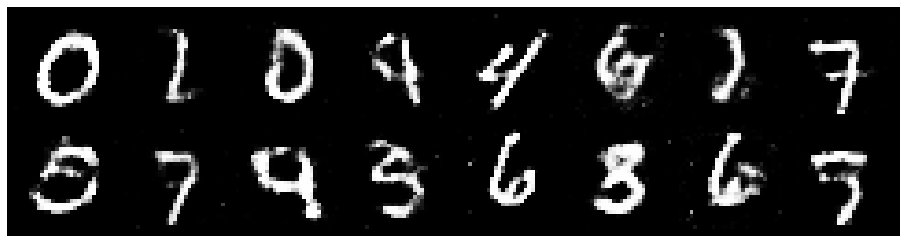

Epoch: [134/200], Batch Num: [0/600]
Discriminator Loss: 1.3641, Generator Loss: 0.9103
D(x): 0.5287, D(G(z)): 0.4467


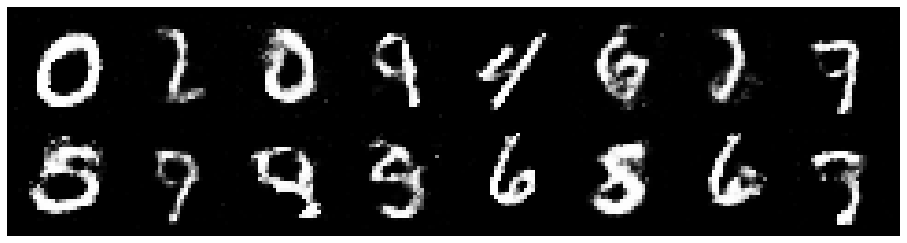

Epoch: [134/200], Batch Num: [100/600]
Discriminator Loss: 1.1926, Generator Loss: 1.0452
D(x): 0.5634, D(G(z)): 0.4094


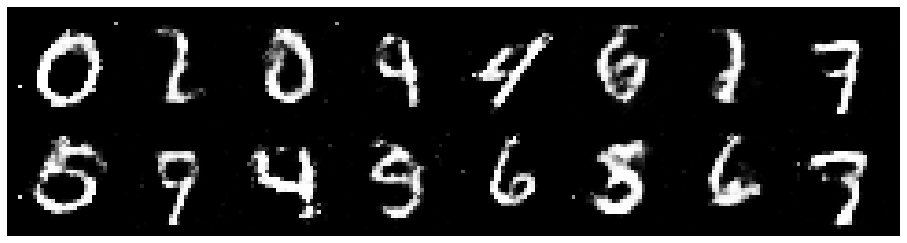

Epoch: [134/200], Batch Num: [200/600]
Discriminator Loss: 1.2375, Generator Loss: 0.9229
D(x): 0.5424, D(G(z)): 0.4176


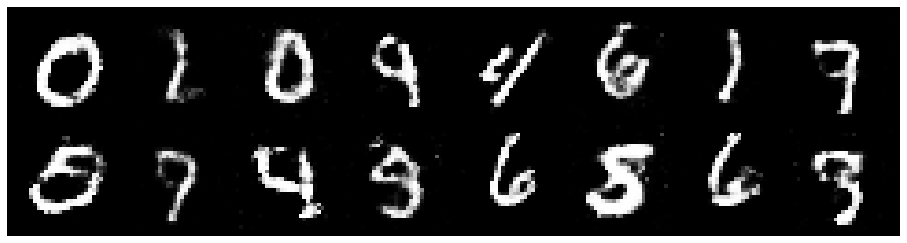

Epoch: [134/200], Batch Num: [300/600]
Discriminator Loss: 1.3230, Generator Loss: 0.9317
D(x): 0.5527, D(G(z)): 0.4711


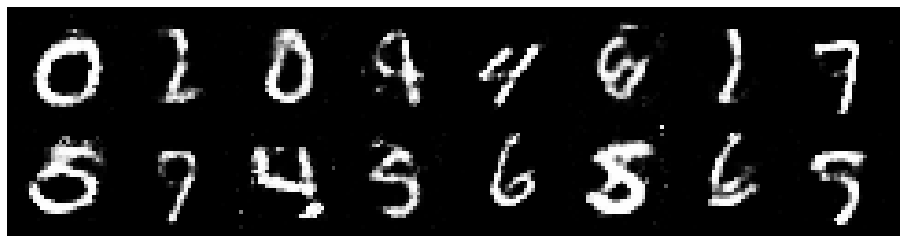

Epoch: [134/200], Batch Num: [400/600]
Discriminator Loss: 1.2769, Generator Loss: 0.8036
D(x): 0.5783, D(G(z)): 0.4697


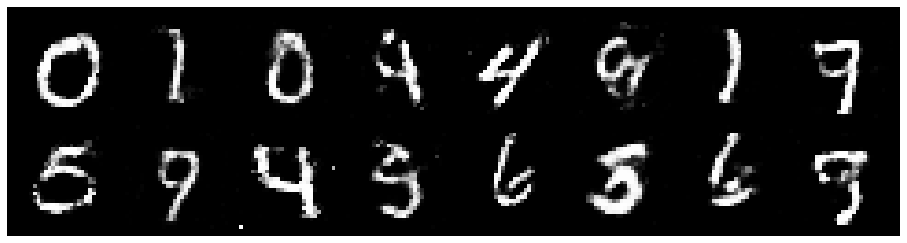

Epoch: [134/200], Batch Num: [500/600]
Discriminator Loss: 1.2646, Generator Loss: 0.9840
D(x): 0.5457, D(G(z)): 0.4340


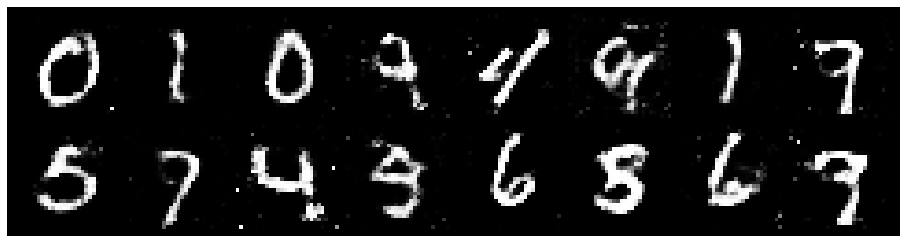

Epoch: [135/200], Batch Num: [0/600]
Discriminator Loss: 1.3314, Generator Loss: 0.8186
D(x): 0.5186, D(G(z)): 0.4314


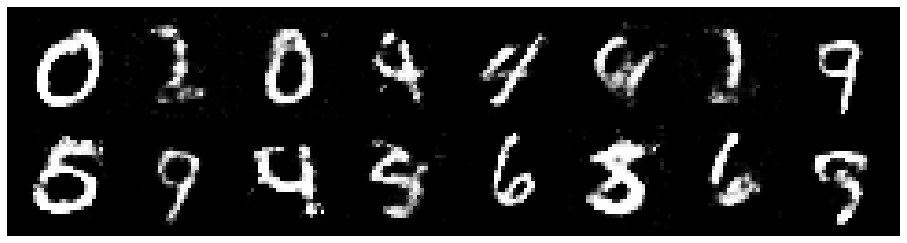

Epoch: [135/200], Batch Num: [100/600]
Discriminator Loss: 1.2572, Generator Loss: 0.8841
D(x): 0.5480, D(G(z)): 0.4269


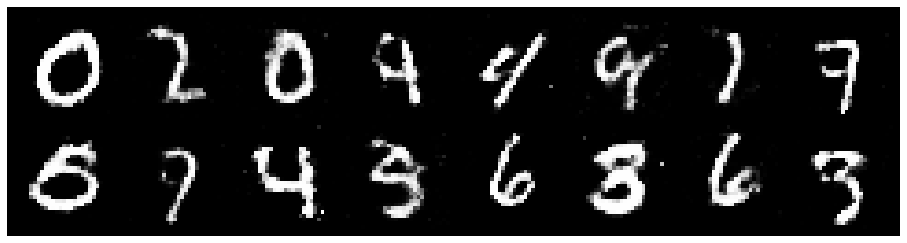

Epoch: [135/200], Batch Num: [200/600]
Discriminator Loss: 1.2703, Generator Loss: 1.0330
D(x): 0.5543, D(G(z)): 0.4046


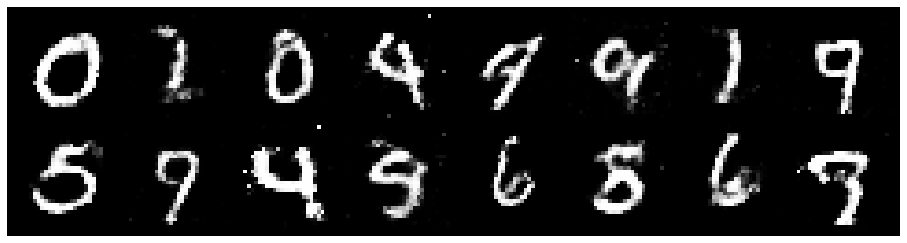

Epoch: [135/200], Batch Num: [300/600]
Discriminator Loss: 1.2431, Generator Loss: 0.9177
D(x): 0.5725, D(G(z)): 0.4421


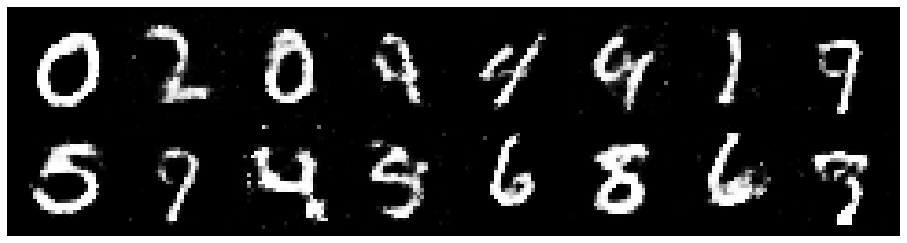

Epoch: [135/200], Batch Num: [400/600]
Discriminator Loss: 1.3055, Generator Loss: 0.8842
D(x): 0.5243, D(G(z)): 0.4230


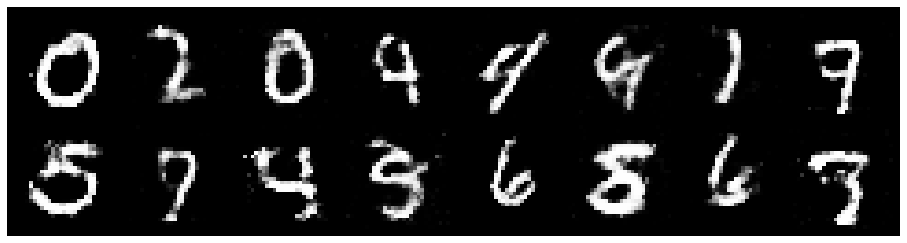

Epoch: [135/200], Batch Num: [500/600]
Discriminator Loss: 1.2839, Generator Loss: 0.9996
D(x): 0.5250, D(G(z)): 0.4142


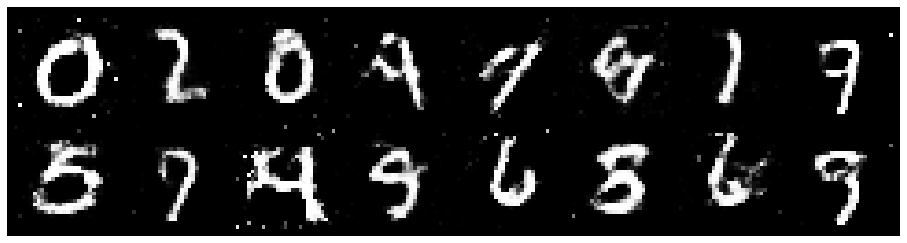

Epoch: [136/200], Batch Num: [0/600]
Discriminator Loss: 1.2296, Generator Loss: 0.9235
D(x): 0.5239, D(G(z)): 0.4105


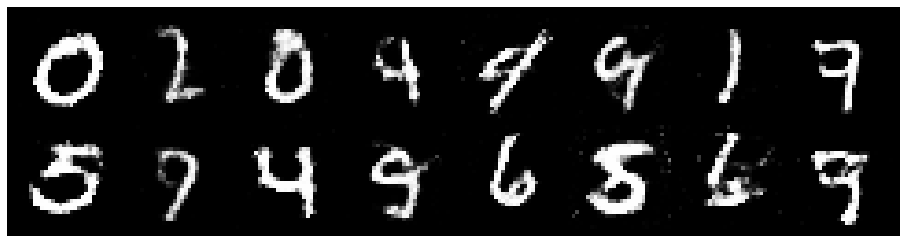

Epoch: [136/200], Batch Num: [100/600]
Discriminator Loss: 1.2016, Generator Loss: 0.8623
D(x): 0.5899, D(G(z)): 0.4547


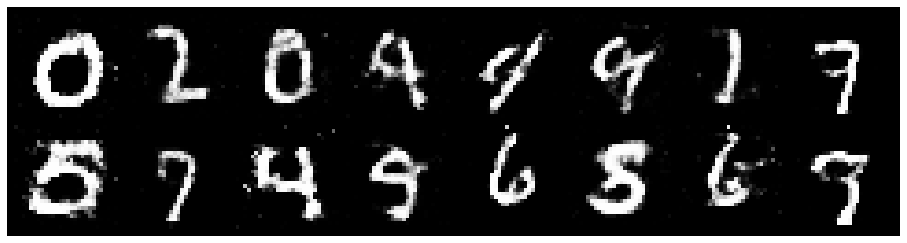

Epoch: [136/200], Batch Num: [200/600]
Discriminator Loss: 1.3259, Generator Loss: 0.8680
D(x): 0.5235, D(G(z)): 0.4603


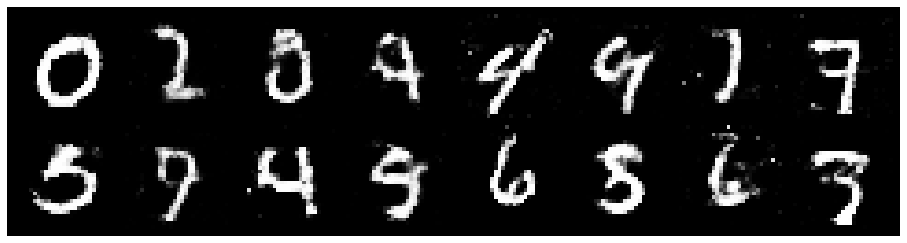

Epoch: [136/200], Batch Num: [300/600]
Discriminator Loss: 1.2066, Generator Loss: 0.9883
D(x): 0.5504, D(G(z)): 0.4022


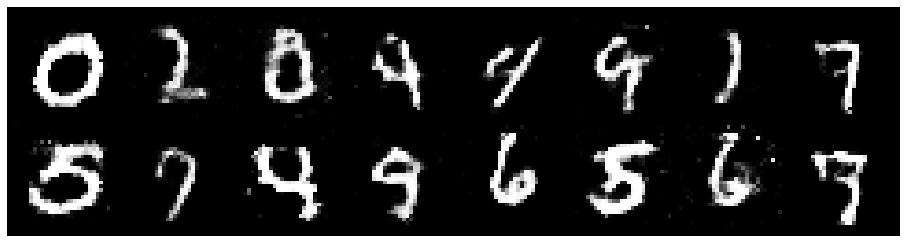

Epoch: [136/200], Batch Num: [400/600]
Discriminator Loss: 1.1851, Generator Loss: 0.9232
D(x): 0.5791, D(G(z)): 0.4362


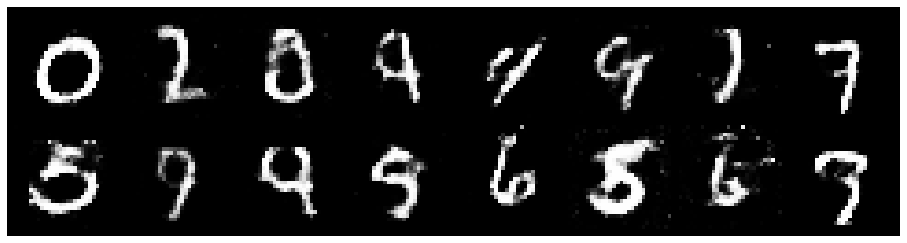

Epoch: [136/200], Batch Num: [500/600]
Discriminator Loss: 1.2544, Generator Loss: 0.9865
D(x): 0.5413, D(G(z)): 0.4186


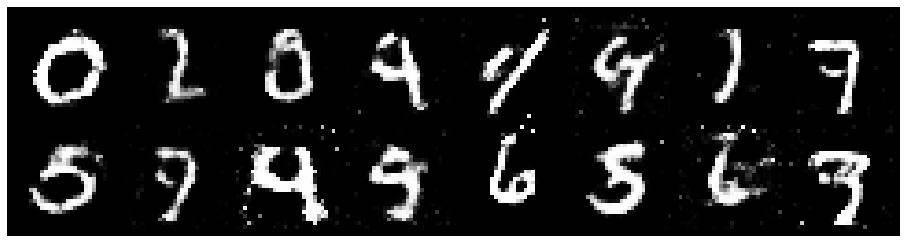

Epoch: [137/200], Batch Num: [0/600]
Discriminator Loss: 1.1589, Generator Loss: 0.8752
D(x): 0.5563, D(G(z)): 0.3960


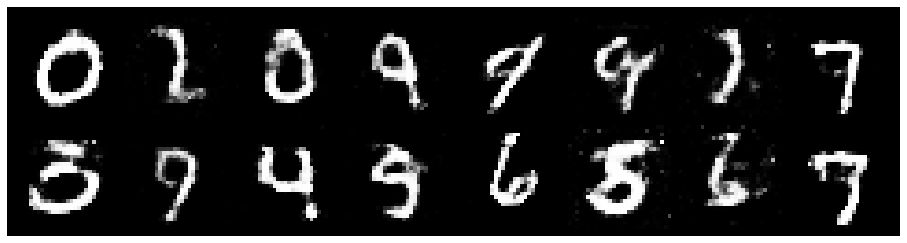

Epoch: [137/200], Batch Num: [100/600]
Discriminator Loss: 1.2628, Generator Loss: 0.9201
D(x): 0.5854, D(G(z)): 0.4591


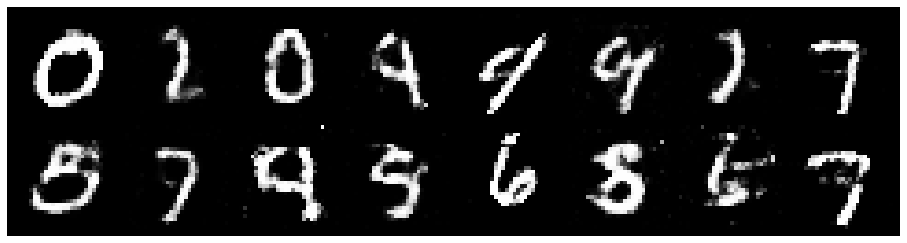

Epoch: [137/200], Batch Num: [200/600]
Discriminator Loss: 1.1159, Generator Loss: 1.0196
D(x): 0.6086, D(G(z)): 0.4070


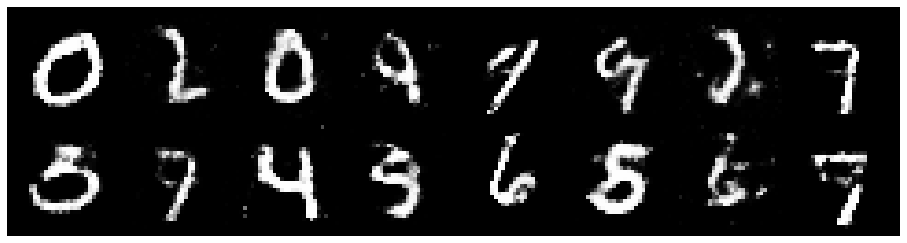

Epoch: [137/200], Batch Num: [300/600]
Discriminator Loss: 1.2424, Generator Loss: 0.8052
D(x): 0.5371, D(G(z)): 0.4361


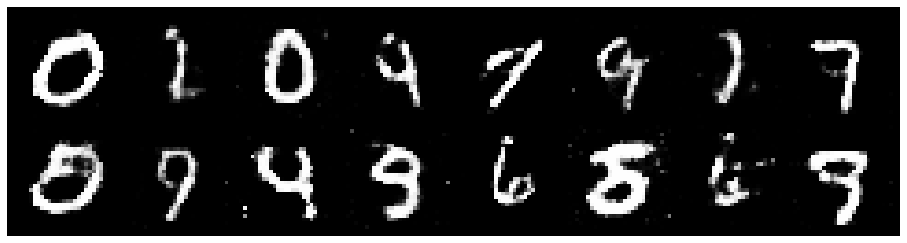

Epoch: [137/200], Batch Num: [400/600]
Discriminator Loss: 1.3096, Generator Loss: 0.9463
D(x): 0.5271, D(G(z)): 0.4296


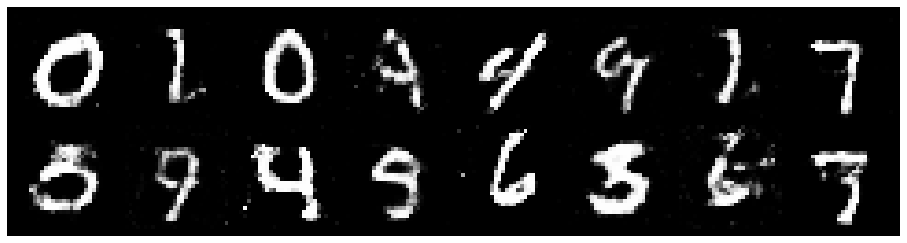

Epoch: [137/200], Batch Num: [500/600]
Discriminator Loss: 1.2489, Generator Loss: 0.8825
D(x): 0.5459, D(G(z)): 0.4288


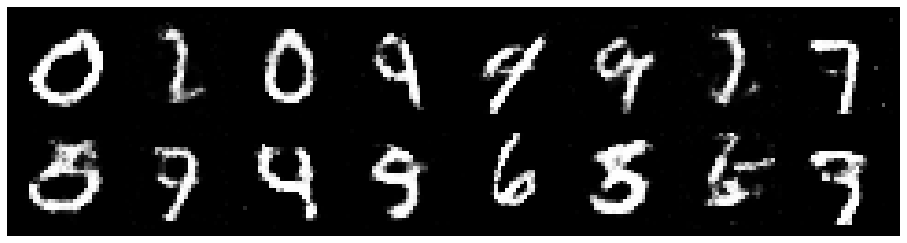

Epoch: [138/200], Batch Num: [0/600]
Discriminator Loss: 1.2463, Generator Loss: 0.9161
D(x): 0.5351, D(G(z)): 0.4181


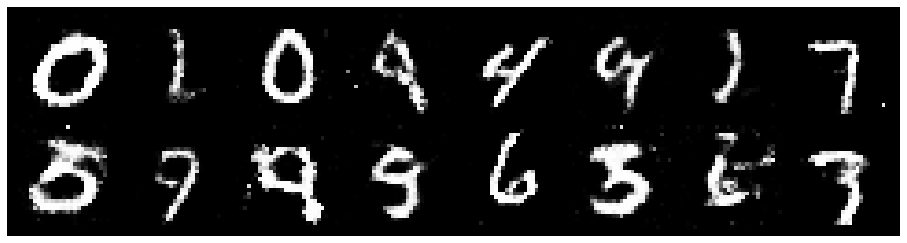

Epoch: [138/200], Batch Num: [100/600]
Discriminator Loss: 1.3430, Generator Loss: 0.8447
D(x): 0.5069, D(G(z)): 0.4605


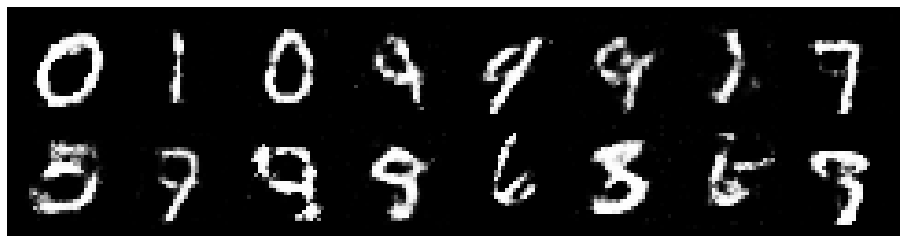

Epoch: [138/200], Batch Num: [200/600]
Discriminator Loss: 1.3473, Generator Loss: 0.8181
D(x): 0.5409, D(G(z)): 0.4619


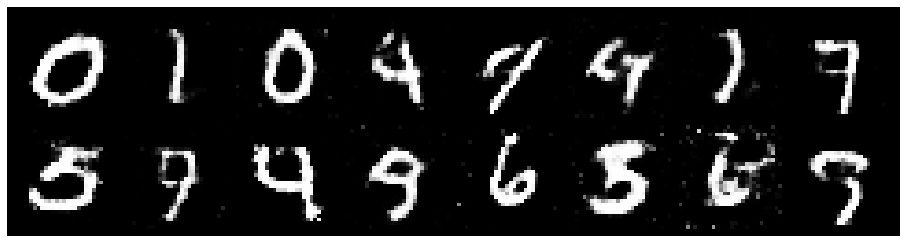

Epoch: [138/200], Batch Num: [300/600]
Discriminator Loss: 1.2726, Generator Loss: 0.8275
D(x): 0.5729, D(G(z)): 0.4599


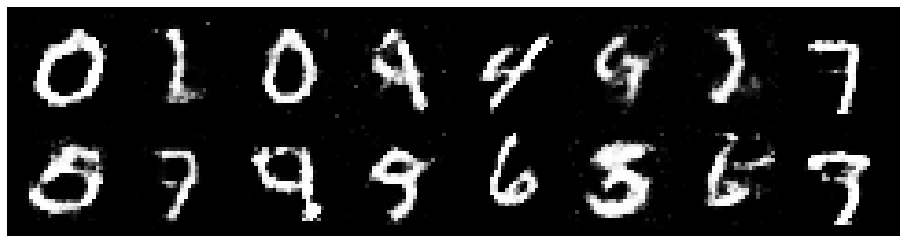

Epoch: [138/200], Batch Num: [400/600]
Discriminator Loss: 1.2783, Generator Loss: 0.7552
D(x): 0.6067, D(G(z)): 0.4821


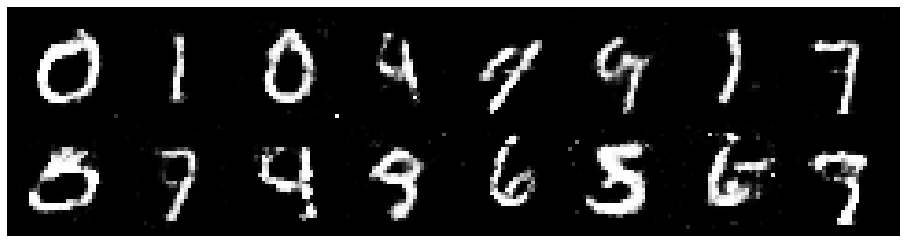

Epoch: [138/200], Batch Num: [500/600]
Discriminator Loss: 1.1841, Generator Loss: 0.9424
D(x): 0.5893, D(G(z)): 0.4248


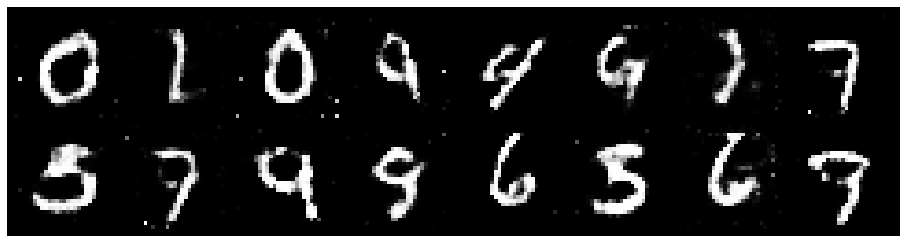

Epoch: [139/200], Batch Num: [0/600]
Discriminator Loss: 1.3052, Generator Loss: 0.8108
D(x): 0.5660, D(G(z)): 0.4824


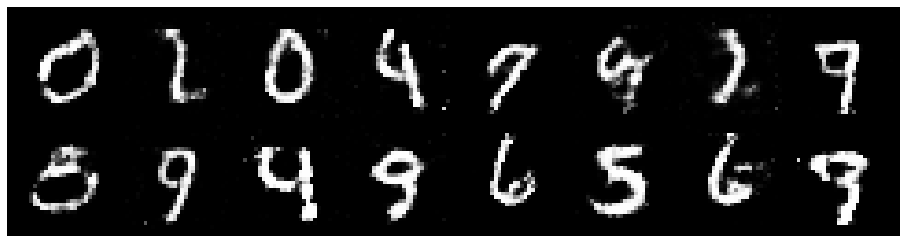

Epoch: [139/200], Batch Num: [100/600]
Discriminator Loss: 1.2930, Generator Loss: 0.8779
D(x): 0.5323, D(G(z)): 0.4433


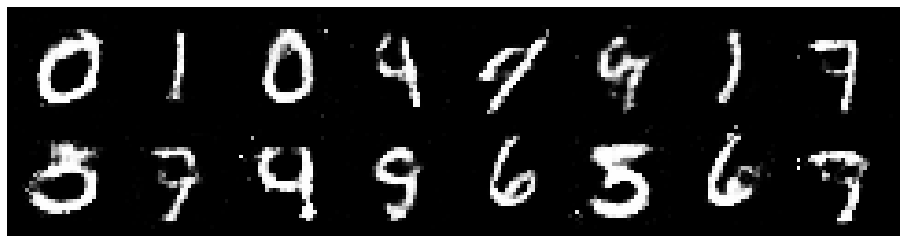

Epoch: [139/200], Batch Num: [200/600]
Discriminator Loss: 1.3165, Generator Loss: 0.7544
D(x): 0.5448, D(G(z)): 0.4766


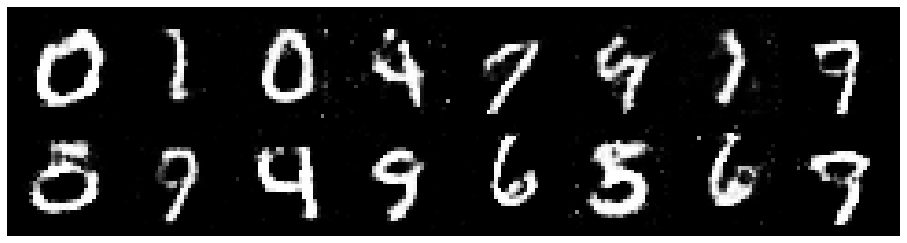

Epoch: [139/200], Batch Num: [300/600]
Discriminator Loss: 1.1913, Generator Loss: 0.8999
D(x): 0.5716, D(G(z)): 0.3850


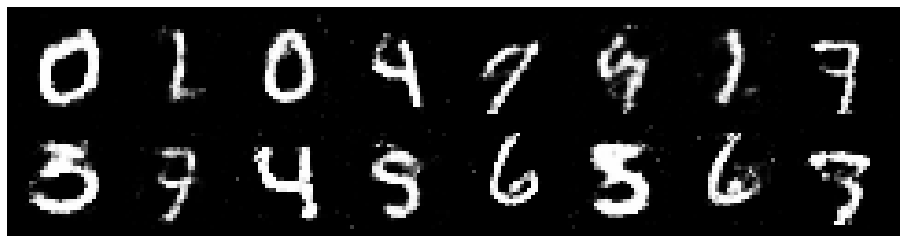

Epoch: [139/200], Batch Num: [400/600]
Discriminator Loss: 1.2359, Generator Loss: 0.9131
D(x): 0.5720, D(G(z)): 0.4315


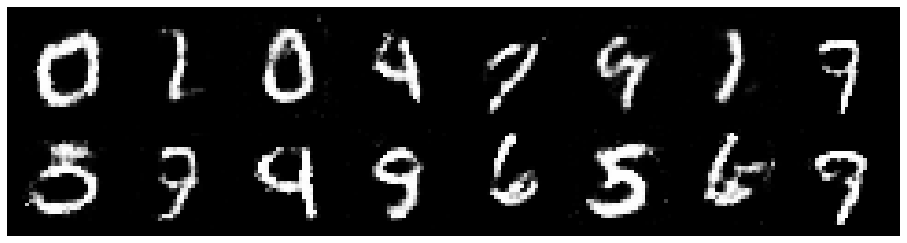

Epoch: [139/200], Batch Num: [500/600]
Discriminator Loss: 1.2178, Generator Loss: 0.9189
D(x): 0.5824, D(G(z)): 0.4424


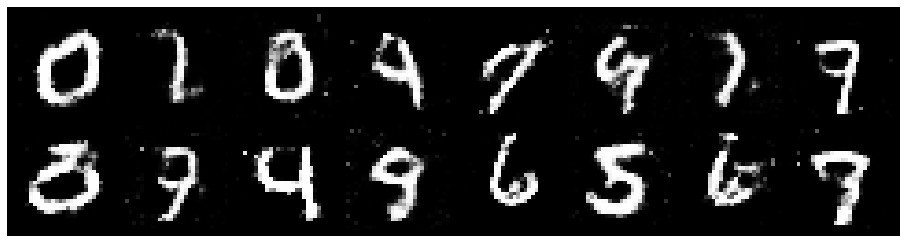

Epoch: [140/200], Batch Num: [0/600]
Discriminator Loss: 1.2479, Generator Loss: 0.8501
D(x): 0.5645, D(G(z)): 0.4469


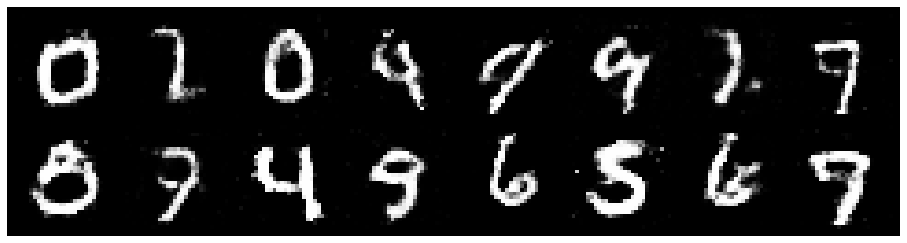

Epoch: [140/200], Batch Num: [100/600]
Discriminator Loss: 1.2978, Generator Loss: 0.8957
D(x): 0.5314, D(G(z)): 0.4515


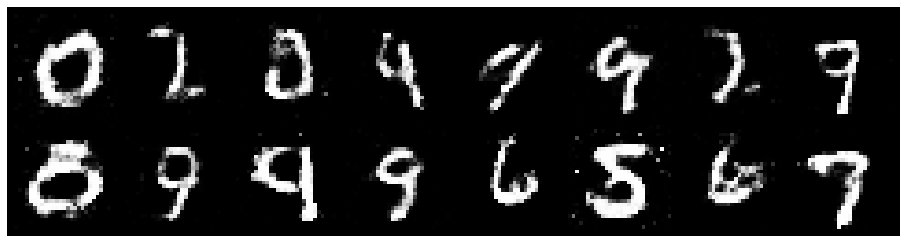

Epoch: [140/200], Batch Num: [200/600]
Discriminator Loss: 1.2697, Generator Loss: 0.8517
D(x): 0.5535, D(G(z)): 0.4591


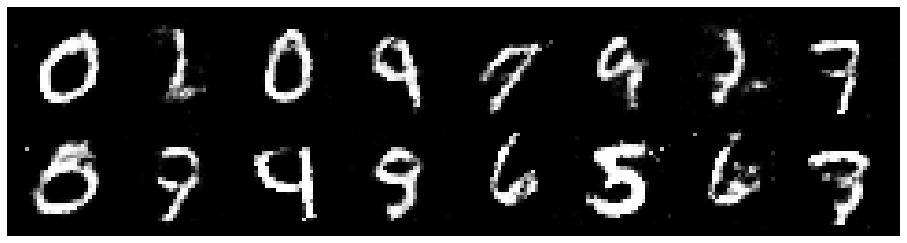

Epoch: [140/200], Batch Num: [300/600]
Discriminator Loss: 1.3015, Generator Loss: 0.9221
D(x): 0.5217, D(G(z)): 0.4334


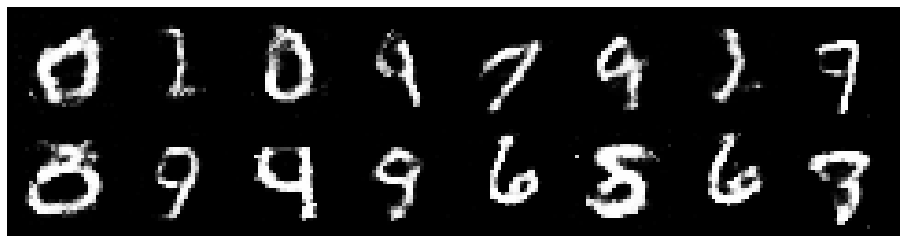

Epoch: [140/200], Batch Num: [400/600]
Discriminator Loss: 1.3174, Generator Loss: 0.9255
D(x): 0.5240, D(G(z)): 0.4460


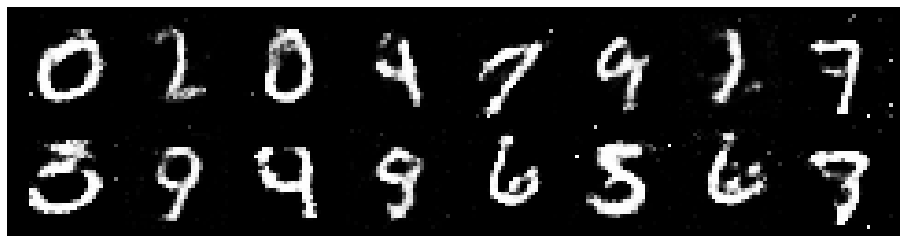

Epoch: [140/200], Batch Num: [500/600]
Discriminator Loss: 1.2533, Generator Loss: 0.8717
D(x): 0.5569, D(G(z)): 0.4504


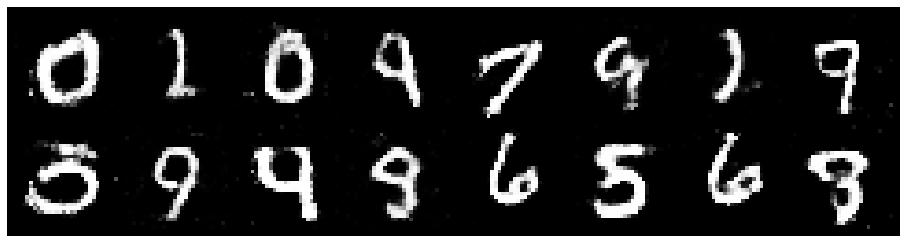

Epoch: [141/200], Batch Num: [0/600]
Discriminator Loss: 1.2781, Generator Loss: 0.7385
D(x): 0.5436, D(G(z)): 0.4602


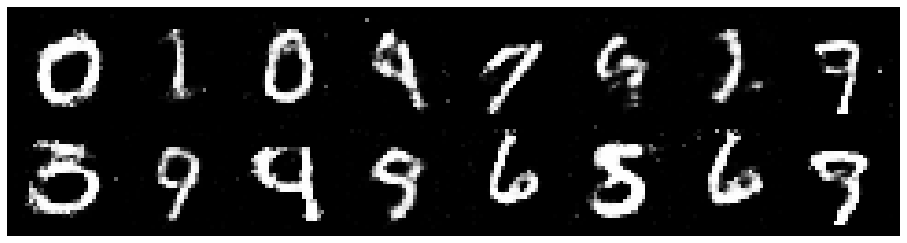

Epoch: [141/200], Batch Num: [100/600]
Discriminator Loss: 1.3999, Generator Loss: 0.7766
D(x): 0.5255, D(G(z)): 0.4665


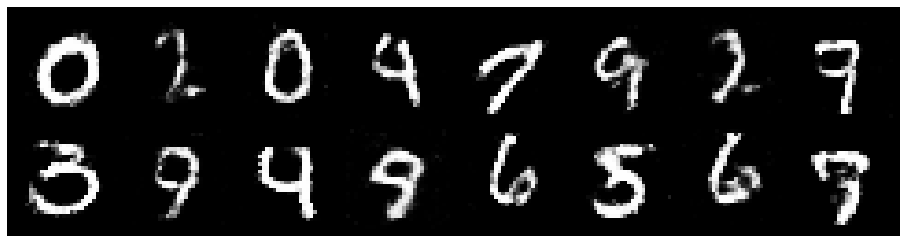

Epoch: [141/200], Batch Num: [200/600]
Discriminator Loss: 1.4734, Generator Loss: 0.9432
D(x): 0.4901, D(G(z)): 0.4806


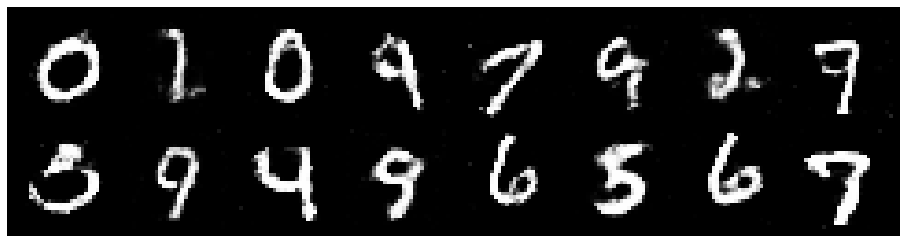

Epoch: [141/200], Batch Num: [300/600]
Discriminator Loss: 1.2806, Generator Loss: 0.9508
D(x): 0.5689, D(G(z)): 0.4525


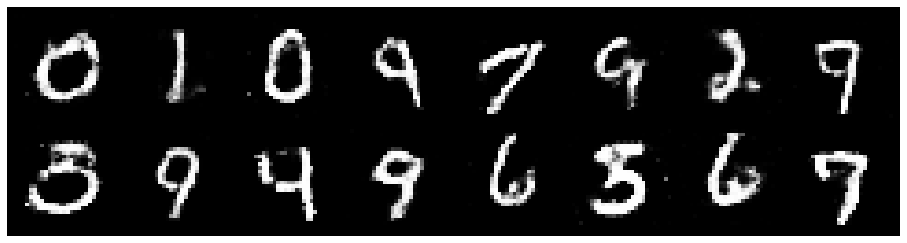

Epoch: [141/200], Batch Num: [400/600]
Discriminator Loss: 1.2791, Generator Loss: 1.0125
D(x): 0.5390, D(G(z)): 0.4238


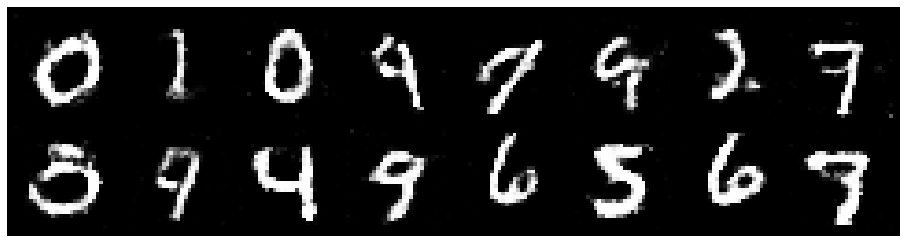

Epoch: [141/200], Batch Num: [500/600]
Discriminator Loss: 1.3442, Generator Loss: 1.0600
D(x): 0.5546, D(G(z)): 0.4650


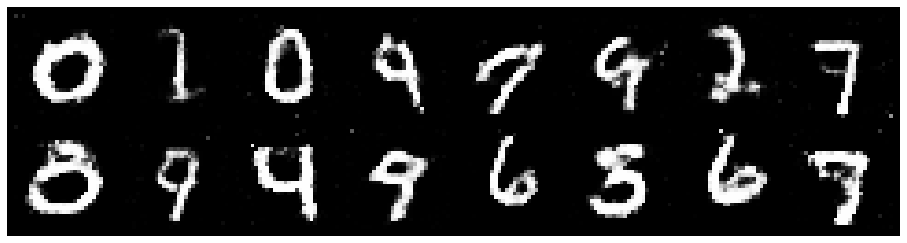

Epoch: [142/200], Batch Num: [0/600]
Discriminator Loss: 1.1337, Generator Loss: 0.9821
D(x): 0.5822, D(G(z)): 0.3841


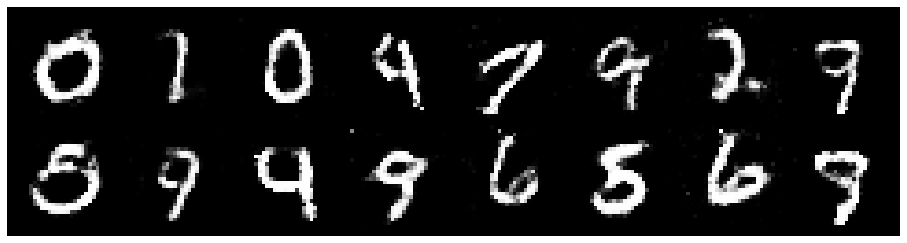

Epoch: [142/200], Batch Num: [100/600]
Discriminator Loss: 1.3394, Generator Loss: 0.7909
D(x): 0.5536, D(G(z)): 0.4881


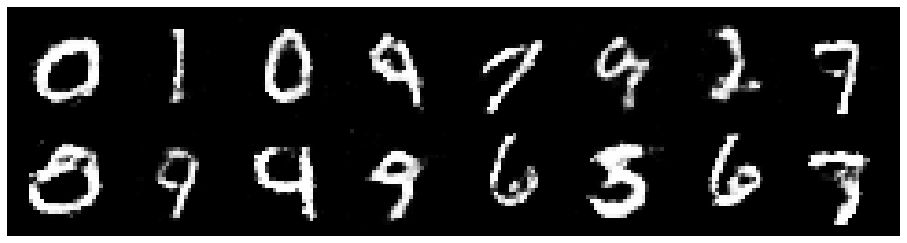

Epoch: [142/200], Batch Num: [200/600]
Discriminator Loss: 1.2623, Generator Loss: 0.8917
D(x): 0.5234, D(G(z)): 0.4213


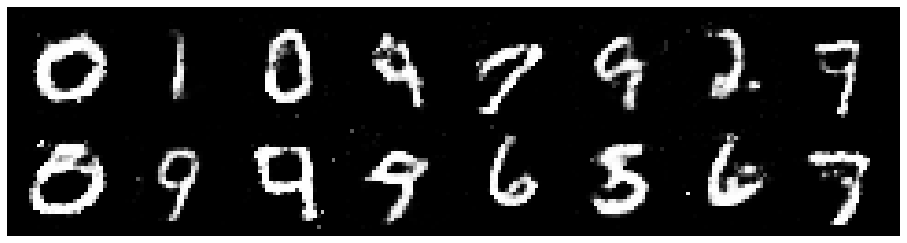

Epoch: [142/200], Batch Num: [300/600]
Discriminator Loss: 1.2874, Generator Loss: 0.8729
D(x): 0.5185, D(G(z)): 0.4116


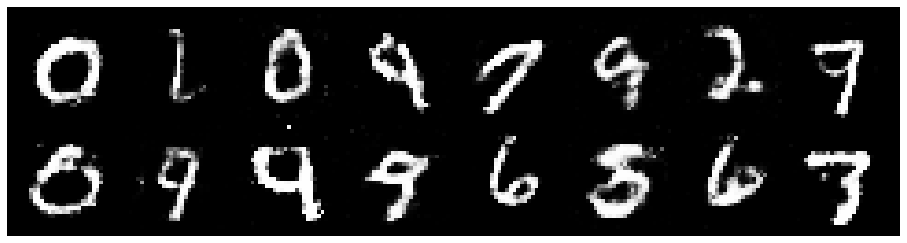

Epoch: [142/200], Batch Num: [400/600]
Discriminator Loss: 1.2187, Generator Loss: 0.8838
D(x): 0.6021, D(G(z)): 0.4551


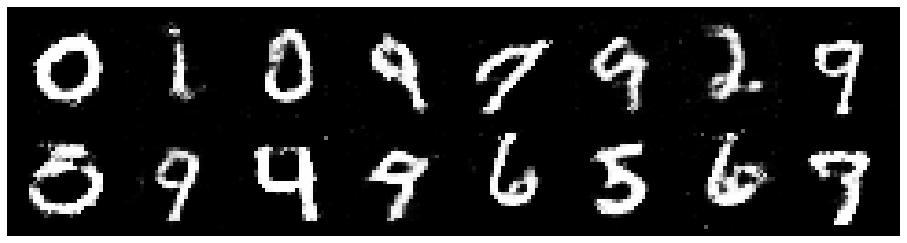

Epoch: [142/200], Batch Num: [500/600]
Discriminator Loss: 1.3208, Generator Loss: 0.8593
D(x): 0.5274, D(G(z)): 0.4603


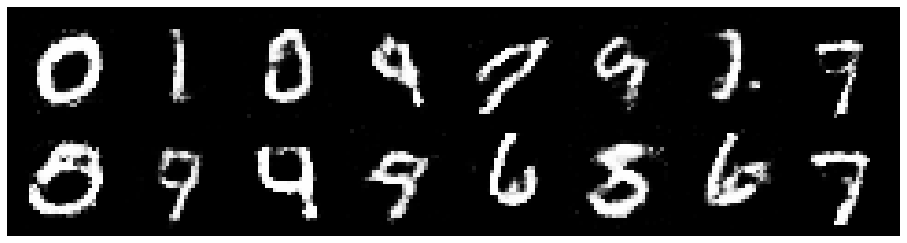

Epoch: [143/200], Batch Num: [0/600]
Discriminator Loss: 1.2735, Generator Loss: 0.8619
D(x): 0.5378, D(G(z)): 0.4407


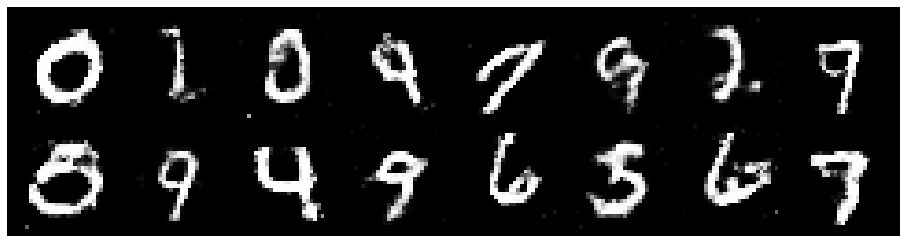

Epoch: [143/200], Batch Num: [100/600]
Discriminator Loss: 1.2617, Generator Loss: 0.8852
D(x): 0.5598, D(G(z)): 0.4399


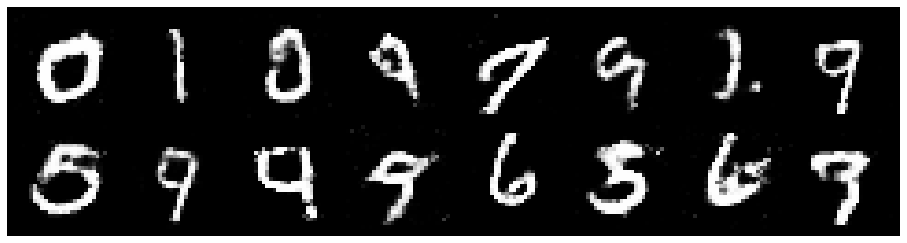

Epoch: [143/200], Batch Num: [200/600]
Discriminator Loss: 1.4049, Generator Loss: 0.9800
D(x): 0.5165, D(G(z)): 0.4146


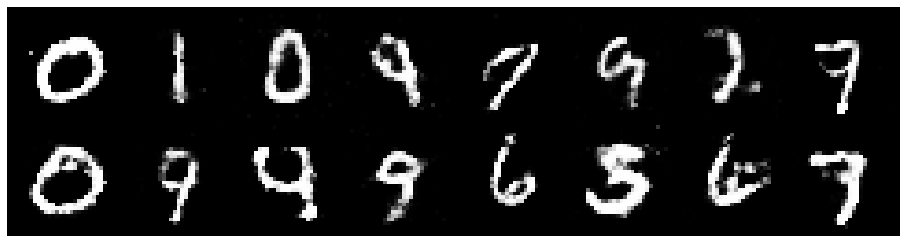

Epoch: [143/200], Batch Num: [300/600]
Discriminator Loss: 1.1419, Generator Loss: 1.1288
D(x): 0.5821, D(G(z)): 0.3900


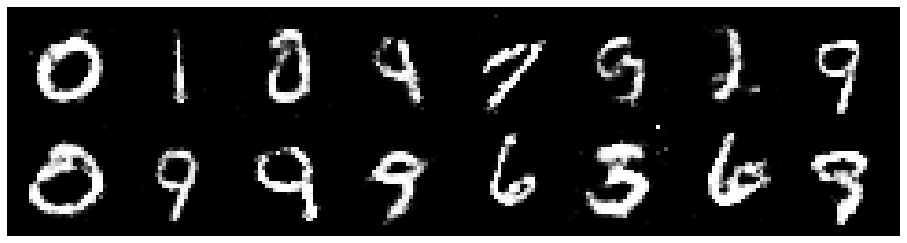

Epoch: [143/200], Batch Num: [400/600]
Discriminator Loss: 1.4102, Generator Loss: 0.8793
D(x): 0.4722, D(G(z)): 0.4340


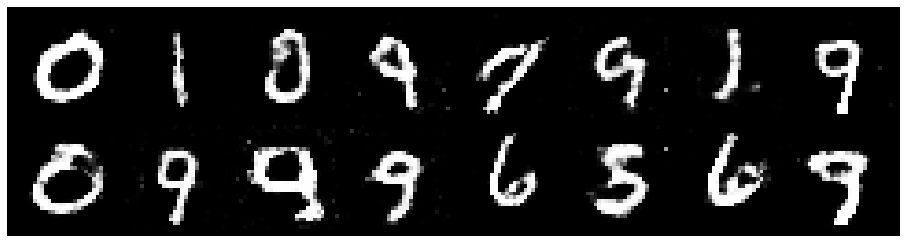

Epoch: [143/200], Batch Num: [500/600]
Discriminator Loss: 1.2617, Generator Loss: 0.8977
D(x): 0.5341, D(G(z)): 0.4213


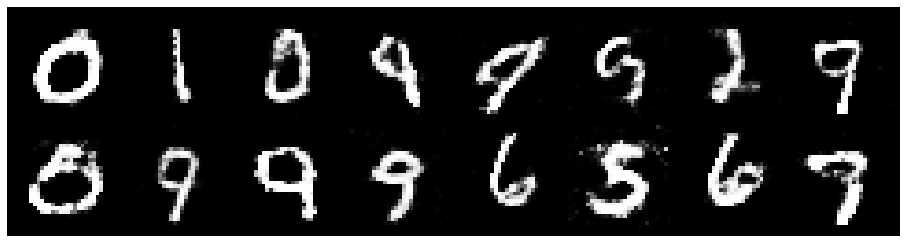

Epoch: [144/200], Batch Num: [0/600]
Discriminator Loss: 1.2837, Generator Loss: 0.7835
D(x): 0.5862, D(G(z)): 0.4757


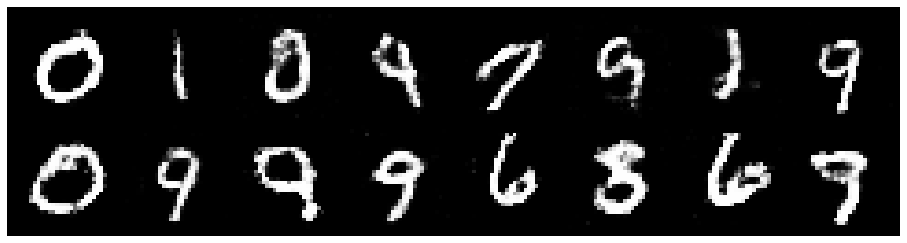

Epoch: [144/200], Batch Num: [100/600]
Discriminator Loss: 1.1653, Generator Loss: 0.9054
D(x): 0.5987, D(G(z)): 0.4260


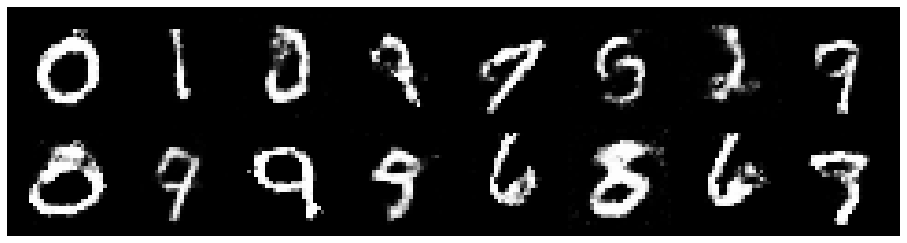

Epoch: [144/200], Batch Num: [200/600]
Discriminator Loss: 1.1532, Generator Loss: 0.9331
D(x): 0.5561, D(G(z)): 0.3915


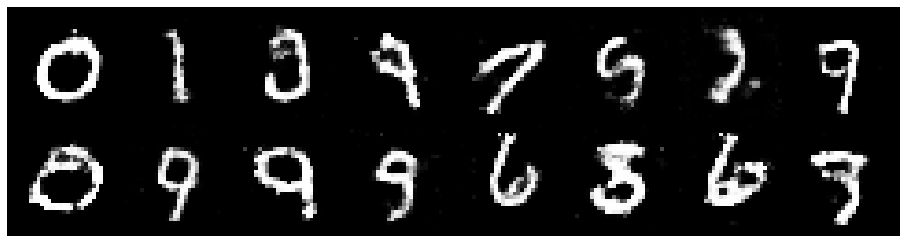

Epoch: [144/200], Batch Num: [300/600]
Discriminator Loss: 1.1988, Generator Loss: 0.8740
D(x): 0.5923, D(G(z)): 0.4404


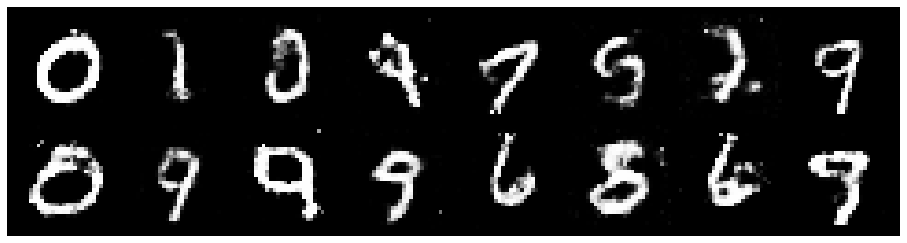

Epoch: [144/200], Batch Num: [400/600]
Discriminator Loss: 1.2508, Generator Loss: 0.9381
D(x): 0.5550, D(G(z)): 0.4179


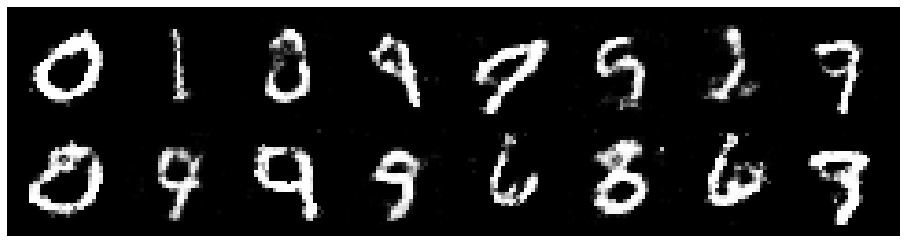

Epoch: [144/200], Batch Num: [500/600]
Discriminator Loss: 1.2551, Generator Loss: 0.8873
D(x): 0.5505, D(G(z)): 0.4489


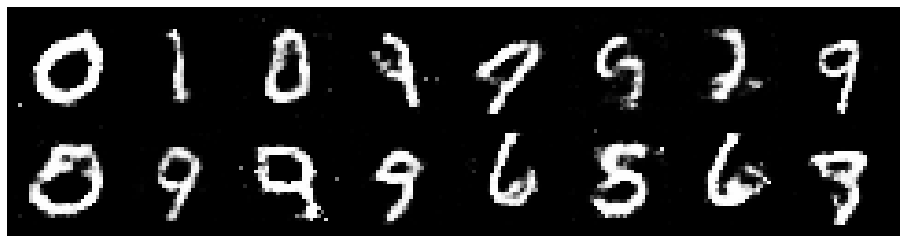

Epoch: [145/200], Batch Num: [0/600]
Discriminator Loss: 1.3340, Generator Loss: 0.8356
D(x): 0.5395, D(G(z)): 0.4451


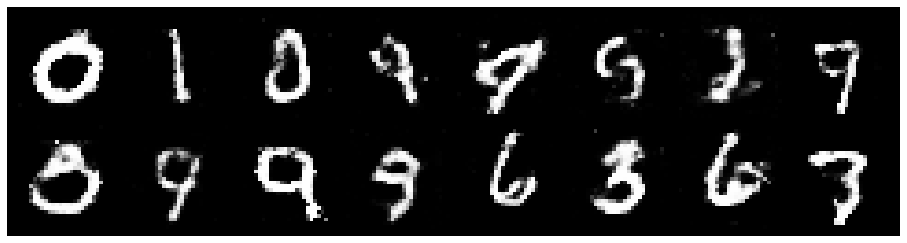

Epoch: [145/200], Batch Num: [100/600]
Discriminator Loss: 1.2966, Generator Loss: 0.8930
D(x): 0.5378, D(G(z)): 0.4308


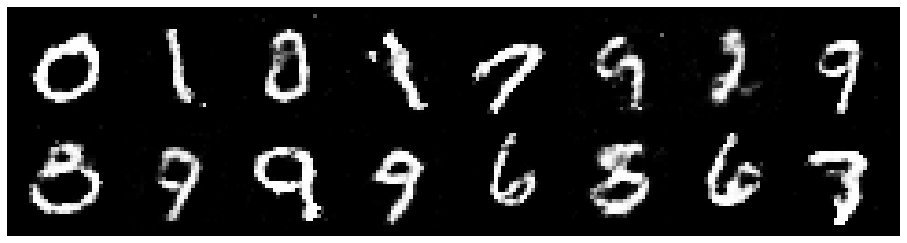

Epoch: [145/200], Batch Num: [200/600]
Discriminator Loss: 1.3647, Generator Loss: 0.8905
D(x): 0.5365, D(G(z)): 0.4577


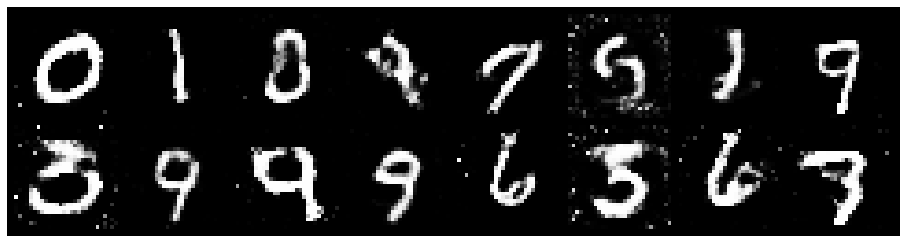

Epoch: [145/200], Batch Num: [300/600]
Discriminator Loss: 1.3156, Generator Loss: 0.8141
D(x): 0.5539, D(G(z)): 0.4609


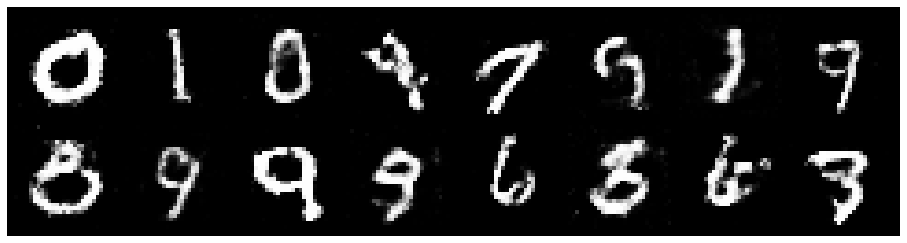

Epoch: [145/200], Batch Num: [400/600]
Discriminator Loss: 1.2007, Generator Loss: 0.9226
D(x): 0.5702, D(G(z)): 0.4291


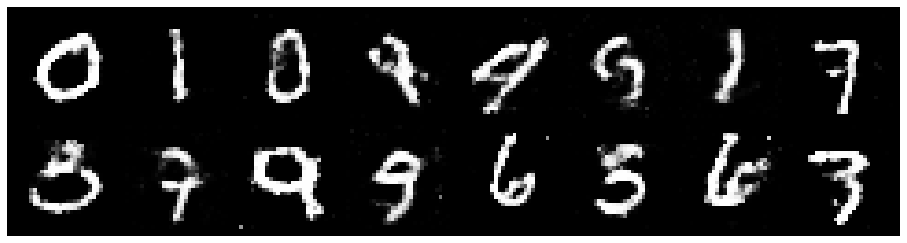

Epoch: [145/200], Batch Num: [500/600]
Discriminator Loss: 1.3020, Generator Loss: 0.8861
D(x): 0.5413, D(G(z)): 0.4645


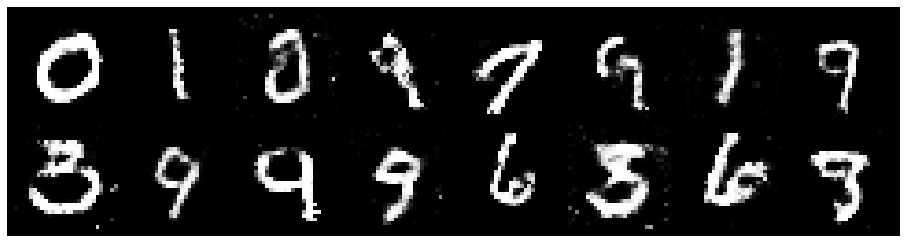

Epoch: [146/200], Batch Num: [0/600]
Discriminator Loss: 1.2717, Generator Loss: 0.8521
D(x): 0.5755, D(G(z)): 0.4816


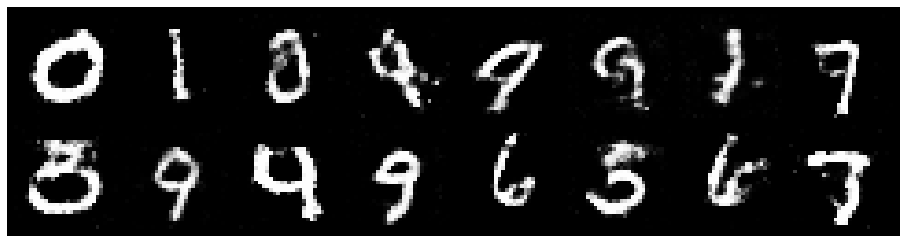

Epoch: [146/200], Batch Num: [100/600]
Discriminator Loss: 1.3691, Generator Loss: 0.8501
D(x): 0.5148, D(G(z)): 0.4643


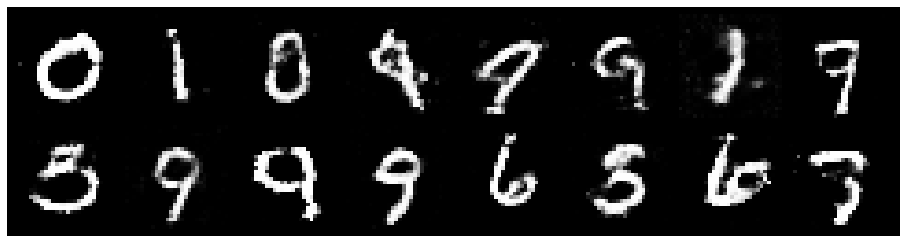

Epoch: [146/200], Batch Num: [200/600]
Discriminator Loss: 1.3584, Generator Loss: 0.7655
D(x): 0.5497, D(G(z)): 0.4869


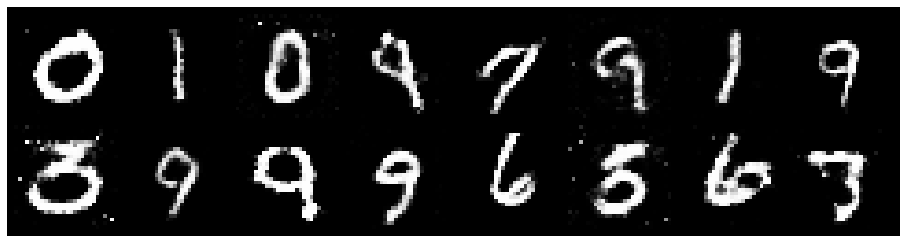

Epoch: [146/200], Batch Num: [300/600]
Discriminator Loss: 1.2573, Generator Loss: 0.9029
D(x): 0.5509, D(G(z)): 0.4417


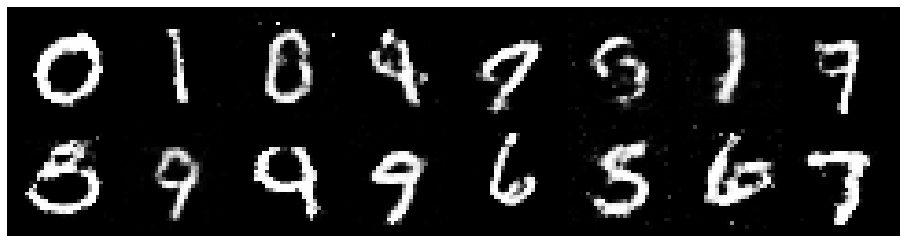

Epoch: [146/200], Batch Num: [400/600]
Discriminator Loss: 1.2939, Generator Loss: 0.9742
D(x): 0.5624, D(G(z)): 0.4597


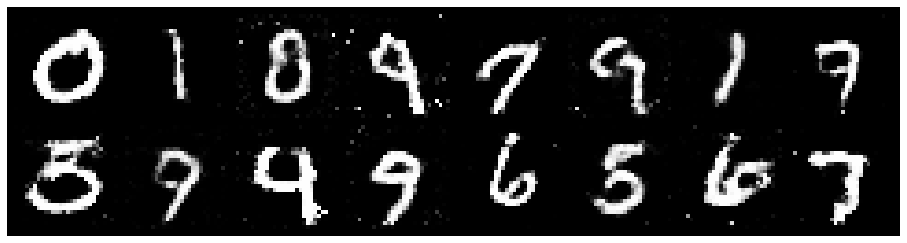

Epoch: [146/200], Batch Num: [500/600]
Discriminator Loss: 1.3177, Generator Loss: 1.1041
D(x): 0.5641, D(G(z)): 0.4230


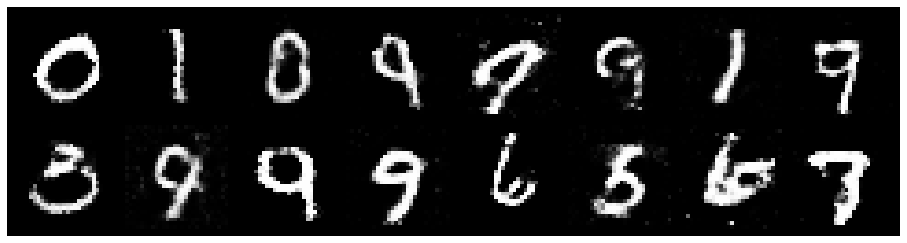

Epoch: [147/200], Batch Num: [0/600]
Discriminator Loss: 1.2861, Generator Loss: 1.1634
D(x): 0.5731, D(G(z)): 0.4431


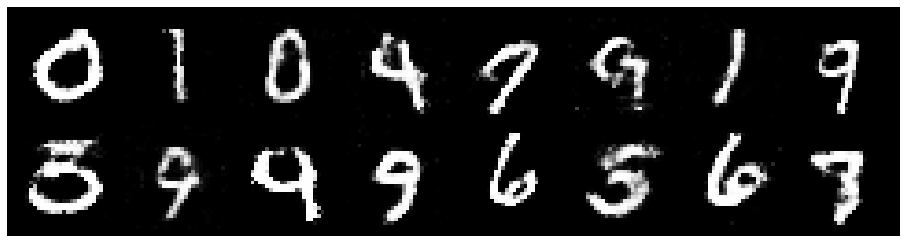

Epoch: [147/200], Batch Num: [100/600]
Discriminator Loss: 1.3201, Generator Loss: 1.0776
D(x): 0.5947, D(G(z)): 0.4578


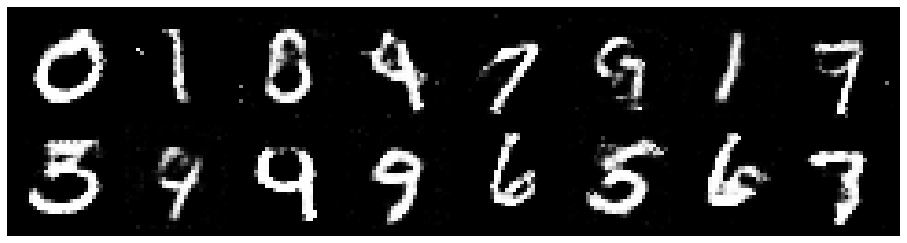

Epoch: [147/200], Batch Num: [200/600]
Discriminator Loss: 1.1604, Generator Loss: 1.0723
D(x): 0.5387, D(G(z)): 0.3850


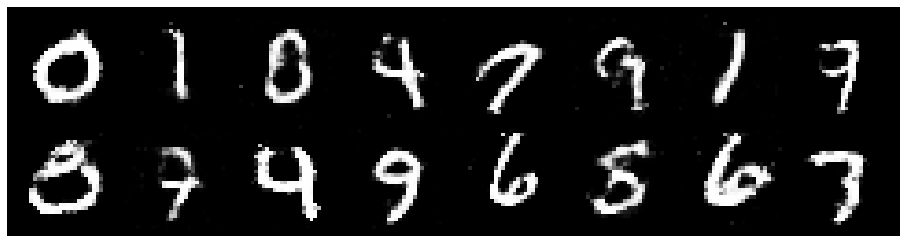

Epoch: [147/200], Batch Num: [300/600]
Discriminator Loss: 1.2786, Generator Loss: 1.0826
D(x): 0.6016, D(G(z)): 0.4662


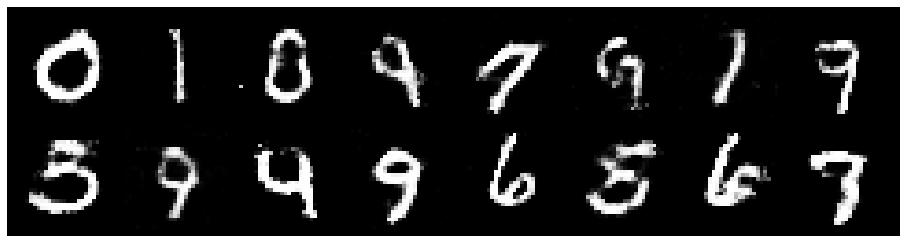

Epoch: [147/200], Batch Num: [400/600]
Discriminator Loss: 1.2439, Generator Loss: 0.9620
D(x): 0.5819, D(G(z)): 0.4332


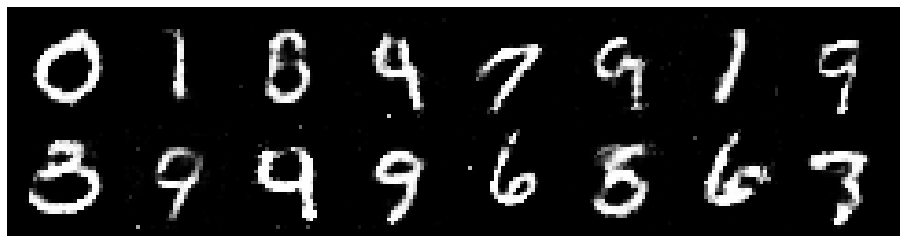

Epoch: [147/200], Batch Num: [500/600]
Discriminator Loss: 1.1838, Generator Loss: 0.9552
D(x): 0.5825, D(G(z)): 0.4199


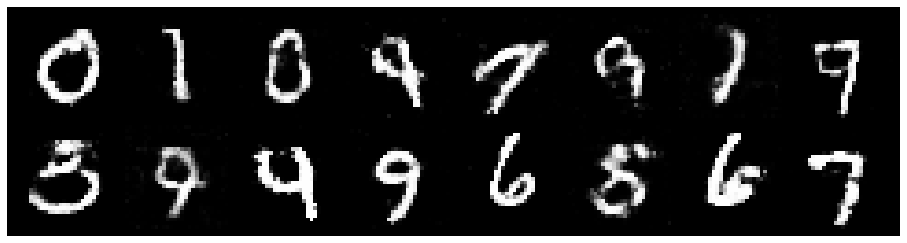

Epoch: [148/200], Batch Num: [0/600]
Discriminator Loss: 1.2611, Generator Loss: 0.9086
D(x): 0.5232, D(G(z)): 0.4085


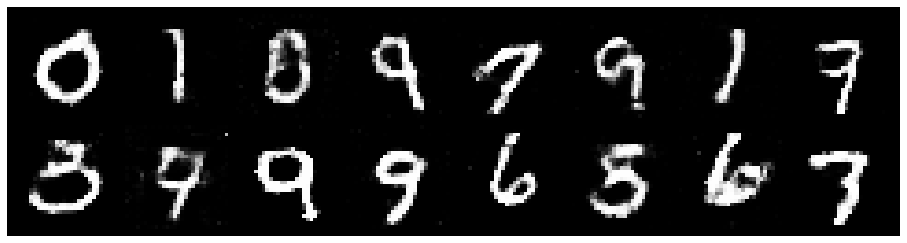

Epoch: [148/200], Batch Num: [100/600]
Discriminator Loss: 1.2113, Generator Loss: 0.9758
D(x): 0.5635, D(G(z)): 0.4338


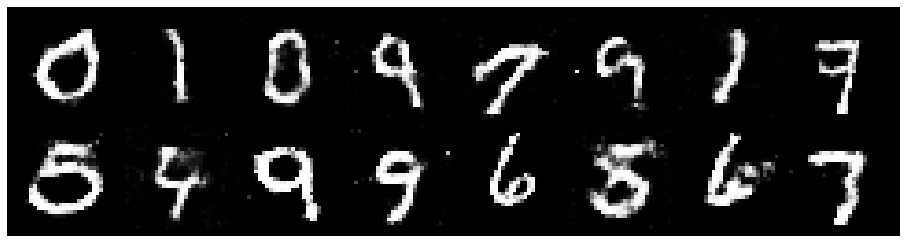

Epoch: [148/200], Batch Num: [200/600]
Discriminator Loss: 1.3004, Generator Loss: 0.7496
D(x): 0.5569, D(G(z)): 0.4588


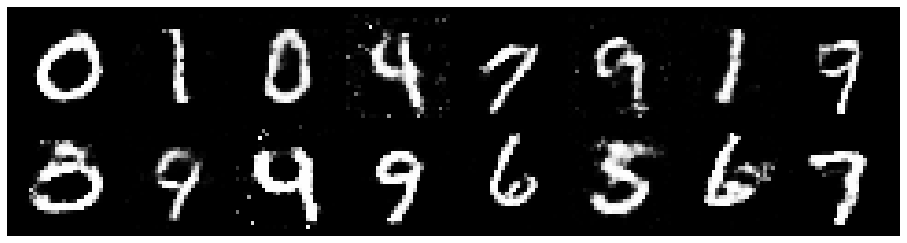

Epoch: [148/200], Batch Num: [300/600]
Discriminator Loss: 1.2611, Generator Loss: 0.8494
D(x): 0.5751, D(G(z)): 0.4604


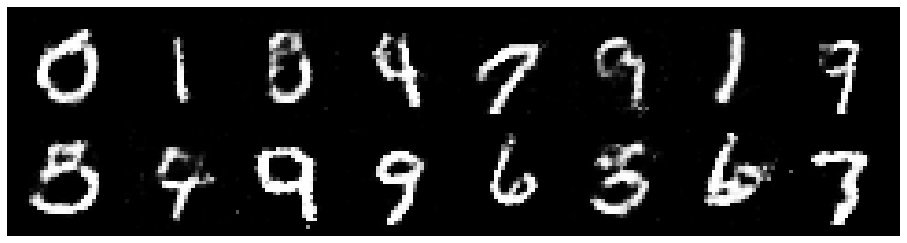

Epoch: [148/200], Batch Num: [400/600]
Discriminator Loss: 1.2944, Generator Loss: 0.8597
D(x): 0.5768, D(G(z)): 0.4875


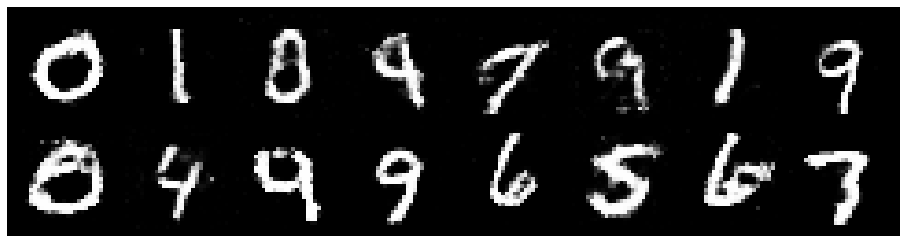

Epoch: [148/200], Batch Num: [500/600]
Discriminator Loss: 1.2588, Generator Loss: 0.8265
D(x): 0.5551, D(G(z)): 0.4376


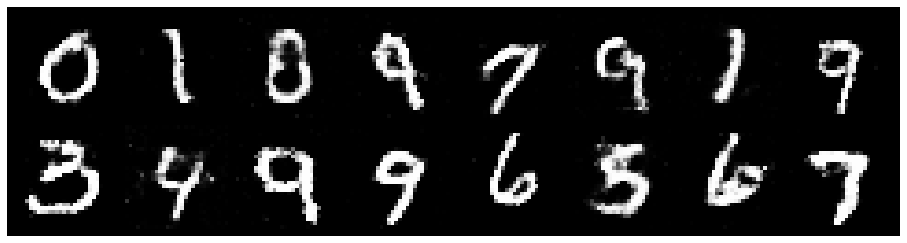

Epoch: [149/200], Batch Num: [0/600]
Discriminator Loss: 1.2651, Generator Loss: 0.9157
D(x): 0.5411, D(G(z)): 0.4418


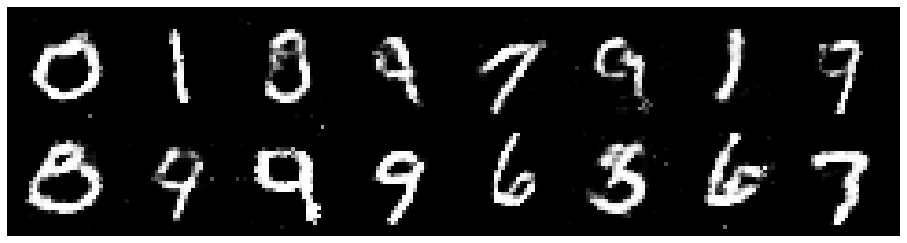

Epoch: [149/200], Batch Num: [100/600]
Discriminator Loss: 1.3198, Generator Loss: 0.9356
D(x): 0.5151, D(G(z)): 0.4276


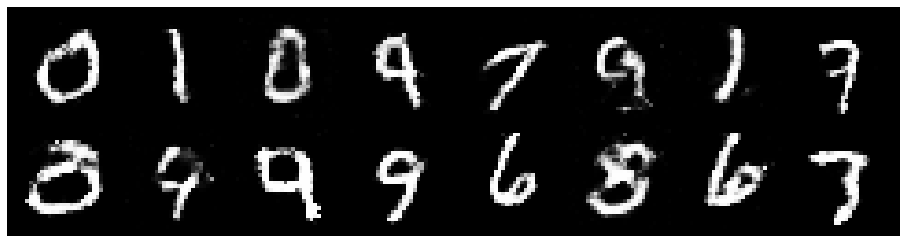

Epoch: [149/200], Batch Num: [200/600]
Discriminator Loss: 1.3877, Generator Loss: 0.8809
D(x): 0.5164, D(G(z)): 0.4595


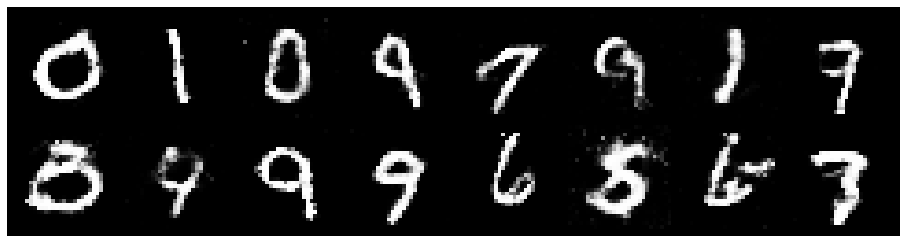

Epoch: [149/200], Batch Num: [300/600]
Discriminator Loss: 1.2612, Generator Loss: 0.9380
D(x): 0.5614, D(G(z)): 0.4245


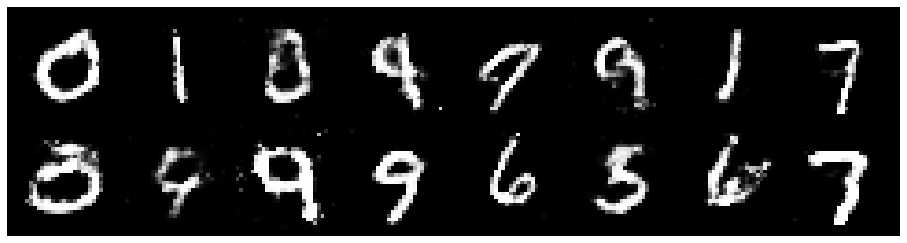

Epoch: [149/200], Batch Num: [400/600]
Discriminator Loss: 1.2457, Generator Loss: 0.8769
D(x): 0.5441, D(G(z)): 0.4131


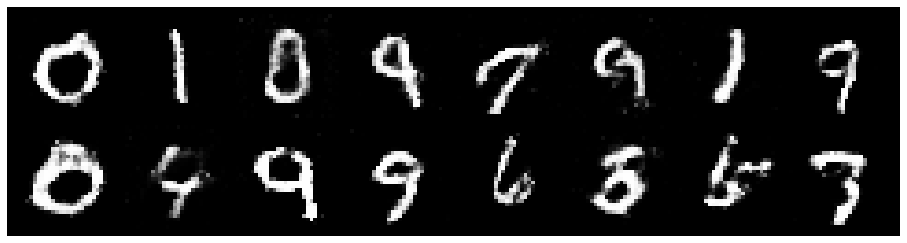

Epoch: [149/200], Batch Num: [500/600]
Discriminator Loss: 1.3515, Generator Loss: 0.8332
D(x): 0.5371, D(G(z)): 0.4833


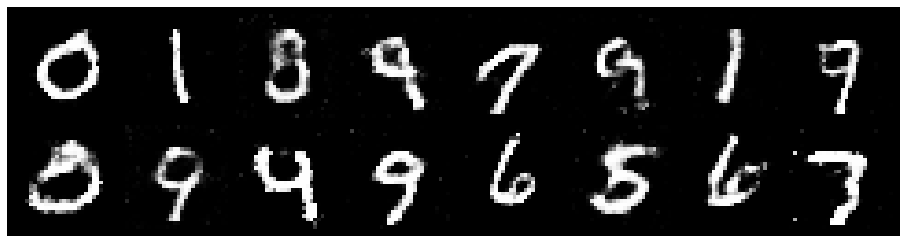

Epoch: [150/200], Batch Num: [0/600]
Discriminator Loss: 1.3156, Generator Loss: 0.8002
D(x): 0.5772, D(G(z)): 0.5051


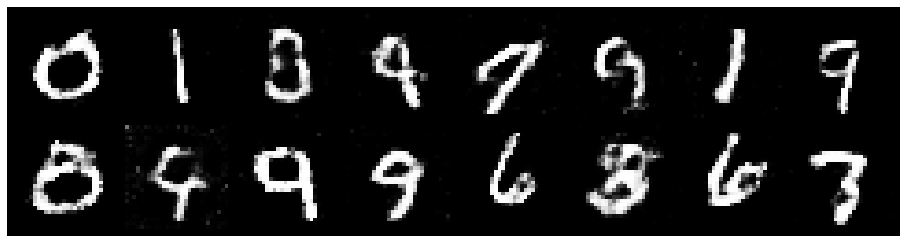

Epoch: [150/200], Batch Num: [100/600]
Discriminator Loss: 1.2056, Generator Loss: 0.9236
D(x): 0.5605, D(G(z)): 0.4173


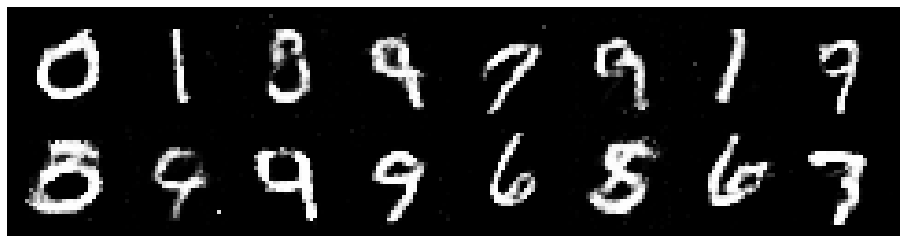

Epoch: [150/200], Batch Num: [200/600]
Discriminator Loss: 1.2753, Generator Loss: 0.9133
D(x): 0.5406, D(G(z)): 0.4372


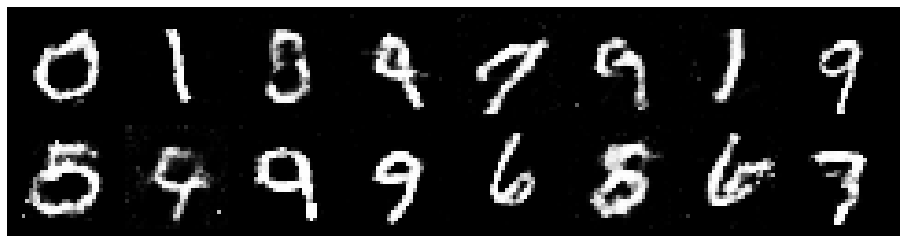

Epoch: [150/200], Batch Num: [300/600]
Discriminator Loss: 1.2535, Generator Loss: 0.9596
D(x): 0.5560, D(G(z)): 0.4281


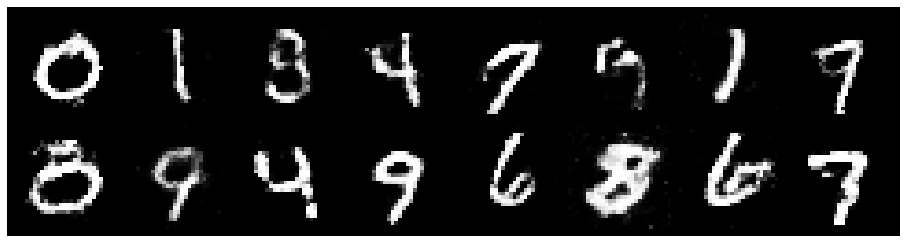

Epoch: [150/200], Batch Num: [400/600]
Discriminator Loss: 1.4493, Generator Loss: 0.8253
D(x): 0.5177, D(G(z)): 0.4917


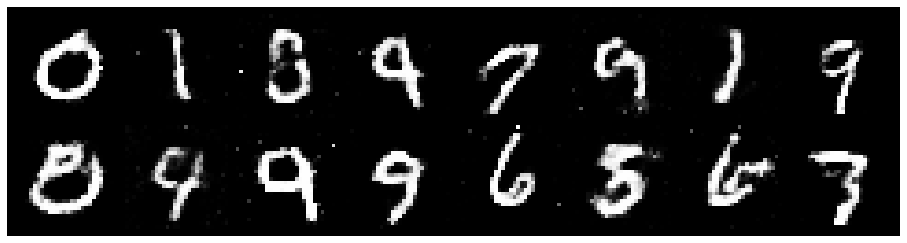

Epoch: [150/200], Batch Num: [500/600]
Discriminator Loss: 1.3645, Generator Loss: 0.7924
D(x): 0.5730, D(G(z)): 0.4889


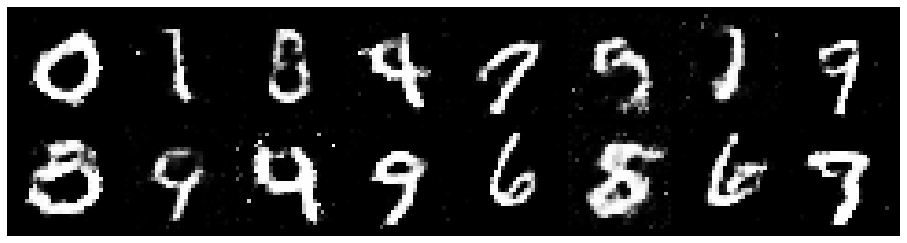

Epoch: [151/200], Batch Num: [0/600]
Discriminator Loss: 1.1901, Generator Loss: 0.8789
D(x): 0.5839, D(G(z)): 0.4328


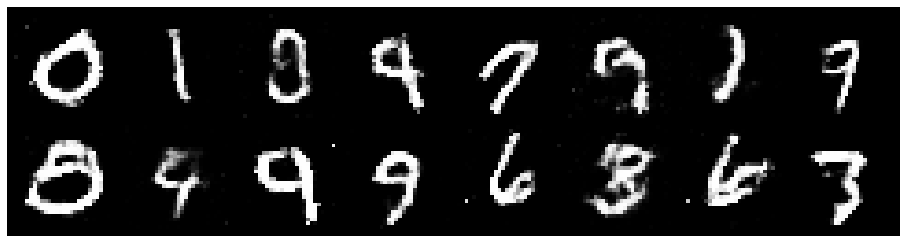

Epoch: [151/200], Batch Num: [100/600]
Discriminator Loss: 1.2614, Generator Loss: 0.8269
D(x): 0.5837, D(G(z)): 0.4737


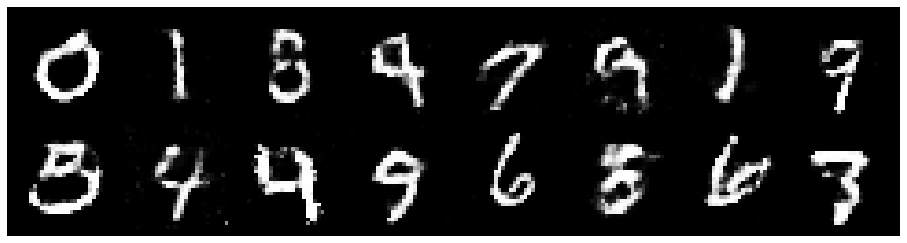

Epoch: [151/200], Batch Num: [200/600]
Discriminator Loss: 1.3124, Generator Loss: 0.9641
D(x): 0.5266, D(G(z)): 0.4230


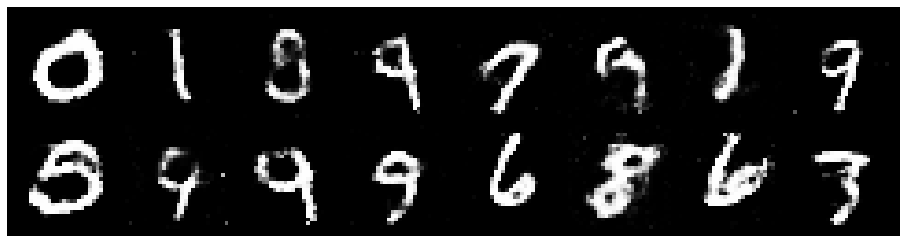

Epoch: [151/200], Batch Num: [300/600]
Discriminator Loss: 1.3604, Generator Loss: 1.0944
D(x): 0.5489, D(G(z)): 0.4458


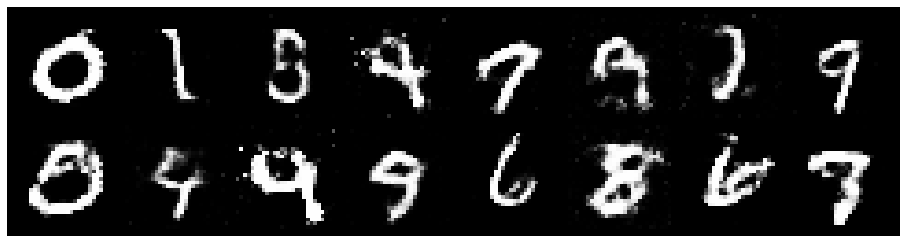

Epoch: [151/200], Batch Num: [400/600]
Discriminator Loss: 1.2309, Generator Loss: 0.8943
D(x): 0.6255, D(G(z)): 0.4761


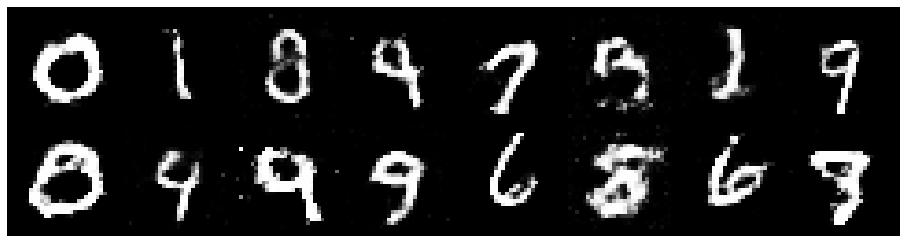

Epoch: [151/200], Batch Num: [500/600]
Discriminator Loss: 1.2983, Generator Loss: 0.7964
D(x): 0.5638, D(G(z)): 0.4651


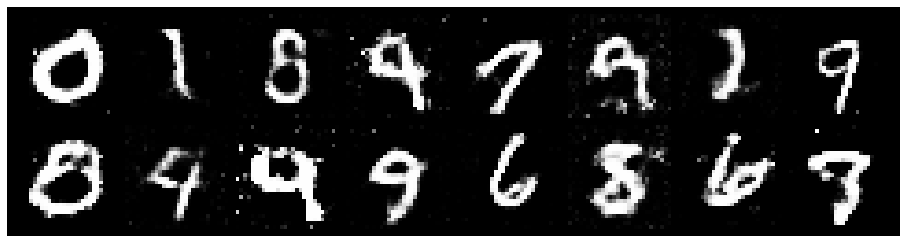

Epoch: [152/200], Batch Num: [0/600]
Discriminator Loss: 1.2370, Generator Loss: 0.9453
D(x): 0.5701, D(G(z)): 0.4389


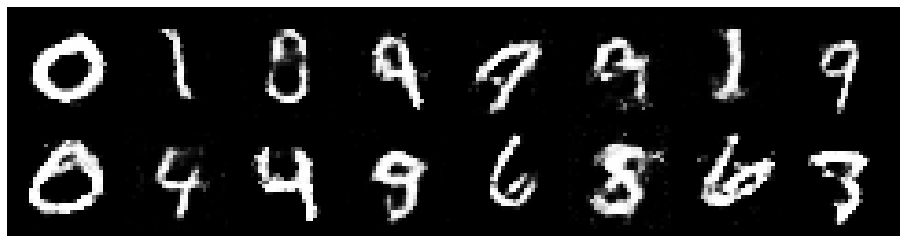

Epoch: [152/200], Batch Num: [100/600]
Discriminator Loss: 1.3129, Generator Loss: 0.8257
D(x): 0.5588, D(G(z)): 0.4717


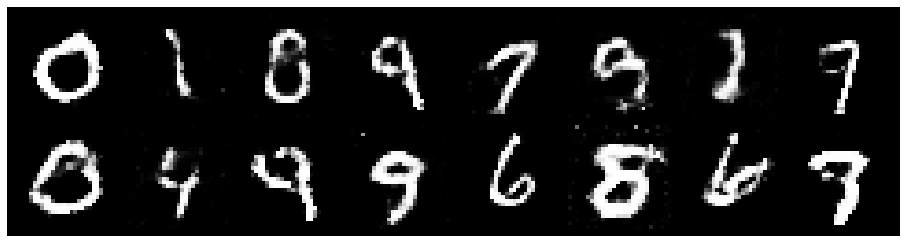

Epoch: [152/200], Batch Num: [200/600]
Discriminator Loss: 1.3538, Generator Loss: 0.9672
D(x): 0.5363, D(G(z)): 0.4487


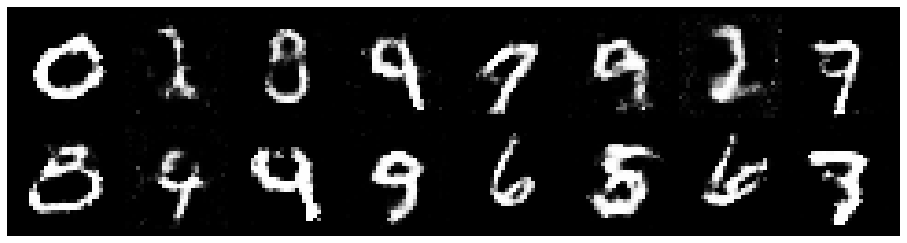

Epoch: [152/200], Batch Num: [300/600]
Discriminator Loss: 1.2945, Generator Loss: 0.8898
D(x): 0.5689, D(G(z)): 0.4701


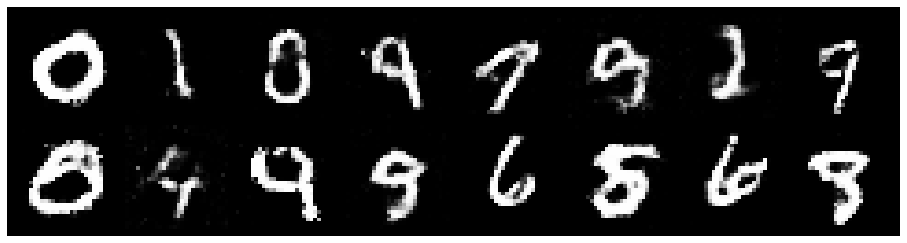

Epoch: [152/200], Batch Num: [400/600]
Discriminator Loss: 1.2768, Generator Loss: 0.9196
D(x): 0.5604, D(G(z)): 0.4428


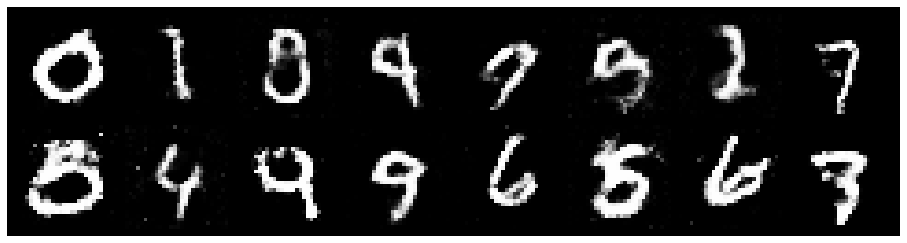

Epoch: [152/200], Batch Num: [500/600]
Discriminator Loss: 1.2356, Generator Loss: 0.8517
D(x): 0.5963, D(G(z)): 0.4535


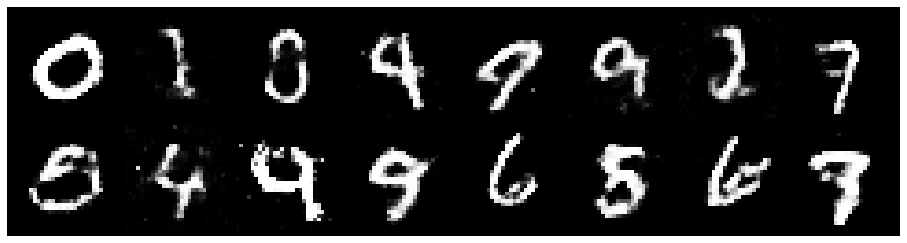

Epoch: [153/200], Batch Num: [0/600]
Discriminator Loss: 1.2547, Generator Loss: 0.8449
D(x): 0.5951, D(G(z)): 0.4566


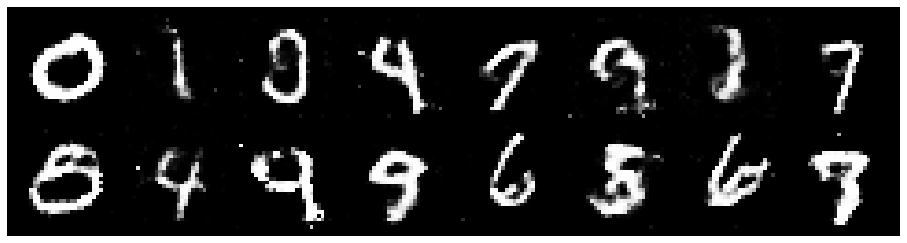

Epoch: [153/200], Batch Num: [100/600]
Discriminator Loss: 1.3552, Generator Loss: 0.8973
D(x): 0.5275, D(G(z)): 0.4589


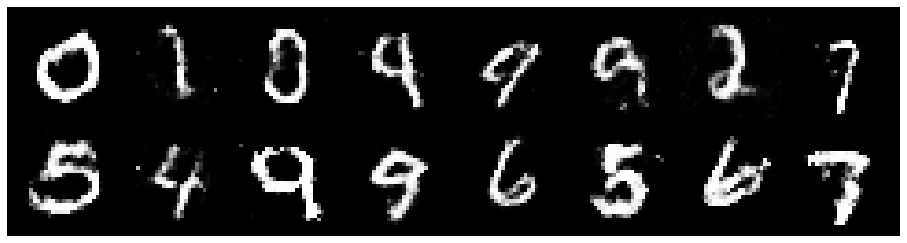

Epoch: [153/200], Batch Num: [200/600]
Discriminator Loss: 1.2582, Generator Loss: 0.8478
D(x): 0.5630, D(G(z)): 0.4589


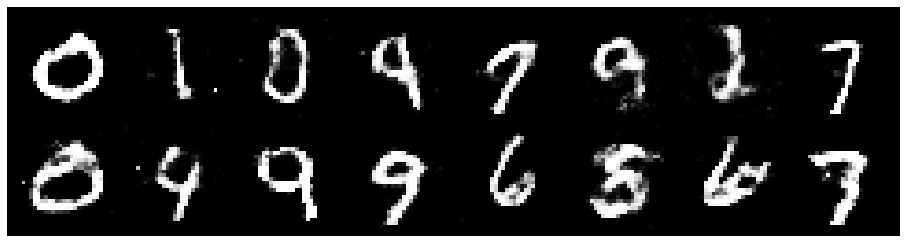

Epoch: [153/200], Batch Num: [300/600]
Discriminator Loss: 1.2481, Generator Loss: 0.8689
D(x): 0.5618, D(G(z)): 0.4478


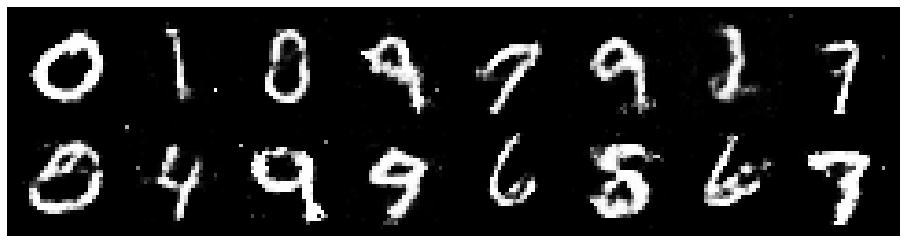

Epoch: [153/200], Batch Num: [400/600]
Discriminator Loss: 1.2029, Generator Loss: 0.8908
D(x): 0.5652, D(G(z)): 0.4243


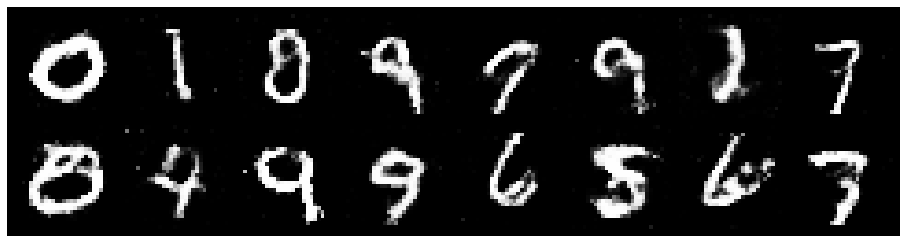

Epoch: [153/200], Batch Num: [500/600]
Discriminator Loss: 1.2941, Generator Loss: 0.9908
D(x): 0.5321, D(G(z)): 0.4506


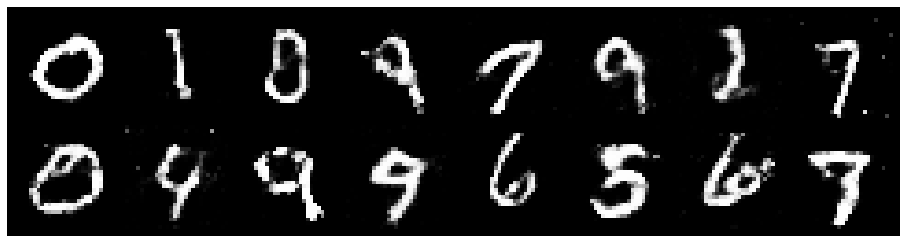

Epoch: [154/200], Batch Num: [0/600]
Discriminator Loss: 1.2008, Generator Loss: 0.8710
D(x): 0.5968, D(G(z)): 0.4484


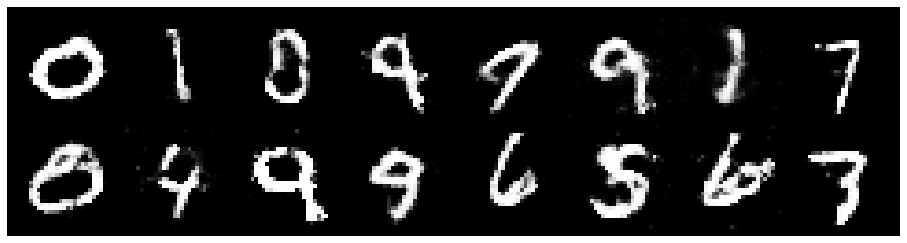

Epoch: [154/200], Batch Num: [100/600]
Discriminator Loss: 1.3723, Generator Loss: 0.7679
D(x): 0.5659, D(G(z)): 0.5079


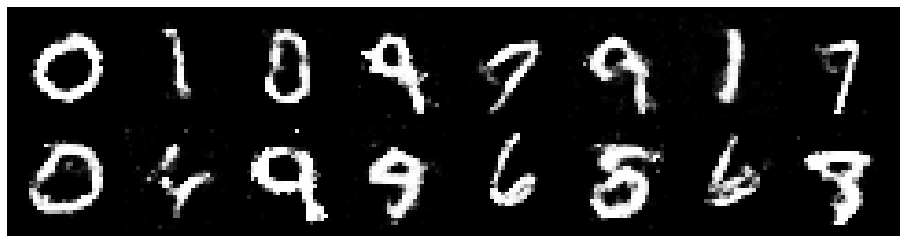

Epoch: [154/200], Batch Num: [200/600]
Discriminator Loss: 1.2487, Generator Loss: 0.8074
D(x): 0.5496, D(G(z)): 0.4452


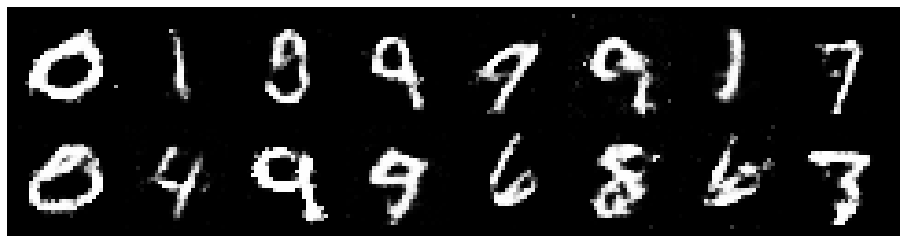

Epoch: [154/200], Batch Num: [300/600]
Discriminator Loss: 1.4089, Generator Loss: 0.7423
D(x): 0.5197, D(G(z)): 0.4909


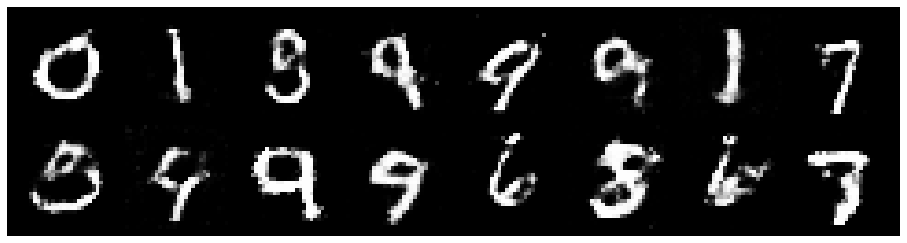

Epoch: [154/200], Batch Num: [400/600]
Discriminator Loss: 1.4411, Generator Loss: 0.8140
D(x): 0.5395, D(G(z)): 0.5062


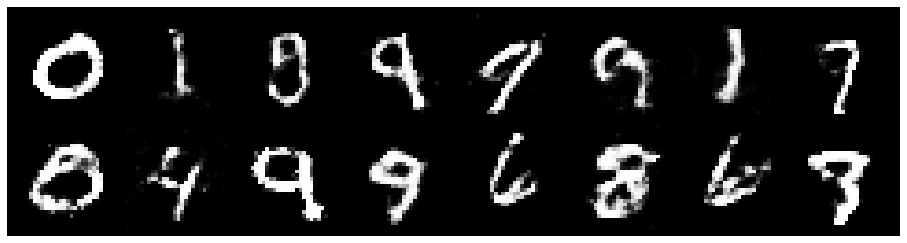

Epoch: [154/200], Batch Num: [500/600]
Discriminator Loss: 1.3614, Generator Loss: 0.8318
D(x): 0.5460, D(G(z)): 0.4699


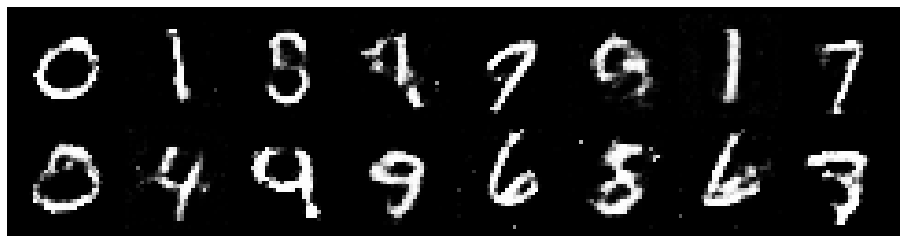

Epoch: [155/200], Batch Num: [0/600]
Discriminator Loss: 1.2948, Generator Loss: 0.8236
D(x): 0.5430, D(G(z)): 0.4465


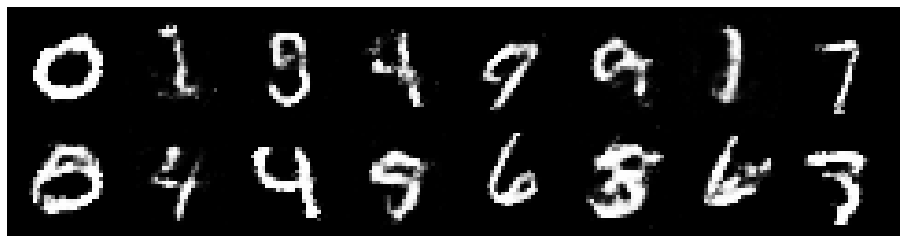

Epoch: [155/200], Batch Num: [100/600]
Discriminator Loss: 1.3367, Generator Loss: 0.9399
D(x): 0.4882, D(G(z)): 0.4019


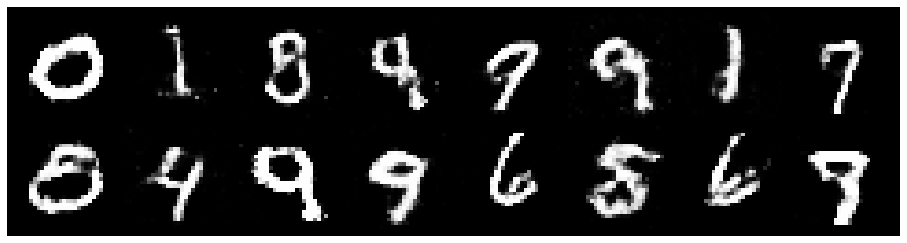

Epoch: [155/200], Batch Num: [200/600]
Discriminator Loss: 1.2755, Generator Loss: 0.8061
D(x): 0.6068, D(G(z)): 0.4903


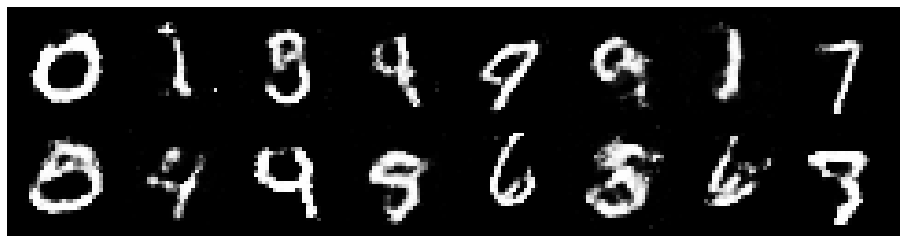

Epoch: [155/200], Batch Num: [300/600]
Discriminator Loss: 1.2411, Generator Loss: 0.9437
D(x): 0.6070, D(G(z)): 0.4435


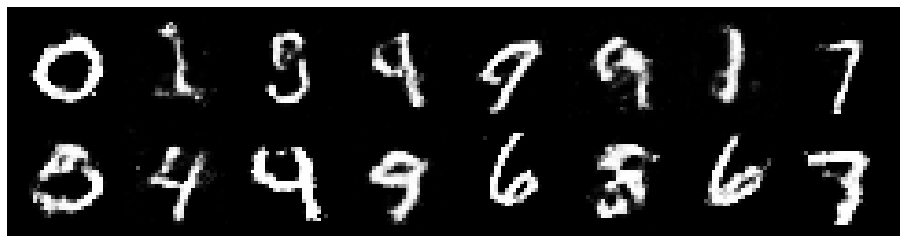

Epoch: [155/200], Batch Num: [400/600]
Discriminator Loss: 1.1979, Generator Loss: 0.9661
D(x): 0.6252, D(G(z)): 0.4464


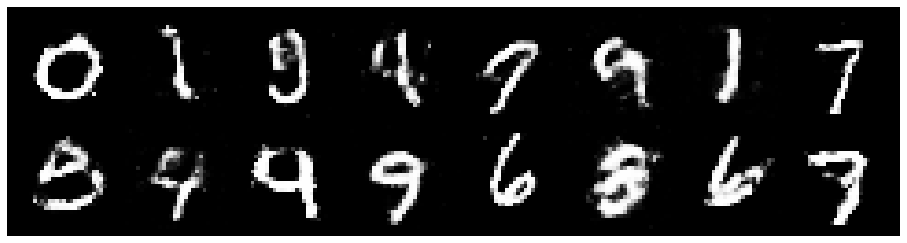

Epoch: [155/200], Batch Num: [500/600]
Discriminator Loss: 1.2337, Generator Loss: 0.9136
D(x): 0.5809, D(G(z)): 0.4398


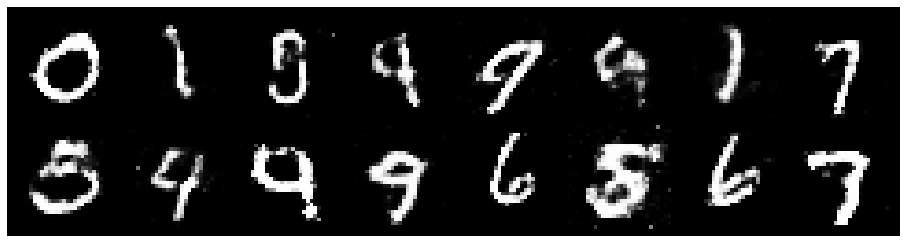

Epoch: [156/200], Batch Num: [0/600]
Discriminator Loss: 1.2089, Generator Loss: 0.9371
D(x): 0.5502, D(G(z)): 0.4109


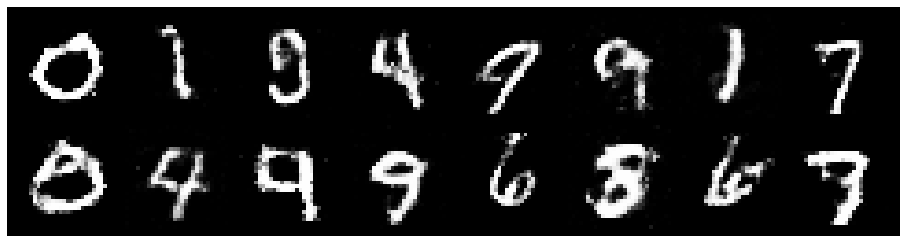

Epoch: [156/200], Batch Num: [100/600]
Discriminator Loss: 1.2178, Generator Loss: 0.9346
D(x): 0.5651, D(G(z)): 0.4326


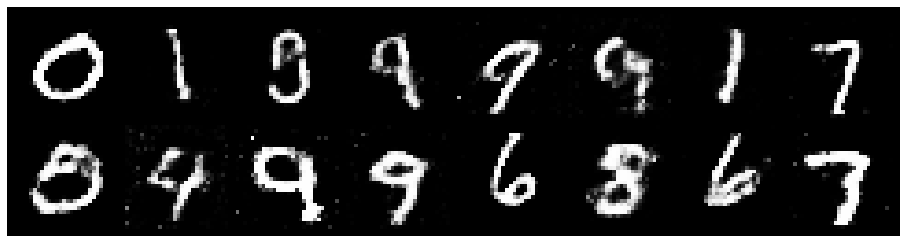

Epoch: [156/200], Batch Num: [200/600]
Discriminator Loss: 1.2390, Generator Loss: 0.9279
D(x): 0.5390, D(G(z)): 0.4183


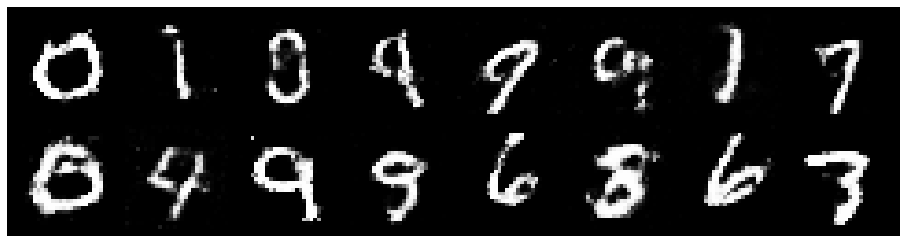

Epoch: [156/200], Batch Num: [300/600]
Discriminator Loss: 1.3154, Generator Loss: 0.8507
D(x): 0.5368, D(G(z)): 0.4580


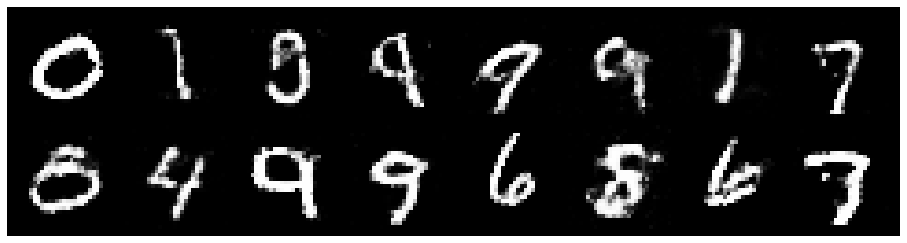

Epoch: [156/200], Batch Num: [400/600]
Discriminator Loss: 1.2361, Generator Loss: 0.8526
D(x): 0.5516, D(G(z)): 0.4400


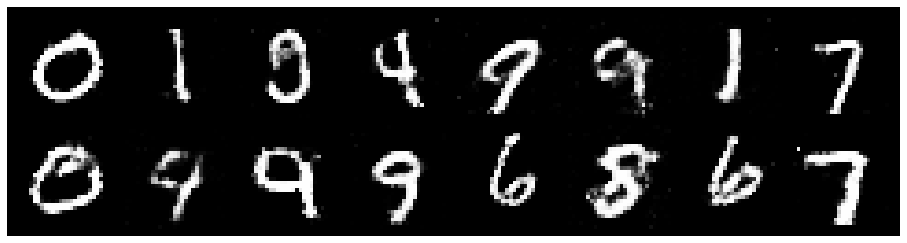

Epoch: [156/200], Batch Num: [500/600]
Discriminator Loss: 1.3357, Generator Loss: 0.7391
D(x): 0.5291, D(G(z)): 0.4619


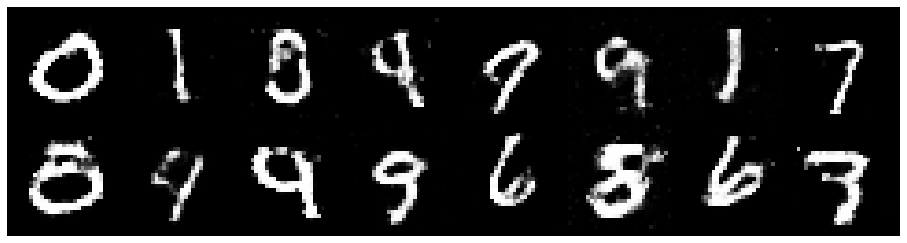

Epoch: [157/200], Batch Num: [0/600]
Discriminator Loss: 1.2969, Generator Loss: 1.0535
D(x): 0.5109, D(G(z)): 0.4040


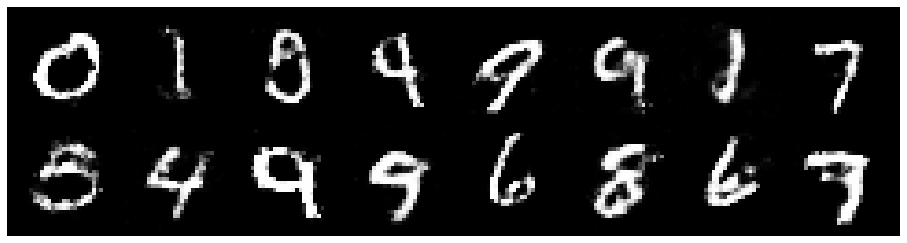

Epoch: [157/200], Batch Num: [100/600]
Discriminator Loss: 1.3562, Generator Loss: 0.9007
D(x): 0.5137, D(G(z)): 0.4318


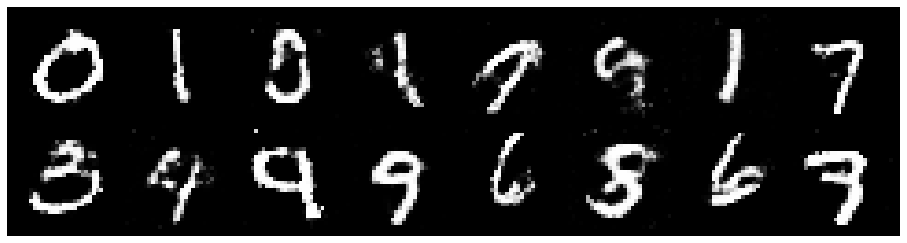

Epoch: [157/200], Batch Num: [200/600]
Discriminator Loss: 1.2589, Generator Loss: 0.8273
D(x): 0.5534, D(G(z)): 0.4533


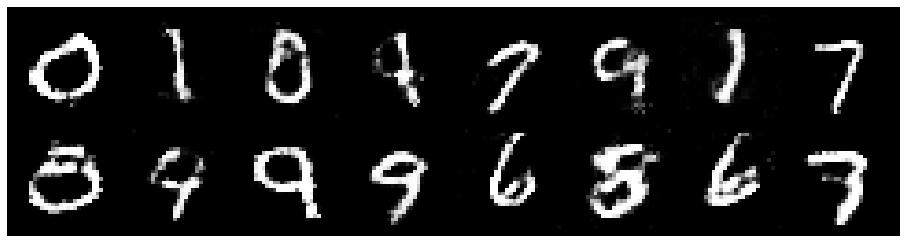

Epoch: [157/200], Batch Num: [300/600]
Discriminator Loss: 1.1871, Generator Loss: 0.9994
D(x): 0.5165, D(G(z)): 0.3428


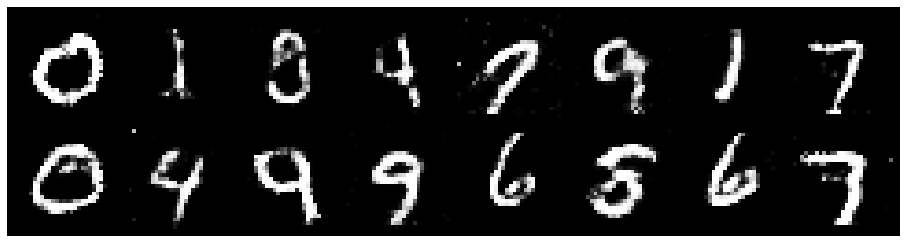

Epoch: [157/200], Batch Num: [400/600]
Discriminator Loss: 1.2537, Generator Loss: 1.0733
D(x): 0.5252, D(G(z)): 0.4132


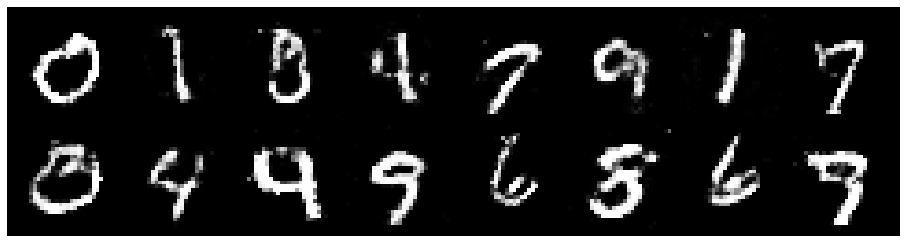

Epoch: [157/200], Batch Num: [500/600]
Discriminator Loss: 1.1856, Generator Loss: 0.9483
D(x): 0.5860, D(G(z)): 0.4280


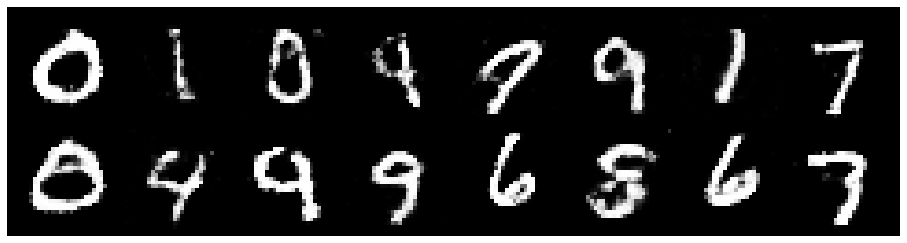

Epoch: [158/200], Batch Num: [0/600]
Discriminator Loss: 1.2443, Generator Loss: 1.0015
D(x): 0.5232, D(G(z)): 0.4074


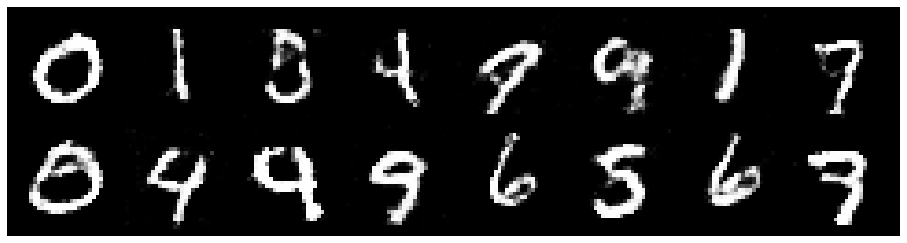

Epoch: [158/200], Batch Num: [100/600]
Discriminator Loss: 1.2463, Generator Loss: 0.9345
D(x): 0.5492, D(G(z)): 0.4079


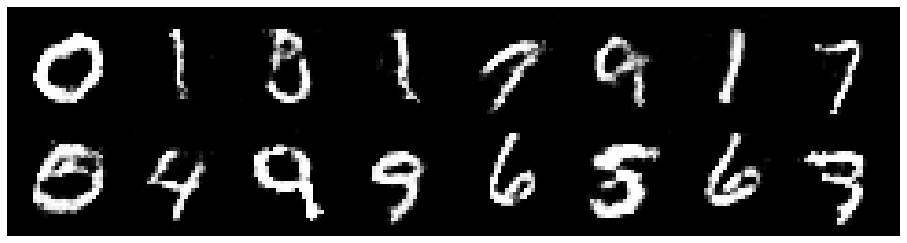

Epoch: [158/200], Batch Num: [200/600]
Discriminator Loss: 1.1568, Generator Loss: 0.9336
D(x): 0.5884, D(G(z)): 0.4261


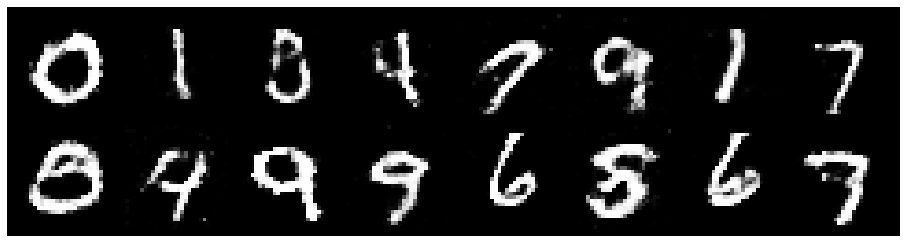

Epoch: [158/200], Batch Num: [300/600]
Discriminator Loss: 1.2435, Generator Loss: 0.8933
D(x): 0.5763, D(G(z)): 0.4463


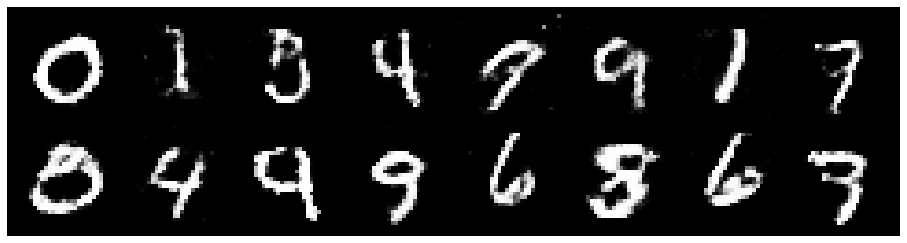

Epoch: [158/200], Batch Num: [400/600]
Discriminator Loss: 1.3101, Generator Loss: 1.1352
D(x): 0.5313, D(G(z)): 0.4232


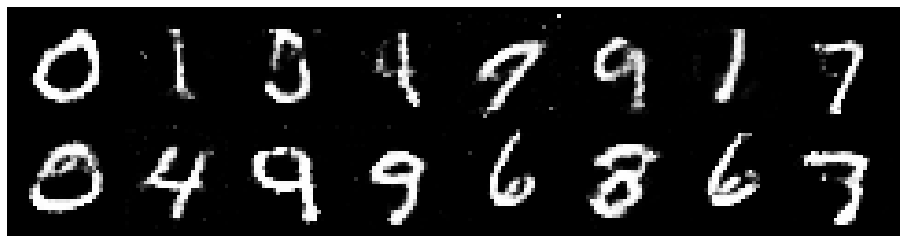

Epoch: [158/200], Batch Num: [500/600]
Discriminator Loss: 1.2580, Generator Loss: 0.8806
D(x): 0.5992, D(G(z)): 0.4571


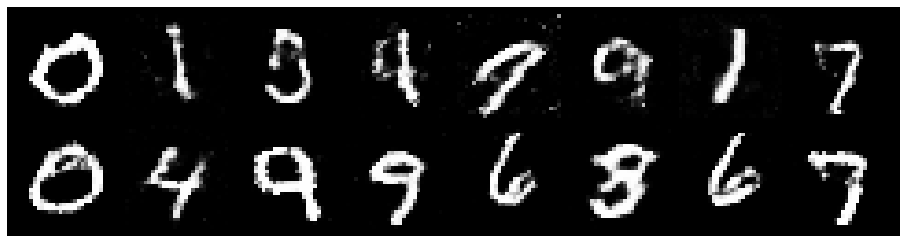

Epoch: [159/200], Batch Num: [0/600]
Discriminator Loss: 1.3764, Generator Loss: 0.9848
D(x): 0.5406, D(G(z)): 0.4580


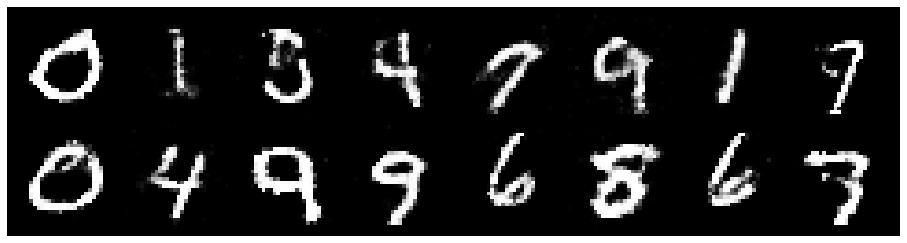

Epoch: [159/200], Batch Num: [100/600]
Discriminator Loss: 1.2405, Generator Loss: 0.8459
D(x): 0.5531, D(G(z)): 0.4411


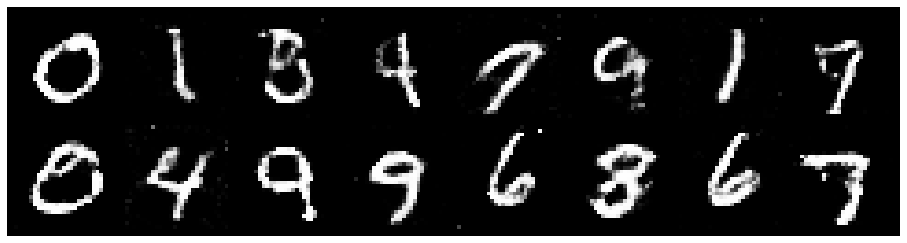

Epoch: [159/200], Batch Num: [200/600]
Discriminator Loss: 1.2462, Generator Loss: 0.8059
D(x): 0.5815, D(G(z)): 0.4594


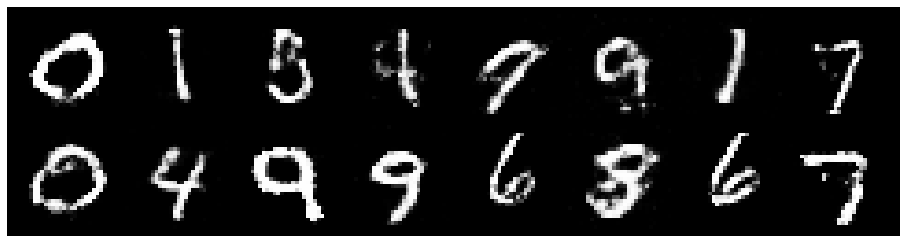

Epoch: [159/200], Batch Num: [300/600]
Discriminator Loss: 1.2889, Generator Loss: 0.8910
D(x): 0.5961, D(G(z)): 0.4889


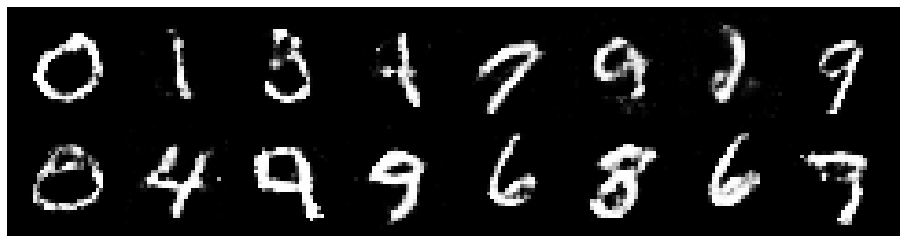

Epoch: [159/200], Batch Num: [400/600]
Discriminator Loss: 1.2670, Generator Loss: 0.7710
D(x): 0.5579, D(G(z)): 0.4665


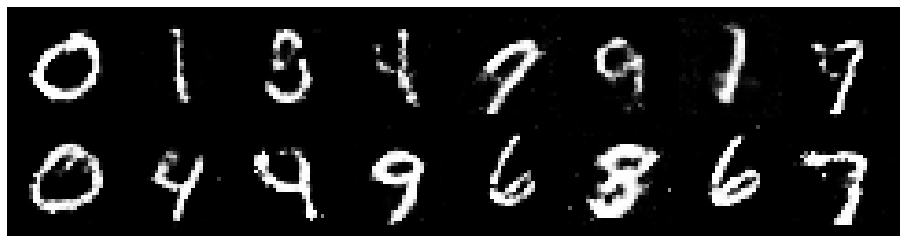

Epoch: [159/200], Batch Num: [500/600]
Discriminator Loss: 1.2848, Generator Loss: 0.7613
D(x): 0.5342, D(G(z)): 0.4529


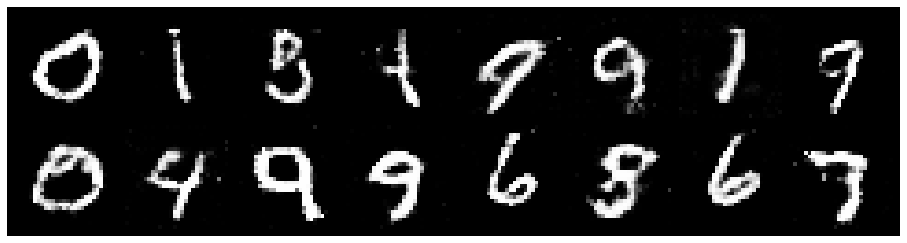

Epoch: [160/200], Batch Num: [0/600]
Discriminator Loss: 1.2711, Generator Loss: 0.9240
D(x): 0.5839, D(G(z)): 0.4645


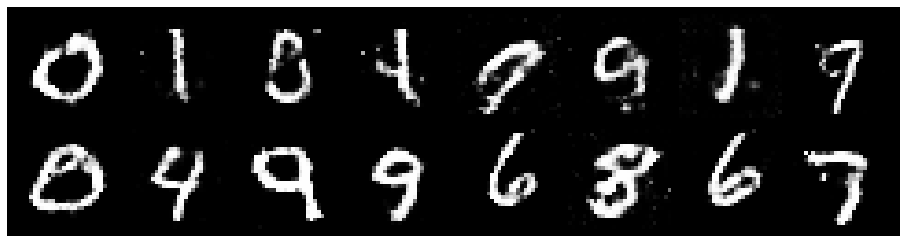

Epoch: [160/200], Batch Num: [100/600]
Discriminator Loss: 1.3591, Generator Loss: 0.9089
D(x): 0.5369, D(G(z)): 0.4542


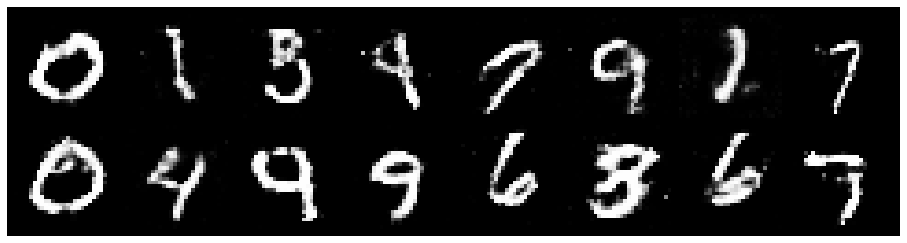

Epoch: [160/200], Batch Num: [200/600]
Discriminator Loss: 1.2632, Generator Loss: 0.7768
D(x): 0.5629, D(G(z)): 0.4518


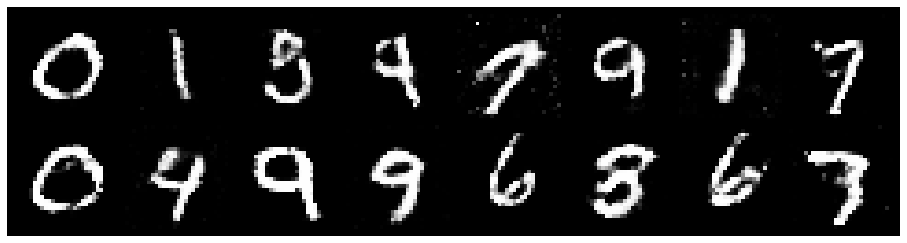

Epoch: [160/200], Batch Num: [300/600]
Discriminator Loss: 1.2857, Generator Loss: 0.8451
D(x): 0.5426, D(G(z)): 0.4476


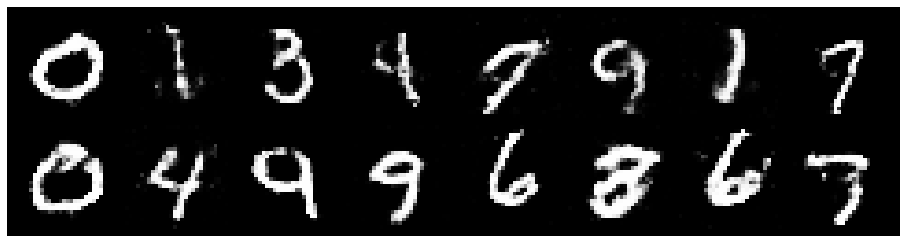

Epoch: [160/200], Batch Num: [400/600]
Discriminator Loss: 1.2678, Generator Loss: 0.8600
D(x): 0.6042, D(G(z)): 0.4772


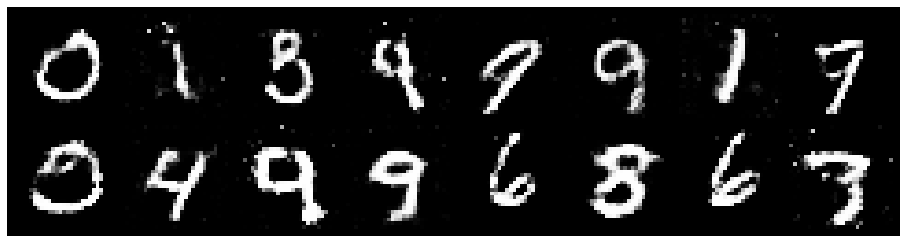

Epoch: [160/200], Batch Num: [500/600]
Discriminator Loss: 1.3608, Generator Loss: 0.8330
D(x): 0.5363, D(G(z)): 0.4800


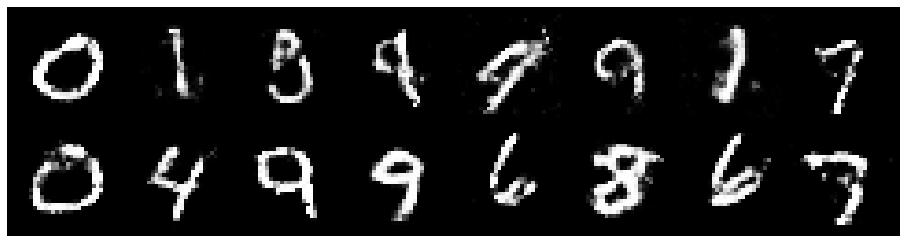

Epoch: [161/200], Batch Num: [0/600]
Discriminator Loss: 1.1514, Generator Loss: 0.9228
D(x): 0.6082, D(G(z)): 0.4270


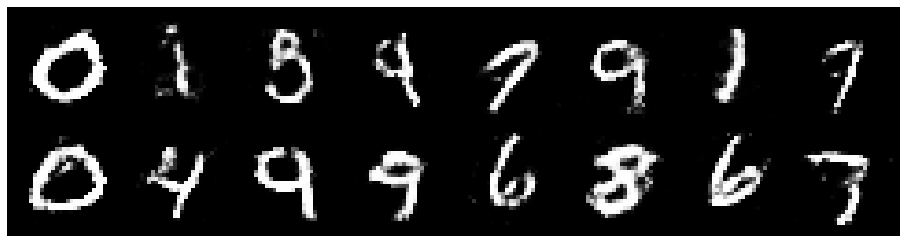

Epoch: [161/200], Batch Num: [100/600]
Discriminator Loss: 1.2143, Generator Loss: 1.0173
D(x): 0.5503, D(G(z)): 0.3975


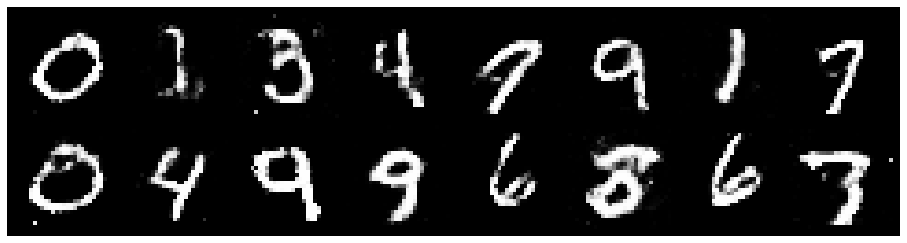

Epoch: [161/200], Batch Num: [200/600]
Discriminator Loss: 1.3015, Generator Loss: 0.8116
D(x): 0.5618, D(G(z)): 0.4731


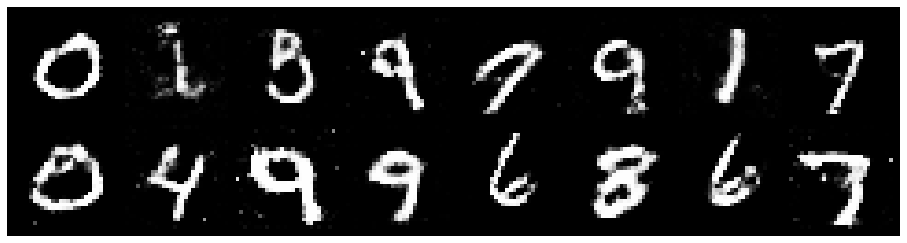

Epoch: [161/200], Batch Num: [300/600]
Discriminator Loss: 1.2487, Generator Loss: 0.9682
D(x): 0.5685, D(G(z)): 0.4551


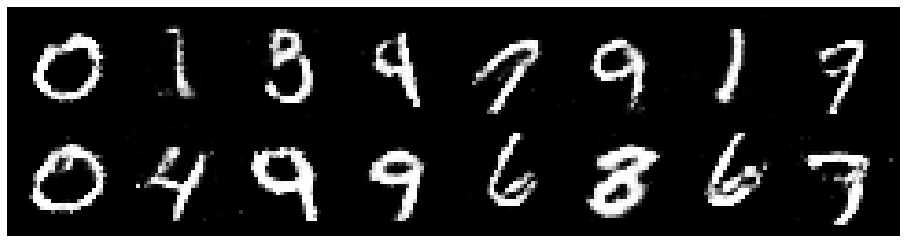

Epoch: [161/200], Batch Num: [400/600]
Discriminator Loss: 1.2583, Generator Loss: 0.8492
D(x): 0.5596, D(G(z)): 0.4486


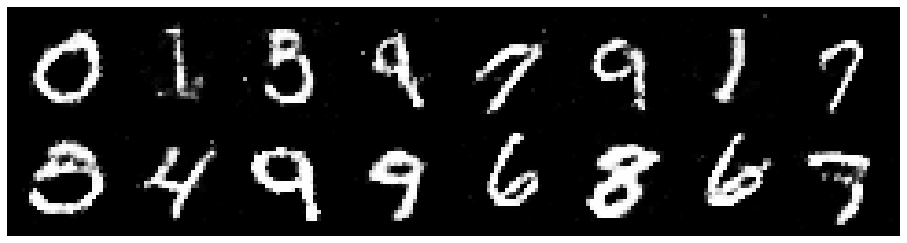

Epoch: [161/200], Batch Num: [500/600]
Discriminator Loss: 1.3339, Generator Loss: 0.9164
D(x): 0.5320, D(G(z)): 0.4424


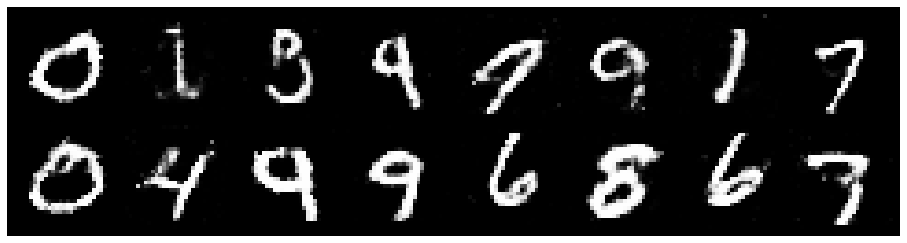

Epoch: [162/200], Batch Num: [0/600]
Discriminator Loss: 1.2234, Generator Loss: 0.8641
D(x): 0.5649, D(G(z)): 0.4399


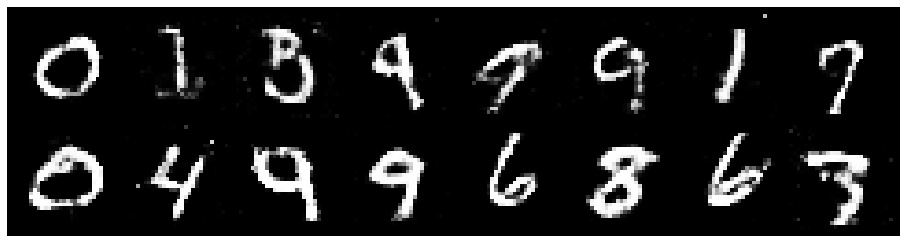

Epoch: [162/200], Batch Num: [100/600]
Discriminator Loss: 1.2516, Generator Loss: 0.8875
D(x): 0.5574, D(G(z)): 0.4536


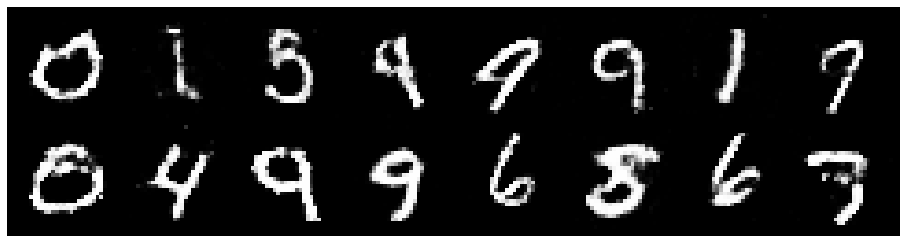

Epoch: [162/200], Batch Num: [200/600]
Discriminator Loss: 1.2635, Generator Loss: 1.0510
D(x): 0.5438, D(G(z)): 0.4409


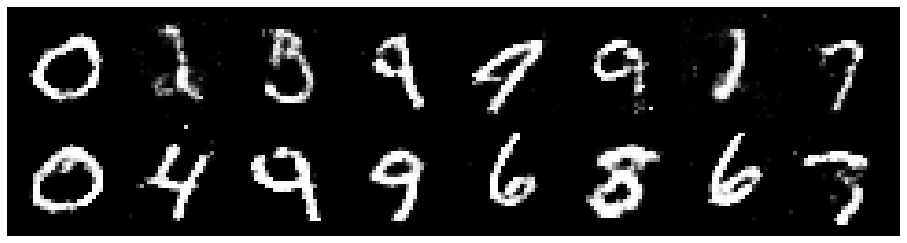

Epoch: [162/200], Batch Num: [300/600]
Discriminator Loss: 1.2357, Generator Loss: 0.8901
D(x): 0.5560, D(G(z)): 0.4208


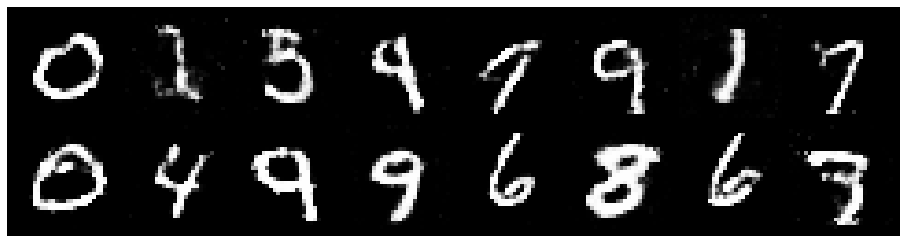

Epoch: [162/200], Batch Num: [400/600]
Discriminator Loss: 1.3600, Generator Loss: 0.8279
D(x): 0.5107, D(G(z)): 0.4674


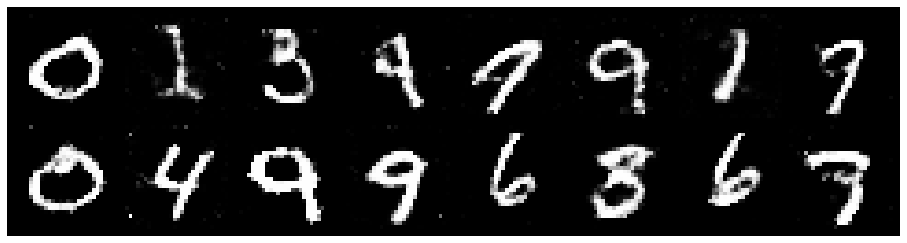

Epoch: [162/200], Batch Num: [500/600]
Discriminator Loss: 1.3361, Generator Loss: 0.8547
D(x): 0.5362, D(G(z)): 0.4649


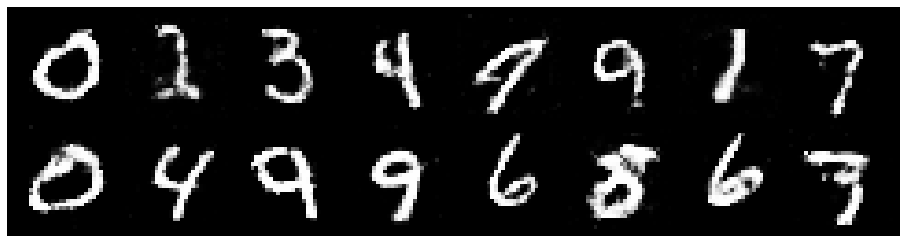

Epoch: [163/200], Batch Num: [0/600]
Discriminator Loss: 1.3098, Generator Loss: 0.8274
D(x): 0.5354, D(G(z)): 0.4423


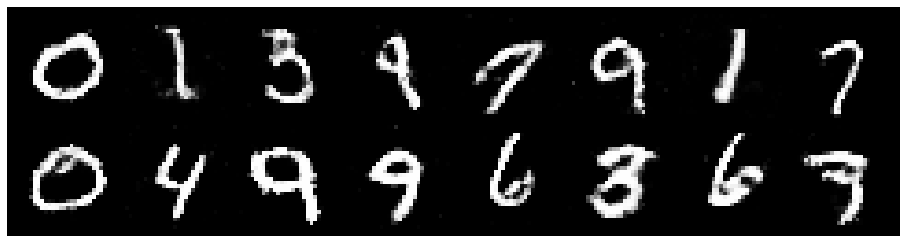

Epoch: [163/200], Batch Num: [100/600]
Discriminator Loss: 1.2532, Generator Loss: 0.7694
D(x): 0.5737, D(G(z)): 0.4488


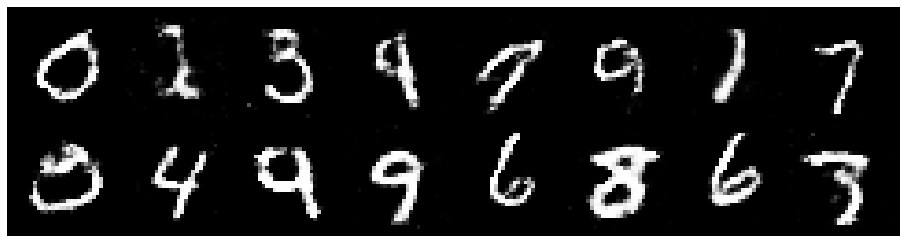

Epoch: [163/200], Batch Num: [200/600]
Discriminator Loss: 1.3363, Generator Loss: 0.8609
D(x): 0.5689, D(G(z)): 0.4730


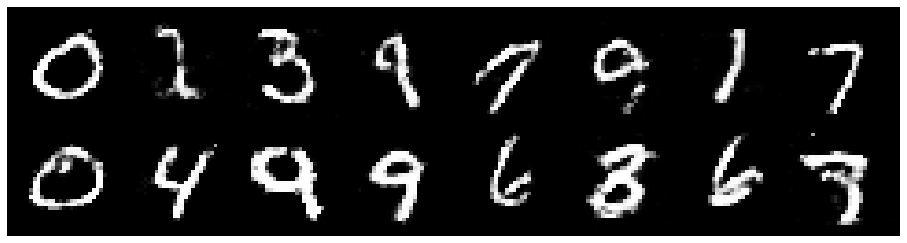

Epoch: [163/200], Batch Num: [300/600]
Discriminator Loss: 1.2779, Generator Loss: 0.8258
D(x): 0.5402, D(G(z)): 0.4529


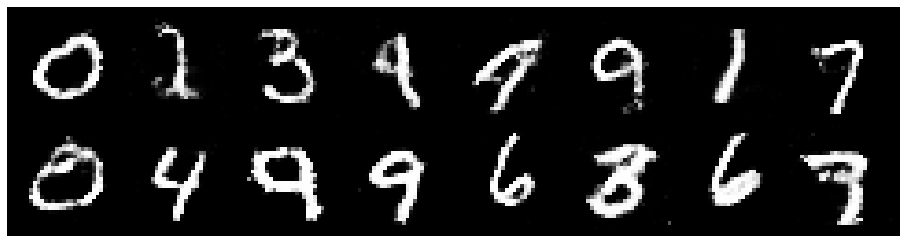

Epoch: [163/200], Batch Num: [400/600]
Discriminator Loss: 1.3960, Generator Loss: 0.8404
D(x): 0.5128, D(G(z)): 0.4754


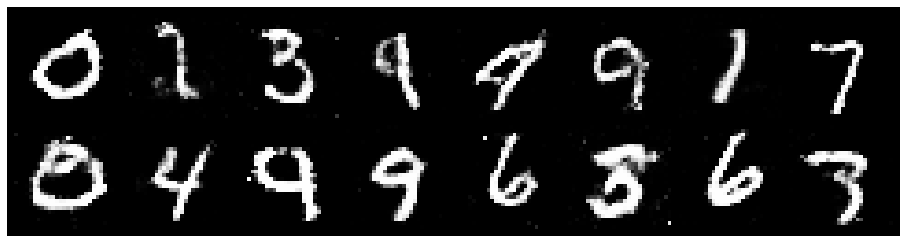

Epoch: [163/200], Batch Num: [500/600]
Discriminator Loss: 1.1700, Generator Loss: 0.9070
D(x): 0.6029, D(G(z)): 0.4366


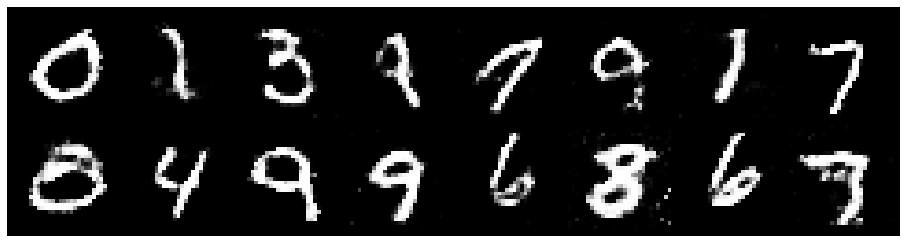

Epoch: [164/200], Batch Num: [0/600]
Discriminator Loss: 1.1784, Generator Loss: 0.8590
D(x): 0.5670, D(G(z)): 0.4148


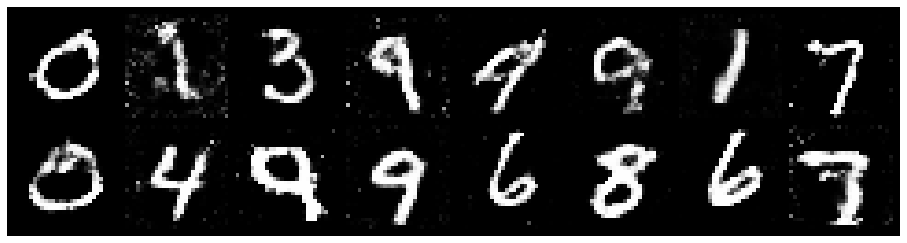

Epoch: [164/200], Batch Num: [100/600]
Discriminator Loss: 1.2371, Generator Loss: 0.9268
D(x): 0.5858, D(G(z)): 0.4484


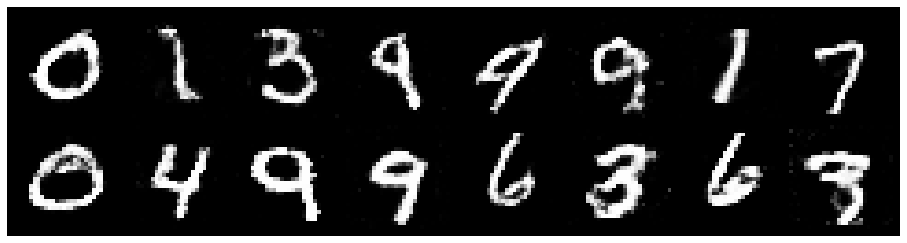

Epoch: [164/200], Batch Num: [200/600]
Discriminator Loss: 1.2207, Generator Loss: 0.8646
D(x): 0.5812, D(G(z)): 0.4383


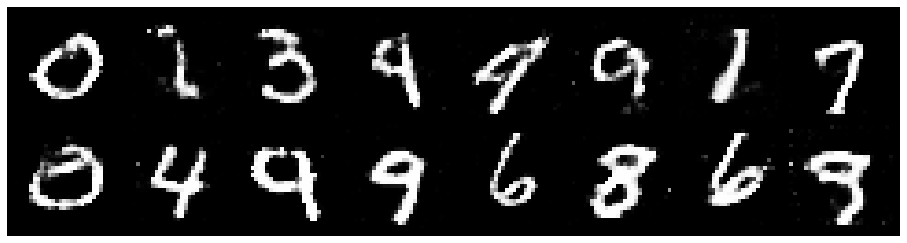

Epoch: [164/200], Batch Num: [300/600]
Discriminator Loss: 1.2713, Generator Loss: 0.9892
D(x): 0.5939, D(G(z)): 0.4703


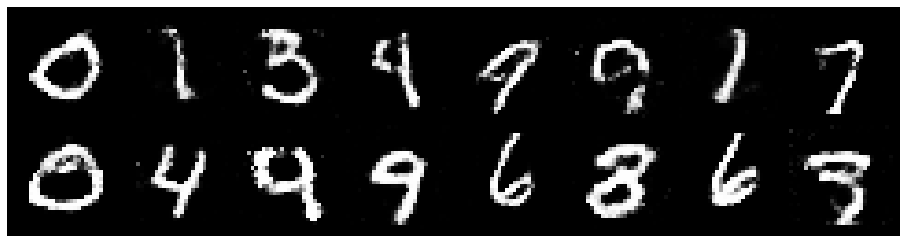

Epoch: [164/200], Batch Num: [400/600]
Discriminator Loss: 1.1810, Generator Loss: 0.9755
D(x): 0.5829, D(G(z)): 0.4076


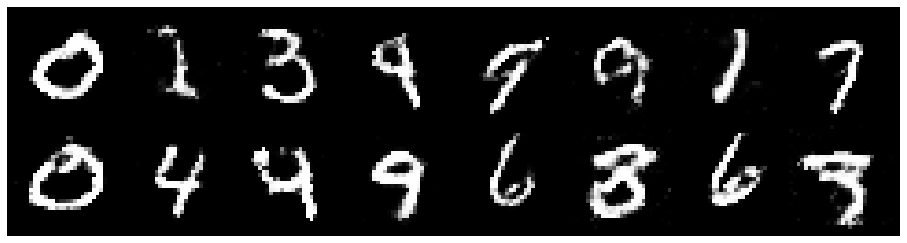

Epoch: [164/200], Batch Num: [500/600]
Discriminator Loss: 1.1596, Generator Loss: 0.9457
D(x): 0.5961, D(G(z)): 0.4260


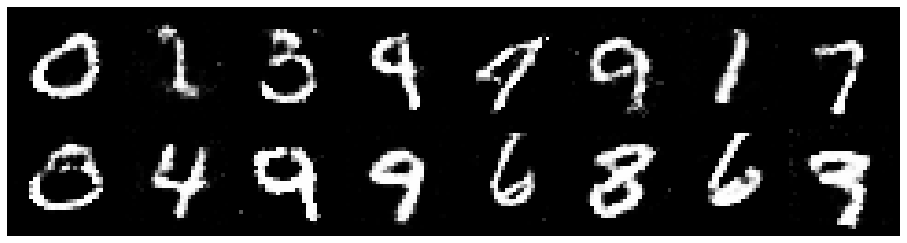

Epoch: [165/200], Batch Num: [0/600]
Discriminator Loss: 1.2143, Generator Loss: 0.7418
D(x): 0.5955, D(G(z)): 0.4739


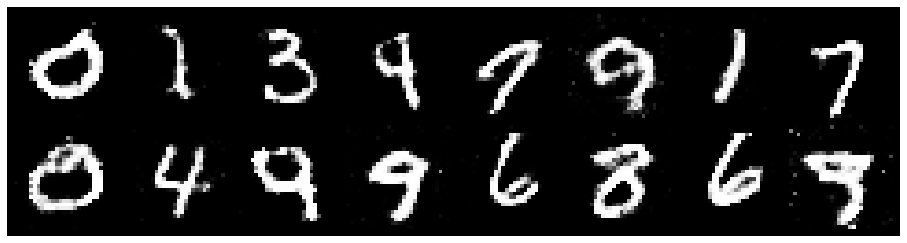

Epoch: [165/200], Batch Num: [100/600]
Discriminator Loss: 1.3641, Generator Loss: 0.9103
D(x): 0.5265, D(G(z)): 0.4729


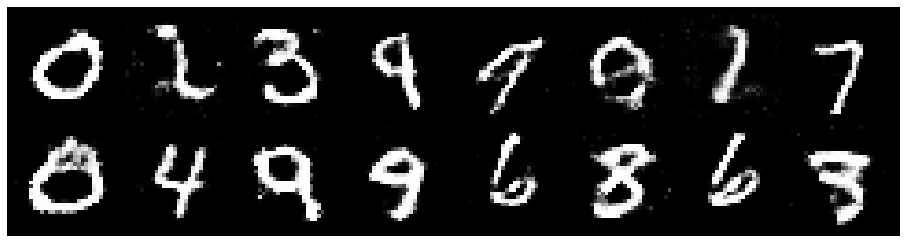

Epoch: [165/200], Batch Num: [200/600]
Discriminator Loss: 1.3206, Generator Loss: 0.7457
D(x): 0.5846, D(G(z)): 0.5078


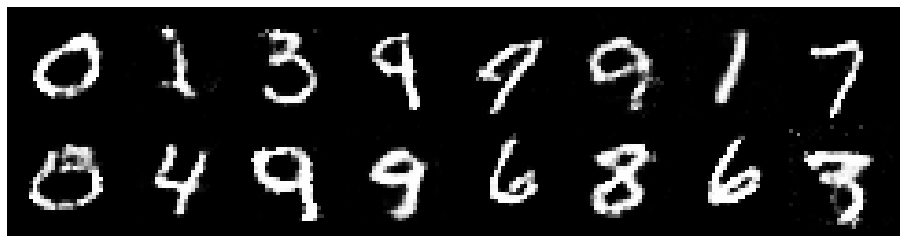

Epoch: [165/200], Batch Num: [300/600]
Discriminator Loss: 1.3021, Generator Loss: 0.9304
D(x): 0.5340, D(G(z)): 0.4344


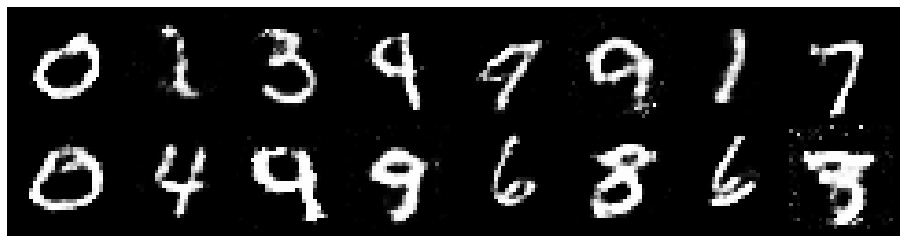

Epoch: [165/200], Batch Num: [400/600]
Discriminator Loss: 1.4220, Generator Loss: 0.7912
D(x): 0.5649, D(G(z)): 0.5040


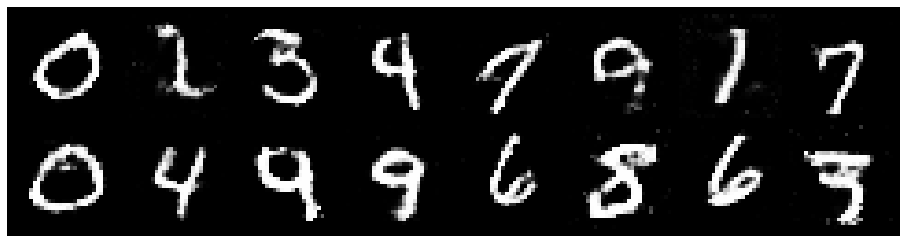

Epoch: [165/200], Batch Num: [500/600]
Discriminator Loss: 1.2917, Generator Loss: 1.0830
D(x): 0.5396, D(G(z)): 0.4265


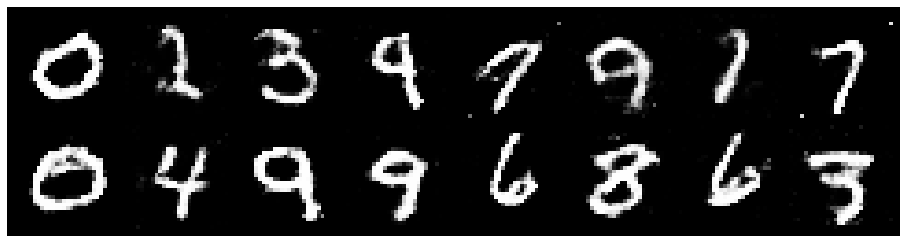

Epoch: [166/200], Batch Num: [0/600]
Discriminator Loss: 1.2090, Generator Loss: 1.0667
D(x): 0.5843, D(G(z)): 0.3942


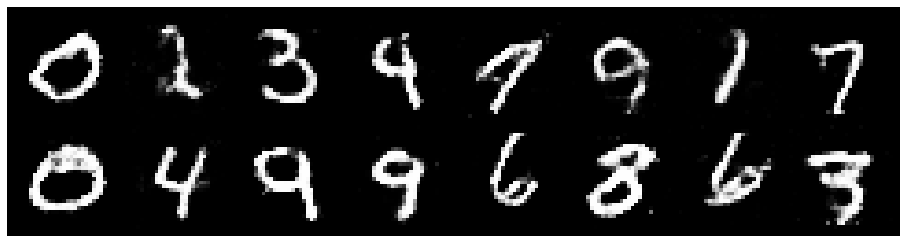

Epoch: [166/200], Batch Num: [100/600]
Discriminator Loss: 1.2889, Generator Loss: 0.9497
D(x): 0.5577, D(G(z)): 0.4556


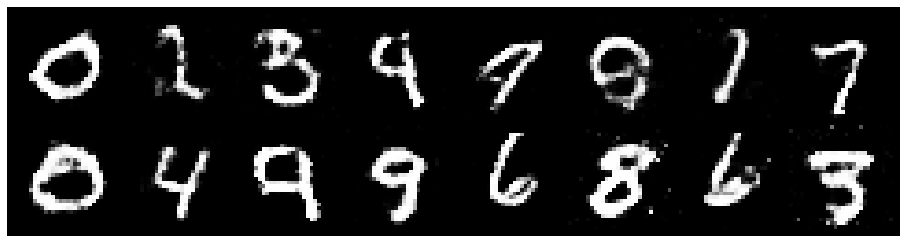

Epoch: [166/200], Batch Num: [200/600]
Discriminator Loss: 1.3004, Generator Loss: 0.8916
D(x): 0.5552, D(G(z)): 0.4485


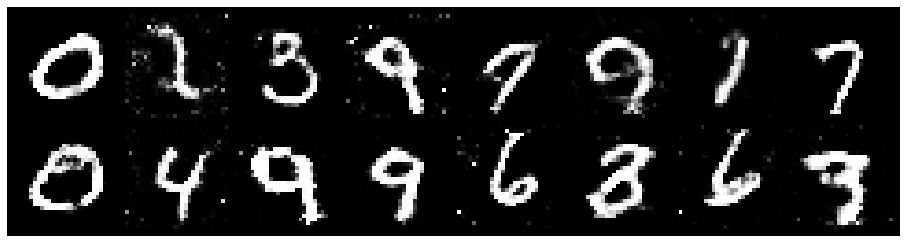

Epoch: [166/200], Batch Num: [300/600]
Discriminator Loss: 1.2385, Generator Loss: 0.8396
D(x): 0.5566, D(G(z)): 0.4294


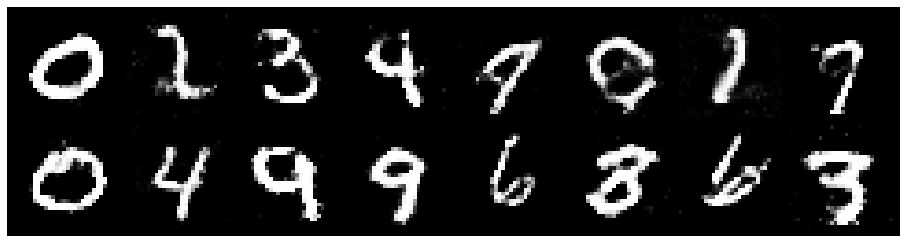

Epoch: [166/200], Batch Num: [400/600]
Discriminator Loss: 1.1850, Generator Loss: 1.0019
D(x): 0.5924, D(G(z)): 0.4219


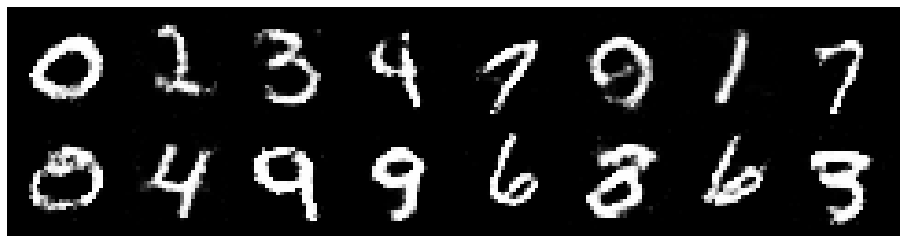

Epoch: [166/200], Batch Num: [500/600]
Discriminator Loss: 1.1508, Generator Loss: 0.8425
D(x): 0.6048, D(G(z)): 0.4351


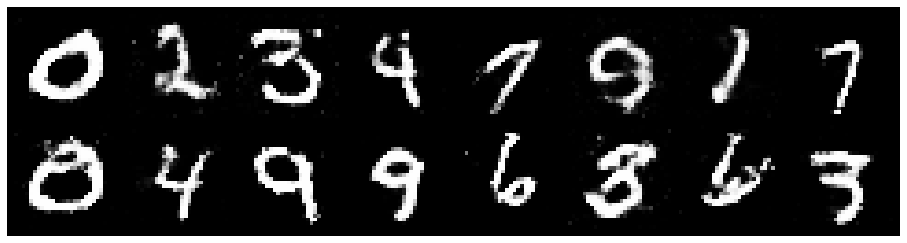

Epoch: [167/200], Batch Num: [0/600]
Discriminator Loss: 1.3768, Generator Loss: 0.8870
D(x): 0.5353, D(G(z)): 0.4750


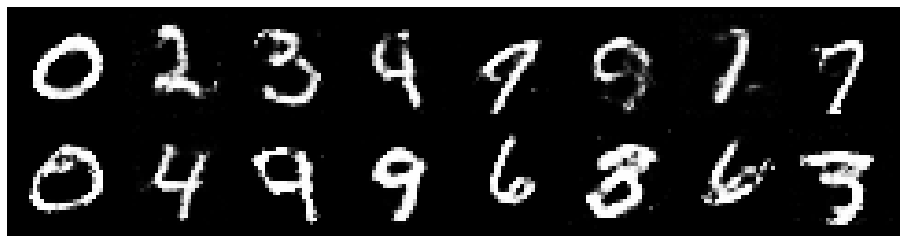

Epoch: [167/200], Batch Num: [100/600]
Discriminator Loss: 1.2455, Generator Loss: 0.9949
D(x): 0.5965, D(G(z)): 0.4557


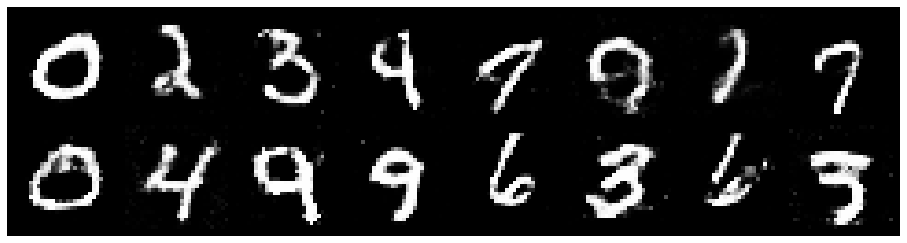

Epoch: [167/200], Batch Num: [200/600]
Discriminator Loss: 1.3322, Generator Loss: 0.8161
D(x): 0.5544, D(G(z)): 0.4801


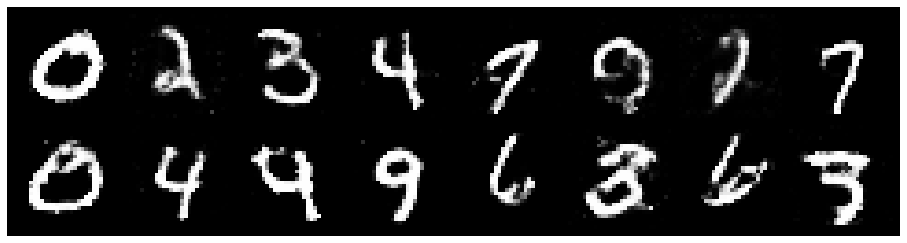

Epoch: [167/200], Batch Num: [300/600]
Discriminator Loss: 1.2671, Generator Loss: 0.9298
D(x): 0.5550, D(G(z)): 0.4287


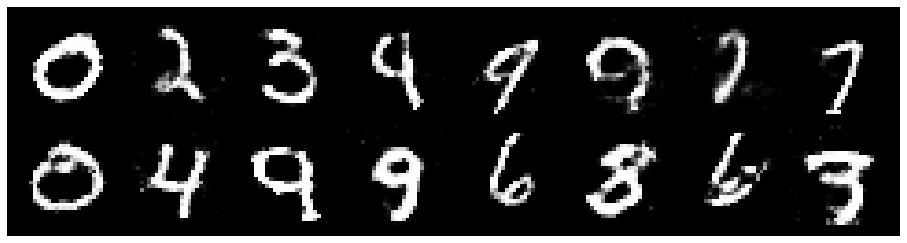

Epoch: [167/200], Batch Num: [400/600]
Discriminator Loss: 1.3825, Generator Loss: 0.6820
D(x): 0.5581, D(G(z)): 0.5155


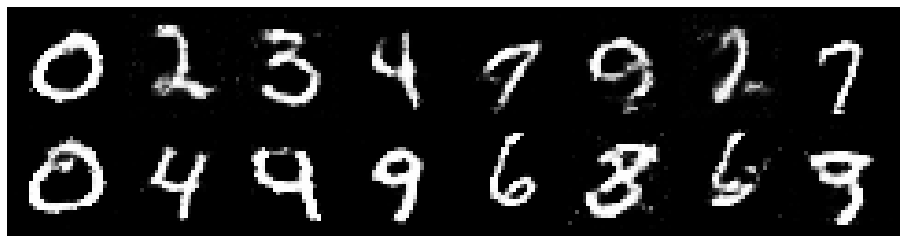

Epoch: [167/200], Batch Num: [500/600]
Discriminator Loss: 1.3724, Generator Loss: 0.9672
D(x): 0.5059, D(G(z)): 0.4263


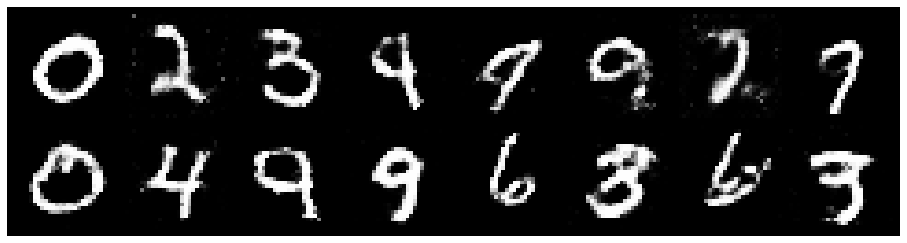

Epoch: [168/200], Batch Num: [0/600]
Discriminator Loss: 1.2892, Generator Loss: 0.9634
D(x): 0.5918, D(G(z)): 0.4601


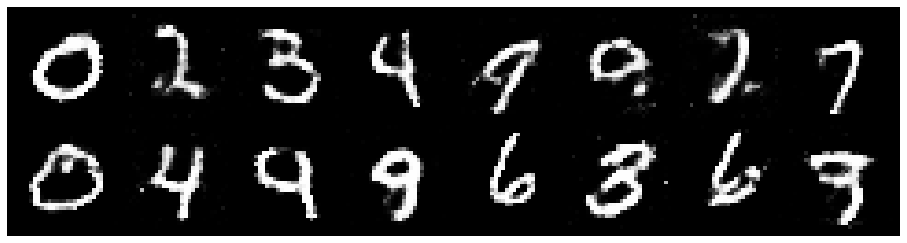

Epoch: [168/200], Batch Num: [100/600]
Discriminator Loss: 1.3809, Generator Loss: 1.0547
D(x): 0.5464, D(G(z)): 0.4731


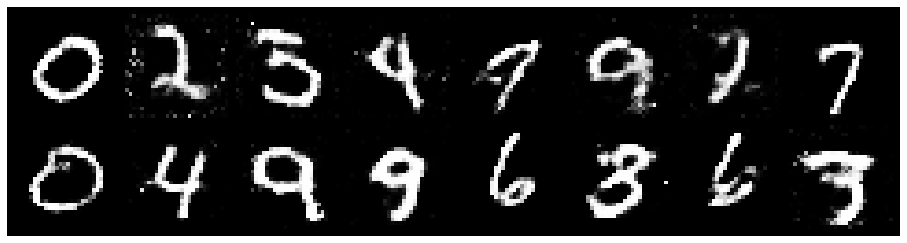

Epoch: [168/200], Batch Num: [200/600]
Discriminator Loss: 1.2737, Generator Loss: 0.8380
D(x): 0.5549, D(G(z)): 0.4529


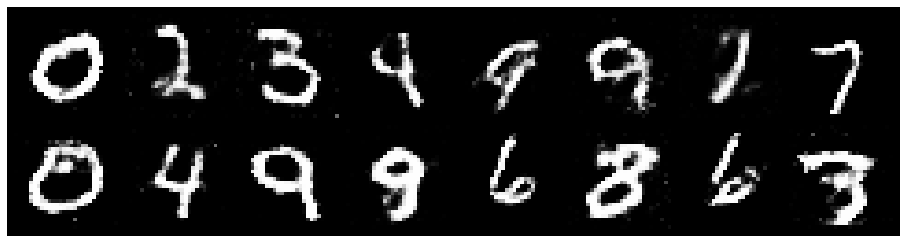

Epoch: [168/200], Batch Num: [300/600]
Discriminator Loss: 1.2836, Generator Loss: 0.8109
D(x): 0.5540, D(G(z)): 0.4709


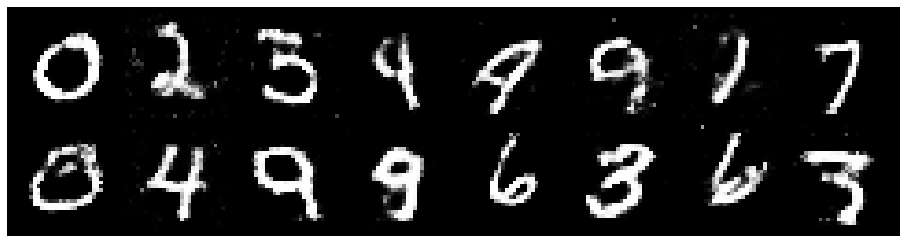

Epoch: [168/200], Batch Num: [400/600]
Discriminator Loss: 1.3245, Generator Loss: 0.8848
D(x): 0.5488, D(G(z)): 0.4518


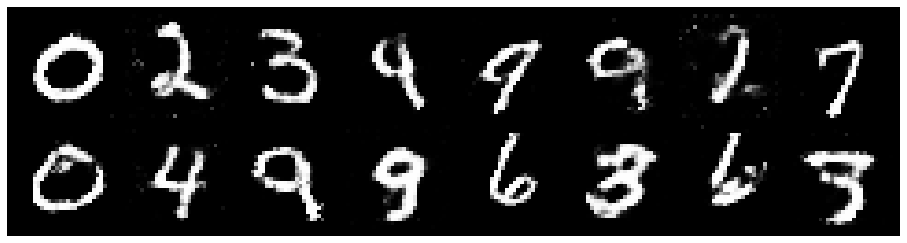

Epoch: [168/200], Batch Num: [500/600]
Discriminator Loss: 1.4453, Generator Loss: 0.8976
D(x): 0.5019, D(G(z)): 0.4587


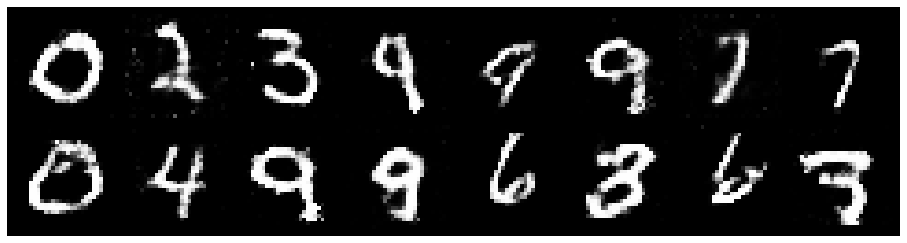

Epoch: [169/200], Batch Num: [0/600]
Discriminator Loss: 1.2536, Generator Loss: 0.8311
D(x): 0.5840, D(G(z)): 0.4641


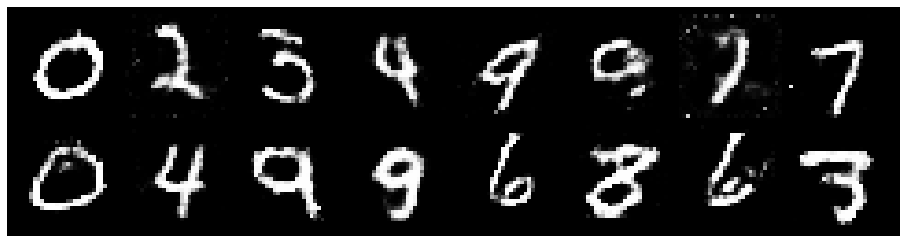

Epoch: [169/200], Batch Num: [100/600]
Discriminator Loss: 1.3189, Generator Loss: 0.9005
D(x): 0.5490, D(G(z)): 0.4710


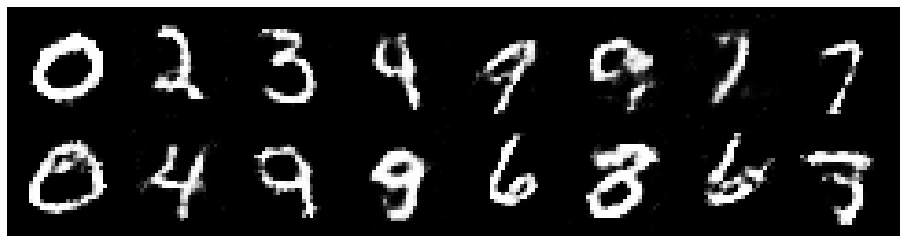

Epoch: [169/200], Batch Num: [200/600]
Discriminator Loss: 1.2213, Generator Loss: 0.7977
D(x): 0.5779, D(G(z)): 0.4414


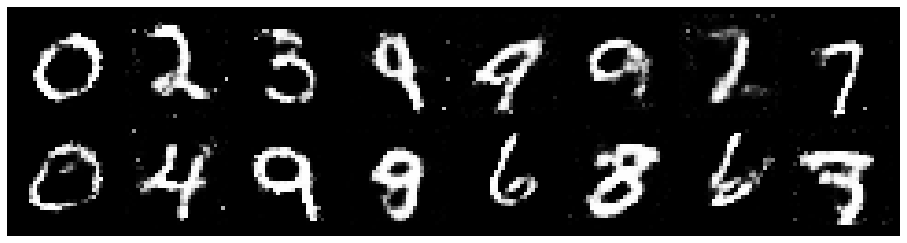

Epoch: [169/200], Batch Num: [300/600]
Discriminator Loss: 1.1994, Generator Loss: 0.9123
D(x): 0.5451, D(G(z)): 0.4142


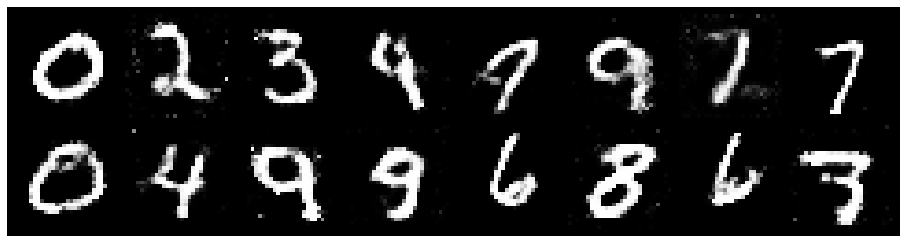

Epoch: [169/200], Batch Num: [400/600]
Discriminator Loss: 1.3875, Generator Loss: 0.8788
D(x): 0.5310, D(G(z)): 0.4775


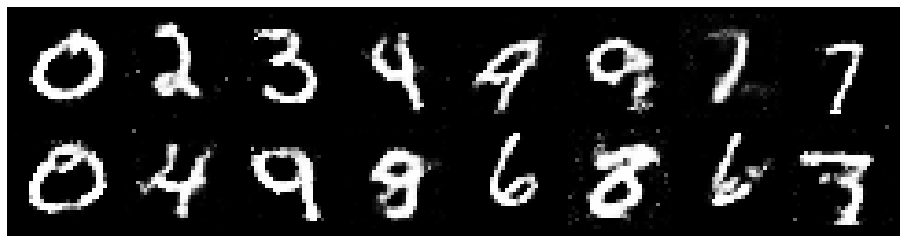

Epoch: [169/200], Batch Num: [500/600]
Discriminator Loss: 1.2732, Generator Loss: 0.8766
D(x): 0.5465, D(G(z)): 0.4561


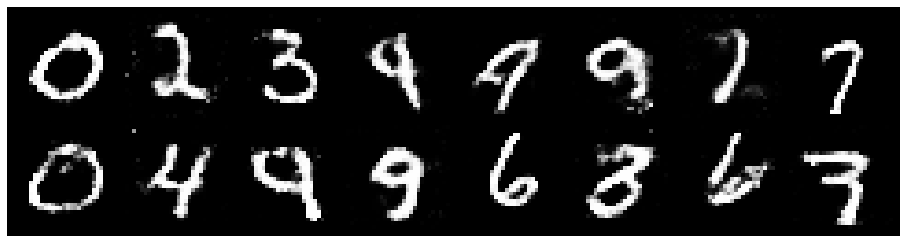

Epoch: [170/200], Batch Num: [0/600]
Discriminator Loss: 1.3294, Generator Loss: 0.8038
D(x): 0.5361, D(G(z)): 0.4677


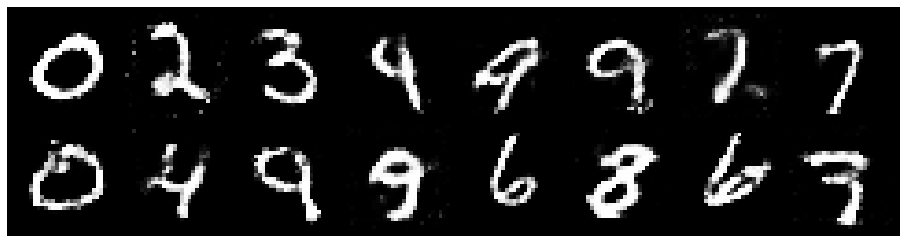

Epoch: [170/200], Batch Num: [100/600]
Discriminator Loss: 1.2598, Generator Loss: 0.8032
D(x): 0.5703, D(G(z)): 0.4743


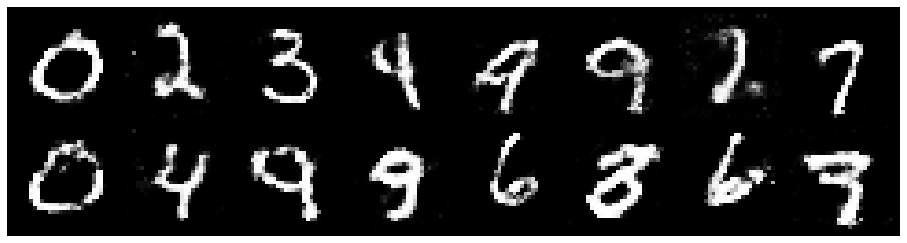

Epoch: [170/200], Batch Num: [200/600]
Discriminator Loss: 1.3750, Generator Loss: 0.8629
D(x): 0.4977, D(G(z)): 0.4238


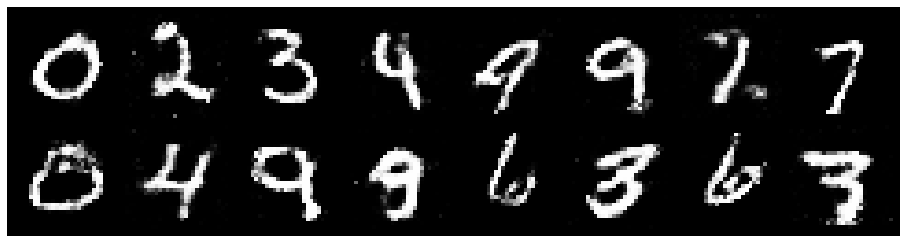

Epoch: [170/200], Batch Num: [300/600]
Discriminator Loss: 1.2605, Generator Loss: 0.8572
D(x): 0.5197, D(G(z)): 0.4307


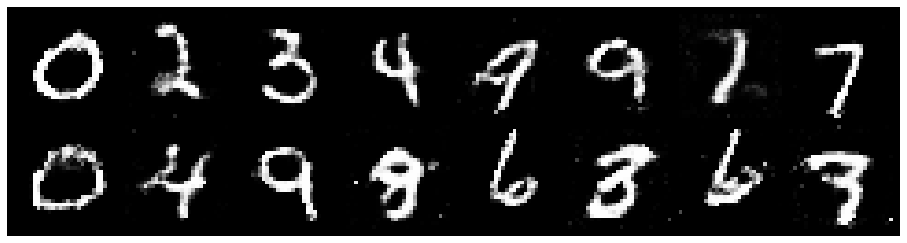

Epoch: [170/200], Batch Num: [400/600]
Discriminator Loss: 1.3579, Generator Loss: 0.7252
D(x): 0.5683, D(G(z)): 0.4971


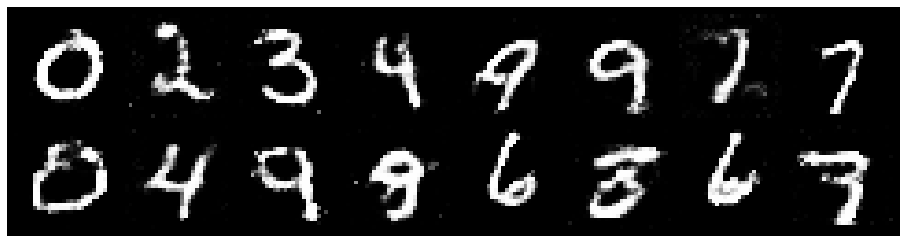

Epoch: [170/200], Batch Num: [500/600]
Discriminator Loss: 1.3500, Generator Loss: 0.8365
D(x): 0.5596, D(G(z)): 0.4797


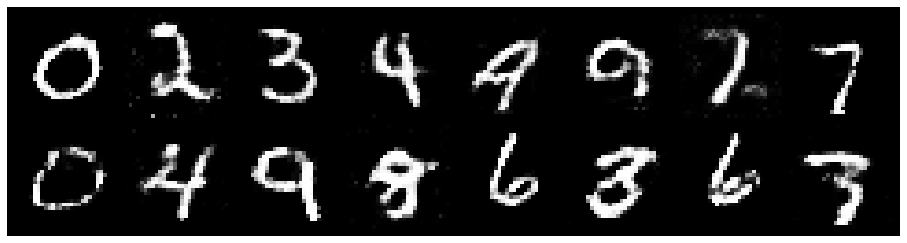

Epoch: [171/200], Batch Num: [0/600]
Discriminator Loss: 1.3915, Generator Loss: 0.8285
D(x): 0.5644, D(G(z)): 0.5004


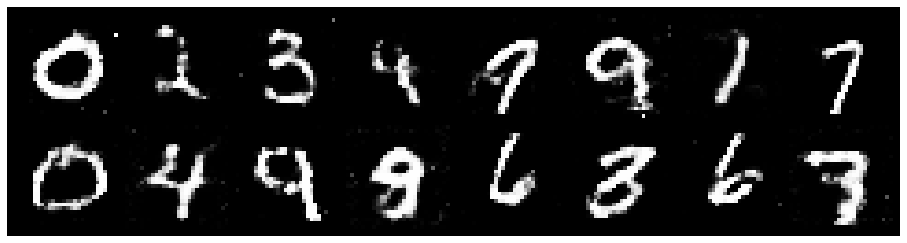

Epoch: [171/200], Batch Num: [100/600]
Discriminator Loss: 1.2688, Generator Loss: 0.9166
D(x): 0.5807, D(G(z)): 0.4556


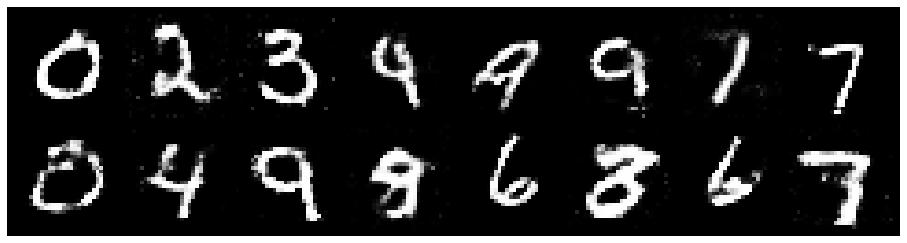

Epoch: [171/200], Batch Num: [200/600]
Discriminator Loss: 1.2343, Generator Loss: 1.1424
D(x): 0.5751, D(G(z)): 0.4281


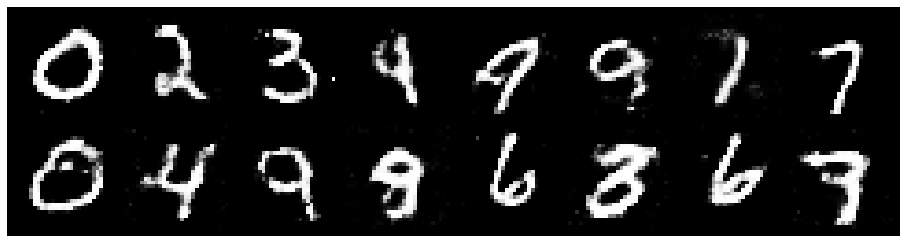

Epoch: [171/200], Batch Num: [300/600]
Discriminator Loss: 1.2280, Generator Loss: 0.9254
D(x): 0.5707, D(G(z)): 0.4316


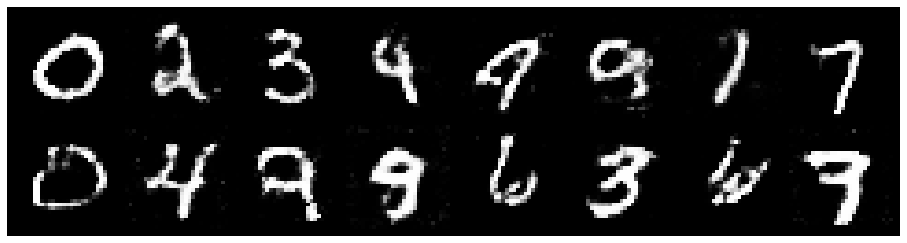

Epoch: [171/200], Batch Num: [400/600]
Discriminator Loss: 1.2559, Generator Loss: 0.9220
D(x): 0.5894, D(G(z)): 0.4653


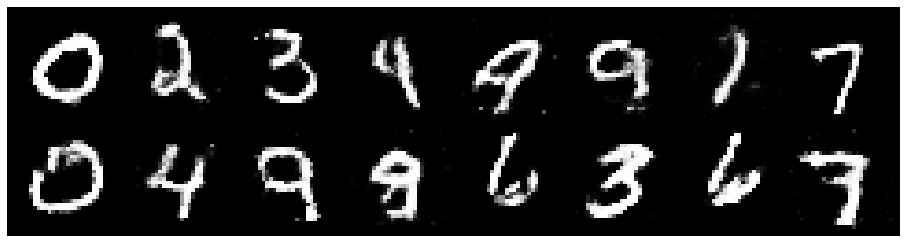

Epoch: [171/200], Batch Num: [500/600]
Discriminator Loss: 1.3395, Generator Loss: 0.8615
D(x): 0.5188, D(G(z)): 0.4531


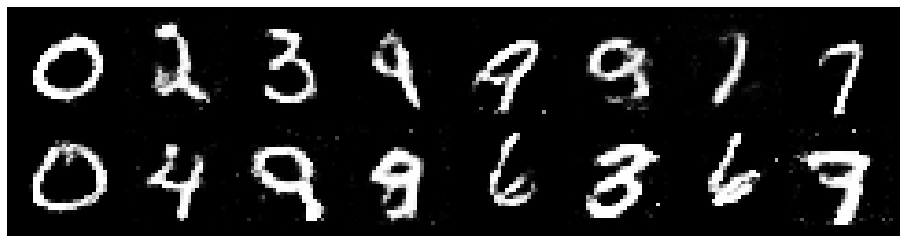

Epoch: [172/200], Batch Num: [0/600]
Discriminator Loss: 1.2541, Generator Loss: 0.9461
D(x): 0.5725, D(G(z)): 0.4462


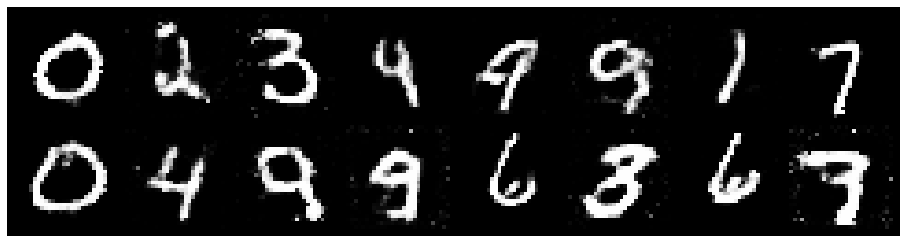

Epoch: [172/200], Batch Num: [100/600]
Discriminator Loss: 1.4277, Generator Loss: 0.7946
D(x): 0.5148, D(G(z)): 0.4801


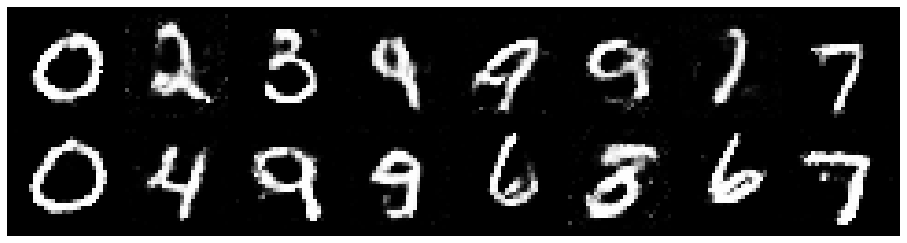

Epoch: [172/200], Batch Num: [200/600]
Discriminator Loss: 1.2859, Generator Loss: 0.8285
D(x): 0.5497, D(G(z)): 0.4547


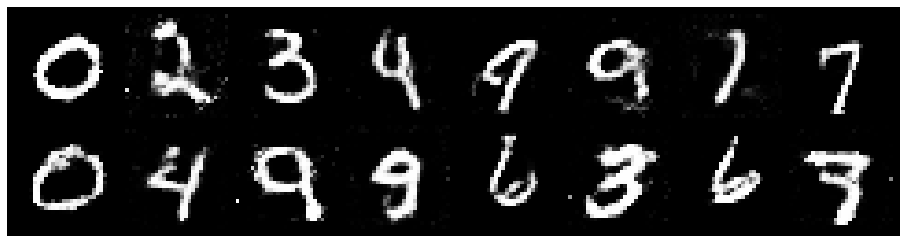

Epoch: [172/200], Batch Num: [300/600]
Discriminator Loss: 1.3462, Generator Loss: 0.8494
D(x): 0.5168, D(G(z)): 0.4464


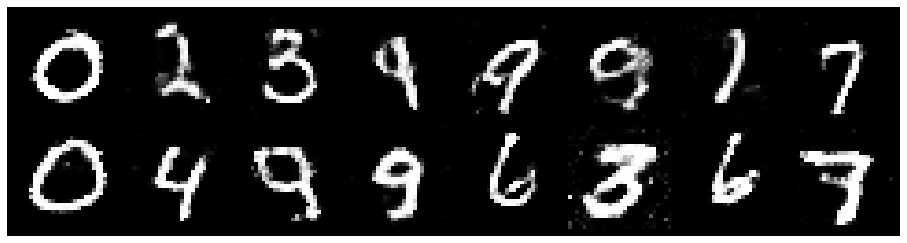

Epoch: [172/200], Batch Num: [400/600]
Discriminator Loss: 1.3203, Generator Loss: 0.8350
D(x): 0.5704, D(G(z)): 0.4743


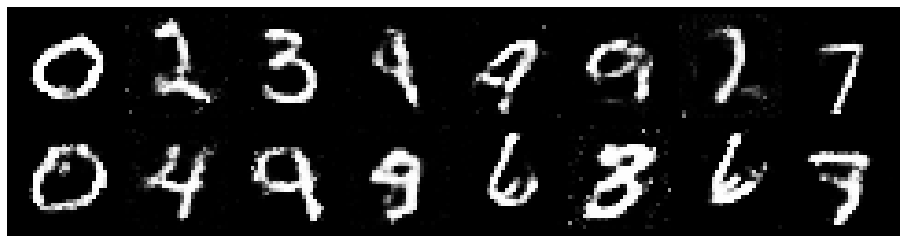

Epoch: [172/200], Batch Num: [500/600]
Discriminator Loss: 1.3526, Generator Loss: 0.8175
D(x): 0.5416, D(G(z)): 0.4811


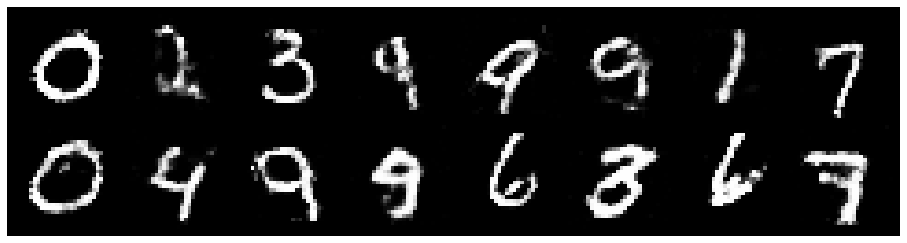

Epoch: [173/200], Batch Num: [0/600]
Discriminator Loss: 1.3251, Generator Loss: 0.8723
D(x): 0.5460, D(G(z)): 0.4651


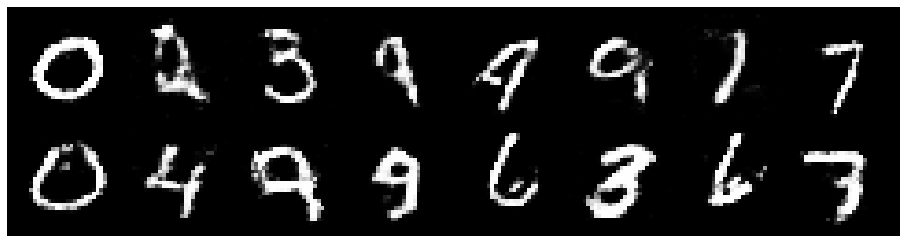

Epoch: [173/200], Batch Num: [100/600]
Discriminator Loss: 1.2031, Generator Loss: 1.0106
D(x): 0.5464, D(G(z)): 0.4020


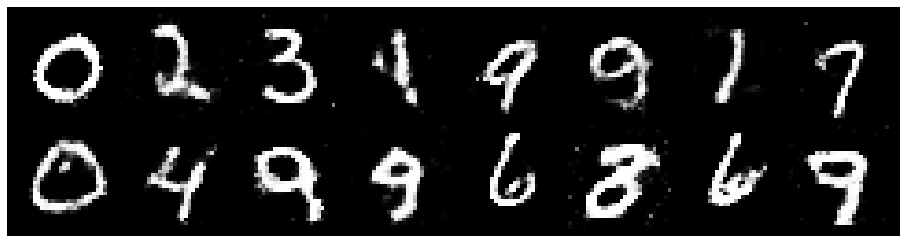

Epoch: [173/200], Batch Num: [200/600]
Discriminator Loss: 1.2971, Generator Loss: 0.8750
D(x): 0.5394, D(G(z)): 0.4547


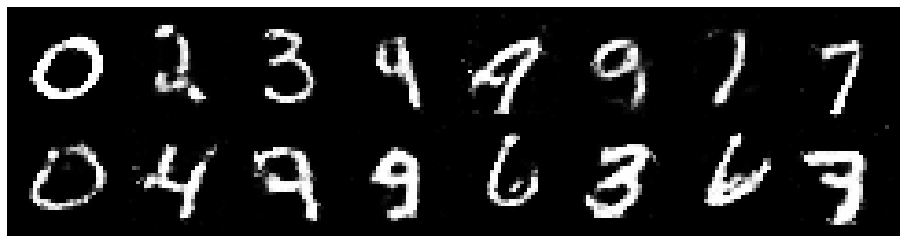

Epoch: [173/200], Batch Num: [300/600]
Discriminator Loss: 1.1380, Generator Loss: 0.9718
D(x): 0.5726, D(G(z)): 0.4000


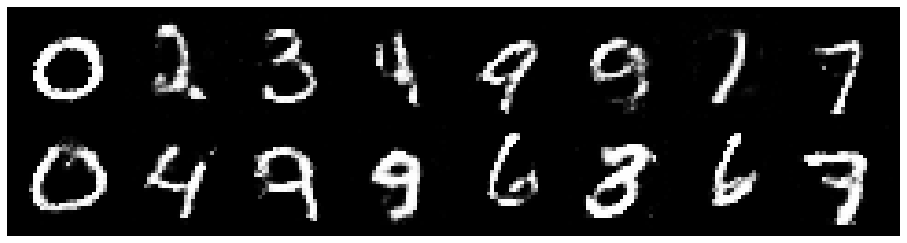

Epoch: [173/200], Batch Num: [400/600]
Discriminator Loss: 1.2809, Generator Loss: 0.8079
D(x): 0.5326, D(G(z)): 0.4496


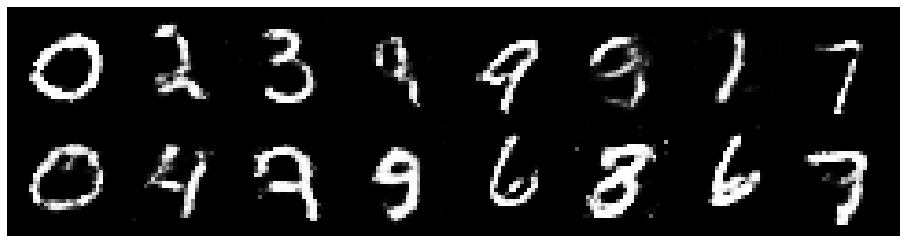

Epoch: [173/200], Batch Num: [500/600]
Discriminator Loss: 1.2608, Generator Loss: 0.8186
D(x): 0.5278, D(G(z)): 0.4352


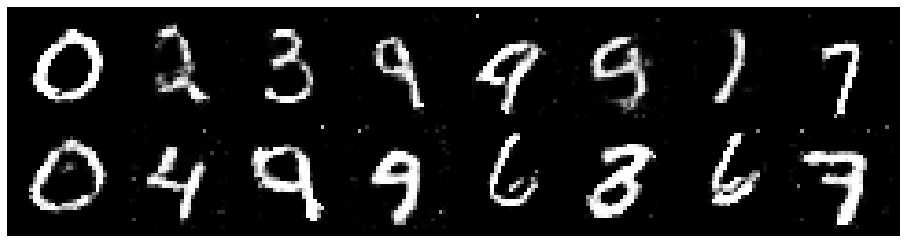

Epoch: [174/200], Batch Num: [0/600]
Discriminator Loss: 1.3765, Generator Loss: 0.9903
D(x): 0.5080, D(G(z)): 0.4450


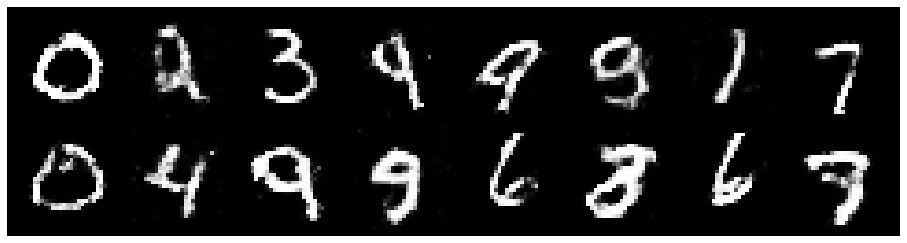

Epoch: [174/200], Batch Num: [100/600]
Discriminator Loss: 1.2836, Generator Loss: 0.8903
D(x): 0.5599, D(G(z)): 0.4556


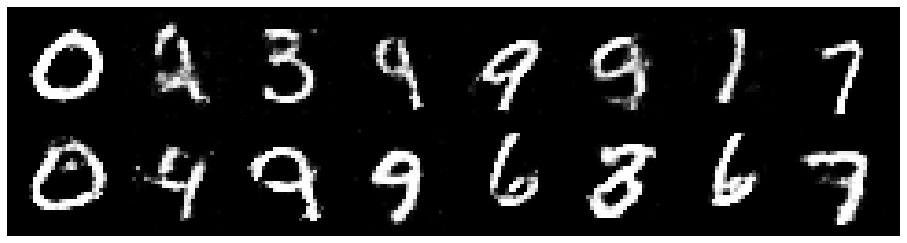

Epoch: [174/200], Batch Num: [200/600]
Discriminator Loss: 1.3268, Generator Loss: 0.7734
D(x): 0.5438, D(G(z)): 0.4737


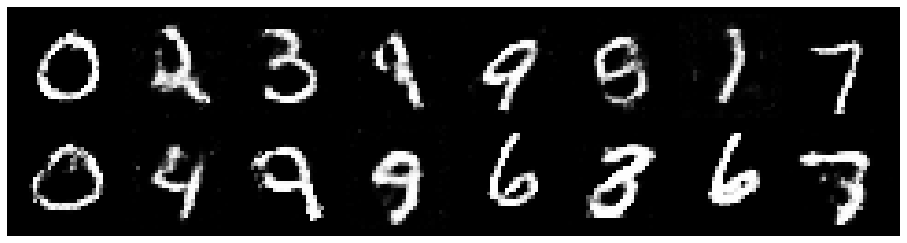

Epoch: [174/200], Batch Num: [300/600]
Discriminator Loss: 1.3044, Generator Loss: 0.8785
D(x): 0.5203, D(G(z)): 0.4436


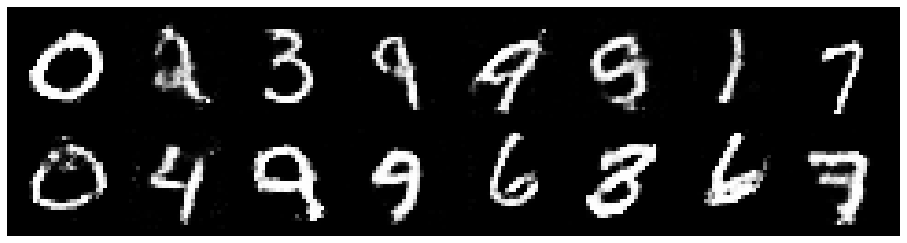

Epoch: [174/200], Batch Num: [400/600]
Discriminator Loss: 1.3389, Generator Loss: 0.8065
D(x): 0.5336, D(G(z)): 0.4705


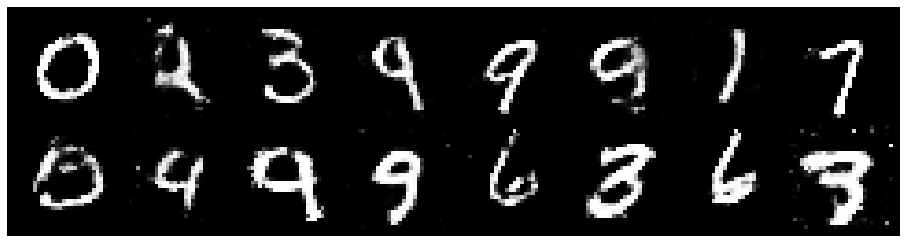

Epoch: [174/200], Batch Num: [500/600]
Discriminator Loss: 1.3103, Generator Loss: 0.7890
D(x): 0.5486, D(G(z)): 0.4675


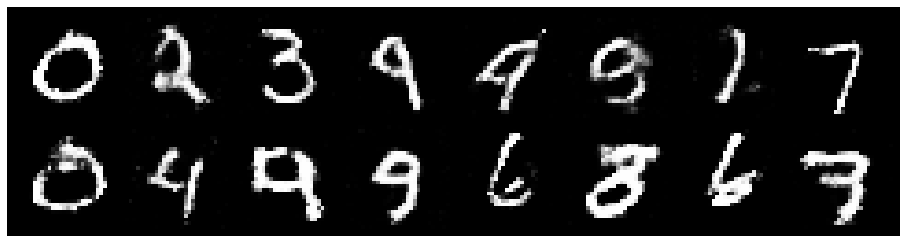

Epoch: [175/200], Batch Num: [0/600]
Discriminator Loss: 1.3664, Generator Loss: 0.8806
D(x): 0.4912, D(G(z)): 0.4112


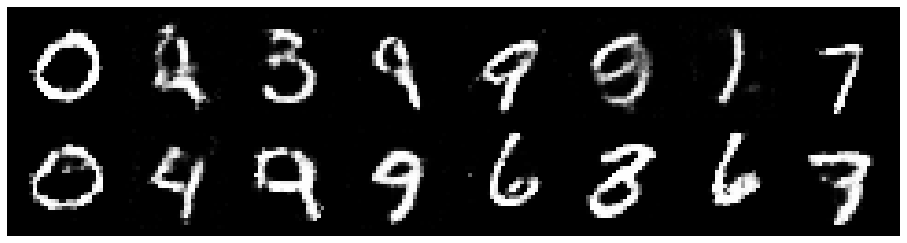

Epoch: [175/200], Batch Num: [100/600]
Discriminator Loss: 1.3003, Generator Loss: 0.8533
D(x): 0.5132, D(G(z)): 0.4306


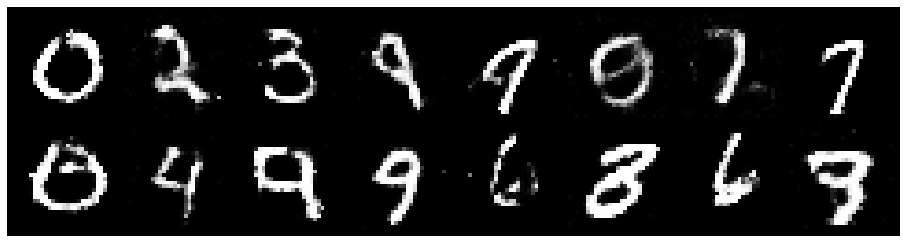

Epoch: [175/200], Batch Num: [200/600]
Discriminator Loss: 1.3122, Generator Loss: 0.8556
D(x): 0.5480, D(G(z)): 0.4725


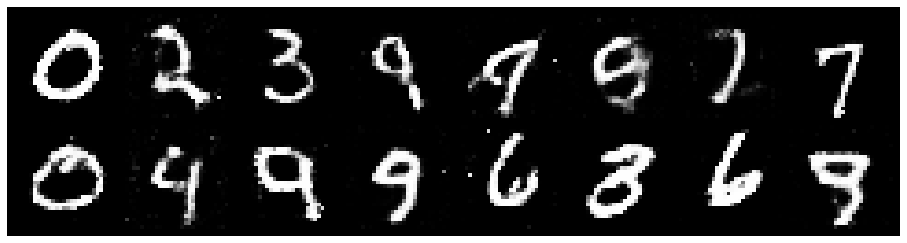

Epoch: [175/200], Batch Num: [300/600]
Discriminator Loss: 1.3267, Generator Loss: 0.8688
D(x): 0.5219, D(G(z)): 0.4629


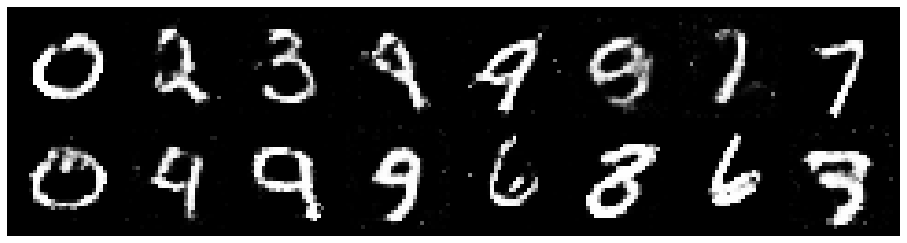

Epoch: [175/200], Batch Num: [400/600]
Discriminator Loss: 1.2989, Generator Loss: 0.8430
D(x): 0.5897, D(G(z)): 0.4652


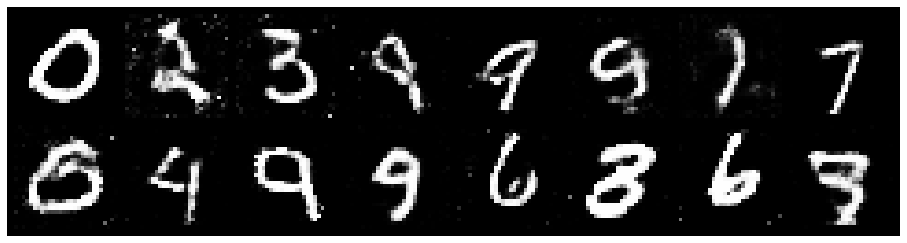

Epoch: [175/200], Batch Num: [500/600]
Discriminator Loss: 1.2217, Generator Loss: 0.9426
D(x): 0.5582, D(G(z)): 0.4329


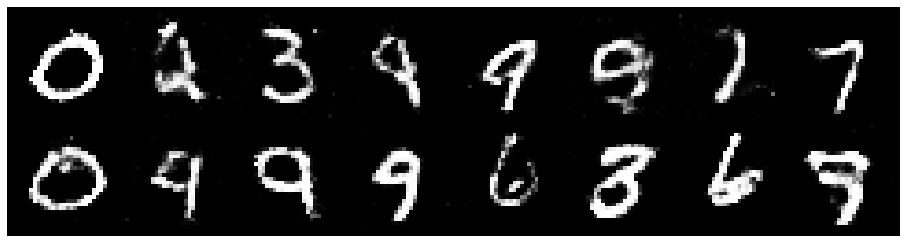

Epoch: [176/200], Batch Num: [0/600]
Discriminator Loss: 1.1570, Generator Loss: 0.9655
D(x): 0.5613, D(G(z)): 0.3889


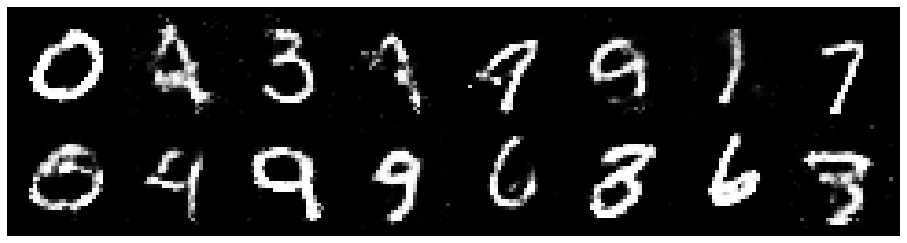

Epoch: [176/200], Batch Num: [100/600]
Discriminator Loss: 1.2369, Generator Loss: 0.9810
D(x): 0.5558, D(G(z)): 0.4178


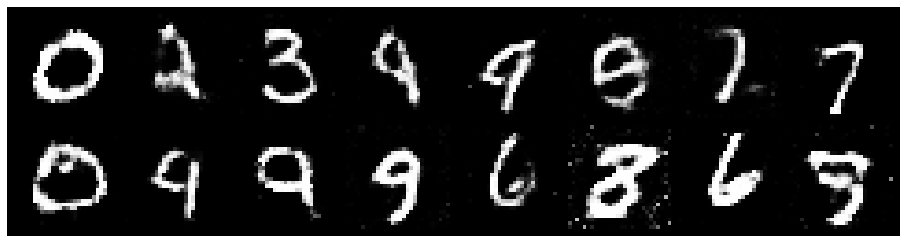

Epoch: [176/200], Batch Num: [200/600]
Discriminator Loss: 1.3142, Generator Loss: 0.9320
D(x): 0.5356, D(G(z)): 0.4365


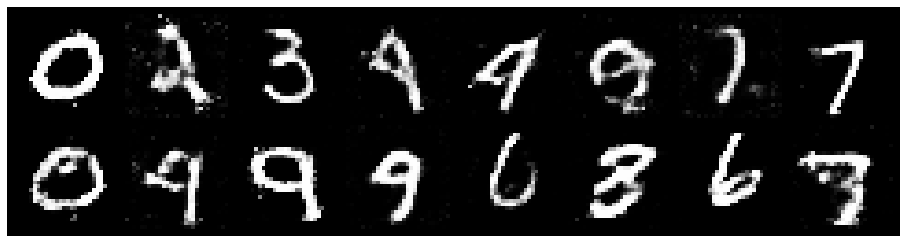

Epoch: [176/200], Batch Num: [300/600]
Discriminator Loss: 1.1032, Generator Loss: 0.9194
D(x): 0.5902, D(G(z)): 0.3841


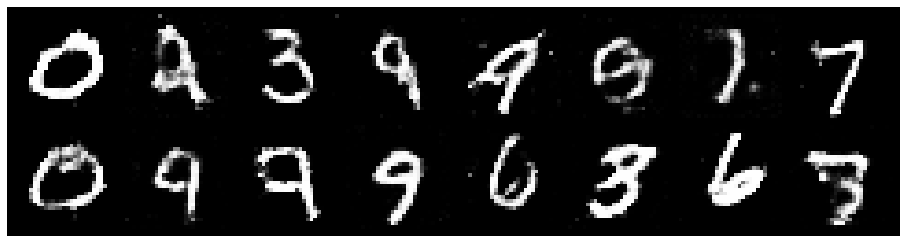

Epoch: [176/200], Batch Num: [400/600]
Discriminator Loss: 1.2325, Generator Loss: 0.9770
D(x): 0.5527, D(G(z)): 0.4095


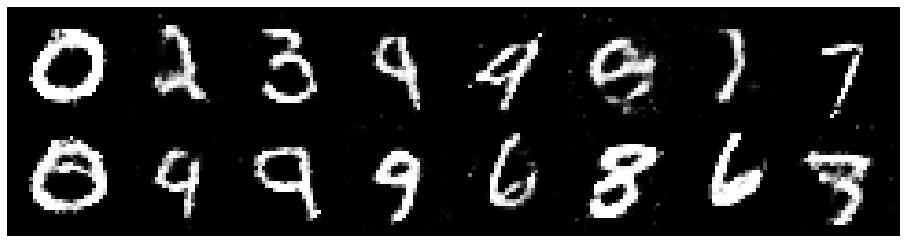

Epoch: [176/200], Batch Num: [500/600]
Discriminator Loss: 1.2472, Generator Loss: 0.9304
D(x): 0.5575, D(G(z)): 0.4389


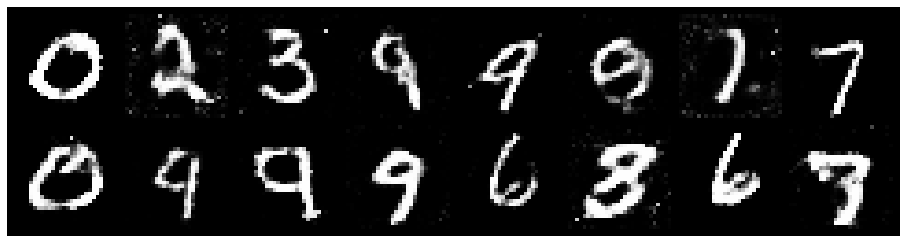

Epoch: [177/200], Batch Num: [0/600]
Discriminator Loss: 1.2548, Generator Loss: 0.9842
D(x): 0.5466, D(G(z)): 0.4137


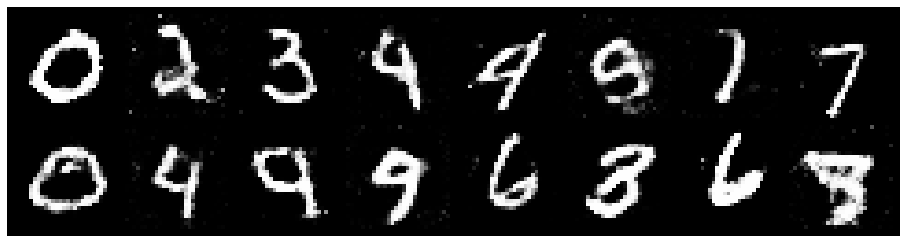

Epoch: [177/200], Batch Num: [100/600]
Discriminator Loss: 1.1807, Generator Loss: 0.8521
D(x): 0.5735, D(G(z)): 0.4251


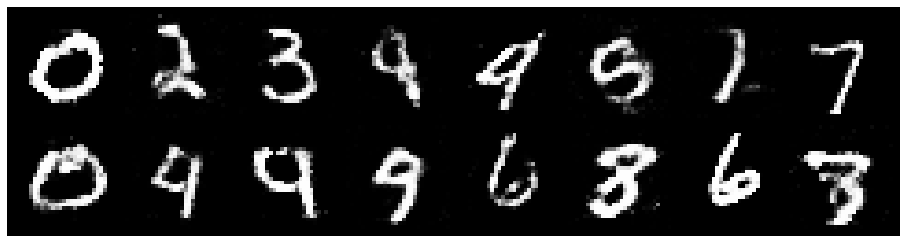

Epoch: [177/200], Batch Num: [200/600]
Discriminator Loss: 1.2247, Generator Loss: 0.8089
D(x): 0.5863, D(G(z)): 0.4574


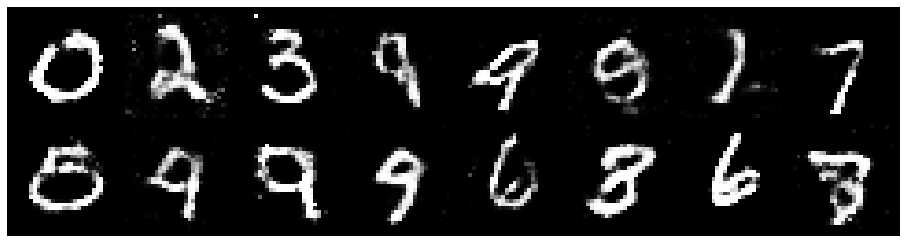

Epoch: [177/200], Batch Num: [300/600]
Discriminator Loss: 1.2349, Generator Loss: 0.9237
D(x): 0.5281, D(G(z)): 0.4054


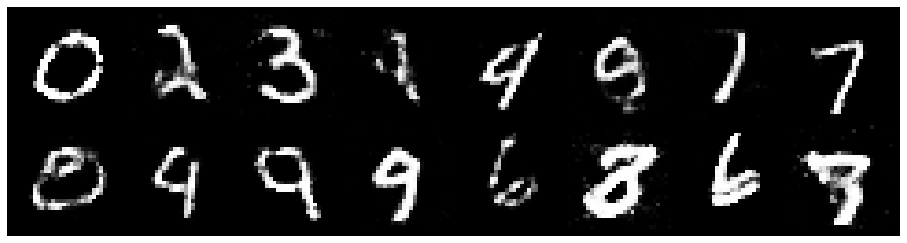

Epoch: [177/200], Batch Num: [400/600]
Discriminator Loss: 1.2493, Generator Loss: 0.9979
D(x): 0.5518, D(G(z)): 0.4268


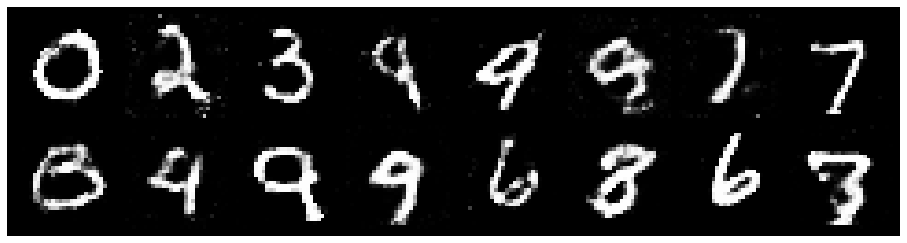

Epoch: [177/200], Batch Num: [500/600]
Discriminator Loss: 1.3117, Generator Loss: 0.9712
D(x): 0.5406, D(G(z)): 0.4634


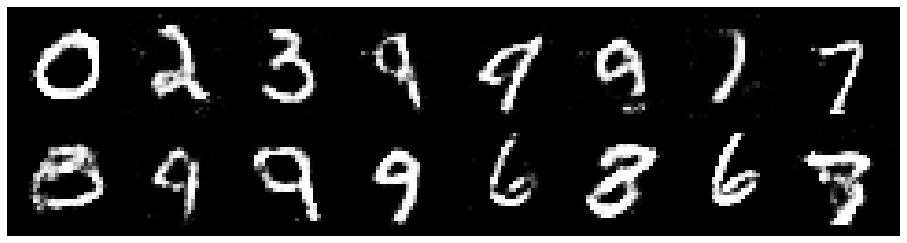

Epoch: [178/200], Batch Num: [0/600]
Discriminator Loss: 1.2542, Generator Loss: 0.7992
D(x): 0.5528, D(G(z)): 0.4456


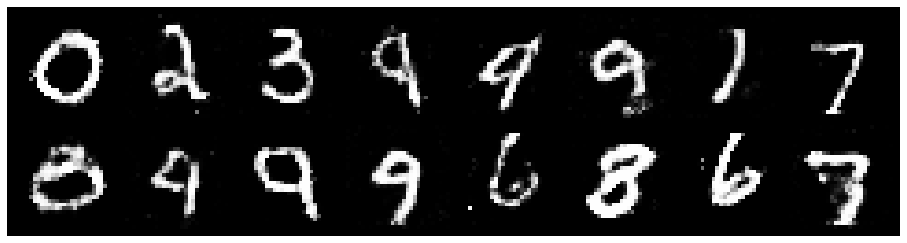

Epoch: [178/200], Batch Num: [100/600]
Discriminator Loss: 1.3115, Generator Loss: 0.7455
D(x): 0.5530, D(G(z)): 0.4682


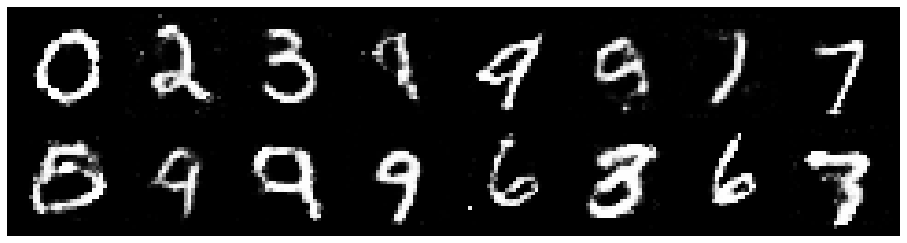

Epoch: [178/200], Batch Num: [200/600]
Discriminator Loss: 1.1980, Generator Loss: 0.9028
D(x): 0.5656, D(G(z)): 0.4341


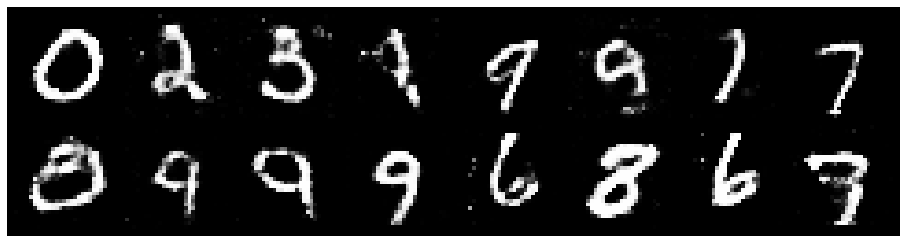

Epoch: [178/200], Batch Num: [300/600]
Discriminator Loss: 1.3026, Generator Loss: 0.7965
D(x): 0.5239, D(G(z)): 0.4540


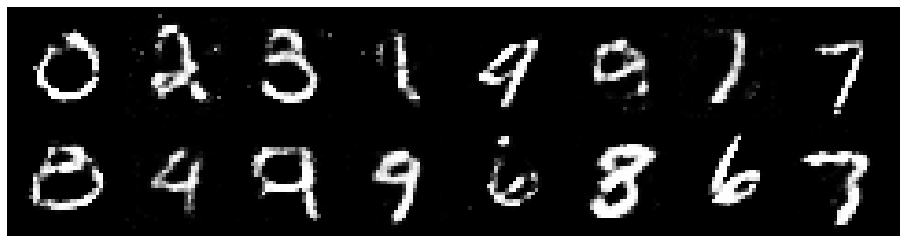

Epoch: [178/200], Batch Num: [400/600]
Discriminator Loss: 1.3073, Generator Loss: 0.8951
D(x): 0.5653, D(G(z)): 0.4685


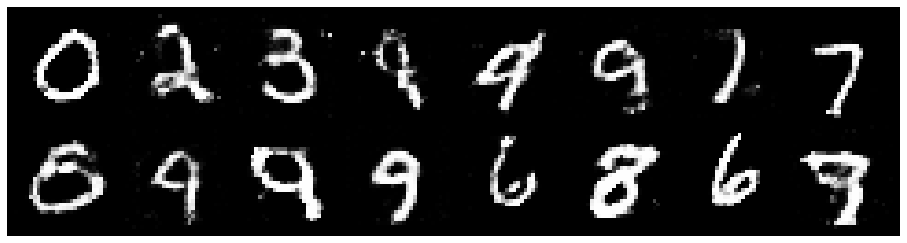

Epoch: [178/200], Batch Num: [500/600]
Discriminator Loss: 1.3268, Generator Loss: 0.8988
D(x): 0.5588, D(G(z)): 0.4711


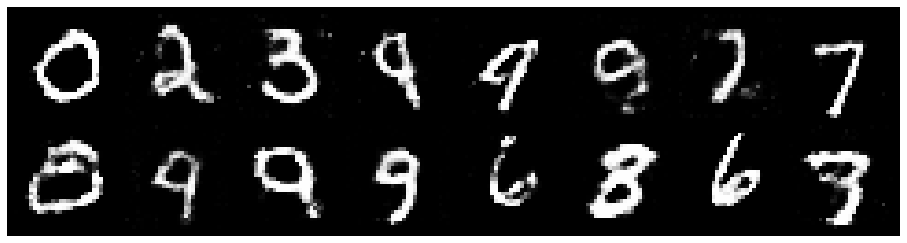

Epoch: [179/200], Batch Num: [0/600]
Discriminator Loss: 1.2926, Generator Loss: 0.8698
D(x): 0.5488, D(G(z)): 0.4361


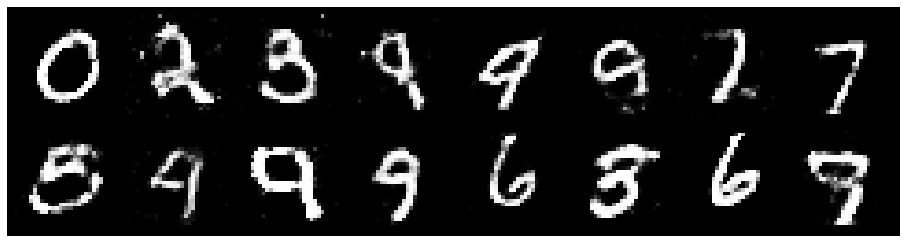

Epoch: [179/200], Batch Num: [100/600]
Discriminator Loss: 1.3140, Generator Loss: 0.8717
D(x): 0.5678, D(G(z)): 0.4655


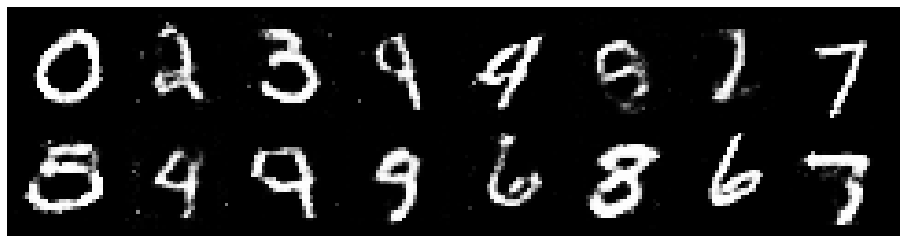

Epoch: [179/200], Batch Num: [200/600]
Discriminator Loss: 1.3242, Generator Loss: 1.0812
D(x): 0.5817, D(G(z)): 0.4694


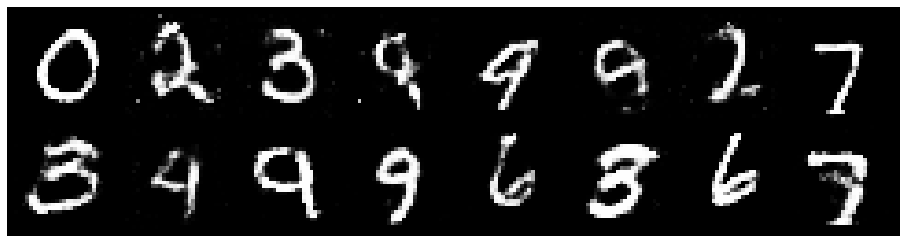

Epoch: [179/200], Batch Num: [300/600]
Discriminator Loss: 1.2849, Generator Loss: 0.8606
D(x): 0.5470, D(G(z)): 0.4416


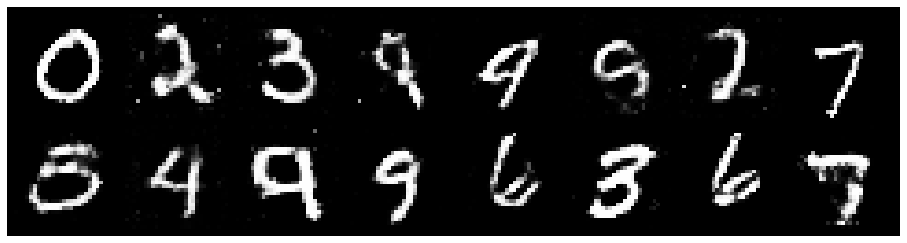

Epoch: [179/200], Batch Num: [400/600]
Discriminator Loss: 1.2442, Generator Loss: 0.8889
D(x): 0.5762, D(G(z)): 0.4519


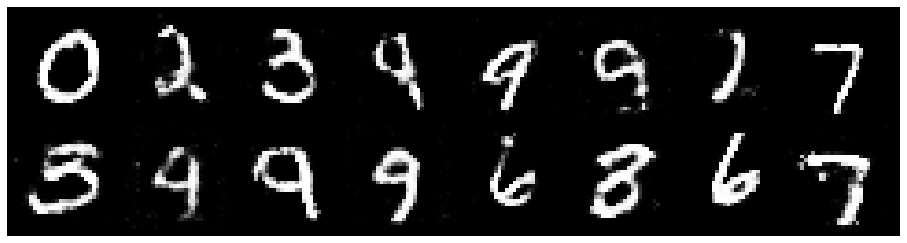

Epoch: [179/200], Batch Num: [500/600]
Discriminator Loss: 1.2685, Generator Loss: 0.8360
D(x): 0.5514, D(G(z)): 0.4485


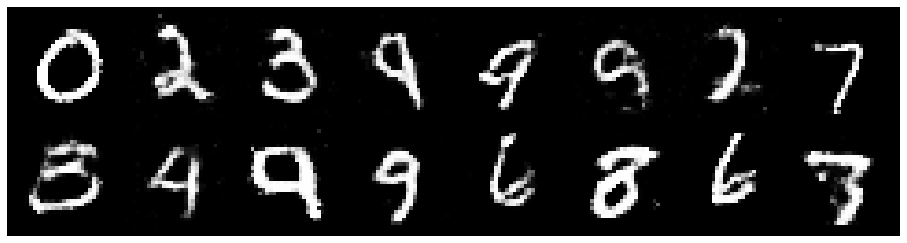

Epoch: [180/200], Batch Num: [0/600]
Discriminator Loss: 1.2850, Generator Loss: 0.8855
D(x): 0.5456, D(G(z)): 0.4311


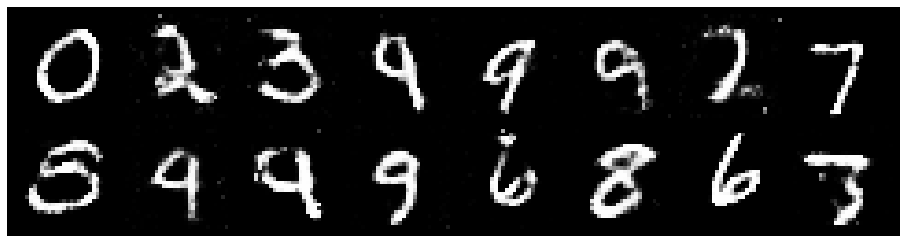

Epoch: [180/200], Batch Num: [100/600]
Discriminator Loss: 1.2783, Generator Loss: 0.7610
D(x): 0.5391, D(G(z)): 0.4546


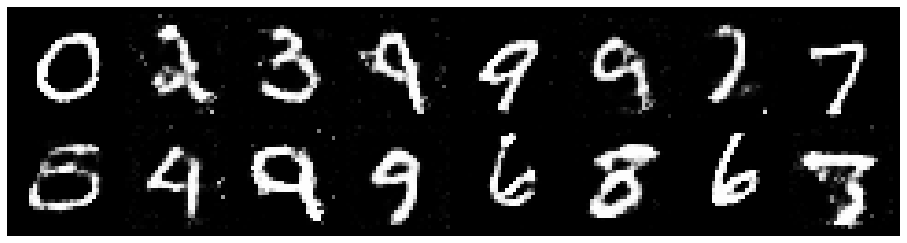

Epoch: [180/200], Batch Num: [200/600]
Discriminator Loss: 1.3159, Generator Loss: 0.7564
D(x): 0.5451, D(G(z)): 0.4552


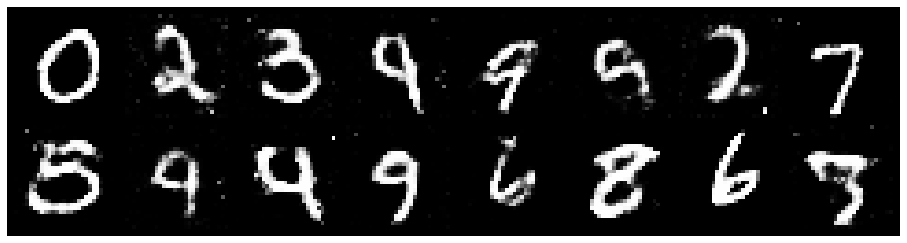

Epoch: [180/200], Batch Num: [300/600]
Discriminator Loss: 1.3218, Generator Loss: 0.9448
D(x): 0.5508, D(G(z)): 0.4716


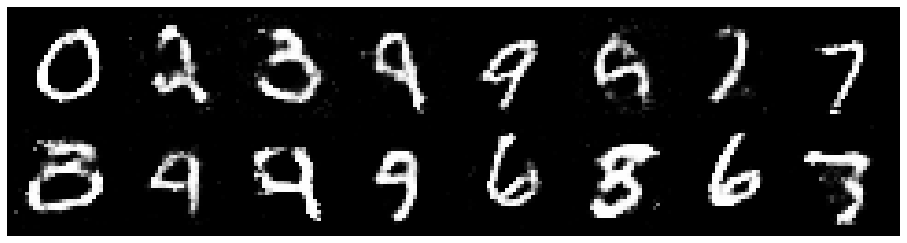

Epoch: [180/200], Batch Num: [400/600]
Discriminator Loss: 1.2615, Generator Loss: 0.7715
D(x): 0.5683, D(G(z)): 0.4550


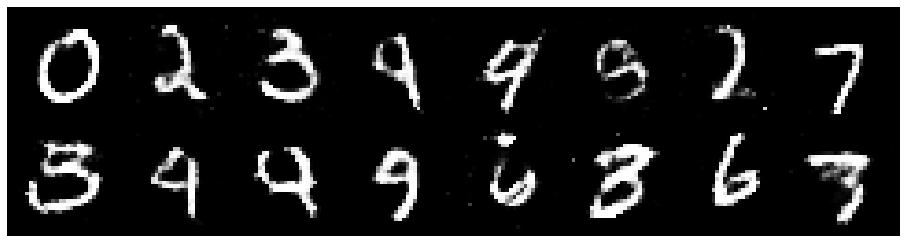

Epoch: [180/200], Batch Num: [500/600]
Discriminator Loss: 1.3587, Generator Loss: 0.8376
D(x): 0.5403, D(G(z)): 0.4559


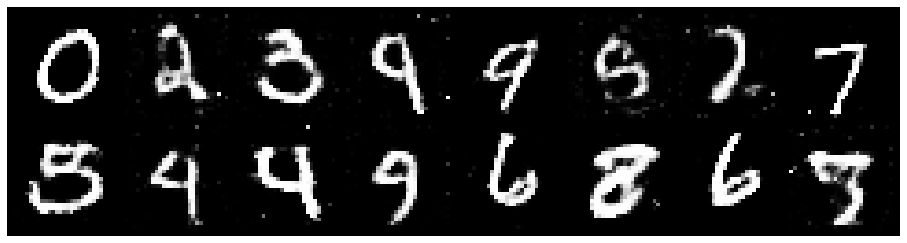

Epoch: [181/200], Batch Num: [0/600]
Discriminator Loss: 1.2422, Generator Loss: 0.8615
D(x): 0.5688, D(G(z)): 0.4489


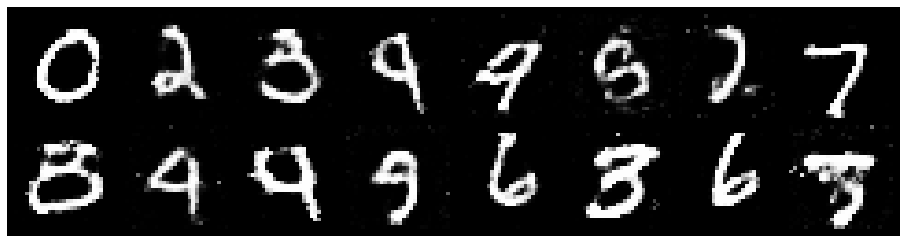

Epoch: [181/200], Batch Num: [100/600]
Discriminator Loss: 1.3130, Generator Loss: 0.9868
D(x): 0.5524, D(G(z)): 0.4565


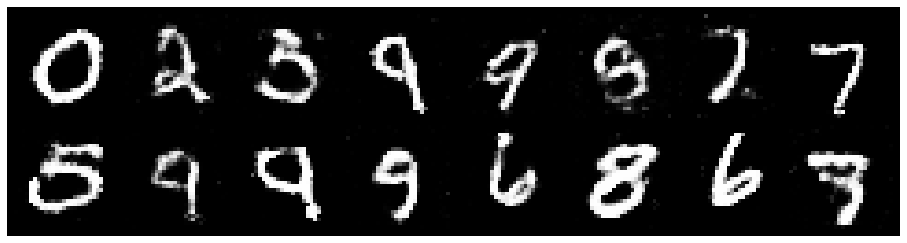

Epoch: [181/200], Batch Num: [200/600]
Discriminator Loss: 1.2741, Generator Loss: 0.8626
D(x): 0.5670, D(G(z)): 0.4761


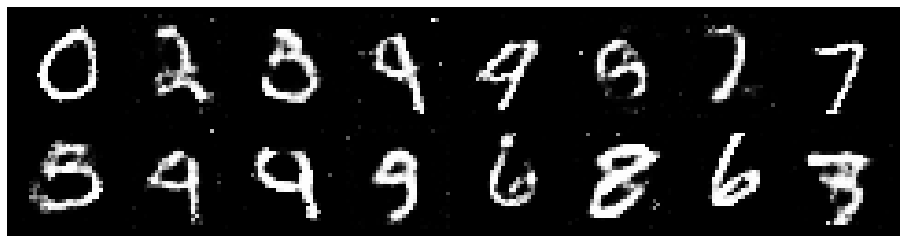

Epoch: [181/200], Batch Num: [300/600]
Discriminator Loss: 1.2832, Generator Loss: 0.8127
D(x): 0.5433, D(G(z)): 0.4597


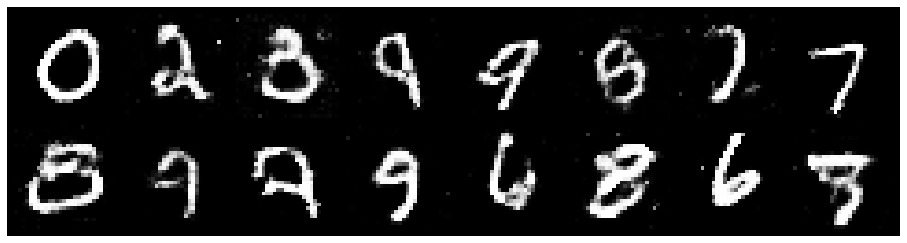

Epoch: [181/200], Batch Num: [400/600]
Discriminator Loss: 1.3001, Generator Loss: 0.8493
D(x): 0.5424, D(G(z)): 0.4623


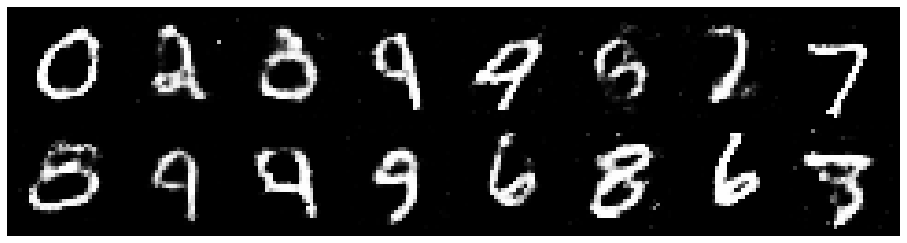

Epoch: [181/200], Batch Num: [500/600]
Discriminator Loss: 1.3142, Generator Loss: 0.8853
D(x): 0.5306, D(G(z)): 0.4468


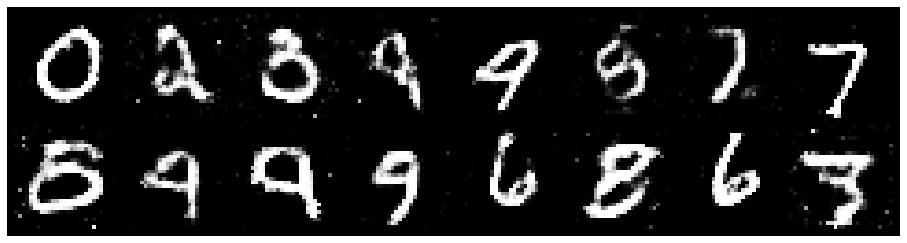

Epoch: [182/200], Batch Num: [0/600]
Discriminator Loss: 1.3369, Generator Loss: 0.7857
D(x): 0.5267, D(G(z)): 0.4698


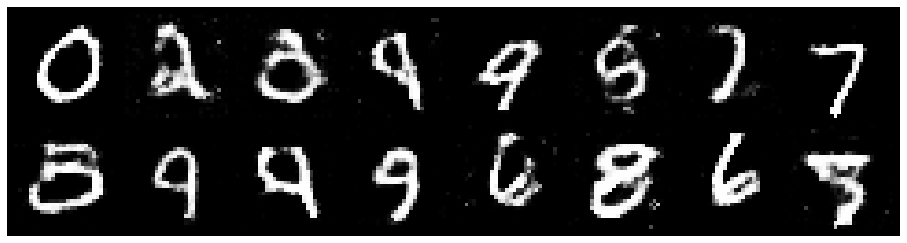

Epoch: [182/200], Batch Num: [100/600]
Discriminator Loss: 1.2830, Generator Loss: 0.9991
D(x): 0.5167, D(G(z)): 0.4262


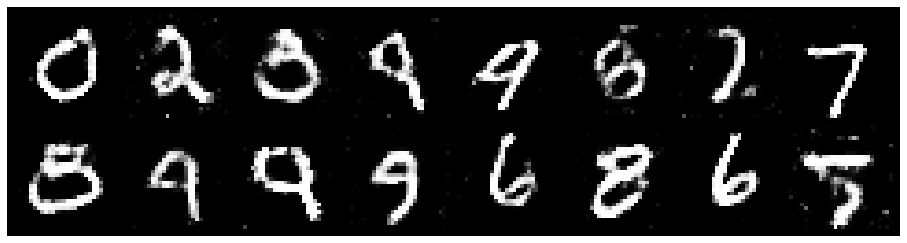

Epoch: [182/200], Batch Num: [200/600]
Discriminator Loss: 1.2174, Generator Loss: 0.8340
D(x): 0.5679, D(G(z)): 0.4378


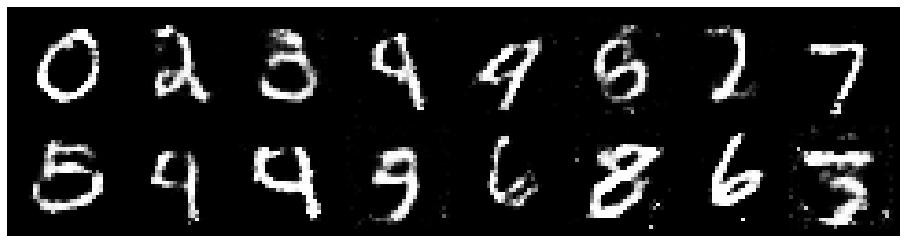

Epoch: [182/200], Batch Num: [300/600]
Discriminator Loss: 1.2706, Generator Loss: 0.8813
D(x): 0.5591, D(G(z)): 0.4497


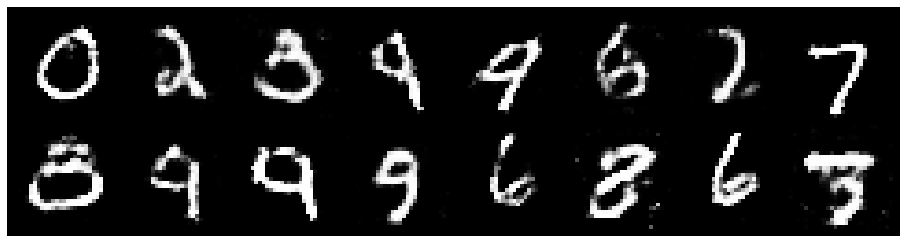

Epoch: [182/200], Batch Num: [400/600]
Discriminator Loss: 1.2287, Generator Loss: 0.8696
D(x): 0.5699, D(G(z)): 0.4529


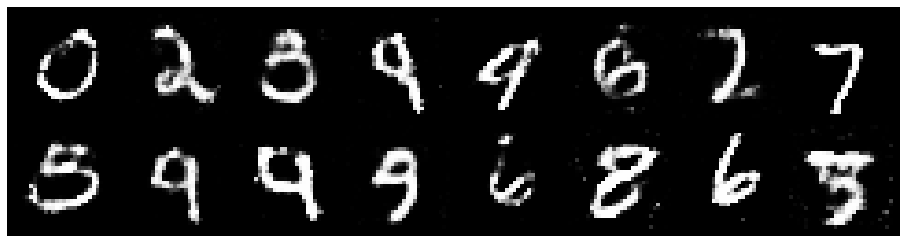

Epoch: [182/200], Batch Num: [500/600]
Discriminator Loss: 1.2725, Generator Loss: 0.8239
D(x): 0.5410, D(G(z)): 0.4456


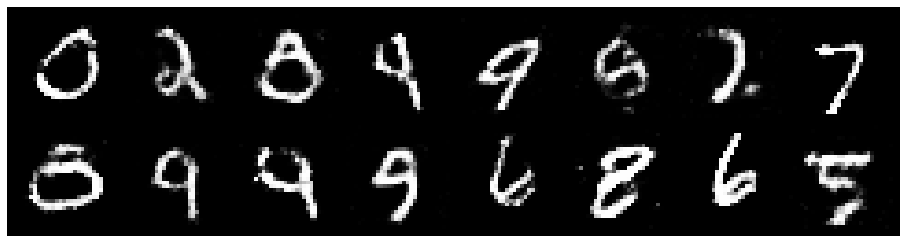

Epoch: [183/200], Batch Num: [0/600]
Discriminator Loss: 1.2687, Generator Loss: 0.8449
D(x): 0.5560, D(G(z)): 0.4492


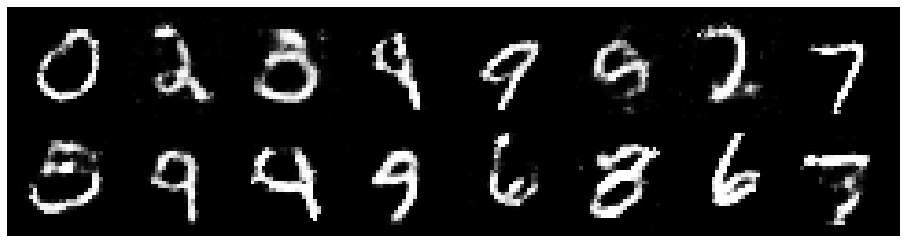

Epoch: [183/200], Batch Num: [100/600]
Discriminator Loss: 1.1913, Generator Loss: 0.8781
D(x): 0.5662, D(G(z)): 0.4220


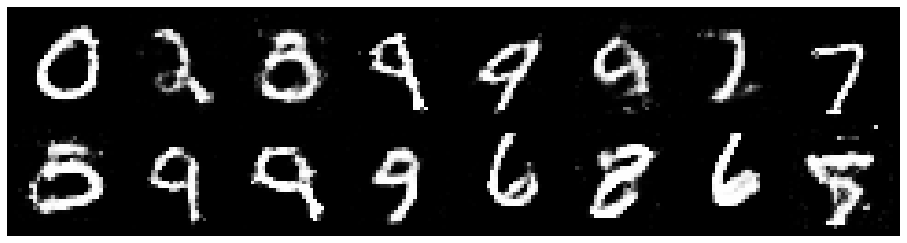

Epoch: [183/200], Batch Num: [200/600]
Discriminator Loss: 1.3168, Generator Loss: 1.0684
D(x): 0.5315, D(G(z)): 0.4369


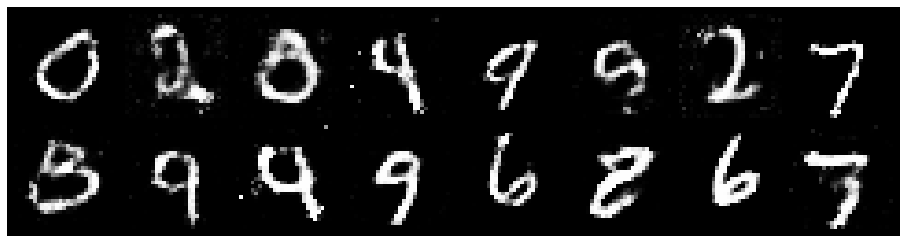

Epoch: [183/200], Batch Num: [300/600]
Discriminator Loss: 1.2899, Generator Loss: 1.0014
D(x): 0.5245, D(G(z)): 0.4395


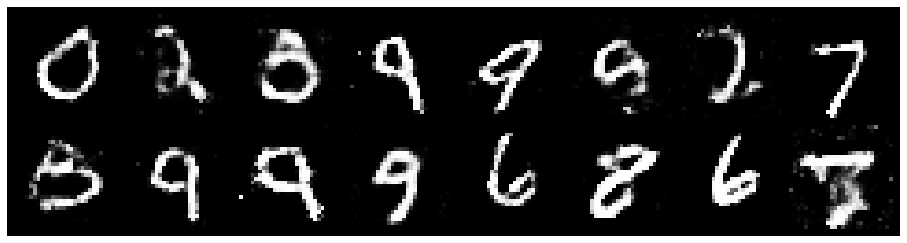

Epoch: [183/200], Batch Num: [400/600]
Discriminator Loss: 1.2923, Generator Loss: 0.8625
D(x): 0.5448, D(G(z)): 0.4617


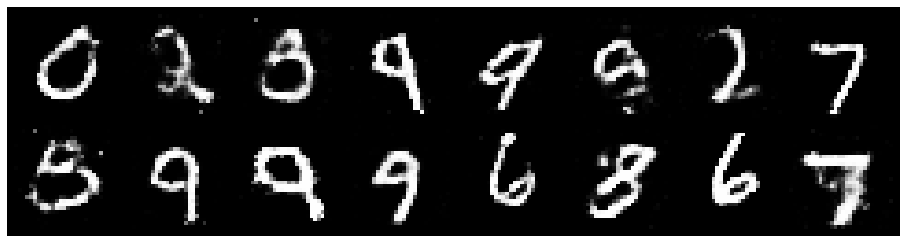

Epoch: [183/200], Batch Num: [500/600]
Discriminator Loss: 1.2676, Generator Loss: 0.8902
D(x): 0.5546, D(G(z)): 0.4504


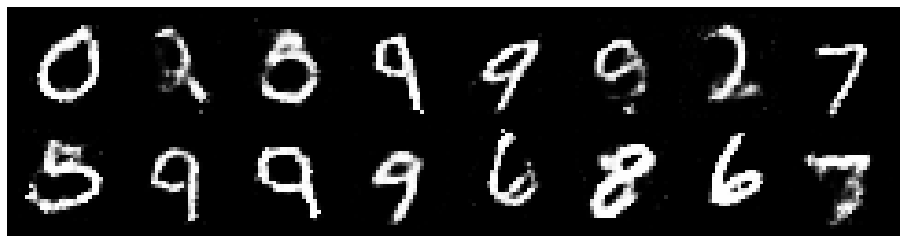

Epoch: [184/200], Batch Num: [0/600]
Discriminator Loss: 1.2893, Generator Loss: 0.9344
D(x): 0.5048, D(G(z)): 0.4094


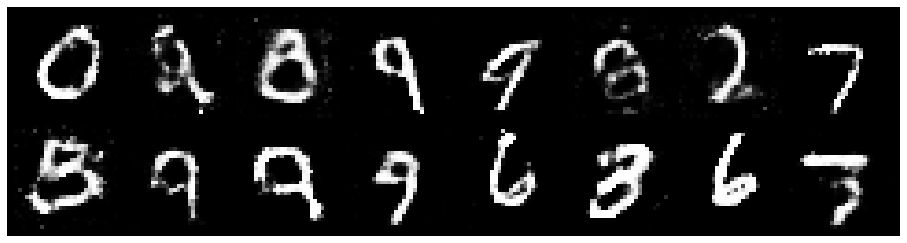

Epoch: [184/200], Batch Num: [100/600]
Discriminator Loss: 1.2869, Generator Loss: 0.8801
D(x): 0.5488, D(G(z)): 0.4454


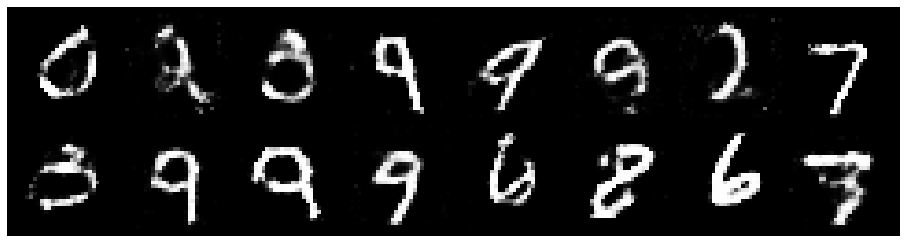

Epoch: [184/200], Batch Num: [200/600]
Discriminator Loss: 1.3397, Generator Loss: 0.8356
D(x): 0.5337, D(G(z)): 0.4667


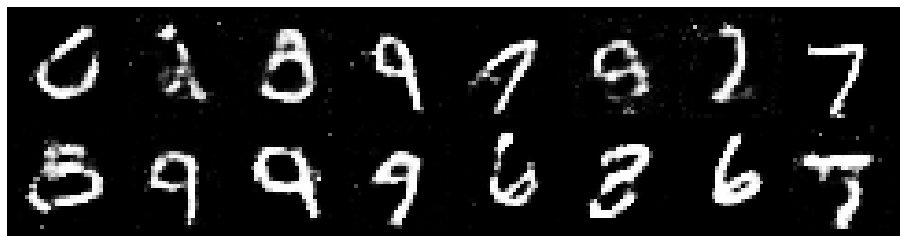

Epoch: [184/200], Batch Num: [300/600]
Discriminator Loss: 1.3612, Generator Loss: 0.8225
D(x): 0.5307, D(G(z)): 0.4659


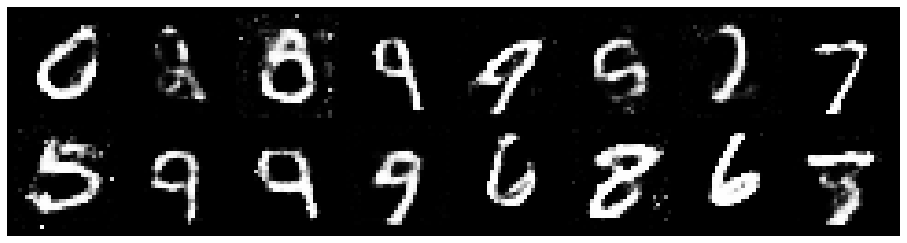

Epoch: [184/200], Batch Num: [400/600]
Discriminator Loss: 1.2191, Generator Loss: 0.9270
D(x): 0.5669, D(G(z)): 0.4265


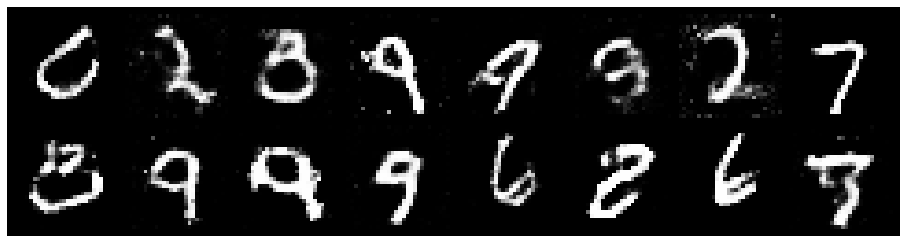

Epoch: [184/200], Batch Num: [500/600]
Discriminator Loss: 1.2933, Generator Loss: 0.8751
D(x): 0.5393, D(G(z)): 0.4479


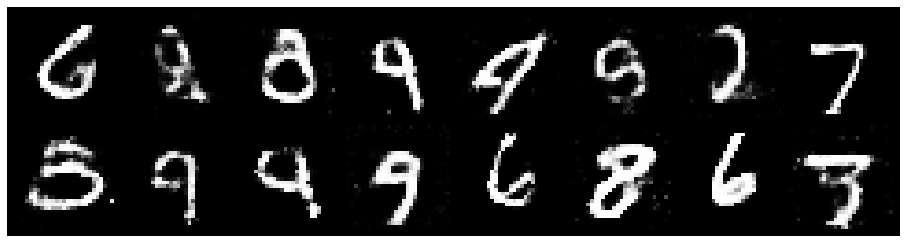

Epoch: [185/200], Batch Num: [0/600]
Discriminator Loss: 1.3320, Generator Loss: 0.8710
D(x): 0.5505, D(G(z)): 0.4715


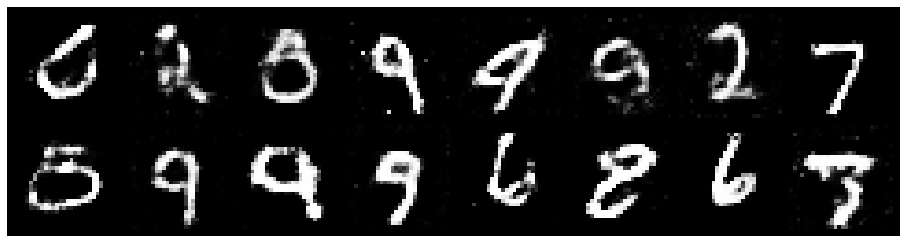

Epoch: [185/200], Batch Num: [100/600]
Discriminator Loss: 1.2239, Generator Loss: 0.9603
D(x): 0.5609, D(G(z)): 0.4245


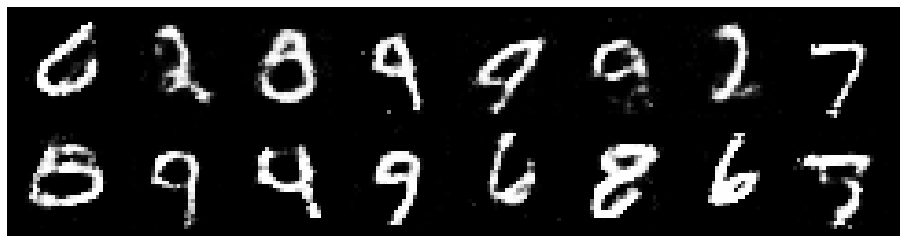

Epoch: [185/200], Batch Num: [200/600]
Discriminator Loss: 1.2217, Generator Loss: 1.0157
D(x): 0.5571, D(G(z)): 0.4018


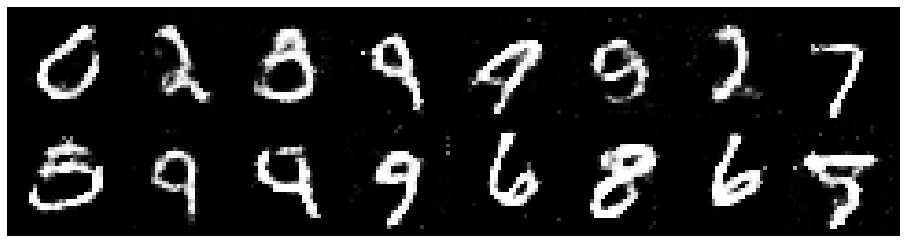

Epoch: [185/200], Batch Num: [300/600]
Discriminator Loss: 1.2485, Generator Loss: 0.8318
D(x): 0.5513, D(G(z)): 0.4412


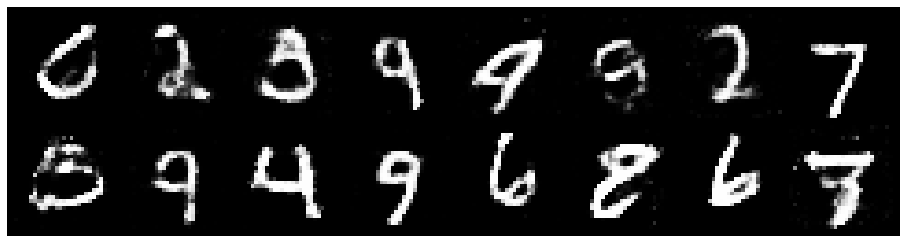

Epoch: [185/200], Batch Num: [400/600]
Discriminator Loss: 1.2184, Generator Loss: 1.0043
D(x): 0.5377, D(G(z)): 0.3967


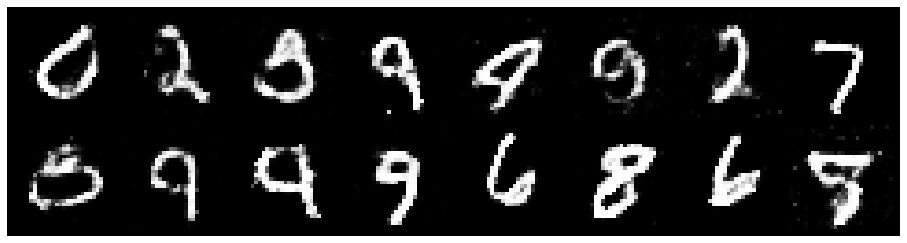

Epoch: [185/200], Batch Num: [500/600]
Discriminator Loss: 1.2837, Generator Loss: 0.7953
D(x): 0.5805, D(G(z)): 0.4738


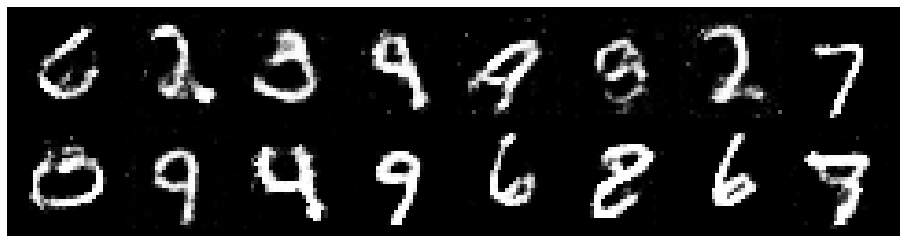

Epoch: [186/200], Batch Num: [0/600]
Discriminator Loss: 1.2046, Generator Loss: 0.8514
D(x): 0.5694, D(G(z)): 0.4279


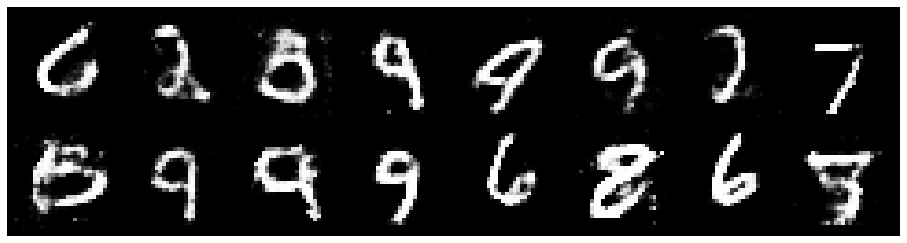

Epoch: [186/200], Batch Num: [100/600]
Discriminator Loss: 1.4177, Generator Loss: 0.7867
D(x): 0.5448, D(G(z)): 0.5012


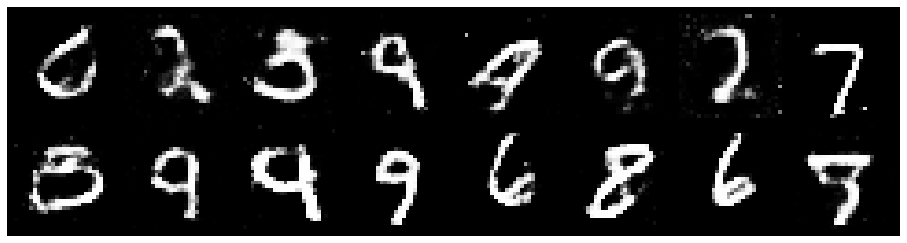

Epoch: [186/200], Batch Num: [200/600]
Discriminator Loss: 1.2627, Generator Loss: 0.8089
D(x): 0.5987, D(G(z)): 0.4631


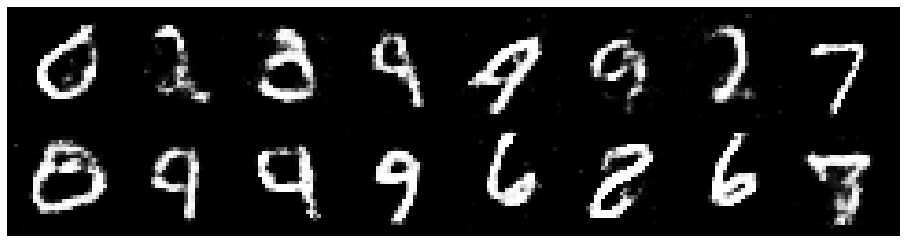

Epoch: [186/200], Batch Num: [300/600]
Discriminator Loss: 1.2307, Generator Loss: 0.8901
D(x): 0.5584, D(G(z)): 0.4272


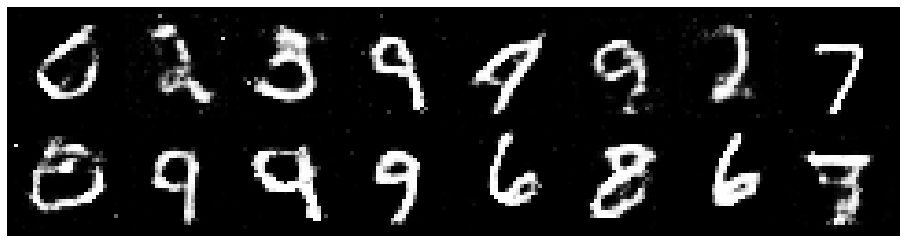

Epoch: [186/200], Batch Num: [400/600]
Discriminator Loss: 1.2564, Generator Loss: 0.9520
D(x): 0.5288, D(G(z)): 0.4084


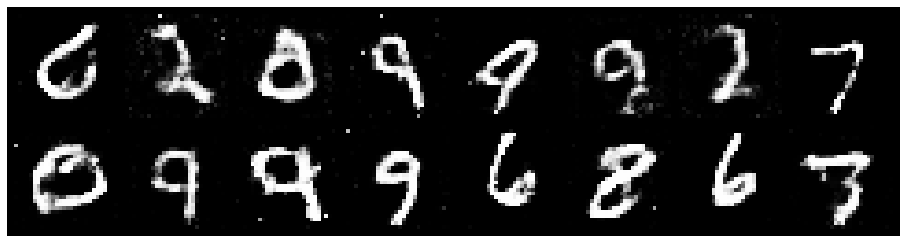

Epoch: [186/200], Batch Num: [500/600]
Discriminator Loss: 1.1977, Generator Loss: 0.9136
D(x): 0.5744, D(G(z)): 0.4253


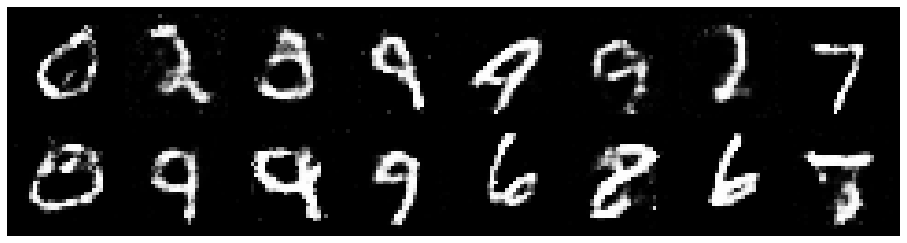

Epoch: [187/200], Batch Num: [0/600]
Discriminator Loss: 1.3315, Generator Loss: 0.8217
D(x): 0.5502, D(G(z)): 0.4750


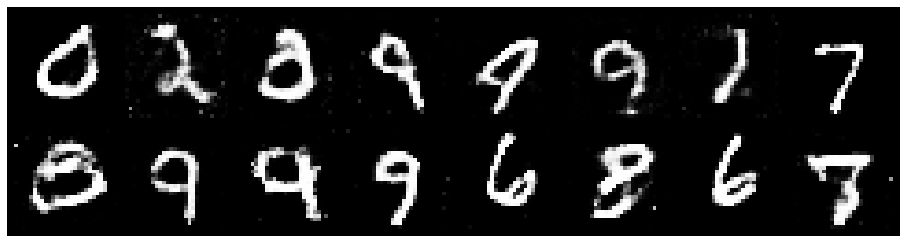

Epoch: [187/200], Batch Num: [100/600]
Discriminator Loss: 1.2449, Generator Loss: 0.9424
D(x): 0.5682, D(G(z)): 0.4440


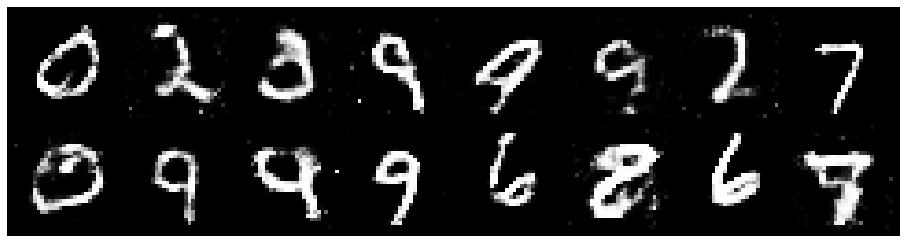

Epoch: [187/200], Batch Num: [200/600]
Discriminator Loss: 1.3032, Generator Loss: 0.8199
D(x): 0.5639, D(G(z)): 0.4745


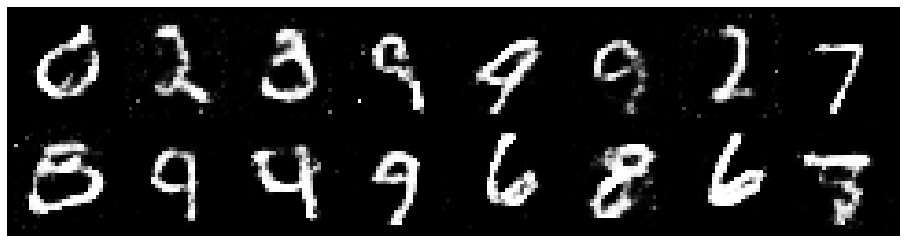

Epoch: [187/200], Batch Num: [300/600]
Discriminator Loss: 1.2105, Generator Loss: 0.8898
D(x): 0.5717, D(G(z)): 0.4258


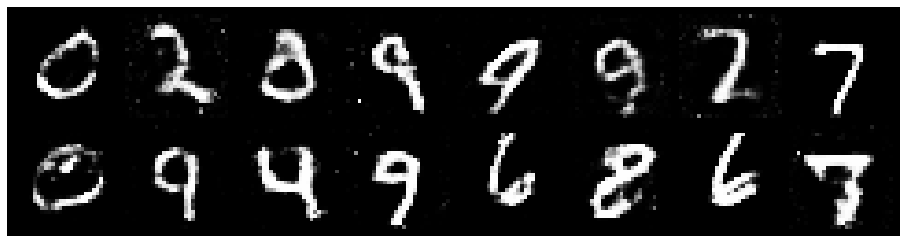

Epoch: [187/200], Batch Num: [400/600]
Discriminator Loss: 1.2655, Generator Loss: 0.8746
D(x): 0.5756, D(G(z)): 0.4593


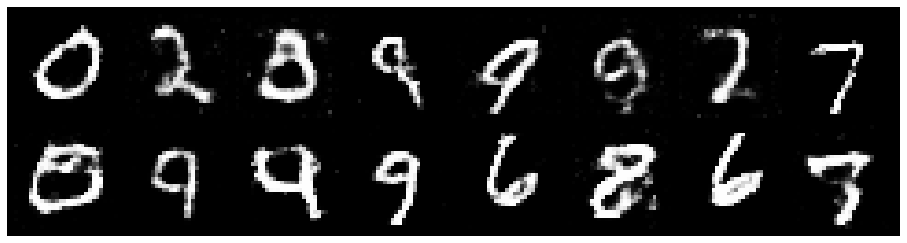

Epoch: [187/200], Batch Num: [500/600]
Discriminator Loss: 1.2509, Generator Loss: 0.9535
D(x): 0.5542, D(G(z)): 0.4290


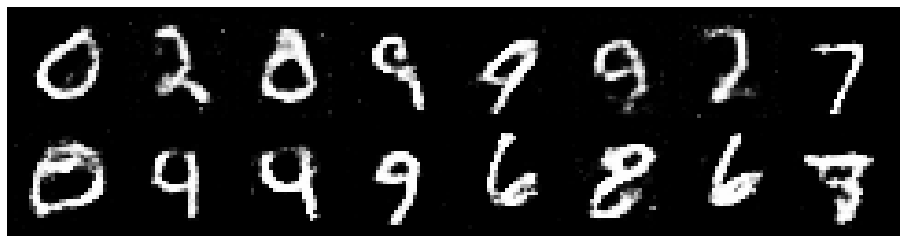

Epoch: [188/200], Batch Num: [0/600]
Discriminator Loss: 1.3088, Generator Loss: 0.8835
D(x): 0.5586, D(G(z)): 0.4687


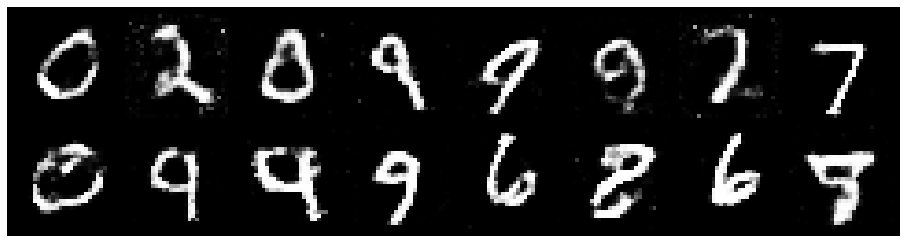

Epoch: [188/200], Batch Num: [100/600]
Discriminator Loss: 1.4142, Generator Loss: 0.9378
D(x): 0.5138, D(G(z)): 0.4529


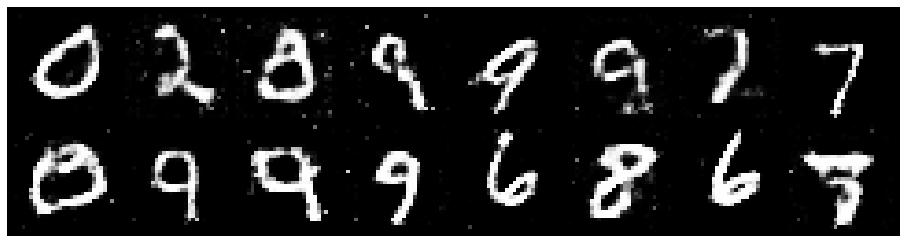

Epoch: [188/200], Batch Num: [200/600]
Discriminator Loss: 1.3940, Generator Loss: 0.8179
D(x): 0.5225, D(G(z)): 0.4655


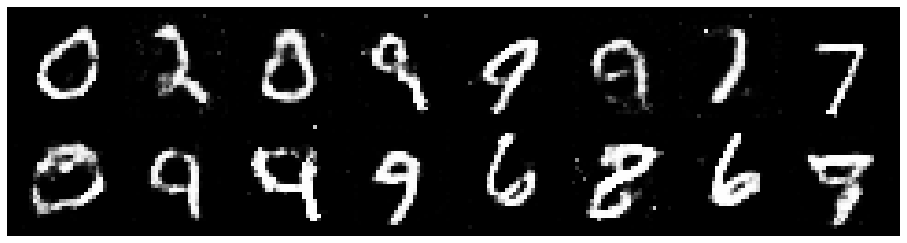

Epoch: [188/200], Batch Num: [300/600]
Discriminator Loss: 1.3351, Generator Loss: 0.8567
D(x): 0.5563, D(G(z)): 0.4673


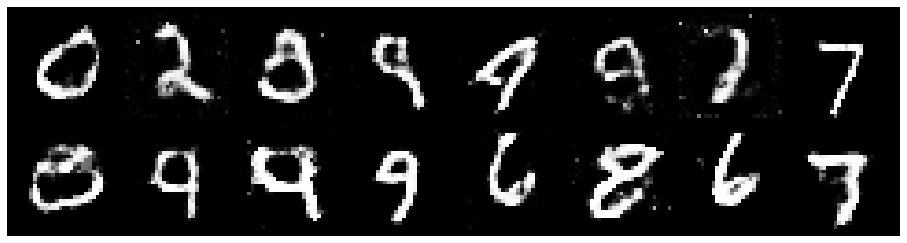

Epoch: [188/200], Batch Num: [400/600]
Discriminator Loss: 1.2334, Generator Loss: 0.9435
D(x): 0.5518, D(G(z)): 0.4232


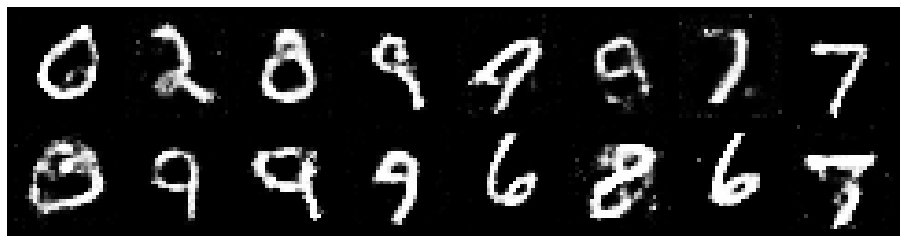

Epoch: [188/200], Batch Num: [500/600]
Discriminator Loss: 1.2327, Generator Loss: 0.8351
D(x): 0.5776, D(G(z)): 0.4398


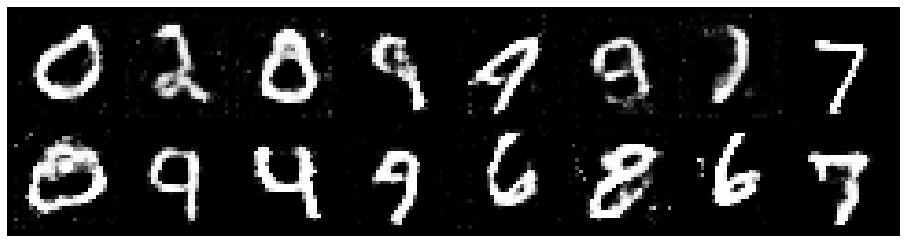

Epoch: [189/200], Batch Num: [0/600]
Discriminator Loss: 1.2890, Generator Loss: 0.9090
D(x): 0.5277, D(G(z)): 0.4276


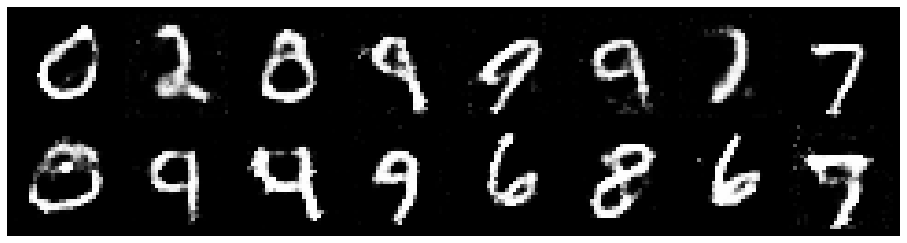

Epoch: [189/200], Batch Num: [100/600]
Discriminator Loss: 1.3232, Generator Loss: 0.9065
D(x): 0.5308, D(G(z)): 0.4430


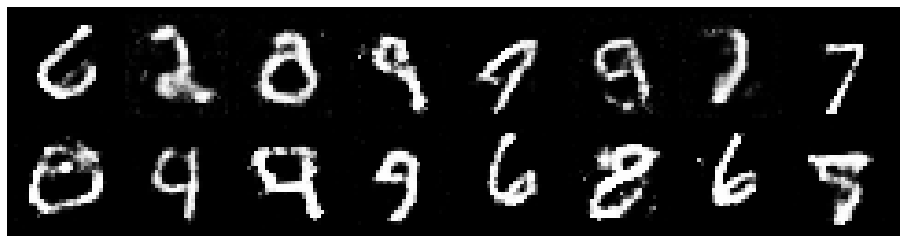

Epoch: [189/200], Batch Num: [200/600]
Discriminator Loss: 1.3874, Generator Loss: 0.7895
D(x): 0.5426, D(G(z)): 0.4945


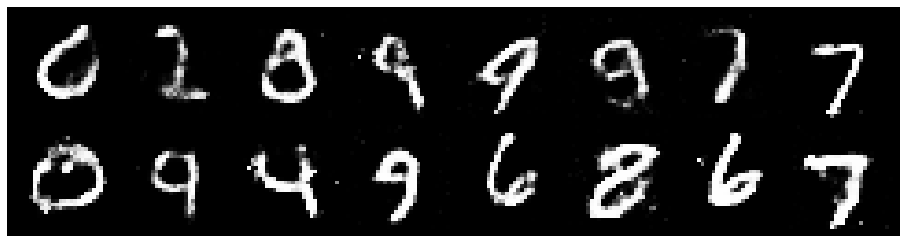

Epoch: [189/200], Batch Num: [300/600]
Discriminator Loss: 1.4711, Generator Loss: 0.8877
D(x): 0.4894, D(G(z)): 0.4759


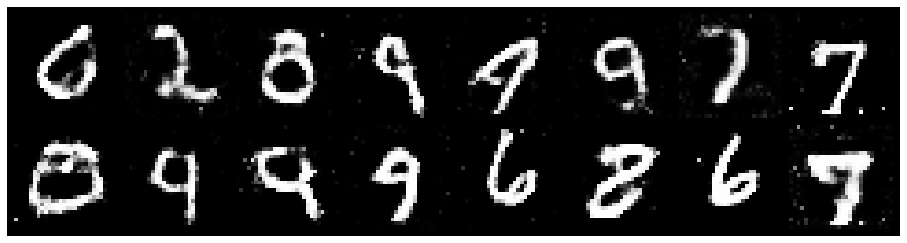

Epoch: [189/200], Batch Num: [400/600]
Discriminator Loss: 1.2680, Generator Loss: 0.8436
D(x): 0.5293, D(G(z)): 0.4334


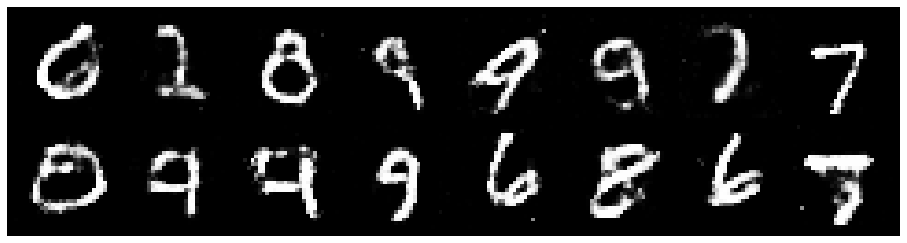

Epoch: [189/200], Batch Num: [500/600]
Discriminator Loss: 1.3012, Generator Loss: 0.9008
D(x): 0.5162, D(G(z)): 0.4266


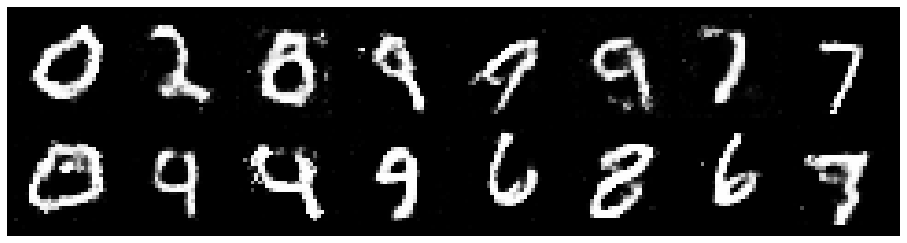

Epoch: [190/200], Batch Num: [0/600]
Discriminator Loss: 1.4320, Generator Loss: 0.8849
D(x): 0.5091, D(G(z)): 0.4585


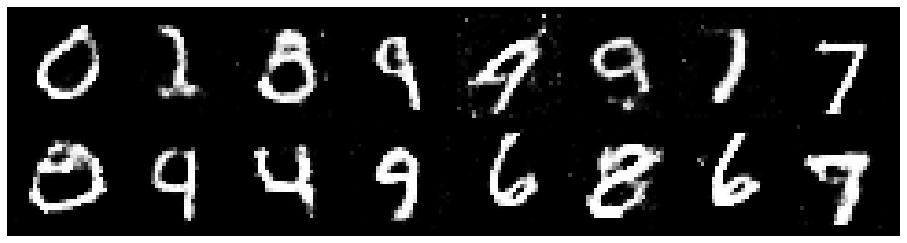

Epoch: [190/200], Batch Num: [100/600]
Discriminator Loss: 1.3068, Generator Loss: 0.8300
D(x): 0.5432, D(G(z)): 0.4709


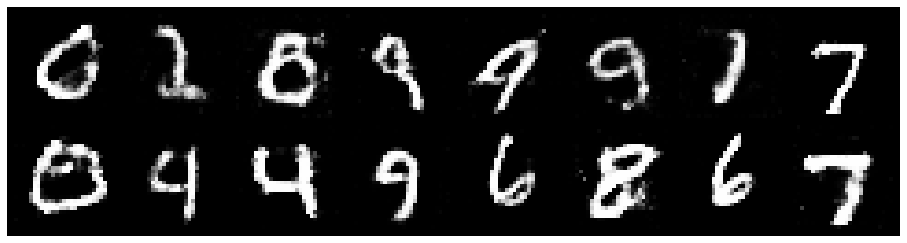

Epoch: [190/200], Batch Num: [200/600]
Discriminator Loss: 1.2484, Generator Loss: 0.8524
D(x): 0.5621, D(G(z)): 0.4383


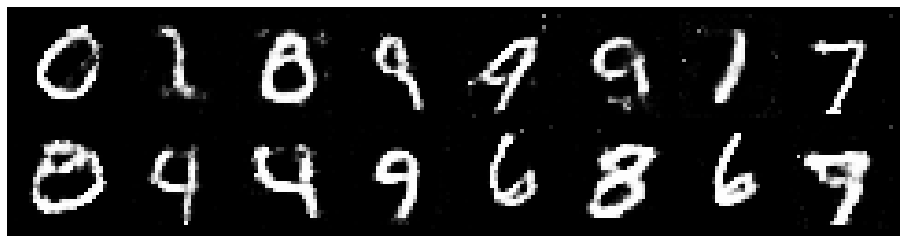

Epoch: [190/200], Batch Num: [300/600]
Discriminator Loss: 1.3134, Generator Loss: 0.8618
D(x): 0.5436, D(G(z)): 0.4575


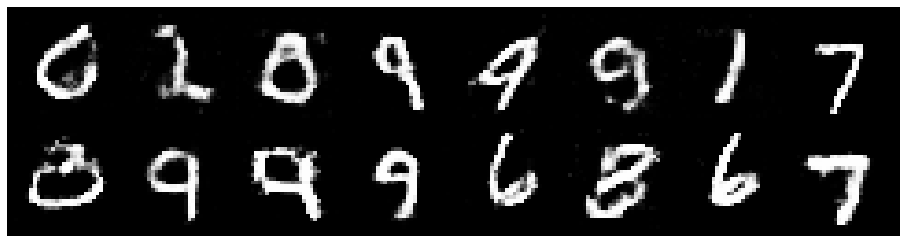

Epoch: [190/200], Batch Num: [400/600]
Discriminator Loss: 1.2622, Generator Loss: 0.8633
D(x): 0.5415, D(G(z)): 0.4342


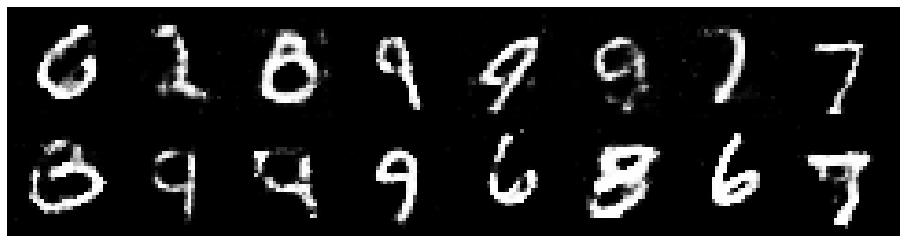

Epoch: [190/200], Batch Num: [500/600]
Discriminator Loss: 1.1917, Generator Loss: 0.8976
D(x): 0.5568, D(G(z)): 0.4184


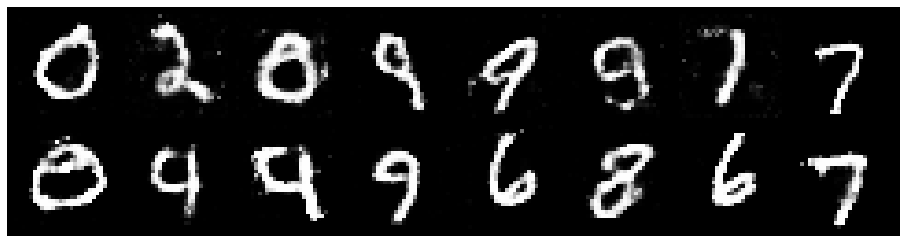

Epoch: [191/200], Batch Num: [0/600]
Discriminator Loss: 1.2009, Generator Loss: 0.8718
D(x): 0.5909, D(G(z)): 0.4452


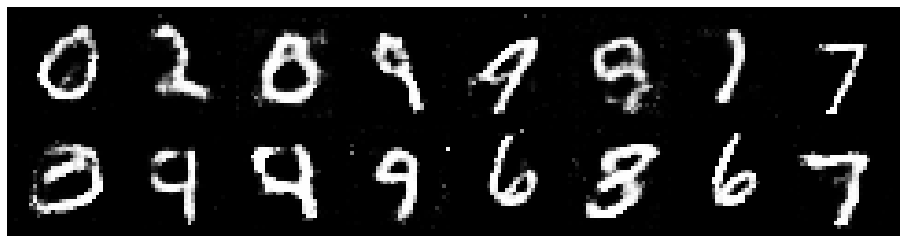

Epoch: [191/200], Batch Num: [100/600]
Discriminator Loss: 1.2058, Generator Loss: 0.9564
D(x): 0.6070, D(G(z)): 0.4481


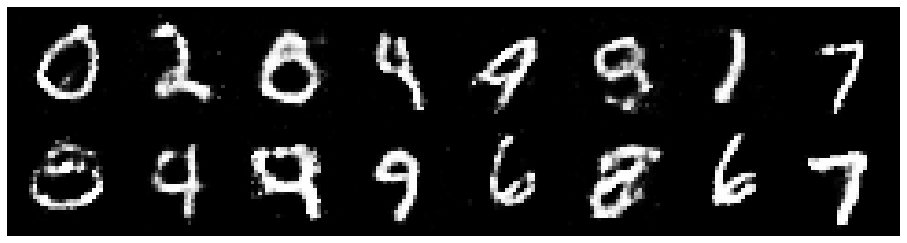

Epoch: [191/200], Batch Num: [200/600]
Discriminator Loss: 1.3302, Generator Loss: 0.9291
D(x): 0.4907, D(G(z)): 0.4215


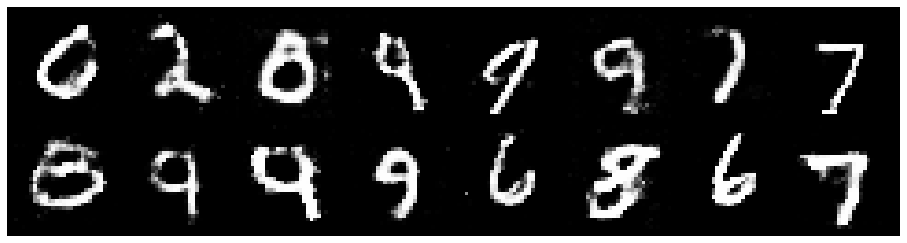

Epoch: [191/200], Batch Num: [300/600]
Discriminator Loss: 1.2666, Generator Loss: 0.7773
D(x): 0.5533, D(G(z)): 0.4474


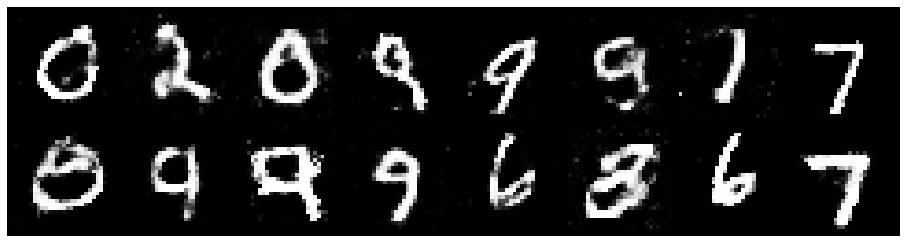

Epoch: [191/200], Batch Num: [400/600]
Discriminator Loss: 1.2377, Generator Loss: 0.8302
D(x): 0.5470, D(G(z)): 0.4307


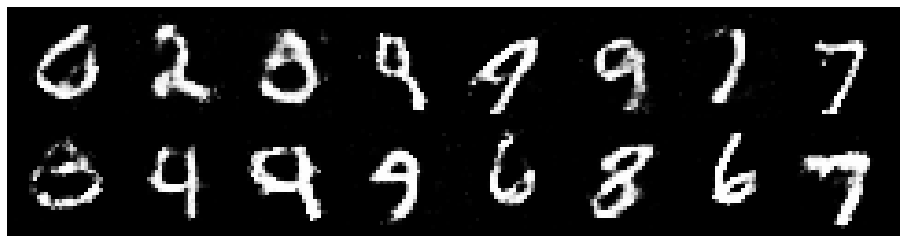

Epoch: [191/200], Batch Num: [500/600]
Discriminator Loss: 1.3762, Generator Loss: 0.7896
D(x): 0.5321, D(G(z)): 0.4704


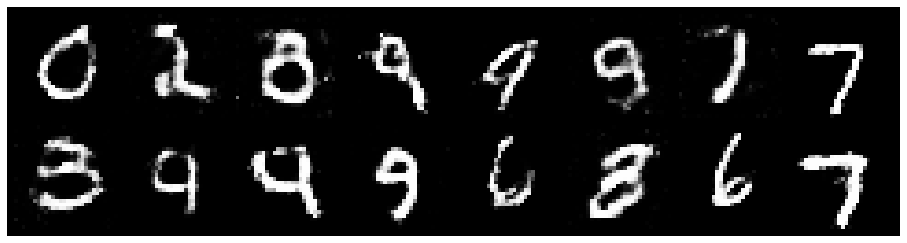

Epoch: [192/200], Batch Num: [0/600]
Discriminator Loss: 1.4122, Generator Loss: 0.9178
D(x): 0.5336, D(G(z)): 0.4753


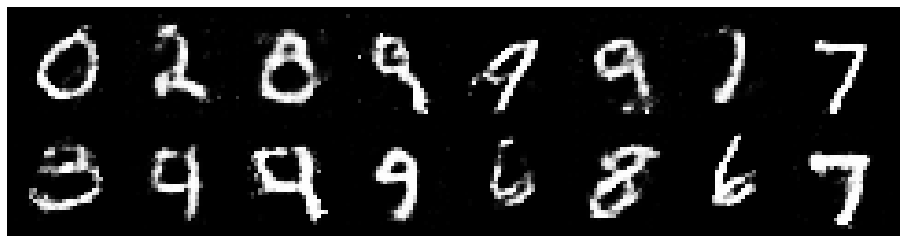

Epoch: [192/200], Batch Num: [100/600]
Discriminator Loss: 1.3446, Generator Loss: 0.8744
D(x): 0.5172, D(G(z)): 0.4471


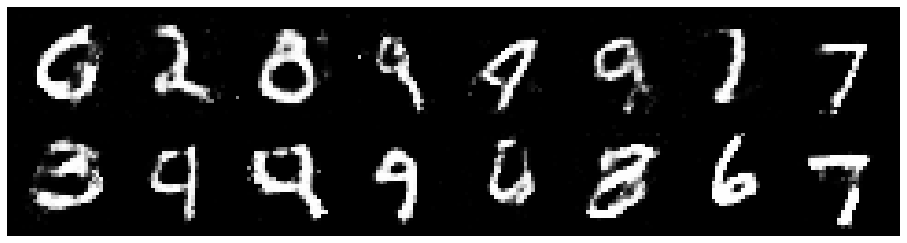

Epoch: [192/200], Batch Num: [200/600]
Discriminator Loss: 1.2984, Generator Loss: 0.9184
D(x): 0.5391, D(G(z)): 0.4529


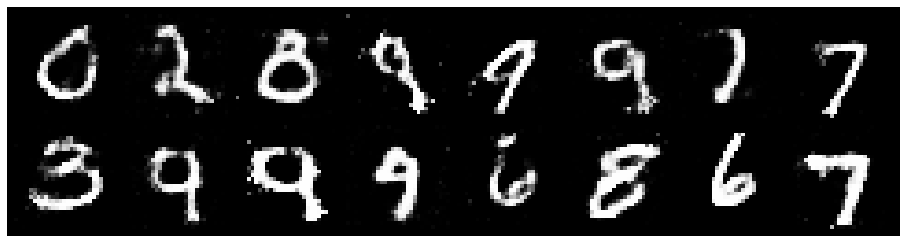

Epoch: [192/200], Batch Num: [300/600]
Discriminator Loss: 1.2825, Generator Loss: 0.8640
D(x): 0.5579, D(G(z)): 0.4637


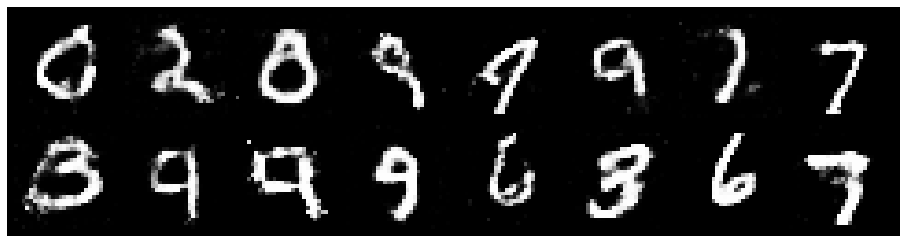

Epoch: [192/200], Batch Num: [400/600]
Discriminator Loss: 1.2482, Generator Loss: 0.9112
D(x): 0.5708, D(G(z)): 0.4552


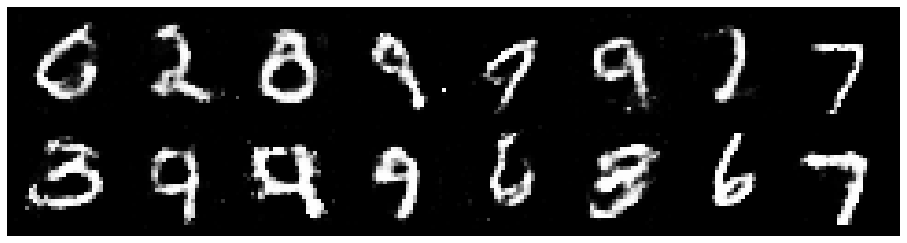

Epoch: [192/200], Batch Num: [500/600]
Discriminator Loss: 1.2647, Generator Loss: 0.9695
D(x): 0.5690, D(G(z)): 0.4580


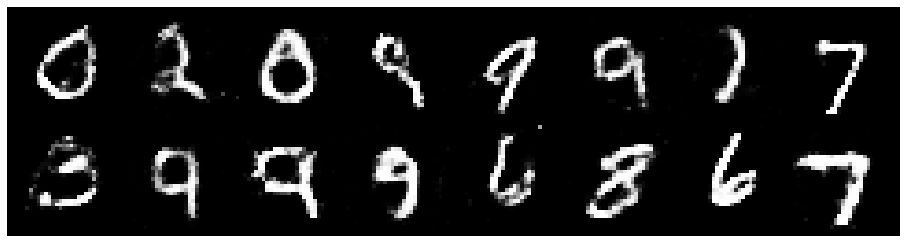

Epoch: [193/200], Batch Num: [0/600]
Discriminator Loss: 1.2736, Generator Loss: 0.8532
D(x): 0.5582, D(G(z)): 0.4628


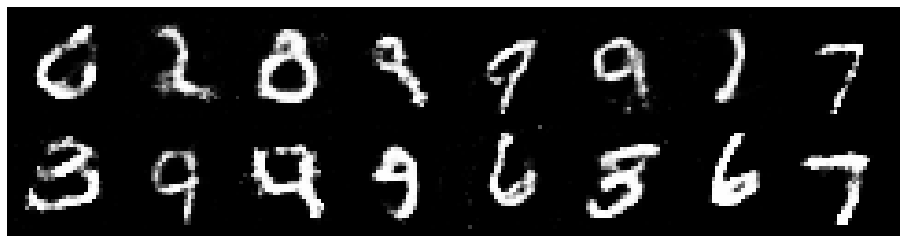

Epoch: [193/200], Batch Num: [100/600]
Discriminator Loss: 1.3014, Generator Loss: 0.8107
D(x): 0.5295, D(G(z)): 0.4528


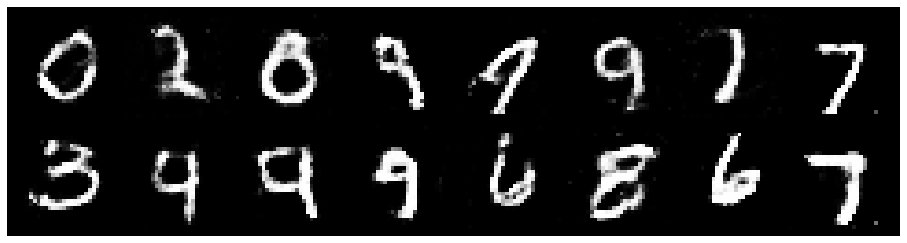

Epoch: [193/200], Batch Num: [200/600]
Discriminator Loss: 1.3197, Generator Loss: 0.8656
D(x): 0.5447, D(G(z)): 0.4756


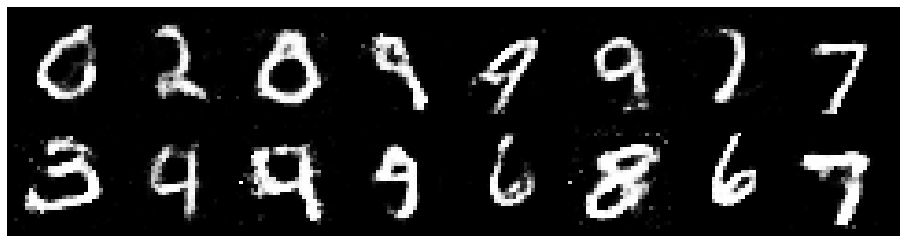

Epoch: [193/200], Batch Num: [300/600]
Discriminator Loss: 1.2951, Generator Loss: 0.9320
D(x): 0.5413, D(G(z)): 0.4395


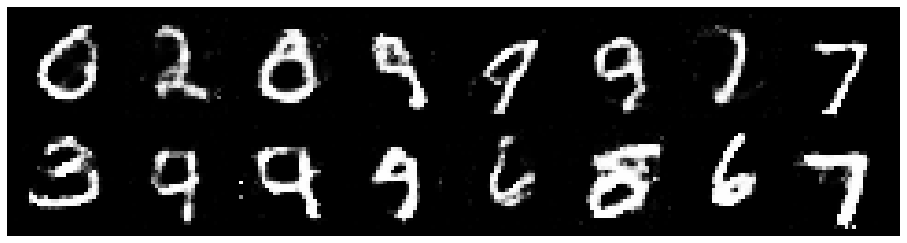

Epoch: [193/200], Batch Num: [400/600]
Discriminator Loss: 1.2367, Generator Loss: 1.1090
D(x): 0.5513, D(G(z)): 0.4136


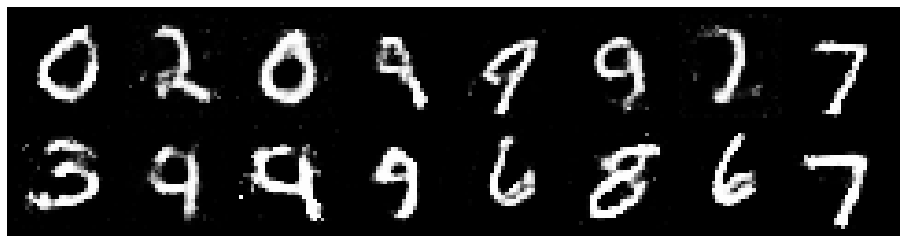

Epoch: [193/200], Batch Num: [500/600]
Discriminator Loss: 1.2046, Generator Loss: 0.8627
D(x): 0.5854, D(G(z)): 0.4591


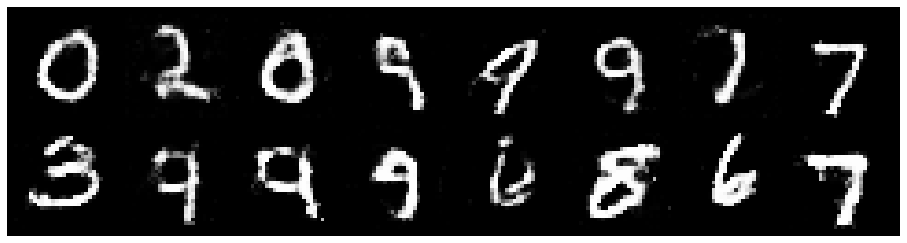

Epoch: [194/200], Batch Num: [0/600]
Discriminator Loss: 1.2476, Generator Loss: 0.8813
D(x): 0.5445, D(G(z)): 0.4326


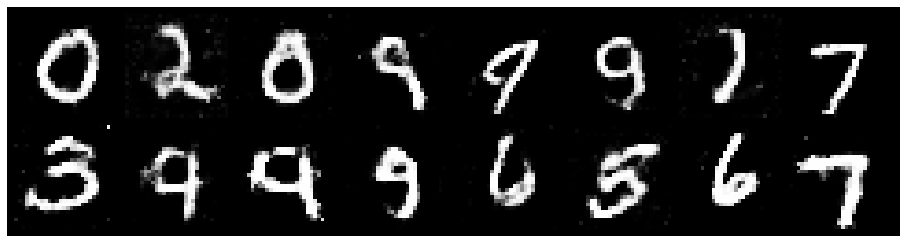

Epoch: [194/200], Batch Num: [100/600]
Discriminator Loss: 1.3624, Generator Loss: 0.8443
D(x): 0.5640, D(G(z)): 0.4696


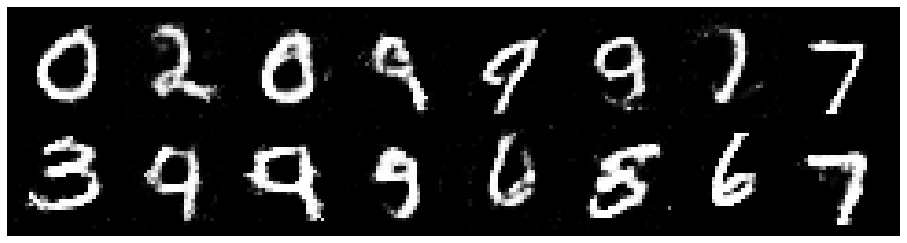

Epoch: [194/200], Batch Num: [200/600]
Discriminator Loss: 1.1814, Generator Loss: 0.8545
D(x): 0.6103, D(G(z)): 0.4462


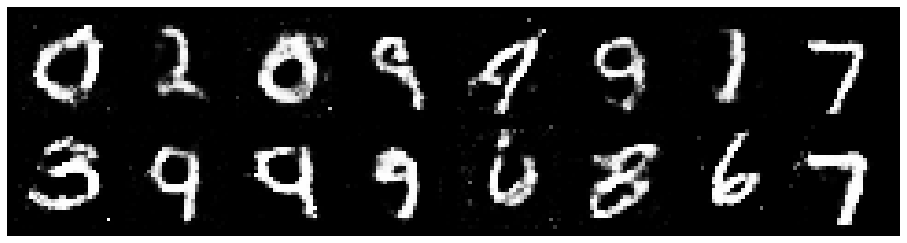

Epoch: [194/200], Batch Num: [300/600]
Discriminator Loss: 1.2608, Generator Loss: 0.7755
D(x): 0.5290, D(G(z)): 0.4310


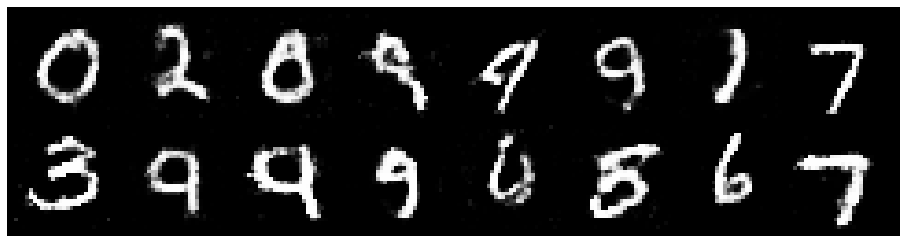

Epoch: [194/200], Batch Num: [400/600]
Discriminator Loss: 1.3298, Generator Loss: 0.8753
D(x): 0.5271, D(G(z)): 0.4576


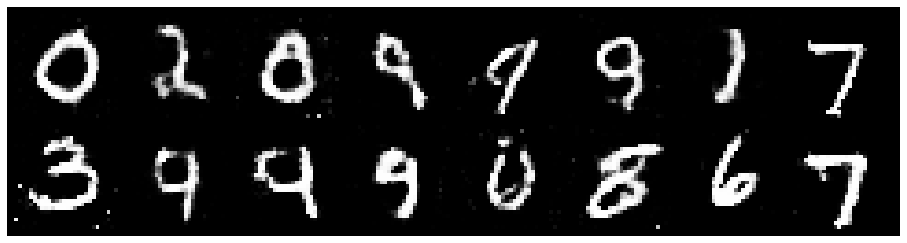

Epoch: [194/200], Batch Num: [500/600]
Discriminator Loss: 1.3511, Generator Loss: 0.8524
D(x): 0.5282, D(G(z)): 0.4625


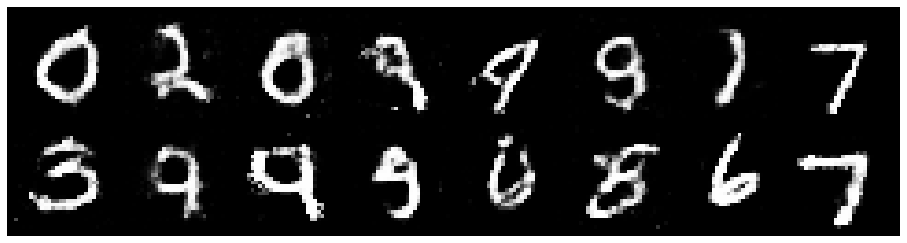

Epoch: [195/200], Batch Num: [0/600]
Discriminator Loss: 1.3422, Generator Loss: 0.9373
D(x): 0.5706, D(G(z)): 0.4755


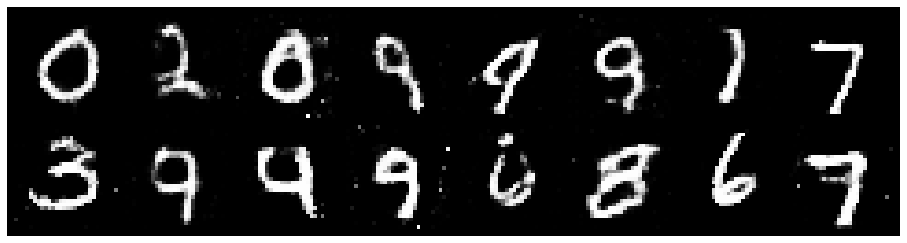

Epoch: [195/200], Batch Num: [100/600]
Discriminator Loss: 1.2757, Generator Loss: 0.8888
D(x): 0.5625, D(G(z)): 0.4507


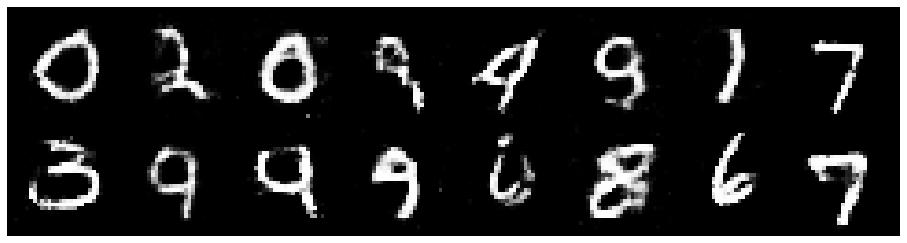

Epoch: [195/200], Batch Num: [200/600]
Discriminator Loss: 1.2360, Generator Loss: 0.9220
D(x): 0.5374, D(G(z)): 0.3991


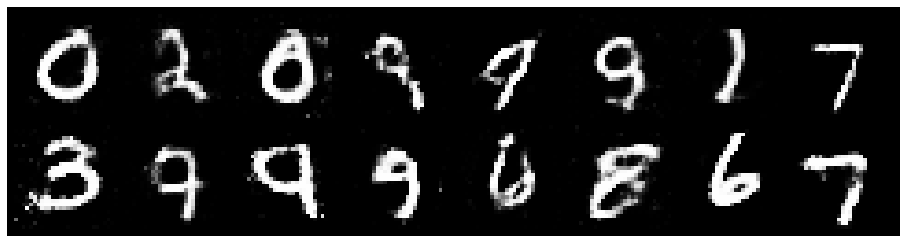

Epoch: [195/200], Batch Num: [300/600]
Discriminator Loss: 1.2905, Generator Loss: 0.8543
D(x): 0.5766, D(G(z)): 0.4738


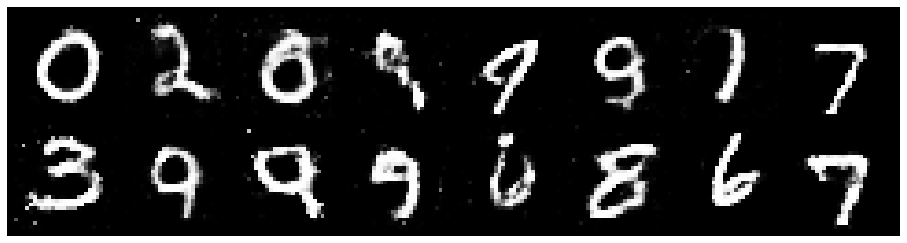

Epoch: [195/200], Batch Num: [400/600]
Discriminator Loss: 1.2325, Generator Loss: 0.8598
D(x): 0.5722, D(G(z)): 0.4363


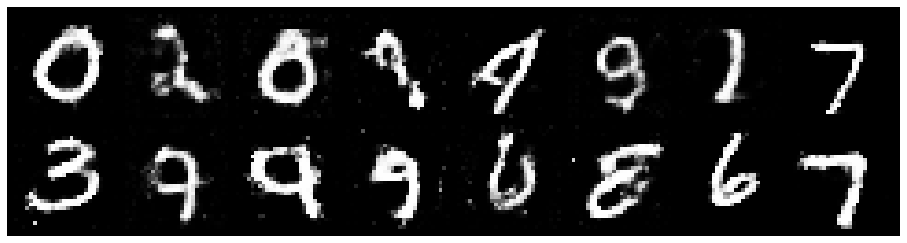

Epoch: [195/200], Batch Num: [500/600]
Discriminator Loss: 1.2349, Generator Loss: 0.9309
D(x): 0.5314, D(G(z)): 0.4019


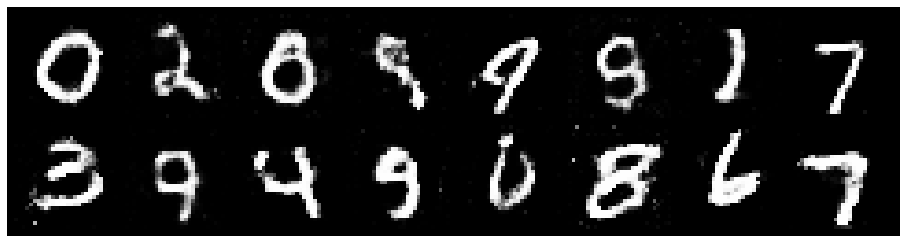

Epoch: [196/200], Batch Num: [0/600]
Discriminator Loss: 1.2740, Generator Loss: 0.9194
D(x): 0.5786, D(G(z)): 0.4524


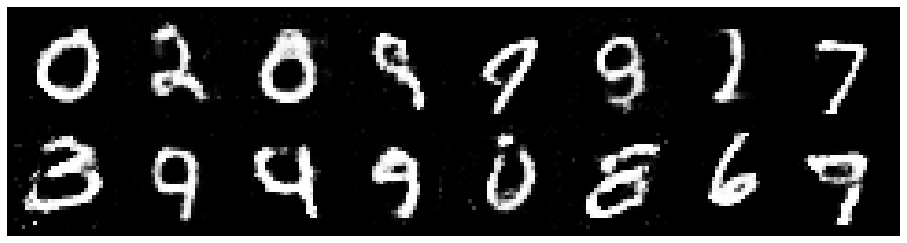

Epoch: [196/200], Batch Num: [100/600]
Discriminator Loss: 1.3682, Generator Loss: 0.7988
D(x): 0.5380, D(G(z)): 0.4685


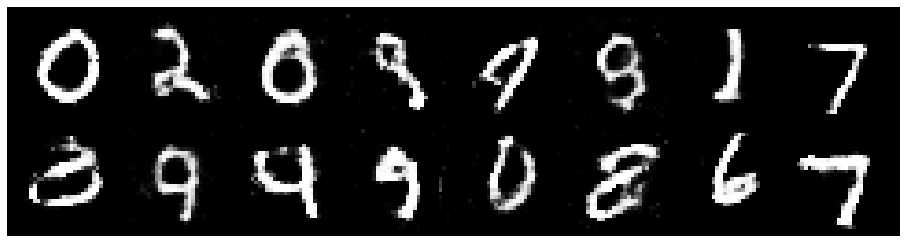

Epoch: [196/200], Batch Num: [200/600]
Discriminator Loss: 1.3912, Generator Loss: 0.7354
D(x): 0.6014, D(G(z)): 0.5309


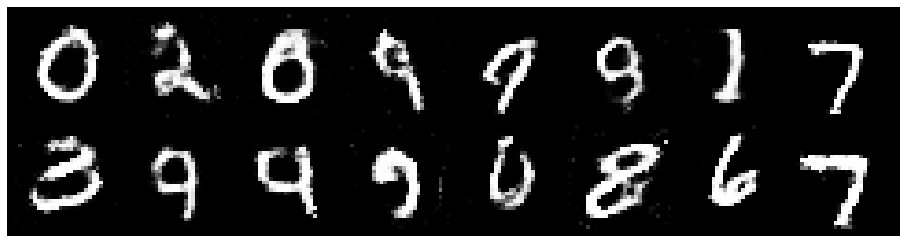

Epoch: [196/200], Batch Num: [300/600]
Discriminator Loss: 1.2637, Generator Loss: 0.8092
D(x): 0.5650, D(G(z)): 0.4560


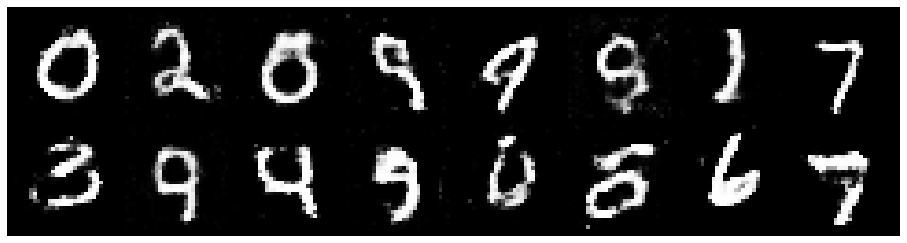

Epoch: [196/200], Batch Num: [400/600]
Discriminator Loss: 1.2706, Generator Loss: 0.9654
D(x): 0.5486, D(G(z)): 0.4325


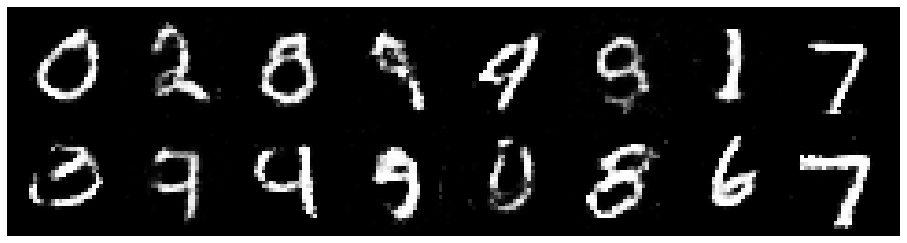

Epoch: [196/200], Batch Num: [500/600]
Discriminator Loss: 1.2374, Generator Loss: 1.0576
D(x): 0.5458, D(G(z)): 0.4082


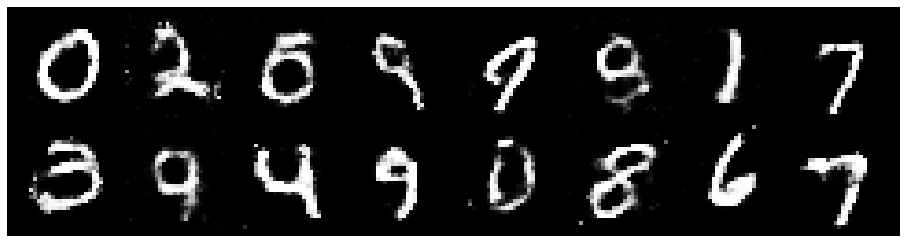

Epoch: [197/200], Batch Num: [0/600]
Discriminator Loss: 1.1299, Generator Loss: 1.0111
D(x): 0.5958, D(G(z)): 0.4035


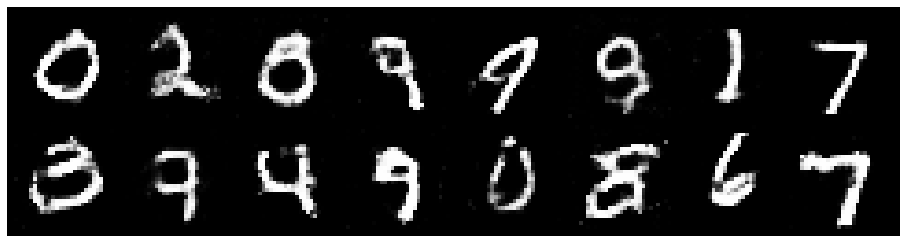

Epoch: [197/200], Batch Num: [100/600]
Discriminator Loss: 1.2520, Generator Loss: 0.9467
D(x): 0.5768, D(G(z)): 0.4440


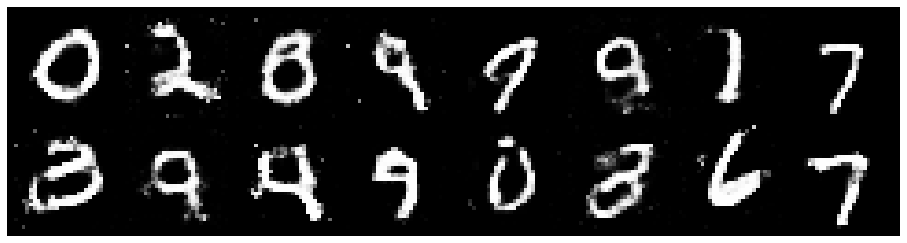

Epoch: [197/200], Batch Num: [200/600]
Discriminator Loss: 1.2616, Generator Loss: 0.8662
D(x): 0.5767, D(G(z)): 0.4572


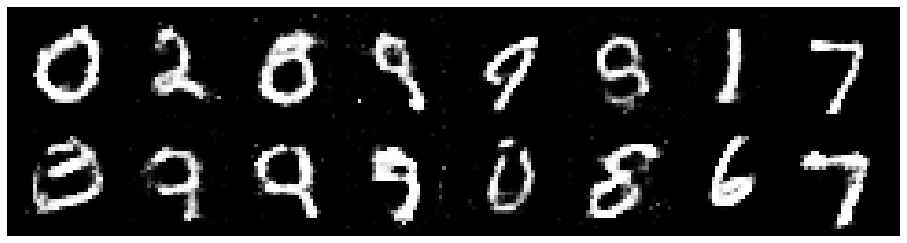

Epoch: [197/200], Batch Num: [300/600]
Discriminator Loss: 1.2386, Generator Loss: 0.9465
D(x): 0.5506, D(G(z)): 0.4365


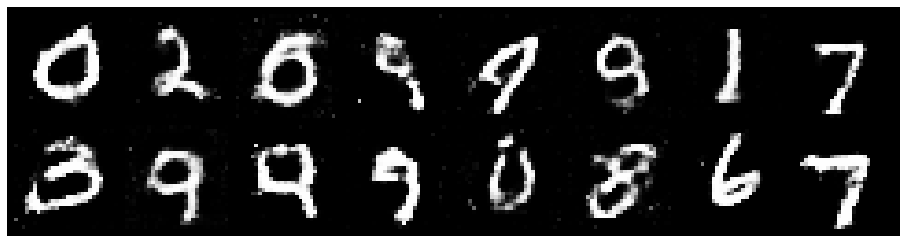

Epoch: [197/200], Batch Num: [400/600]
Discriminator Loss: 1.3256, Generator Loss: 0.8729
D(x): 0.5403, D(G(z)): 0.4568


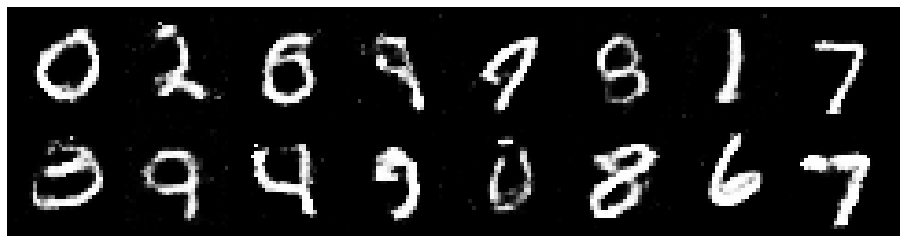

Epoch: [197/200], Batch Num: [500/600]
Discriminator Loss: 1.2387, Generator Loss: 0.9314
D(x): 0.5610, D(G(z)): 0.4323


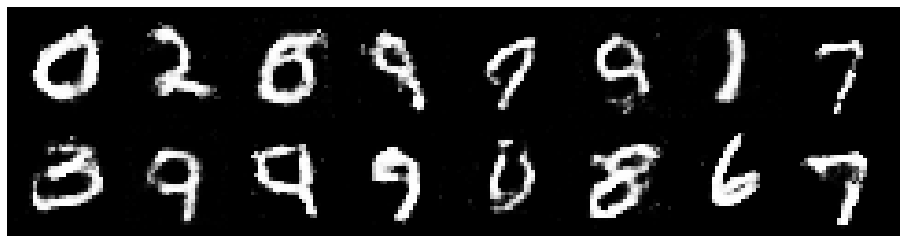

Epoch: [198/200], Batch Num: [0/600]
Discriminator Loss: 1.2532, Generator Loss: 0.8237
D(x): 0.5483, D(G(z)): 0.4300


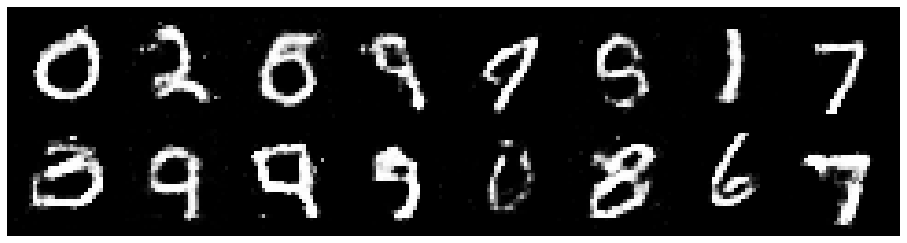

Epoch: [198/200], Batch Num: [100/600]
Discriminator Loss: 1.2842, Generator Loss: 0.9164
D(x): 0.5573, D(G(z)): 0.4513


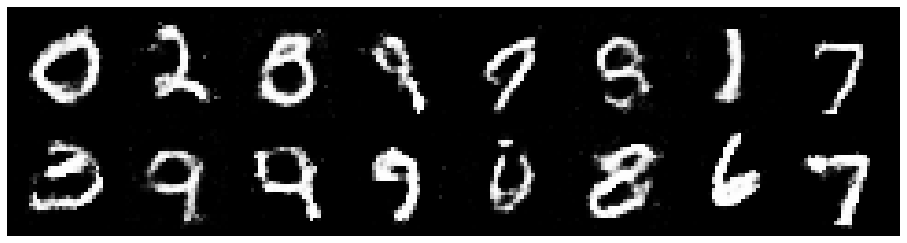

Epoch: [198/200], Batch Num: [200/600]
Discriminator Loss: 1.2115, Generator Loss: 0.9888
D(x): 0.5719, D(G(z)): 0.4115


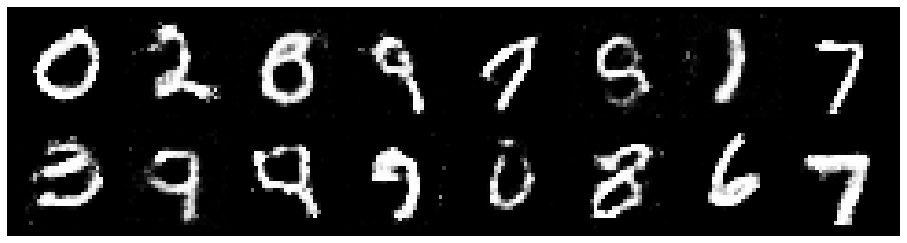

Epoch: [198/200], Batch Num: [300/600]
Discriminator Loss: 1.1971, Generator Loss: 1.0348
D(x): 0.5780, D(G(z)): 0.4256


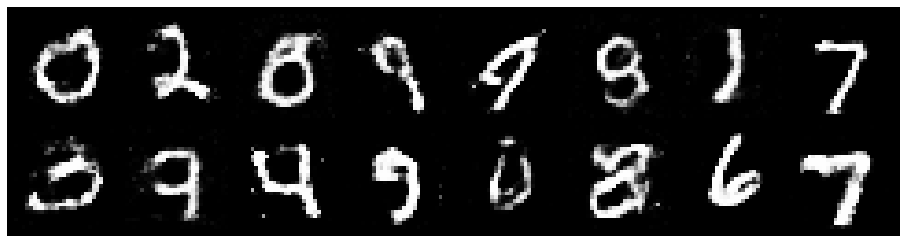

Epoch: [198/200], Batch Num: [400/600]
Discriminator Loss: 1.2296, Generator Loss: 0.8523
D(x): 0.6028, D(G(z)): 0.4644


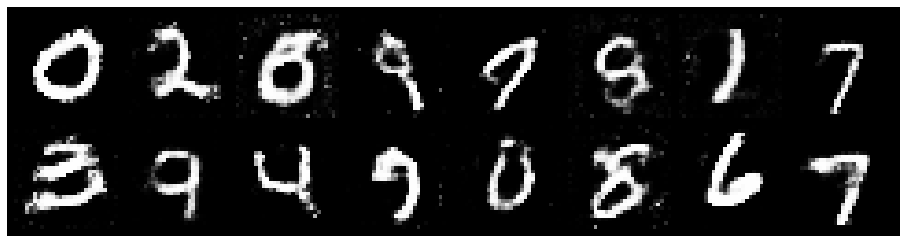

Epoch: [198/200], Batch Num: [500/600]
Discriminator Loss: 1.3413, Generator Loss: 1.0045
D(x): 0.5260, D(G(z)): 0.4415


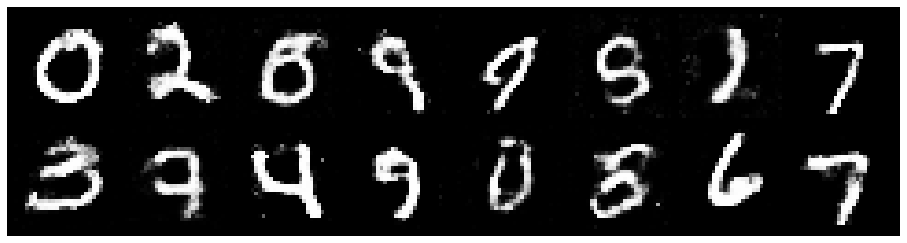

Epoch: [199/200], Batch Num: [0/600]
Discriminator Loss: 1.3530, Generator Loss: 0.8214
D(x): 0.5505, D(G(z)): 0.4573


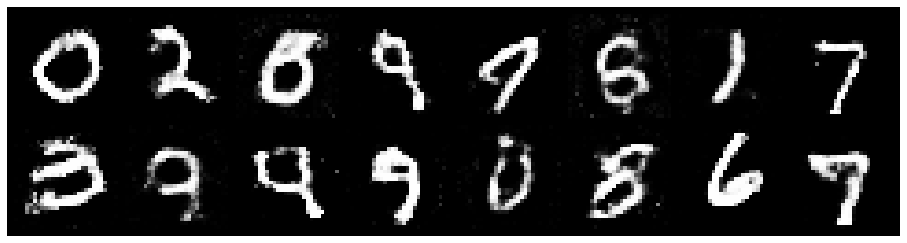

Epoch: [199/200], Batch Num: [100/600]
Discriminator Loss: 1.3182, Generator Loss: 0.8424
D(x): 0.5272, D(G(z)): 0.4343


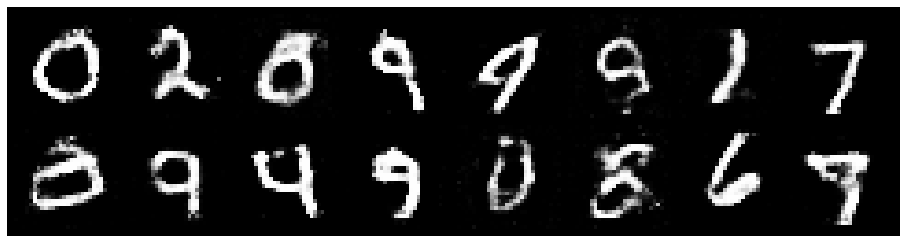

Epoch: [199/200], Batch Num: [200/600]
Discriminator Loss: 1.3386, Generator Loss: 0.8070
D(x): 0.5242, D(G(z)): 0.4441


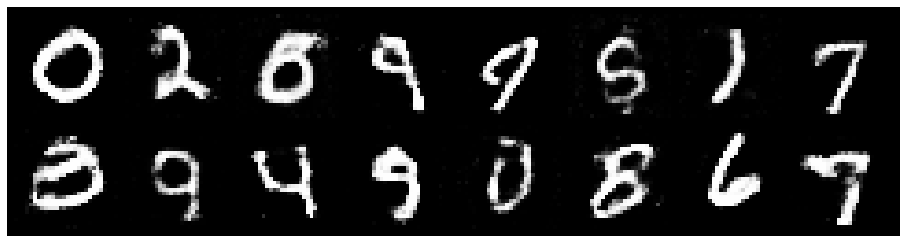

Epoch: [199/200], Batch Num: [300/600]
Discriminator Loss: 1.2075, Generator Loss: 0.8158
D(x): 0.6027, D(G(z)): 0.4561


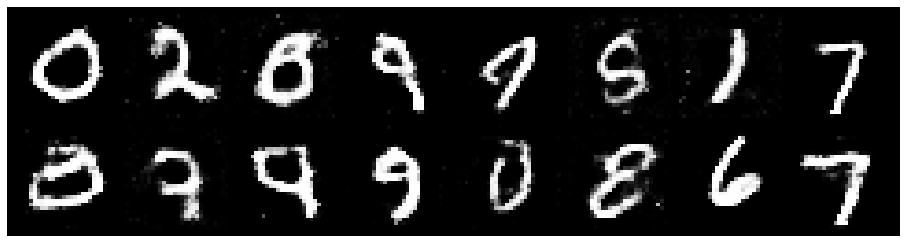

Epoch: [199/200], Batch Num: [400/600]
Discriminator Loss: 1.2851, Generator Loss: 0.8168
D(x): 0.5498, D(G(z)): 0.4454


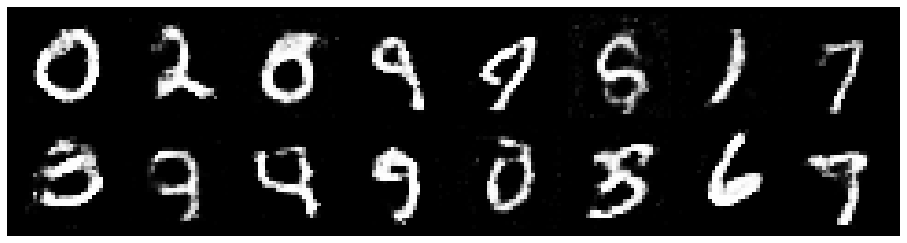

Epoch: [199/200], Batch Num: [500/600]
Discriminator Loss: 1.2414, Generator Loss: 0.7890
D(x): 0.5431, D(G(z)): 0.4310


In [31]:
# Create logger instance
logger = Logger(model_name='VGAN', data_name='MNIST')
# Total number of epochs to train
num_epochs = 200
for epoch in range(num_epochs):
    for n_batch, (real_batch,_) in enumerate(data_loader):
        N = real_batch.size(0)
        
        # 1. Train Discriminator
        real_data = Variable(images_to_vectors(real_batch))
        # Generate fake data and detach 
        # (so gradients are not calculated for generator)
        fake_data = generator(noise(N)).detach()
        # Train D
        d_error, d_pred_real, d_pred_fake = \
              train_discriminator(d_optimizer, real_data, fake_data)
        
        # 2. Train Generator
        # Generate fake data
        fake_data = generator(noise(N))
        # Train G
        g_error = train_generator(g_optimizer, fake_data)
        
        # Log batch error
        logger.log(d_error, g_error, epoch, n_batch, num_batches)
        
        # Display Progress every few batches
        if (n_batch) % 100 == 0: 
            test_images = vectors_to_images(generator(test_noise))
            test_images = test_images.data
            logger.log_images(
                test_images, num_test_samples, 
                epoch, n_batch, num_batches
            );
            # Display status Logs
            logger.display_status(
                epoch, num_epochs, n_batch, num_batches,
                d_error, g_error, d_pred_real, d_pred_fake
            )
